# Deriving multi-Gaussian approximations to Sersic profiles

This notebook demonstrates how to derive optimal parameters for Gaussian mixture model approximations to the Sersic (1963, 1968) function commonly used to model galaxy radial surface brightness profiles.

The main motivation behind doing this is that a Gaussian convolved with a Gaussian has an analytic solution - namely, another Gaussian - and so Gaussian mixture galaxy models convolved with Gaussian mixture PSF models are simple and fast to evaluate.
There are some other advantages that won't be detailed here. The only serious disadvantage is the introduction of 'wiggles' in the profile and therefore roughly sinusoidal variations in the second derivative.

The approach here is similar to Hogg & Lang (2013), but that paper did not publish weights for entire useful range of Sersic indices 0.5 <= n < 8. In practice we usually only go up to n=6.3 as this is the upper limit supported in GalSim.

For convenience, after this we'll refer to multi-Gaussian approximations (i.e. Gaussian mixture models) as MGAs for short.

In [1]:
# Setup; multiprofit gets imported later for verification plots

import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import scipy as sp

%matplotlib inline
sns.set_style("darkgrid")
mpl.rcParams['figure.dpi'] = 240

## Define useful functions

Here we'll define functions for a unit Sersic profile, and for optimizing the weights in an MGA for a chi-square like objective function.

The fitting functions allow for matching the profile over a limited range after re-normalization - the justification for this will be explained later.

Note that the size unit is always Re, and Re = FWHM/2 ~ 1.17741 sigma; the weight is just a fraction for convenience.

In [2]:
# Surface brightness of a unit flux Sersic profile
def sersic(r, n, re):
    bn = sp.stats.gamma.ppf(0.5, 2*n)
    g_factor = sp.special.gamma(2*n)
    flux = np.power(re, 2)*2*np.pi*n*g_factor*np.exp(bn)/np.power(bn, 2*n)
    ir = np.exp(-bn*(np.power(r/re, 1./n)-1.))
    return ir/flux


# Compute chisq as log difference in 2D binned flux
# i.e. not really chisq since it's a sum of squares but without any error
# Rangefit allows re-normalizing the model to match data normalization within the specified range
# Otherwise, the model and data are normalized from r=0 to infinity
def chisq_sersic(params, x, y, weightsbins, rangefit=None, rdivreslog=None,
                 plotdata=False, plotmodel=False, returnall=False):
    ymodel = np.zeros(len(x))
    weights, res = paramstoweightres(params, rdivreslog)
    for weight, re in zip(weights, res):
        ymodel += weight*sersic(x, 0.5, re)
    if plotdata:
        plt.plot(x, np.log10(y/(weightsbins if weightsbins is not None else 1.)))
    if plotmodel:
        plt.plot(x, np.log10(ymodel))
    if weightsbins is not None:
        ymodel *= weightsbins
        if plotmodel:
            print(np.sum(y), np.sum(ymodel))
    if weightsbins is not None:
        if rangefit is not None:
            ymodel = ymodel[rangefit]
            ymodel *= np.sum(y[rangefit])/np.sum(ymodel)
        chisq = np.log10(np.sum(((y if rangefit is None else y[rangefit])-ymodel)**2))
        if returnall:
            return chisq, ymodel
        return chisq


def paramstoweightres(params, rdivreslog=None):
    if rdivreslog is not None:
        paramsnew = np.concatenate([params, rdivreslog])
    else:
        paramsnew = params
    nsplit = (len(paramsnew)+1)//2
    weights = np.zeros(nsplit)
    res = np.zeros(nsplit)
    total = 1.0
    for i in range(nsplit):
        if i < (nsplit-1):
            weight = sp.special.expit(paramsnew[i])
            weights[i] = total*weight
            total *= (1.0-weight)
        res[i] = 10**paramsnew[i+nsplit-1]
    weights[nsplit-1] = 1-np.sum(weights)
    return weights, res


def weightrestoparams(weights, res, rdivreslog=None):
    paramweights = []
    paramres = []
    total = 1.0
    for weight, re in zip(weights, res):
        paramweights.append(sp.special.logit(weight/total))
        total -= weight
        if rdivreslog is None:
            paramres.append(np.log10(re))
    return paramweights[:-1] + paramres


def fitweights(nvals, radii, areasq, weightssigmas={}, methods=['BFGS'], plot=True, addthreshhold=None,
               weightinit=1e-3, refacinit=1.1, addbig = None, funcrangefit=None, funcrdivreslog=None):
    for nvalsi, weightsvars in nvals:
        params = weightrestoparams(weightsvars[0], weightsvars[1], funcrdivreslog) if weightsvars is not None else None
        for n in nvalsi:
            y = sersic(radii, n, 1)*areasq
            paramsbytype = {}
            rangefit = funcrangefit(radii, n) if funcrangefit is not None else None
            rdivreslog = funcrdivreslog(n) if funcrdivreslog is not None else None
            if params is not None:
                paramsbytype['prev.'] = params
            if n in weightssigmas:
                weightsvars = weightssigmas[n]
                paramsbytype['existing'] = weightrestoparams(
                    weightsvars[0][::-1], np.sqrt(weightsvars[1][::-1])*gaussian_sigma_to_re)
            plotteddata = not plot
            chisqmin = np.Inf
            for name, paramsi in paramsbytype.items():
                chisq = chisq_sersic(paramsi, radii, y, areasq, rangefit, rdivreslog,
                                     plotdata=not plotteddata, plotmodel=plot)
                print(name, ' chisq =', chisq)
                if chisq < chisqmin:
                    params = paramsi
                plotteddata = True
            print('ws, re:', paramstoweightres(params, rdivreslog))
            for method in methods:
                fit = sp.optimize.minimize(chisq_sersic, params, args=(radii, y, areasq, rangefit, rdivreslog),
                                           tol=1e-5, options={'disp': True, }, method=method)
                params = fit['x']
            print(fit['fun'], fit['x'])
            chisq = chisq_sersic(params, radii, y, areasq, rangefit, rdivreslog, plotmodel=plot)
            plt.xlabel('$r/r_{eff}$')
            plt.ylabel('log10(surface density)')
            plt.show()
            weights, res = paramstoweightres(params, rdivreslog)
            idxsort = np.argsort(res)[::-1]
            weights = np.array(weights)[idxsort]
            res = np.array(res)[idxsort]
            print('n={}: ('.format(n))
            for arr, prefix, postfix in [(weights, 'normalize(', ')'), (res, '', '')]:
                print('    ' + prefix + 'np.array([' + ', '.join(
                    ['{:.10e}'.format(x) for x in arr]) + '])' + postfix + ',')
            print('),')
            if addthreshhold is not None and chisq > addthreshhold:
                # Add a small component if n < 1.5; big if n > 1.5 by default
                cond = n > 1.5 if addbig is None else addbig 
                weights *= 1.0-weightinit
                weights = np.insert(weights, 0, weightinit) if cond else np.append(weights, weightinit)
                res = np.insert(res, 0, refacinit*res[0]) if cond else np.append(res, res[-1]/refacinit)
                params = weightrestoparams(weights, res)
                print('new w, r:', weights, res)
                

def normalize(array):
    array /= np.sum(array)
    return array

## Define the fit range and plot the Sersic profile for reference

We choose to fit out to R/Re = 12 rather than the more typical limit of R/Re=8 commonly used in SDSS. This allows the fits to better match the n>4 profiles at R/Re > 4. Massive elliptical galaxies often do have very extended outer profiles with large Sersic indices (see papers by Kormendy & co. on Virgo galaxies), so we do want to reproduce the shape at large radii. Eventually, the MGA profile will truncate more quickly than a Sersic profile as only the outer Gaussian contributes to the flux, but that's fine - we don't really trust the extrapolation at such large radii unless there's very deep data to constrain it.

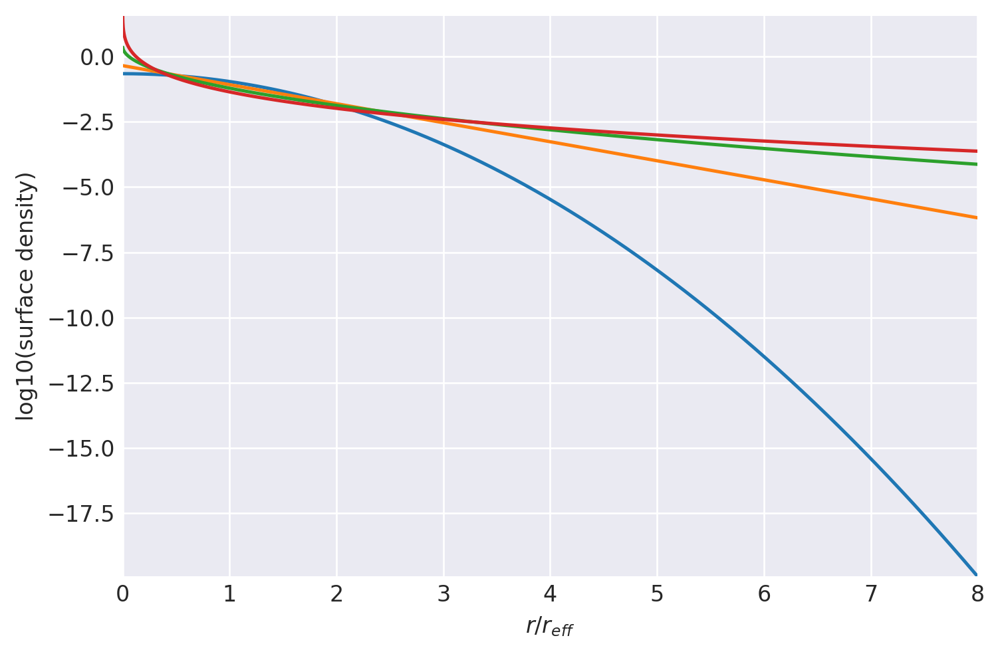

In [3]:
order = 8

nbinsperre = 2000
remax = 12
redge = np.linspace(0, remax, nbinsperre*remax+1)
rmid = (redge[1:] + redge[:-1])/2.
rsq = redge**2
areasq = np.pi*(rsq[1:] - rsq[:-1])

idxsplot = range(8*nbinsperre)

for n in [0.5, 1, 2, 4]:
    plt.plot(rmid[idxsplot], np.log10(sersic(rmid[idxsplot], n, 1)))
plt.tight_layout()
for axis in ['x', 'y']:
    plt.autoscale(enable=True, axis=axis, tight=True)
plt.xlabel('$r/r_{eff}$')
plt.ylabel('log10(surface density)')
plt.show()

## Carefully fit MGA weights/sizes for n < 1

This section begins fitting the optimal weights and sizes of the MGA.

The trickiest part of this problem is finding optimal weights for an MGA with N components as n -> 0.5. Of course, you only need a single component to reproduce n=0.5 exactly, and for n=0.5 + a small epsilon, you need only two Gaussians - one slightly smaller and one slightly larger - for a good approximation. As n grows, the minimal N for a good fit grows too. There are essentially two options, then - either grow N gradually with increasing n, or keep N fixed and hope that the weights change smoothly down to n=0.5. Unfortunately, the latter option is practically quite difficult as many of the best-fit weights asymptote to zero but are very noisy, which is a problem if we want to smoothly interpolate the weights for any value of N (see below). That leaves the first option of gradually adding components.

After some experimentation, two things are apparent. First, as n->0.5, the best-fit model tends to two components of (weight, size) = (1-delta, 1+eps), (delta, 0.716). Why that specifical value of 0.716, I'm not sure.

Secondly, adding components while maintaining a smooth variation in the weights and sizes becomes tricky, because the best-fit solutions for an MGA with N and N-1 components can be significantly different. The solution here is to ensure delta n is large enough when incrementing N such that the weights still change smoothly. However, it turns out that the weights derived here through a combination of working from n=0.5 up and from n=1 down (meeting in the middle) don't change smoothly enough to be useable for interpolation and fitting - see the plots further below.

Thirdly, there were only two things, but there's no legend in the plots so it should be mentioned that blue is true profile, orange is the initial guess, and green is the final best fit.

Note that it's impossible to fit n < 0.5 profiles with an MGA without spatially offsetting the components. Note that as n <= 0, the Sersic profile approaches a step function. This isn't a very useful approximation for most 'normal' galaxies, but it can be a useful approximation of parts of barred/ring galaxies, so we will revisit this issue later.

1.0000000144581254 1.000000014229467
prev.  chisq = -7.588745391812752
ws, re: (array([0.98, 0.02]), array([1.01, 0.9 ]))
         Current function value: -12.124435
         Iterations: 21
         Function evaluations: 612
         Gradient evaluations: 120
-12.1244350827063 [ 5.63857896e+00  5.35362016e-04 -1.45058260e-01]
1.0000000144581254 1.0000000144537895


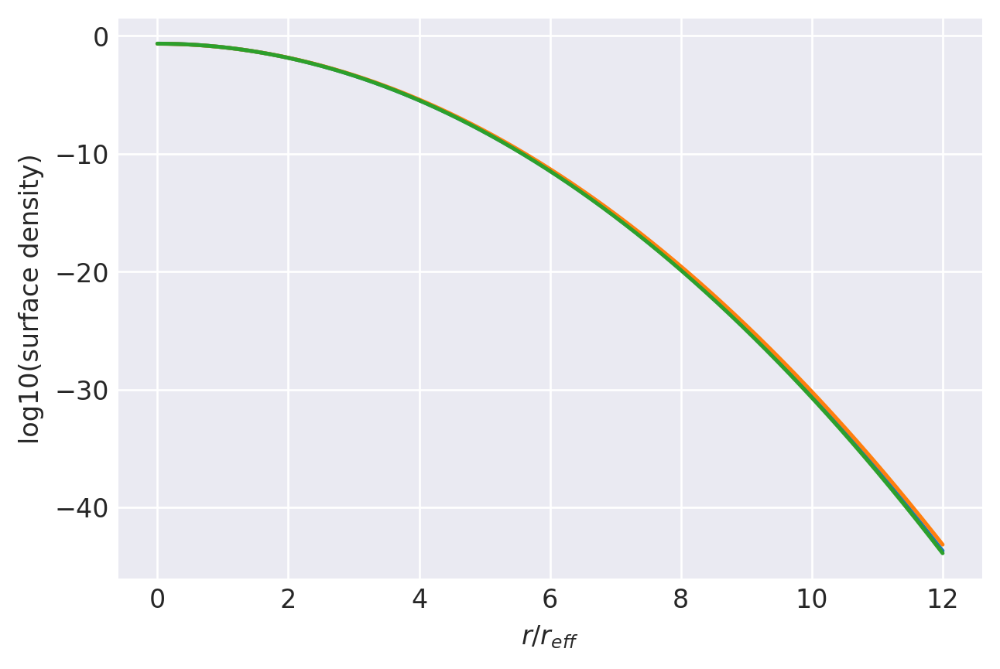

n=0.501: (
    normalize(np.array([9.9645469317e-01, 3.5453068336e-03])),
    np.array([1.0012334767e+00, 7.1604734662e-01]),
),
1.0000000145642924 1.0000000147654382
prev.  chisq = -7.7362581434074595
ws, re: (array([0.87013735, 0.12619086, 0.00367179]), array([1.03392488, 0.81955231, 0.42170644]))
         Current function value: -11.998273
         Iterations: 207
         Function evaluations: 2336
         Gradient evaluations: 332
-11.99827306304458 [-2.89964115e+00  6.66790914e+00 -8.51519166e-02  5.29272520e-03
 -3.75584400e-01]
1.0000000145642924 1.0000000145537353


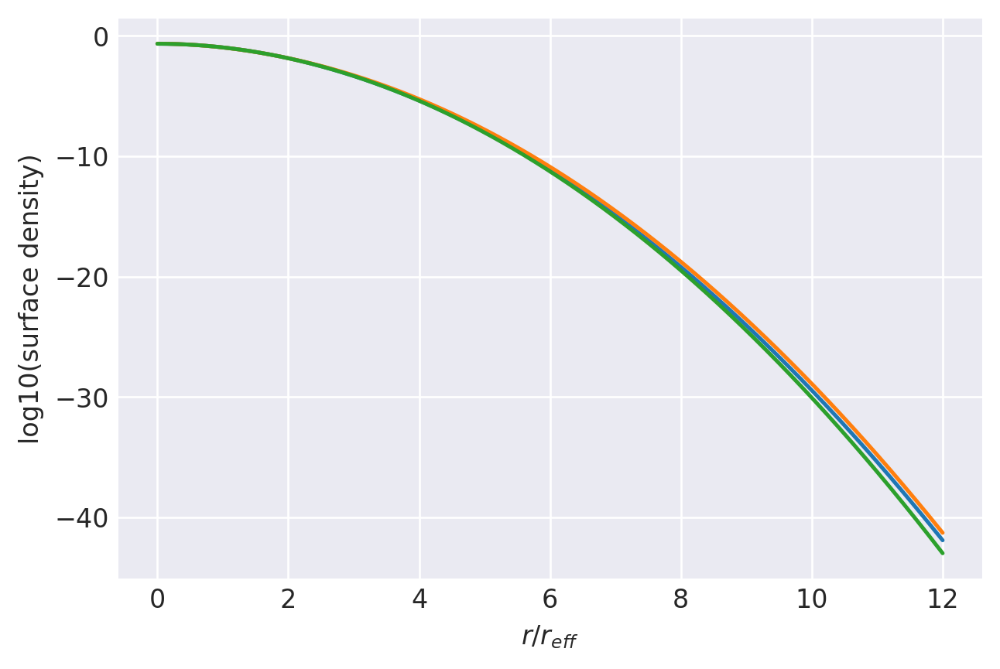

n=0.507: (
    normalize(np.array([9.4662548327e-01, 5.2171305034e-02, 1.2032116992e-03])),
    np.array([1.0122615136e+00, 8.2195507899e-01, 4.2112943705e-01]),
),
1.0000000199734806 1.0000000283694637
prev.  chisq = -7.117390029086779
ws, re: (array([0.07790019, 0.31264016, 0.33937179, 0.1839253 , 0.06541804,
       0.01709507, 0.00326612, 0.00038332]), array([2.17045661, 1.47679133, 0.99494464, 0.65054022, 0.40699848,
       0.23877605, 0.12631553, 0.05405815]))
         Current function value: -11.155304
         Iterations: 52
         Function evaluations: 2035
         Gradient evaluations: 119
-11.15530445544733 [-2.42262005 -0.59808414  0.30058746  0.82079262  1.1970379   1.5809865
  2.17308776  0.31341845  0.15498436 -0.01022075 -0.1900277  -0.38993527
 -0.6181705  -0.89132524 -1.2559645 ]
1.0000000199734806 1.0000000264952646


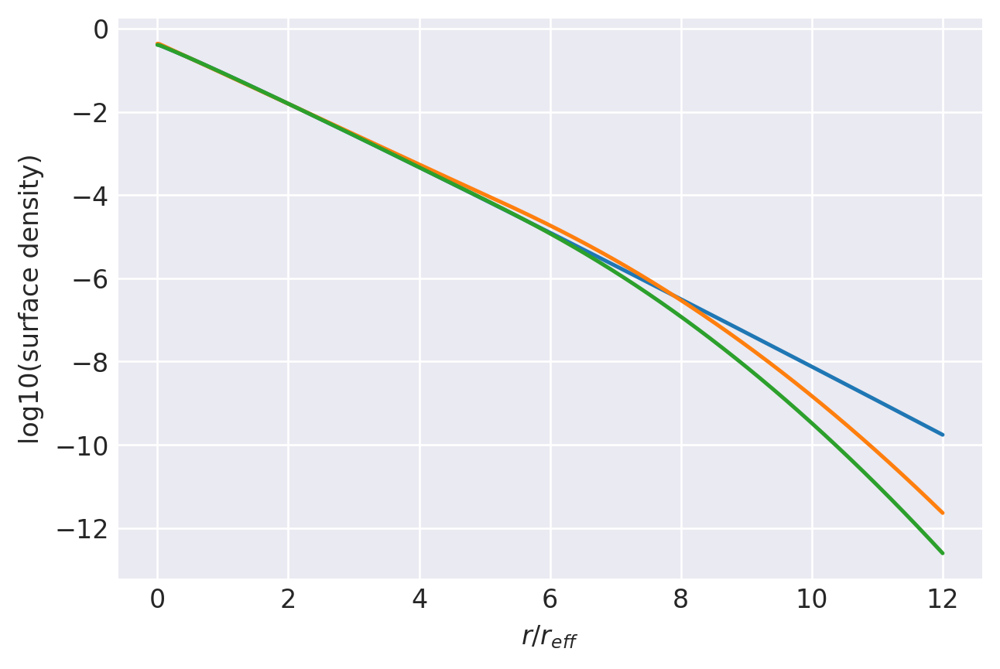

n=0.95: (
    normalize(np.array([8.1463988478e-02, 3.2588016643e-01, 3.4053182287e-01, 1.7507607194e-01, 5.9172627261e-02, 1.4824795210e-02, 2.7387840554e-03, 3.1174375934e-04])),
    np.array([2.0578724478e+00, 1.4288424938e+00, 9.7674061971e-01, 6.4561304442e-01, 4.0744100447e-01, 2.4089595025e-01, 1.2843244753e-01, 5.5467104900e-02]),
),
1.0000000242164144 1.0000000264952646
prev.  chisq = -7.072791108028902
ws, re: (array([8.14639885e-02, 3.25880166e-01, 3.40531823e-01, 1.75076072e-01,
       5.91726273e-02, 1.48247952e-02, 2.73878406e-03, 3.11743759e-04]), array([2.05787245, 1.42884249, 0.97674062, 0.64561304, 0.407441  ,
       0.24089595, 0.12843245, 0.0554671 ]))
         Current function value: -11.408747
         Iterations: 57
         Function evaluations: 2085
         Gradient evaluations: 122
-11.408746715665405 [-2.40299067 -0.54129696  0.37057696  0.8843964   1.24608973  1.61797575
  2.20281177  0.29085669  0.14240478 -0.01565202 -0.19029974 -0.38616401
 -0.61081962 -

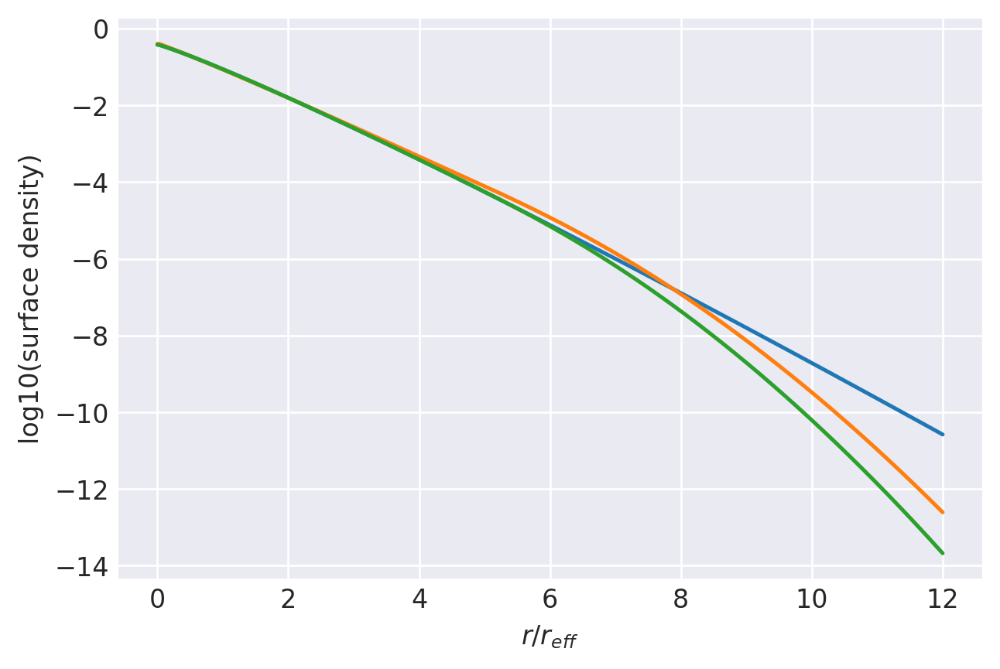

n=0.9: (
    normalize(np.array([8.2944927122e-02, 3.3737165742e-01, 3.4293977280e-01, 1.6755115426e-01, 5.3736425424e-02, 1.2898328320e-02, 2.3032444663e-03, 2.5449018740e-04])),
    np.array([1.9536946720e+00, 1.3880489560e+00, 9.6460161519e-01, 6.4520876215e-01, 4.1099448002e-01, 2.4500806439e-01, 1.3172635072e-01, 5.7478987848e-02]),
),
1.0000000232649449 1.0000000247023972
prev.  chisq = -7.02552013403142
ws, re: (array([8.29449271e-02, 3.37371657e-01, 3.42939773e-01, 1.67551154e-01,
       5.37364254e-02, 1.28983283e-02, 2.30324447e-03, 2.54490187e-04]), array([1.95369467, 1.38804896, 0.96460162, 0.64520876, 0.41099448,
       0.24500806, 0.13172635, 0.05747899]))
         Current function value: -11.694331
         Iterations: 90
         Function evaluations: 2833
         Gradient evaluations: 166
-11.69433132400764 [-2.32226401 -0.44187223  0.4681851   0.96304997  1.30273284  1.65849114
  2.23790881  0.26461024  0.12594596 -0.02514642 -0.19482256 -0.38686318
 -0.60809025 -0.8

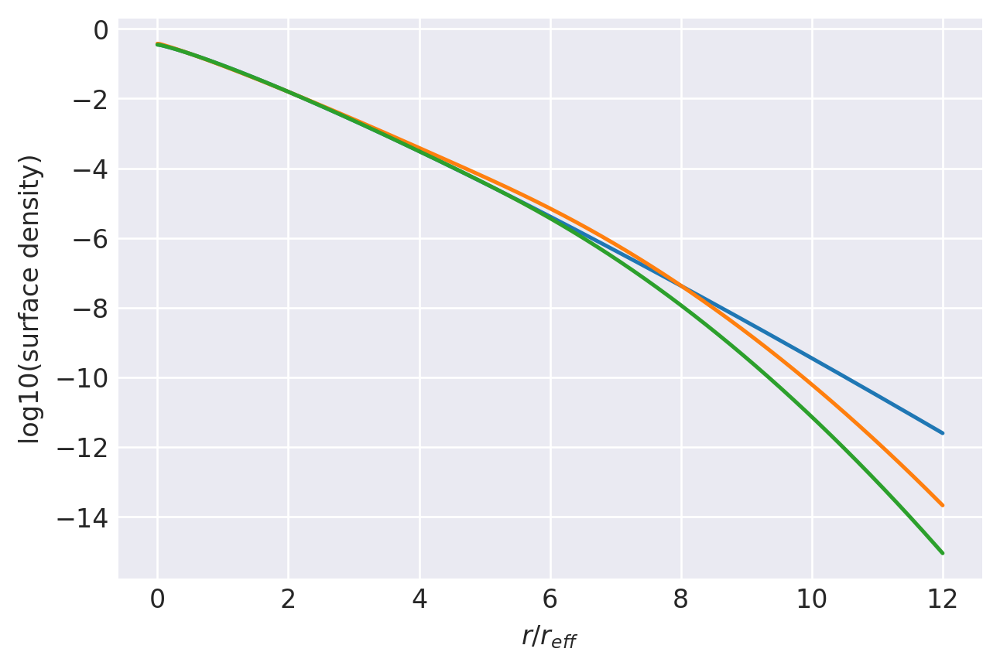

n=0.85: (
    normalize(np.array([8.9295774481e-02, 3.5635395908e-01, 3.4089997162e-01, 1.5448081819e-01, 4.6367378483e-02, 1.0586207953e-02, 1.8215633357e-03, 1.9432685769e-04])),
    np.array([1.8391207336e+00, 1.3364292193e+00, 9.4374264293e-01, 6.3852430856e-01, 4.1033335262e-01, 2.4655269337e-01, 1.3363367181e-01, 5.8855346344e-02]),
),
1.0000000216764655 1.0000000230356967
prev.  chisq = -6.975152837922648
ws, re: (array([8.92957745e-02, 3.56353959e-01, 3.40899972e-01, 1.54480818e-01,
       4.63673785e-02, 1.05862080e-02, 1.82156334e-03, 1.94326858e-04]), array([1.83912073, 1.33642922, 0.94374264, 0.63852431, 0.41033335,
       0.24655269, 0.13363367, 0.05885535]))
         Current function value: -12.020635
         Iterations: 135
         Function evaluations: 4789
         Gradient evaluations: 281
-12.020634508379356 [-2.22691509 -0.33544183  0.56914315  1.04340479  1.36082781  1.7005008
  2.27221272  0.2368236   0.10919222 -0.03368686 -0.19750214 -0.38528197
 -0.60294244 -

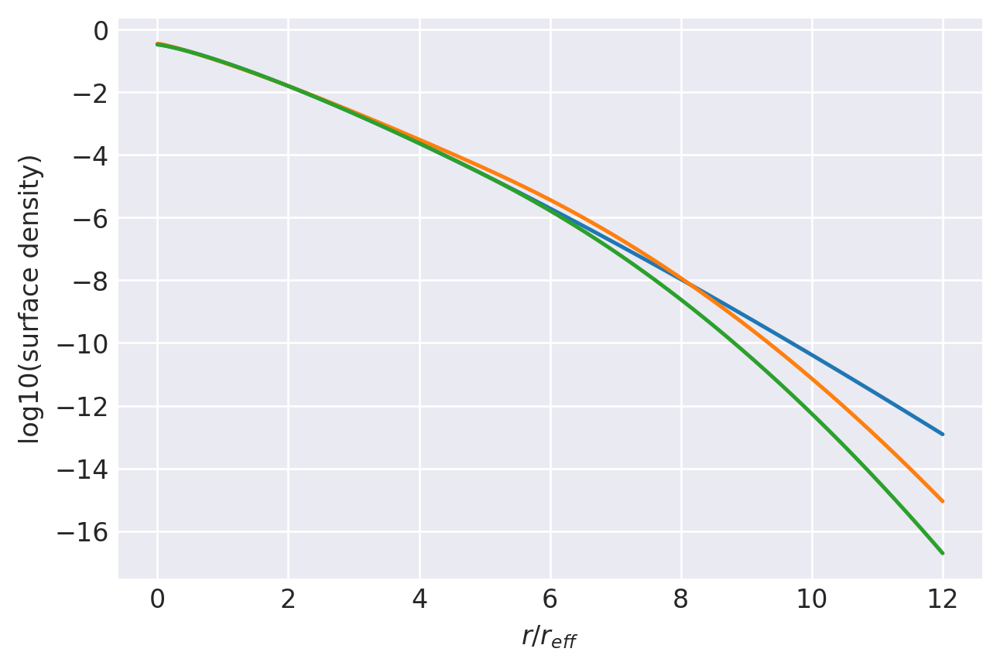

n=0.8: (
    normalize(np.array([9.7359408258e-02, 3.7632632840e-01, 3.3608609828e-01, 1.4067495078e-01, 3.9439116135e-02, 8.5524827161e-03, 1.4156815517e-03, 1.4593387948e-04])),
    np.array([1.7251370483e+00, 1.2858556604e+00, 9.2536514156e-01, 6.3459677644e-01, 4.1183004904e-01, 2.4949253563e-01, 1.3638471345e-01, 6.0728216887e-02]),
),
1.0000000201648103 1.0000000214837446
prev.  chisq = -6.921481313230024
ws, re: (array([9.73594083e-02, 3.76326328e-01, 3.36086098e-01, 1.40674951e-01,
       3.94391161e-02, 8.55248272e-03, 1.41568155e-03, 1.45933879e-04]), array([1.72513705, 1.28585566, 0.92536514, 0.63459678, 0.41183005,
       0.24949254, 0.13638471, 0.06072822]))
         Current function value: -12.377141
         Iterations: 114
         Function evaluations: 3038
         Gradient evaluations: 178
-12.377141103157182 [-2.25211141 -0.27404148  0.66694483  1.1294116   1.42115378  1.74346593
  2.30884375  0.21213991  0.09788909 -0.03532965 -0.19276266 -0.37599953
 -0.58974059 -

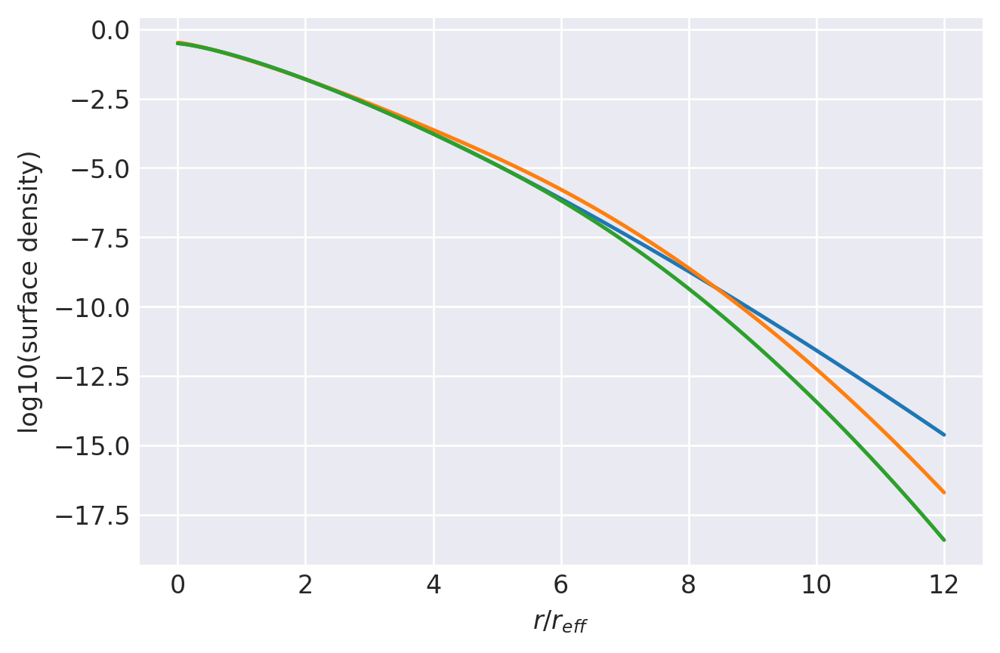

n=0.75: (
    normalize(np.array([9.5167494628e-02, 3.9081090139e-01, 3.3967509760e-01, 1.3175893673e-01, 3.4305106271e-02, 7.0494262755e-03, 1.1215789620e-03, 1.1145813102e-04])),
    np.array([1.6298210027e+00, 1.2528211963e+00, 9.2187141234e-01, 6.4156009607e-01, 4.2072708303e-01, 2.5719315745e-01, 1.4191484230e-01, 6.3952433382e-02]),
),
1.0000000187857572 1.0000000196964773
prev.  chisq = -6.869730899086066
ws, re: (array([0.10846654, 0.40298205, 0.32733137, 0.12247919, 0.03133709,
       0.00638995, 0.00101382]), array([1.6116988 , 1.23330695, 0.90359039, 0.62645431, 0.40957695,
       0.25288574, 0.13272692]))
         Current function value: -11.952262
         Iterations: 172
         Function evaluations: 4737
         Gradient evaluations: 315
-11.952261919082547 [-2.03235392  0.03249558  1.01553593  1.47810547  1.81702141  2.36920018
  0.17856951  0.07287697 -0.06037919 -0.22853268 -0.43365573 -0.68565805
 -1.02544528]
1.0000000187857572 1.0000000186707956


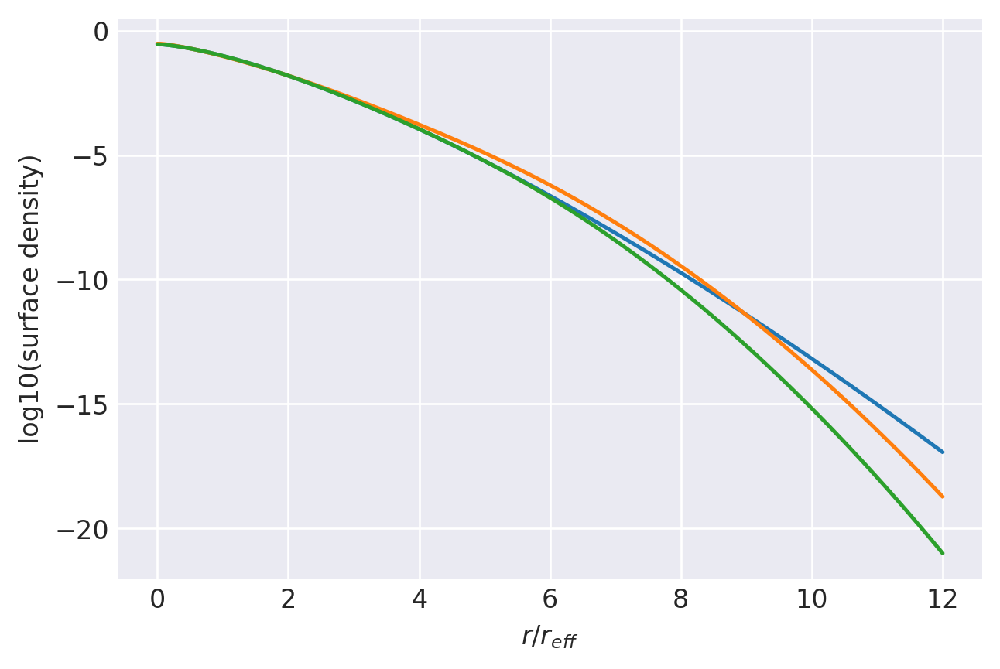

n=0.7: (
    normalize(np.array([1.1584759935e-01, 4.4925832966e-01, 3.1925666847e-01, 9.4161947089e-02, 1.8473365773e-02, 2.7452558180e-03, 2.5683384766e-04])),
    np.array([1.5085840400e+00, 1.1827064676e+00, 8.7020346704e-01, 5.9083650141e-01, 3.6842090584e-01, 2.0622530253e-01, 9.4309343285e-02]),
),
1.000000017532151 1.0000000182584923
prev.  chisq = -6.812053504566393
ws, re: (array([0.11587736, 0.44937374, 0.31933869, 0.09418614, 0.01847811,
       0.00274596]), array([1.50858404, 1.18270647, 0.87020347, 0.5908365 , 0.36842091,
       0.2062253 ]))
         Current function value: -11.749242
         Iterations: 143
         Function evaluations: 2612
         Gradient evaluations: 200
-11.749242425948415 [-1.03647729  0.8126692   1.57987729  1.93635539  2.45160893  0.12351295
  0.01643889 -0.13169752 -0.32689105 -0.57317194 -0.90712598]
1.000000017532151 1.0000000174458115


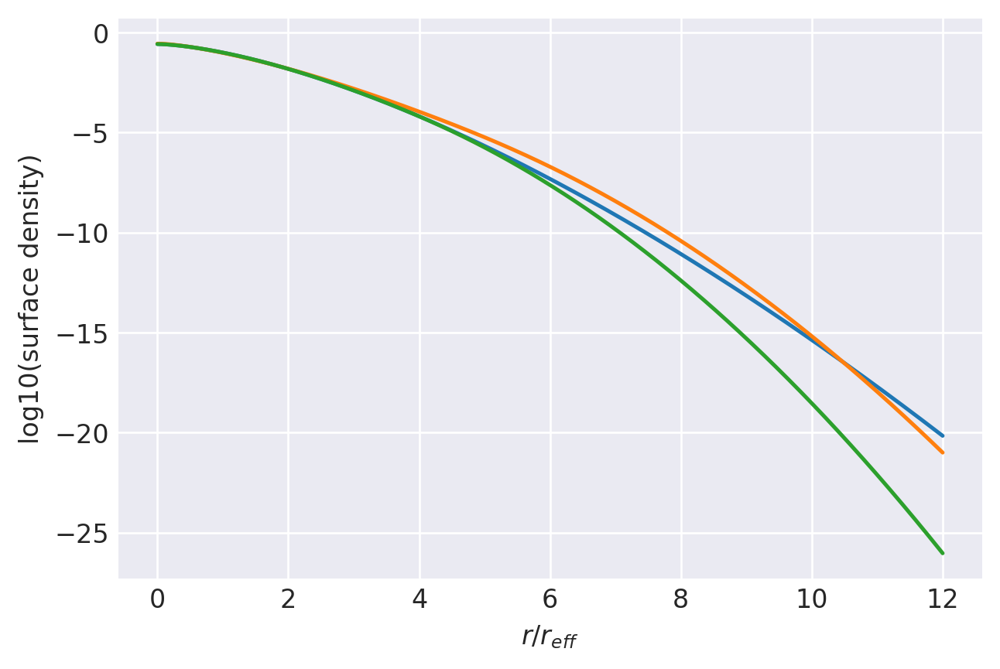

n=0.65: (
    normalize(np.array([2.6183027504e-01, 5.1131393105e-01, 1.8810590649e-01, 3.3865510527e-02, 4.4969433749e-03, 3.8743351832e-04])),
    np.array([1.3289631973e+00, 1.0385774455e+00, 7.3841834696e-01, 4.7109549871e-01, 2.6719483672e-01, 1.2384372936e-01]),
),
1.000000016395073 1.0000000156835687
prev.  chisq = -7.6095141772703165
ws, re: (array([0.40998043, 0.48679061, 0.09050881, 0.01203523, 0.00068493]), array([1.195 , 0.9656, 0.67  , 0.45  , 0.208 ]))
         Current function value: -11.443792
         Iterations: 47
         Function evaluations: 1211
         Gradient evaluations: 109
-11.443792062155998 [-0.34143151  1.51220842  2.13986148  2.59408027  0.08122373 -0.02055728
 -0.18595349 -0.42055999 -0.74691955]
1.000000016395073 1.00000001632613


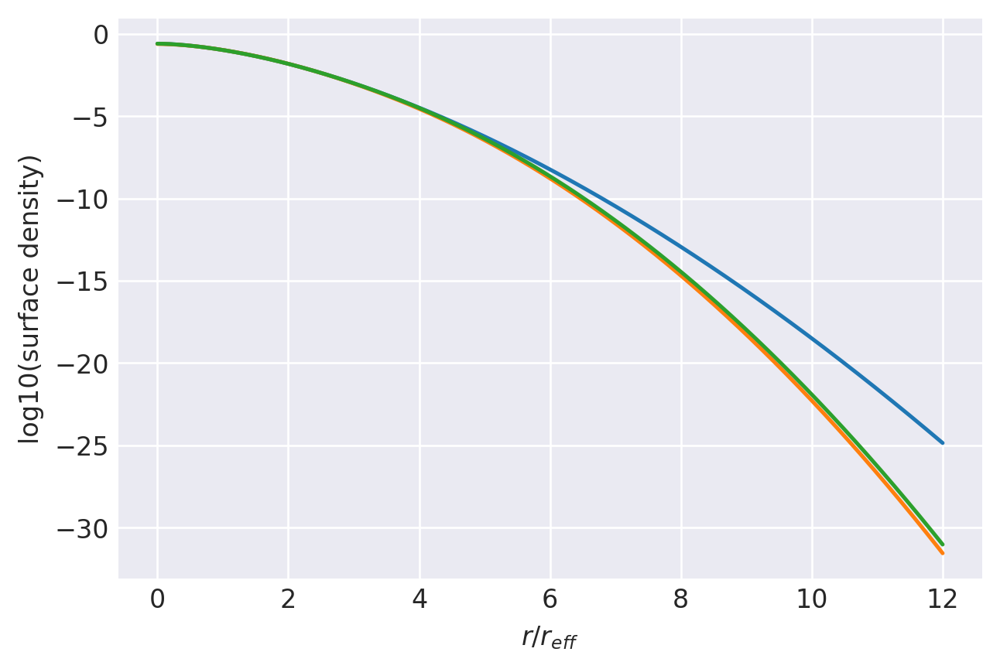

n=0.6: (
    normalize(np.array([4.1546178873e-01, 4.7896375027e-01, 9.4459324448e-02, 1.0342408068e-02, 7.7272848509e-04])),
    np.array([1.2056568803e+00, 9.5376794968e-01, 6.5169818599e-01, 3.7969948423e-01, 1.7909375620e-01]),
),
1.0000000159710858 1.00000001632613
prev.  chisq = -7.481980375282093
ws, re: (array([0.41546179, 0.47896375, 0.09445932, 0.01034241, 0.00077273]), array([1.20565688, 0.95376795, 0.65169819, 0.37969948, 0.17909376]))
         Current function value: -11.763399
         Iterations: 81
         Function evaluations: 1584
         Gradient evaluations: 143
-11.763399173885905 [-0.17535029  1.67591444  2.21457633  2.62391258  0.06757176 -0.02519721
 -0.18646514 -0.4192426  -0.74304606]
1.0000000159710858 1.0000000159238078


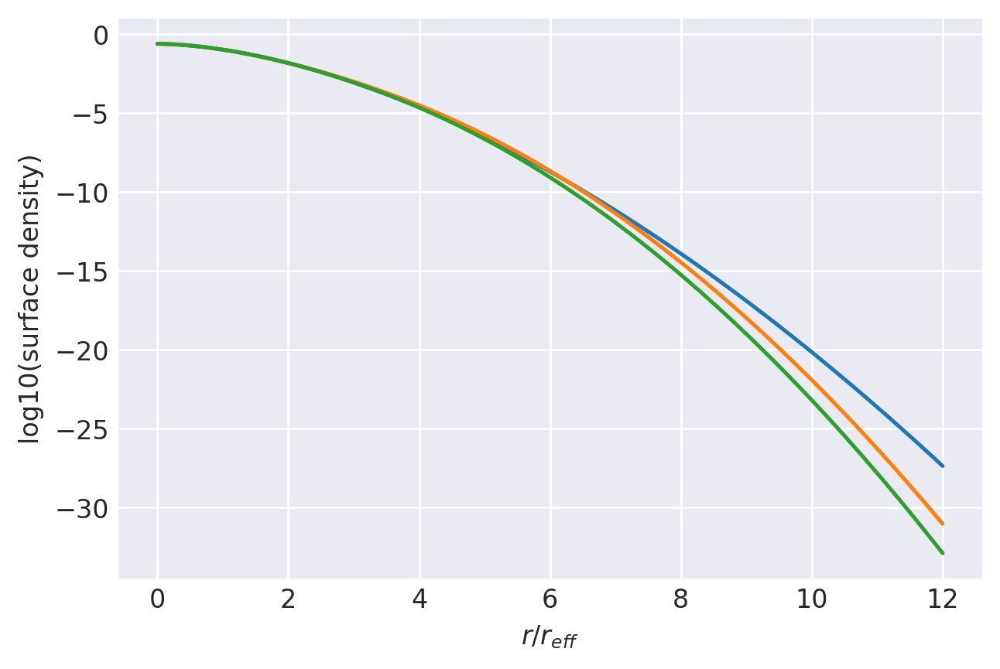

n=0.58: (
    normalize(np.array([4.5627440940e-01, 4.5801419853e-01, 7.7273178826e-02, 7.8676616590e-03, 5.7055159001e-04])),
    np.array([1.1683467566e+00, 9.4363227290e-01, 6.5093086112e-01, 3.8085301923e-01, 1.8069824796e-01]),
),
1.0000000155640396 1.0000000159238078
prev.  chisq = -7.452188946154672
ws, re: (array([0.45627441, 0.4580142 , 0.07727318, 0.00786766, 0.00057055]), array([1.16834676, 0.94363227, 0.65093086, 0.38085302, 0.18069825]))
         Current function value: -12.151353
         Iterations: 97
         Function evaluations: 2013
         Gradient evaluations: 182
-12.151352723716515 [ 0.05535496  1.89423432  2.30636739  2.66082724  0.05289775 -0.03031657
 -0.18894567 -0.42170119 -0.74379745]
1.0000000155640396 1.000000015534611


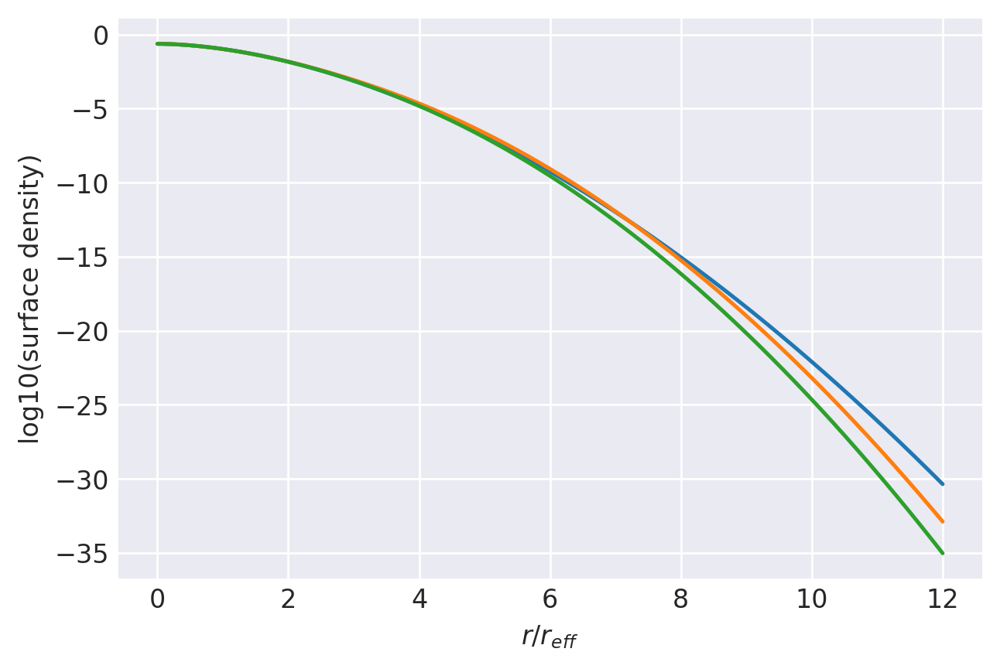

n=0.56: (
    normalize(np.array([5.1383520859e-01, 4.2259270295e-01, 5.7812648759e-02, 5.3832054183e-03, 3.7623428159e-04])),
    np.array([1.1295299365e+00, 9.3257427802e-01, 6.4722357532e-01, 3.7870305436e-01, 1.8038588490e-01]),
),
1.000000015366738 1.0000000165476184
prev.  chisq = -6.391817710965432
ws, re: (array([0.31176674, 0.50952197, 0.15184782, 0.02387212, 0.00299134]), array([1.26358302, 1.00696536, 0.72107801, 0.46050732, 0.26211134]))
         Current function value: -12.387044
         Iterations: 232
         Function evaluations: 3752
         Gradient evaluations: 340
-12.387044085516738 [ 0.20934238  2.01767192  2.33679531  2.67101874  0.04508889 -0.0328943
 -0.18963312 -0.42106138 -0.74157901]
1.000000015366738 1.00000001534422


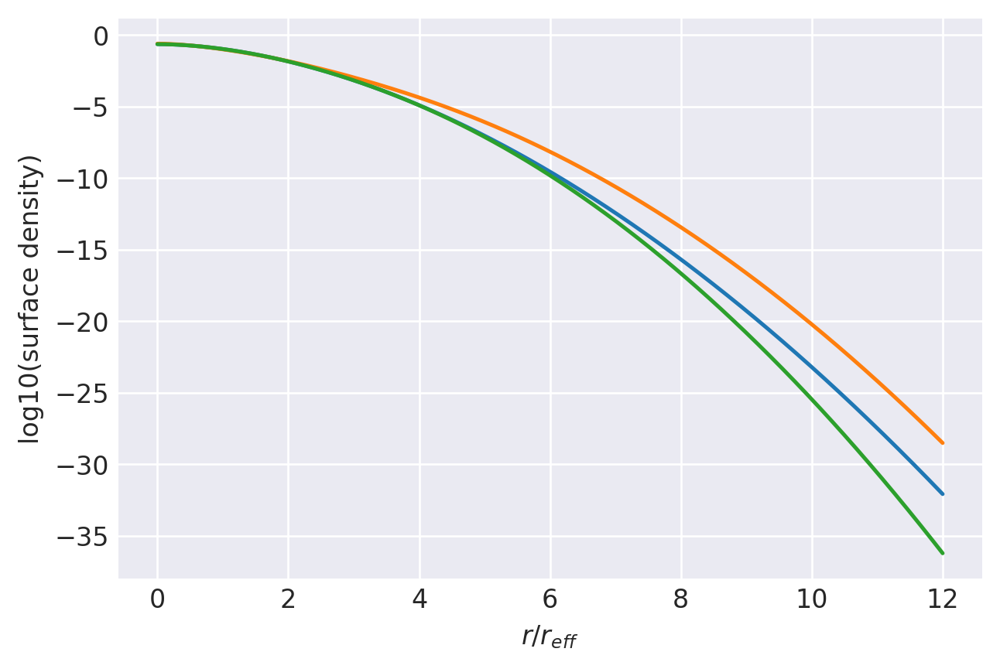

n=0.55: (
    normalize(np.array([5.5214529709e-01, 3.9529450455e-01, 4.7928536367e-02, 4.3319689703e-03, 2.9969302520e-04])),
    np.array([1.1094018518e+00, 9.2705543556e-01, 6.4619989426e-01, 3.7926137736e-01, 1.8130968040e-01]),
),
1.00000001517352 1.00000001534422
prev.  chisq = -8.015510024202827
ws, re: (array([5.52145297e-01, 3.95294505e-01, 4.79285364e-02, 4.33196897e-03,
       2.99693025e-04]), array([1.10940185, 0.92705544, 0.64619989, 0.37926138, 0.18130968]))
         Current function value: -12.661819
         Iterations: 115
         Function evaluations: 1914
         Gradient evaluations: 173
-12.661818637378941 [ 0.40212577  2.16348678  2.36676534  2.6774775   0.03696932 -0.0355063
 -0.19084643 -0.42103548 -0.73969155]
1.00000001517352 1.000000015157044


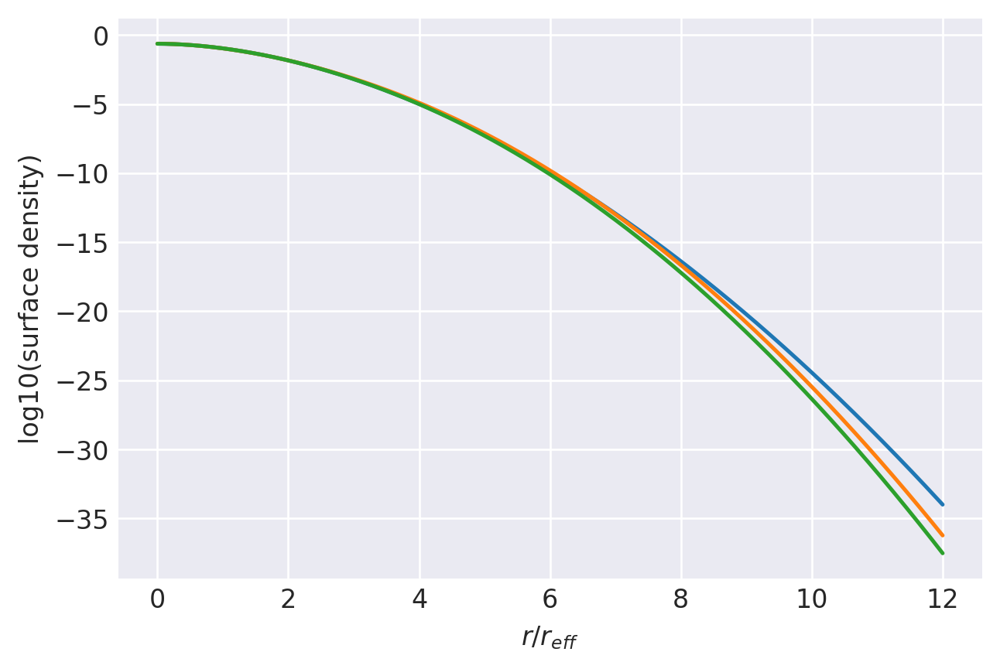

n=0.54: (
    normalize(np.array([5.9919829101e-01, 3.5948801370e-01, 3.7771361281e-02, 3.3145069862e-03, 2.2782702383e-04])),
    np.array([1.0888531764e+00, 9.2149653125e-01, 6.4439708848e-01, 3.7928399702e-01, 1.8209937478e-01]),
),
1.0000000150784267 1.000000015157044
prev.  chisq = -8.605663213534255
ws, re: (array([5.99198291e-01, 3.59488014e-01, 3.77713613e-02, 3.31450699e-03,
       2.27827024e-04]), array([1.08885318, 0.92149653, 0.64439709, 0.379284  , 0.18209937]))
         Current function value: -12.821095
         Iterations: 72
         Function evaluations: 2267
         Gradient evaluations: 205
-12.821095163184612 [ 0.53124641  2.25566855  2.3862771   2.68376608  0.03266247 -0.03731978
 -0.19304865 -0.42346368 -0.74166593]
1.0000000150784267 1.0000000150648582


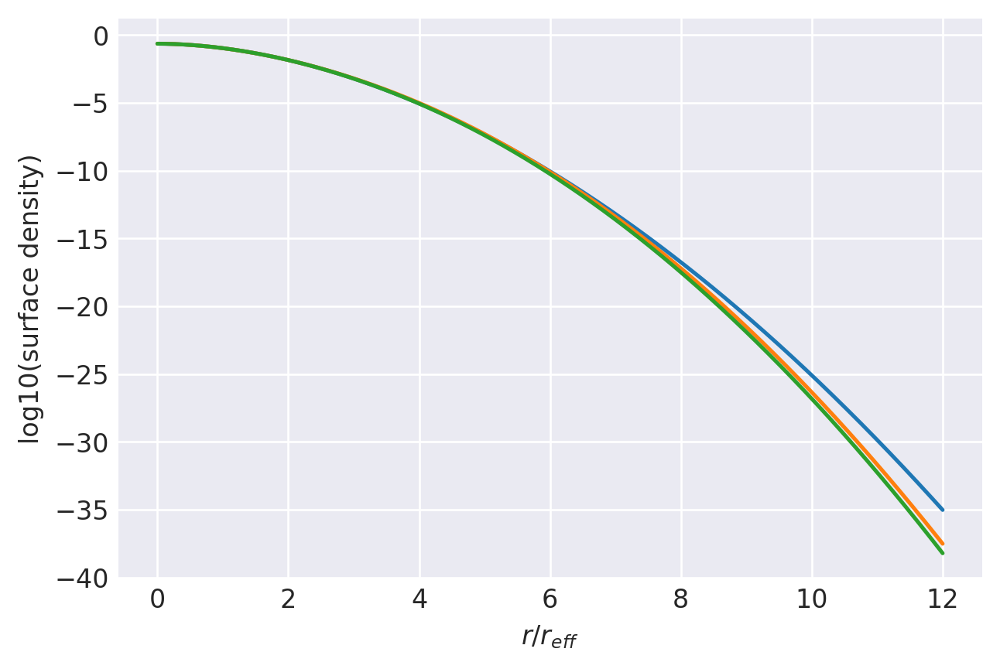

n=0.535: (
    normalize(np.array([6.2977376980e-01, 3.3510596744e-01, 3.2162253723e-02, 2.7688795476e-03, 1.8912949458e-04])),
    np.array([1.0781085002e+00, 9.1765666119e-01, 6.4113774567e-01, 3.7716928873e-01, 1.8127339665e-01]),
),
1.000000014984337 1.0000000150648582
prev.  chisq = -8.597601421155877
ws, re: (array([6.29773770e-01, 3.35105967e-01, 3.21622537e-02, 2.76887955e-03,
       1.89129495e-04]), array([1.0781085 , 0.91765666, 0.64113775, 0.37716929, 0.1812734 ]))
         Current function value: -12.997048
         Iterations: 67
         Function evaluations: 1627
         Gradient evaluations: 147
-12.997047583471003 [ 0.64823302  2.33648105  2.40353511  2.69128785  0.02856572 -0.03781058
 -0.19231823 -0.42219819 -0.73964424]
1.000000014984337 1.0000000149731647


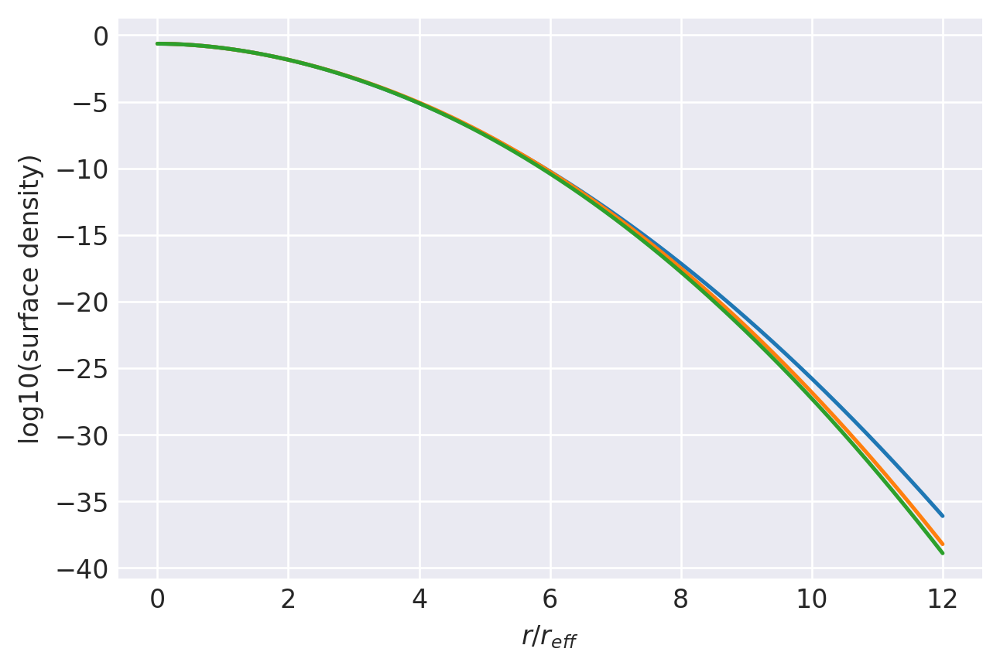

n=0.53: (
    normalize(np.array([6.5661216651e-01, 3.1311945054e-01, 2.7759027355e-02, 2.3500381066e-03, 1.5931748562e-04])),
    np.array([1.0679864031e+00, 9.1662020251e-01, 6.4221696590e-01, 3.7826992238e-01, 1.8211921019e-01]),
),
1.000000014984337 1.0000000150612618
prev.  chisq = -8.034436622248457
ws, re: (array([0.59933484, 0.35956993, 0.03777997, 0.00331526]), array([1.08885318, 0.92149653, 0.64439709, 0.379284  ]))
         Current function value: -11.866127
         Iterations: 73
         Function evaluations: 1191
         Gradient evaluations: 131
-11.86612675237935 [ 1.03949797  2.74177944  2.94245234  0.0252867  -0.05665531 -0.25646952
 -0.57025258]
1.000000014984337 1.0000000149610702


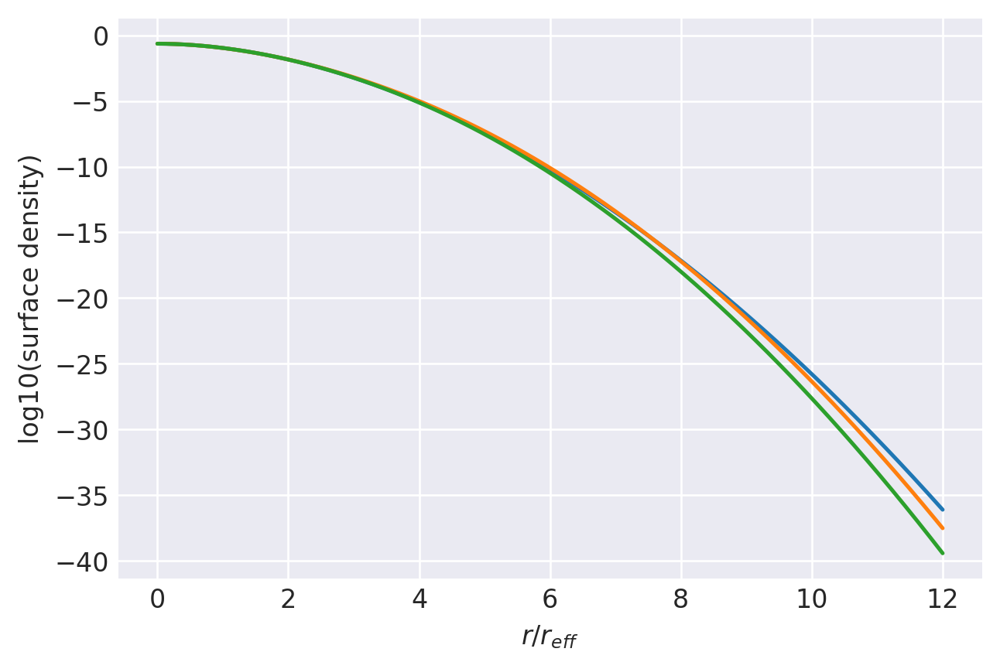

n=0.53: (
    normalize(np.array([7.3875312820e-01, 2.4542769471e-01, 1.5026724116e-02, 7.9245297099e-04])),
    np.array([1.0599532357e+00, 8.7769714840e-01, 5.5402642897e-01, 2.6899699021e-01]),
),
1.000000014891245 1.0000000149610702
prev.  chisq = -8.58937138783239
ws, re: (array([0.73875313, 0.24542769, 0.01502672, 0.00079245]), array([1.05995324, 0.87769715, 0.55402643, 0.26899699]))
         Current function value: -12.063909
         Iterations: 50
         Function evaluations: 1254
         Gradient evaluations: 138
-12.063908737481464 [ 1.20455043  2.8321562   2.95494346  0.02134281 -0.05747228 -0.25775645
 -0.57124271]
1.000000014891245 1.0000000148728263


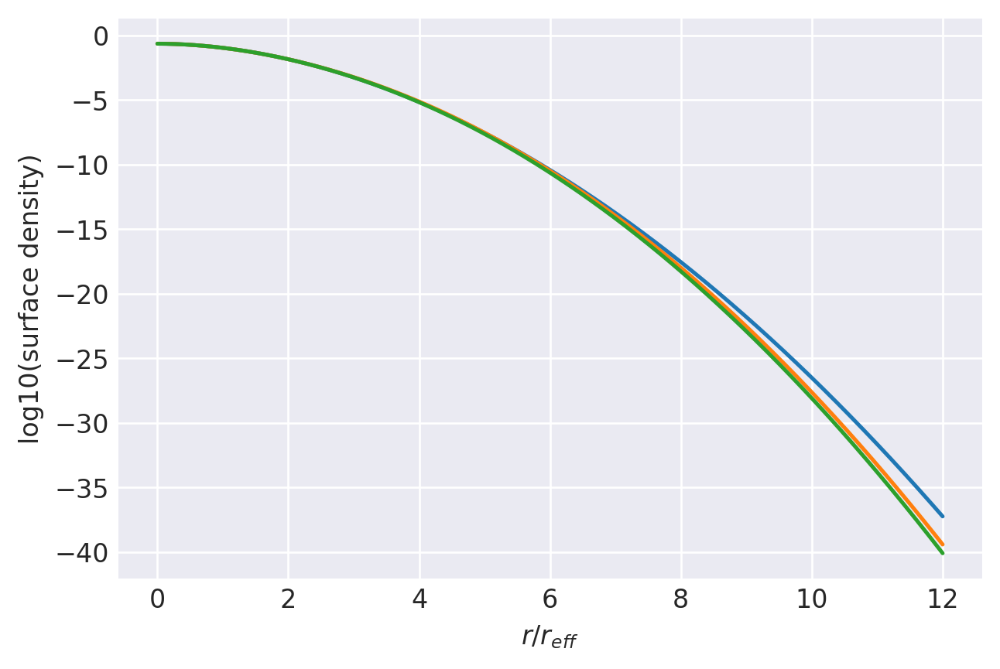

n=0.525: (
    normalize(np.array([7.6933329111e-01, 2.1783909121e-01, 1.2192607130e-02, 6.3501054964e-04])),
    np.array([1.0503712131e+00, 8.7604763161e-01, 5.5238713125e-01, 2.6838441626e-01]),
),
1.000000014799145 1.0000000148728263
prev.  chisq = -8.581147263182615
ws, re: (array([7.69333291e-01, 2.17839091e-01, 1.21926071e-02, 6.35010550e-04]), array([1.05037121, 0.87604763, 0.55238713, 0.26838442]))
         Current function value: -12.298731
         Iterations: 48
         Function evaluations: 992
         Gradient evaluations: 109
-12.29873135983647 [ 1.40175766  2.92573599  2.96500193  0.0173523  -0.05789957 -0.25827789
 -0.57114444]
1.000000014799145 1.0000000147850436


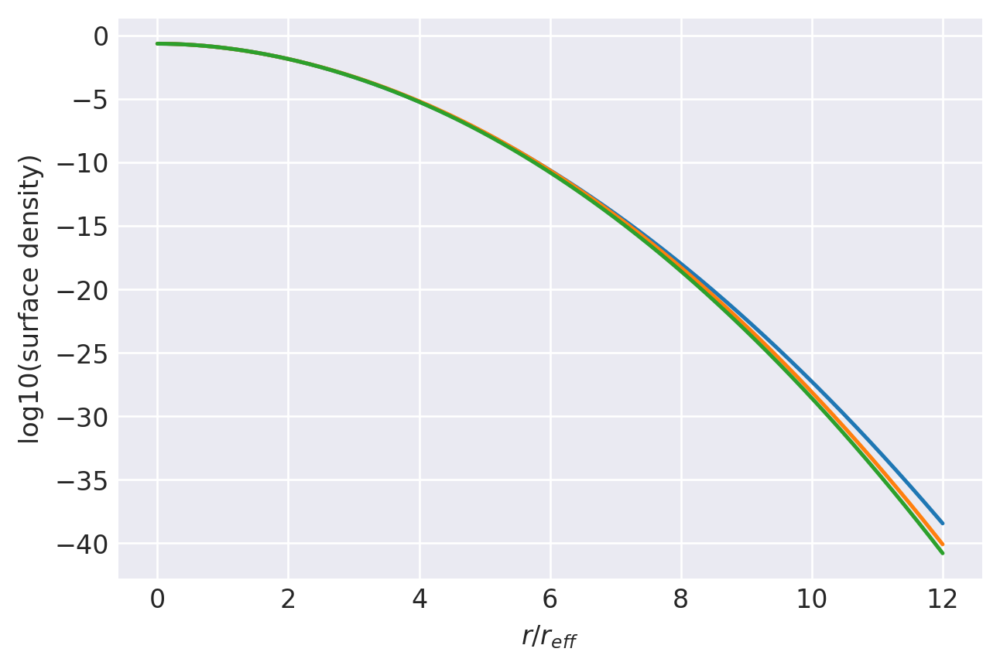

n=0.52: (
    normalize(np.array([8.0246265385e-01, 1.8748350391e-01, 9.5608797516e-03, 4.9296249415e-04])),
    np.array([1.0407640924e+00, 8.7518613346e-01, 5.5172430276e-01, 2.6844514757e-01]),
),
1.0000000147080328 1.0000000147850436
prev.  chisq = -8.572849964440458
ws, re: (array([8.02462654e-01, 1.87483504e-01, 9.56087975e-03, 4.92962494e-04]), array([1.04076409, 0.87518613, 0.5517243 , 0.26844515]))
         Current function value: -12.591653
         Iterations: 62
         Function evaluations: 1569
         Gradient evaluations: 173
-12.591653387057086 [ 1.66793065  3.03117732  2.97522019  0.0132094  -0.05855326 -0.25966254
 -0.57217685]
1.0000000147080328 1.0000000146980075


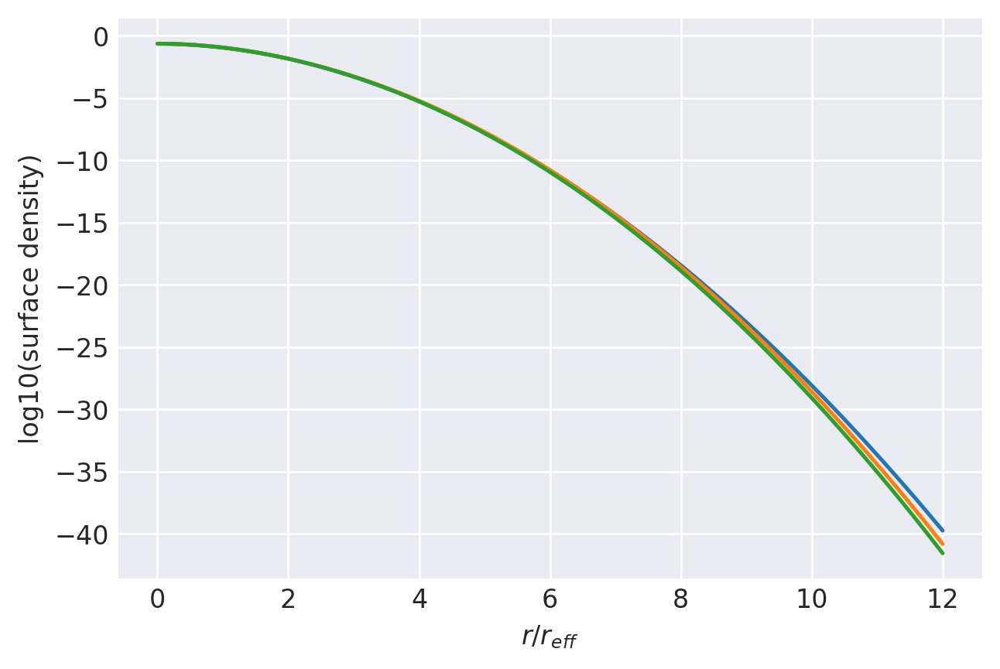

n=0.515: (
    normalize(np.array([8.4129972796e-01, 1.5139417263e-01, 6.9513299760e-03, 3.5476943250e-04])),
    np.array([1.0308830531e+00, 8.7386981676e-01, 5.4996804427e-01, 2.6780775396e-01]),
),


In [4]:
# np.round(10**np.linspace(np.log10(0.5005), np.log10(6.3), num=200), 4)
# First attempt to manually finagle a smooth spline with free weights and radii while gradually removing components
# It does not work very well

# These initial parameters are not terribly important
nvals = [
    (
        np.array([0.501]),
        (normalize(np.array([0.98, 0.02])), np.array([1.01, 0.9])),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
nvals = [
    (
        np.array([0.507]),
        (
    normalize(np.array([8.7013734755e-01, 1.2619085952e-01, 3.6717929279e-03])),
    np.array([1.0339248832e+00, 8.1955230658e-01, 4.2170643991e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
# The rest of these required working backwards and repeatedly re-starting guesses to produce a smooth spline
nvals = [
    (
        np.array([0.95, 0.9, 0.85, 0.8, 0.75]),
        (
	normalize(np.array([7.7900190678e-02, 3.1264016273e-01, 3.3937178782e-01, 1.8392530470e-01, 6.5418042323e-02, 1.7095071454e-02, 3.2661231097e-03, 3.8331719642e-04])),
	np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02])
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
nvals = [
    (
        np.array([0.70]),
        (
    normalize(np.array([1.0845562525e-01, 4.0294151495e-01, 3.2729844440e-01, 1.2246687144e-01, 3.1333936150e-02, 6.3893051250e-03, 1.0137209694e-03])),
    np.array([1.6116987996e+00, 1.2333069456e+00, 9.0359039048e-01, 6.2645430811e-01, 4.0957694795e-01, 2.5288574221e-01, 1.3272691536e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
nvals = [
    (
        np.array([0.65]),
        (
    normalize(np.array([1.1584759935e-01, 4.4925832966e-01, 3.1925666847e-01, 9.4161947089e-02, 1.8473365773e-02, 2.7452558180e-03])),
    np.array([1.5085840400e+00, 1.1827064676e+00, 8.7020346704e-01, 5.9083650141e-01, 3.6842090584e-01, 2.0622530253e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
nvals = [
    (
        np.array([0.6, 0.58, 0.56]),
        (
            normalize(np.array([4.19e-01        , 4.975e-01       , 9.25e-02        , 1.23e-02        , 7.0e-04])),
            np.array([1.195e+00       , 9.656e-01       , 6.7e-01       , 4.5e-01       , 2.08e-01        ]),
        )
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
nvals = [
    (
        np.array([0.55, 0.54, 0.535, 0.53]),
        (
    normalize(np.array([3.1168895061e-01, 5.0939483801e-01, 1.5180993252e-01, 2.3866167881e-02, 2.9905915132e-03])),
    np.array([1.2635830241e+00, 1.0069653570e+00, 7.2107800516e-01, 4.6050732036e-01, 2.6211133918e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
nvals = [
    (
        np.array([0.53, 0.525, 0.52, 0.515]),
        (
    normalize(np.array([5.9919829101e-01, 3.5948801370e-01, 3.7771361281e-02, 3.3145069862e-03])),
    np.array([1.0888531764e+00, 9.2149653125e-01, 6.4439708848e-01, 3.7928399702e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])

## Why can't you just fit N components down to n=0.5?

You can try, but it doesn't work well below n=0.6 as the smallest component(s) gradually reduce their weights to near-zero values. Once this happens, it becomes very difficult to ensure smooth changes in the best-fit weight even given small changes in n - the best-fit weights are essentially 'noisy'.

0.9999999914677243 1.0000000283694637
prev.  chisq = -10.92882749800659
ws, re: (array([0.07790019, 0.31264016, 0.33937179, 0.1839253 , 0.06541804,
       0.01709507, 0.00326612, 0.00038332]), array([2.17045661, 1.47679133, 0.99494464, 0.65054022, 0.40699848,
       0.23877605, 0.12631553, 0.05405815]))
         Current function value: -10.928831
         Iterations: 11
         Function evaluations: 1185
         Gradient evaluations: 69
-10.928831306589267 [-2.47095375e+00 -6.67489981e-01  2.28175095e-01  7.58180742e-01
  1.14859215e+00  1.54422292e+00  2.14252775e+00  3.36535868e-01
  1.69305642e-01 -2.20048990e-03 -1.86707161e-01 -3.90387752e-01
 -6.21998233e-01 -8.98532198e-01 -1.26716661e+00]
0.9999999914677243 1.000000028369817


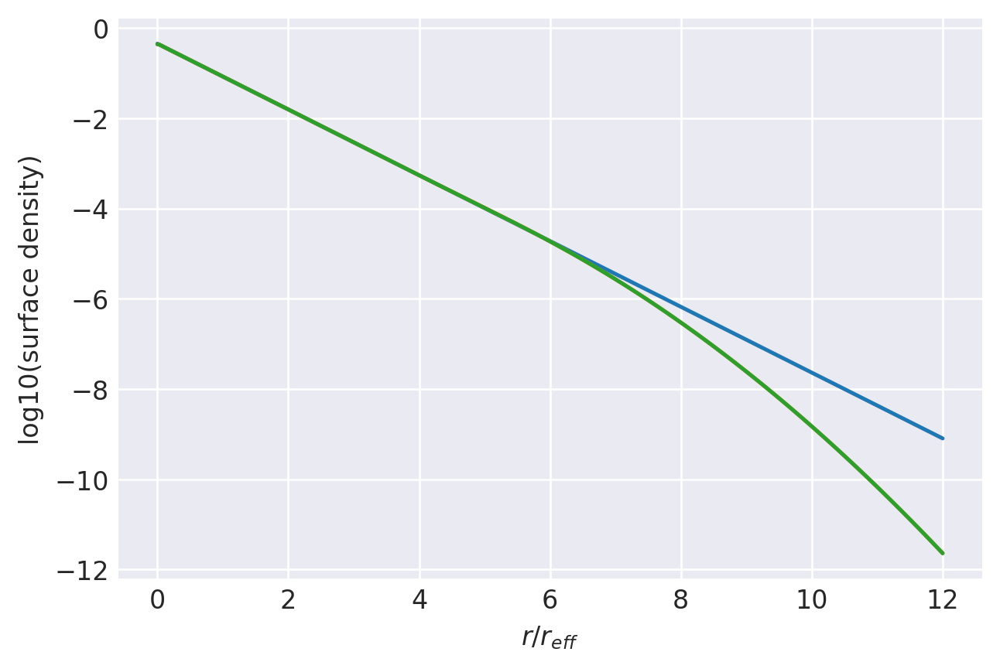

n=1.0: (
    normalize(np.array([7.7919682300e-02, 3.1263972612e-01, 3.3933503571e-01, 1.8393070736e-01, 6.5428570239e-02, 1.7096546835e-02, 3.2663945086e-03, 3.8333692824e-04])),
    np.array([2.1703804472e+00, 1.4767454532e+00, 9.9494599942e-01, 6.5056821172e-01, 4.0701671809e-01, 2.3878209990e-01, 1.2631874480e-01, 5.4054690629e-02]),
),
0.9999999965981404 1.000000028369817
prev.  chisq = -9.13019052985866
ws, re: (array([0.07791968, 0.31263973, 0.33933504, 0.18393071, 0.06542857,
       0.01709655, 0.00326639, 0.00038334]), array([2.17038045, 1.47674545, 0.994946  , 0.65056821, 0.40701672,
       0.2387821 , 0.12631874, 0.05405469]))
         Current function value: -10.950395
         Iterations: 47
         Function evaluations: 2391
         Gradient evaluations: 140
-10.950394823119355 [-2.46364834 -0.65973694  0.23535019  0.76423871  1.15332769  1.548043
  2.14595816  0.33411515  0.16772479 -0.0031534  -0.18717722 -0.39047364
 -0.62175276 -0.89798889 -1.26624936]
0.99999999659

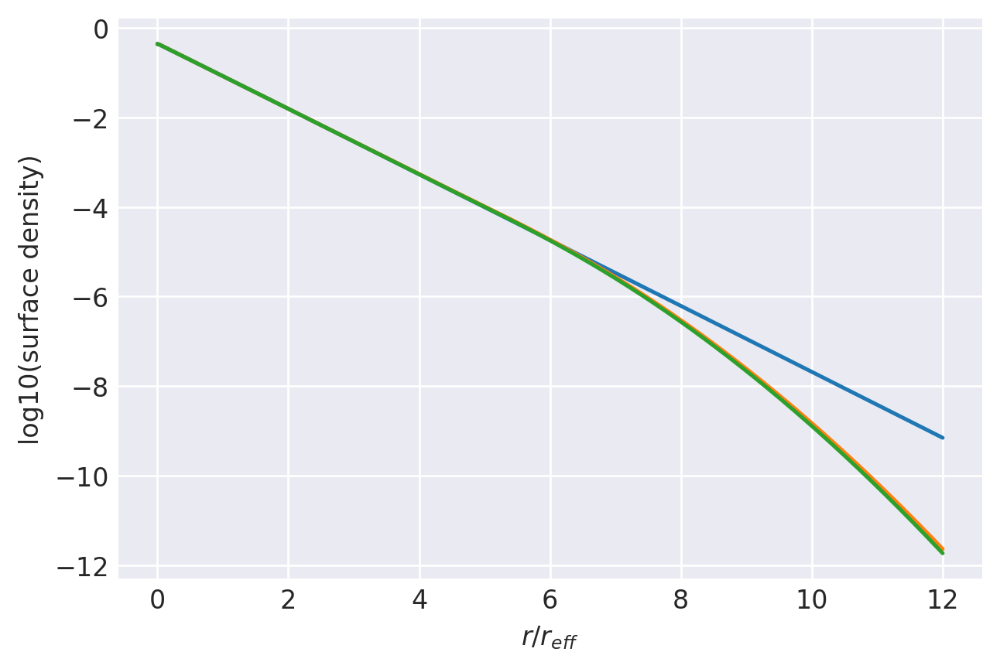

n=0.995: (
    normalize(np.array([7.8446183932e-02, 3.1406434947e-01, 3.3932384870e-01, 1.8296223981e-01, 6.4764639051e-02, 1.6854415782e-02, 3.2090104756e-03, 3.7531277364e-04])),
    np.array([2.1583165776e+00, 1.4713798133e+00, 9.9276532523e-01, 6.4986444561e-01, 4.0693622906e-01, 2.3891710322e-01, 1.2647686885e-01, 5.4168977602e-02]),
),
1.0000000010516281 1.0000000281824708
prev.  chisq = -9.126334939179626
ws, re: (array([0.07844618, 0.31406435, 0.33932385, 0.18296224, 0.06476464,
       0.01685442, 0.00320901, 0.00037531]), array([2.15831658, 1.47137981, 0.99276533, 0.64986445, 0.40693623,
       0.2389171 , 0.12647687, 0.05416898]))
         Current function value: -10.972226
         Iterations: 34
         Function evaluations: 2120
         Gradient evaluations: 124
-10.97222600646666 [-2.45946858 -0.65338749  0.24207346  0.77013119  1.15795415  1.55161545
  2.14885148  0.3318619   0.16634271 -0.00390661 -0.18745521 -0.39036681
 -0.62130452 -0.89719975 -1.26506099]
1.000000

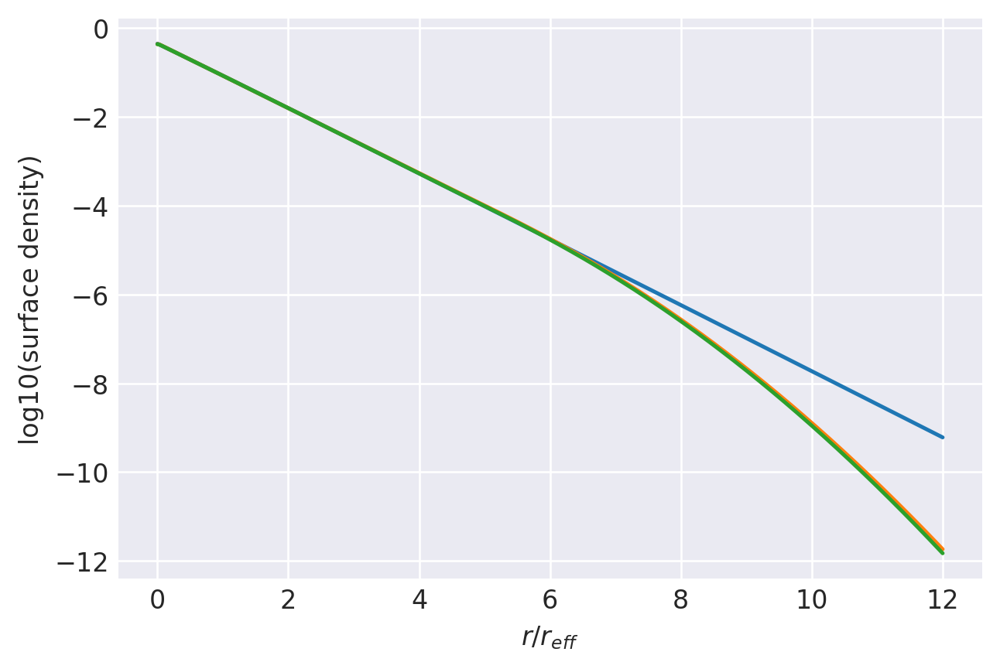

n=0.99: (
    normalize(np.array([7.8748882011e-02, 3.1527662000e-01, 3.3948179457e-01, 1.8216089349e-01, 6.4173199336e-02, 1.6633815653e-02, 3.1566703056e-03, 3.6812463680e-04])),
    np.array([2.1471476039e+00, 1.4667048040e+00, 9.9104503426e-01, 6.4944861490e-01, 4.0703634466e-01, 2.3916382111e-01, 1.2670689594e-01, 5.4317404722e-02]),
),
1.0000000049031 1.0000000279936356
prev.  chisq = -9.12244604015327
ws, re: (array([0.07874888, 0.31527662, 0.33948179, 0.18216089, 0.0641732 ,
       0.01663382, 0.00315667, 0.00036812]), array([2.1471476 , 1.4667048 , 0.99104503, 0.64944861, 0.40703634,
       0.23916382, 0.1267069 , 0.0543174 ]))
         Current function value: -10.994306
         Iterations: 31
         Function evaluations: 1882
         Gradient evaluations: 110
-10.994305676803238 [-2.45609209 -0.64749145  0.2486469   0.77589106  1.16230703  1.55489832
  2.15162808  0.32964481  0.16501613 -0.00459278 -0.18766145 -0.39016926
 -0.62073237 -0.89625056 -1.26370165]
1.0000000049

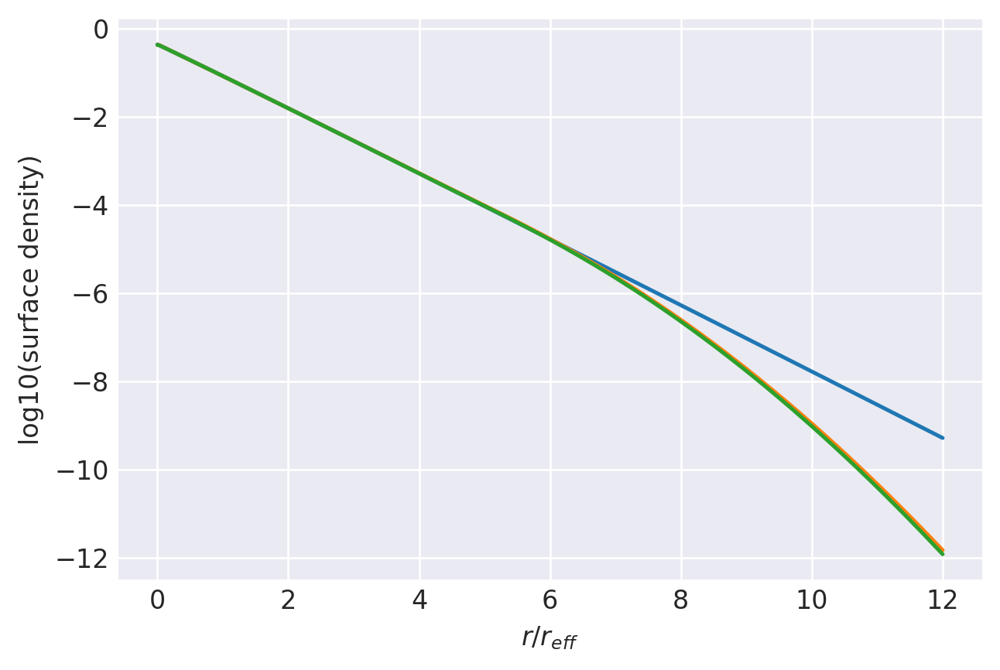

n=0.985: (
    normalize(np.array([7.8994186452e-02, 3.1641620349e-01, 3.3968469926e-01, 1.8140525885e-01, 6.3605998603e-02, 1.6424599579e-02, 3.1076505756e-03, 3.6140318626e-04])),
    np.array([2.1362142657e+00, 1.4622314919e+00, 9.8948045158e-01, 6.4914027013e-01, 4.0722153691e-01, 2.3947910549e-01, 1.2698412679e-01, 5.4487684484e-02]),
),
1.0000000082206035 1.0000000278041312
prev.  chisq = -9.118494536639165
ws, re: (array([0.07899419, 0.3164162 , 0.3396847 , 0.18140526, 0.063606  ,
       0.0164246 , 0.00310765, 0.0003614 ]), array([2.13621427, 1.46223149, 0.98948045, 0.64914027, 0.40722154,
       0.23947911, 0.12698413, 0.05448768]))
         Current function value: -11.016806
         Iterations: 35
         Function evaluations: 2154
         Gradient evaluations: 126
-11.016805939104628 [-2.46443821 -0.64862918  0.25129699  0.78000698  1.16658717  1.55891906
  2.15520979  0.32802838  0.16449591 -0.00431938 -0.18681868 -0.38891911
 -0.61917687 -0.89443358 -1.26154236]
1.00000

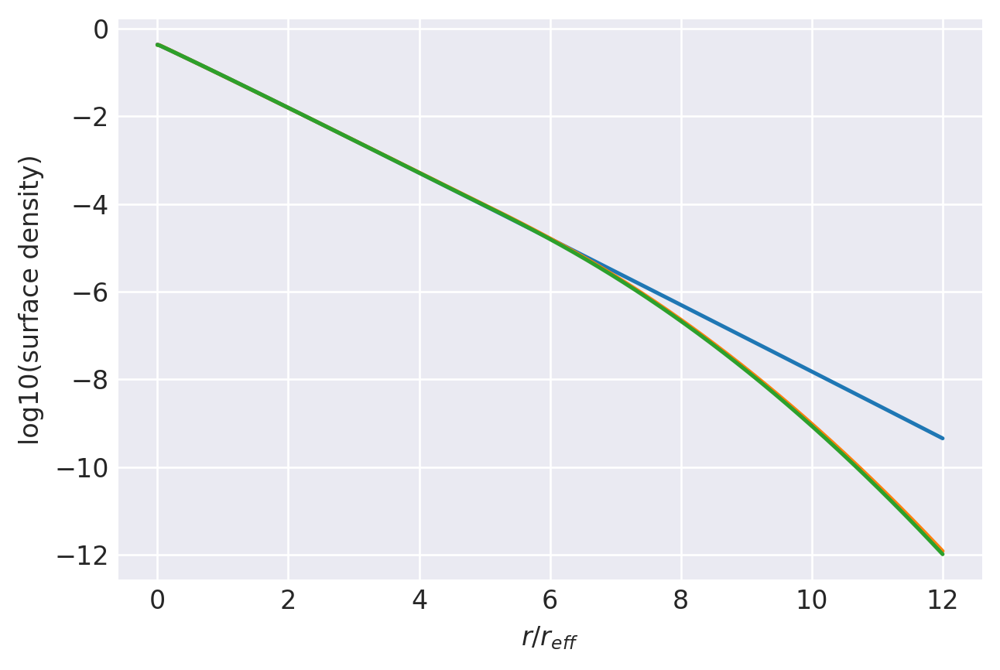

n=0.98: (
    normalize(np.array([7.8389101272e-02, 3.1638765311e-01, 3.4043547772e-01, 1.8156010509e-01, 6.3463387972e-02, 1.6329208096e-02, 3.0783508966e-03, 3.5671584639e-04])),
    np.array([2.1282781338e+00, 1.4604809912e+00, 9.9010354726e-01, 6.5040118063e-01, 4.0839544944e-01, 2.4033837843e-01, 1.2751651151e-01, 5.4759268657e-02]),
),
1.000000011065797 1.0000000276122119
prev.  chisq = -9.114498375078561
ws, re: (array([0.0783891 , 0.31638765, 0.34043548, 0.18156011, 0.06346339,
       0.01632921, 0.00307835, 0.00035672]), array([2.12827813, 1.46048099, 0.99010355, 0.65040118, 0.40839545,
       0.24033838, 0.12751651, 0.05475927]))
         Current function value: -11.039360
         Iterations: 27
         Function evaluations: 2001
         Gradient evaluations: 117
-11.03935978732177 [-2.46301116 -0.64387859  0.25669578  0.78476661  1.17078596  1.56251075
  2.15789807  0.32589236  0.16329458 -0.00481734 -0.18674047 -0.38838129
 -0.61827238 -0.89319519 -1.25985961]
1.00000001

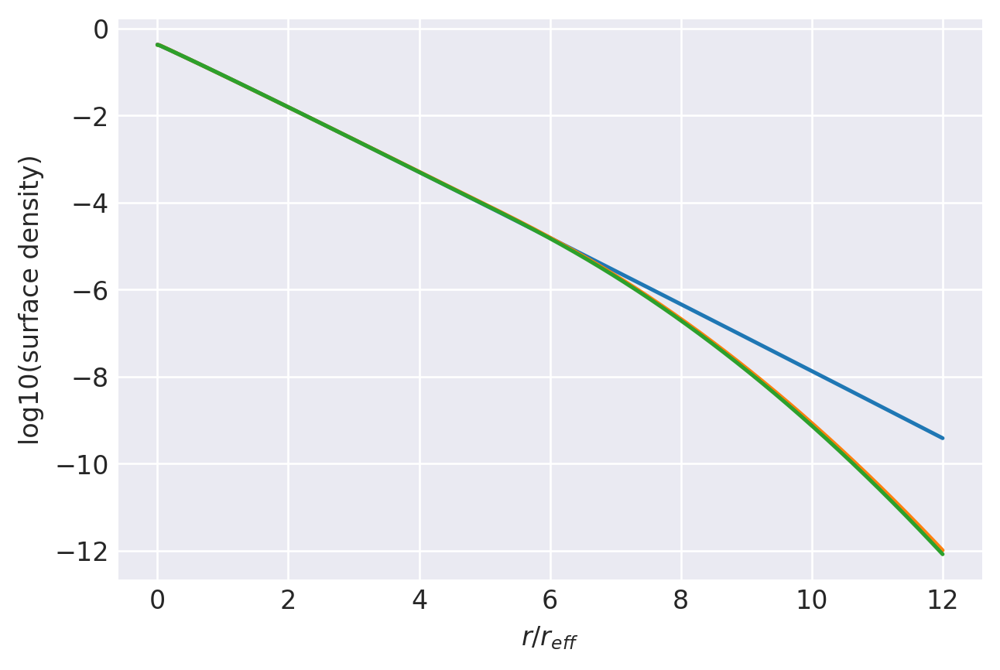

n=0.975: (
    normalize(np.array([7.8492259575e-02, 3.1733990238e-01, 3.4064424822e-01, 1.8096336632e-01, 6.3017149586e-02, 1.6156519811e-02, 3.0357224100e-03, 3.5083170430e-04])),
    np.array([2.1178361862e+00, 1.4564466460e+00, 9.8896894906e-01, 6.5051832346e-01, 4.0890150279e-01, 2.4083944712e-01, 1.2788064118e-01, 5.4971854773e-02]),
),
1.0000000134944007 1.000000027422825
prev.  chisq = -9.110646846051111
ws, re: (array([0.07849226, 0.3173399 , 0.34064425, 0.18096337, 0.06301715,
       0.01615652, 0.00303572, 0.00035083]), array([2.11783619, 1.45644665, 0.98896895, 0.65051832, 0.4089015 ,
       0.24083945, 0.12788064, 0.05497185]))
         Current function value: -11.062136
         Iterations: 28
         Function evaluations: 2528
         Gradient evaluations: 148
-11.062136040274215 [-2.45871564 -0.63739555  0.26400955  0.79154753  1.17567091  1.56535566
  2.16004191  0.32359416  0.16190237 -0.00557425 -0.18706514 -0.38836949
 -0.61788717 -0.89236142 -1.2585665 ]
1.000000

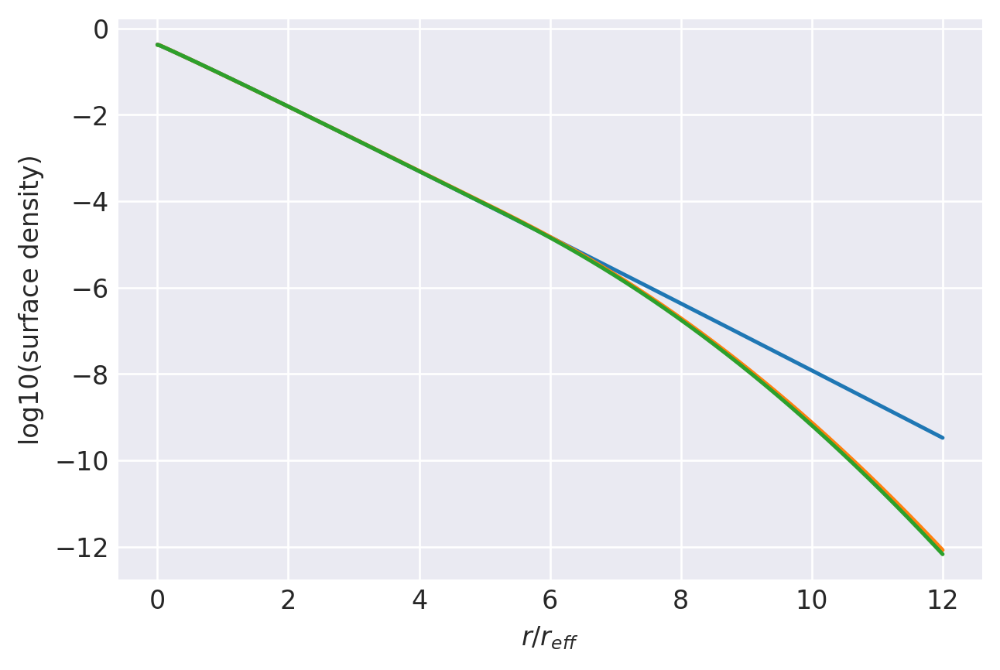

n=0.97: (
    normalize(np.array([7.8803523011e-02, 3.1858245887e-01, 3.4085154814e-01, 1.8013538246e-01, 6.2376851464e-02, 1.5922265126e-02, 2.9838701624e-03, 3.4410076591e-04])),
    np.array([2.1066586105e+00, 1.4517852082e+00, 9.8724682936e-01, 6.5003217856e-01, 4.0891261440e-01, 2.4105316221e-01, 1.2812638619e-01, 5.5135777007e-02]),
),
1.000000015556635 1.0000000272352878
prev.  chisq = -9.106441016085684
ws, re: (array([0.07880352, 0.31858246, 0.34085155, 0.18013538, 0.06237685,
       0.01592227, 0.00298387, 0.0003441 ]), array([2.10665861, 1.45178521, 0.98724683, 0.65003218, 0.40891261,
       0.24105316, 0.12812639, 0.05513578]))
         Current function value: -11.085086
         Iterations: 28
         Function evaluations: 2324
         Gradient evaluations: 136
-11.085085602363145 [-2.44707234 -0.62607741  0.27405557  0.79956012  1.18149979  1.56978169
  2.16302617  0.320923    0.15999254 -0.00695754 -0.18807437 -0.38907559
 -0.61832067 -0.89250103 -1.25824509]
1.0000000

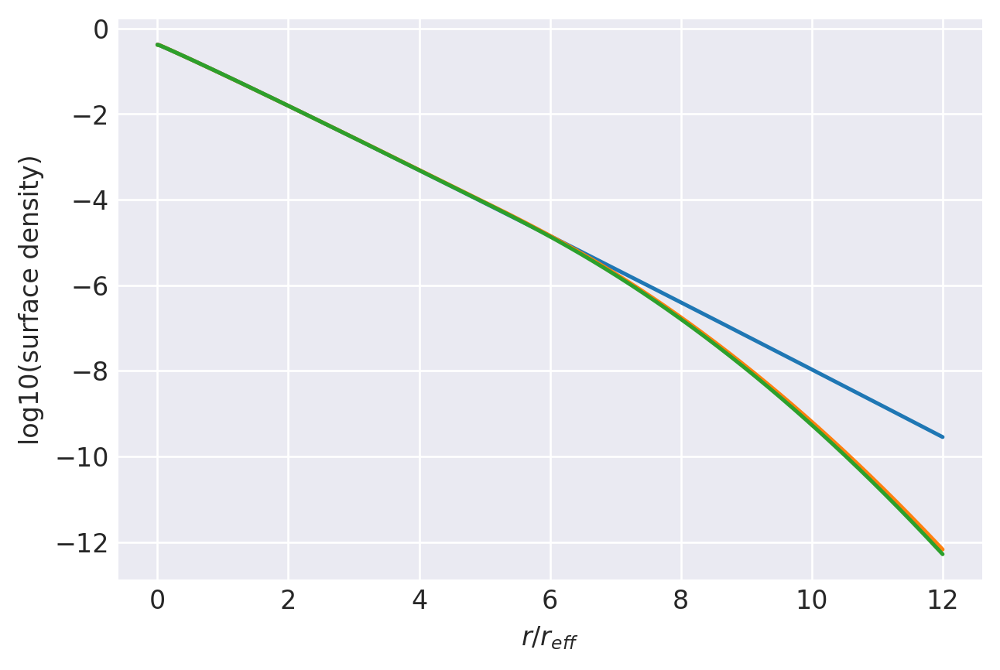

n=0.965: (
    normalize(np.array([7.9652906813e-02, 3.2064939074e-01, 3.4068122966e-01, 1.7869038231e-01, 6.1466919163e-02, 1.5610725907e-02, 2.9134649523e-03, 3.3498045458e-04])),
    np.array([2.0937412212e+00, 1.4454149529e+00, 9.8410731982e-01, 6.4852336195e-01, 4.0824832753e-01, 2.4081266904e-01, 1.2808520606e-01, 5.5176596936e-02]),
),
1.0000000172976387 1.0000000270498608
prev.  chisq = -9.102282006539676
ws, re: (array([7.96529068e-02, 3.20649391e-01, 3.40681230e-01, 1.78690382e-01,
       6.14669192e-02, 1.56107259e-02, 2.91346495e-03, 3.34980455e-04]), array([2.09374122, 1.44541495, 0.98410732, 0.64852336, 0.40824833,
       0.24081267, 0.12808521, 0.0551766 ]))
         Current function value: -11.108129
         Iterations: 31
         Function evaluations: 2154
         Gradient evaluations: 126
-11.108129091164827 [-2.43454043 -0.61376267  0.28474401  0.80742294  1.18696884  1.57348645
  2.16692768  0.31820997  0.15800816 -0.00845507 -0.18919264 -0.38984782
 -0.61876171 

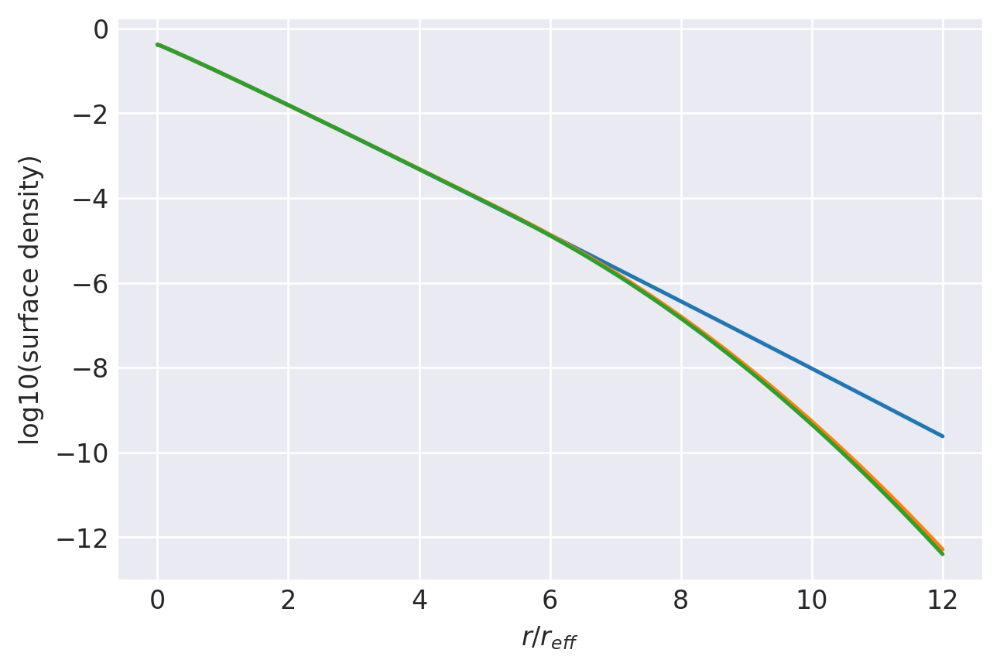

n=0.96: (
    normalize(np.array([8.0576453325e-02, 3.2290280030e-01, 3.4043969613e-01, 1.7709543098e-01, 6.0518663358e-02, 1.5295811356e-02, 2.8452778659e-03, 3.2586667691e-04])),
    np.array([2.0807024304e+00, 1.4388256059e+00, 9.8071976898e-01, 6.4685562505e-01, 4.0752304916e-01, 2.4056824190e-01, 1.2805531444e-01, 5.5198631668e-02]),
),
1.0000000187578688 1.0000000268654716
prev.  chisq = -9.098197918508665
ws, re: (array([8.05764533e-02, 3.22902800e-01, 3.40439696e-01, 1.77095431e-01,
       6.05186634e-02, 1.52958114e-02, 2.84527787e-03, 3.25866677e-04]), array([2.08070243, 1.43882561, 0.98071977, 0.64685563, 0.40752305,
       0.24056824, 0.12805531, 0.05519863]))
         Current function value: -11.131580
         Iterations: 33
         Function evaluations: 2170
         Gradient evaluations: 127
-11.131580038586463 [-2.42828675 -0.60579192  0.29268838  0.81409483  1.19195552  1.57717286
  2.16985861  0.31580255  0.15647728 -0.00936014 -0.18963252 -0.38991212
 -0.61848089 -

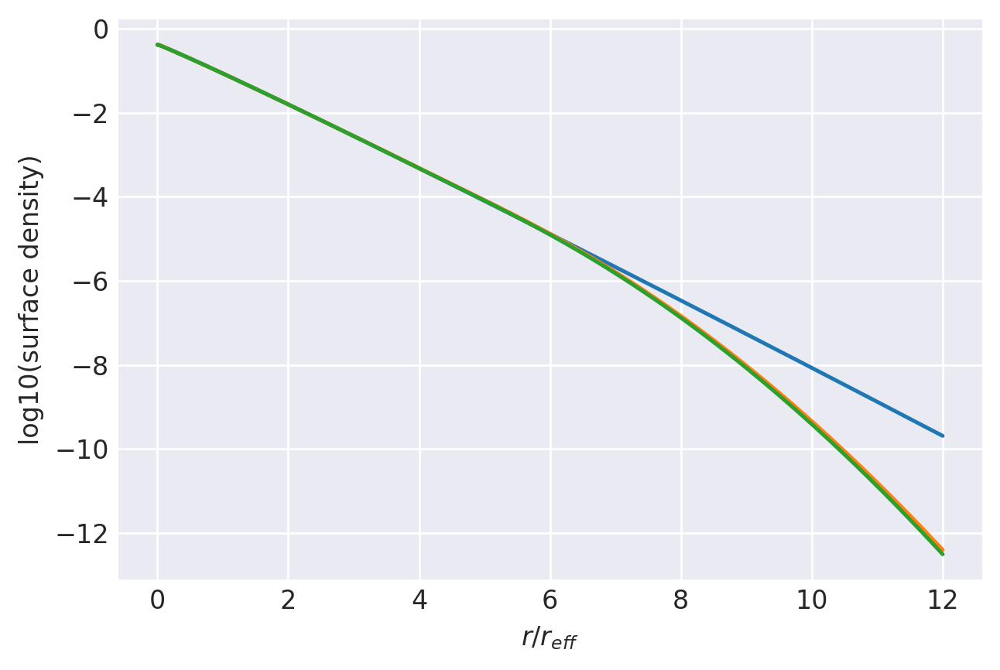

n=0.955: (
    normalize(np.array([8.1040966768e-02, 3.2441065469e-01, 3.4047060583e-01, 1.7607117085e-01, 5.9838132967e-02, 1.5058095207e-02, 2.7915913744e-03, 3.1878231861e-04])),
    np.array([2.0692003931e+00, 1.4337627137e+00, 9.7867808047e-01, 6.4620077939e-01, 4.0746271722e-01, 2.4072384138e-01, 1.2824200177e-01, 5.5335703966e-02]),
),
1.0000000199734806 1.0000000266798026
prev.  chisq = -9.094011485824725
ws, re: (array([8.10409668e-02, 3.24410655e-01, 3.40470606e-01, 1.76071171e-01,
       5.98381330e-02, 1.50580952e-02, 2.79159137e-03, 3.18782319e-04]), array([2.06920039, 1.43376271, 0.97867808, 0.64620078, 0.40746272,
       0.24072384, 0.128242  , 0.0553357 ]))
         Current function value: -11.155314
         Iterations: 36
         Function evaluations: 2069
         Gradient evaluations: 121
-11.155313881284531 [-2.42280348 -0.5982304   0.30047885  0.82073382  1.19703641  1.58101362
  2.17312395  0.31342707  0.1549982  -0.01020124 -0.19000346 -0.3899095
 -0.61814701 -

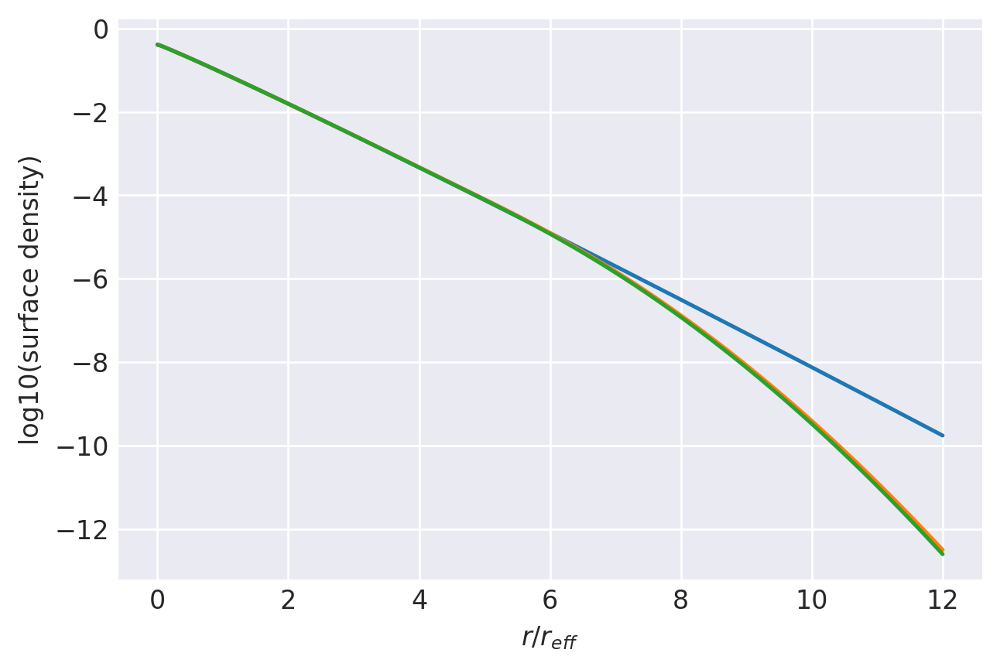

n=0.95: (
    normalize(np.array([8.1450263763e-02, 3.2585428363e-01, 3.4053884485e-01, 1.7509555332e-01, 5.9182670718e-02, 1.4827402200e-02, 2.7392015200e-03, 3.1177999432e-04])),
    np.array([2.0579132805e+00, 1.4288880244e+00, 9.7678450884e-01, 6.4564909129e-01, 4.0746517450e-01, 2.4090898319e-01, 1.2843833062e-01, 5.5469238331e-02]),
),
1.0000000209766844 1.0000000264952296
prev.  chisq = -9.089793455428488
ws, re: (array([8.14502638e-02, 3.25854284e-01, 3.40538845e-01, 1.75095553e-01,
       5.91826707e-02, 1.48274022e-02, 2.73920152e-03, 3.11779994e-04]), array([2.05791328, 1.42888802, 0.97678451, 0.64564909, 0.40746517,
       0.24090898, 0.12843833, 0.05546924]))
         Current function value: -11.179742
         Iterations: 32
         Function evaluations: 2358
         Gradient evaluations: 138
-11.179742296730915 [-2.43100911 -0.60013655  0.30207916  0.82398455  1.20061603  1.5839859
  2.17546421  0.31170443  0.15448175 -0.00978032 -0.18887797 -0.38826947
 -0.61609232 -0

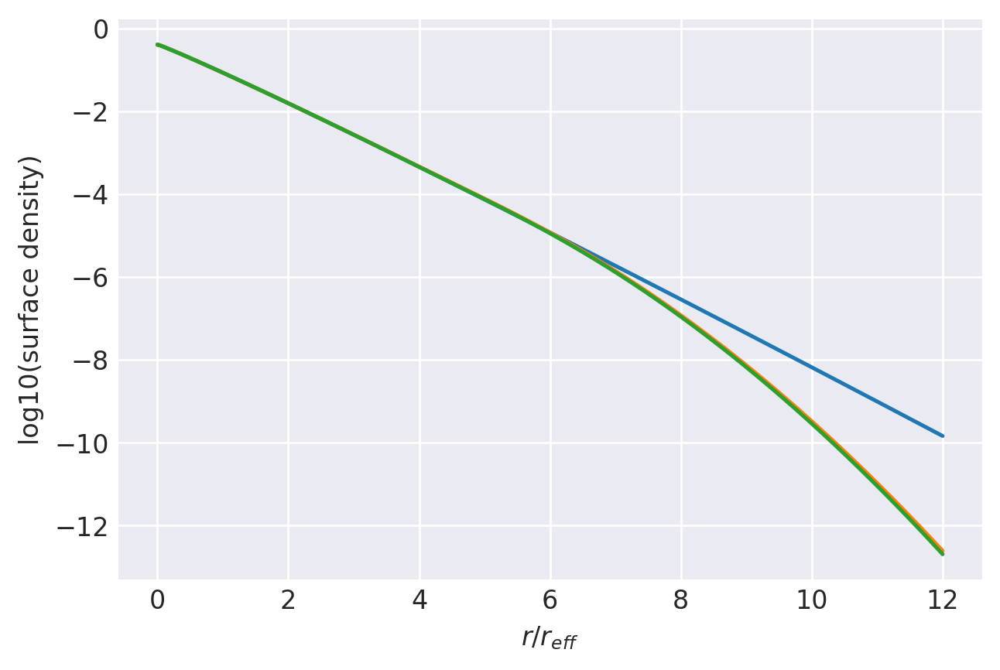

n=0.945: (
    normalize(np.array([8.0838455136e-02, 3.2567038291e-01, 3.4122816179e-01, 1.7534334294e-01, 5.9123091044e-02, 1.4767026054e-02, 2.7206010931e-03, 3.0893902196e-04])),
    np.array([2.0497666873e+00, 1.4271898496e+00, 9.7773166817e-01, 6.4732448277e-01, 4.0900680557e-01, 2.4205144694e-01, 1.2917105921e-01, 5.5858036130e-02]),
),
1.0000000217960912 1.0000000263078044
prev.  chisq = -9.085461823601229
ws, re: (array([8.08384551e-02, 3.25670383e-01, 3.41228162e-01, 1.75343343e-01,
       5.91230910e-02, 1.47670261e-02, 2.72060109e-03, 3.08939022e-04]), array([2.04976669, 1.42718985, 0.97773167, 0.64732448, 0.40900681,
       0.24205145, 0.12917106, 0.05585804]))
         Current function value: -11.204047
         Iterations: 32
         Function evaluations: 2426
         Gradient evaluations: 142
-11.204047092273555 [-2.42848133 -0.59320125  0.31036072  0.83113987  1.20583582  1.58821367
  2.17961914  0.30947034  0.15314306 -0.01052753 -0.18921251 -0.38825692
 -0.6157611  

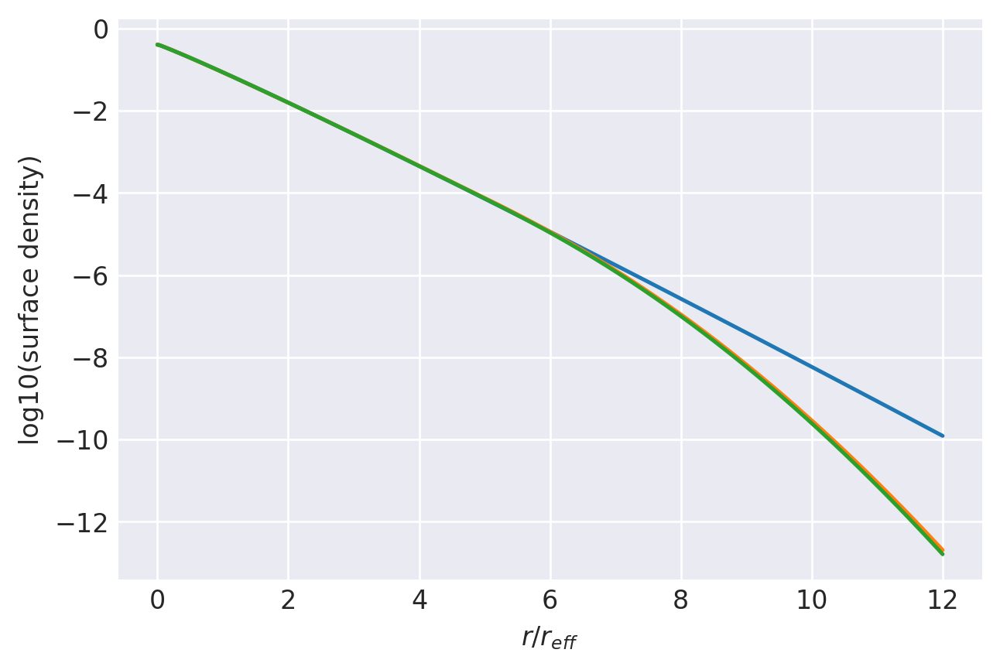

n=0.94: (
    normalize(np.array([8.1026477351e-02, 3.2706329786e-01, 3.4151639944e-01, 1.7442331104e-01, 5.8463968941e-02, 1.4536816076e-02, 2.6680176172e-03, 3.0171168430e-04])),
    np.array([2.0392493702e+00, 1.4227973744e+00, 9.7605089889e-01, 6.4682602711e-01, 4.0901861837e-01, 2.4223611781e-01, 1.2935204729e-01, 5.5949712693e-02]),
),
1.0000000224570316 1.000000026126705
prev.  chisq = -9.081245200170901
ws, re: (array([8.10264774e-02, 3.27063298e-01, 3.41516399e-01, 1.74423311e-01,
       5.84639689e-02, 1.45368161e-02, 2.66801762e-03, 3.01711684e-04]), array([2.03924937, 1.42279737, 0.9760509 , 0.64682603, 0.40901862,
       0.24223612, 0.12935205, 0.05594971]))
         Current function value: -11.228171
         Iterations: 33
         Function evaluations: 2171
         Gradient evaluations: 127
-11.228170731619887 [-2.40741786 -0.57582209  0.32399921  0.84081972  1.21223776  1.59229392
  2.18244532  0.30631122  0.15062726 -0.01262299 -0.19099766 -0.38976729
 -0.61698097 -0

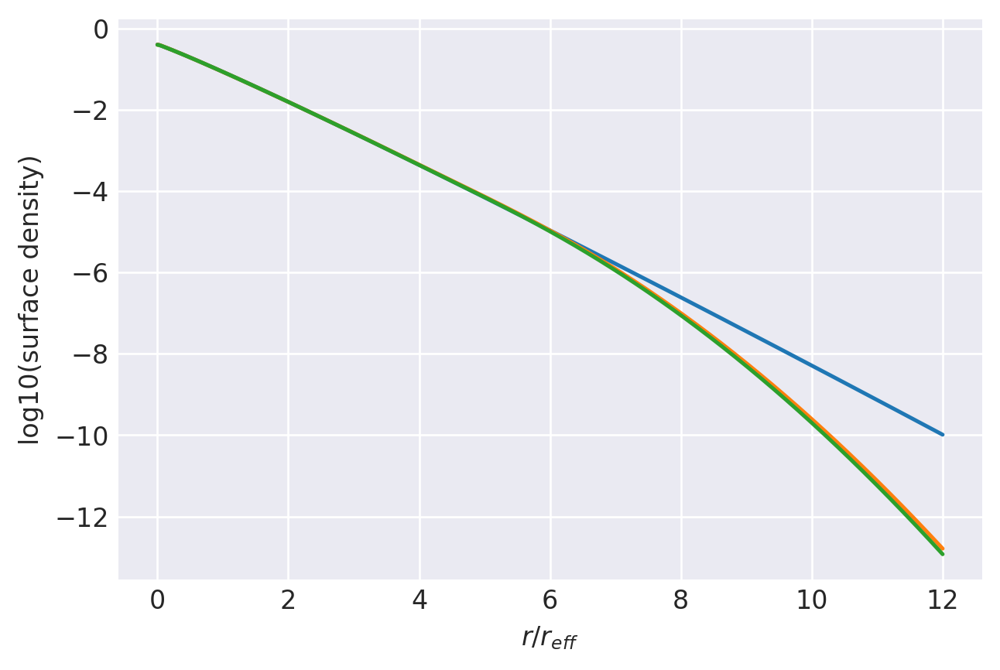

n=0.935: (
    normalize(np.array([8.2608793996e-02, 3.3016404617e-01, 3.4076708635e-01, 1.7218633093e-01, 5.7242376406e-02, 1.4152019485e-02, 2.5875593775e-03, 2.9178728688e-04])),
    np.array([2.0244694038e+00, 1.4145791883e+00, 9.7135282044e-01, 6.4417273119e-01, 4.0759862723e-01, 2.4155666697e-01, 1.2909300116e-01, 5.5910480934e-02]),
),
1.0000000229818575 1.0000000259470125
prev.  chisq = -9.076887863163773
ws, re: (array([8.26087940e-02, 3.30164046e-01, 3.40767086e-01, 1.72186331e-01,
       5.72423764e-02, 1.41520195e-02, 2.58755938e-03, 2.91787287e-04]), array([2.0244694 , 1.41457919, 0.97135282, 0.64417273, 0.40759863,
       0.24155667, 0.129093  , 0.05591048]))
         Current function value: -11.252904
         Iterations: 38
         Function evaluations: 2289
         Gradient evaluations: 134
-11.252904417945489 [-2.39970492 -0.56677533  0.33269043  0.8478998   1.2174525   1.59615292
  2.18561865  0.30379871  0.14900443 -0.01361057 -0.19151506 -0.38990663
 -0.61677975 

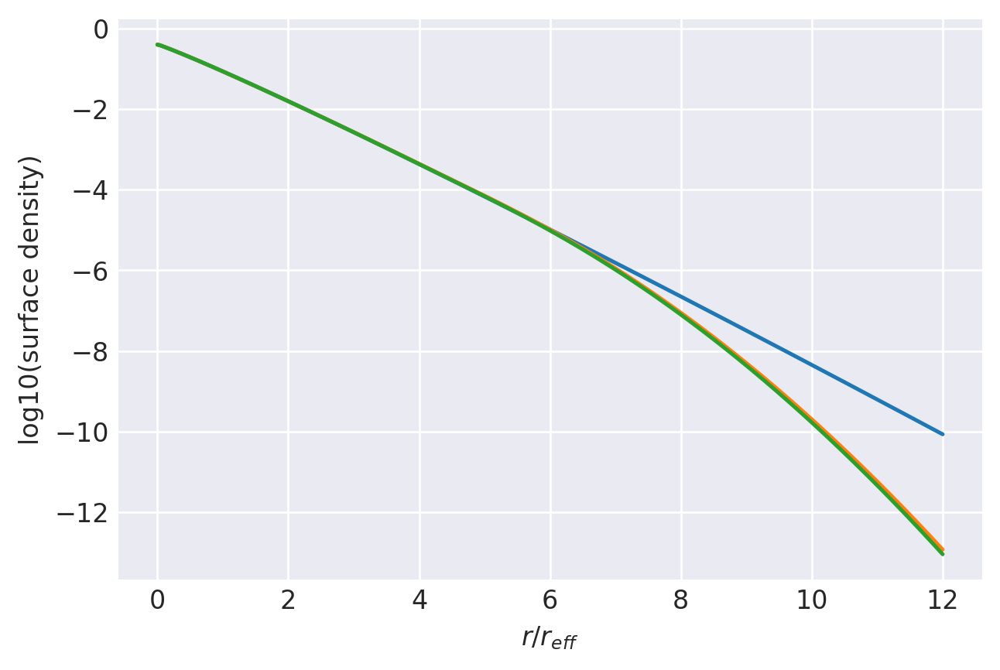

n=0.9299999999999999: (
    normalize(np.array([8.3195200740e-02, 3.3186613072e-01, 3.4067638530e-01, 1.7101447113e-01, 5.6519105162e-02, 1.3909585516e-02, 2.5342509203e-03, 2.8487050914e-04])),
    np.array([2.0127911244e+00, 1.4093031664e+00, 9.6914649332e-01, 6.4340574832e-01, 4.0746787463e-01, 2.4166861403e-01, 1.2925452558e-01, 5.6035845282e-02]),
),
1.0000000233902284 1.0000000257666501
prev.  chisq = -9.072501638033655
ws, re: (array([8.31952007e-02, 3.31866131e-01, 3.40676385e-01, 1.71014471e-01,
       5.65191052e-02, 1.39095855e-02, 2.53425092e-03, 2.84870509e-04]), array([2.01279112, 1.40930317, 0.96914649, 0.64340575, 0.40746787,
       0.24166861, 0.12925453, 0.05603585]))
         Current function value: -11.277990
         Iterations: 39
         Function evaluations: 2443
         Gradient evaluations: 143
-11.277989615273885 [-2.39343913 -0.55854869  0.34097379  0.85479083  1.22263274  1.59994879
  2.18870489  0.30134946  0.14747705 -0.01447943 -0.1918981  -0.38990451


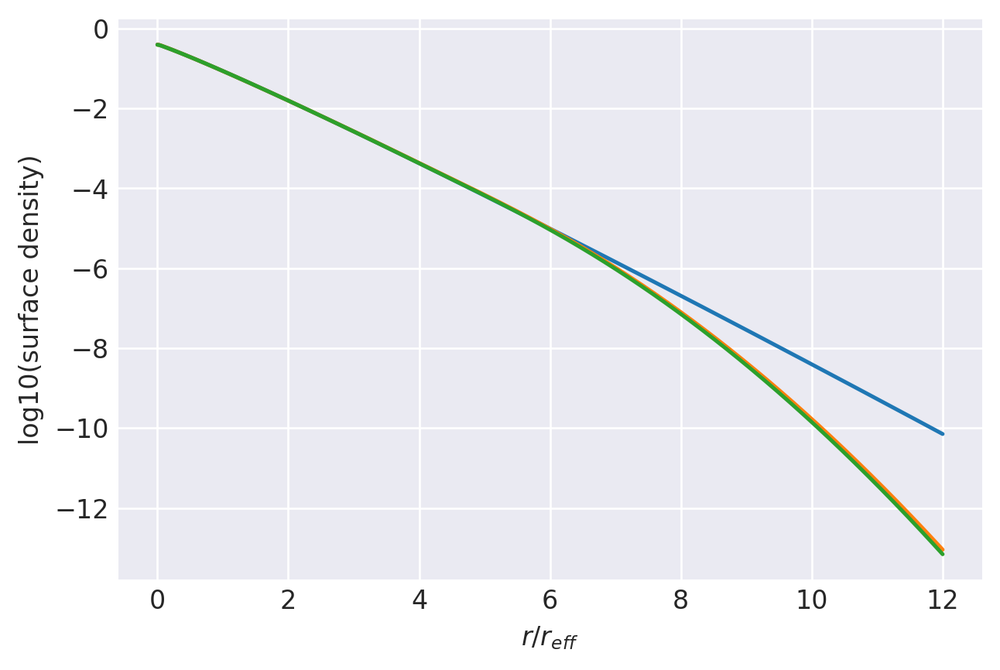

n=0.925: (
    normalize(np.array([8.3674366070e-02, 3.3343562431e-01, 3.4065668849e-01, 1.6994391231e-01, 5.5845486169e-02, 1.3681528262e-02, 2.4840295930e-03, 2.7836479423e-04])),
    np.array([2.0014717439e+00, 1.4043554573e+00, 9.6720954231e-01, 6.4283853473e-01, 4.0746985897e-01, 2.4185994865e-01, 1.2946278551e-01, 5.6177545404e-02]),
),
1.000000023699371 1.0000000255874248
prev.  chisq = -9.068083220417078
ws, re: (array([8.36743661e-02, 3.33435624e-01, 3.40656688e-01, 1.69943912e-01,
       5.58454862e-02, 1.36815283e-02, 2.48402959e-03, 2.78364794e-04]), array([2.00147174, 1.40435546, 0.96720954, 0.64283853, 0.40746986,
       0.24185995, 0.12946279, 0.05617755]))
         Current function value: -11.303340
         Iterations: 39
         Function evaluations: 2256
         Gradient evaluations: 132
-11.303339573754654 [-2.38705485 -0.54996568  0.34979771  0.86221404  1.22811167  1.60391298
  2.191907    0.29888992  0.14593298 -0.01538728 -0.19235717 -0.39001249
 -0.61622067 -

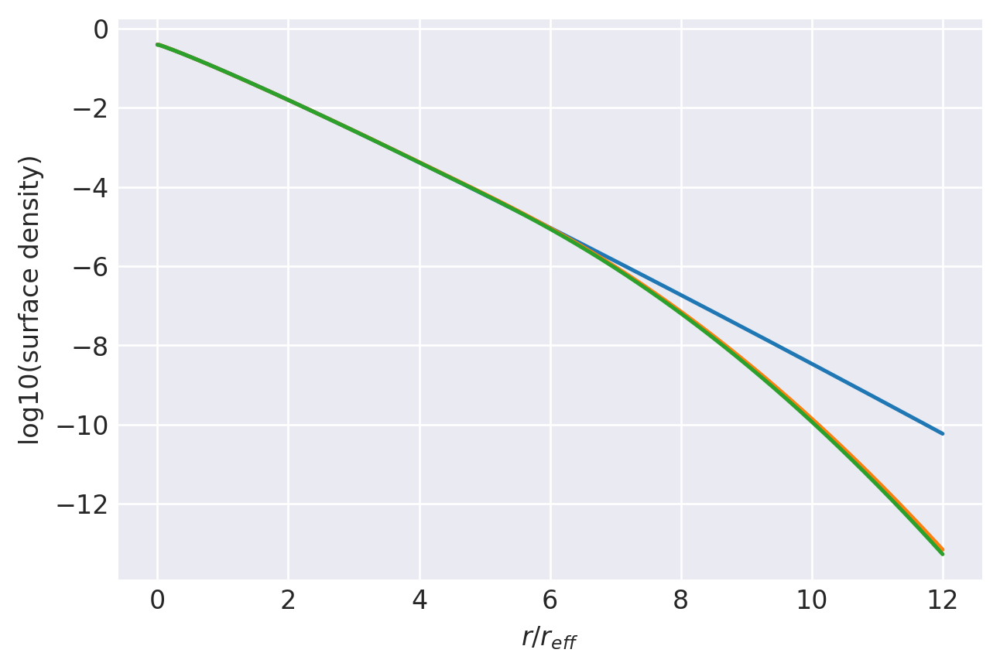

n=0.92: (
    normalize(np.array([8.4165170299e-02, 3.3507866152e-01, 3.4065328789e-01, 1.6882186325e-01, 5.5135004238e-02, 1.3442598166e-02, 2.4317766077e-03, 2.7163802453e-04])),
    np.array([1.9901688387e+00, 1.3993713671e+00, 9.6518979512e-01, 6.4215937706e-01, 4.0736856138e-01, 2.4197991939e-01, 1.2962814970e-01, 5.6303836333e-02]),
),
1.0000000239243276 1.0000000254093548
prev.  chisq = -9.063669543437847
ws, re: (array([8.41651703e-02, 3.35078662e-01, 3.40653288e-01, 1.68821863e-01,
       5.51350042e-02, 1.34425982e-02, 2.43177661e-03, 2.71638025e-04]), array([1.99016884, 1.39937137, 0.9651898 , 0.64215938, 0.40736856,
       0.24197992, 0.12962815, 0.05630384]))
         Current function value: -11.328988
         Iterations: 40
         Function evaluations: 2409
         Gradient evaluations: 141
-11.328988253308275 [-2.38032193 -0.54131072  0.35849173  0.86943661  1.23343276  1.60774911
  2.19499674  0.29640449  0.14437527 -0.01628803 -0.19278324 -0.3900648
 -0.61593238 -0

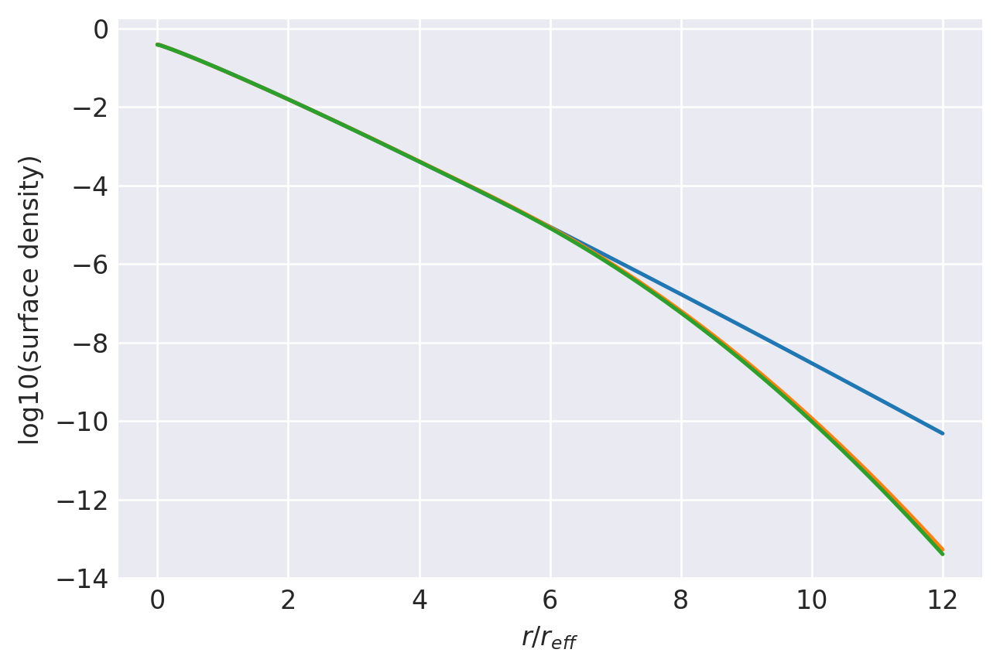

n=0.915: (
    normalize(np.array([8.4685608679e-02, 3.3672835499e-01, 3.4059929447e-01, 1.6769223015e-01, 5.4437392947e-02, 1.3210544167e-02, 2.3813860072e-03, 2.6518858475e-04])),
    np.array([1.9788118069e+00, 1.3943611333e+00, 9.6319000742e-01, 6.4152969589e-01, 4.0731950121e-01, 2.4214060131e-01, 1.2982060137e-01, 5.6443069751e-02]),
),
1.000000024078186 1.0000000252323553
prev.  chisq = -9.059181144811399
ws, re: (array([8.46856087e-02, 3.36728355e-01, 3.40599294e-01, 1.67692230e-01,
       5.44373929e-02, 1.32105442e-02, 2.38138601e-03, 2.65188585e-04]), array([1.97881181, 1.39436113, 0.96319001, 0.6415297 , 0.4073195 ,
       0.2421406 , 0.1298206 , 0.05644307]))
         Current function value: -11.355373
         Iterations: 35
         Function evaluations: 2188
         Gradient evaluations: 128
-11.355372996771438 [-2.3809131  -0.53767461  0.36408476  0.87524761  1.23877439  1.61182703
  2.19764446  0.29424459  0.14331286 -0.01653578 -0.19244547 -0.38932121
 -0.61489168 -

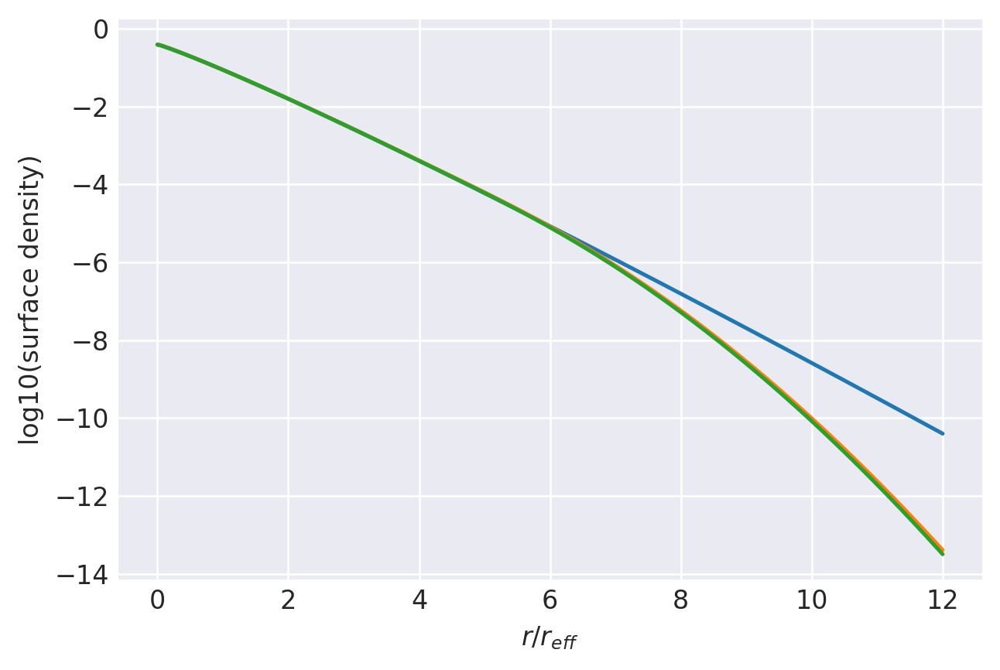

n=0.91: (
    normalize(np.array([8.4639795367e-02, 3.3751957246e-01, 3.4094265997e-01, 1.6721122181e-01, 5.4031664252e-02, 1.3051095694e-02, 2.3436897899e-03, 2.6030065902e-04])),
    np.array([1.9689949080e+00, 1.3909543026e+00, 9.6264069091e-01, 6.4202882897e-01, 4.0801749857e-01, 2.4272153789e-01, 1.3023886593e-01, 5.6700605787e-02]),
),
1.0000000241722848 1.0000000250549903
prev.  chisq = -9.05457269094394
ws, re: (array([8.46397954e-02, 3.37519572e-01, 3.40942660e-01, 1.67211222e-01,
       5.40316643e-02, 1.30510957e-02, 2.34368979e-03, 2.60300659e-04]), array([1.96899491, 1.3909543 , 0.96264069, 0.64202883, 0.4080175 ,
       0.24272154, 0.13023887, 0.05670061]))
         Current function value: -11.381844
         Iterations: 35
         Function evaluations: 2188
         Gradient evaluations: 128
-11.38184358650735 [-2.37778393 -0.5313307   0.37137654  0.88157335  1.24324029  1.61542112
  2.20122499  0.29190697  0.14199094 -0.0171169  -0.19248197 -0.38891091
 -0.61406577 -0.

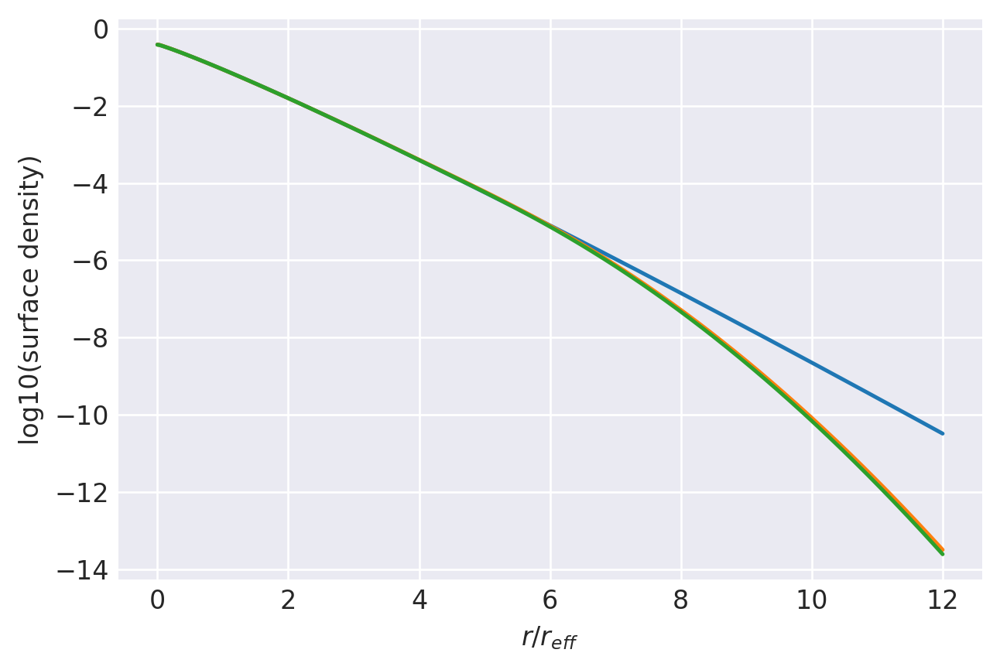

n=0.905: (
    normalize(np.array([8.4882545997e-02, 3.3878250060e-01, 3.4107015969e-01, 1.6636706402e-01, 5.3473424762e-02, 1.2866379497e-02, 2.3030523605e-03, 2.5487306717e-04])),
    np.array([1.9584251136e+00, 1.3867269131e+00, 9.6135347483e-01, 6.4197487051e-01, 4.0840315874e-01, 2.4318356990e-01, 1.3059144846e-01, 5.6891288900e-02]),
),
1.0000000242164144 1.0000000248803158
prev.  chisq = -9.050220838922645
ws, re: (array([8.48825460e-02, 3.38782501e-01, 3.41070160e-01, 1.66367064e-01,
       5.34734248e-02, 1.28663795e-02, 2.30305236e-03, 2.54873067e-04]), array([1.95842511, 1.38672691, 0.96135347, 0.64197487, 0.40840316,
       0.24318357, 0.13059145, 0.05689129]))
         Current function value: -11.408332
         Iterations: 34
         Function evaluations: 2358
         Gradient evaluations: 138
-11.408331965529769 [-2.36726083 -0.52114209  0.38029982  0.88888783  1.24906014  1.6189666
  2.20384114  0.28921237  0.14023105 -0.0181681  -0.19300413 -0.38906154
 -0.61390307 -

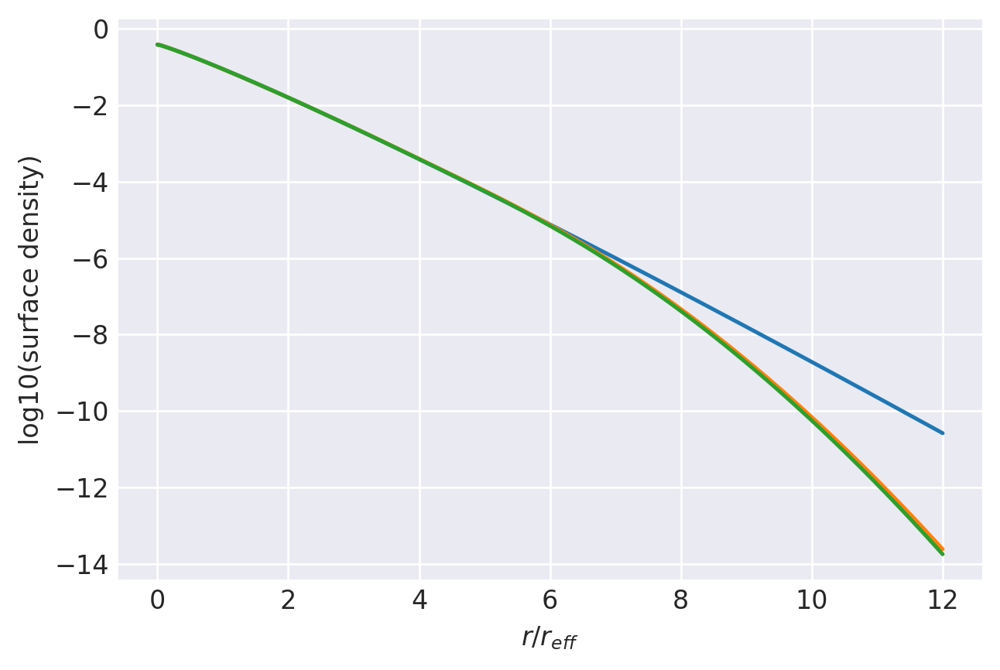

n=0.9: (
    normalize(np.array([8.5703533382e-02, 3.4065334348e-01, 3.4071270247e-01, 1.6506861300e-01, 5.2737930095e-02, 1.2623183173e-02, 2.2521101669e-03, 2.4858423528e-04])),
    np.array([1.9463115926e+00, 1.3811188552e+00, 9.5902935245e-01, 6.4120347915e-01, 4.0826152697e-01, 2.4327469001e-01, 1.3077386669e-01, 5.7023439004e-02]),
),
1.0000000242189875 1.0000000247072458
prev.  chisq = -9.045485728372672
ws, re: (array([8.57035334e-02, 3.40653343e-01, 3.40712702e-01, 1.65068613e-01,
       5.27379301e-02, 1.26231832e-02, 2.25211017e-03, 2.48584235e-04]), array([1.94631159, 1.38111886, 0.95902935, 0.64120348, 0.40826153,
       0.24327469, 0.13077387, 0.05702344]))
         Current function value: -11.435647
         Iterations: 34
         Function evaluations: 2035
         Gradient evaluations: 119
-11.435647487349963 [-2.37039639 -0.51743697  0.38691677  0.89511453  1.25344339  1.6228949
  2.2065627   0.28715371  0.13925434 -0.01839609 -0.1927003  -0.38831157
 -0.61273344 -0.

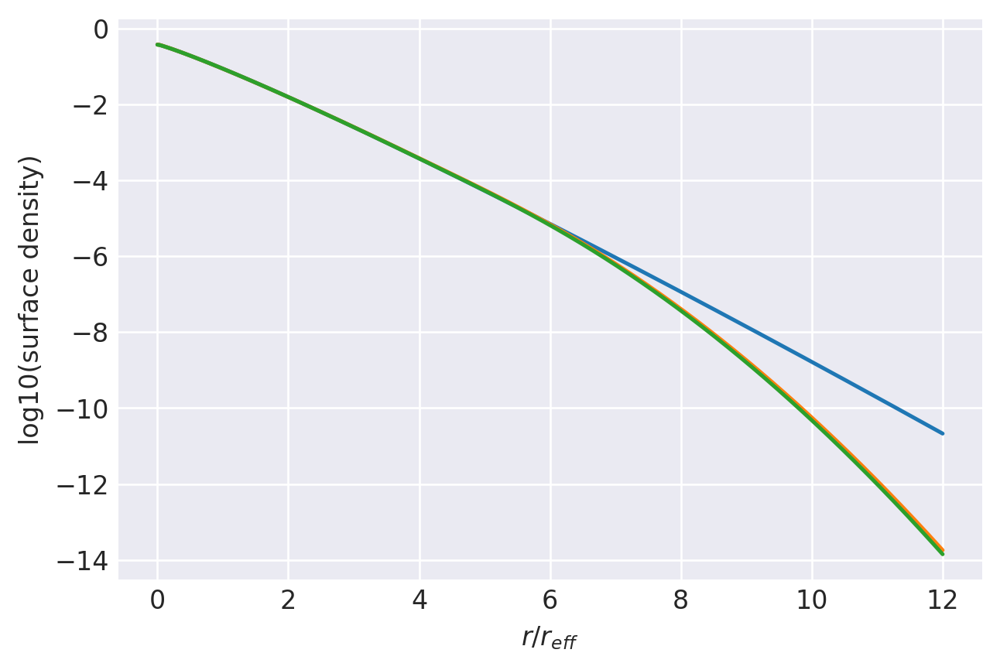

n=0.895: (
    normalize(np.array([8.5458154254e-02, 3.4153725291e-01, 3.4124730054e-01, 1.6453481556e-01, 5.2292052730e-02, 1.2469800331e-02, 2.2166215828e-03, 2.4400209405e-04])),
    np.array([1.9371074385e+00, 1.3780162566e+00, 9.5852602244e-01, 6.4165221702e-01, 4.0896715012e-01, 2.4393075545e-01, 1.3122716473e-01, 5.7305327980e-02]),
),
1.0000000241872056 1.0000000245331448
prev.  chisq = -9.041104743523542
ws, re: (array([8.54581543e-02, 3.41537253e-01, 3.41247301e-01, 1.64534816e-01,
       5.22920527e-02, 1.24698003e-02, 2.21662158e-03, 2.44002094e-04]), array([1.93710744, 1.37801626, 0.95852602, 0.64165222, 0.40896715,
       0.24393076, 0.13122716, 0.05730533]))
         Current function value: -11.462775
         Iterations: 33
         Function evaluations: 2222
         Gradient evaluations: 130
-11.462775266859705 [-2.35842056 -0.50640484  0.39660338  0.90284203  1.25828338  1.62594157
  2.20950386  0.2843715   0.13741611 -0.01953549 -0.19333943 -0.38854498
 -0.61252446 

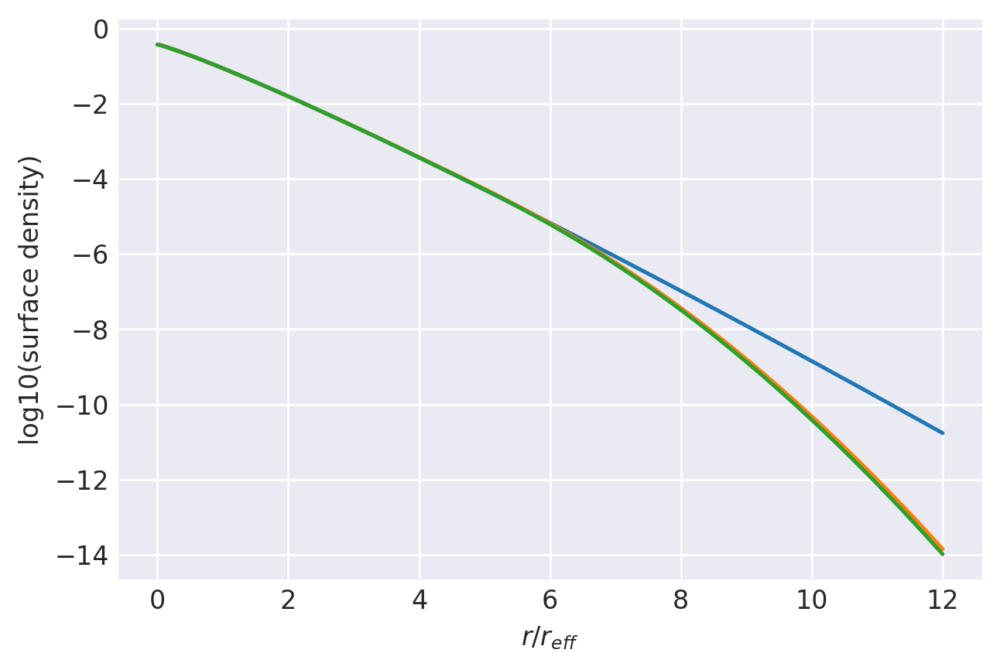

n=0.89: (
    normalize(np.array([8.6398784406e-02, 3.4354757875e-01, 3.4081871559e-01, 1.6310825490e-01, 5.1494849325e-02, 1.2226535299e-02, 2.1673987021e-03, 2.3788303682e-04])),
    np.array([1.9247374598e+00, 1.3721958904e+00, 9.5601456385e-01, 6.4070862543e-01, 4.0874741589e-01, 2.4404815862e-01, 1.3142123383e-01, 5.7439206885e-02]),
),
1.0000000241272065 1.0000000243625309
prev.  chisq = -9.036314566690912
ws, re: (array([8.63987844e-02, 3.43547579e-01, 3.40818716e-01, 1.63108255e-01,
       5.14948493e-02, 1.22265353e-02, 2.16739870e-03, 2.37883037e-04]), array([1.92473746, 1.37219589, 0.95601456, 0.64070863, 0.40874742,
       0.24404816, 0.13142123, 0.05743921]))
         Current function value: -11.489543
         Iterations: 32
         Function evaluations: 2273
         Gradient evaluations: 133
-11.48954269435497 [-2.33724484 -0.48792378  0.41077293  0.91190192  1.26489789  1.63142221
  2.21397136  0.28120375  0.13493342 -0.02156441 -0.19497645 -0.38982677
 -0.61359088 -0

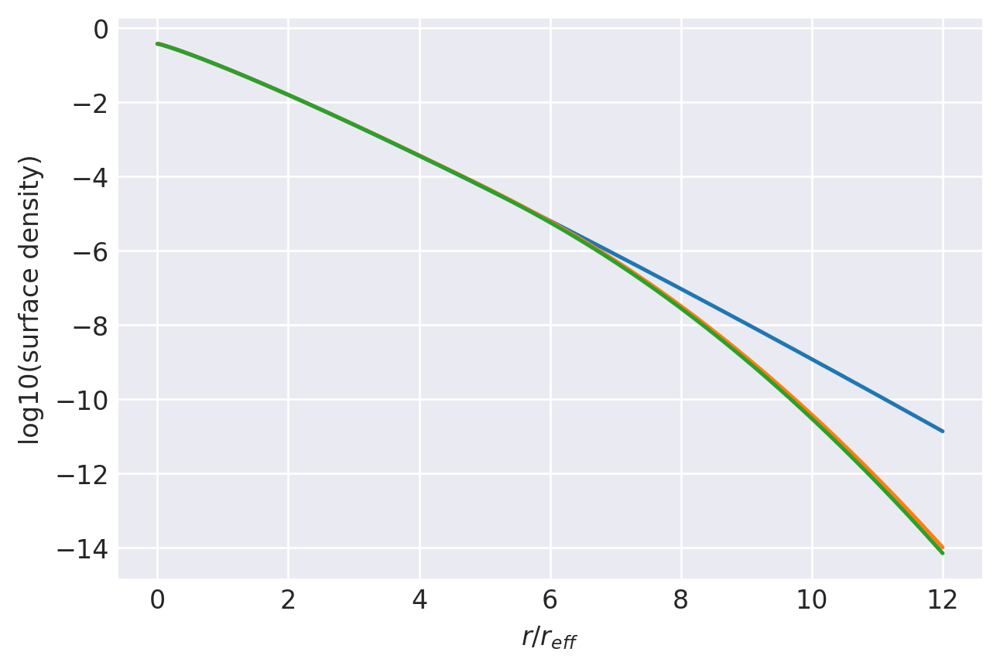

n=0.885: (
    normalize(np.array([8.8084974452e-02, 3.4687678583e-01, 3.3974234955e-01, 1.6072365430e-01, 5.0357826877e-02, 1.1888425292e-02, 2.0968676722e-03, 2.2911603232e-04])),
    np.array([1.9107495015e+00, 1.3643739615e+00, 9.5155870963e-01, 6.3829809118e-01, 4.0754280841e-01, 2.4344962793e-01, 1.3115645104e-01, 5.7368724912e-02]),
),
1.000000024044195 1.0000000241945246
prev.  chisq = -9.031645526468989
ws, re: (array([8.80849745e-02, 3.46876786e-01, 3.39742350e-01, 1.60723654e-01,
       5.03578269e-02, 1.18884253e-02, 2.09686767e-03, 2.29116032e-04]), array([1.9107495 , 1.36437396, 0.95155871, 0.63829809, 0.40754281,
       0.24344963, 0.13115645, 0.05736872]))
         Current function value: -11.517060
         Iterations: 37
         Function evaluations: 2119
         Gradient evaluations: 124
-11.517059948780505 [-2.32714168 -0.47517121  0.42404279  0.9229712   1.27228897  1.63580532
  2.21812961  0.27853236  0.13311163 -0.02291043 -0.19610856 -0.39082047
 -0.6143609  -

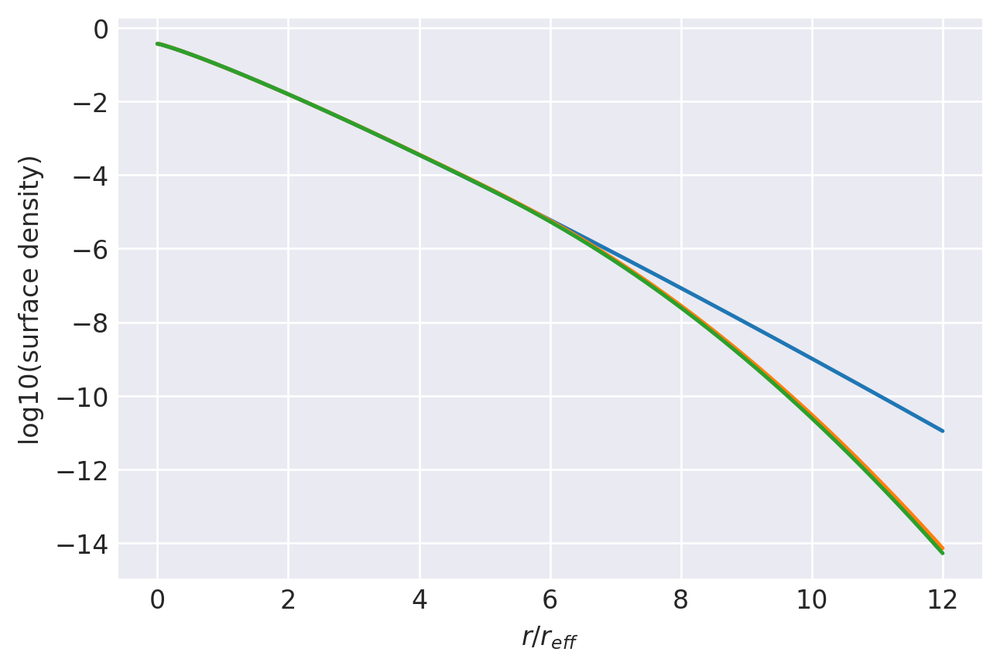

n=0.88: (
    normalize(np.array([8.8899905864e-02, 3.4930941617e-01, 3.3957451456e-01, 1.5902835784e-01, 4.9358164198e-02, 1.1574903093e-02, 2.0334713070e-03, 2.2126697580e-04])),
    np.array([1.8990323184e+00, 1.3586626362e+00, 9.4861408841e-01, 6.3663635565e-01, 4.0661138462e-01, 2.4301837033e-01, 1.3101853050e-01, 5.7351171024e-02]),
),
1.0000000239425677 1.0000000240271358
prev.  chisq = -9.026764957764563
ws, re: (array([8.88999059e-02, 3.49309416e-01, 3.39574515e-01, 1.59028358e-01,
       4.93581642e-02, 1.15749031e-02, 2.03347131e-03, 2.21266976e-04]), array([1.89903232, 1.35866264, 0.94861409, 0.63663636, 0.40661138,
       0.24301837, 0.13101853, 0.05735117]))
         Current function value: -11.545074
         Iterations: 43
         Function evaluations: 2273
         Gradient evaluations: 133
-11.545074438323276 [-2.31706433 -0.46387479  0.43463151  0.93117619  1.27793022  1.63957394
  2.22096297  0.27584217  0.13135281 -0.02402405 -0.19676509 -0.39111004
 -0.61429962 -

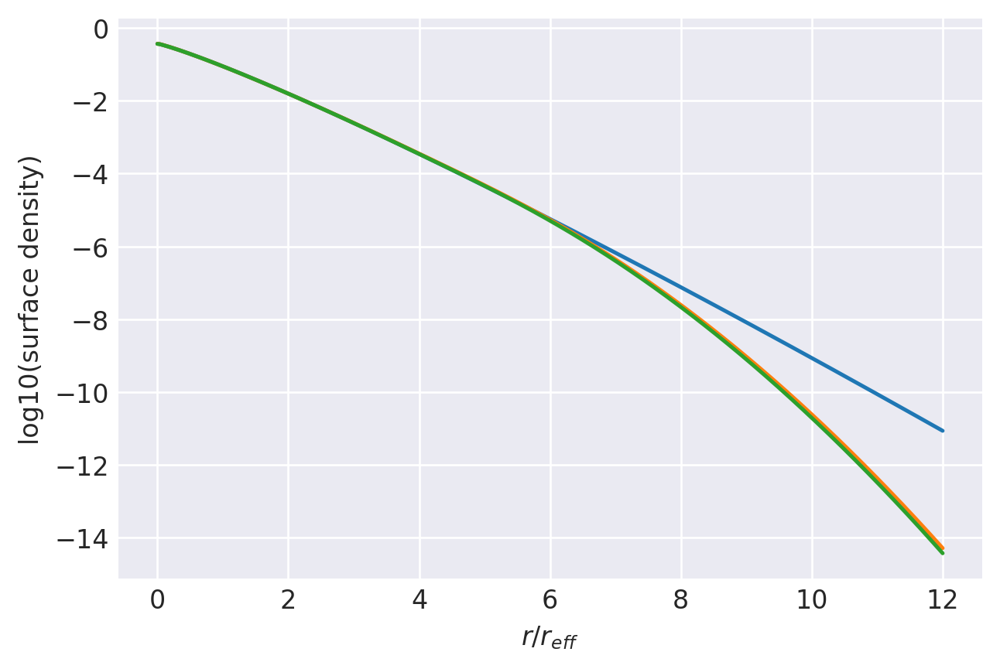

n=0.875: (
    normalize(np.array([8.9719526602e-02, 3.5142926885e-01, 3.3921099318e-01, 1.5755096538e-01, 4.8559828433e-02, 1.1330575413e-02, 1.9836112558e-03, 2.1523089106e-04])),
    np.array([1.8873053597e+00, 1.3531714076e+00, 9.4618475353e-01, 6.3567468065e-01, 4.0634035820e-01, 2.4305266056e-01, 1.3115573412e-01, 5.7474898327e-02]),
),
1.0000000238260154 1.000000023859784
prev.  chisq = -9.021975099497576
ws, re: (array([8.97195266e-02, 3.51429269e-01, 3.39210993e-01, 1.57550965e-01,
       4.85598284e-02, 1.13305754e-02, 1.98361126e-03, 2.15230891e-04]), array([1.88730536, 1.35317141, 0.94618475, 0.63567468, 0.40634036,
       0.24305266, 0.13115573, 0.0574749 ]))
         Current function value: -11.573895
         Iterations: 36
         Function evaluations: 2341
         Gradient evaluations: 137
-11.573895216595597 [-2.31151474 -0.45552468  0.44364175  0.93887921  1.28360708  1.64376136
  2.22457195  0.27333985  0.12988367 -0.02476045 -0.19699824 -0.39097092
 -0.61382844 -

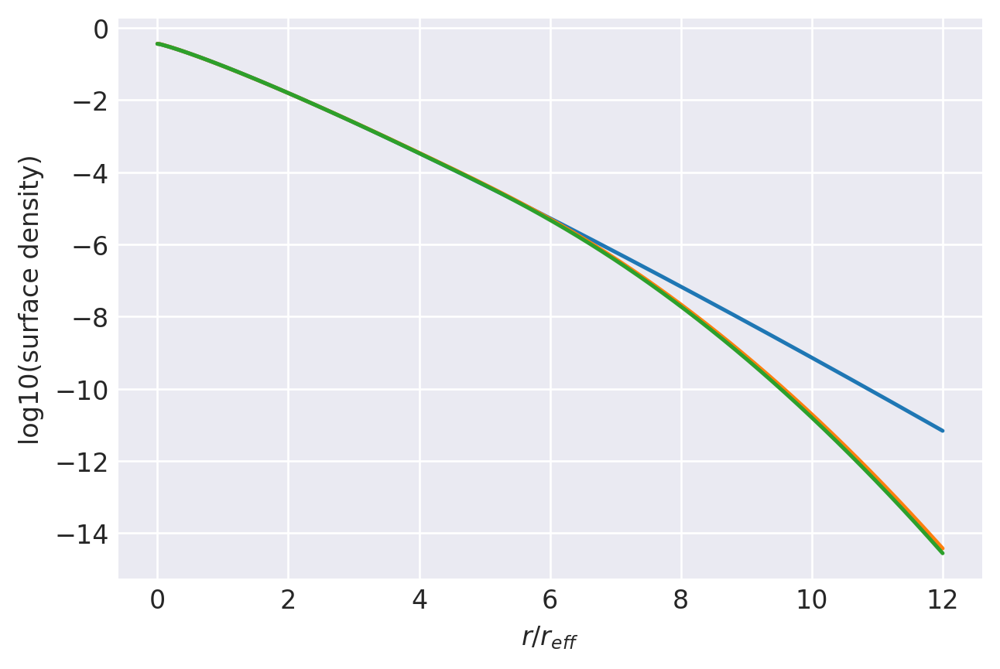

n=0.87: (
    normalize(np.array([9.0173794580e-02, 3.5305626695e-01, 3.3914329330e-01, 1.5644596456e-01, 4.7908336833e-02, 1.1122835888e-02, 1.9397900348e-03, 2.0971785200e-04])),
    np.array([1.8764623457e+00, 1.3486015892e+00, 9.4458175513e-01, 6.3533351247e-01, 4.0647054491e-01, 2.4331649981e-01, 1.3139635997e-01, 5.7635706855e-02]),
),
1.0000000236976265 1.0000000236933282
prev.  chisq = -9.017182172764546
ws, re: (array([9.01737946e-02, 3.53056267e-01, 3.39143293e-01, 1.56445965e-01,
       4.79083368e-02, 1.11228359e-02, 1.93979003e-03, 2.09717852e-04]), array([1.87646235, 1.34860159, 0.94458176, 0.63533351, 0.40647054,
       0.2433165 , 0.13139636, 0.05763571]))
         Current function value: -11.604645
         Iterations: 41
         Function evaluations: 1814
         Gradient evaluations: 106
-11.604645036518422 [-2.3617631  -0.48341813  0.4311664   0.93623731  1.28511502  1.64692367
  2.22928837  0.27319427  0.13184696 -0.02105534 -0.19202881 -0.38517495
 -0.60745183 -

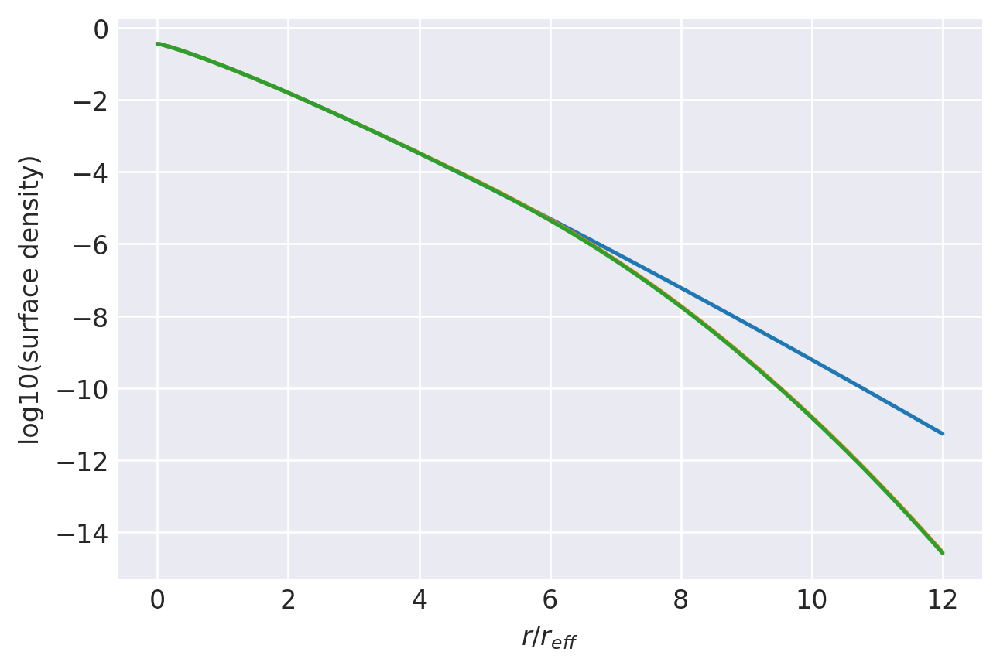

n=0.865: (
    normalize(np.array([8.6135308911e-02, 3.4858939943e-01, 3.4264283849e-01, 1.5992557051e-01, 4.9119505662e-02, 1.1392673784e-02, 1.9814855129e-03, 2.1321770362e-04])),
    np.array([1.8758334412e+00, 1.3547119339e+00, 9.5267476966e-01, 6.4264507752e-01, 4.1193154065e-01, 2.4691539506e-01, 1.3345768182e-01, 5.8584360956e-02]),
),
1.0000000235599669 1.0000000235221822
prev.  chisq = -9.012562942689286
ws, re: (array([8.61353089e-02, 3.48589399e-01, 3.42642838e-01, 1.59925571e-01,
       4.91195057e-02, 1.13926738e-02, 1.98148551e-03, 2.13217704e-04]), array([1.87583344, 1.35471193, 0.95267477, 0.64264508, 0.41193154,
       0.2469154 , 0.13345768, 0.05858436]))
         Current function value: -11.631710
         Iterations: 36
         Function evaluations: 2596
         Gradient evaluations: 152
-11.63171005411431 [-2.29072559 -0.4321667   0.46552082  0.9558258   1.29545723  1.65208373
  2.23098538  0.26789852  0.12634012 -0.02699432 -0.198317   -0.3915797
 -0.6137924  -0

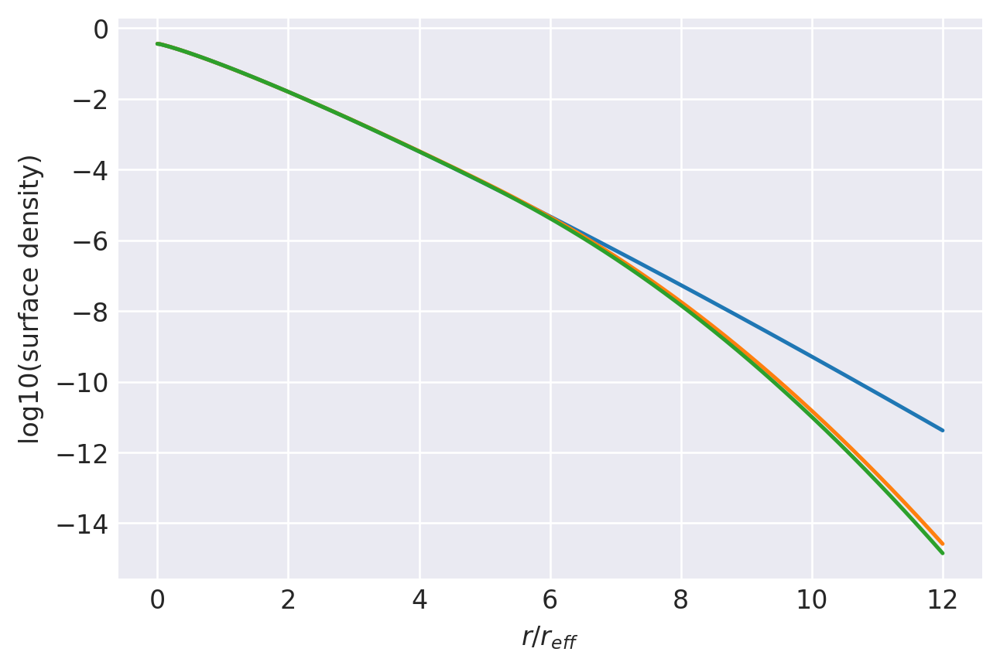

n=0.86: (
    normalize(np.array([9.1893982144e-02, 3.5743875849e-01, 3.3828758883e-01, 1.5339871037e-01, 4.6304149921e-02, 1.0638030221e-02, 1.8410136879e-03, 1.9776634136e-04])),
    np.array([1.8530985676e+00, 1.3376427022e+00, 9.3973559093e-01, 6.3340721094e-01, 4.0590116707e-01, 2.4333669448e-01, 1.3162266643e-01, 5.7855812756e-02]),
),
1.000000023415158 1.0000000233647142
prev.  chisq = -9.007458595963694
ws, re: (array([9.18939821e-02, 3.57438758e-01, 3.38287589e-01, 1.53398710e-01,
       4.63041499e-02, 1.06380302e-02, 1.84101369e-03, 1.97766341e-04]), array([1.85309857, 1.3376427 , 0.93973559, 0.63340721, 0.40590117,
       0.24333669, 0.13162267, 0.05785581]))
         Current function value: -11.660866
         Iterations: 49
         Function evaluations: 2256
         Gradient evaluations: 132
-11.660865645082955 [-2.27763451 -0.41877384  0.4775763   0.96488582  1.3013998   1.6559639
  2.23430052  0.26505252  0.1244152  -0.02829634 -0.19919686 -0.3921195
 -0.61399015 -0.8

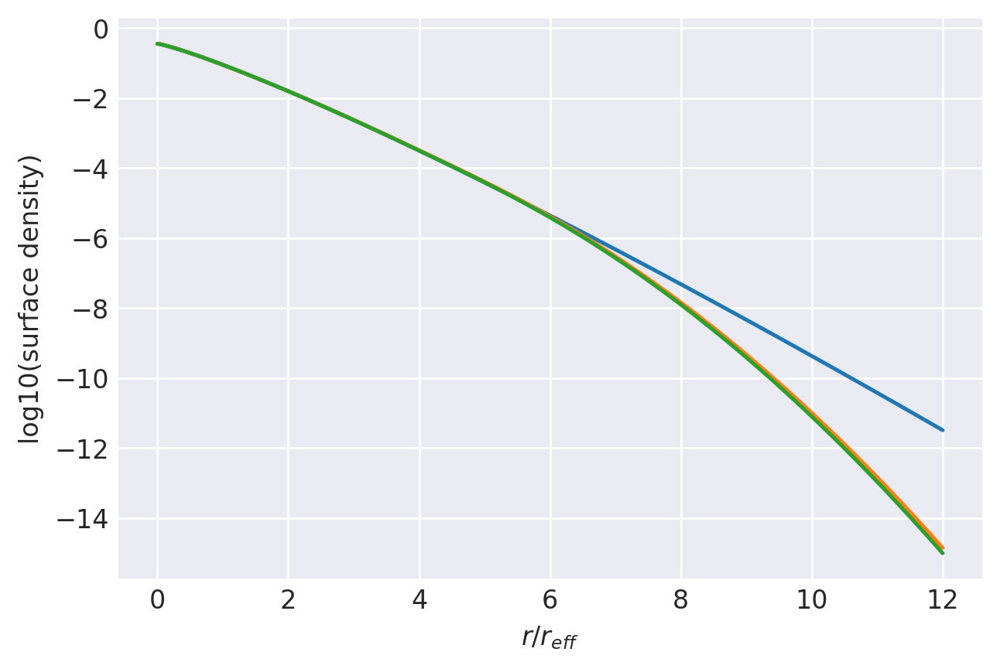

n=0.855: (
    normalize(np.array([9.2992277469e-02, 3.5990991331e-01, 3.3765530445e-01, 1.5165710017e-01, 4.5423400347e-02, 1.0380318861e-02, 1.7900320433e-03, 1.9165335213e-04])),
    np.array([1.8409946339e+00, 1.3317269709e+00, 9.3692247592e-01, 6.3212525545e-01, 4.0539697018e-01, 2.4322591877e-01, 1.3167801519e-01, 5.7938070264e-02]),
),
1.0000000232649449 1.0000000232023512
prev.  chisq = -9.002496180511976
ws, re: (array([9.29922775e-02, 3.59909913e-01, 3.37655304e-01, 1.51657100e-01,
       4.54234003e-02, 1.03803189e-02, 1.79003204e-03, 1.91653352e-04]), array([1.84099463, 1.33172697, 0.93692248, 0.63212526, 0.40539697,
       0.24322592, 0.13167802, 0.05793807]))
         Current function value: -11.691210
         Iterations: 35
         Function evaluations: 1865
         Gradient evaluations: 109
-11.691210330589094 [-2.27101818 -0.40943102  0.4873195   0.97291372  1.30711573  1.65997052
  2.23758479  0.26247311  0.1228866  -0.02908315 -0.19947444 -0.3920163
 -0.61354004 -

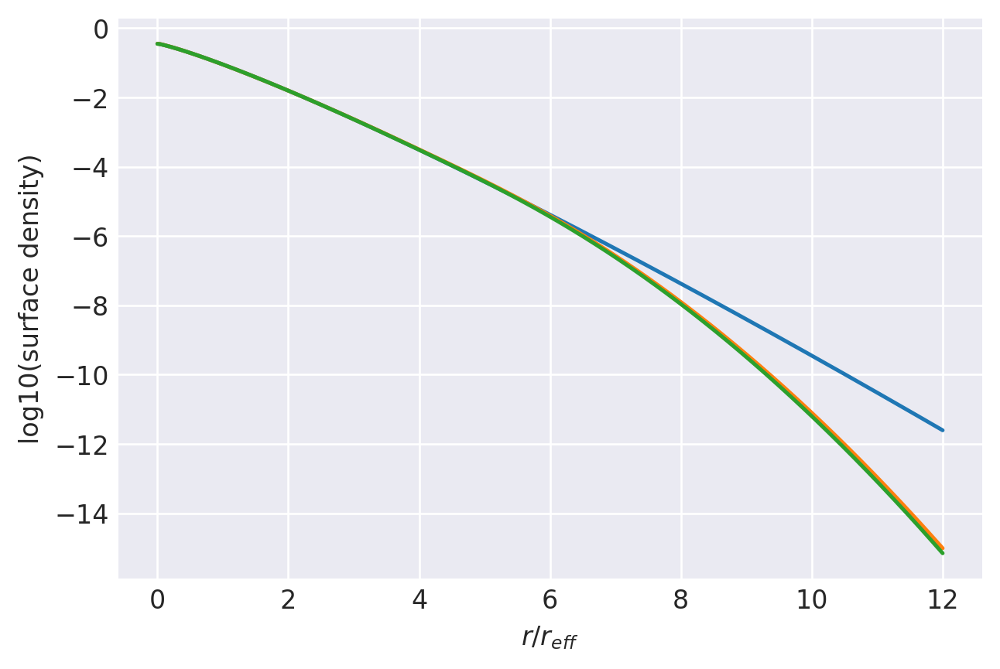

n=0.85: (
    normalize(np.array([9.3551835240e-02, 3.6171683549e-01, 3.3744731541e-01, 1.5042598438e-01, 4.4748981349e-02, 1.0174434506e-02, 1.7480670208e-03, 1.8654660696e-04])),
    np.array([1.8300927975e+00, 1.3270479040e+00, 9.3522659525e-01, 6.3172135114e-01, 4.0549331641e-01, 2.4347813221e-01, 1.3192705300e-01, 5.8109063390e-02]),
),
1.0000000231107542 1.0000000230405612
prev.  chisq = -8.997545347002598
ws, re: (array([9.35518352e-02, 3.61716835e-01, 3.37447315e-01, 1.50425984e-01,
       4.47489813e-02, 1.01744345e-02, 1.74806702e-03, 1.86546607e-04]), array([1.8300928 , 1.3270479 , 0.9352266 , 0.63172135, 0.40549332,
       0.24347813, 0.13192705, 0.05810906]))
         Current function value: -11.721029
         Iterations: 37
         Function evaluations: 1949
         Gradient evaluations: 114
-11.721028990821393 [-2.25718209 -0.39533717  0.49993642  0.98233485  1.3134138   1.66435932
  2.24114627  0.2595855   0.12092312 -0.03042971 -0.20041121 -0.39263352
 -0.61385398 -

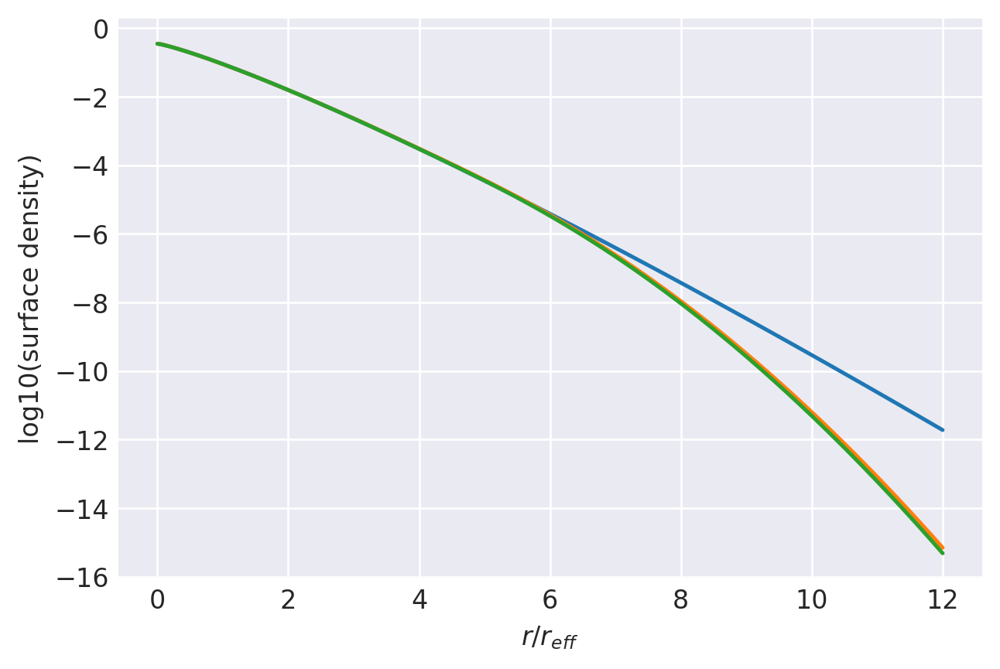

n=0.845: (
    normalize(np.array([9.4731750777e-02, 3.6430995164e-01, 3.3671645683e-01, 1.4860049245e-01, 4.3850047871e-02, 9.9143886126e-03, 1.6965107346e-03, 1.8040108880e-04])),
    np.array([1.8179649453e+00, 1.3210617641e+00, 9.3233135201e-01, 6.3036021469e-01, 4.0491744109e-01, 2.4330219140e-01, 1.3193142574e-01, 5.8170286599e-02]),
),
1.0000000229537436 1.00000002288061
prev.  chisq = -8.992558212258468
ws, re: (array([9.47317508e-02, 3.64309952e-01, 3.36716457e-01, 1.48600492e-01,
       4.38500479e-02, 9.91438861e-03, 1.69651073e-03, 1.80401089e-04]), array([1.81796495, 1.32106176, 0.93233135, 0.63036021, 0.40491744,
       0.24330219, 0.13193143, 0.05817029]))
         Current function value: -11.752948
         Iterations: 38
         Function evaluations: 1695
         Gradient evaluations: 99
-11.752948302448274 [-2.25263232 -0.38989835  0.50526567  0.98775548  1.31879278  1.668778
  2.24498408  0.25704239  0.11962525 -0.03068883 -0.19986833 -0.39157062
 -0.61245251 -0.87

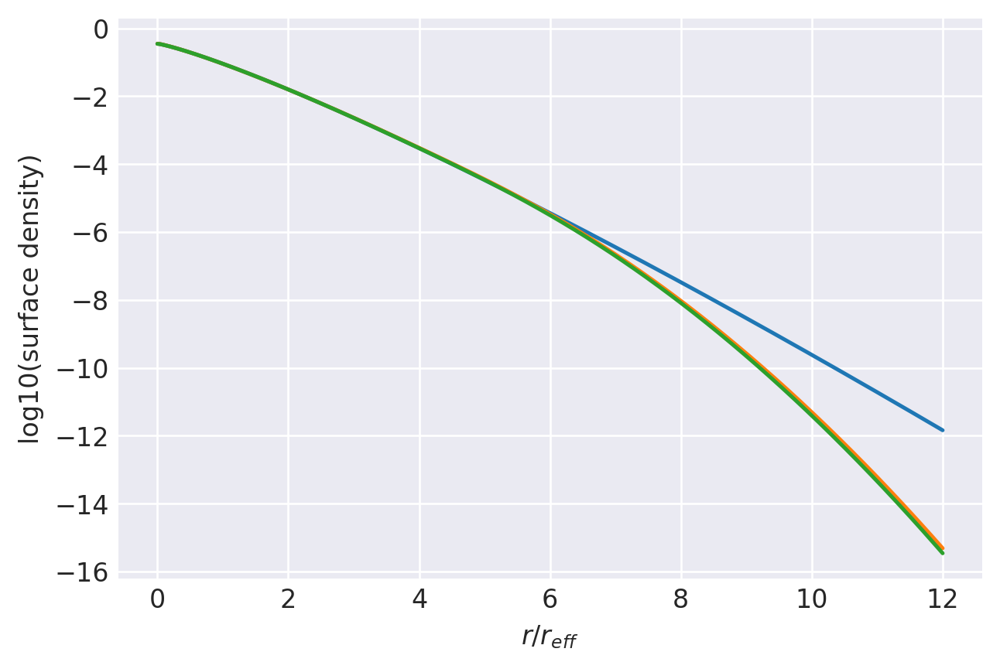

n=0.84: (
    normalize(np.array([9.5122647908e-02, 3.6533678581e-01, 3.3650928403e-01, 1.4793759852e-01, 4.3467857962e-02, 9.7821189569e-03, 1.6671110371e-03, 1.7659578290e-04])),
    np.array([1.8073505429e+00, 1.3171197157e+00, 9.3177524383e-01, 6.3114866788e-01, 4.0590965353e-01, 2.4408859743e-01, 1.3246051055e-01, 5.8456787024e-02]),
),
1.0000000227948467 1.000000022720553
prev.  chisq = -8.987544220428342
ws, re: (array([9.51226479e-02, 3.65336786e-01, 3.36509284e-01, 1.47937599e-01,
       4.34678580e-02, 9.78211896e-03, 1.66711104e-03, 1.76595783e-04]), array([1.80735054, 1.31711972, 0.93177524, 0.63114867, 0.40590965,
       0.2440886 , 0.13246051, 0.05845679]))
         Current function value: -11.784124
         Iterations: 39
         Function evaluations: 2409
         Gradient evaluations: 141
-11.784123605186874 [-2.24438641 -0.37706293  0.51859774  0.99688484  1.32361702  1.67247193
  2.24867058  0.25439692  0.11791905 -0.0318454  -0.20066465 -0.39195641
 -0.61238788 -0

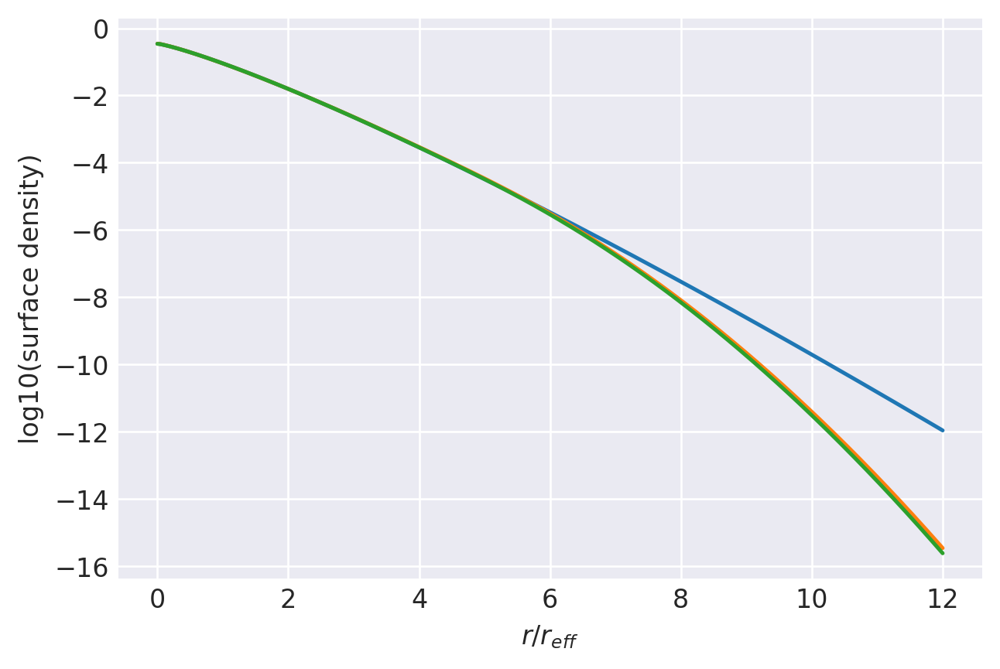

n=0.835: (
    normalize(np.array([9.5834782385e-02, 3.6784648875e-01, 3.3617520517e-01, 1.4619396832e-01, 4.2608433822e-02, 9.5481482517e-03, 1.6218085387e-03, 1.7116476116e-04])),
    np.array([1.7963746527e+00, 1.3119553355e+00, 9.2929714792e-01, 6.2999245689e-01, 4.0554924245e-01, 2.4412492521e-01, 1.3258996701e-01, 5.8571667602e-02]),
),
1.0000000226348125 1.0000000225627497
prev.  chisq = -8.982389666413484
ws, re: (array([9.58347824e-02, 3.67846489e-01, 3.36175205e-01, 1.46193968e-01,
       4.26084338e-02, 9.54814825e-03, 1.62180854e-03, 1.71164761e-04]), array([1.79637465, 1.31195534, 0.92929715, 0.62999246, 0.40554924,
       0.24412493, 0.13258997, 0.05857167]))
         Current function value: -11.818895
         Iterations: 35
         Function evaluations: 1473
         Gradient evaluations: 86
-11.81889544515155 [-2.2691982  -0.38776472  0.51791791  1.00213834  1.32992952  1.67817953
  2.25216702  0.25303168  0.11824386 -0.03020753 -0.19821201 -0.38910319
 -0.60929395 -0

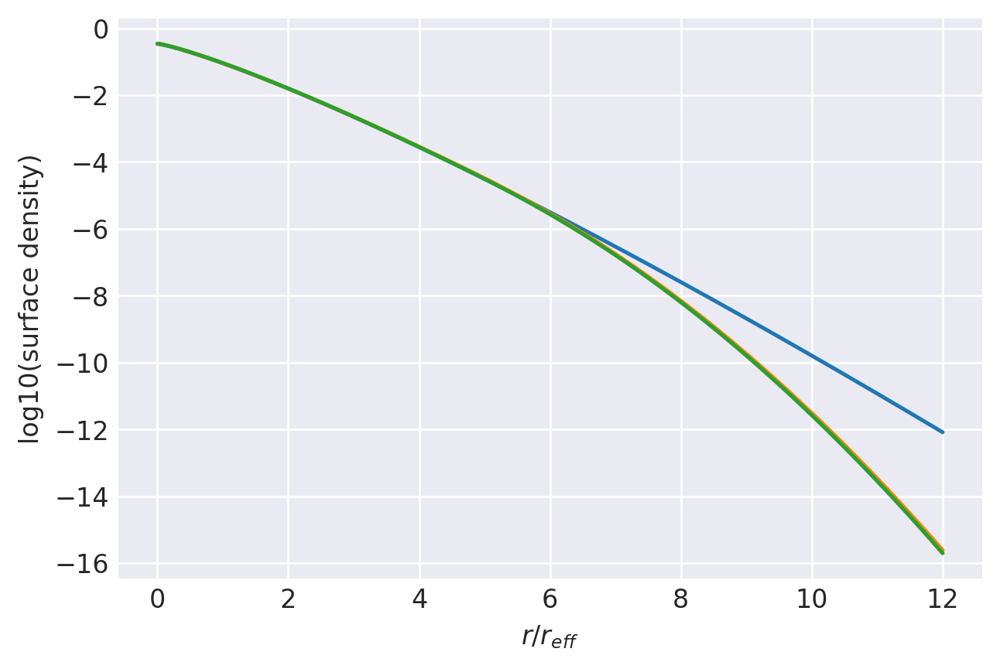

n=0.83: (
    normalize(np.array([9.3706282998e-02, 3.6637423180e-01, 3.3834636264e-01, 1.4744646464e-01, 4.2804929506e-02, 9.5404052669e-03, 1.6118076187e-03, 1.6951553096e-04])),
    np.array([1.7907364945e+00, 1.3129369052e+00, 9.3280845738e-01, 6.3356034322e-01, 4.0822237963e-01, 2.4587028939e-01, 1.3362304702e-01, 5.9102911016e-02]),
),
1.000000022474237 1.000000022403328
prev.  chisq = -8.97751672826841
ws, re: (array([9.37062830e-02, 3.66374232e-01, 3.38346363e-01, 1.47446465e-01,
       4.28049295e-02, 9.54040527e-03, 1.61180762e-03, 1.69515531e-04]), array([1.79073649, 1.31293691, 0.93280846, 0.63356034, 0.40822238,
       0.24587029, 0.13362305, 0.05910291]))
         Current function value: -11.851676
         Iterations: 38
         Function evaluations: 2324
         Gradient evaluations: 136
-11.851675858050752 [-2.28590558 -0.39207265  0.51944911  1.00422716  1.33240494  1.67997714
  2.25408963  0.25131904  0.11801085 -0.02928373 -0.19632698 -0.38639942
 -0.60595079 -0.8

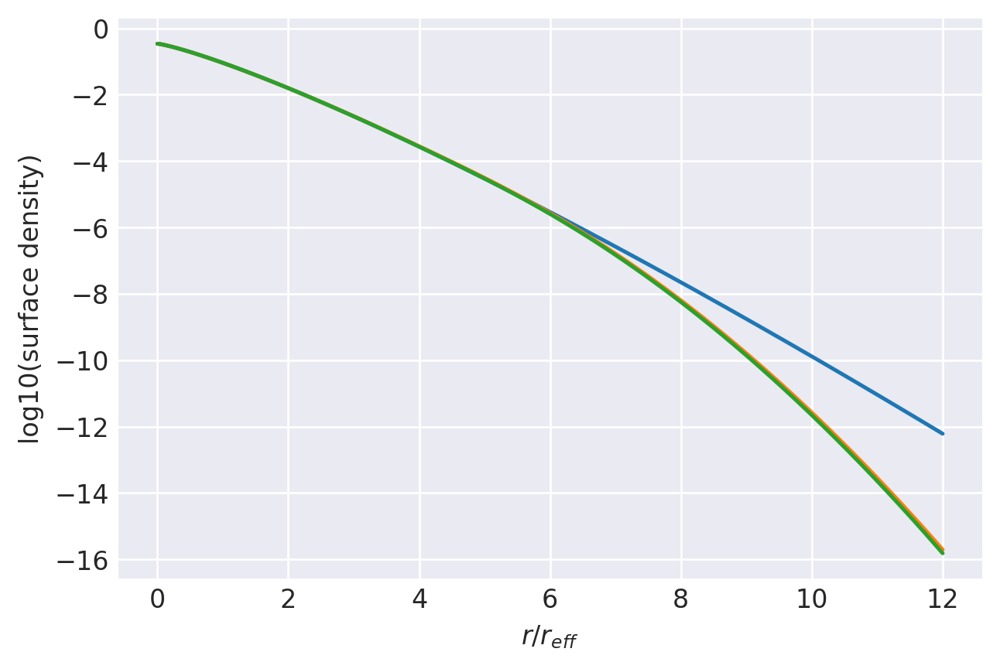

n=0.825: (
    normalize(np.array([9.2297001446e-02, 3.6600259905e-01, 3.3965641123e-01, 1.4787374741e-01, 4.2861561834e-02, 9.5321025595e-03, 1.6078065254e-03, 1.6876994152e-04])),
    np.array([1.7836886015e+00, 1.3122326759e+00, 9.3479476154e-01, 6.3631626251e-01, 4.1077176020e-01, 2.4777027641e-01, 1.3485972685e-01, 5.9731274619e-02]),
),
1.0000000223135879 1.000000022245172
prev.  chisq = -8.972158619865581
ws, re: (array([9.22970014e-02, 3.66002599e-01, 3.39656411e-01, 1.47873747e-01,
       4.28615618e-02, 9.53210256e-03, 1.60780653e-03, 1.68769942e-04]), array([1.7836886 , 1.31223268, 0.93479476, 0.63631626, 0.41077176,
       0.24777028, 0.13485973, 0.05973127]))
         Current function value: -11.884388
         Iterations: 44
         Function evaluations: 2698
         Gradient evaluations: 158
-11.88438805604518 [-2.27540752 -0.38076014  0.53187019  1.01698462  1.34232127  1.68615085
  2.2615812   0.24848927  0.11628424 -0.03026152 -0.19700302 -0.38709793
 -0.60663257 -0

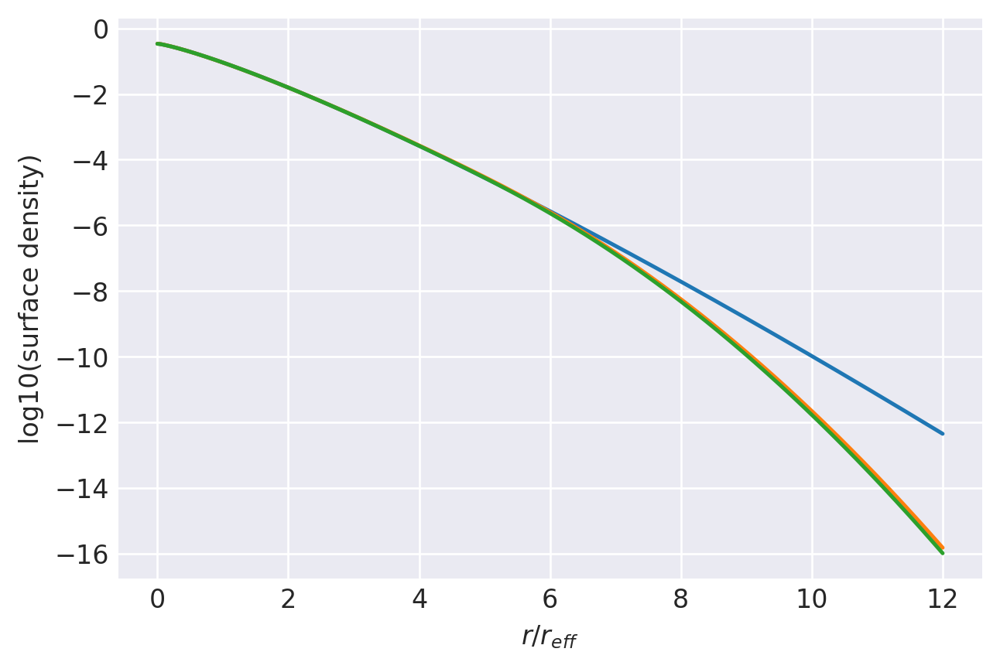

n=0.8200000000000001: (
    normalize(np.array([9.3180282626e-02, 3.6811763616e-01, 3.3933878373e-01, 1.4640937999e-01, 4.1985647417e-02, 9.2541190957e-03, 1.5524119878e-03, 1.6173899923e-04])),
    np.array([1.7721042746e+00, 1.3070260264e+00, 9.3269249807e-01, 6.3532651585e-01, 4.1011161742e-01, 2.4738161812e-01, 1.3467701941e-01, 5.9650583683e-02]),
),
1.0000000221532341 1.000000022091974
prev.  chisq = -8.967021222743258
ws, re: (array([9.31802826e-02, 3.68117636e-01, 3.39338784e-01, 1.46409380e-01,
       4.19856474e-02, 9.25411910e-03, 1.55241199e-03, 1.61738999e-04]), array([1.77210427, 1.30702603, 0.9326925 , 0.63532652, 0.41011162,
       0.24738162, 0.13467702, 0.05965058]))
         Current function value: -11.917539
         Iterations: 47
         Function evaluations: 2715
         Gradient evaluations: 159
-11.917538544778058 [-2.27770804 -0.37619254  0.53819229  1.02105493  1.34442294  1.6873425
  2.26011086  0.24616987  0.11522008 -0.03035195 -0.19626222 -0.38556927
 -

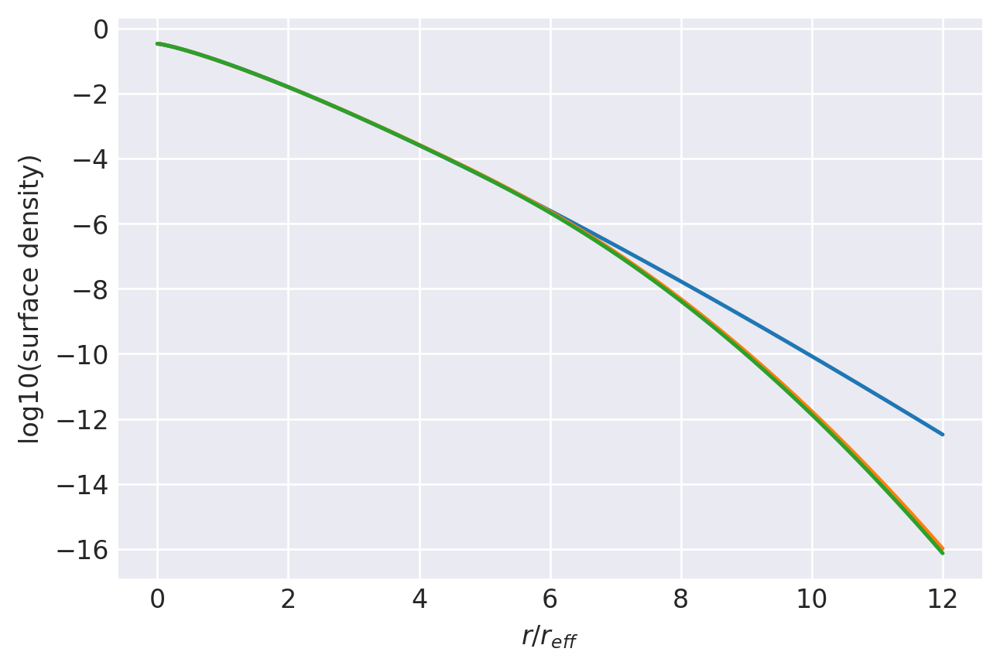

n=0.815: (
    normalize(np.array([9.2986075986e-02, 3.6919597096e-01, 3.3957384478e-01, 1.4574471404e-01, 4.1643377952e-02, 9.1611137100e-03, 1.5347666747e-03, 1.6013589318e-04])),
    np.array([1.7626653685e+00, 1.3038273322e+00, 9.3249831233e-01, 6.3641114918e-01, 4.1155769995e-01, 2.4866489868e-01, 1.3561269169e-01, 6.0234252436e-02]),
),
1.0000000219934586 1.0000000219362726
prev.  chisq = -8.961889848403356
ws, re: (array([9.29860760e-02, 3.69195971e-01, 3.39573845e-01, 1.45744714e-01,
       4.16433780e-02, 9.16111371e-03, 1.53476667e-03, 1.60135893e-04]), array([1.76266537, 1.30382733, 0.93249831, 0.63641115, 0.4115577 ,
       0.2486649 , 0.13561269, 0.06023425]))
         Current function value: -11.951039
         Iterations: 56
         Function evaluations: 2851
         Gradient evaluations: 167
-11.951039086868507 [-2.27166644 -0.36794953  0.54890236  1.03222718  1.3532923   1.69446433
  2.26613687  0.24347969  0.11376002 -0.0309467  -0.19644045 -0.38562144
 -0.60438076 

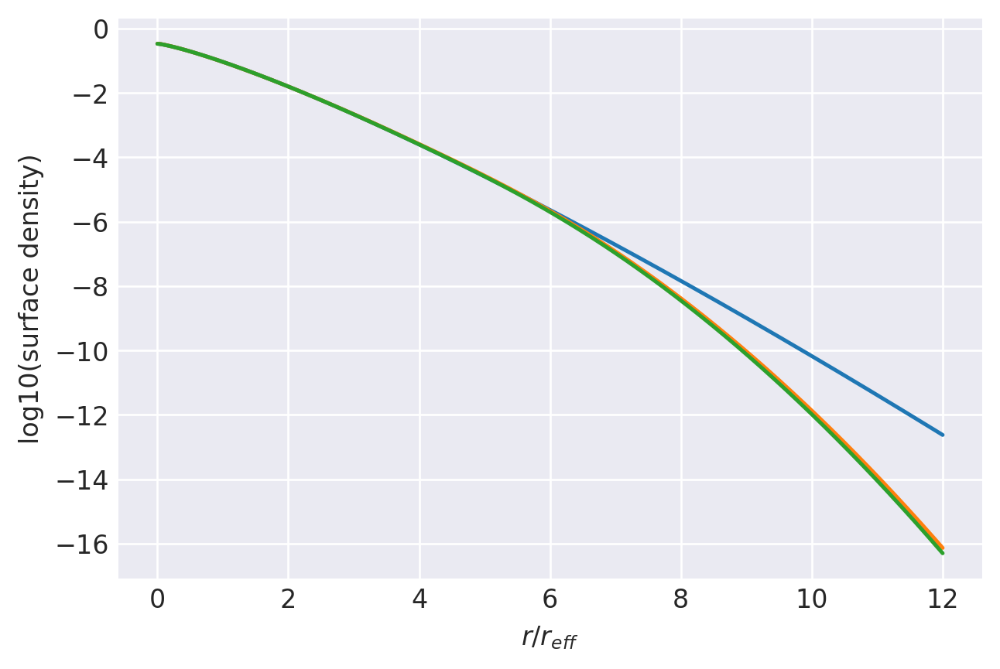

n=0.81: (
    normalize(np.array([9.3496877139e-02, 3.7079293837e-01, 3.3957644974e-01, 1.4461870966e-01, 4.0937308901e-02, 8.9361642321e-03, 1.4873009162e-03, 1.5425104311e-04])),
    np.array([1.7517805029e+00, 1.2994513277e+00, 9.3122215357e-01, 6.3615002551e-01, 4.1150826647e-01, 2.4866762093e-01, 1.3563143012e-01, 6.0257185067e-02]),
),
1.000000021834481 1.0000000217850566
prev.  chisq = -8.956537516071345
ws, re: (array([9.34968771e-02, 3.70792938e-01, 3.39576450e-01, 1.44618710e-01,
       4.09373089e-02, 8.93616423e-03, 1.48730092e-03, 1.54251043e-04]), array([1.7517805 , 1.29945133, 0.93122215, 0.63615003, 0.41150827,
       0.24866762, 0.13563143, 0.06025719]))
         Current function value: -11.985570
         Iterations: 58
         Function evaluations: 2222
         Gradient evaluations: 130
-11.985569833595475 [-2.25424212 -0.35134649  0.56267872  1.04185158  1.35942983  1.69814573
  2.26863914  0.24037123  0.11162207 -0.03240674 -0.1974156  -0.38622194
 -0.60460948 -0

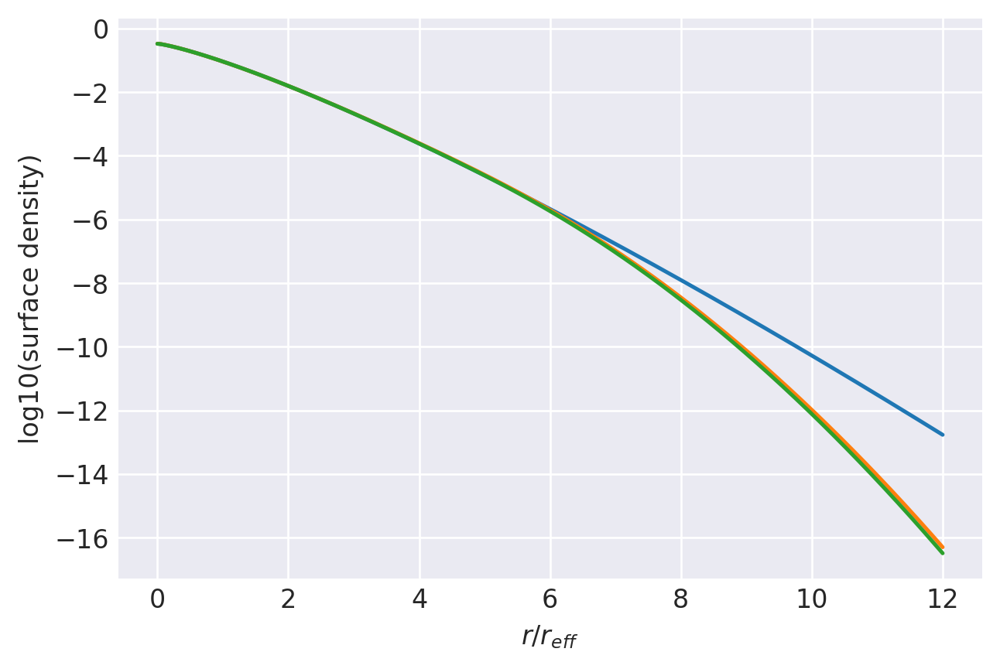

n=0.8049999999999999: (
    normalize(np.array([9.4984175915e-02, 3.7382216017e-01, 3.3840867268e-01, 1.4250803643e-01, 4.0003714523e-02, 8.6838919522e-03, 1.4403409377e-03, 1.4900740270e-04])),
    np.array([1.7392869304e+00, 1.2930701017e+00, 9.2809677491e-01, 6.3472324524e-01, 4.1093966321e-01, 2.4853669358e-01, 1.3569676159e-01, 6.0362472446e-02]),
),
1.0000000216764655 1.000000021634365
prev.  chisq = -8.95132660663413
ws, re: (array([9.49841759e-02, 3.73822160e-01, 3.38408673e-01, 1.42508036e-01,
       4.00037145e-02, 8.68389195e-03, 1.44034094e-03, 1.49007403e-04]), array([1.73928693, 1.2930701 , 0.92809677, 0.63472325, 0.41093966,
       0.24853669, 0.13569676, 0.06036247]))
         Current function value: -12.020693
         Iterations: 50
         Function evaluations: 2732
         Gradient evaluations: 160
-12.020693366756822 [-2.23288269 -0.3321071   0.57748593  1.05039779  1.36361735  1.70110129
  2.27181277  0.2371165   0.10927256 -0.03412604 -0.19861661 -0.38687714
 -

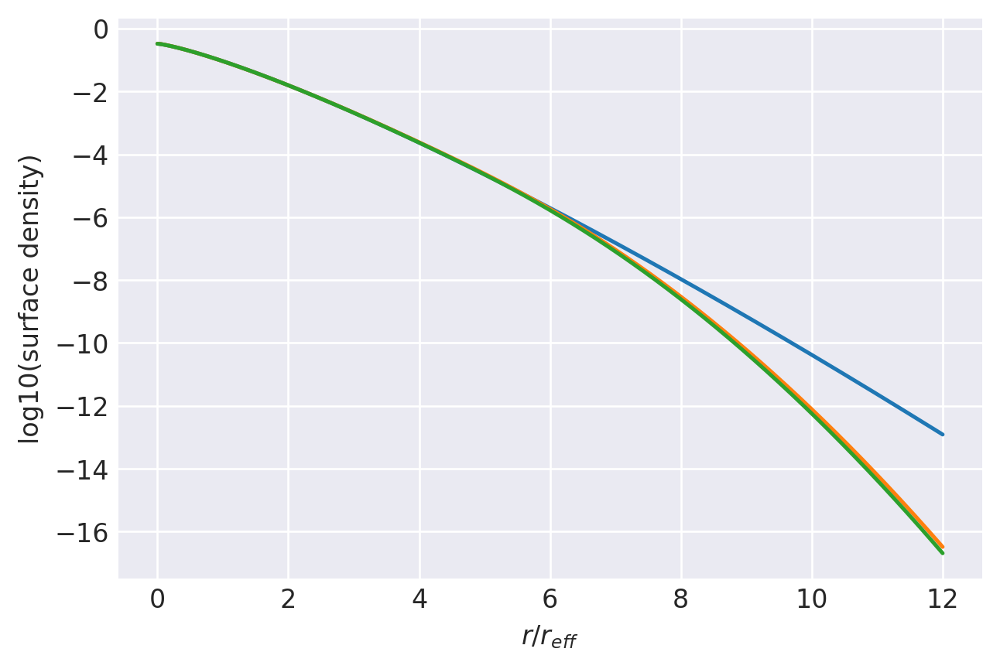

n=0.8: (
    normalize(np.array([9.6836231121e-02, 3.7727681530e-01, 3.3682465858e-01, 1.4006704302e-01, 3.9017221139e-02, 8.4382063067e-03, 1.3958748554e-03, 1.4394968957e-04])),
    np.array([1.7263009193e+00, 1.2860935640e+00, 9.2442985663e-01, 6.3297037972e-01, 4.1032016071e-01, 2.4846492746e-01, 1.3580925809e-01, 6.0469131878e-02]),
),
1.000000021519536 1.0000000214848397
prev.  chisq = -8.94611302341279
ws, re: (array([9.68362311e-02, 3.77276815e-01, 3.36824659e-01, 1.40067043e-01,
       3.90172211e-02, 8.43820631e-03, 1.39587486e-03, 1.43949690e-04]), array([1.72630092, 1.28609356, 0.92442986, 0.63297038, 0.41032016,
       0.24846493, 0.13580926, 0.06046913]))
         Current function value: -12.055630
         Iterations: 49
         Function evaluations: 2068
         Gradient evaluations: 121
-12.055630069796225 [-2.23442012 -0.33018221  0.58255702  1.05716838  1.36951169  1.70519544
  2.27743397  0.23466166  0.10829373 -0.03390255 -0.19758153 -0.38536413
 -0.60283939 -0.8

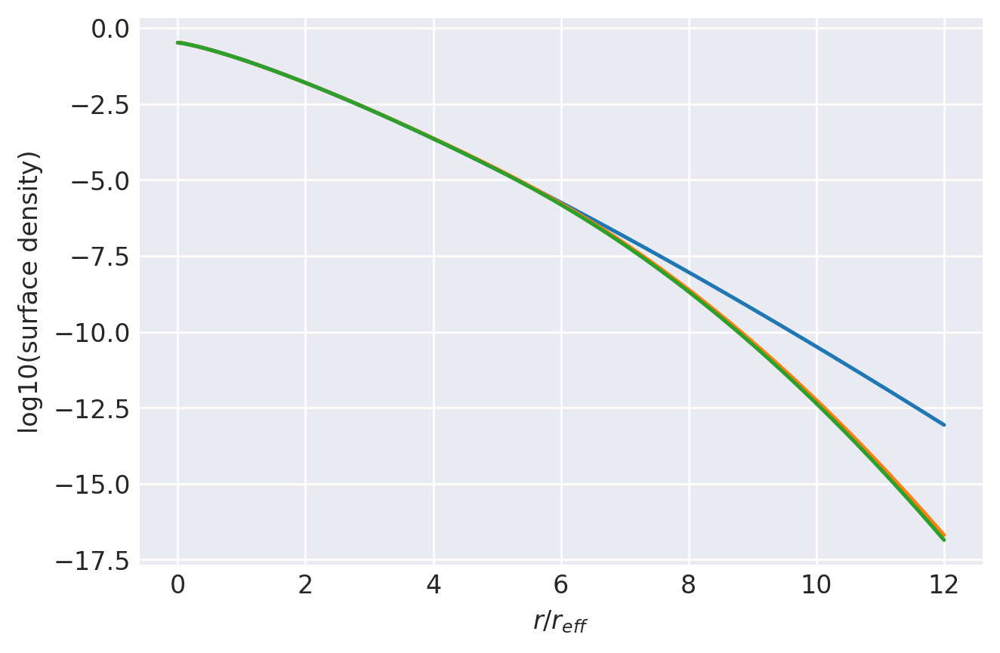

n=0.7949999999999999: (
    normalize(np.array([9.6701851660e-02, 3.7775593288e-01, 3.3721708716e-01, 1.3976531441e-01, 3.8716800257e-02, 8.3292769666e-03, 1.3729452437e-03, 1.4079142677e-04])),
    np.array([1.7165705709e+00, 1.2831981659e+00, 9.2490568253e-01, 6.3448077191e-01, 4.1175214370e-01, 2.4955174559e-01, 1.3652280891e-01, 6.0815609139e-02]),
),
1.0000000213637832 1.00000002133535
prev.  chisq = -8.940628740315452
ws, re: (array([9.67018517e-02, 3.77755933e-01, 3.37217087e-01, 1.39765314e-01,
       3.87168003e-02, 8.32927697e-03, 1.37294524e-03, 1.40791427e-04]), array([1.71657057, 1.28319817, 0.92490568, 0.63448077, 0.41175214,
       0.24955175, 0.13652281, 0.06081561]))
         Current function value: -12.090780
         Iterations: 53
         Function evaluations: 2613
         Gradient evaluations: 153
-12.090779783484422 [-2.2317454  -0.3174598   0.59836685  1.07005614  1.37770007  1.71066776
  2.27658536  0.23212819  0.10678925 -0.03486899 -0.19834278 -0.38601281
 -

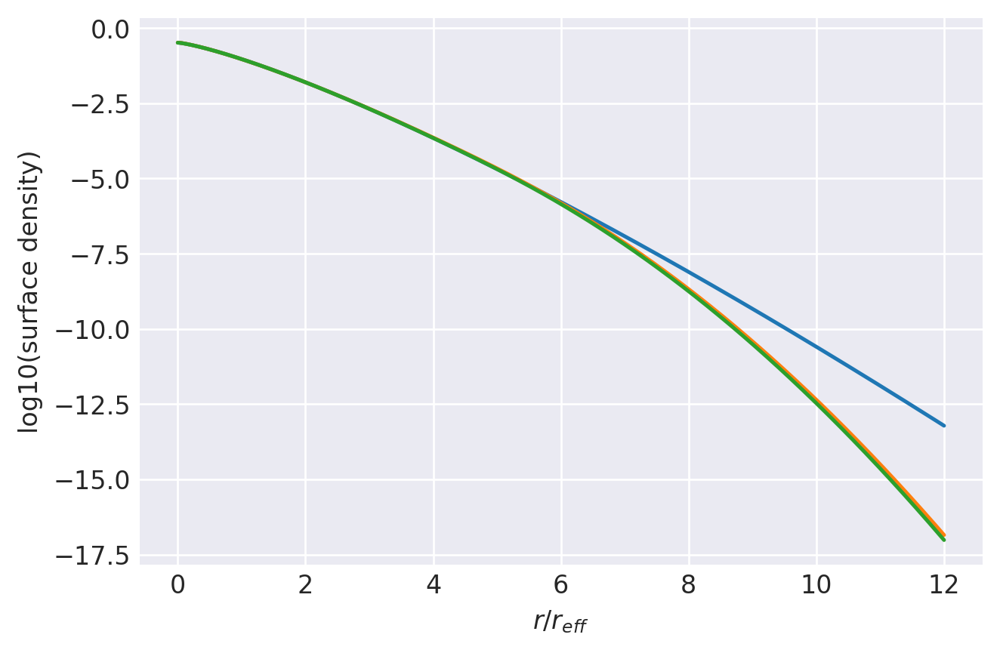

n=0.79: (
    normalize(np.array([9.6935742693e-02, 3.8045640176e-01, 3.3722974477e-01, 1.3803394867e-01, 3.7810059483e-02, 8.0746496081e-03, 1.3236059537e-03, 1.3584706299e-04])),
    np.array([1.7065860305e+00, 1.2787605978e+00, 9.2284976810e-01, 6.3336961499e-01, 4.1113759178e-01, 2.4928138733e-01, 1.3650620880e-01, 6.0972080268e-02]),
),
1.0000000212092717 1.0000000211872624
prev.  chisq = -8.935150653604762
ws, re: (array([9.69357427e-02, 3.80456402e-01, 3.37229745e-01, 1.38033949e-01,
       3.78100595e-02, 8.07464961e-03, 1.32360595e-03, 1.35847063e-04]), array([1.70658603, 1.2787606 , 0.92284977, 0.63336961, 0.41113759,
       0.24928139, 0.13650621, 0.06097208]))
         Current function value: -12.126989
         Iterations: 66
         Function evaluations: 2731
         Gradient evaluations: 160
-12.126988652618126 [-2.21401761 -0.2984619   0.61566916  1.08186178  1.384858    1.71479569
  2.28300777  0.22899529  0.10460249 -0.03651509 -0.19969802 -0.38712061
 -0.60412507 -

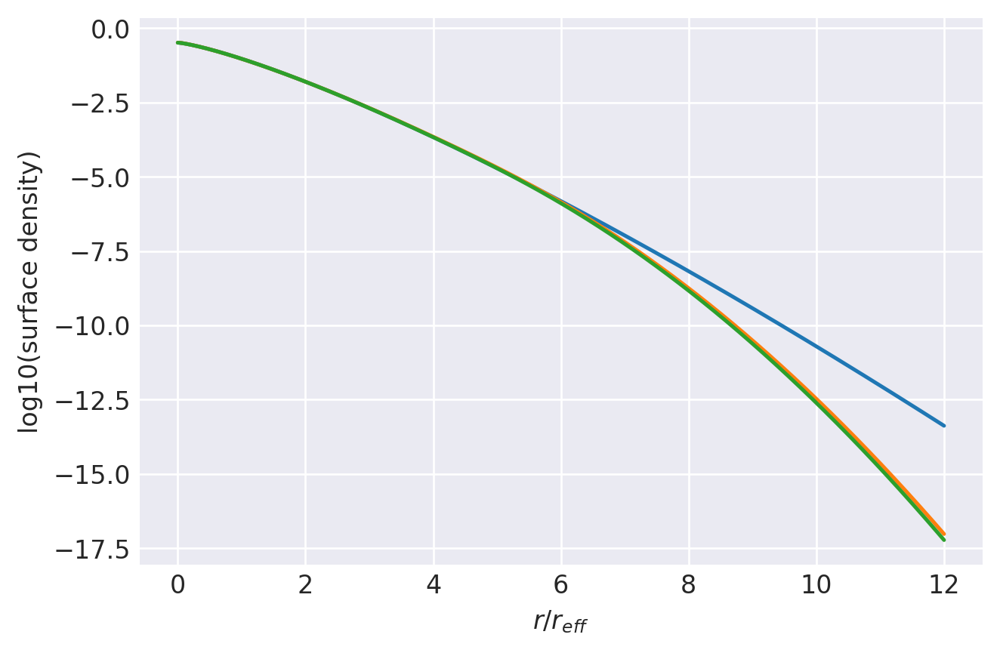

n=0.785: (
    normalize(np.array([9.8498746886e-02, 3.8397960921e-01, 3.3599209206e-01, 1.3557464608e-01, 3.6753358837e-02, 7.7979178628e-03, 1.2737371447e-03, 1.2989192005e-04])),
    np.array([1.6943194094e+00, 1.2723379825e+00, 9.1935853572e-01, 6.3139622447e-01, 4.1009020341e-01, 2.4881406498e-01, 1.3633519253e-01, 6.0914160065e-02]),
),
1.000000021056048 1.0000000210418836
prev.  chisq = -8.929737106446826
ws, re: (array([9.84987469e-02, 3.83979609e-01, 3.35992092e-01, 1.35574646e-01,
       3.67533588e-02, 7.79791786e-03, 1.27373714e-03, 1.29891920e-04]), array([1.69431941, 1.27233798, 0.91935854, 0.63139622, 0.4100902 ,
       0.24881406, 0.13633519, 0.06091416]))
         Current function value: -12.163325
         Iterations: 51
         Function evaluations: 2119
         Gradient evaluations: 124
-12.16332533500502 [-2.22166372 -0.30061056  0.61771229  1.08663361  1.39052306  1.71958461
  2.28834057  0.2267036   0.10394409 -0.03577032 -0.19791733 -0.38471409
 -0.60133624 -0

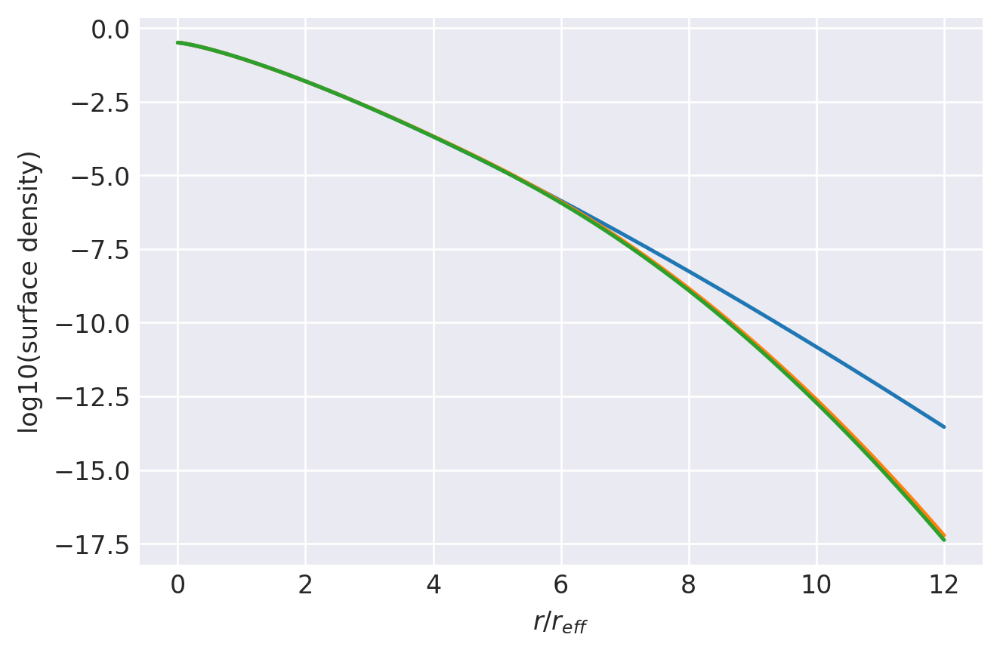

n=0.78: (
    normalize(np.array([9.7821878405e-02, 3.8379400176e-01, 3.3679316026e-01, 1.3578414590e-01, 3.6676404160e-02, 7.7432750138e-03, 1.2593888443e-03, 1.2774566208e-04])),
    np.array([1.6854023618e+00, 1.2704105395e+00, 9.2093649291e-01, 6.3399037683e-01, 4.1236890687e-01, 2.5041696980e-01, 1.3732200474e-01, 6.1389492454e-02]),
),
1.0000000209041424 1.0000000208955528
prev.  chisq = -8.92427102937741
ws, re: (array([9.78218784e-02, 3.83794002e-01, 3.36793160e-01, 1.35784146e-01,
       3.66764042e-02, 7.74327501e-03, 1.25938884e-03, 1.27745662e-04]), array([1.68540236, 1.27041054, 0.92093649, 0.63399038, 0.41236891,
       0.25041697, 0.137322  , 0.06138949]))
         Current function value: -12.201302
         Iterations: 66
         Function evaluations: 2510
         Gradient evaluations: 147
-12.201302072428476 [-2.18774805 -0.26941014  0.64219091  1.10051124  1.39675952  1.72425219
  2.29142795  0.22300687  0.10085635 -0.03868248 -0.20078232 -0.38735033
 -0.60363409 -0

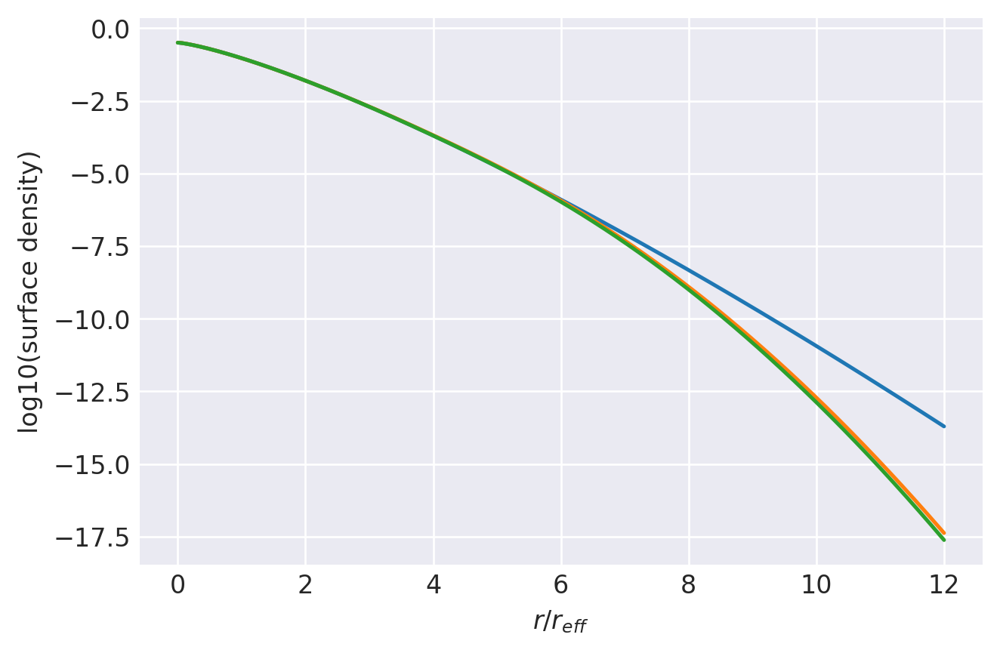

n=0.775: (
    normalize(np.array([1.0085612617e-01, 3.8937597206e-01, 3.3402467920e-01, 1.3186996130e-01, 3.5171840923e-02, 7.3846843034e-03, 1.1958130782e-03, 1.2092296433e-04])),
    np.array([1.6711170558e+00, 1.2614102360e+00, 9.1478180751e-01, 6.2982178360e-01, 4.0987334369e-01, 2.4909551333e-01, 1.3668994631e-01, 6.1202392107e-02]),
),
1.0000000207535735 1.0000000207522899
prev.  chisq = -8.918713255526736
ws, re: (array([1.00856126e-01, 3.89375972e-01, 3.34024679e-01, 1.31869961e-01,
       3.51718409e-02, 7.38468430e-03, 1.19581308e-03, 1.20922964e-04]), array([1.67111706, 1.26141024, 0.91478181, 0.62982178, 0.40987334,
       0.24909551, 0.13668995, 0.06120239]))
         Current function value: -12.240445
         Iterations: 50
         Function evaluations: 2733
         Gradient evaluations: 160
-12.240445105232004 [-2.13637143 -0.23757459  0.6584678   1.10862815  1.40363621  1.72893323
  2.29055107  0.21860535  0.09721899 -0.04158179 -0.20293395 -0.38899587
 -0.60505629 

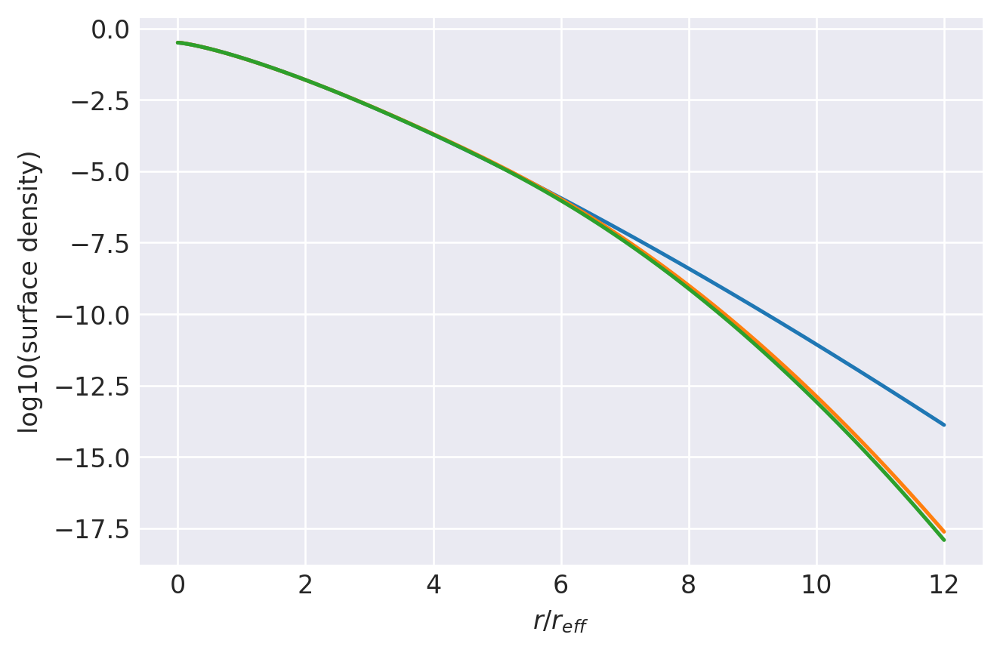

n=0.77: (
    normalize(np.array([1.0561164616e-01, 3.9432164079e-01, 3.2950201626e-01, 1.2824303600e-01, 3.3974147657e-02, 7.0893418712e-03, 1.1425345644e-03, 1.1563669175e-04])),
    np.array([1.6542660376e+00, 1.2508896293e+00, 9.0869515378e-01, 6.2670916526e-01, 4.0832326551e-01, 2.4828112562e-01, 1.3638748080e-01, 6.1174564404e-02]),
),
1.0000000206043538 1.0000000206103739
prev.  chisq = -8.913333049061022
ws, re: (array([1.05611646e-01, 3.94321641e-01, 3.29502016e-01, 1.28243036e-01,
       3.39741477e-02, 7.08934187e-03, 1.14253456e-03, 1.15636692e-04]), array([1.65426604, 1.25088963, 0.90869515, 0.62670917, 0.40832327,
       0.24828113, 0.13638748, 0.06117456]))
         Current function value: -12.279202
         Iterations: 54
         Function evaluations: 2237
         Gradient evaluations: 131
-12.279201736981975 [-2.15822873 -0.24432085  0.66282132  1.11742504  1.40993037  1.73279886
  2.29719232  0.21680774  0.09718109 -0.04030088 -0.2009279  -0.38661392
 -0.60222822 -

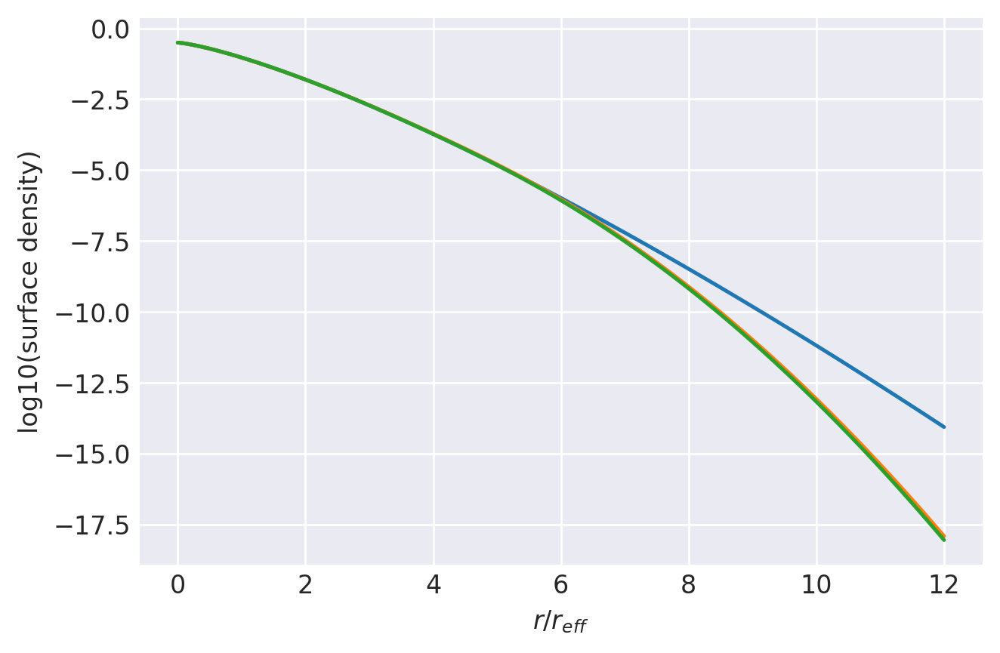

n=0.765: (
    normalize(np.array([1.0356477902e-01, 3.9373390958e-01, 3.3172951533e-01, 1.2882909079e-01, 3.3872408453e-02, 7.0278507492e-03, 1.1289414713e-03, 1.1350460368e-04])),
    np.array([1.6474329143e+00, 1.2507804749e+00, 9.1137921434e-01, 6.2961070542e-01, 4.1056892504e-01, 2.4990318044e-01, 1.3739842554e-01, 6.1686401767e-02]),
),
1.000000020456487 1.0000000204667594
prev.  chisq = -8.907724331468206
ws, re: (array([1.03564779e-01, 3.93733910e-01, 3.31729515e-01, 1.28829091e-01,
       3.38724085e-02, 7.02785075e-03, 1.12894147e-03, 1.13504604e-04]), array([1.64743291, 1.25078047, 0.91137921, 0.62961071, 0.41056893,
       0.24990318, 0.13739843, 0.0616864 ]))
         Current function value: -12.318817
         Iterations: 54
         Function evaluations: 1915
         Gradient evaluations: 112
-12.31881722485979 [-2.12743313 -0.21962662  0.67843606  1.1235789   1.4113273   1.73296171
  2.29893098  0.21318176  0.09445779 -0.04232644 -0.20222665 -0.38708284
 -0.60187284 -0

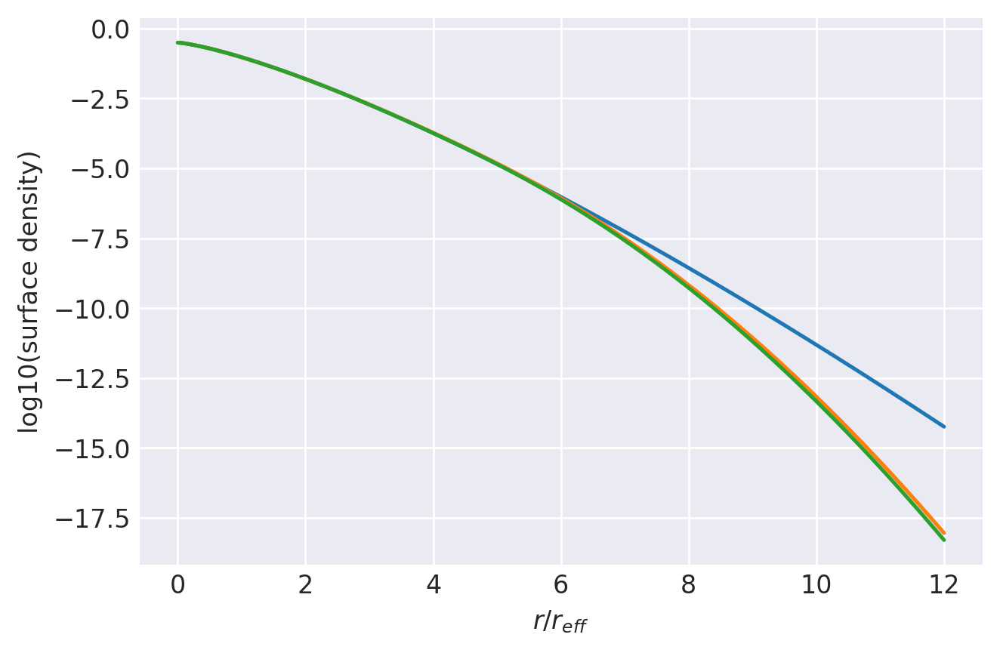

n=0.76: (
    normalize(np.array([1.0645891953e-01, 3.9790545178e-01, 3.2879949786e-01, 1.2590321348e-01, 3.2909050804e-02, 6.8186084872e-03, 1.0953246246e-03, 1.0993343910e-04])),
    np.array([1.6337355608e+00, 1.2429618207e+00, 9.0713841819e-01, 6.2773067633e-01, 4.1012586135e-01, 2.5010775541e-01, 1.3775887552e-01, 6.1986363244e-02]),
),
1.0000000203099735 1.0000000203250463
prev.  chisq = -8.902219532033492
ws, re: (array([1.06458920e-01, 3.97905452e-01, 3.28799498e-01, 1.25903213e-01,
       3.29090508e-02, 6.81860849e-03, 1.09532462e-03, 1.09933439e-04]), array([1.63373556, 1.24296182, 0.90713842, 0.62773068, 0.41012586,
       0.25010776, 0.13775888, 0.06198636]))
         Current function value: -12.356716
         Iterations: 49
         Function evaluations: 2375
         Gradient evaluations: 139
-12.356716261428712 [-2.0739111  -0.17971341  0.70477952  1.13799075  1.42075149  1.73893211
  2.3011116   0.20878444  0.09056905 -0.04603863 -0.20584669 -0.39062355
 -0.60543283 -

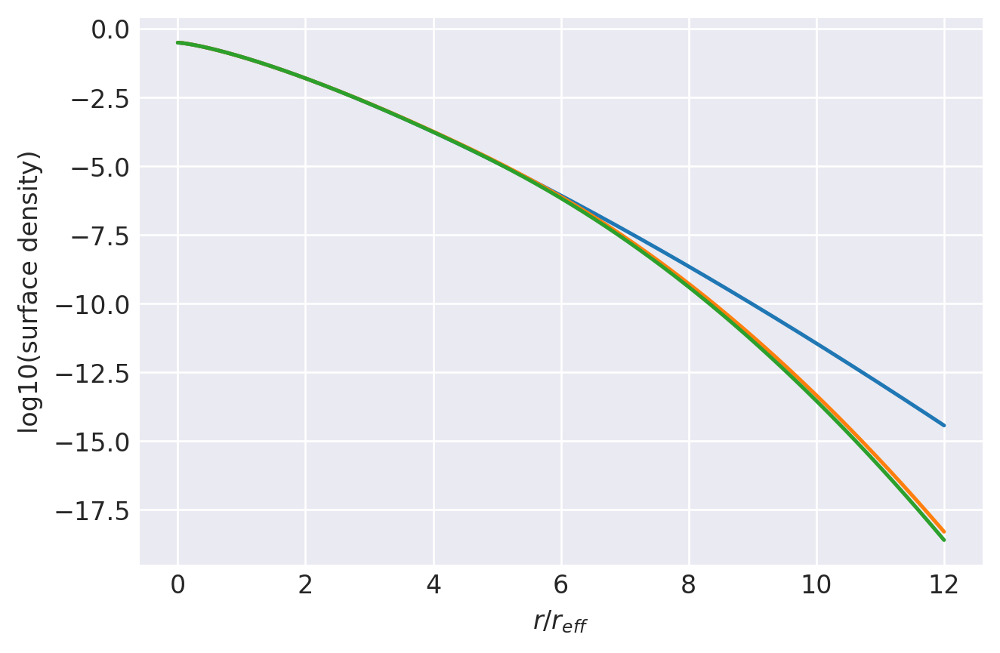

n=0.755: (
    normalize(np.array([1.1165850374e-01, 4.0436610200e-01, 3.2389888747e-01, 1.2122762703e-01, 3.1291071025e-02, 6.4283046031e-03, 1.0266843152e-03, 1.0281982391e-04])),
    np.array([1.6172771202e+00, 1.2318818288e+00, 8.9941757207e-01, 6.2251999495e-01, 4.0679578857e-01, 2.4806595746e-01, 1.3670966135e-01, 6.1560345274e-02]),
),
1.0000000201648103 1.000000020187683
prev.  chisq = -8.896438028194853
ws, re: (array([1.11658504e-01, 4.04366102e-01, 3.23898887e-01, 1.21227627e-01,
       3.12910710e-02, 6.42830460e-03, 1.02668432e-03, 1.02819824e-04]), array([1.61727712, 1.23188183, 0.89941757, 0.62251999, 0.40679579,
       0.24806596, 0.13670966, 0.06156035]))
         Current function value: -12.387657
         Iterations: 55
         Function evaluations: 2460
         Gradient evaluations: 144
-12.387656716441676 [-2.01010529 -0.12911216  0.74217964  1.16147795  1.43269608  1.7468172
  2.30969177  0.20408124  0.08604556 -0.05096599 -0.21148494 -0.39684264
 -0.6118431  -0

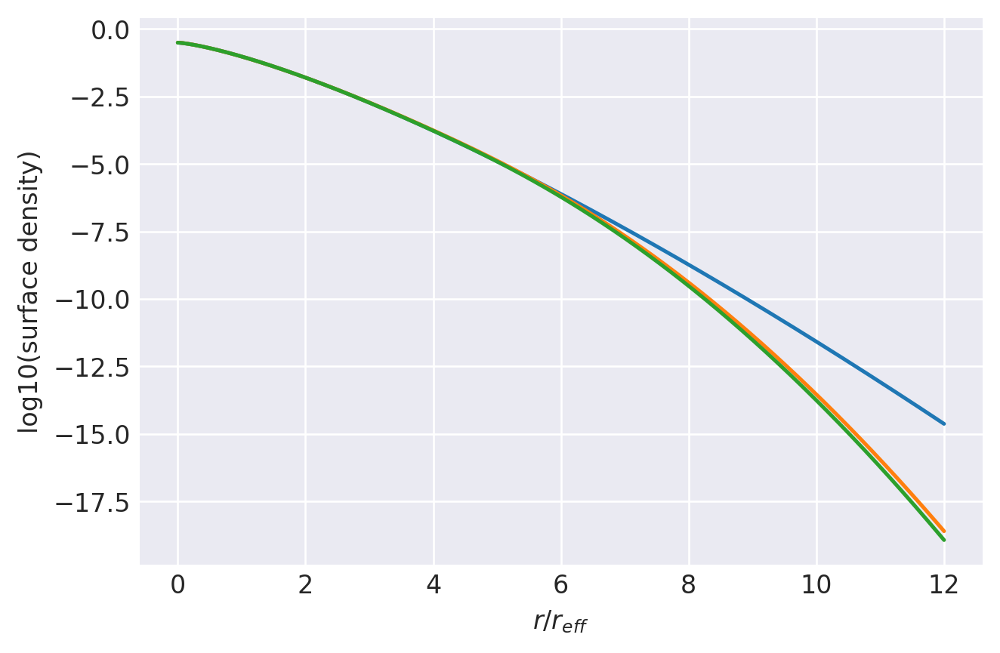

n=0.75: (
    normalize(np.array([1.1814600743e-01, 4.1250195292e-01, 3.1797300530e-01, 1.1529044862e-01, 2.9135074884e-02, 5.9212684740e-03, 9.3900666303e-04, 9.3235710220e-05])),
    np.array([1.5998572704e+00, 1.2191174793e+00, 8.8927075077e-01, 6.1449033889e-01, 4.0101199477e-01, 2.4443134582e-01, 1.3465365850e-01, 6.0605648890e-02]),
),
1.0000000200209913 1.0000000200518053
prev.  chisq = -8.890646002907143
ws, re: (array([1.18146007e-01, 4.12501953e-01, 3.17973005e-01, 1.15290449e-01,
       2.91350749e-02, 5.92126847e-03, 9.39006663e-04, 9.32357102e-05]), array([1.59985727, 1.21911748, 0.88927075, 0.61449034, 0.40101199,
       0.24443135, 0.13465366, 0.06060565]))
         Current function value: -12.439826
         Iterations: 44
         Function evaluations: 2766
         Gradient evaluations: 162
-12.439826239366885 [-2.06842534 -0.15849838  0.73629801  1.16533005  1.43382329  1.74414179
  2.3081071   0.20342666  0.08789955 -0.04710063 -0.20641316 -0.39088285
 -0.60480496 -

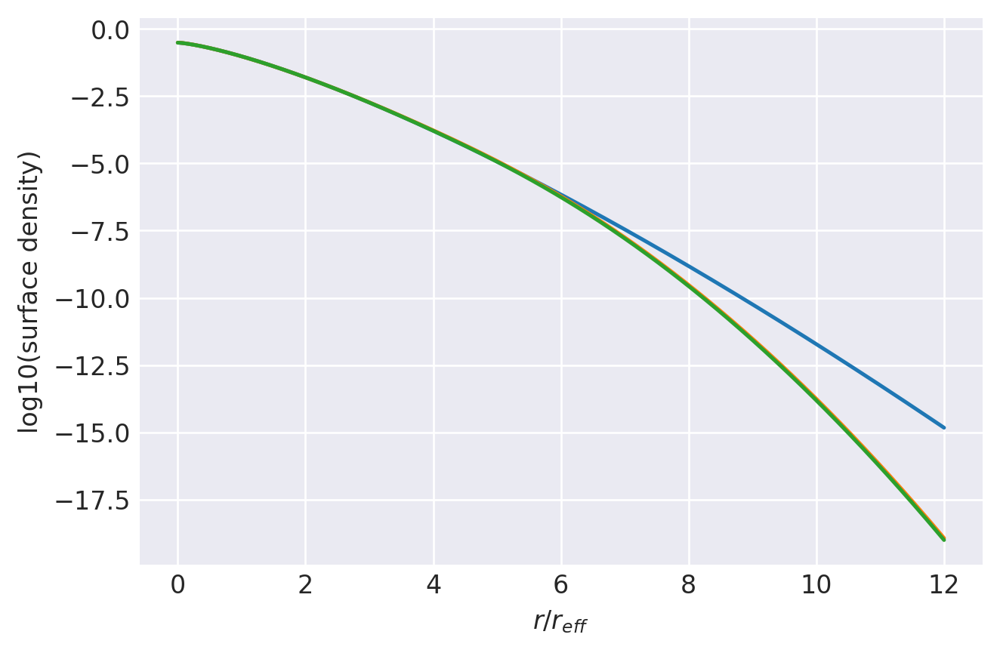

n=0.745: (
    normalize(np.array([1.1220380065e-01, 4.0879299668e-01, 3.2389516490e-01, 1.1823883585e-01, 2.9771745251e-02, 6.0414430167e-03, 9.6049324377e-04, 9.5520400903e-05])),
    np.array([1.5974477477e+00, 1.2243329845e+00, 8.9722086673e-01, 6.2170854804e-01, 4.0655297986e-01, 2.4842485027e-01, 1.3726235224e-01, 6.1955367300e-02]),
),
1.0000000198785108 1.000000019910926
prev.  chisq = -8.884797209762512
ws, re: (array([1.12203801e-01, 4.08792997e-01, 3.23895165e-01, 1.18238836e-01,
       2.97717453e-02, 6.04144302e-03, 9.60493244e-04, 9.55204009e-05]), array([1.59744775, 1.22433298, 0.89722087, 0.62170855, 0.40655298,
       0.24842485, 0.13726235, 0.06195537]))
         Current function value: -12.481755
         Iterations: 45
         Function evaluations: 2698
         Gradient evaluations: 158
-12.481755230151634 [-2.1020966  -0.1742678   0.73168424  1.16595924  1.43817599  1.74930902
  2.31309118  0.2018717   0.08845368 -0.04466925 -0.20247059 -0.38591597
 -0.59927397 -

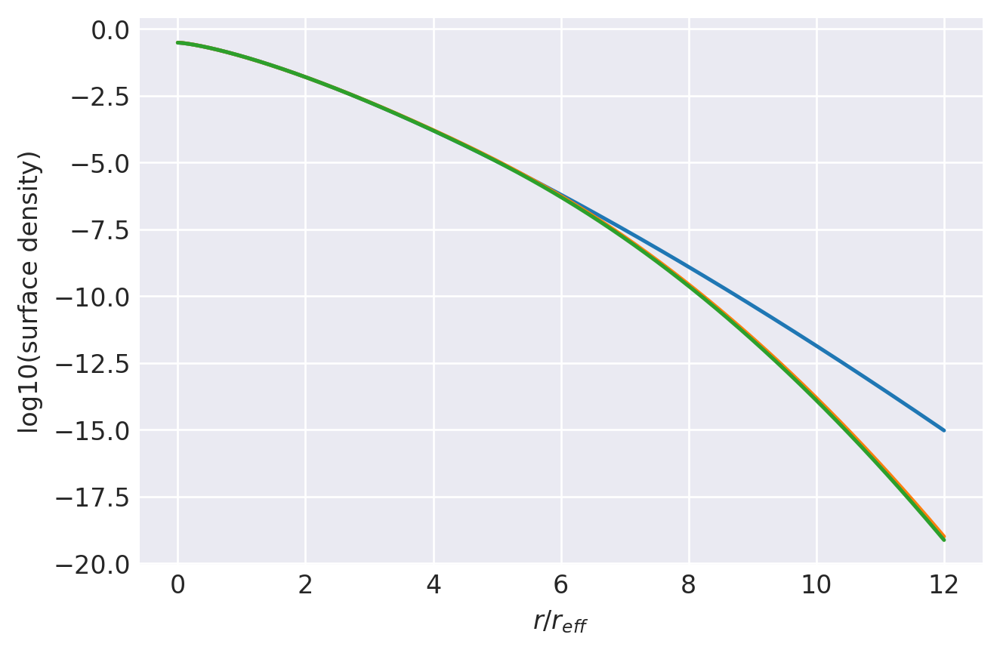

n=0.74: (
    normalize(np.array([1.0889321001e-01, 4.0682854520e-01, 3.2697244650e-01, 1.1993211972e-01, 3.0204361829e-02, 6.1072944966e-03, 9.6639292841e-04, 9.5629307263e-05])),
    np.array([1.5917384390e+00, 1.2258961440e+00, 9.0225800890e-01, 6.2737817919e-01, 4.1122927710e-01, 2.5160891993e-01, 1.3914638347e-01, 6.2855471404e-02]),
),
1.00000001973736 1.0000000197726142
prev.  chisq = -8.879040677348925
ws, re: (array([1.08893210e-01, 4.06828545e-01, 3.26972447e-01, 1.19932120e-01,
       3.02043618e-02, 6.10729450e-03, 9.66392928e-04, 9.56293073e-05]), array([1.59173844, 1.22589614, 0.90225801, 0.62737818, 0.41122928,
       0.25160892, 0.13914638, 0.06285547]))
         Current function value: -12.522101
         Iterations: 68
         Function evaluations: 2766
         Gradient evaluations: 162
-12.522101030822645 [-2.08464608 -0.1485336   0.7595957   1.1893814   1.45369831  1.75966023
  2.32044584  0.19871517  0.08619442 -0.04673721 -0.20500234 -0.38915939
 -0.60302312 -0.

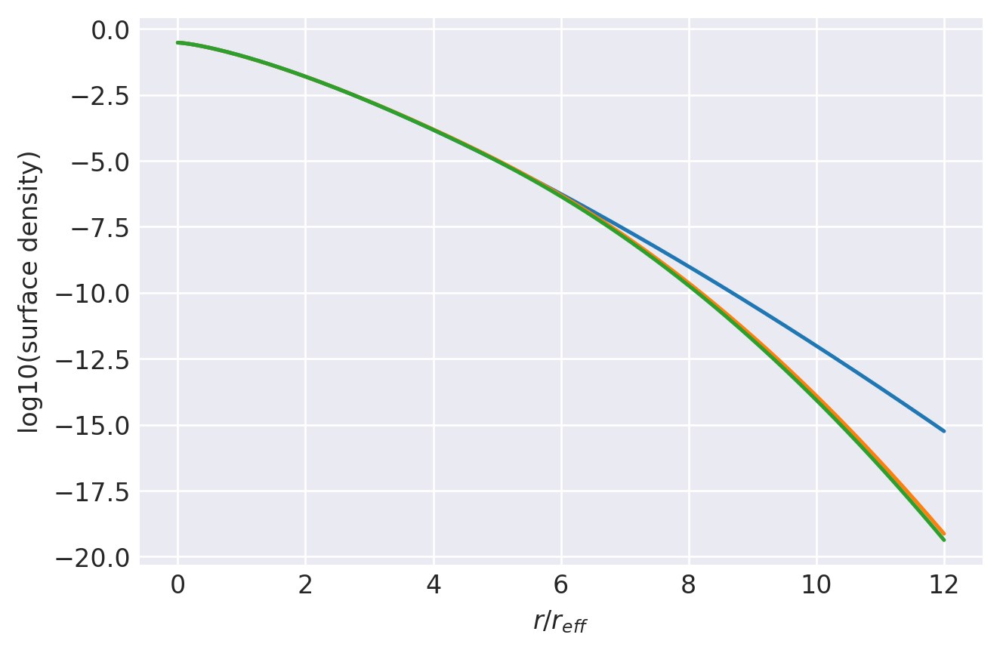

n=0.735: (
    normalize(np.array([1.1059812198e-01, 4.1173500978e-01, 3.2541817231e-01, 1.1671848026e-01, 2.8799618698e-02, 5.7423239070e-03, 8.9987822051e-04, 8.8394840593e-05])),
    np.array([1.5802113148e+00, 1.2195354207e+00, 8.9797199025e-01, 6.2373147834e-01, 4.0816955796e-01, 2.4944619049e-01, 1.3786899064e-01, 6.2318660498e-02]),
),
1.0000000195975296 1.000000019638715
prev.  chisq = -8.873054373839588
ws, re: (array([1.10598122e-01, 4.11735010e-01, 3.25418172e-01, 1.16718480e-01,
       2.87996187e-02, 5.74232391e-03, 8.99878221e-04, 8.83948406e-05]), array([1.58021131, 1.21953542, 0.89797199, 0.62373148, 0.40816956,
       0.24944619, 0.13786899, 0.06231866]))
         Current function value: -12.561139
         Iterations: 57
         Function evaluations: 2238
         Gradient evaluations: 131
-12.561139365919896 [-2.11622384 -0.16297392  0.75654474  1.19227983  1.45853221  1.76392434
  2.32396516  0.19699048  0.08657545 -0.04447676 -0.20131722 -0.38456888
 -0.59786283 -

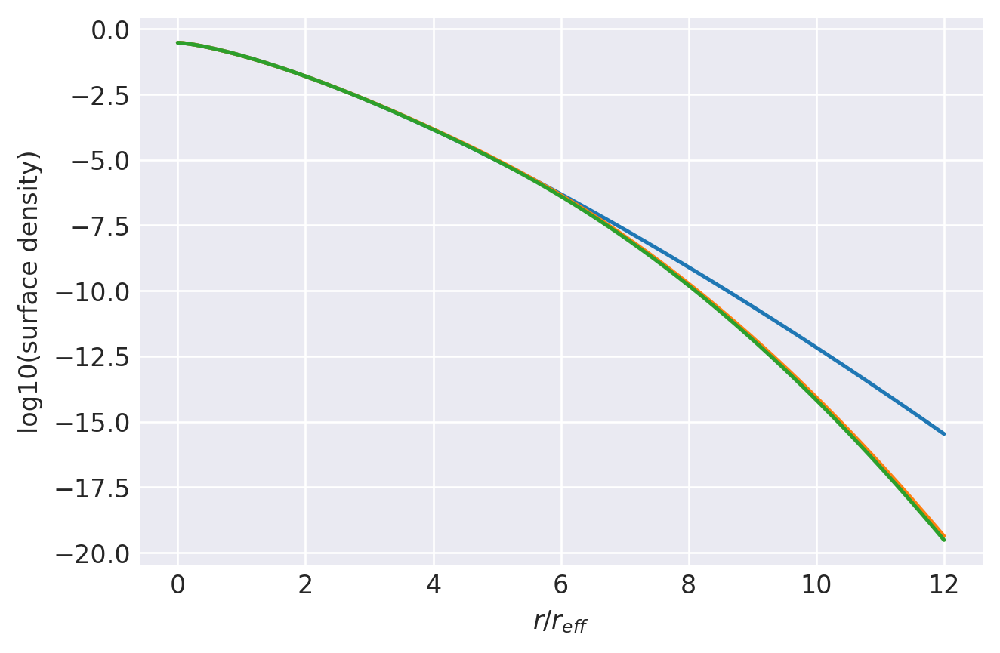

n=0.73: (
    normalize(np.array([1.0752992118e-01, 4.0995297373e-01, 3.2840263257e-01, 1.1822869594e-01, 2.9114420408e-02, 5.7807099738e-03, 9.0232262678e-04, 8.8323567377e-05])),
    np.array([1.5739483568e+00, 1.2206058678e+00, 9.0265800120e-01, 6.2904653840e-01, 4.1250680451e-01, 2.5242779324e-01, 1.3969035455e-01, 6.3226806799e-02]),
),
1.0000000194590108 1.0000000195027694
prev.  chisq = -8.867245410336178
ws, re: (array([1.07529921e-01, 4.09952974e-01, 3.28402633e-01, 1.18228696e-01,
       2.91144204e-02, 5.78070997e-03, 9.02322627e-04, 8.83235674e-05]), array([1.57394836, 1.22060587, 0.902658  , 0.62904654, 0.4125068 ,
       0.25242779, 0.13969035, 0.06322681]))
         Current function value: -12.612270
         Iterations: 73
         Function evaluations: 3072
         Gradient evaluations: 180
-12.612269853542962 [-2.01876116 -0.11041118  0.77922166  1.20225608  1.46570739  1.77009437
  2.32818642  0.19112618  0.08123091 -0.04919536 -0.20537535 -0.38824155
 -0.60140152 -

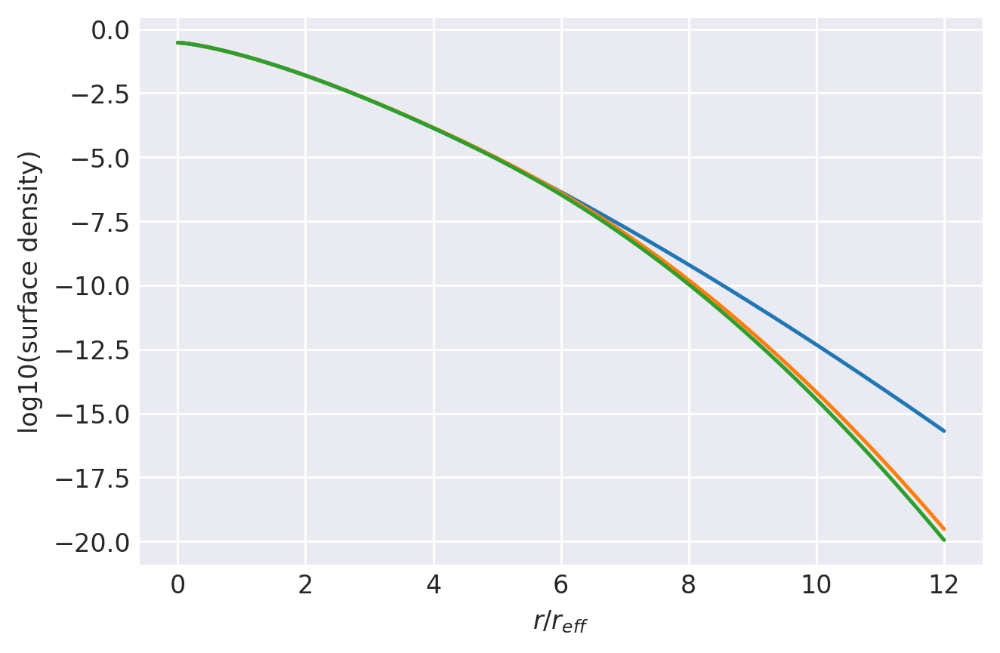

n=0.725: (
    normalize(np.array([1.1724715070e-01, 4.1703470264e-01, 3.1925553681e-01, 1.1261889175e-01, 2.7494773760e-02, 5.4249787086e-03, 8.4190333184e-04, 8.2062305080e-05])),
    np.array([1.5528381162e+00, 1.2056768135e+00, 8.9290373420e-01, 6.2319598472e-01, 4.0903309515e-01, 2.5037933312e-01, 1.3859794849e-01, 6.2788228313e-02]),
),
1.0000000193217948 1.000000019371088
prev.  chisq = -8.861317051572206
ws, re: (array([1.17247151e-01, 4.17034703e-01, 3.19255537e-01, 1.12618892e-01,
       2.74947738e-02, 5.42497871e-03, 8.41903332e-04, 8.20623051e-05]), array([1.55283812, 1.20567681, 0.89290373, 0.62319598, 0.4090331 ,
       0.25037933, 0.13859795, 0.06278823]))
         Current function value: -12.656711
         Iterations: 51
         Function evaluations: 2069
         Gradient evaluations: 121
-12.65671126844615 [-2.04257235 -0.1062494   0.79464447  1.21100307  1.46536812  1.76878046
  2.33267809  0.18924837  0.08085148 -0.04877433 -0.20448994 -0.38655881
 -0.59859774 -0

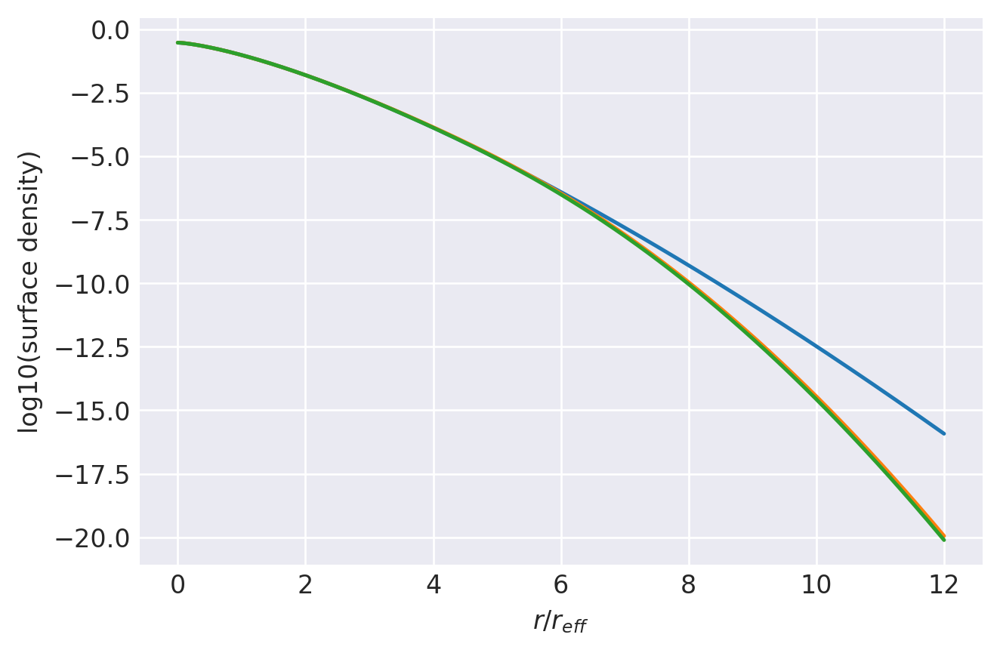

n=0.72: (
    normalize(np.array([1.1480505853e-01, 4.1910670741e-01, 3.2105449407e-01, 1.1174507134e-01, 2.7042127952e-02, 5.3364568378e-03, 8.2958466412e-04, 8.0499187063e-05])),
    np.array([1.5461383952e+00, 1.2046239181e+00, 8.9376979342e-01, 6.2446781488e-01, 4.1062102819e-01, 2.5200099947e-01, 1.3977738002e-01, 6.3400552105e-02]),
),
1.0000000191858711 1.0000000192378395
prev.  chisq = -8.855214329639509
ws, re: (array([1.14805059e-01, 4.19106707e-01, 3.21054494e-01, 1.11745071e-01,
       2.70421280e-02, 5.33645684e-03, 8.29584664e-04, 8.04991871e-05]), array([1.5461384 , 1.20462392, 0.89376979, 0.62446781, 0.41062103,
       0.252001  , 0.13977738, 0.06340055]))
         Current function value: -12.704654
         Iterations: 57
         Function evaluations: 1966
         Gradient evaluations: 115
-12.704653912223211 [-2.00062234 -0.08377015  0.80260889  1.21460004  1.47104542  1.77585204
  2.33892712  0.18515899  0.07804782 -0.05021073 -0.20460138 -0.38581985
 -0.5975498  -

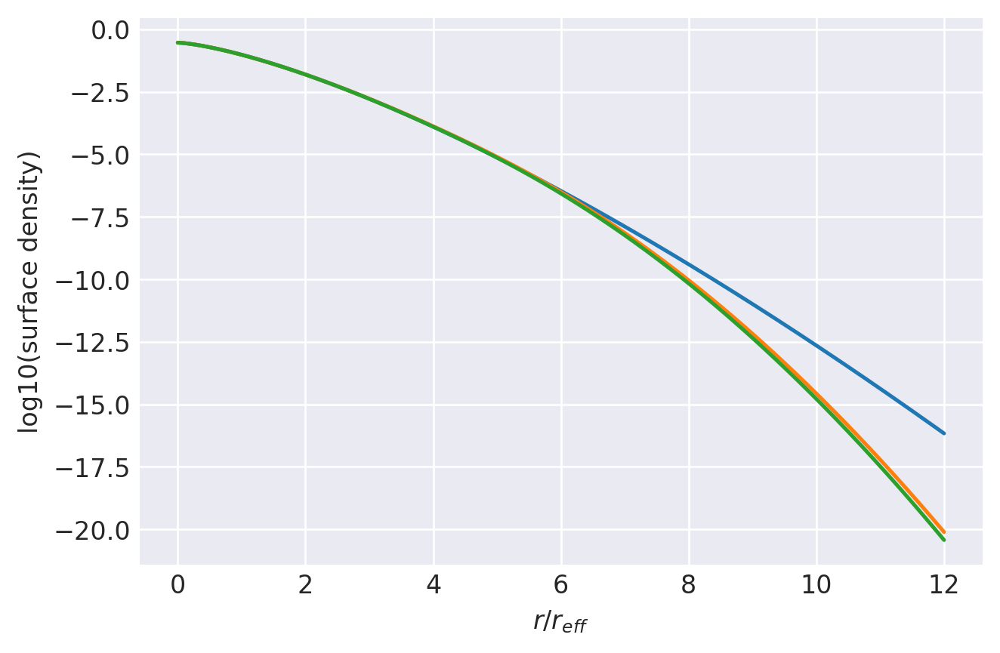

n=0.715: (
    normalize(np.array([1.1913759597e-01, 4.2199448941e-01, 3.1686310296e-01, 1.0950159467e-01, 2.6432143660e-02, 5.1918842924e-03, 8.0186441486e-04, 7.7324621190e-05])),
    np.array([1.5316480903e+00, 1.1968723096e+00, 8.9081859415e-01, 6.2430759694e-01, 4.1132030866e-01, 2.5260980269e-01, 1.4014972277e-01, 6.3635264754e-02]),
),
1.0000000190512297 1.0000000191066767
prev.  chisq = -8.849414238392173
ws, re: (array([1.19137596e-01, 4.21994489e-01, 3.16863103e-01, 1.09501595e-01,
       2.64321437e-02, 5.19188429e-03, 8.01864415e-04, 7.73246212e-05]), array([1.53164809, 1.19687231, 0.89081859, 0.6243076 , 0.41132031,
       0.2526098 , 0.14014972, 0.06363526]))
         Current function value: -12.752434
         Iterations: 49
         Function evaluations: 1745
         Gradient evaluations: 102
-12.752433509694324 [-1.96415885 -0.0469067   0.833851    1.23509372  1.48604074  1.78171178
  2.32919937  0.18137319  0.07502223 -0.05315671 -0.20789073 -0.38959465
 -0.60177919 

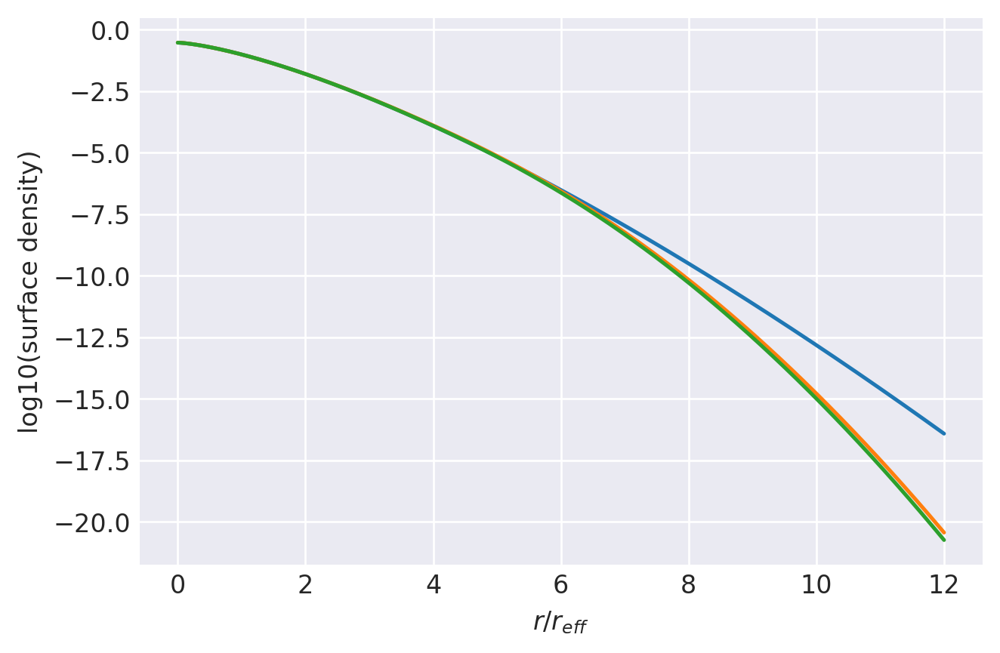

n=0.71: (
    normalize(np.array([1.2301766942e-01, 4.2820896393e-01, 3.1287069411e-01, 1.0528500320e-01, 2.4968196974e-02, 4.8354291996e-03, 7.4181036586e-04, 7.2232802591e-05])),
    np.array([1.5183545428e+00, 1.1885630512e+00, 8.8479628683e-01, 6.1959695114e-01, 4.0776068481e-01, 2.5016169561e-01, 1.3900549496e-01, 6.3386651622e-02]),
),
1.000000018917862 1.0000000189775258
prev.  chisq = -8.84334234993595
ws, re: (array([1.23017669e-01, 4.28208964e-01, 3.12870694e-01, 1.05285003e-01,
       2.49681970e-02, 4.83542920e-03, 7.41810366e-04, 7.22328026e-05]), array([1.51835454, 1.18856305, 0.88479629, 0.61959695, 0.40776068,
       0.2501617 , 0.13900549, 0.06338665]))
         Current function value: -12.793444
         Iterations: 49
         Function evaluations: 1933
         Gradient evaluations: 113
-12.79344365774878 [-2.00326953 -0.07074573  0.82435248  1.22988238  1.47585762  1.777229
  2.34346926  0.17967243  0.07588383 -0.04984814 -0.20254448 -0.38222424
 -0.59222849 -0.846

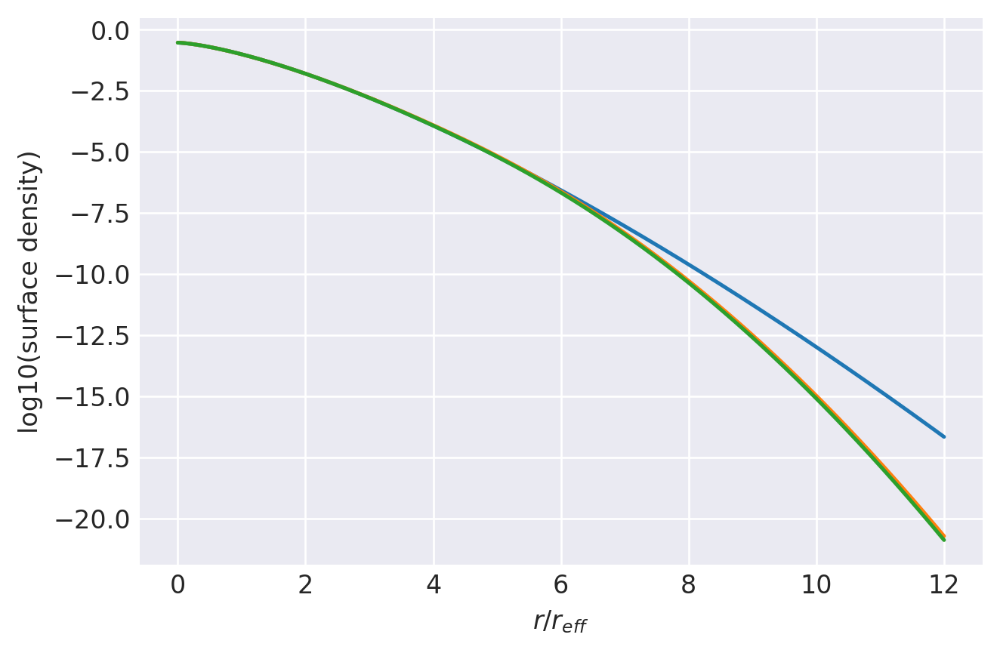

n=0.7050000000000001: (
    normalize(np.array([1.1886006954e-01, 4.2499223904e-01, 3.1709538718e-01, 1.0759839326e-01, 2.5601787660e-02, 5.0056392285e-03, 7.7234369868e-04, 7.4140385326e-05])),
    np.array([1.5124200602e+00, 1.1909233935e+00, 8.9156263955e-01, 6.2727144441e-01, 4.1473984317e-01, 2.5572401186e-01, 1.4235320956e-01, 6.4805197004e-02]),
),
1.0000000187857572 1.0000000188470302
prev.  chisq = -8.837035796514835
ws, re: (array([1.18860070e-01, 4.24992239e-01, 3.17095387e-01, 1.07598393e-01,
       2.56017877e-02, 5.00563923e-03, 7.72343699e-04, 7.41403853e-05]), array([1.51242006, 1.19092339, 0.89156264, 0.62727144, 0.41473984,
       0.25572401, 0.14235321, 0.0648052 ]))
         Current function value: -12.836196
         Iterations: 55
         Function evaluations: 2885
         Gradient evaluations: 169
-12.836195926284544 [-2.02634642 -0.06510956  0.84653004  1.25470345  1.4953514   1.78959463
  2.34956749  0.1776053   0.07539544 -0.04957865 -0.20252672 -0.38304653


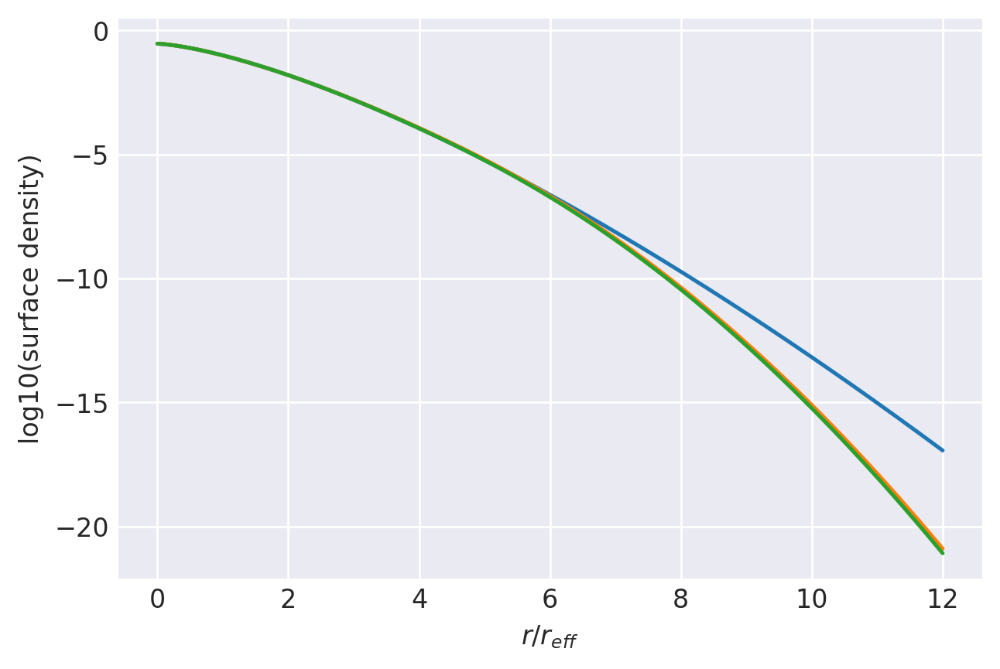

n=0.7: (
    normalize(np.array([1.1646435020e-01, 4.2739124945e-01, 3.1922751878e-01, 1.0653680383e-01, 2.4816881868e-02, 4.7669777519e-03, 7.2686739303e-04, 6.9350722705e-05])),
    np.array([1.5052384522e+00, 1.1895849021e+00, 8.9211604870e-01, 6.2729710480e-01, 4.1395531956e-01, 2.5476146085e-01, 1.4180217436e-01, 6.4647551382e-02]),
),
1.0000000186549063 1.000000018719022
prev.  chisq = -8.830988772973056
ws, re: (array([1.16464350e-01, 4.27391249e-01, 3.19227519e-01, 1.06536804e-01,
       2.48168819e-02, 4.76697775e-03, 7.26867393e-04, 6.93507227e-05]), array([1.50523845, 1.1895849 , 0.89211605, 0.6272971 , 0.41395532,
       0.25476146, 0.14180217, 0.06464755]))
         Current function value: -12.888752
         Iterations: 54
         Function evaluations: 1796
         Gradient evaluations: 105
-12.88875176507495 [-1.98520698 -0.0426835   0.85037311  1.24717305  1.48966051  1.79066706
  2.35032777  0.17353484  0.07268964 -0.05073346 -0.20172611 -0.380253
 -0.58969788 -0.843

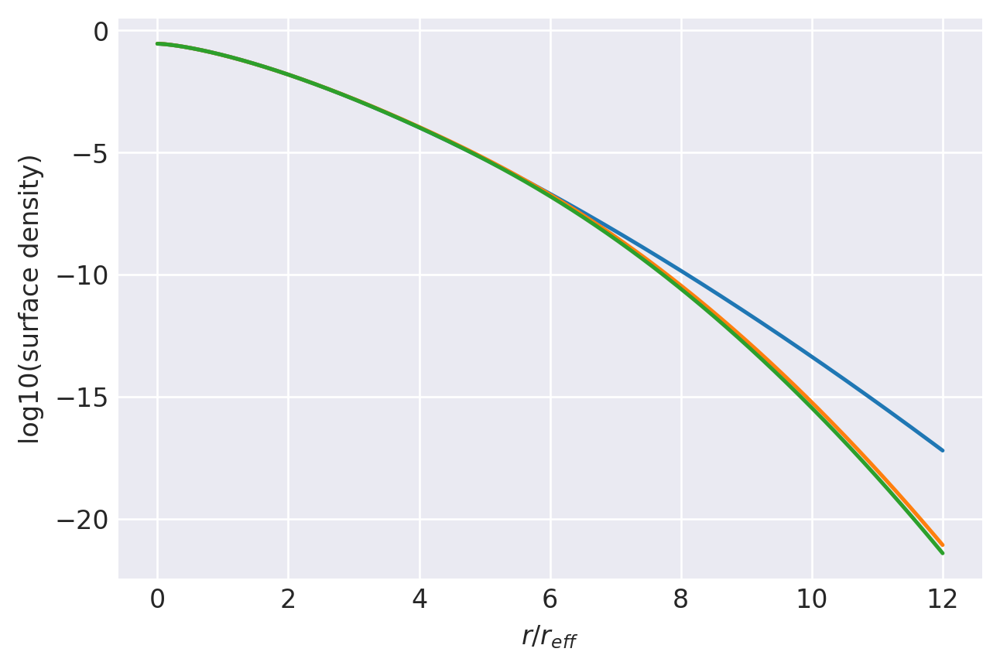

n=0.6950000000000001: (
    normalize(np.array([1.2076486484e-01, 4.3023678247e-01, 3.1458863276e-01, 1.0441083045e-01, 2.4479913142e-02, 4.7298126230e-03, 7.2047513089e-04, 6.8688591910e-05])),
    np.array([1.4911963653e+00, 1.1821964262e+00, 8.8974702402e-01, 6.2845456631e-01, 4.1662660699e-01, 2.5721844957e-01, 1.4339831189e-01, 6.5541865144e-02]),
),
1.0000000185253002 1.000000018591421
prev.  chisq = -8.82479611693309
ws, re: (array([1.20764865e-01, 4.30236782e-01, 3.14588633e-01, 1.04410830e-01,
       2.44799131e-02, 4.72981262e-03, 7.20475131e-04, 6.86885919e-05]), array([1.49119637, 1.18219643, 0.88974702, 0.62845457, 0.41662661,
       0.25721845, 0.14339831, 0.06554187]))
         Current function value: -12.949850
         Iterations: 60
         Function evaluations: 2340
         Gradient evaluations: 137
-12.949850481022173 [-1.86860899  0.04705702  0.91062778  1.27934634  1.50286528  1.79100389
  2.3517394   0.16750764  0.06614099 -0.05876187 -0.21155672 -0.39140447
 -

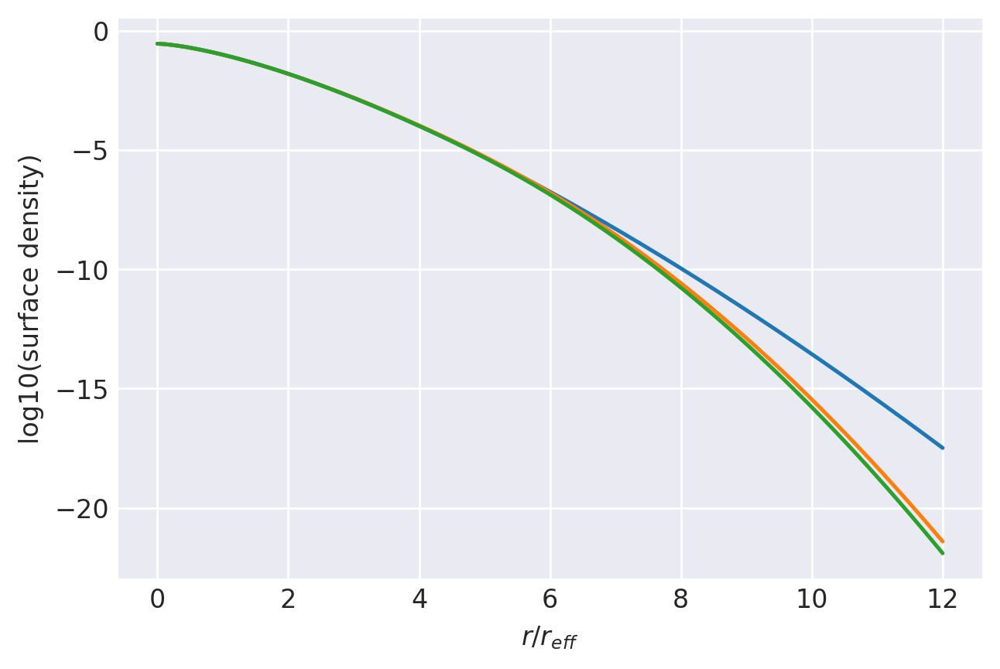

n=0.69: (
    normalize(np.array([1.3370275577e-01, 4.4333808357e-01, 3.0162427747e-01, 9.4924949088e-02, 2.1603363948e-02, 4.1194724570e-03, 6.2736993586e-04, 5.9727764463e-05])),
    np.array([1.4706442737e+00, 1.1645040148e+00, 8.7345015979e-01, 6.1438878319e-01, 4.0606497740e-01, 2.5050182785e-01, 1.3987649033e-01, 6.3973681257e-02]),
),
1.0000000183969289 1.0000000184681144
prev.  chisq = -8.818557554738762
ws, re: (array([1.33702756e-01, 4.43338084e-01, 3.01624277e-01, 9.49249491e-02,
       2.16033639e-02, 4.11947246e-03, 6.27369936e-04, 5.97277645e-05]), array([1.47064427, 1.16450401, 0.87345016, 0.61438878, 0.40606498,
       0.25050183, 0.13987649, 0.06397368]))
         Current function value: -12.985932
         Iterations: 73
         Function evaluations: 2323
         Gradient evaluations: 136
-12.985932451499313 [-1.77633165  0.10467945  0.93160332  1.27728086  1.50009819  1.79543918
  2.35581736  0.16207712  0.06111537 -0.06335686 -0.2150466  -0.39346138
 -0.60240778 -

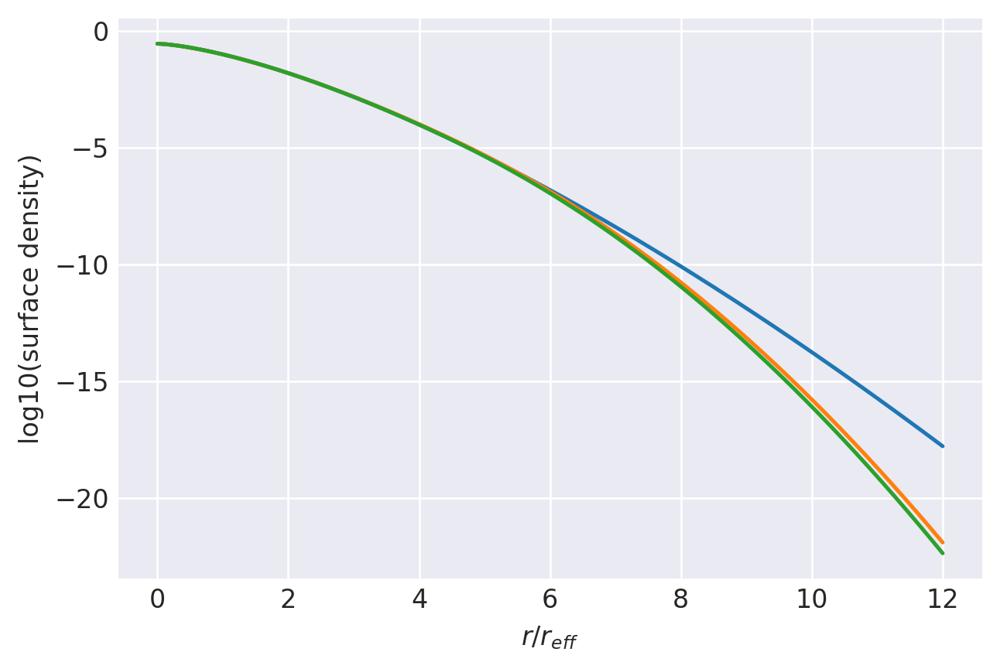

n=0.685: (
    normalize(np.array([1.4475669191e-01, 4.4998283778e-01, 2.9073404439e-01, 8.9558126281e-02, 2.0413810149e-02, 3.9058975922e-03, 5.9242093508e-04, 5.6170968999e-05])),
    np.array([1.4523694996e+00, 1.1511061295e+00, 8.6425746374e-01, 6.0947149707e-01, 4.0414630986e-01, 2.4979987587e-01, 1.3955541299e-01, 6.3889998948e-02]),
),
1.0000000182697837 1.000000018344037
prev.  chisq = -8.812297788280258
ws, re: (array([1.44756692e-01, 4.49982838e-01, 2.90734044e-01, 8.95581263e-02,
       2.04138101e-02, 3.90589759e-03, 5.92420935e-04, 5.61709690e-05]), array([1.4523695 , 1.15110613, 0.86425746, 0.6094715 , 0.40414631,
       0.24979988, 0.13955541, 0.06389   ]))
         Current function value: -13.028391
         Iterations: 76
         Function evaluations: 2408
         Gradient evaluations: 141
-13.028390752531925 [-1.7240286   0.14773927  0.96135522  1.29431818  1.50998891  1.80207147
  2.36264995  0.15783907  0.0576803  -0.06655713 -0.21836214 -0.39695935
 -0.60597132 -

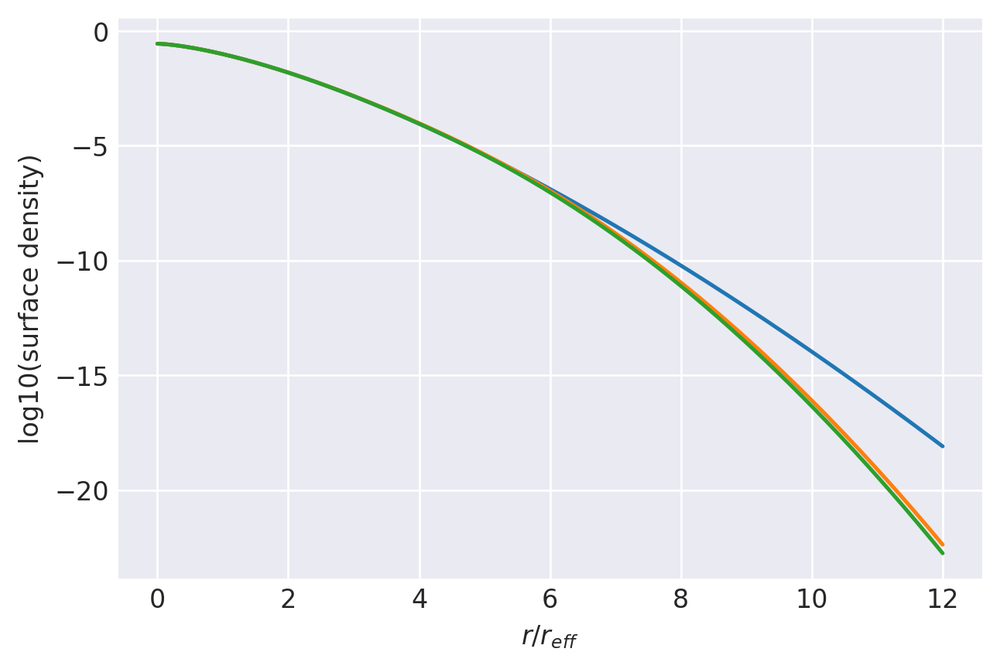

n=0.6799999999999999: (
    normalize(np.array([1.5135298180e-01, 4.5561124322e-01, 2.8431935229e-01, 8.5329040228e-02, 1.9155659270e-02, 3.6325150210e-03, 5.4763699943e-04, 5.1571165466e-05])),
    np.array([1.4382655084e+00, 1.1420373387e+00, 8.5791225496e-01, 6.0483631462e-01, 4.0090423760e-01, 2.4775856520e-01, 1.3843647123e-01, 6.3410095798e-02]),
),
1.000000018143855 1.000000018221145
prev.  chisq = -8.805933772178921
ws, re: (array([1.51352982e-01, 4.55611243e-01, 2.84319352e-01, 8.53290402e-02,
       1.91556593e-02, 3.63251502e-03, 5.47636999e-04, 5.15711655e-05]), array([1.43826551, 1.14203734, 0.85791225, 0.60483631, 0.40090424,
       0.24775857, 0.13843647, 0.0634101 ]))
         Current function value: -13.070890
         Iterations: 83
         Function evaluations: 3548
         Gradient evaluations: 208
-13.07089014112325 [-1.67200274  0.19699351  1.00559505  1.3278011   1.52961503  1.81070347
  2.36660837  0.15364736  0.05415821 -0.07045487 -0.22368394 -0.4038765
 -0.

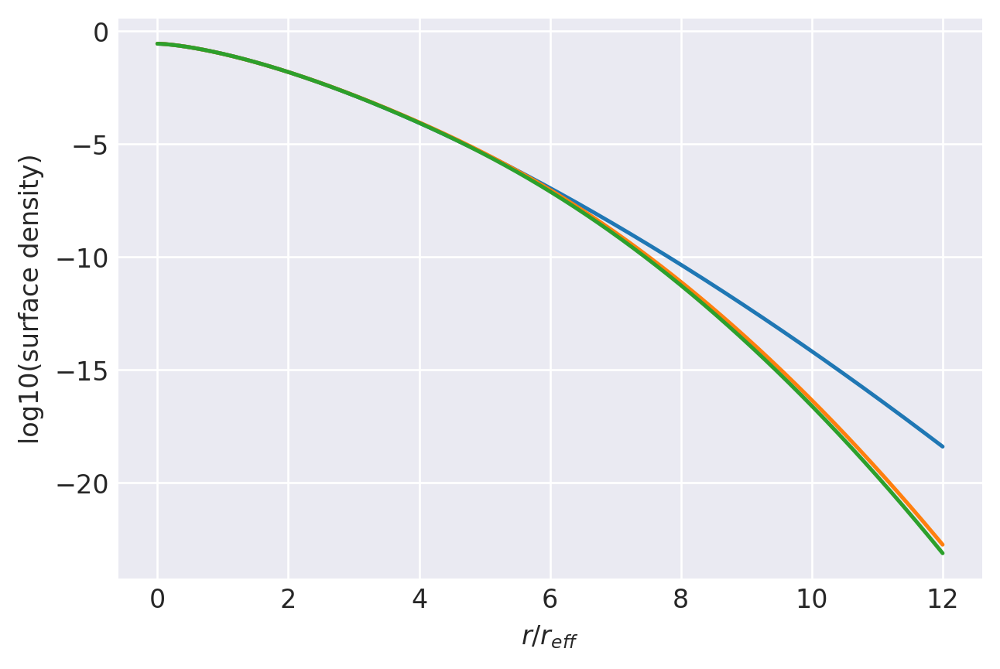

n=0.675: (
    normalize(np.array([1.5815734405e-01, 4.6224715644e-01, 2.7792358163e-01, 8.0369279922e-02, 1.7509702882e-02, 3.2598261942e-03, 4.8739230734e-04, 4.5716577938e-05])),
    np.array([1.4244504780e+00, 1.1328129503e+00, 8.5024704865e-01, 5.9746993907e-01, 3.9456949250e-01, 2.4334081839e-01, 1.3595208520e-01, 6.2371587062e-02]),
),
1.0000000180191344 1.0000000180996294
prev.  chisq = -8.799550400557374
ws, re: (array([1.58157344e-01, 4.62247156e-01, 2.77923582e-01, 8.03692799e-02,
       1.75097029e-02, 3.25982619e-03, 4.87392307e-04, 4.57165779e-05]), array([1.42445048, 1.13281295, 0.85024705, 0.59746994, 0.39456949,
       0.24334082, 0.13595209, 0.06237159]))
         Current function value: -13.138898
         Iterations: 73
         Function evaluations: 2324
         Gradient evaluations: 136
-13.138898283468947 [-1.68305592  0.1915424   0.99549805  1.31064164  1.51655838  1.80802754
  2.36952699  0.15109525  0.05385313 -0.06831945 -0.21865542 -0.39585826
 -0.60358767 

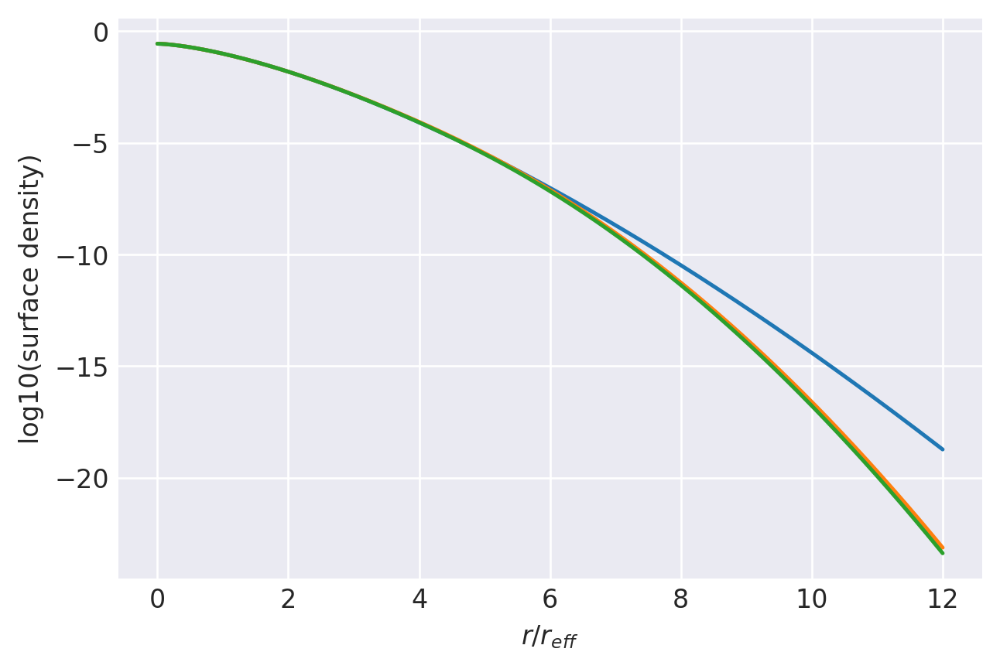

n=0.6699999999999999: (
    normalize(np.array([1.5669123798e-01, 4.6191371491e-01, 2.7848418315e-01, 8.1054706650e-02, 1.7922729259e-02, 3.3792997502e-03, 5.0673585309e-04, 4.7392447440e-05])),
    np.array([1.4161043348e+00, 1.1320174713e+00, 8.5443799944e-01, 6.0442800413e-01, 4.0192196089e-01, 2.4912214160e-01, 1.3955315128e-01, 6.4113201571e-02]),
),
1.000000017895612 1.0000000179764772
prev.  chisq = -8.79312328824948
ws, re: (array([1.56691238e-01, 4.61913715e-01, 2.78484183e-01, 8.10547067e-02,
       1.79227293e-02, 3.37929975e-03, 5.06735853e-04, 4.73924474e-05]), array([1.41610433, 1.13201747, 0.854438  , 0.604428  , 0.40192196,
       0.24912214, 0.13955315, 0.0641132 ]))
         Current function value: -13.194896
         Iterations: 64
         Function evaluations: 2205
         Gradient evaluations: 129
-13.194896460247325 [-1.65604261  0.21880749  1.01792387  1.32638457  1.53200923  1.81969191
  2.37949596  0.14753402  0.05166527 -0.06967981 -0.21972478 -0.39711585
 -

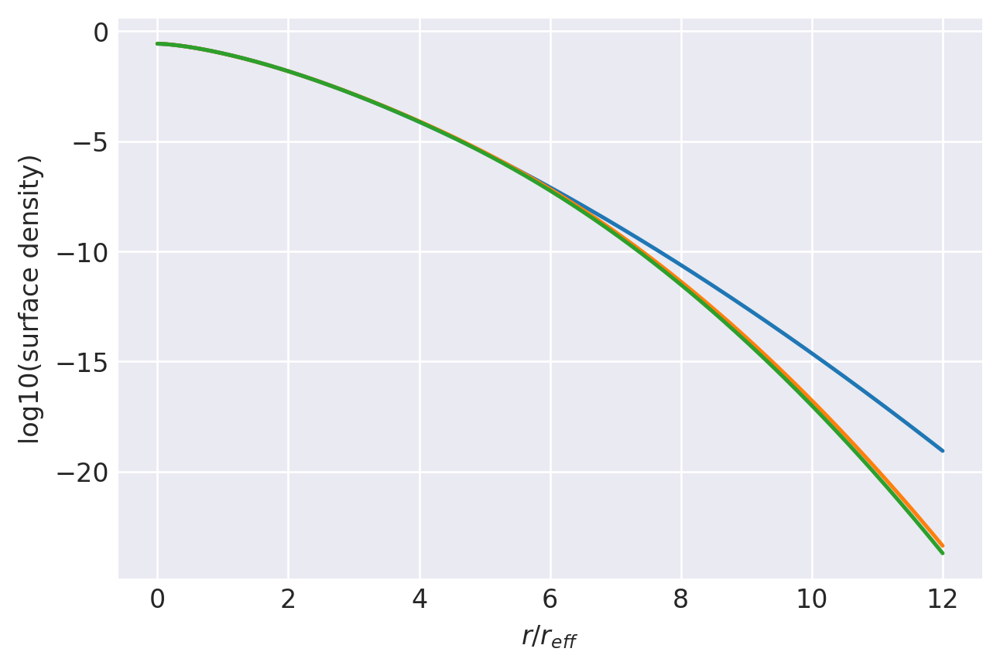

n=0.665: (
    normalize(np.array([1.6029394514e-01, 4.6560413158e-01, 2.7480330078e-01, 7.8469939247e-02, 1.7127428265e-02, 3.1850378132e-03, 4.7246793586e-04, 4.3749225933e-05])),
    np.array([1.4045397100e+00, 1.1263290047e+00, 8.5176579080e-01, 6.0294156609e-01, 4.0075980161e-01, 2.4806856288e-01, 1.3888896103e-01, 6.3778967964e-02]),
),
1.0000000177732802 1.0000000178563915
prev.  chisq = -8.786577595208845
ws, re: (array([1.60293945e-01, 4.65604132e-01, 2.74803301e-01, 7.84699392e-02,
       1.71274283e-02, 3.18503781e-03, 4.72467936e-04, 4.37492259e-05]), array([1.40453971, 1.126329  , 0.85176579, 0.60294157, 0.4007598 ,
       0.24806856, 0.13888896, 0.06377897]))
         Current function value: -13.206225
         Iterations: 89
         Function evaluations: 2766
         Gradient evaluations: 162
-13.20622459115982 [-1.5508858   0.30695544  1.07955717  1.35601181  1.53598182  1.81541249
  2.3779018   0.1420052   0.0458011  -0.07722513 -0.22942512 -0.40791523
 -0.61580383 -

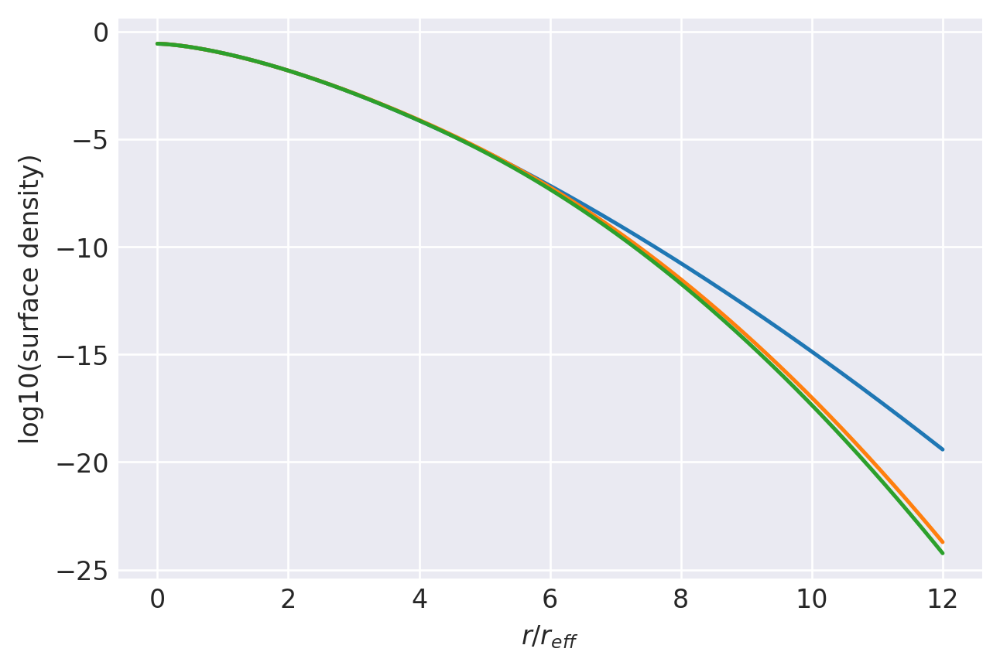

n=0.6599999999999999: (
    normalize(np.array([1.7495836805e-01, 4.7534109054e-01, 2.6102004180e-01, 7.0510818366e-02, 1.4951464412e-02, 2.7677139481e-03, 4.1226717645e-04, 3.8235707351e-05])),
    np.array([1.3867724247e+00, 1.1112226979e+00, 8.3709524056e-01, 5.8962362730e-01, 3.9091719053e-01, 2.4221228746e-01, 1.3588840170e-01, 6.2558069060e-02]),
),
1.000000017652129 1.0000000177381159
prev.  chisq = -8.779955891631069
ws, re: (array([1.74958368e-01, 4.75341091e-01, 2.61020042e-01, 7.05108184e-02,
       1.49514644e-02, 2.76771395e-03, 4.12267176e-04, 3.82357074e-05]), array([1.38677242, 1.1112227 , 0.83709524, 0.58962363, 0.39091719,
       0.24221229, 0.1358884 , 0.06255807]))
         Current function value: -13.192276
         Iterations: 65
         Function evaluations: 2664
         Gradient evaluations: 156
-13.192275549358776 [-1.46523388  0.37457205  1.11235144  1.35524201  1.52612598  1.81210289
  2.37904966  0.13698863  0.04101667 -0.08241367 -0.23435877 -0.41143298
 

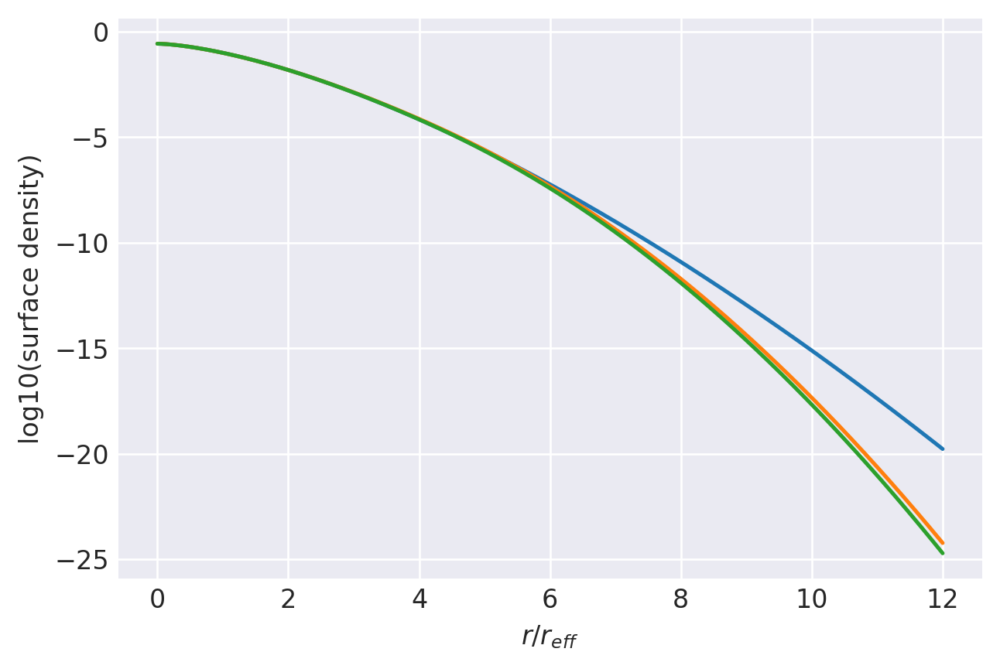

n=0.655: (
    normalize(np.array([1.8766812192e-01, 4.8135804450e-01, 2.4908006190e-01, 6.5104345546e-02, 1.3791485910e-02, 2.5770768931e-03, 3.8518073847e-04, 3.5682594341e-05])),
    np.array([1.3708458689e+00, 1.0990480345e+00, 8.2715391196e-01, 5.8296331500e-01, 3.8776358262e-01, 2.4108486299e-01, 1.3554294495e-01, 6.2495947057e-02]),
),
1.0000000175321508 1.0000000176197903
prev.  chisq = -8.773501785470717
ws, re: (array([1.87668122e-01, 4.81358044e-01, 2.49080062e-01, 6.51043455e-02,
       1.37914859e-02, 2.57707689e-03, 3.85180738e-04, 3.56825943e-05]), array([1.37084587, 1.09904803, 0.82715391, 0.58296331, 0.38776358,
       0.24108486, 0.13554294, 0.06249595]))
         Current function value: -13.272247
         Iterations: 81
         Function evaluations: 3072
         Gradient evaluations: 180
-13.272247126782096 [-1.45624527  0.38719533  1.12524614  1.37724392  1.57349117  1.86166418
  2.40406768  0.13390675  0.03988754 -0.08194931 -0.23318908 -0.41174118
 -0.62228299 

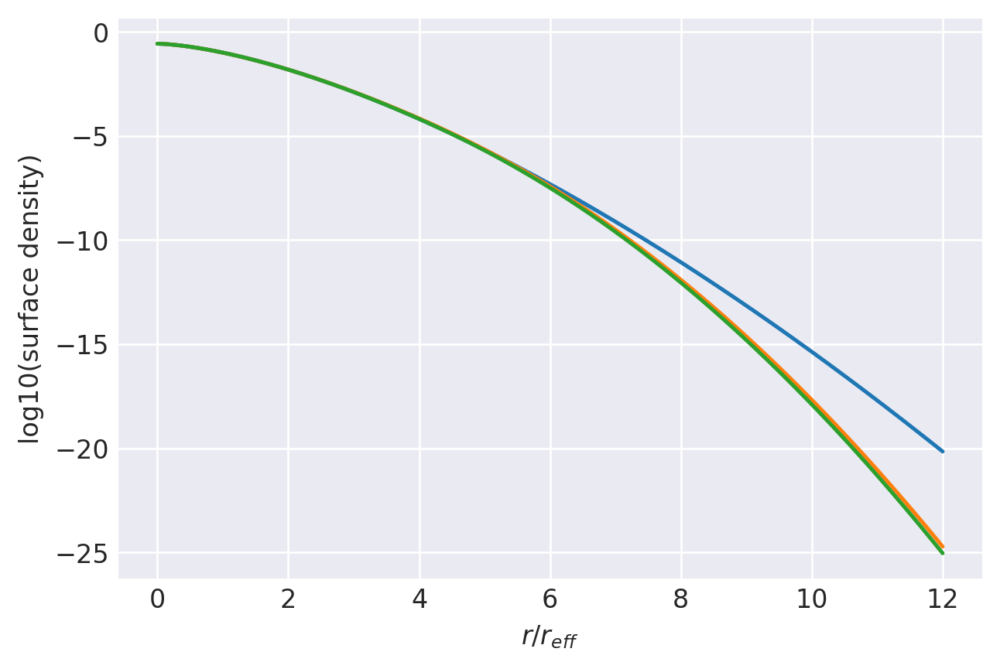

n=0.6499999999999999: (
    normalize(np.array([1.8904227379e-01, 4.8301238206e-01, 2.4758578905e-01, 6.4170961711e-02, 1.3408699996e-02, 2.4059721654e-03, 3.4293697420e-04, 3.0984249648e-05])),
    np.array([1.3611523811e+00, 1.0961942930e+00, 8.2803881014e-01, 5.8453553420e-01, 3.8748850016e-01, 2.3862558896e-01, 1.3304789179e-01, 6.1208927233e-02]),
),
1.000000017413337 1.0000000175034225
prev.  chisq = -8.766783674362541
ws, re: (array([1.89042274e-01, 4.83012382e-01, 2.47585789e-01, 6.41709617e-02,
       1.34087000e-02, 2.40597217e-03, 3.42936974e-04, 3.09842496e-05]), array([1.36115238, 1.09619429, 0.82803881, 0.58453553, 0.3874885 ,
       0.23862559, 0.13304789, 0.06120893]))
         Current function value: -13.441168
         Iterations: 51
         Function evaluations: 2511
         Gradient evaluations: 147
-13.441167719356537 [-1.54627025  0.33905279  1.13275655  1.41302751  1.57585777  1.84011668
  2.3918811   0.13317953  0.04299054 -0.07561718 -0.22649431 -0.40575153
 

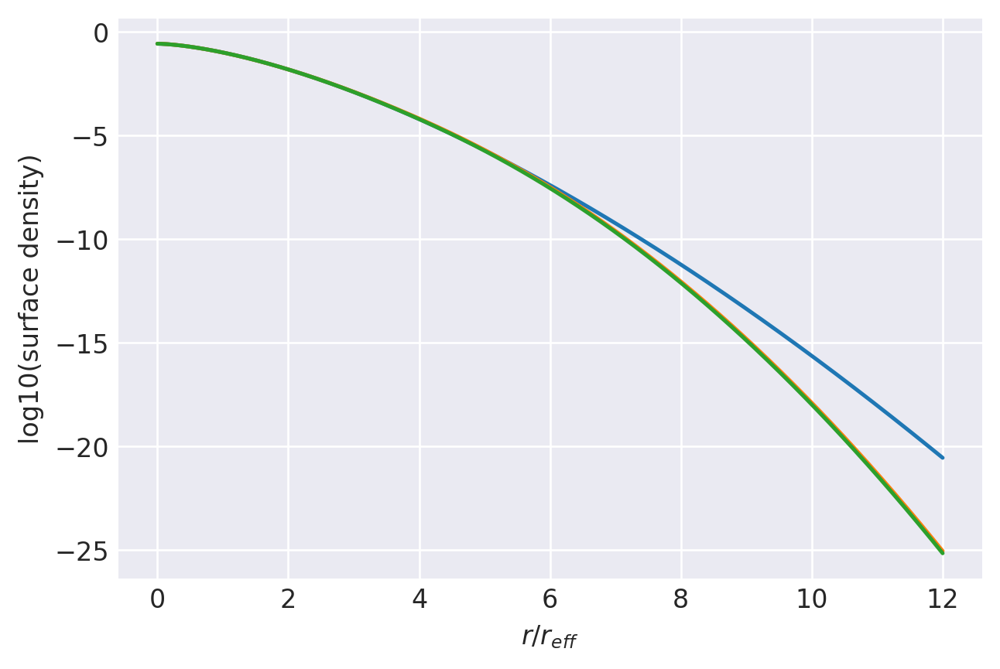

n=0.645: (
    normalize(np.array([1.7562561222e-01, 4.8140200997e-01, 2.5940621535e-01, 6.7207503046e-02, 1.3555064535e-02, 2.4193972614e-03, 3.5200419818e-04, 3.2193417439e-05])),
    np.array([1.3588750576e+00, 1.1040545756e+00, 8.4020028233e-01, 5.9361612695e-01, 3.9286963910e-01, 2.4317688974e-01, 1.3659170400e-01, 6.3163704103e-02]),
),
1.0000000172956791 1.0000000173850943
prev.  chisq = -8.760028650991488
ws, re: (array([1.75625612e-01, 4.81402010e-01, 2.59406215e-01, 6.72075030e-02,
       1.35550645e-02, 2.41939726e-03, 3.52004198e-04, 3.21934174e-05]), array([1.35887506, 1.10405458, 0.84020028, 0.59361613, 0.39286964,
       0.24317689, 0.1365917 , 0.0631637 ]))
         Current function value: -13.414210
         Iterations: 76
         Function evaluations: 2290
         Gradient evaluations: 134
-13.414209881883473 [-1.49202604  0.34359524  1.06806062  1.31905577  1.50954755  1.79082684
  2.36253147  0.12877274  0.04064275 -0.07365805 -0.21615462 -0.38581566
 -0.58666552 

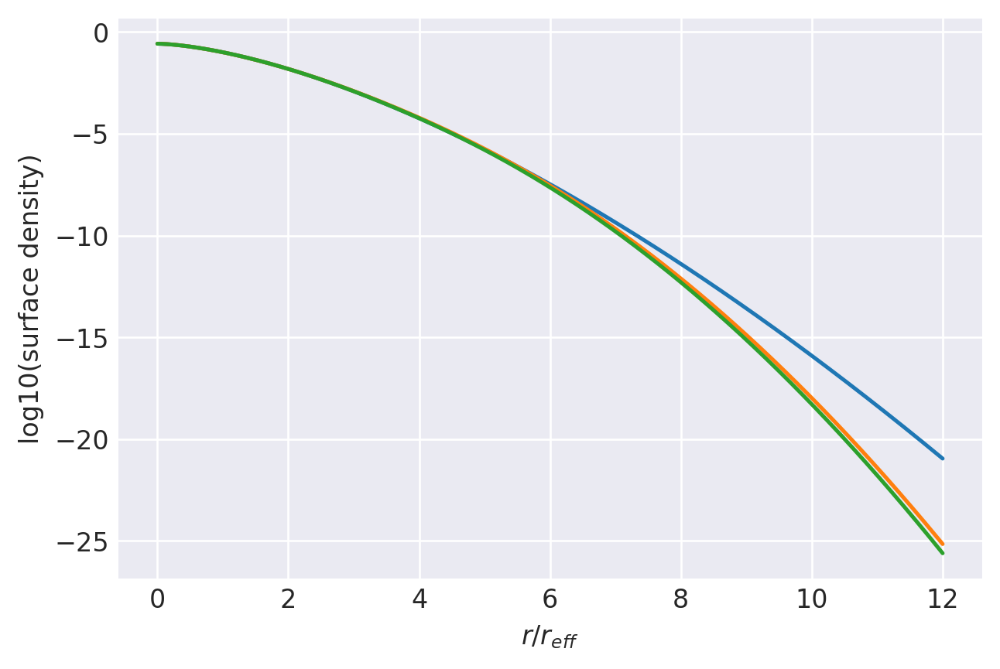

n=0.64: (
    normalize(np.array([1.8361782533e-01, 4.7763548067e-01, 2.5210474898e-01, 6.8362623268e-02, 1.4970657458e-02, 2.8356199883e-03, 4.3232708650e-04, 4.0717214946e-05])),
    np.array([1.3451562707e+00, 1.0981021589e+00, 8.4399903395e-01, 6.0791852711e-01, 4.1132427036e-01, 2.5902070436e-01, 1.4762918606e-01, 6.8897509695e-02]),
),
1.0000000171791692 1.0000000172657588
prev.  chisq = -8.753338663966725
ws, re: (array([1.83617825e-01, 4.77635481e-01, 2.52104749e-01, 6.83626233e-02,
       1.49706575e-02, 2.83561999e-03, 4.32327087e-04, 4.07172149e-05]), array([1.34515627, 1.09810216, 0.84399903, 0.60791853, 0.41132427,
       0.2590207 , 0.14762919, 0.06889751]))
         Current function value: -13.473942
         Iterations: 79
         Function evaluations: 3871
         Gradient evaluations: 227
-13.473941815011523 [-1.38593448  0.45442138  1.16196202  1.36742135  1.52861973  1.81887792
  2.39537123  0.12346971  0.03469069 -0.08287565 -0.22989493 -0.40244522
 -0.60524549 -

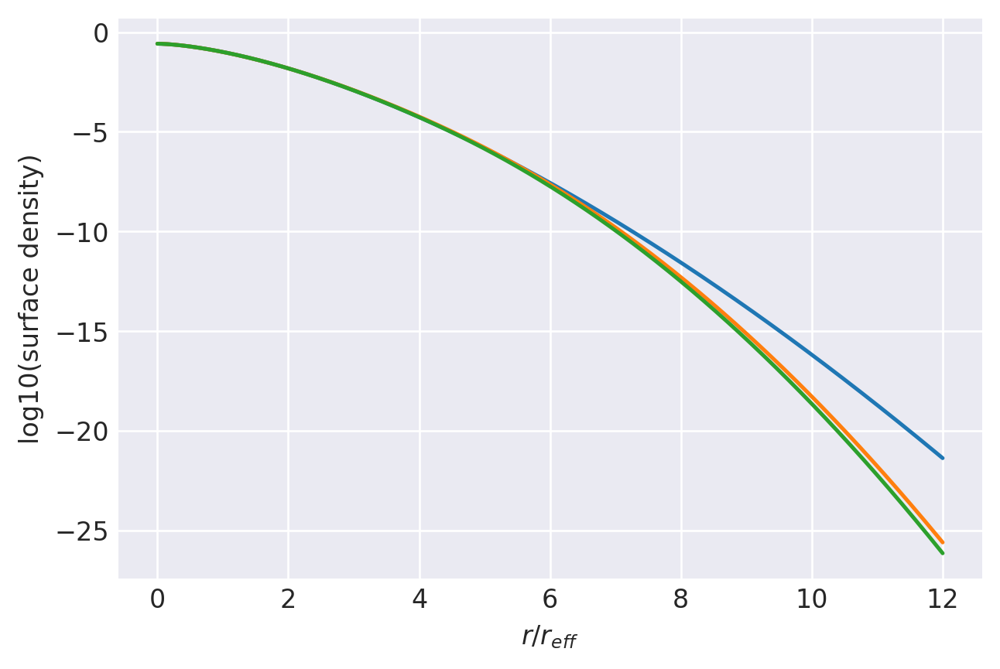

n=0.635: (
    normalize(np.array([2.0005758689e-01, 4.8931672805e-01, 2.3660018029e-01, 5.8995604244e-02, 1.2351636499e-02, 2.3044625462e-03, 3.4257920264e-04, 3.1222270929e-05])),
    np.array([1.3288308689e+00, 1.0831551962e+00, 8.2627450627e-01, 5.8898613059e-01, 3.9587199430e-01, 2.4817298783e-01, 1.4047300986e-01, 6.5180692745e-02]),
),
1.0000000170637993 1.0000000171542633
prev.  chisq = -8.746542212093937
ws, re: (array([2.00057587e-01, 4.89316728e-01, 2.36600180e-01, 5.89956042e-02,
       1.23516365e-02, 2.30446255e-03, 3.42579203e-04, 3.12222709e-05]), array([1.32883087, 1.0831552 , 0.82627451, 0.58898613, 0.39587199,
       0.24817299, 0.14047301, 0.06518069]))
         Current function value: -13.504208
         Iterations: 62
         Function evaluations: 2936
         Gradient evaluations: 172
-13.504208221644305 [-1.32824675  0.50213724  1.19243749  1.38997276  1.5669685   1.87732701
  2.42054971  0.11917983  0.0315275  -0.08563815 -0.23289762 -0.40684435
 -0.61342385 

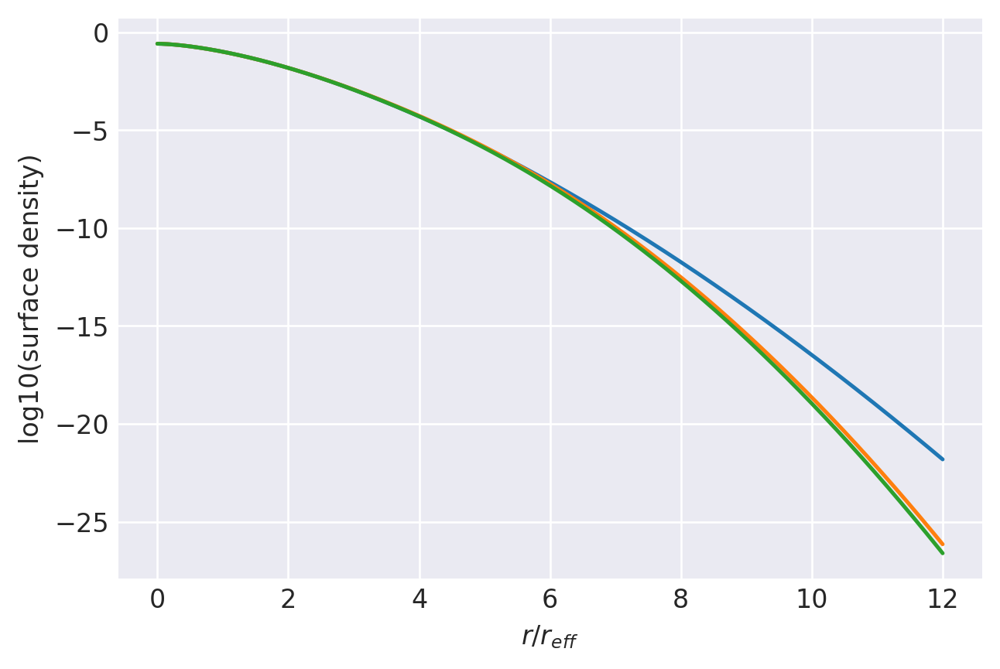

n=0.63: (
    normalize(np.array([2.0944952182e-01, 4.9248247874e-01, 2.2867083136e-01, 5.5558532653e-02, 1.1449409063e-02, 2.0721851062e-03, 2.9116465766e-04, 2.5876603852e-05])),
    np.array([1.3157695420e+00, 1.0752946874e+00, 8.2103533120e-01, 5.8492796113e-01, 3.9188230429e-01, 2.4354327968e-01, 1.3627403340e-01, 6.2798080276e-02]),
),
1.0000000169495604 1.0000000170434744
prev.  chisq = -8.739678723372382
ws, re: (array([2.09449522e-01, 4.92482479e-01, 2.28670831e-01, 5.55585327e-02,
       1.14494091e-02, 2.07218511e-03, 2.91164658e-04, 2.58766039e-05]), array([1.31576954, 1.07529469, 0.82103533, 0.58492796, 0.3918823 ,
       0.24354328, 0.13627403, 0.06279808]))
         Current function value: -13.304630
         Iterations: 57
         Function evaluations: 1762
         Gradient evaluations: 103
-13.30462987705841 [-1.22294888  0.55040281  1.1047411   1.20401858  1.47639167  1.85578365
  2.43628629  0.11377631  0.02688389 -0.08701316 -0.22184191 -0.38008667
 -0.57868637 -0

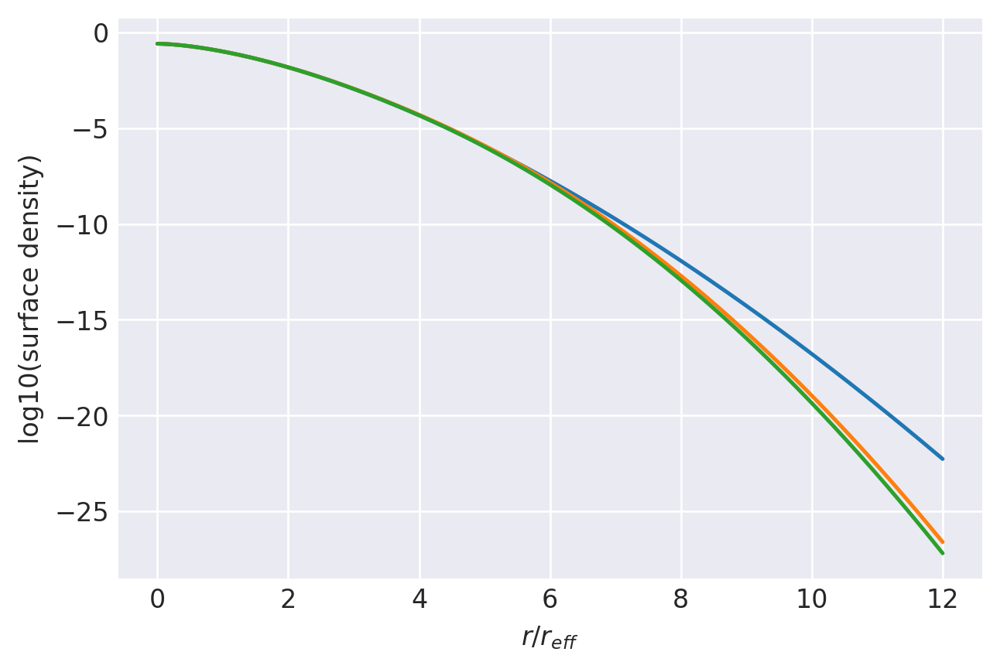

n=0.625: (
    normalize(np.array([2.2741791941e-01, 4.8999399115e-01, 2.1226530573e-01, 5.4095020415e-02, 1.3209836568e-02, 2.6099173419e-03, 3.7518616918e-04, 3.2823215881e-05])),
    np.array([1.2995000814e+00, 1.0638585462e+00, 8.1843999086e-01, 6.0000944516e-01, 4.1678619575e-01, 2.6382359156e-01, 1.4864247125e-01, 6.8737843402e-02]),
),
1.0000000168364453 1.00000001692756
prev.  chisq = -8.732481693835187
ws, re: (array([2.27417919e-01, 4.89993991e-01, 2.12265306e-01, 5.40950204e-02,
       1.32098366e-02, 2.60991734e-03, 3.75186169e-04, 3.28232159e-05]), array([1.29950008, 1.06385855, 0.81843999, 0.60000945, 0.4167862 ,
       0.26382359, 0.14864247, 0.06873784]))
         Current function value: -13.371058
         Iterations: 57
         Function evaluations: 2698
         Gradient evaluations: 158
-13.371058362458598 [-1.24120452  0.51376654  1.02770804  1.19765644  1.52592627  1.87904948
  2.43216036  0.11112834  0.02766038 -0.08044325 -0.20834566 -0.36639035
 -0.56697646 -0

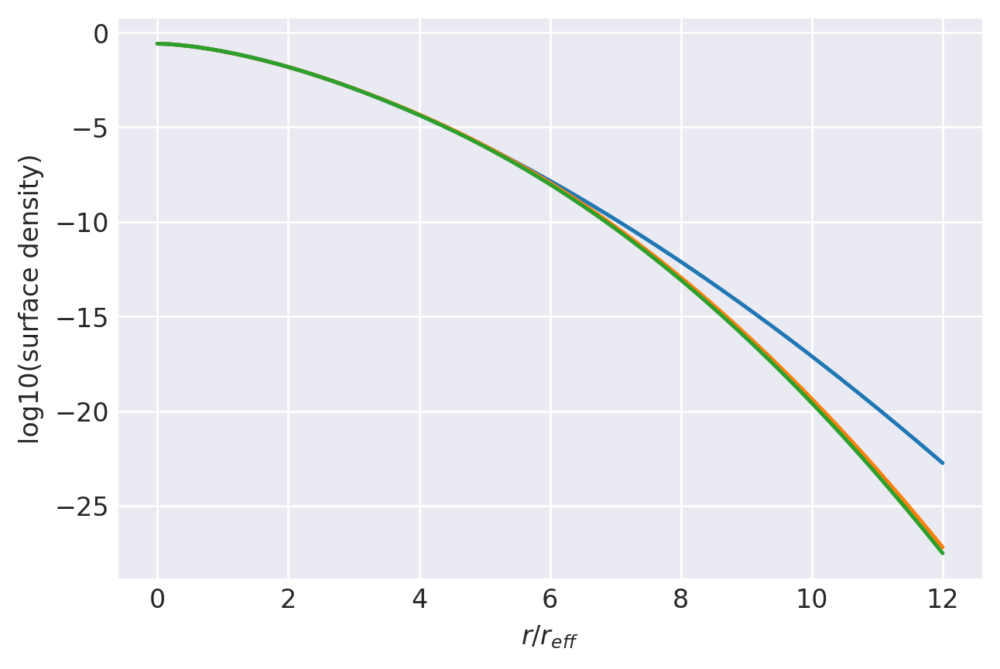

n=0.62: (
    normalize(np.array([2.2422639120e-01, 4.8539303256e-01, 2.1385696357e-01, 5.8778369625e-02, 1.4576111163e-02, 2.7492279588e-03, 3.8599544195e-04, 3.3908482469e-05])),
    np.array([1.2916009028e+00, 1.0657623621e+00, 8.3091529303e-01, 6.1894825069e-01, 4.3013981845e-01, 2.7103385323e-01, 1.5263101984e-01, 7.1099389623e-02]),
),
1.0000000167244474 1.0000000168147465
prev.  chisq = -8.725847573354057
ws, re: (array([2.24226391e-01, 4.85393033e-01, 2.13856964e-01, 5.87783696e-02,
       1.45761112e-02, 2.74922796e-03, 3.85995442e-04, 3.39084825e-05]), array([1.2916009 , 1.06576236, 0.83091529, 0.61894825, 0.43013982,
       0.27103385, 0.15263102, 0.07109939]))
         Current function value: -13.352050
         Iterations: 67
         Function evaluations: 2885
         Gradient evaluations: 169
-13.352050171310534 [-1.20221771  0.49714876  0.95641589  1.24158736  1.57699473  1.87579343
  2.42478782  0.10715225  0.02631868 -0.07618365 -0.19949713 -0.36036005
 -0.56253729 -

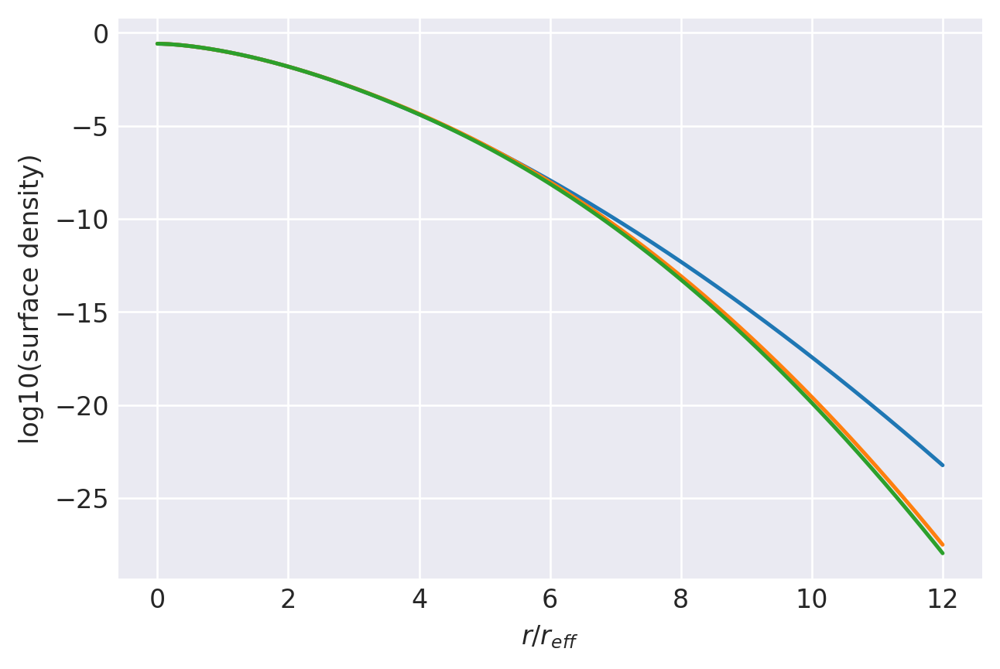

n=0.615: (
    normalize(np.array([2.3108093338e-01, 4.7810545177e-01, 2.1008481168e-01, 6.2632650496e-02, 1.4997701850e-02, 2.6867509909e-03, 3.7822783638e-04, 3.3471988915e-05])),
    np.array([1.2798298794e+00, 1.0624749020e+00, 8.3910507419e-01, 6.3168835071e-01, 4.3615409083e-01, 2.7381844881e-01, 1.5505013054e-01, 7.2322125174e-02]),
),
1.0000000166135572 1.0000000167041792
prev.  chisq = -8.718600036659035
ws, re: (array([2.31080933e-01, 4.78105452e-01, 2.10084812e-01, 6.26326505e-02,
       1.49977019e-02, 2.68675099e-03, 3.78227836e-04, 3.34719889e-05]), array([1.27982988, 1.0624749 , 0.83910507, 0.63168835, 0.43615409,
       0.27381845, 0.15505013, 0.07232213]))
         Current function value: -13.323834
         Iterations: 65
         Function evaluations: 3106
         Gradient evaluations: 182
-13.32383416346454 [-1.11980227  0.55026678  0.88409934  1.15352843  1.56766214  1.89580424
  2.41776162  0.10241459  0.02246999 -0.07756041 -0.19233005 -0.34670447
 -0.54742993 -

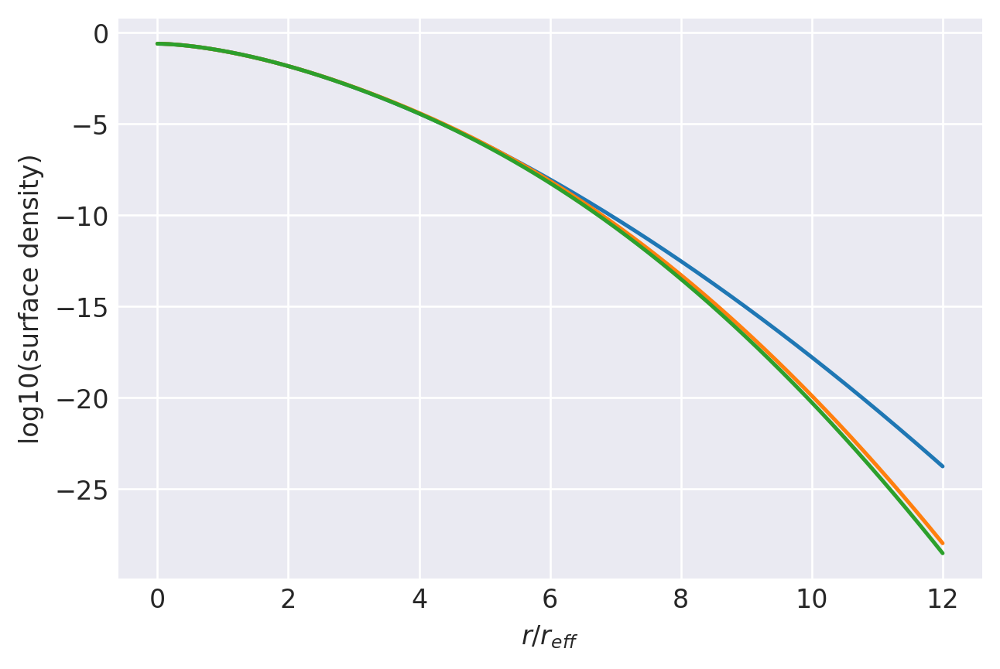

n=0.61: (
    normalize(np.array([2.4604796254e-01, 4.7815448567e-01, 1.9517392496e-01, 6.1286437591e-02, 1.6000558642e-02, 2.9009197390e-03, 4.0005739938e-04, 3.5653467776e-05])),
    np.array([1.2659442814e+00, 1.0531009082e+00, 8.3644923299e-01, 6.4219947336e-01, 4.5008602954e-01, 2.8351110386e-01, 1.6059943274e-01, 7.5235853648e-02]),
),
1.0000000165037684 1.0000000165940384
prev.  chisq = -8.711412399367008
ws, re: (array([2.46047963e-01, 4.78154486e-01, 1.95173925e-01, 6.12864376e-02,
       1.60005586e-02, 2.90091974e-03, 4.00057399e-04, 3.56534678e-05]), array([1.26594428, 1.05310091, 0.83644923, 0.64219947, 0.45008603,
       0.2835111 , 0.16059943, 0.07523585]))
         Current function value: -13.358758
         Iterations: 83
         Function evaluations: 2561
         Gradient evaluations: 150
-13.358757627821321 [-1.0314021   0.69230512  0.92916229  0.92742444  1.52906288  1.89153739
  2.42358249  0.09778716  0.01714694 -0.0878054  -0.19494748 -0.33655272
 -0.53386895 -

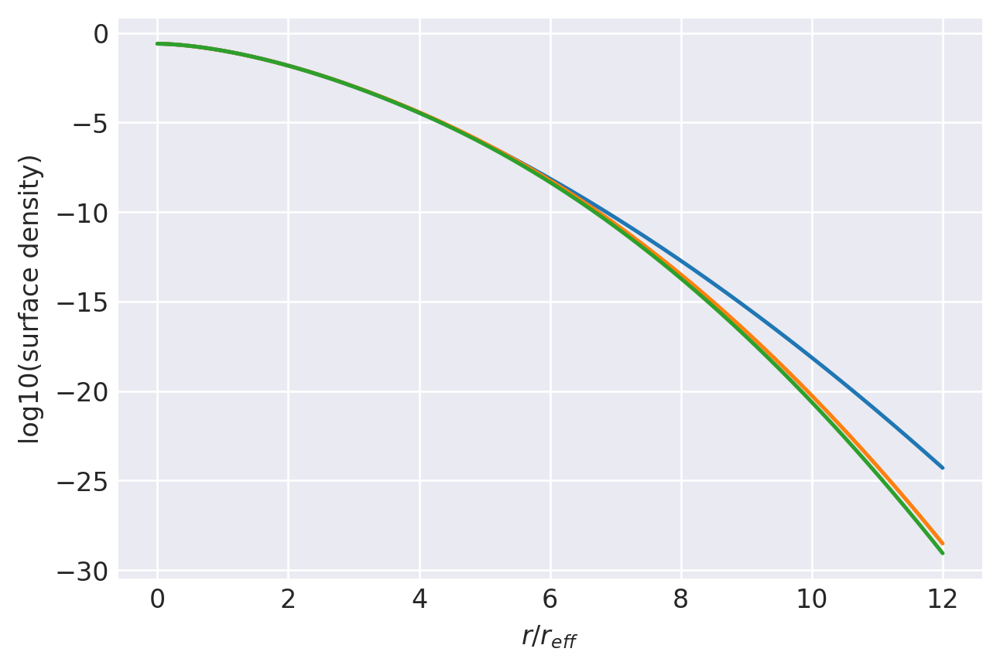

n=0.605: (
    normalize(np.array([2.6281236766e-01, 4.9132045688e-01, 1.7626348173e-01, 4.9874698510e-02, 1.6214652743e-02, 3.0537201464e-03, 4.2313135345e-04, 3.7490972470e-05])),
    np.array([1.2525271923e+00, 1.0402720620e+00, 8.1694834458e-01, 6.3834068326e-01, 4.6073083728e-01, 2.9250348756e-01, 1.6634022849e-01, 7.8052916563e-02]),
),
1.000000016395073 1.0000000164848153
prev.  chisq = -8.704602440324418
ws, re: (array([2.62812368e-01, 4.91320457e-01, 1.76263482e-01, 4.98746985e-02,
       1.62146527e-02, 3.05372015e-03, 4.23131353e-04, 3.74909725e-05]), array([1.25252719, 1.04027206, 0.81694834, 0.63834068, 0.46073084,
       0.29250349, 0.16634023, 0.07805292]))
         Current function value: -13.314514
         Iterations: 68
         Function evaluations: 2119
         Gradient evaluations: 124
-13.3145143851152 [-0.92503462  0.76017994  0.80060602  0.96055294  1.60326537  1.93526038
  2.46775205  0.09265747  0.01251231 -0.08953194 -0.1878924  -0.33373598
 -0.53527382 -0.

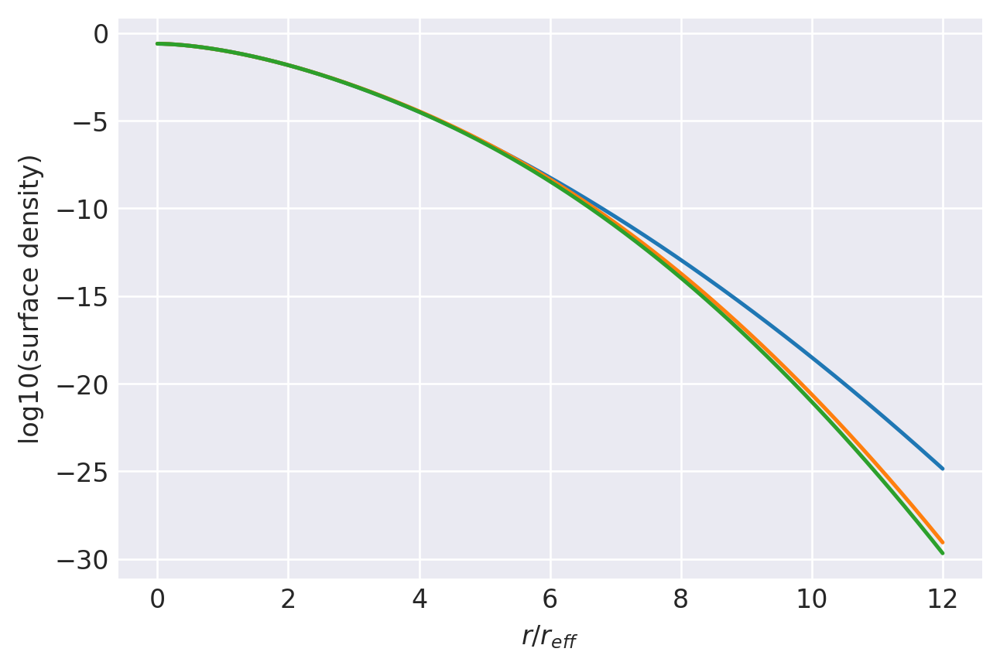

n=0.6: (
    normalize(np.array([2.8393316813e-01, 4.8792278362e-01, 1.5744314284e-01, 5.1133192474e-02, 1.6289617552e-02, 2.8644997963e-03, 3.8127307631e-04, 3.2322507218e-05])),
    np.array([1.2378199346e+00, 1.0292297064e+00, 8.1370700944e-01, 6.4879515676e-01, 4.6372874806e-01, 2.9155881505e-01, 1.6443448874e-01, 7.6673924623e-02]),
),
1.0000000162874645 1.0000000163788119
prev.  chisq = -8.697123221503201
ws, re: (array([2.83933168e-01, 4.87922784e-01, 1.57443143e-01, 5.11331925e-02,
       1.62896176e-02, 2.86449980e-03, 3.81273076e-04, 3.23225072e-05]), array([1.23781993, 1.02922971, 0.81370701, 0.64879516, 0.46372875,
       0.29155882, 0.16443449, 0.07667392]))
         Current function value: -13.279310
         Iterations: 56
         Function evaluations: 2035
         Gradient evaluations: 119
-13.279310318269882 [-0.83781758  0.79849093  0.78792338  1.03874823  1.58974305  1.90596662
  2.45784193  0.08789311  0.0091142  -0.09023505 -0.18952842 -0.337234
 -0.5359148  -0.7

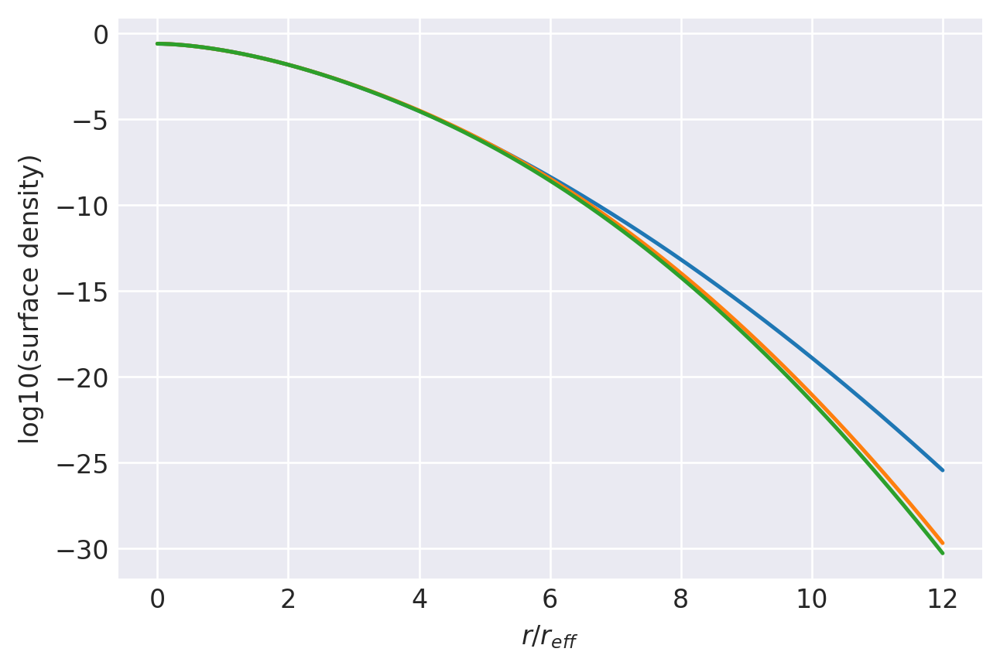

n=0.595: (
    normalize(np.array([3.0199462531e-01, 4.8138051293e-01, 1.4890473808e-01, 5.0018652463e-02, 1.4702487053e-02, 2.6108116737e-03, 3.5755850769e-04, 3.0613989431e-05])),
    np.array([1.2243148198e+00, 1.0212079714e+00, 8.1239070462e-01, 6.4635569363e-01, 4.6000865059e-01, 2.9112882266e-01, 1.6538067515e-01, 7.6923900568e-02]),
),
1.000000016180935 1.0000000162736853
prev.  chisq = -8.689676908919658
ws, re: (array([3.01994625e-01, 4.81380513e-01, 1.48904738e-01, 5.00186525e-02,
       1.47024871e-02, 2.61081167e-03, 3.57558508e-04, 3.06139894e-05]), array([1.22431482, 1.02120797, 0.8123907 , 0.64635569, 0.46000865,
       0.29112882, 0.16538068, 0.0769239 ]))
         Current function value: -13.265697
         Iterations: 117
         Function evaluations: 3514
         Gradient evaluations: 206
-13.265697393029333 [-7.13989563e-01  9.98047688e-01  9.40995384e-01  9.10786920e-01
  1.65909217e+00  1.93502999e+00 -2.46801650e+00  8.27872401e-02
  2.31010166e-03 -1.07230471e

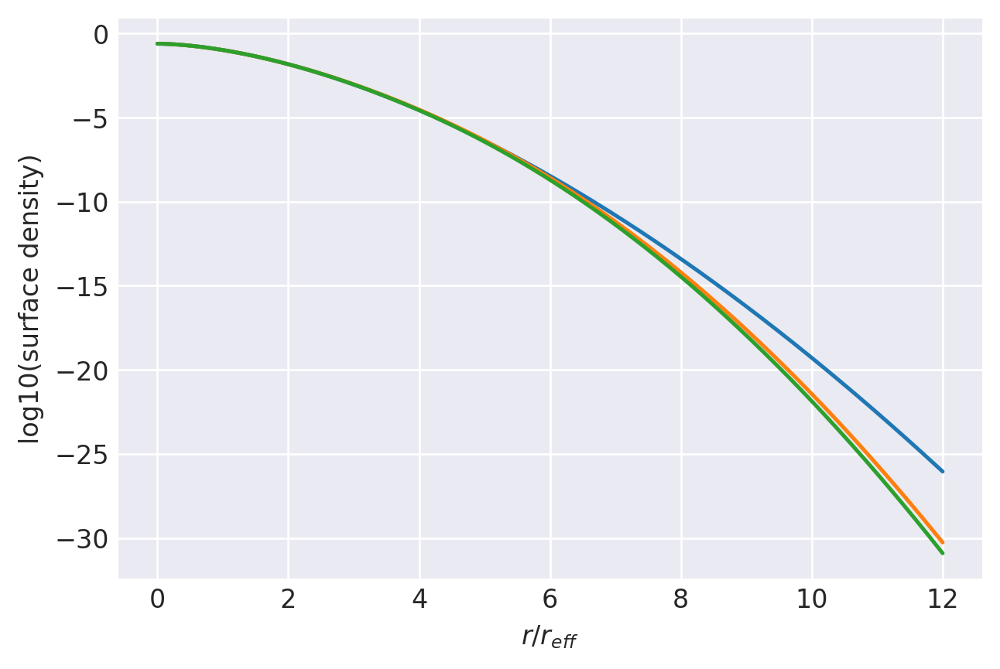

n=0.59: (
    normalize(np.array([3.2871789270e-01, 4.9048875688e-01, 1.3004477925e-01, 3.6191910085e-02, 1.2229285345e-02, 2.0336728328e-03, 2.7075560802e-04, 2.2947295738e-05])),
    np.array([1.2100052095e+00, 1.0053333777e+00, 7.8121312037e-01, 6.2301326025e-01, 4.4449148841e-01, 2.7753546360e-01, 1.5710520808e-01, 7.3640656307e-02]),
),
1.0000000160754776 1.0000000161683118
prev.  chisq = -8.682502584276785
ws, re: (array([3.28717893e-01, 4.90488757e-01, 1.30044779e-01, 3.61919101e-02,
       1.22292853e-02, 2.03367283e-03, 2.29472957e-05, 2.70755608e-04]), array([1.21000521, 1.00533338, 0.78121312, 0.62301326, 0.44449149,
       0.27753546, 0.07364066, 0.15710521]))
         Current function value: -13.380827
         Iterations: 54
         Function evaluations: 3157
         Gradient evaluations: 185
-13.38082709846608 [-6.62689044e-01  1.05761094e+00  1.10570914e+00  8.51725252e-01
  1.59867039e+00  1.94331032e+00 -2.47912936e+00  7.88629329e-02
  1.73886685e-04 -1.11482855e-0

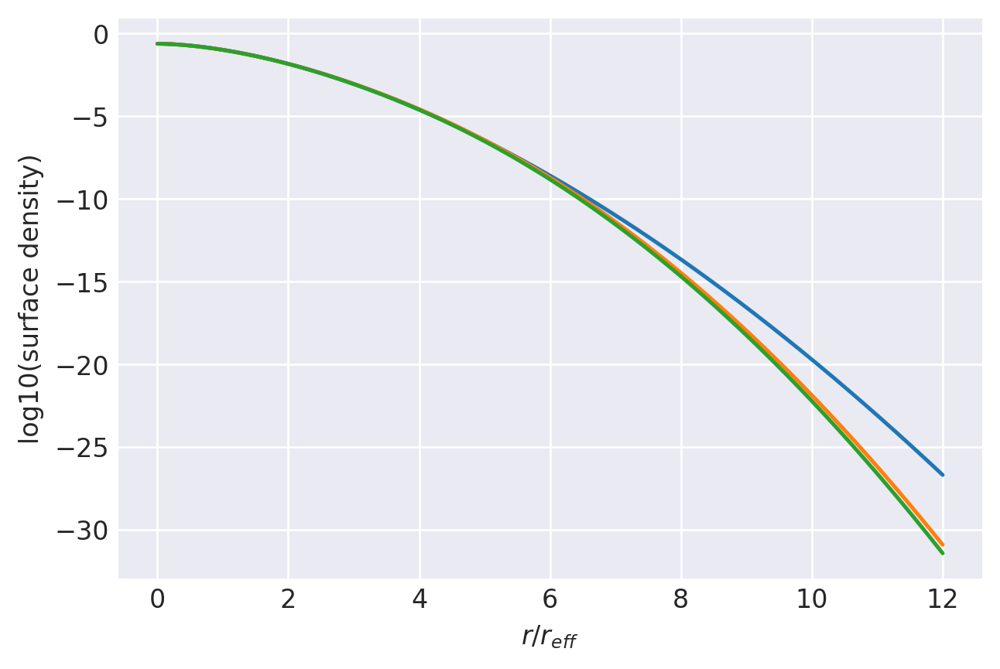

n=0.585: (
    normalize(np.array([3.4013581408e-01, 4.8977345468e-01, 1.2779397935e-01, 2.9647016961e-02, 1.0522460269e-02, 1.8607598317e-03, 2.4590408702e-04, 2.0610738068e-05])),
    np.array([1.1991207906e+00, 1.0004004691e+00, 7.7360121855e-01, 6.0678805355e-01, 4.4003326059e-01, 2.7696320140e-01, 1.5664925173e-01, 7.3249625392e-02]),
),
1.0000000159710858 1.000000016064489
prev.  chisq = -8.67506844518343
ws, re: (array([3.40135814e-01, 4.89773455e-01, 1.27793979e-01, 2.96470170e-02,
       1.05224603e-02, 1.86075983e-03, 2.06107381e-05, 2.45904087e-04]), array([1.19912079, 1.00040047, 0.77360122, 0.60678805, 0.44003326,
       0.2769632 , 0.07324963, 0.15664925]))
         Current function value: -13.621082
         Iterations: 45
         Function evaluations: 2324
         Gradient evaluations: 136
-13.62108186093218 [-6.90808963e-01  1.01052471e+00  1.11536035e+00  1.10903383e+00
  1.61180106e+00  1.92703886e+00 -2.48075667e+00  7.62441793e-02
  2.06533991e-03 -1.03061747e-01

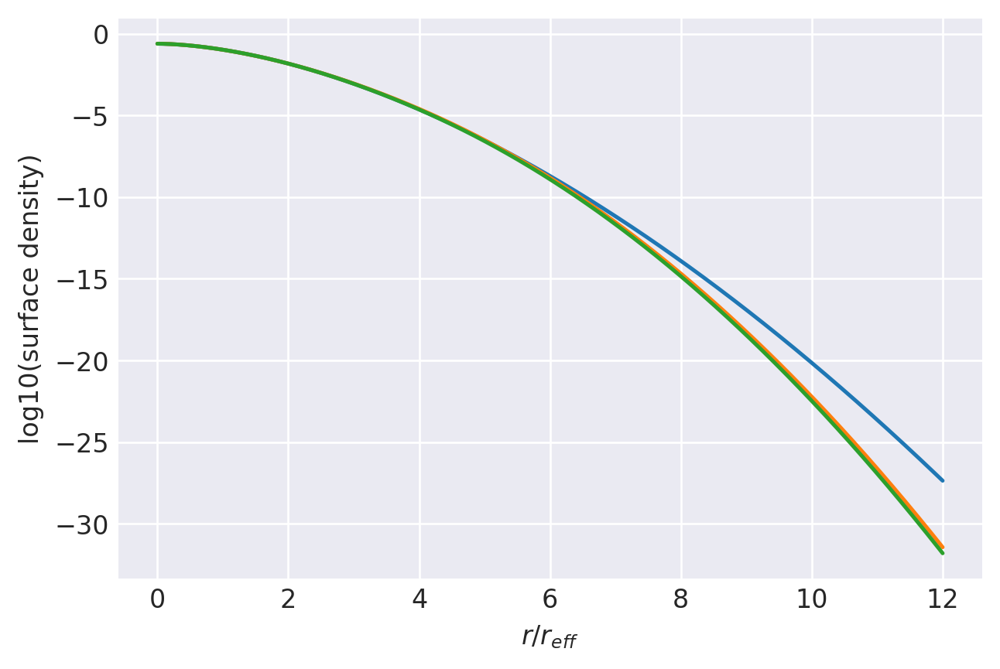

n=0.5800000000000001: (
    normalize(np.array([3.3385313948e-01, 4.8836746715e-01, 1.3389047802e-01, 3.3002223537e-02, 9.0758135360e-03, 1.5807542299e-03, 2.1235426889e-04, 1.7769780516e-05])),
    np.array([1.1919119646e+00, 1.0047669468e+00, 7.8874796642e-01, 6.0897784130e-01, 4.3155184414e-01, 2.7206498486e-01, 1.5441399214e-01, 7.2117212556e-02]),
),
1.0000000158677531 1.0000000159620337
prev.  chisq = -8.667457684368344
ws, re: (array([3.33853139e-01, 4.88367467e-01, 1.33890478e-01, 3.30022235e-02,
       9.07581354e-03, 1.58075423e-03, 1.77697805e-05, 2.12354269e-04]), array([1.19191196, 1.00476695, 0.78874797, 0.60897784, 0.43155184,
       0.27206498, 0.07211721, 0.15441399]))
         Current function value: -14.052486
         Iterations: 50
         Function evaluations: 2545
         Gradient evaluations: 149
-14.052486012920138 [-0.72622503  1.0238385   1.38738793  1.34450529  1.5075549   1.80853839
 -2.40460414  0.0736629   0.00341299 -0.10327993 -0.23696635 -0.39421093


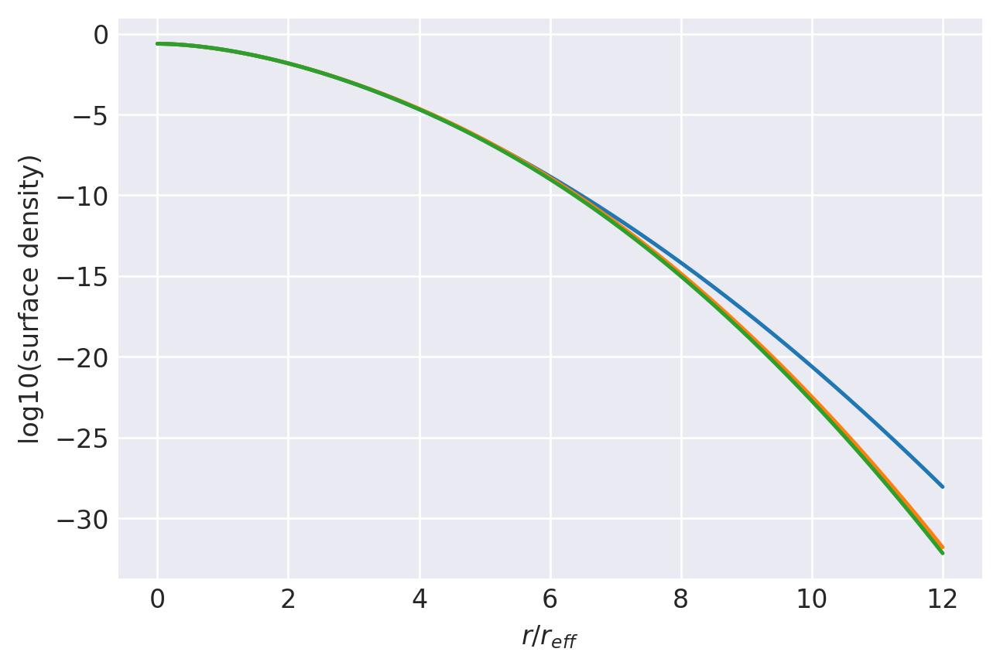

n=0.575: (
    normalize(np.array([3.2602366368e-01, 4.9585761227e-01, 1.4252613452e-01, 2.8233104752e-02, 6.0251995917e-03, 1.1463979887e-03, 1.7232594512e-04, 1.5561245690e-05])),
    np.array([1.1848487123e+00, 1.0078896616e+00, 7.8835181902e-01, 5.7947359997e-01, 4.0344939331e-01, 2.6013780070e-01, 1.5121460789e-01, 7.2423723616e-02]),
),
1.0000000157654718 1.0000000158589775
prev.  chisq = -8.660150788062593
ws, re: (array([3.26023664e-01, 4.95857612e-01, 1.42526135e-01, 2.82331048e-02,
       6.02519959e-03, 1.14639799e-03, 1.55612457e-05, 1.72325945e-04]), array([1.18484871, 1.00788966, 0.78835182, 0.5794736 , 0.40344939,
       0.2601378 , 0.07242372, 0.15121461]))
         Current function value: -14.515077
         Iterations: 65
         Function evaluations: 2970
         Gradient evaluations: 174
-14.51507698073922 [-0.80687868  1.03181265  1.54927014  1.5658597   1.66868568  2.00608283
 -2.64654889  0.07170971  0.00580594 -0.10046139 -0.24631284 -0.42017281
 -0.62689132 -

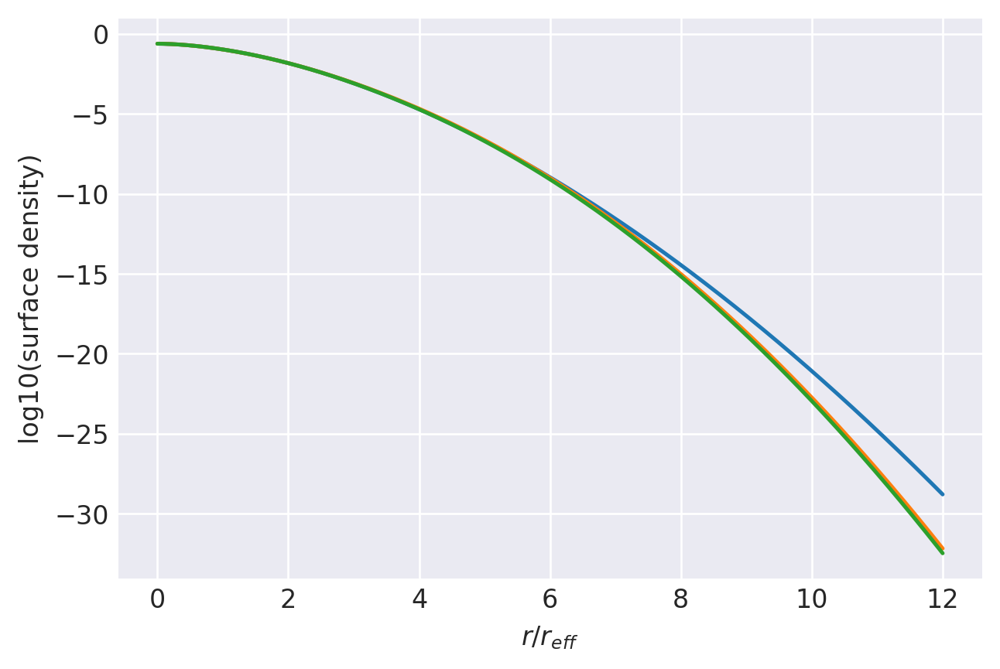

n=0.5700000000000001: (
    normalize(np.array([3.0855602769e-01, 5.0977893694e-01, 1.4983882748e-01, 2.6326402831e-02, 4.6275387777e-03, 7.6884538229e-04, 9.6574225018e-05, 6.8466740416e-06])),
    np.array([1.1795319553e+00, 1.0134584355e+00, 7.9348478801e-01, 5.6713593082e-01, 3.8003814616e-01, 2.3610690140e-01, 1.3063611458e-01, 5.9726480610e-02]),
),
1.0000000156642361 1.0000000157597004
prev.  chisq = -8.652616495568621
ws, re: (array([3.08556028e-01, 5.09778937e-01, 1.49838827e-01, 2.63264028e-02,
       4.62753878e-03, 7.68845382e-04, 6.84667404e-06, 9.65742250e-05]), array([1.17953196, 1.01345844, 0.79348479, 0.56713593, 0.38003815,
       0.2361069 , 0.05972648, 0.13063611]))
         Current function value: -13.914995
         Iterations: 90
         Function evaluations: 3786
         Gradient evaluations: 222
-13.914995435331909 [-7.08924687e-01  1.14798008e+00  1.69559110e+00  1.77772522e+00
  1.26889866e+00  4.41576423e-02 -2.37820925e+00  6.69223050e-02
  2.06927106e-03

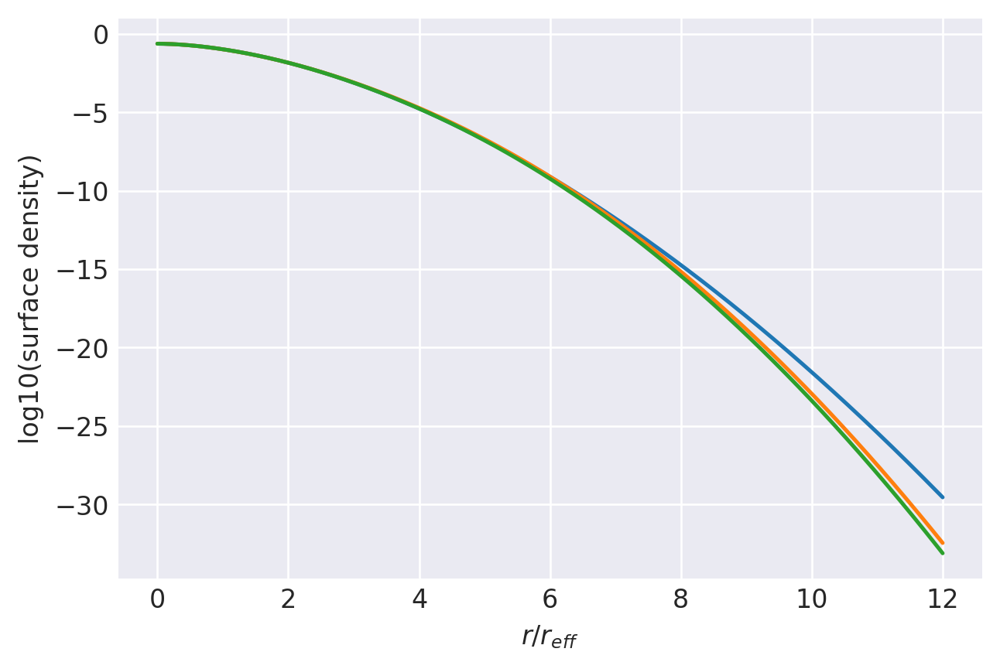

n=0.565: (
    normalize(np.array([3.2983648855e-01, 5.0874911883e-01, 1.3638838720e-01, 2.1407639185e-02, 3.5531033708e-04, 2.8243308132e-03, 4.0578197212e-04, 3.2943117025e-05])),
    np.array([1.1666008941e+00, 1.0047760418e+00, 7.8049162863e-01, 5.4205819960e-01, 3.6014812541e-01, 3.4288927925e-01, 1.9728679278e-01, 9.3252446339e-02]),
),
1.0000000155640396 1.0000000156536681
prev.  chisq = -8.644948894993185
ws, re: (array([3.29836489e-01, 5.08749119e-01, 1.36388387e-01, 2.14076392e-02,
       2.82433081e-03, 4.05781972e-04, 3.29431170e-05, 3.55310337e-04]), array([1.16660089, 1.00477604, 0.78049163, 0.5420582 , 0.34288928,
       0.19728679, 0.09325245, 0.36014813]))
         Current function value: -13.997654
         Iterations: 128
         Function evaluations: 3871
         Gradient evaluations: 227
-13.997653728033303 [-0.41982671  1.37865184  1.77611357  1.79943311 -3.34945534  2.23873814
 -2.52492168  0.05951307 -0.00816775 -0.12591887 -0.29080416 -0.65221898
 -0.49082896

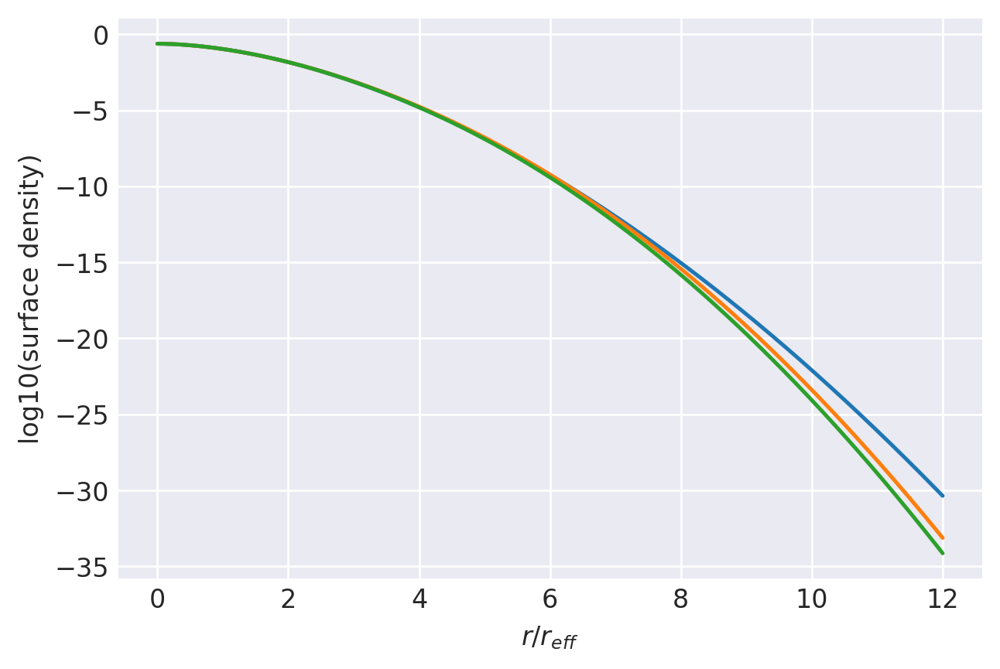

n=0.56: (
    normalize(np.array([3.9655821838e-01, 4.8201384245e-01, 1.0384715374e-01, 1.5085718848e-02, 2.1782638592e-03, 8.4615203855e-05, 2.1497558451e-04, 1.7211930637e-05])),
    np.array([1.1468670458e+00, 9.8136880184e-01, 7.4830927350e-01, 5.1191262993e-01, 3.2297658600e-01, 2.2273117852e-01, 1.7424212510e-01, 7.9693945263e-02]),
),
1.0000000154648756 1.0000000155580189
prev.  chisq = -8.637113099620908
ws, re: (array([3.96558218e-01, 4.82013842e-01, 1.03847154e-01, 1.50857188e-02,
       8.46152039e-05, 2.17826386e-03, 1.72119306e-05, 2.14975585e-04]), array([1.14686705, 0.9813688 , 0.74830927, 0.51191263, 0.22273118,
       0.32297659, 0.07969395, 0.17424213]))
         Current function value: -14.142693
         Iterations: 110
         Function evaluations: 2936
         Gradient evaluations: 172
-14.142693483327474 [-0.35582849  1.43401478  1.77771988  1.15096453 -5.37917868 -0.28730214
 -2.184343    0.05535719 -0.00965928 -0.12553393 -0.2814281  -1.07328793
 -0.50462074 

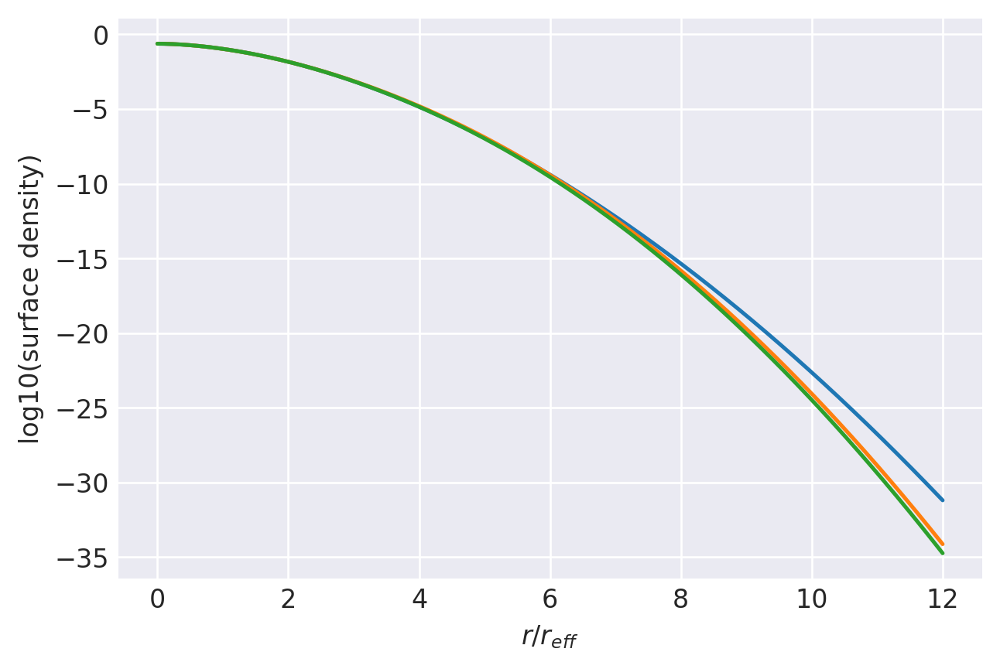

n=0.5549999999999999: (
    normalize(np.array([4.1196974546e-01, 4.7484977471e-01, 9.6816290168e-02, 1.2431662955e-02, 2.0102243670e-03, 1.6779962389e-03, 2.2625408069e-04, 1.8052022619e-05])),
    np.array([1.1359446966e+00, 9.7800420829e-01, 7.4897283425e-01, 5.2308456314e-01, 4.4528922686e-01, 3.1288105225e-01, 1.8058600005e-01, 8.4471863141e-02]),
),
1.000000015366738 1.000000015458417
prev.  chisq = -8.62940280686461
ws, re: (array([4.11969745e-01, 4.74849775e-01, 9.68162902e-02, 1.24316630e-02,
       1.80520226e-05, 1.67799624e-03, 2.26254081e-04, 2.01022437e-03]), array([1.1359447 , 0.97800421, 0.74897283, 0.52308456, 0.08447186,
       0.31288105, 0.180586  , 0.44528923]))
         Current function value: -14.078702
         Iterations: 61
         Function evaluations: 2035
         Gradient evaluations: 119
-14.078702313254603 [-0.35893284  1.37451379  1.6687159   0.73051983 -5.41876431 -0.35522989
 -2.33997386  0.05190344 -0.00783394 -0.11326747 -0.26421209 -1.0030933
 -0.

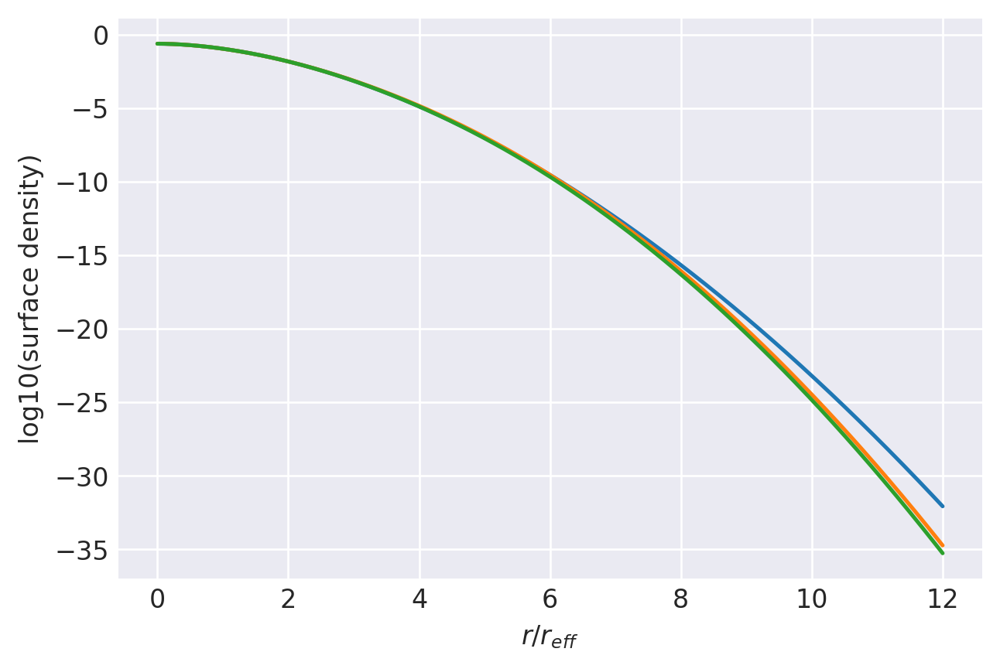

n=0.55: (
    normalize(np.array([4.1121792013e-01, 4.6991195001e-01, 1.0001786726e-01, 3.2717868717e-03, 1.2723756532e-02, 2.5145020013e-03, 3.1517174128e-04, 2.7045460025e-05])),
    np.array([1.1269468595e+00, 9.8212341020e-01, 7.7042883854e-01, 5.5694720876e-01, 5.4423680890e-01, 3.5276591319e-01, 2.0293403978e-01, 9.9290272210e-02]),
),
1.000000015269622 1.0000000153586706
prev.  chisq = -8.62153343691116
ws, re: (array([4.11217920e-01, 4.69911950e-01, 1.00017867e-01, 1.27237565e-02,
       2.70454600e-05, 2.51450200e-03, 3.15171741e-04, 3.27178687e-03]), array([1.12694686, 0.98212341, 0.77042884, 0.54423681, 0.09929027,
       0.35276591, 0.20293404, 0.55694721]))
         Current function value: -13.860551
         Iterations: 63
         Function evaluations: 2953
         Gradient evaluations: 173
-13.860550579647835 [-0.32265689  1.32720711  1.35379651  0.50597274 -5.38955722 -0.37787112
 -2.30515879  0.04794369 -0.00741618 -0.09973907 -0.22281662 -0.93942385
 -0.39544761 -0.

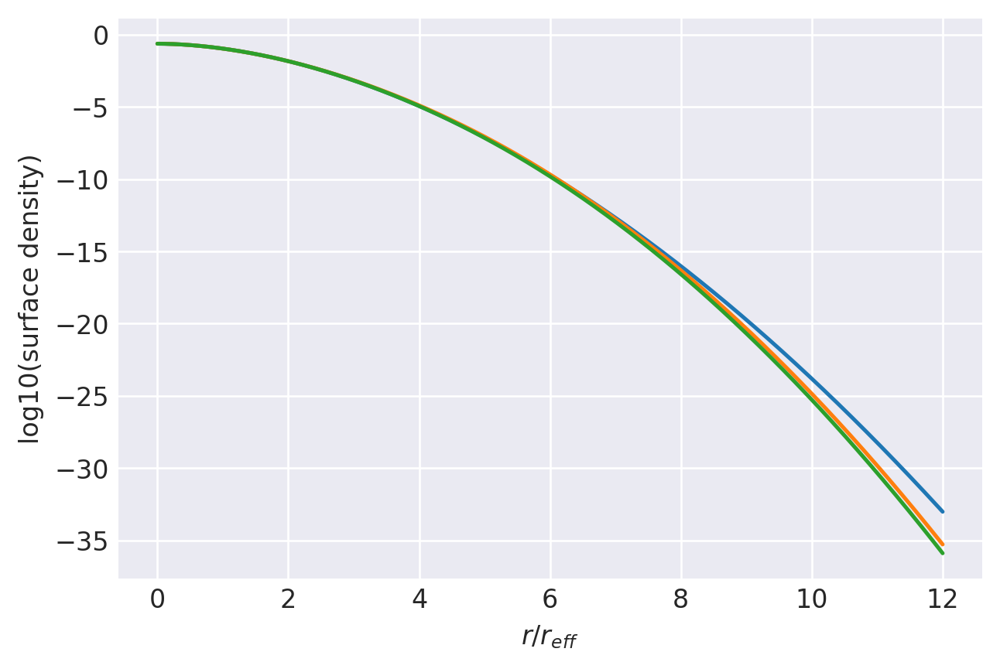

n=0.5449999999999999: (
    normalize(np.array([4.2002838114e-01, 4.5839697243e-01, 9.6621403879e-02, 5.0410780842e-03, 1.5567377745e-02, 3.7993322579e-03, 5.0281205634e-04, 4.2642408650e-05])),
    np.array([1.1167184521e+00, 9.8306858569e-01, 7.9480562565e-01, 6.0818352078e-01, 5.9866433030e-01, 4.0230218210e-01, 2.3683070211e-01, 1.1496778060e-01]),
),
1.00000001517352 1.0000000152610604
prev.  chisq = -8.613482122460692
ws, re: (array([4.20028381e-01, 4.58396972e-01, 9.66214039e-02, 1.55673777e-02,
       4.26424086e-05, 3.79933226e-03, 5.02812056e-04, 5.04107808e-03]), array([1.11671845, 0.98306859, 0.79480563, 0.59866433, 0.11496778,
       0.40230218, 0.2368307 , 0.60818352]))
         Current function value: -13.459005
         Iterations: 59
         Function evaluations: 2682
         Gradient evaluations: 157
-13.45900477207084 [-3.87100494e-01  1.25520087e+00  1.56487722e+00 -9.64120700e-02
 -4.93592513e+00 -5.63401187e-01 -1.90697643e+00  4.47285145e-02
 -3.73360853e-03 -9

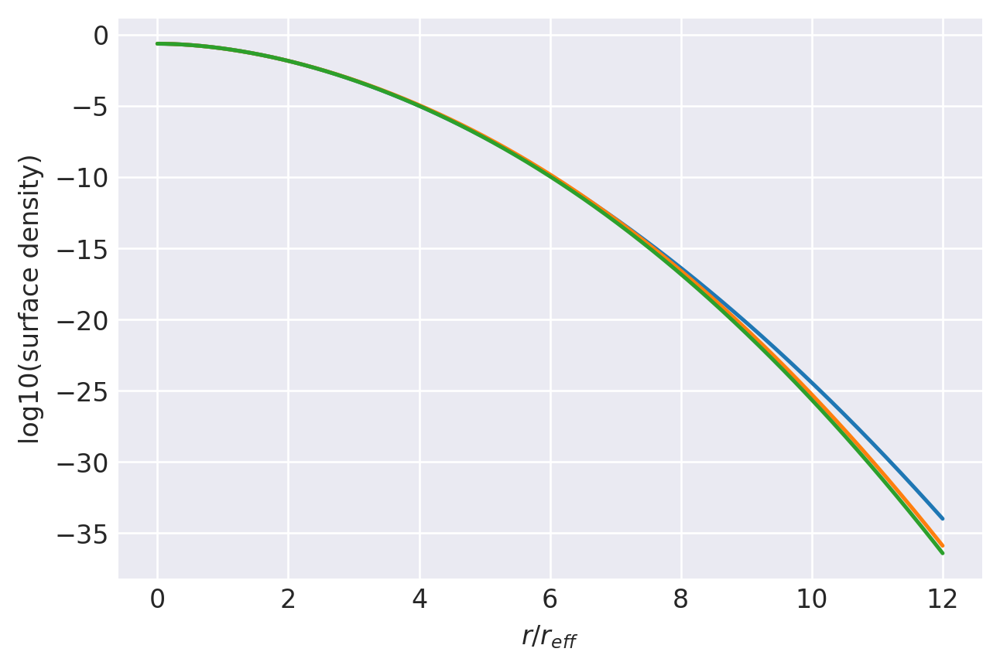

n=0.54: (
    normalize(np.array([4.0441549209e-01, 4.6348318374e-01, 1.0925467614e-01, 1.0873077018e-02, 6.5959220509e-03, 4.3125622395e-03, 9.7968435501e-04, 8.5402367630e-05])),
    np.array([1.1084816664e+00, 9.9143989678e-01, 8.1112330368e-01, 6.1387506641e-01, 6.0445738286e-01, 4.5693552120e-01, 2.9130795523e-01, 1.4260301829e-01]),
),
1.000000015078427 1.0000000151628745
prev.  chisq = -8.605751844515263
ws, re: (array([4.04415492e-01, 4.63483184e-01, 1.09254676e-01, 1.08730770e-02,
       8.54023676e-05, 4.31256224e-03, 9.79684355e-04, 6.59592205e-03]), array([1.10848167, 0.9914399 , 0.8111233 , 0.61387507, 0.14260302,
       0.45693552, 0.29130796, 0.60445738]))
         Current function value: -13.577430
         Iterations: 101
         Function evaluations: 3106
         Gradient evaluations: 182
-13.577430302248183 [-0.29103579  1.70972671  1.96031739 -2.18273426 -4.95083629 -2.28149057
 -2.82756344  0.0405982  -0.00897759 -0.12010398 -0.10944008 -0.85106755
 -0.53492329 -

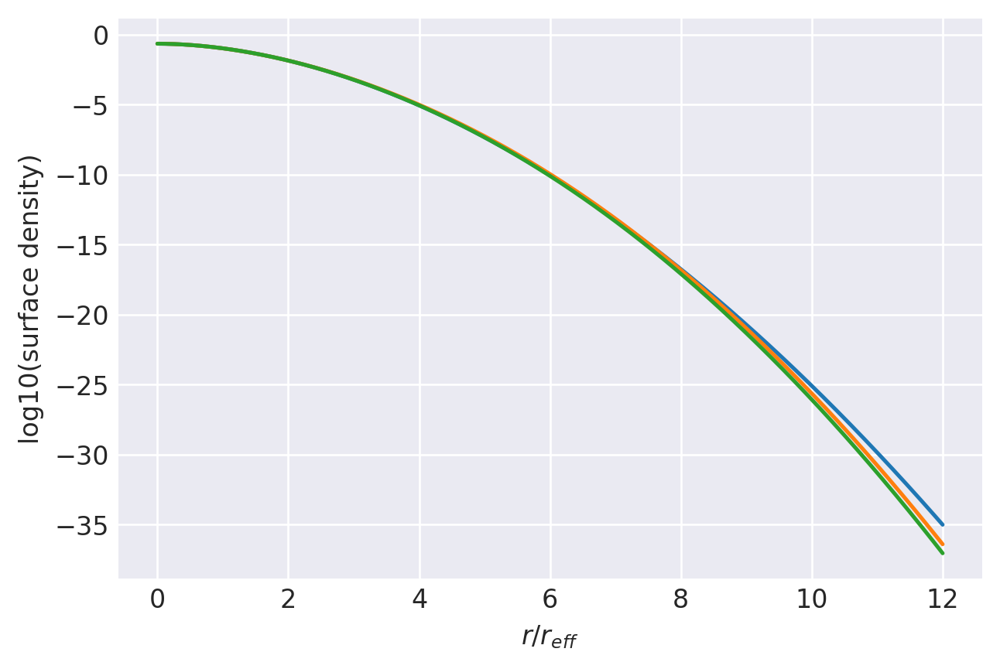

n=0.5349999999999999: (
    normalize(np.array([4.2775030688e-01, 4.8458151722e-01, 1.0963061420e-03, 7.6847055994e-02, 4.8936103335e-04, 8.2722677487e-03, 8.9484143450e-04, 6.8343548463e-05])),
    np.array([1.0979895357e+00, 9.7954053649e-01, 7.7724854439e-01, 7.5839596795e-01, 6.5937117150e-01, 4.9907625936e-01, 2.9179423421e-01, 1.4090696154e-01]),
),
1.000000014984337 1.0000000150695516
prev.  chisq = -8.597699406652023
ws, re: (array([4.27750307e-01, 4.84581517e-01, 7.68470560e-02, 1.09630614e-03,
       6.83435485e-05, 8.94841435e-04, 4.89361033e-04, 8.27226775e-03]), array([1.09798954, 0.97954054, 0.75839597, 0.77724854, 0.14090696,
       0.29179423, 0.65937117, 0.49907626]))
         Current function value: -13.853135
         Iterations: 92
         Function evaluations: 2918
         Gradient evaluations: 171
-13.853135371555364 [-0.15602864  1.77601161  2.01218363 -1.24878178 -3.5067509  -2.29313979
 -4.81343297  0.03538871 -0.01075831 -0.11680225 -0.35268525 -0.27250316
 

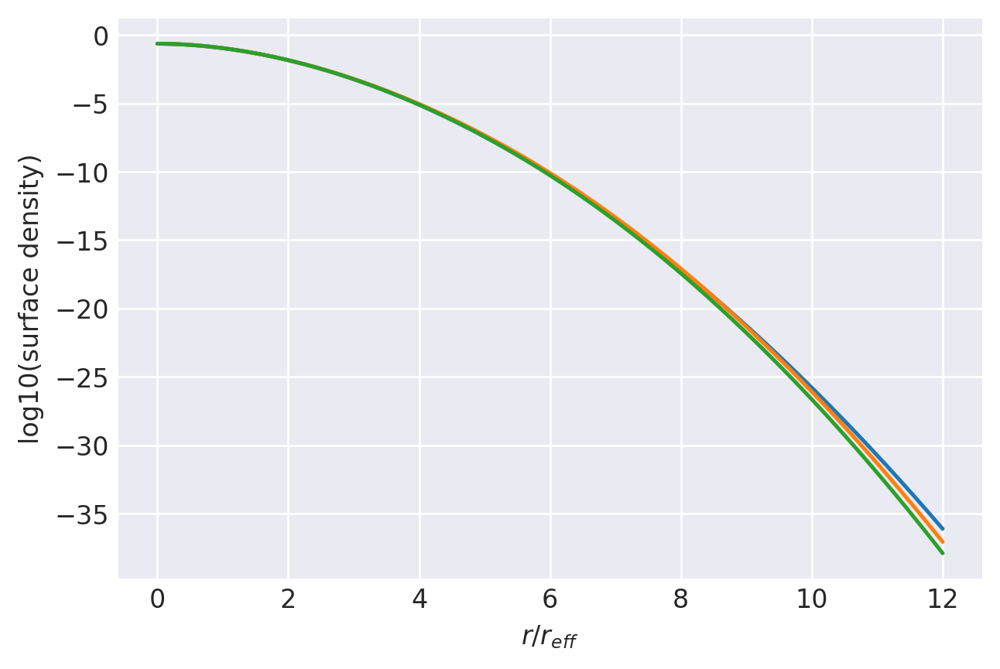

n=0.53: (
    normalize(np.array([4.6107178342e-01, 4.6089339478e-01, 6.8832203189e-02, 6.2555852186e-03, 2.0824989186e-04, 2.0513657397e-03, 6.3662280643e-04, 5.0794953729e-05])),
    np.array([1.0848974972e+00, 9.7553237685e-01, 7.6418366421e-01, 5.3961631242e-01, 5.3394538568e-01, 4.4393026459e-01, 2.8290944854e-01, 1.3693210857e-01]),
),
1.000000014891245 1.0000000149776205
prev.  chisq = -8.58950650289808
ws, re: (array([4.61071783e-01, 4.60893395e-01, 6.88322032e-02, 2.05136574e-03,
       2.08249892e-04, 6.36622806e-04, 5.07949537e-05, 6.25558522e-03]), array([1.0848975 , 0.97553238, 0.76418366, 0.44393026, 0.53394539,
       0.28290945, 0.13693211, 0.53961631]))
         Current function value: -13.528888
         Iterations: 49
         Function evaluations: 2001
         Gradient evaluations: 117
-13.528887851078002 [-4.29214372e-01  1.35056066e+00  2.03834223e+00 -1.15354928e+00
 -3.23473977e+00 -2.06760118e+00 -4.66097615e+00  3.23214318e-02
 -2.98256282e-04 -7.75817843e-02

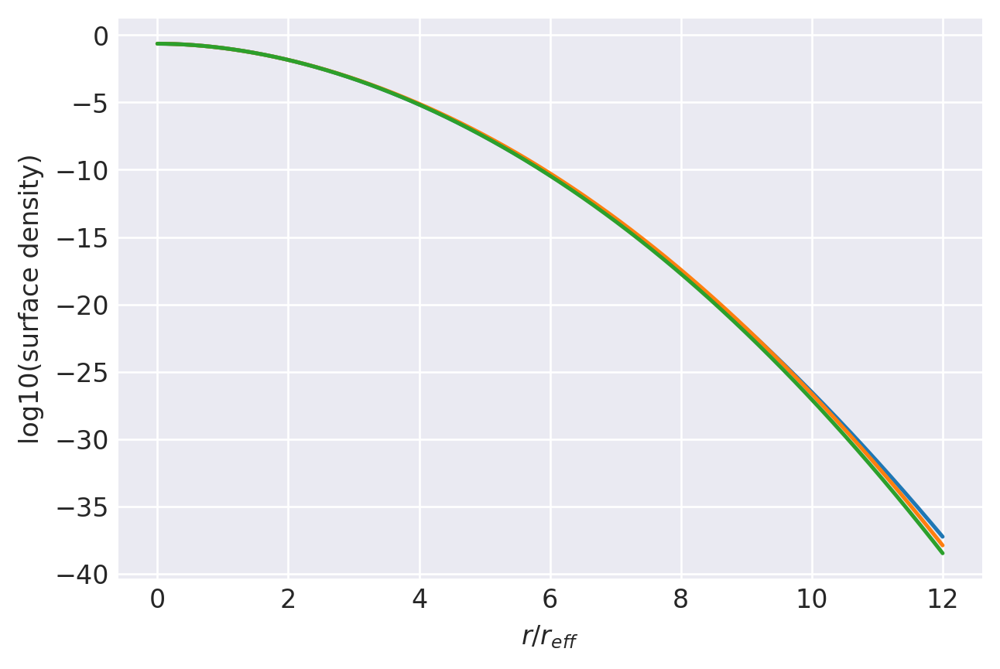

n=0.5249999999999999: (
    normalize(np.array([3.9431394793e-01, 4.8104874804e-01, 1.1027464394e-01, 4.1356054835e-04, 9.2374887254e-03, 3.4447603456e-03, 1.1794894490e-03, 8.7361020486e-05])),
    np.array([1.0772622264e+00, 9.9931347530e-01, 8.3640807252e-01, 7.2761377902e-01, 5.9644494405e-01, 5.4673552091e-01, 3.4124605778e-01, 1.6583790204e-01]),
),
1.000000014799145 1.0000000148838666
prev.  chisq = -8.581090760869582
ws, re: (array([3.94313948e-01, 4.81048748e-01, 1.10274644e-01, 3.44476035e-03,
       4.13560548e-04, 1.17948945e-03, 8.73610205e-05, 9.23748873e-03]), array([1.07726223, 0.99931348, 0.83640807, 0.54673552, 0.72761378,
       0.34124606, 0.1658379 , 0.59644494]))
         Current function value: -13.639734
         Iterations: 71
         Function evaluations: 3123
         Gradient evaluations: 183
-13.639733582866715 [-4.65226368e-01  1.07191520e+00  1.81504200e+00 -3.94338005e-01
 -2.88623544e+00 -2.49574310e+00 -5.18913146e+00  1.50477694e-03
  2.50689083e-02 

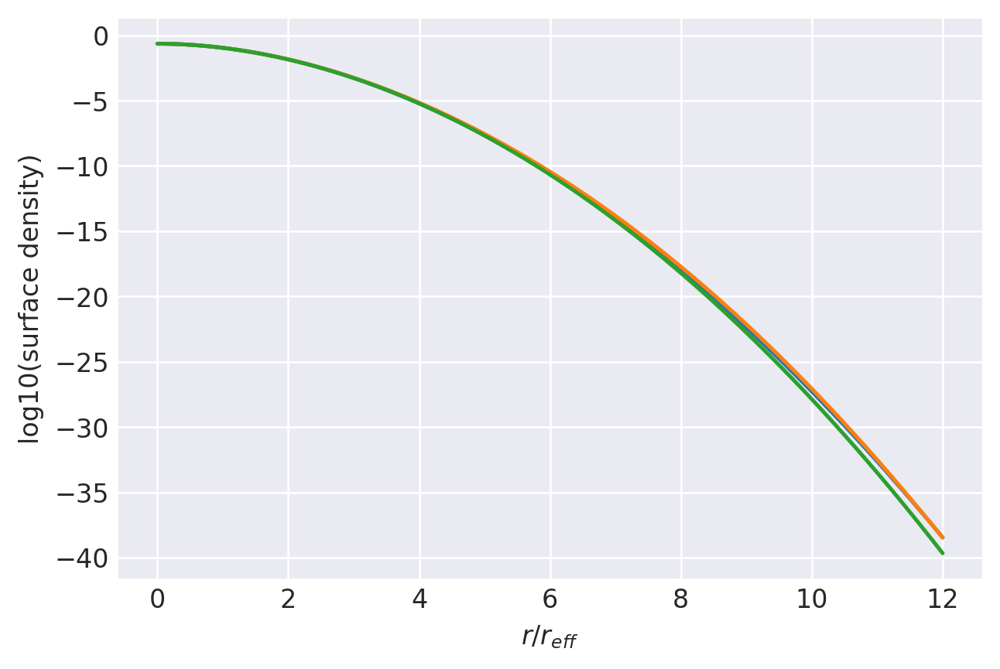

n=0.52: (
    normalize(np.array([4.5759471564e-01, 3.8574671880e-01, 1.3472168895e-01, 1.1402330390e-02, 6.9236428750e-04, 8.8333978234e-03, 9.4519503110e-04, 6.3589068518e-05])),
    np.array([1.0594218074e+00, 1.0034708866e+00, 8.7938407336e-01, 7.3975830049e-01, 6.8581740463e-01, 5.7592255948e-01, 3.4101979773e-01, 1.6310855531e-01]),
),
1.0000000147080328 1.0000000147937194
prev.  chisq = -8.572791983808065
ws, re: (array([3.85746719e-01, 4.57594716e-01, 1.34721689e-01, 8.83339782e-03,
       6.92364287e-04, 9.45195031e-04, 6.35890685e-05, 1.14023304e-02]), array([1.00347089, 1.05942181, 0.87938407, 0.57592256, 0.6858174 ,
       0.3410198 , 0.16310856, 0.7397583 ]))
         Current function value: -13.947168
         Iterations: 91
         Function evaluations: 3667
         Gradient evaluations: 215
-13.94716845495469 [-4.82588191e-01  1.07152889e+00  2.26138419e+00 -1.11608712e+00
 -2.66195875e+00 -5.28663870e+00 -4.15810341e+00  2.10737461e-02
  5.11955544e-03 -4.96001786e-0

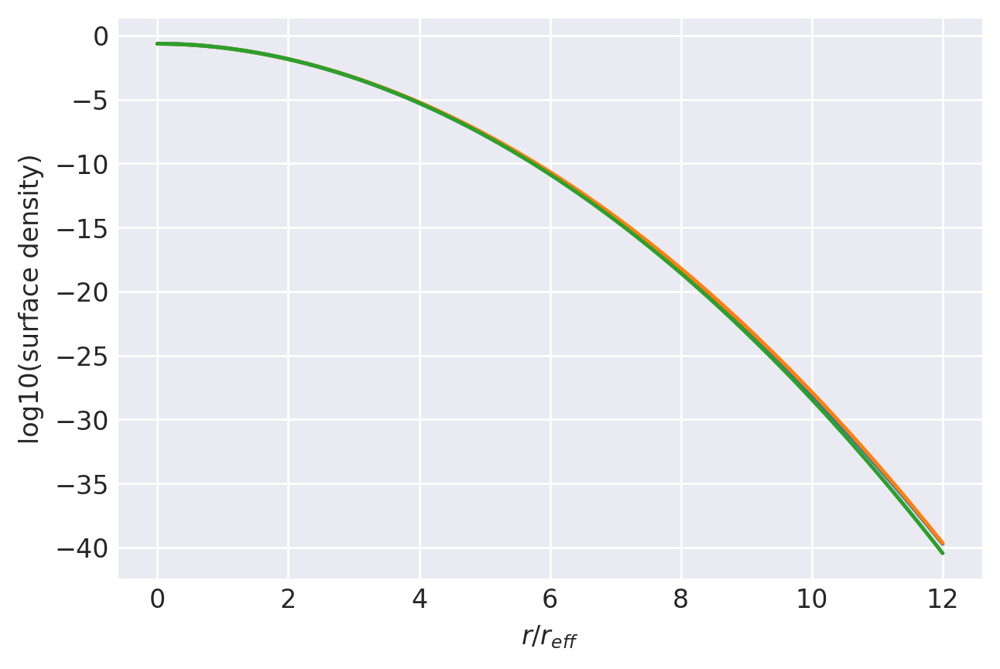

n=0.515: (
    normalize(np.array([3.8164114824e-01, 4.6060781616e-01, 1.4286375466e-01, 1.0268909355e-02, 1.6057685658e-04, 3.6732550151e-03, 7.3177970279e-04, 5.2760013845e-05])),
    np.array([1.0497206631e+00, 1.0118579668e+00, 8.9207182177e-01, 6.7907487156e-01, 6.2254971298e-01, 5.5480724208e-01, 3.4831360398e-01, 1.6880476680e-01]),
),
1.000000014617902 1.0000000147040027
prev.  chisq = -8.564439226415692
ws, re: (array([3.81641148e-01, 4.60607816e-01, 1.42863755e-01, 3.67325502e-03,
       7.31779703e-04, 5.27600138e-05, 1.60576857e-04, 1.02689094e-02]), array([1.04972066, 1.01185797, 0.89207182, 0.55480724, 0.3483136 ,
       0.16880477, 0.62254971, 0.67907487]))
         Current function value: -13.682105
         Iterations: 58
         Function evaluations: 2035
         Gradient evaluations: 119
-13.682104906917216 [-0.56033082  0.88334653  1.42234514 -0.93790762 -2.86201348 -5.59471499
 -4.01868516 -0.0072435   0.01782421 -0.00609208 -0.15659886 -0.35660381
 -0.66612952  

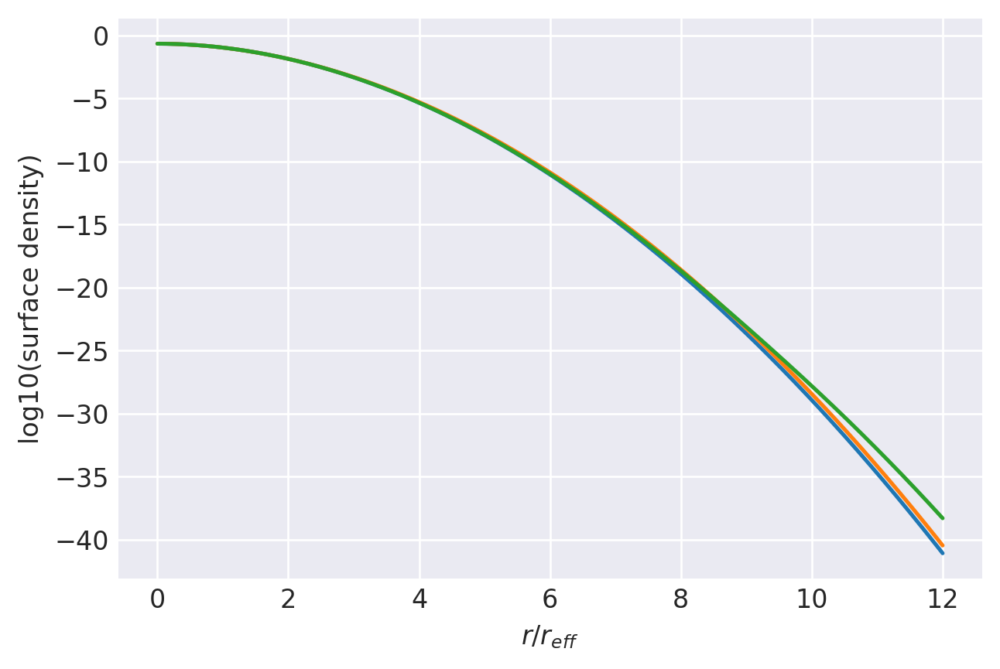

n=0.51: (
    normalize(np.array([4.3264815660e-04, 4.5035401475e-01, 1.5000233020e-01, 3.6347091893e-01, 2.4067315231e-02, 1.0176229430e-02, 1.4054656989e-03, 9.1077601888e-05])),
    np.array([1.1262811428e+00, 1.0418956199e+00, 9.8607040420e-01, 9.8345954249e-01, 8.1138123326e-01, 6.9727025294e-01, 4.3994277657e-01, 2.1571009938e-01]),
),
1.0000000145287486 1.0000000146135983
prev.  chisq = -8.555900959888467
ws, re: (array([3.63470919e-01, 4.50354015e-01, 1.50002330e-01, 1.01762294e-02,
       1.40546570e-03, 9.10776019e-05, 4.32648157e-04, 2.40673152e-02]), array([0.98345954, 1.04189562, 0.9860704 , 0.69727025, 0.43994278,
       0.2157101 , 1.12628114, 0.81138123]))
         Current function value: -13.947703
         Iterations: 63
         Function evaluations: 3344
         Gradient evaluations: 196
-13.947702788010856 [-7.96993500e-02  5.96816468e-01  2.13525162e+00 -1.07135429e-01
 -3.08496277e+00 -5.98103830e+00 -3.94532261e+00  9.44852315e-03
 -1.31422934e-02  9.27238886e-

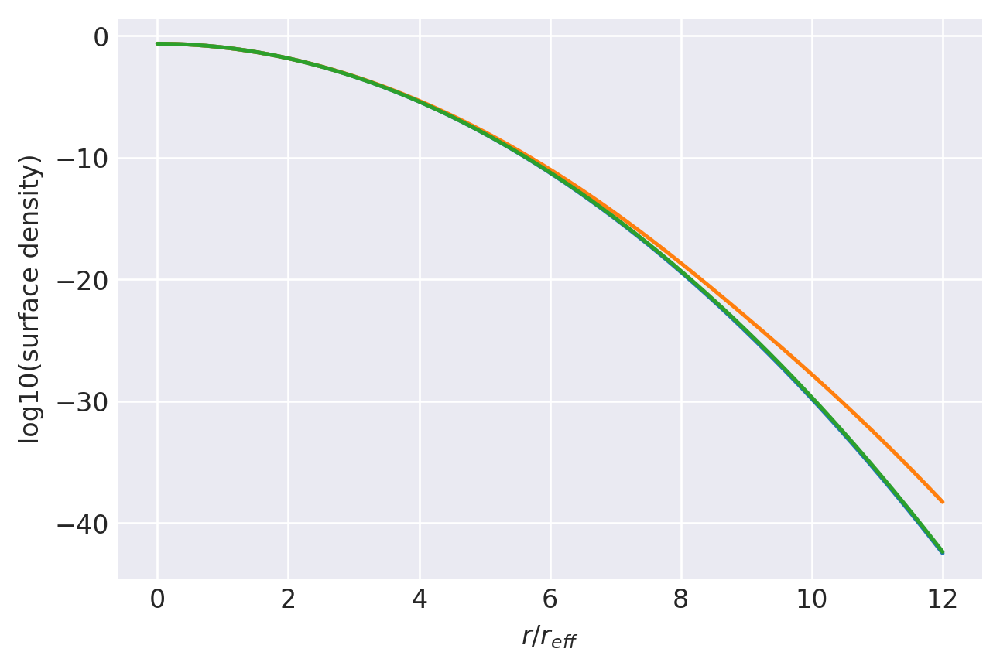

n=0.505: (
    normalize(np.array([4.8008570267e-01, 1.6509099731e-01, 9.6198776306e-03, 3.3530709402e-01, 9.2358831290e-03, 1.8609628767e-04, 4.4957707680e-04, 2.4771870771e-05])),
    np.array([1.0219944166e+00, 1.0215800163e+00, 1.0107068690e+00, 9.7019203892e-01, 7.0999950053e-01, 5.3672238445e-01, 3.9844360267e-01, 1.8944260866e-01]),
),


In [5]:
# Now try to work backwards in finely-spaced bins from n=1 with eight components and see where it breaks down
nspaced = np.linspace(1, 0.5, num=100, endpoint=False)
nvals = [
    (
        nspaced,
        (
	normalize(np.array([7.7900190678e-02, 3.1264016273e-01, 3.3937178782e-01, 1.8392530470e-01, 6.5418042323e-02, 1.7095071454e-02, 3.2661231097e-03, 3.8331719642e-04])),
	np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02])
        ),
    )
]
fitweights(nvals, rmid, areasq)

## Fitting weights with fixed, linearly-extrapolated sizes for n < 1

In the plots at the end of this notebook, it's clear that the best-fit *sizes* change nearly linearly from about n=1 to n=0.7. With appropriate choices for the slope of r vs n for each Gaussian, it's possible to fit smoothly-varying weights even for N=8.

[ 1.02610583  0.60634281  0.30585517  0.10200563 -0.0475183  -0.18168242
 -0.32424482 -0.50154897]
[ 1.11799858  0.60634281  0.30585517  0.10200563  0.         -0.18168242
 -0.32424482 -0.50154897]
1 [2.17045661 1.47679133 0.99494464 0.65054022 0.40699848 0.23877605
 0.12631553 0.05405815]
0.75 [1.57351098 1.20743015 0.89964332 0.6141669  0.40699848 0.25291729
 0.14172035 0.06424279]
0.5 [1.         0.9090717  0.78061774 0.56632816 0.40699848 0.27428166
 0.16667433 0.08193683]
0.9999999914677243 1.0000000283694637
prev.  chisq = -10.92882749800659
ws, re: (array([0.07790019, 0.31264016, 0.33937179, 0.1839253 , 0.06541804,
       0.01709507, 0.00326612, 0.00038332]), array([2.17045661, 1.47679133, 0.99494464, 0.65054022, 0.40699848,
       0.23877605, 0.12631553, 0.05405815]))
Optimization terminated successfully.
         Current function value: -10.928828
         Iterations: 10
         Function evaluations: 144
         Gradient evaluations: 16
-10.92882763671094 [-2.47122091 -0.667

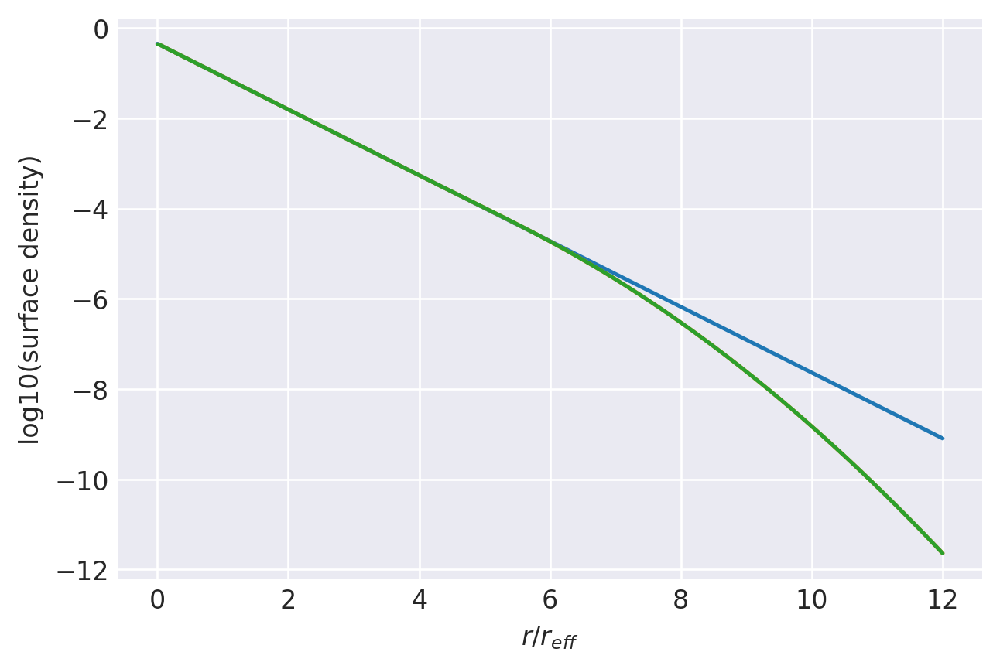

n=1.0: (
    normalize(np.array([7.7900489670e-02, 3.1263985956e-01, 3.3937166369e-01, 1.8392552231e-01, 6.5417944499e-02, 1.7095056297e-02, 3.2661568475e-03, 3.8330712707e-04])),
    np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02]),
),
1.000000011065797 1.0000000284855588
prev.  chisq = -7.50778093682488
ws, re: (array([0.07790049, 0.31263986, 0.33937166, 0.18392552, 0.06541794,
       0.01709506, 0.00326616, 0.00038331]), array([2.10988257, 1.4508495 , 0.98616715, 0.6472545 , 0.40699848,
       0.23998818, 0.12760124, 0.0548856 ]))
         Current function value: -11.008447
         Iterations: 27
         Function evaluations: 1028
         Gradient evaluations: 113
-11.008446783209555 [-2.43075681 -0.63706594  0.26400012  0.79478856  1.16254076  1.56379083
  2.14681466]
1.000000011065797 1.0000000274289769


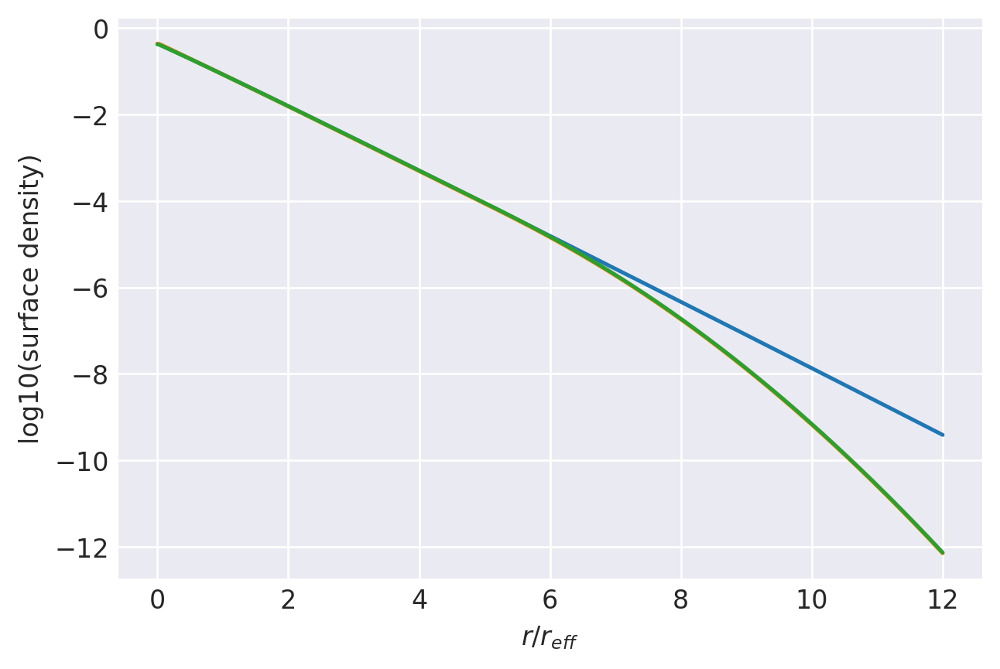

n=0.975: (
    normalize(np.array([8.0857203429e-02, 3.1794076520e-01, 3.4005150474e-01, 1.7989578654e-01, 6.1899379840e-02, 1.6004882352e-02, 2.9999198800e-03, 3.5055801062e-04])),
    np.array([2.1098825713e+00, 1.4508494976e+00, 9.8616715342e-01, 6.4725449979e-01, 4.0699848261e-01, 2.3998817614e-01, 1.2760123754e-01, 5.4885596884e-02]),
),
1.0000000199734806 1.0000000275460064
prev.  chisq = -7.46596606451809
ws, re: (array([0.0808572 , 0.31794077, 0.3400515 , 0.17989579, 0.06189938,
       0.01600488, 0.00299992, 0.00035056]), array([2.04949155, 1.42470732, 0.97724213, 0.64390067, 0.40699848,
       0.24123818, 0.12893395, 0.05574771]))
         Current function value: -11.026817
         Iterations: 23
         Function evaluations: 785
         Gradient evaluations: 86
-11.026817431772287 [-2.38650903 -0.604274    0.30177993  0.8330609   1.175985    1.58438141
  2.14971821]
1.0000000199734806 1.000000026497409


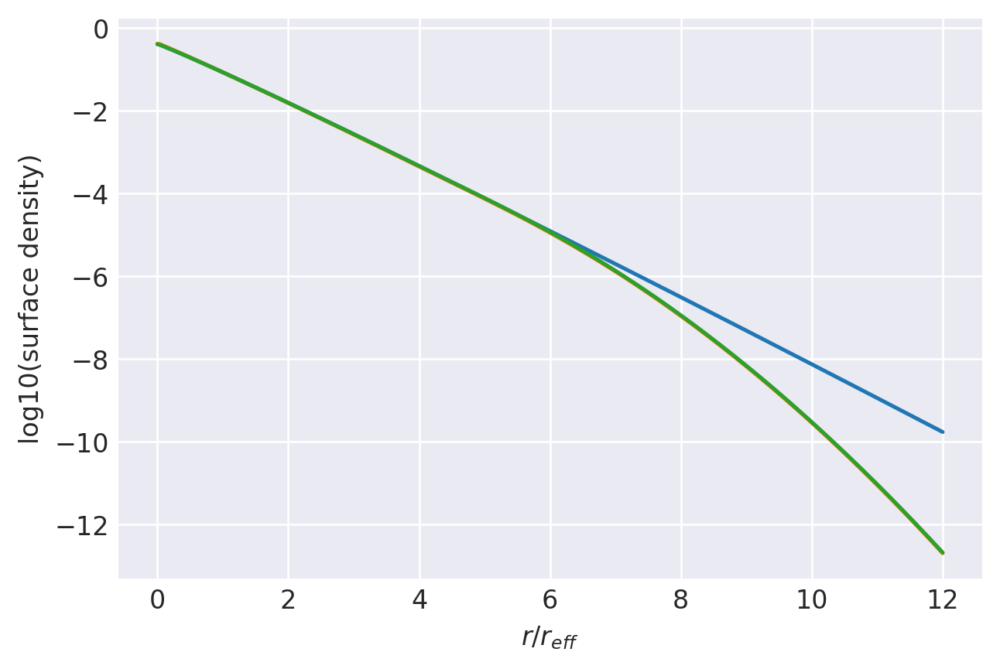

n=0.95: (
    normalize(np.array([8.4207252704e-02, 3.2361045944e-01, 3.4043231855e-01, 1.7547016950e-01, 5.8294939748e-02, 1.4924270998e-02, 2.7411934590e-03, 3.1939560181e-04])),
    np.array([2.0494915452e+00, 1.4247073224e+00, 9.7724212546e-01, 6.4390066898e-01, 4.0699848261e-01, 2.4123818220e-01, 1.2893395081e-01, 5.5747705586e-02]),
),
1.0000000233902284 1.000000026632113
prev.  chisq = -7.422227827622759
ws, re: (array([8.42072527e-02, 3.23610459e-01, 3.40432319e-01, 1.75470170e-01,
       5.82949397e-02, 1.49242710e-02, 2.74119346e-03, 3.19395602e-04]), array([1.98928778, 1.39835792, 0.9681631 , 0.64047547, 0.40699848,
       0.2425283 , 0.13031669, 0.0566469 ]))
         Current function value: -10.996119
         Iterations: 24
         Function evaluations: 839
         Gradient evaluations: 92
-10.996119170149447 [-2.33802936 -0.56886567  0.34190534  0.87324907  1.18868197  1.60611296
  2.15101148]
1.0000000233902284 1.0000000255898516


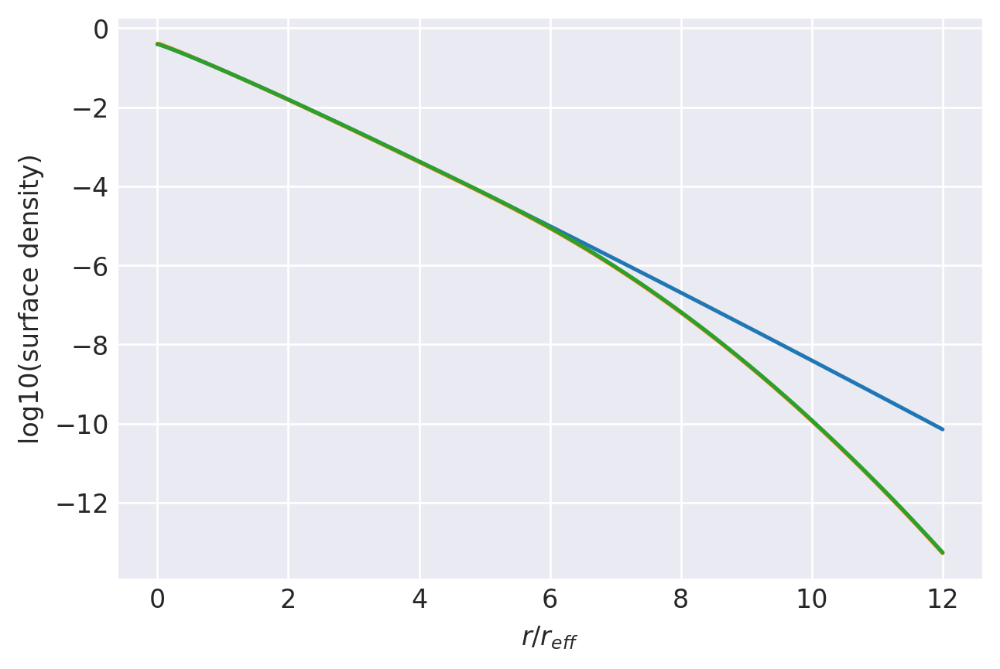

n=0.925: (
    normalize(np.array([8.8021978134e-02, 3.2967878455e-01, 3.4044315871e-01, 1.7061043240e-01, 5.4610162054e-02, 1.3855212679e-02, 2.4904650251e-03, 2.8980643964e-04])),
    np.array([1.9892877762e+00, 1.3983579171e+00, 9.6816309563e-01, 6.4047547107e-01, 4.0699848261e-01, 2.4252829955e-01, 1.3031668973e-01, 5.6646896507e-02]),
),
1.0000000242164144 1.0000000257487047
prev.  chisq = -7.376416416606312
ws, re: (array([8.80219781e-02, 3.29678785e-01, 3.40443159e-01, 1.70610432e-01,
       5.46101621e-02, 1.38552127e-02, 2.49046503e-03, 2.89806440e-04]), array([1.92927572, 1.37179397, 0.95892313, 0.6369754 , 0.40699848,
       0.24386095, 0.13175276, 0.05758583]))
         Current function value: -10.942246
         Iterations: 24
         Function evaluations: 1335
         Gradient evaluations: 147
-10.942246012255767 [-2.28479319 -0.53051413  0.3846266   0.91549799  1.20043603  1.62913339
  2.15043501]
1.0000000242164144 1.000000024711162


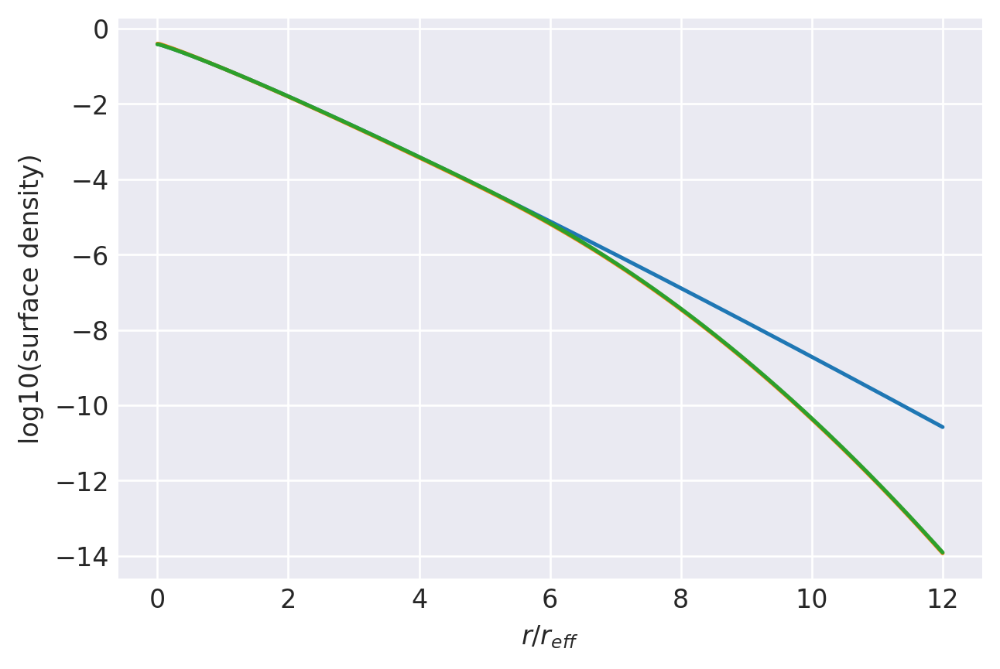

n=0.9: (
    normalize(np.array([9.2390237228e-02, 3.3617591771e-01, 3.3999656404e-01, 1.6527489454e-01, 5.0852565130e-02, 1.2799789712e-02, 2.2482589806e-03, 2.6177265423e-04])),
    np.array([1.9292757222e+00, 1.3717939694e+00, 9.5892313392e-01, 6.3697539550e-01, 4.0699848261e-01, 2.4386095287e-01, 1.3175276218e-01, 5.7585833246e-02]),
),
1.0000000239425677 1.0000000248970098
prev.  chisq = -7.328358133246571
ws, re: (array([9.23902372e-02, 3.36175918e-01, 3.39996564e-01, 1.65274895e-01,
       5.08525651e-02, 1.27997897e-02, 2.24825898e-03, 2.61772654e-04]), array([1.86946007, 1.3450077 , 0.9495148 , 0.63339666, 0.40699848,
       0.24523879, 0.13324579, 0.05856745]))
         Current function value: -10.886638
         Iterations: 26
         Function evaluations: 893
         Gradient evaluations: 98
-10.886638401067698 [-2.22618131 -0.4888341   0.4302327   0.9599597   1.21101731  1.65360431
  2.14770523]
1.0000000239425677 1.0000000238624525


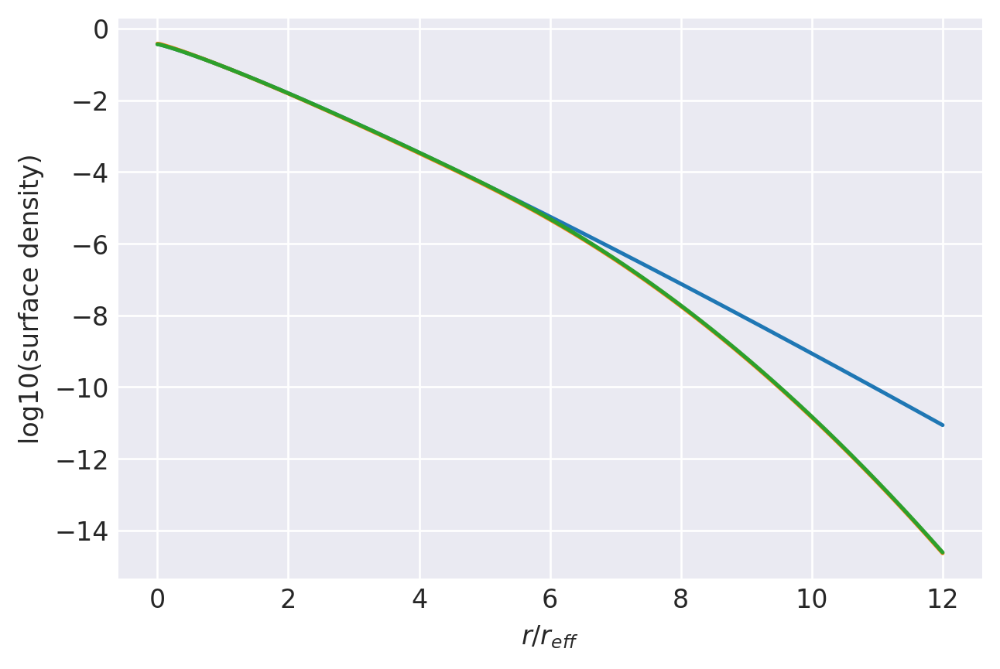

n=0.875: (
    normalize(np.array([9.7423912383e-02, 3.4313078327e-01, 3.3898426511e-01, 1.5941840593e-01, 4.7032060966e-02, 1.1760160418e-02, 2.0151406821e-03, 2.3527124063e-04])),
    np.array([1.8694600738e+00, 1.3450076975e+00, 9.4951479537e-01, 6.3339665549e-01, 4.0699848261e-01, 2.4523878609e-01, 1.3324579473e-01, 5.8567451847e-02]),
),
1.0000000232649449 1.0000000240771167
prev.  chisq = -7.277851469559112
ws, re: (array([9.74239124e-02, 3.43130783e-01, 3.38984265e-01, 1.59418406e-01,
       4.70320610e-02, 1.17601604e-02, 2.01514068e-03, 2.35271241e-04]), array([1.80984577, 1.31799081, 0.93993007, 0.62973516, 0.40699848,
       0.24666469, 0.13479977, 0.059595  ]))
         Current function value: -10.841524
         Iterations: 21
         Function evaluations: 849
         Gradient evaluations: 93
-10.841524238884213 [-2.16145563 -0.44336766  0.4790596   1.00678945  1.22015868  1.67969584
  2.14252314]
1.0000000232649449 1.0000000230436177


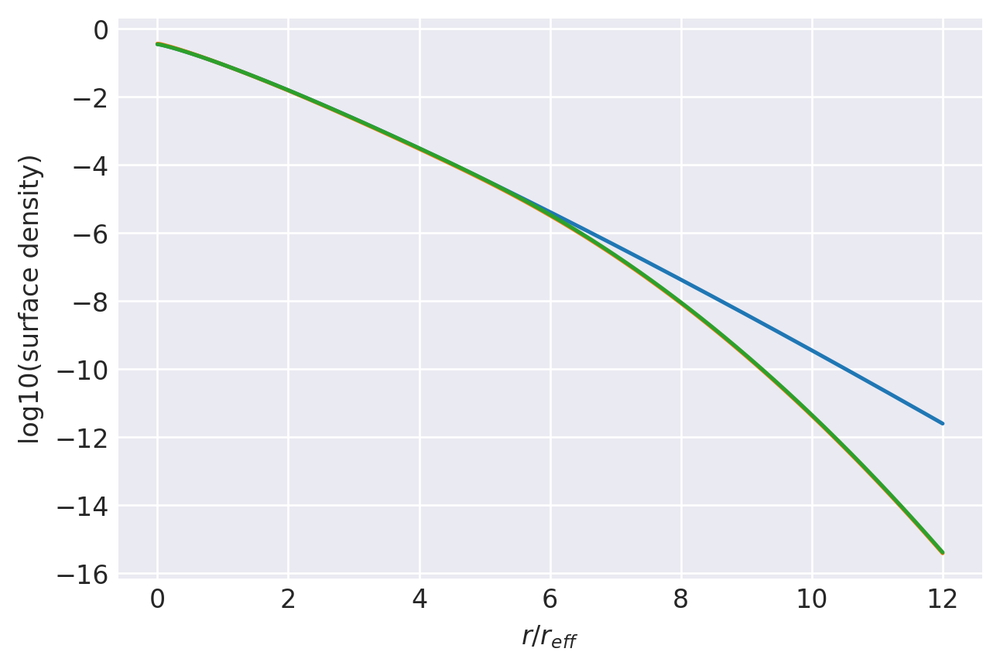

n=0.85: (
    normalize(np.array([1.0326557970e-01, 3.5056829259e-01, 3.3727166915e-01, 1.5299249841e-01, 4.3161426759e-02, 1.0738540143e-02, 1.7917199410e-03, 2.1027331046e-04])),
    np.array([1.8098457733e+00, 1.3179908059e+00, 9.3993006588e-01, 6.2973515774e-01, 4.0699848261e-01, 2.4666468910e-01, 1.3479977348e-01, 5.9594997451e-02]),
),
1.000000022474237 1.0000000232888253
prev.  chisq = -7.224662166013487
ws, re: (array([1.03265580e-01, 3.50568293e-01, 3.37271669e-01, 1.52992498e-01,
       4.31614268e-02, 1.07385401e-02, 1.79171994e-03, 2.10273310e-04]), array([1.75043804, 1.29073444, 0.9301603 , 0.62598647, 0.40699848,
       0.24814183, 0.13641909, 0.06067207]))
         Current function value: -10.812917
         Iterations: 24
         Function evaluations: 1180
         Gradient evaluations: 130
-10.812917210019089 [-2.08972676 -0.39356559  0.53150045  1.05613808  1.22755538  1.70757478
  2.13459003]
1.000000022474237 1.0000000222542036


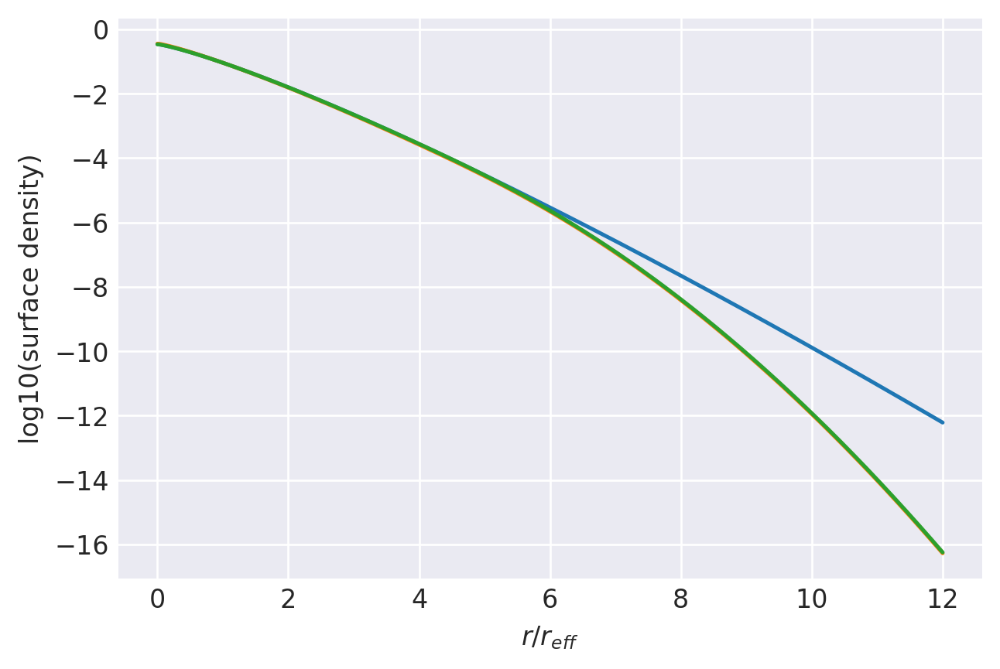

n=0.825: (
    normalize(np.array([1.1009934273e-01, 3.5850471394e-01, 3.3469070109e-01, 1.4594581545e-01, 3.9256854522e-02, 9.7371742451e-03, 1.5786541629e-03, 1.8674385878e-04])),
    np.array([1.7504380364e+00, 1.2907344353e+00, 9.3016030047e-01, 6.2598646774e-01, 4.0699848261e-01, 2.4814182879e-01, 1.3641909160e-01, 6.0672067129e-02]),
),
1.0000000216764655 1.0000000225319192
prev.  chisq = -7.168516651363683
ws, re: (array([1.10099343e-01, 3.58504714e-01, 3.34690701e-01, 1.45945815e-01,
       3.92568545e-02, 9.73717425e-03, 1.57865416e-03, 1.86743859e-04]), array([1.69124238, 1.26322911, 0.92019615, 0.62214577, 0.40699848,
       0.24967368, 0.1381086 , 0.06180266]))
         Current function value: -10.803944
         Iterations: 21
         Function evaluations: 1008
         Gradient evaluations: 111
-10.803944158942324 [-2.00990912 -0.33876232  0.58801887  1.10813863  1.23286921  1.73738344
  2.12364108]
1.0000000216764655 1.0000000214936728


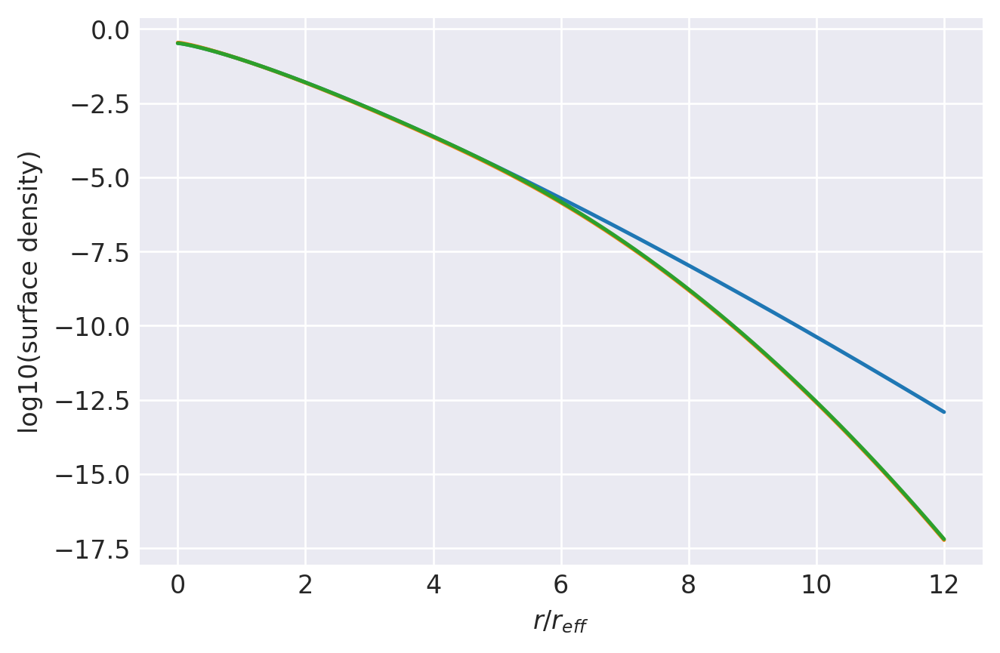

n=0.8: (
    normalize(np.array([1.1816644753e-01, 3.6693989578e-01, 3.3103051455e-01, 1.3822498822e-01, 3.5338551735e-02, 8.7583121202e-03, 1.3766491797e-03, 1.6464087983e-04])),
    np.array([1.6912423757e+00, 1.2632291058e+00, 9.2019615278e-01, 6.2214576994e-01, 4.0699848261e-01, 2.4967368486e-01, 1.3810860478e-01, 6.1802660163e-02]),
),
1.0000000209041424 1.000000021806251
prev.  chisq = -7.109093831226949
ws, re: (array([1.18166448e-01, 3.66939896e-01, 3.31030515e-01, 1.38224988e-01,
       3.53385517e-02, 8.75831212e-03, 1.37664918e-03, 1.64640880e-04]), array([1.63226463, 1.23546465, 0.91002749, 0.61820782, 0.40699848,
       0.25126409, 0.1398737 , 0.06299124]))
Optimization terminated successfully.
         Current function value: -10.816847
         Iterations: 26
         Function evaluations: 468
         Gradient evaluations: 52
-10.81684665665642 [-1.9206575  -0.27814222  0.64916656  1.16288174  1.23574459  1.7691965
  2.10950018]
1.0000000209041424 1.0000000207614783


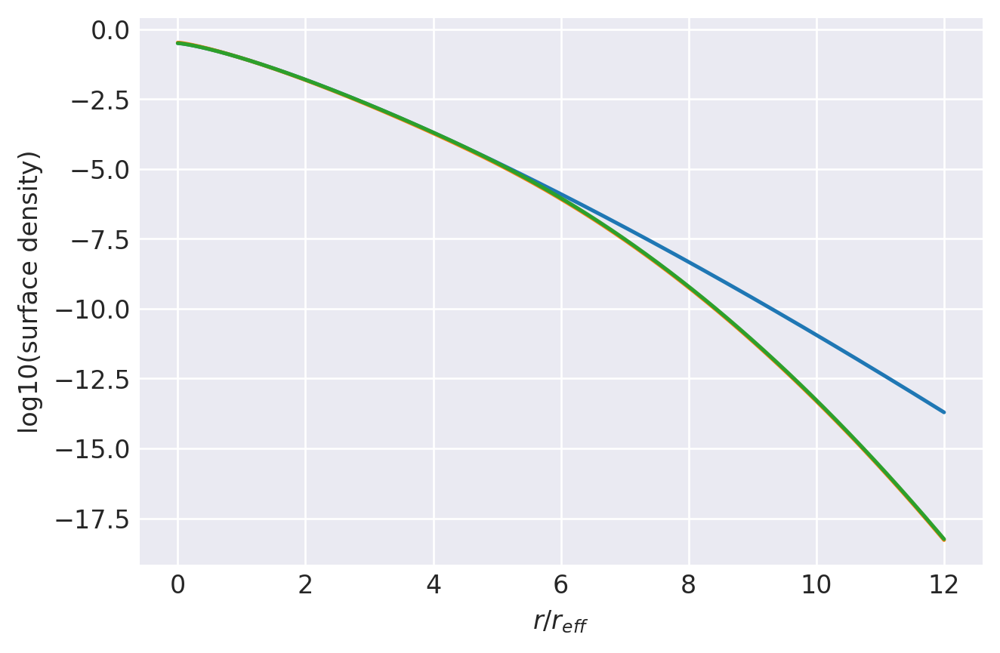

n=0.775: (
    normalize(np.array([1.2778826451e-01, 3.7584414361e-01, 3.2602546393e-01, 1.2977616332e-01, 3.1431419324e-02, 7.8041692968e-03, 1.1864600849e-03, 1.4391592234e-04])),
    np.array([1.6322646278e+00, 1.2354646525e+00, 9.1002749419e-01, 6.1820782198e-01, 4.0699848261e-01, 2.5126409175e-01, 1.3987369630e-01, 6.2991237363e-02]),
),
1.0000000201648103 1.0000000211117928
prev.  chisq = -7.046013263554825
ws, re: (array([1.27788265e-01, 3.75844144e-01, 3.26025464e-01, 1.29776163e-01,
       3.14314193e-02, 7.80416930e-03, 1.18646008e-03, 1.43915922e-04]), array([1.57351098, 1.20743015, 0.89964332, 0.6141669 , 0.40699848,
       0.25291729, 0.14172035, 0.06424279]))
         Current function value: -10.854062
         Iterations: 21
         Function evaluations: 946
         Gradient evaluations: 104
-10.854061946210193 [-1.82027603 -0.21069167  0.71560557  1.2203739   1.23584267  1.80295063
  2.09218179]
1.0000000201648103 1.0000000200570773


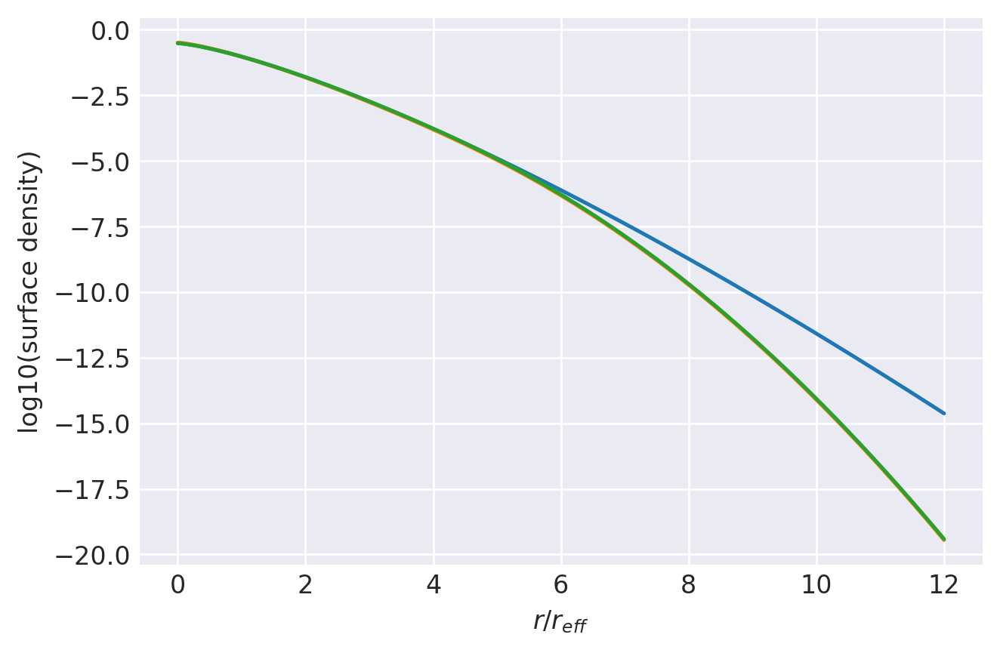

n=0.75: (
    normalize(np.array([1.3940075454e-01, 3.8513629592e-01, 3.1933927013e-01, 1.2054767394e-01, 2.7565695764e-02, 6.8769128425e-03, 1.0088829868e-03, 1.2451388725e-04])),
    np.array([1.5735109829e+00, 1.2074301525e+00, 8.9964332072e-01, 6.1416690157e-01, 4.0699848261e-01, 2.5291728764e-01, 1.4172035363e-01, 6.4242791372e-02]),
),
1.0000000194590108 1.0000000204486796
prev.  chisq = -6.9788195647873925
ws, re: (array([1.39400755e-01, 3.85136296e-01, 3.19339270e-01, 1.20547674e-01,
       2.75656958e-02, 6.87691284e-03, 1.00888299e-03, 1.24513887e-04]), array([1.51498802, 1.17911384, 0.88903165, 0.61001674, 0.40699848,
       0.25463797, 0.14365526, 0.06556293]))
         Current function value: -10.918883
         Iterations: 21
         Function evaluations: 1055
         Gradient evaluations: 116
-10.918883131112894 [-1.70658008 -0.13513227  0.7881396   1.28046221  1.23291619  1.83831281
  2.07205779]
1.0000000194590108 1.0000000193799425


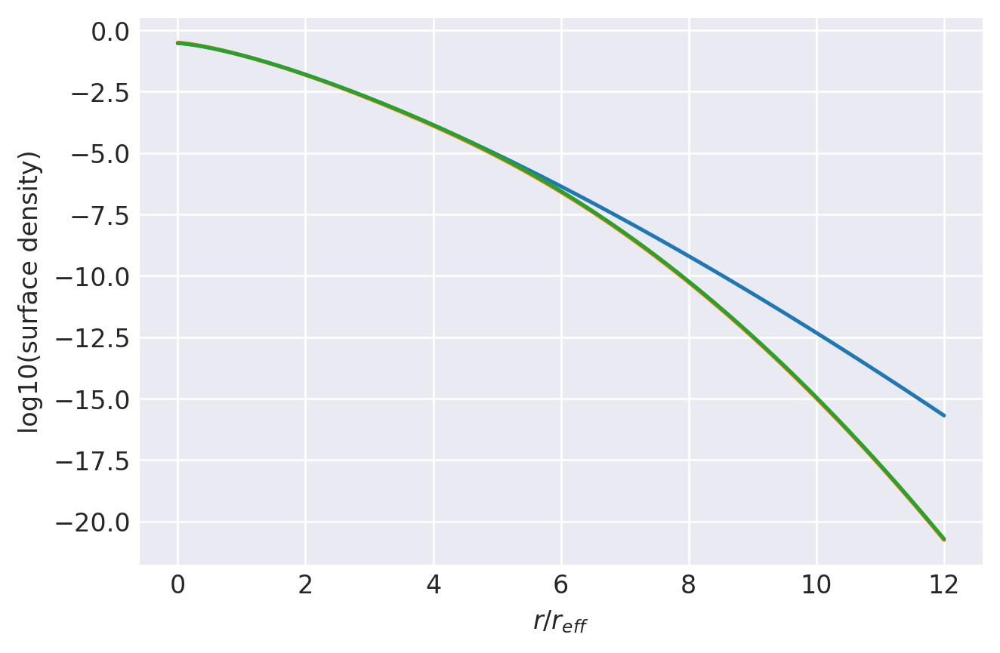

n=0.725: (
    normalize(np.array([1.5360782153e-01, 3.9464579833e-01, 3.1054479446e-01, 1.1049425719e-01, 2.3777561692e-02, 5.9786496787e-03, 8.4474182712e-04, 1.0637528435e-04])),
    np.array([1.5149880192e+00, 1.1791138408e+00, 8.8903164529e-01, 6.1001674496e-01, 4.0699848261e-01, 2.5463797213e-01, 1.4365525919e-01, 6.5562930470e-02]),
),
1.0000000187857572 1.0000000198172825
prev.  chisq = -6.906960386722028
ws, re: (array([1.53607822e-01, 3.94645798e-01, 3.10544794e-01, 1.10494257e-01,
       2.37775617e-02, 5.97864968e-03, 8.44741827e-04, 1.06375284e-04]), array([1.45670274, 1.15050301, 0.87817937, 0.60575047, 0.40699848,
       0.25643137, 0.1456859 , 0.06695798]))
         Current function value: -11.015973
         Iterations: 21
         Function evaluations: 866
         Gradient evaluations: 95
-11.015973265533852 [-1.57668172 -0.04982178  0.86775567  1.34270124  1.22695738  1.87445261
  2.05015806]
1.0000000187857572 1.0000000187295635


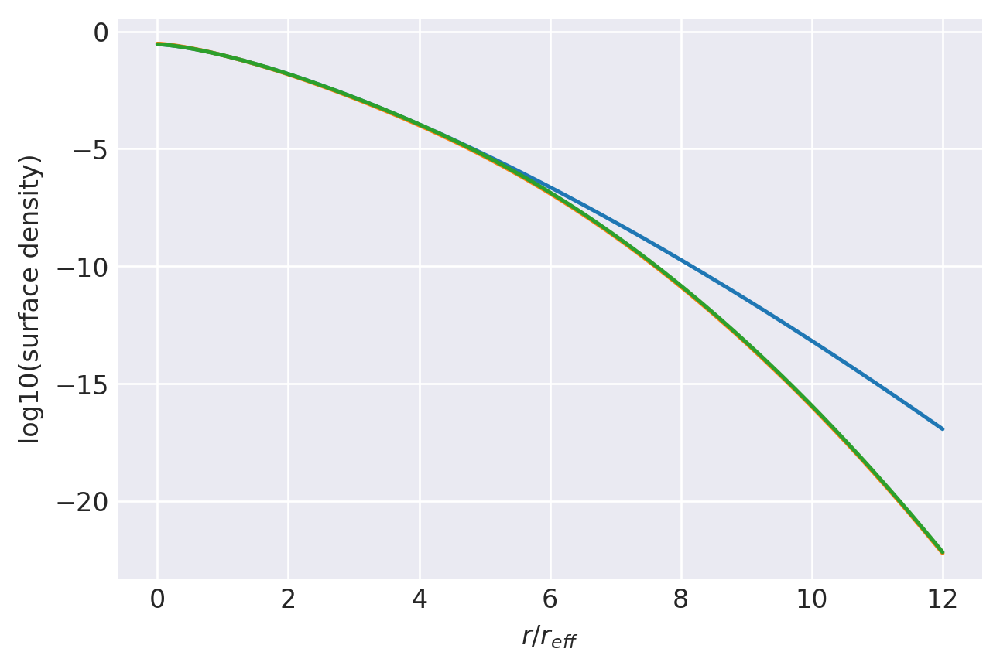

n=0.7: (
    normalize(np.array([1.7126594507e-01, 4.0404691053e-01, 2.9909801838e-01, 9.9583864066e-02, 2.0109494619e-02, 5.1114689786e-03, 6.9485978320e-04, 8.9438569740e-05])),
    np.array([1.4567027409e+00, 1.1505030139e+00, 8.7817937248e-01, 6.0575047484e-01, 4.0699848261e-01, 2.5643137456e-01, 1.4568589847e-01, 6.6957979020e-02]),
),
1.000000018143855 1.0000000192183076
prev.  chisq = -6.829754818808521
ws, re: (array([1.71265945e-01, 4.04046911e-01, 2.99098018e-01, 9.95838641e-02,
       2.01094946e-02, 5.11146898e-03, 6.94859783e-04, 8.94385697e-05]), array([1.39866262, 1.12158392, 0.86707215, 0.60136052, 0.40699848,
       0.25830334, 0.14782069, 0.0684351 ]))
Optimization terminated successfully.
         Current function value: -11.151753
         Iterations: 26
         Function evaluations: 414
         Gradient evaluations: 46
-11.151752648587197 [-1.4266364   0.04739449  0.9556834   1.40611126  1.21848853  1.90963908
  2.02868921]
1.000000018143855 1.0000000181054518


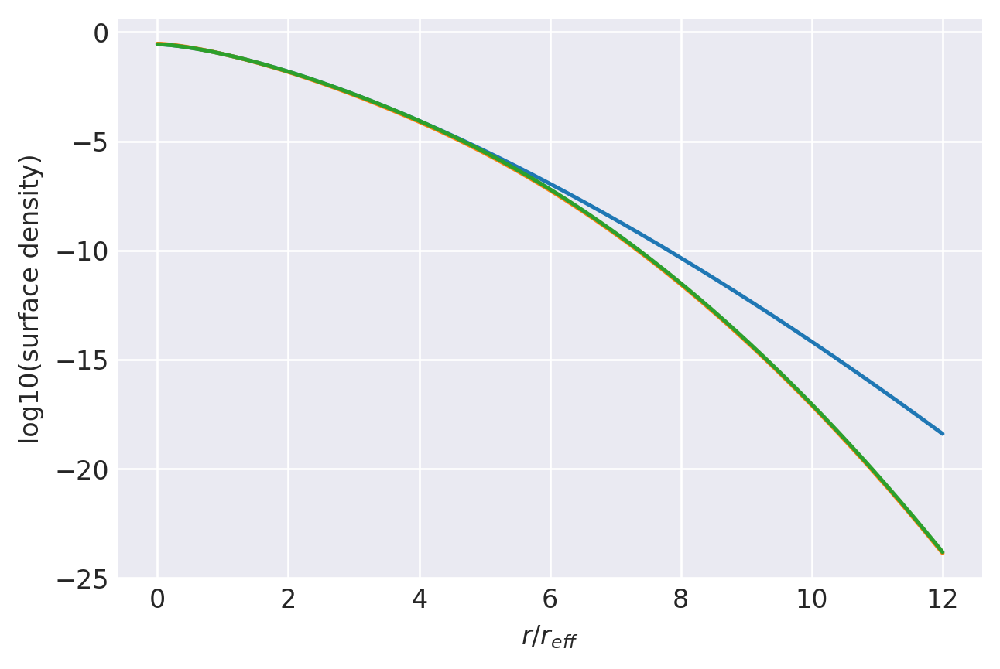

n=0.675: (
    normalize(np.array([1.9362331316e-01, 4.1274100861e-01, 2.8430601328e-01, 8.7808324085e-02, 1.6610115988e-02, 4.2775717437e-03, 5.6000775566e-04, 7.3645380633e-05])),
    np.array([1.3986626227e+00, 1.1215839185e+00, 8.6707215232e-01, 6.0136051589e-01, 4.0699848261e-01, 2.5830333518e-01, 1.4782068946e-01, 6.8435098592e-02]),
),
1.000000017532151 1.0000000186529612
prev.  chisq = -6.746346824011424
ws, re: (array([1.93623313e-01, 4.12741009e-01, 2.84306013e-01, 8.78083241e-02,
       1.66101160e-02, 4.27757174e-03, 5.60007756e-04, 7.36453806e-05]), array([1.34087566, 1.09234162, 0.85569421, 0.59683849, 0.40699848,
       0.2602604 , 0.15006914, 0.07000243]))
         Current function value: -11.334058
         Iterations: 21
         Function evaluations: 756
         Gradient evaluations: 83
-11.334057616728085 [-1.2508265   0.159419    1.05347831  1.46873277  1.20912666  1.9405346
  2.01189213]
1.000000017532151 1.0000000175071526


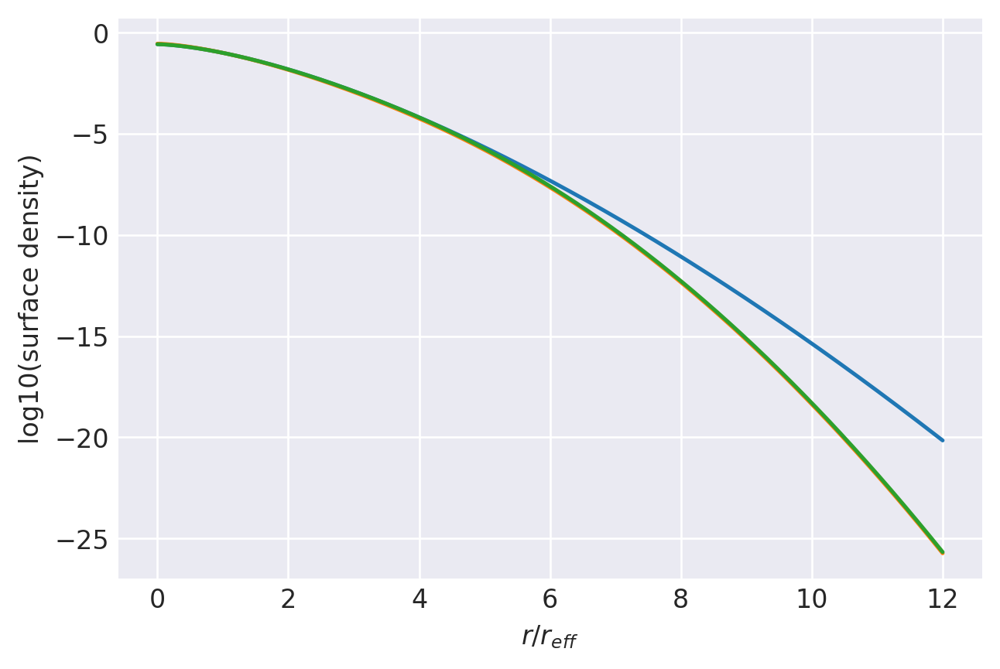

n=0.65: (
    normalize(np.array([2.2255710120e-01, 4.1964078694e-01, 2.6528960995e-01, 7.5200146771e-02, 1.3333013103e-02, 3.4795798994e-03, 4.4081020756e-04, 5.8951924994e-05])),
    np.array([1.3408756591e+00, 1.0923416226e+00, 8.5569420844e-01, 5.9683849500e-01, 4.0699848261e-01, 2.6026040245e-01, 1.5006913872e-01, 7.0002434997e-02]),
),
1.0000000169495604 1.0000000181232214
prev.  chisq = -6.655634149761275
ws, re: (array([2.22557101e-01, 4.19640787e-01, 2.65289610e-01, 7.52001468e-02,
       1.33330131e-02, 3.47957990e-03, 4.40810208e-04, 5.89519250e-05]), array([1.28335042, 1.06275986, 0.84402814, 0.59217512, 0.40699848,
       0.26230995, 0.15244203, 0.0716693 ]))
         Current function value: -11.568014
         Iterations: 22
         Function evaluations: 865
         Gradient evaluations: 95
-11.568013964586932 [-1.04079206  0.29028738  1.16314705  1.52678462  1.2026843   1.96094246
  2.00758757]
1.0000000169495604 1.0000000169342493


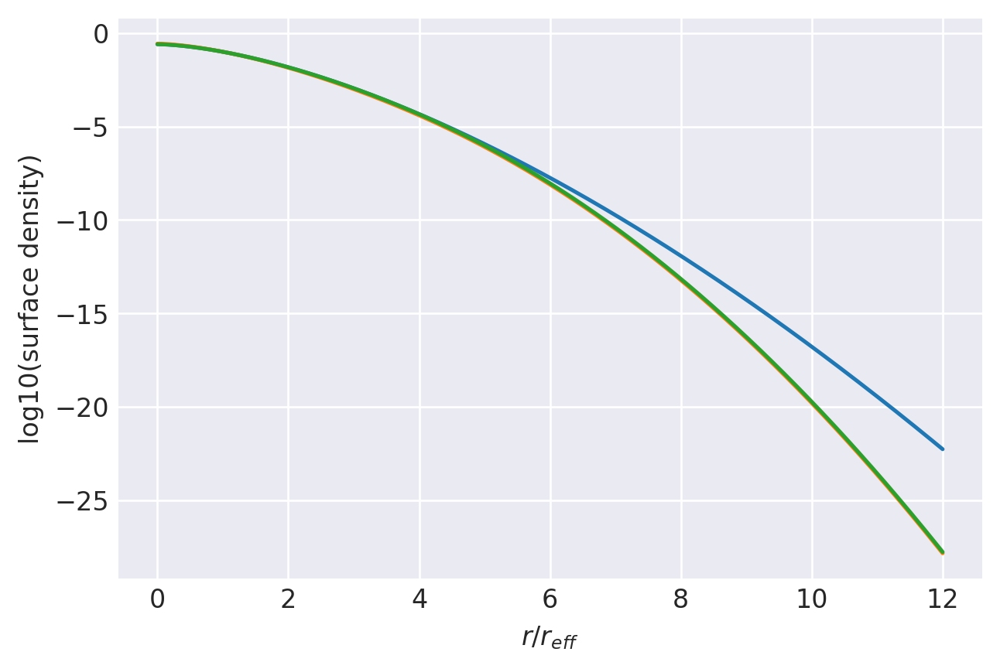

n=0.625: (
    normalize(np.array([2.6099719492e-01, 4.2275873840e-01, 2.4094764459e-01, 6.1858674645e-02, 1.0333654133e-02, 2.7211565707e-03, 3.3759375082e-04, 4.5342994264e-05])),
    np.array([1.2833504226e+00, 1.0627598647e+00, 8.4402813520e-01, 5.9217512270e-01, 4.0699848261e-01, 2.6230995013e-01, 1.5244203081e-01, 7.1669297996e-02]),
),
1.000000016395073 1.0000000176322972
prev.  chisq = -6.556155507394282
ws, re: (array([2.60997195e-01, 4.22758738e-01, 2.40947645e-01, 6.18586746e-02,
       1.03336541e-02, 2.72115657e-03, 3.37593751e-04, 4.53429943e-05]), array([1.22609613, 1.03282088, 0.83205466, 0.58736005, 0.40699848,
       0.26446032, 0.15495166, 0.07344638]))
         Current function value: -11.836975
         Iterations: 29
         Function evaluations: 947
         Gradient evaluations: 104
-11.836975130933217 [-0.78276955  0.44584328  1.28733792  1.57304091  1.20730323  1.95960465
  2.02975819]
1.000000016395073 1.0000000163863767


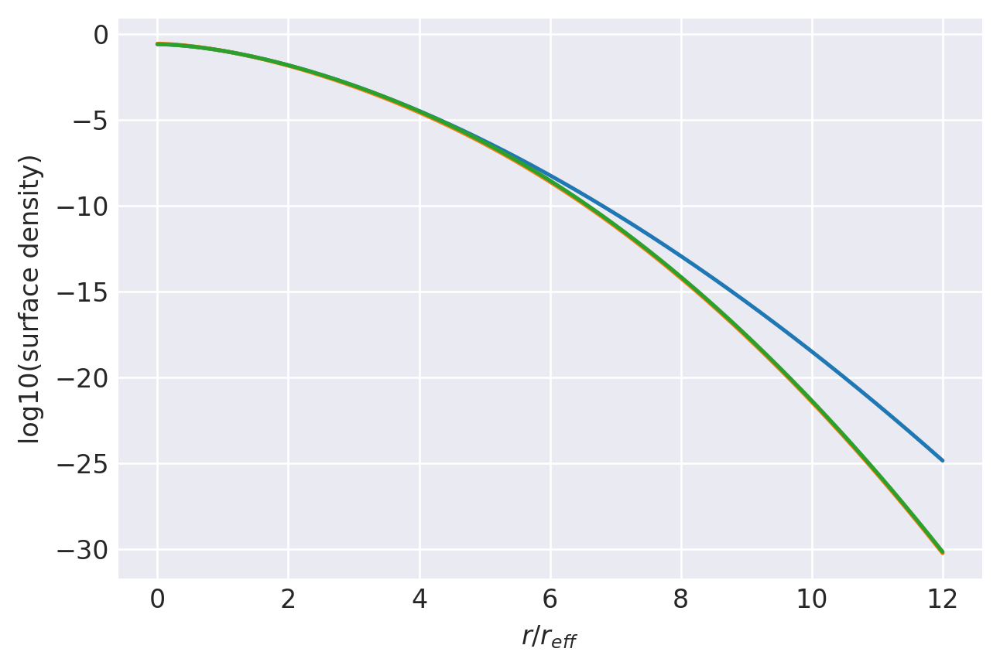

n=0.6: (
    normalize(np.array([3.1372329256e-01, 4.1838892696e-01, 2.0994265280e-01, 4.7991121392e-02, 7.6628074417e-03, 2.0082132442e-03, 2.5012708760e-04, 3.2858515965e-05])),
    np.array([1.2260961300e+00, 1.0328208769e+00, 8.3205465644e-01, 5.8736005161e-01, 4.0699848261e-01, 2.6446031949e-01, 1.5495165976e-01, 7.3446382611e-02]),
),
1.000000016180935 1.0000000166954655
prev.  chisq = -7.265314662967117
ws, re: (array([3.13723293e-01, 4.18388927e-01, 2.09942653e-01, 4.79911214e-02,
       7.66280744e-03, 2.00821324e-03, 2.50127088e-04, 3.28585160e-05]), array([1.20327248, 1.02074096, 0.82717447, 0.585389  , 0.40699848,
       0.26535078, 0.15599689, 0.07419078]))
         Current function value: -11.939089
         Iterations: 24
         Function evaluations: 882
         Gradient evaluations: 97
-11.939088844957453 [-0.66115399  0.5168265   1.34184435  1.58547392  1.21553107  1.94887991
  2.05103952]
1.000000016180935 1.0000000161741667


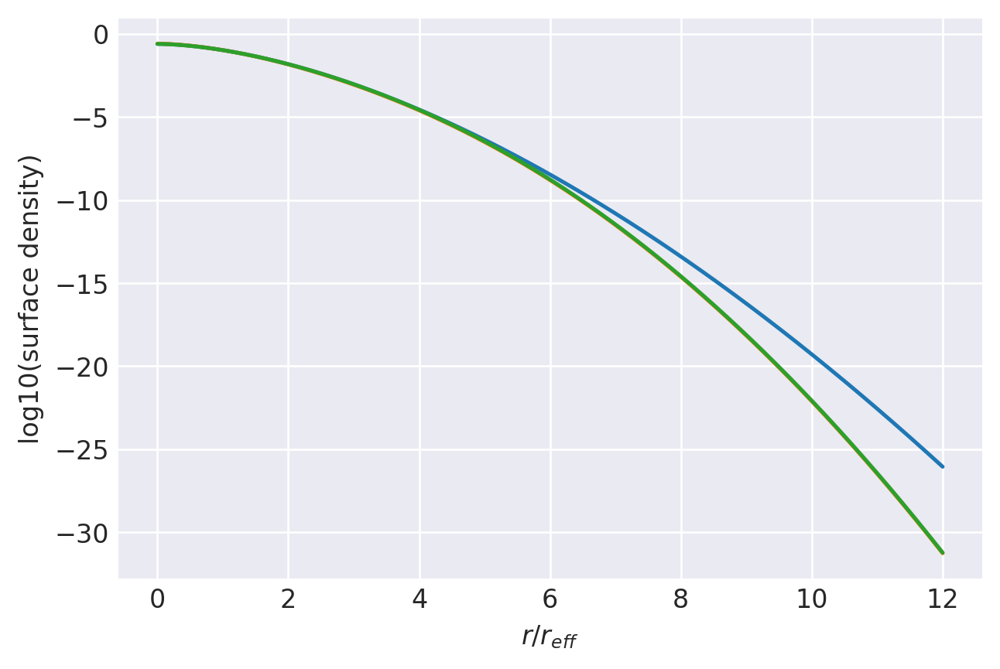

n=0.59: (
    normalize(np.array([3.4048043140e-01, 4.1312661743e-01, 1.9533862662e-01, 4.2373984655e-02, 6.6949390946e-03, 1.7378698767e-03, 2.1932542340e-04, 2.8205501710e-05])),
    np.array([1.2032724773e+00, 1.0207409564e+00, 8.2717446997e-01, 5.8538900026e-01, 4.0699848261e-01, 2.6535077843e-01, 1.5599688562e-01, 7.4190782895e-02]),
),
1.0000000159710858 1.000000016501344
prev.  chisq = -7.218008815630325
ws, re: (array([3.40480431e-01, 4.13126617e-01, 1.95338627e-01, 4.23739847e-02,
       6.69493909e-03, 1.73786988e-03, 2.19325423e-04, 2.82055017e-05]), array([1.18049443, 1.00859945, 0.82224022, 0.58339104, 0.40699848,
       0.26625954, 0.15706721, 0.07495565]))
         Current function value: -12.026897
         Iterations: 18
         Function evaluations: 1020
         Gradient evaluations: 112
-12.026896638241457 [-0.52565231  0.59389972  1.39952004  1.592594    1.22963666  1.92973471
  2.08250335]
1.0000000159710858 1.0000000159658968


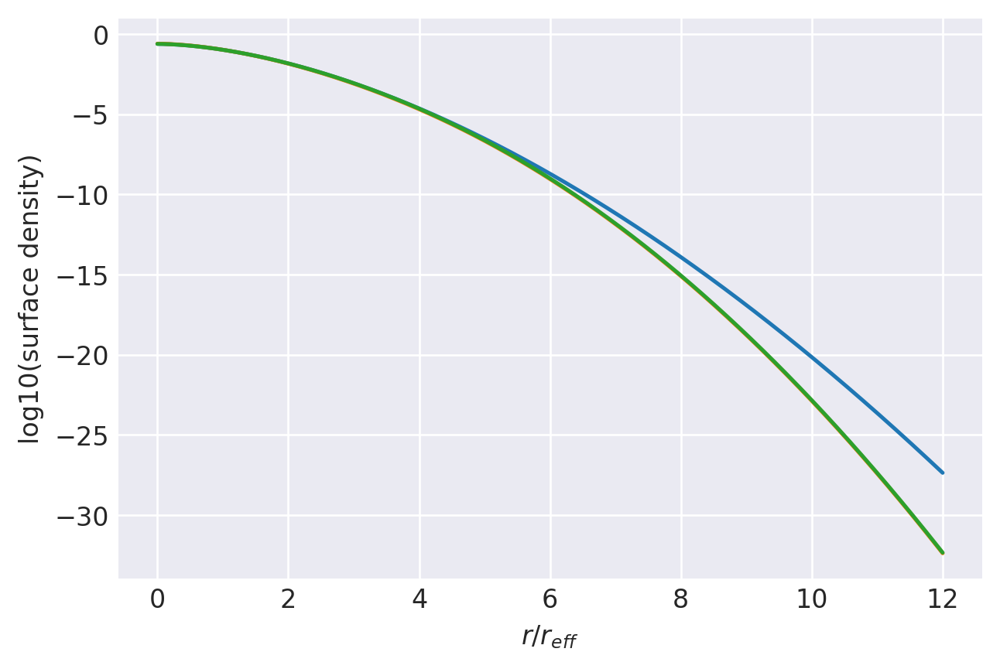

n=0.58: (
    normalize(np.array([3.7153148809e-01, 4.0489676054e-01, 1.7932862668e-01, 3.6765184855e-02, 5.7860931467e-03, 1.4773544501e-03, 1.9072454716e-04, 2.3767684661e-05])),
    np.array([1.1804944278e+00, 1.0085994528e+00, 8.2224021804e-01, 5.8339103895e-01, 4.0699848261e-01, 2.6625953525e-01, 1.5706721212e-01, 7.4955648308e-02]),
),
1.0000000157654723 1.0000000163131408
prev.  chisq = -7.168290509381998
ws, re: (array([3.71531488e-01, 4.04896761e-01, 1.79328627e-01, 3.67651849e-02,
       5.78609315e-03, 1.47735445e-03, 1.90724547e-04, 2.37676847e-05]), array([1.15776267, 0.99639498, 0.81725035, 0.58136533, 0.40699848,
       0.26718729, 0.15816369, 0.07574191]))
         Current function value: -12.095484
         Iterations: 21
         Function evaluations: 1037
         Gradient evaluations: 114
-12.09548358904281 [-0.37282801  0.67801199  1.46069618  1.59264185  1.25175657  1.89977548
  2.12696605]
1.0000000157654723 1.0000000157615545


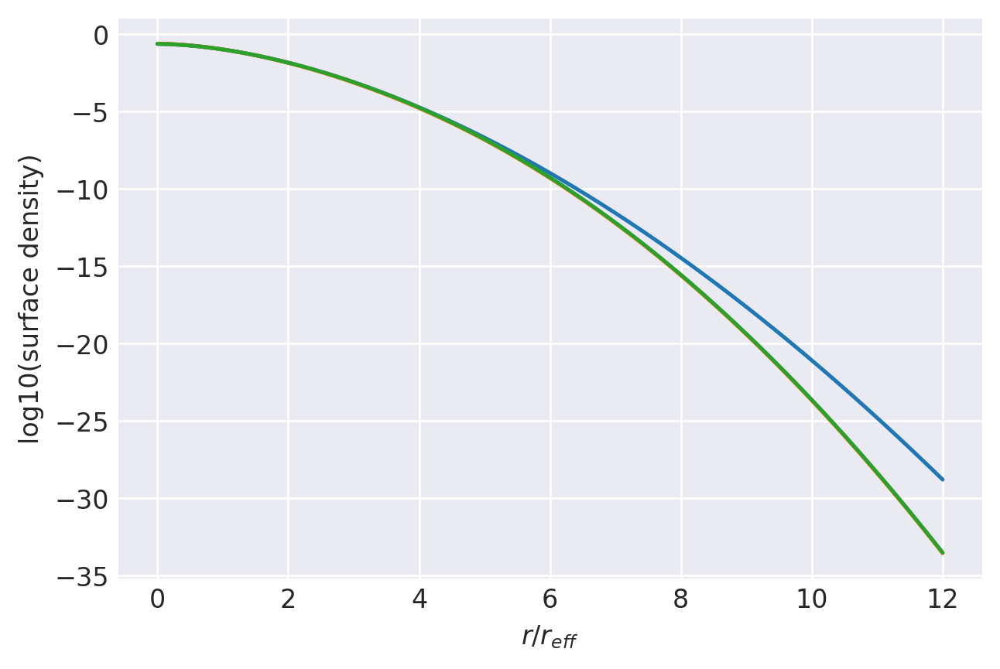

n=0.57: (
    normalize(np.array([4.0785785248e-01, 3.9276483697e-01, 1.6182242700e-01, 3.1207637577e-02, 4.9356424877e-03, 1.2279060332e-03, 1.6413305380e-04, 1.9564395427e-05])),
    np.array([1.1577626743e+00, 9.9639498193e-01, 8.1725035376e-01, 5.8136532669e-01, 4.0699848261e-01, 2.6718729131e-01, 1.5816369065e-01, 7.5741909117e-02]),
),
1.0000000155640396 1.0000000161312388
prev.  chisq = -7.115871350587226
ws, re: (array([4.07857852e-01, 3.92764837e-01, 1.61822427e-01, 3.12076376e-02,
       4.93564249e-03, 1.22790603e-03, 1.64133054e-04, 1.95643954e-05]), array([1.13507793, 0.9841261 , 0.81220326, 0.57931098, 0.40699848,
       0.26813479, 0.15928744, 0.07655056]))
         Current function value: -12.147786
         Iterations: 16
         Function evaluations: 812
         Gradient evaluations: 89
-12.147785806974197 [-0.19768971  0.77034928  1.52575687  1.58331296  1.28466344  1.85595811
  2.18793548]
1.0000000155640396 1.000000015561128


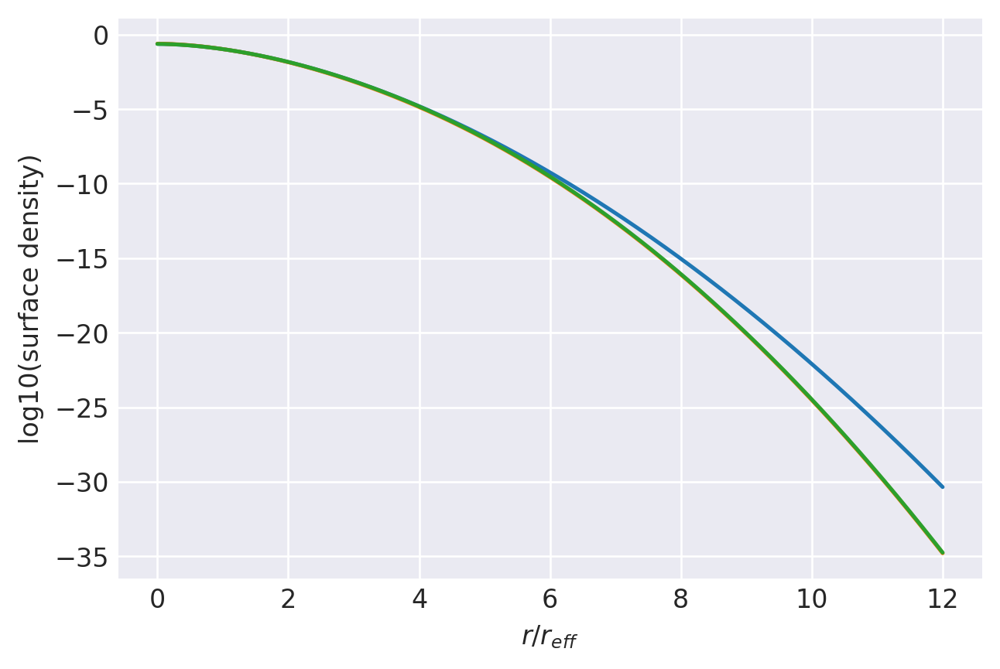

n=0.56: (
    normalize(np.array([4.5073790392e-01, 3.7547361660e-01, 1.4274718868e-01, 2.5754127142e-02, 4.1411315564e-03, 9.9111737243e-04, 1.3929326547e-04, 1.5621467014e-05])),
    np.array([1.1350779325e+00, 9.8412610389e-01, 8.1220325793e-01, 5.7931098086e-01, 4.0699848261e-01, 2.6813478777e-01, 1.5928743610e-01, 7.6550555182e-02]),
),
1.000000015366738 1.0000000159561337
prev.  chisq = -7.060403342064199
ws, re: (array([4.50737904e-01, 3.75473617e-01, 1.42747189e-01, 2.57541271e-02,
       4.14113156e-03, 9.91117372e-04, 1.39293265e-04, 1.56214670e-05]), array([1.11244094, 0.97179132, 0.80709723, 0.57722707, 0.40699848,
       0.26910281, 0.16043963, 0.07738264]))
         Current function value: -12.196401
         Iterations: 19
         Function evaluations: 1227
         Gradient evaluations: 135
-12.196401360393427 [0.00744574 0.87241964 1.59515468 1.56156595 1.33195503 1.79434735
 2.26978115]
1.000000015366738 1.000000015364611


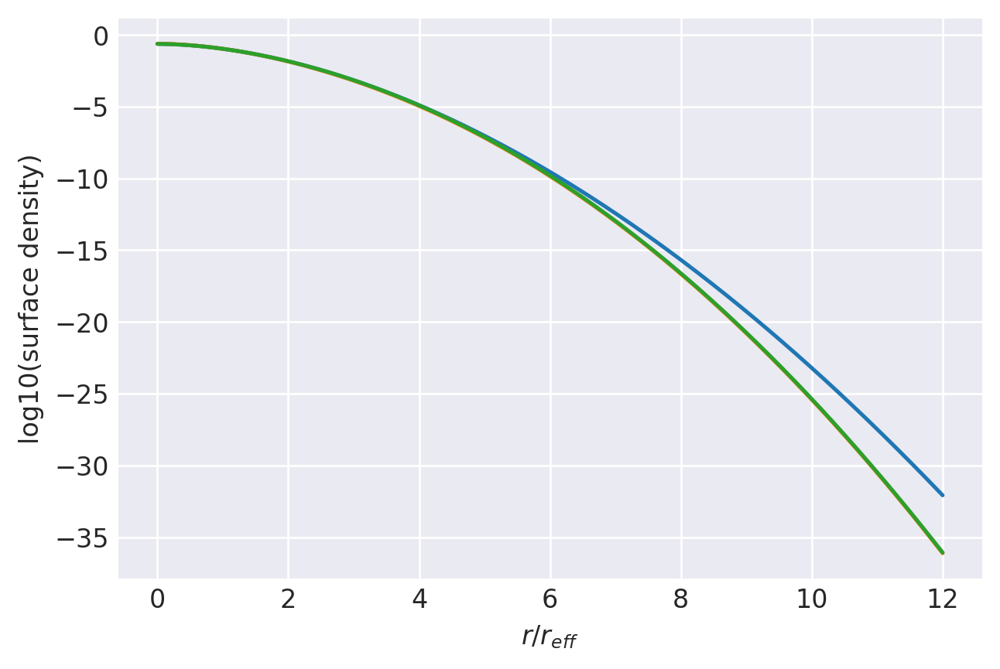

n=0.55: (
    normalize(np.array([5.0186142640e-01, 3.5131169403e-01, 1.2206307201e-01, 2.0469217092e-02, 3.3977246723e-03, 7.6902605266e-04, 1.1586668614e-04, 1.1973059914e-05])),
    np.array([1.1124409422e+00, 9.7179131932e-01, 8.0709723426e-01, 5.7722707438e-01, 4.0699848261e-01, 2.6910280858e-01, 1.6043963190e-01, 7.7382640919e-02]),
),
1.0000000152696222 1.000000015573802
prev.  chisq = -7.611958418443189
ws, re: (array([5.01861426e-01, 3.51311694e-01, 1.22063072e-01, 2.04692171e-02,
       3.39772467e-03, 7.69026053e-04, 1.15866686e-04, 1.19730599e-05]), array([1.10114059, 0.96559873, 0.80452157, 0.57617373, 0.40699848,
       0.26959477, 0.16102679, 0.07780782]))
         Current function value: -12.225509
         Iterations: 19
         Function evaluations: 1056
         Gradient evaluations: 116
-12.22550884515654 [0.12494242 0.92769481 1.6316444  1.54481913 1.36241237 1.75527174
 2.32050595]
1.0000000152696222 1.000000015267814


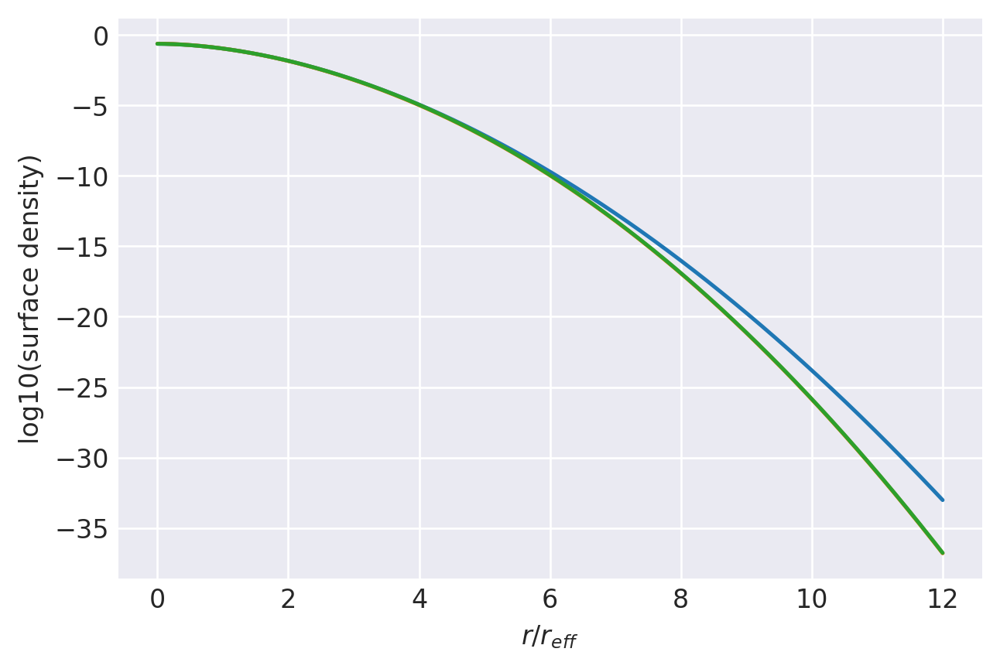

n=0.545: (
    normalize(np.array([5.3119503339e-01, 3.3594909797e-01, 1.1111995514e-01, 1.7913961609e-02, 3.0428527023e-03, 6.6427281862e-04, 1.0455643613e-04, 1.0269938465e-05])),
    np.array([1.1011405919e+00, 9.6559872645e-01, 8.0452157205e-01, 5.7617373328e-01, 4.0699848261e-01, 2.6959477312e-01, 1.6102678861e-01, 7.7807822162e-02]),
),
1.00000001517352 1.0000000154848567
prev.  chisq = -7.581091347752085
ws, re: (array([5.31195033e-01, 3.35949098e-01, 1.11119955e-01, 1.79139616e-02,
       3.04285270e-03, 6.64272819e-04, 1.04556436e-04, 1.02699385e-05]), array([1.08985247, 0.95938907, 0.8019305 , 0.57511263, 0.40699848,
       0.27009218, 0.16162154, 0.07823929]))
         Current function value: -12.262036
         Iterations: 17
         Function evaluations: 821
         Gradient evaluations: 90
-12.26203641631475 [0.25537284 0.98618397 1.66942701 1.52335728 1.39830521 1.70969084
 2.37860044]
1.00000001517352 1.000000015171995


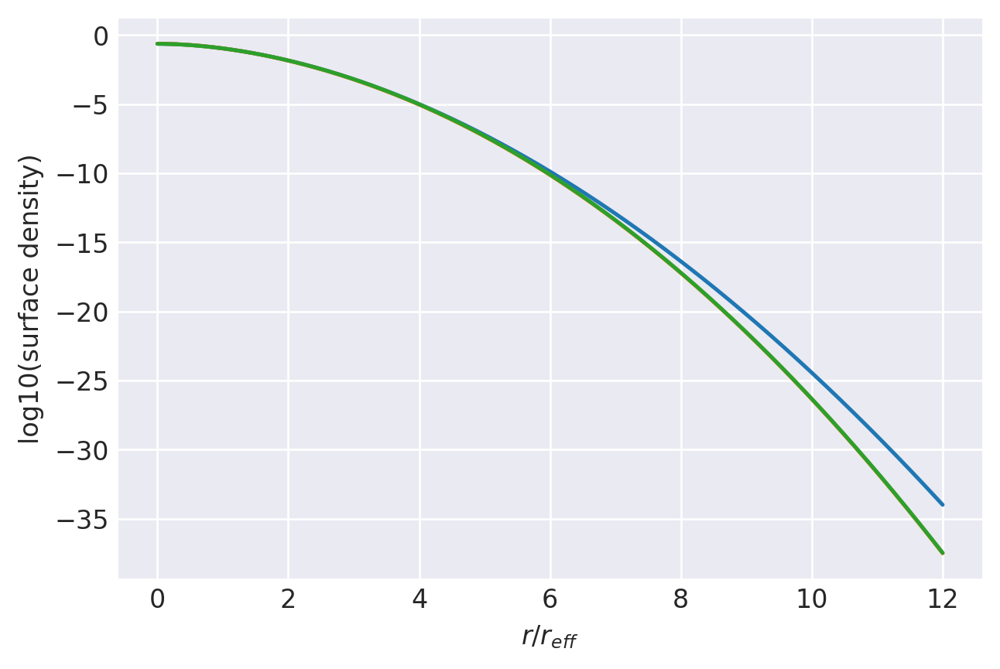

n=0.54: (
    normalize(np.array([5.6349849628e-01, 3.1791867916e-01, 9.9787377137e-02, 1.5431669887e-02, 2.6974630300e-03, 5.6423257658e-04, 9.3423425058e-05, 8.6585015208e-06])),
    np.array([1.0898524684e+00, 9.5938906599e-01, 8.0193050422e-01, 5.7511263265e-01, 4.0699848261e-01, 2.7009218384e-01, 1.6162153560e-01, 7.8239290788e-02]),
),
1.0000000150784267 1.0000000153974935
prev.  chisq = -7.549147220580868
ws, re: (array([5.63498496e-01, 3.17918679e-01, 9.97873771e-02, 1.54316699e-02,
       2.69746303e-03, 5.64232577e-04, 9.34234251e-05, 8.65850152e-06]), array([1.07857667, 0.95316213, 0.79932379, 0.57404364, 0.40699848,
       0.27059515, 0.16222404, 0.0786772 ]))
         Current function value: -12.309954
         Iterations: 22
         Function evaluations: 1164
         Gradient evaluations: 128
-12.309954307192077 [0.40208326 1.04823393 1.70859361 1.49642868 1.44051685 1.65644198
 2.44590173]
1.0000000150784267 1.0000000150771475


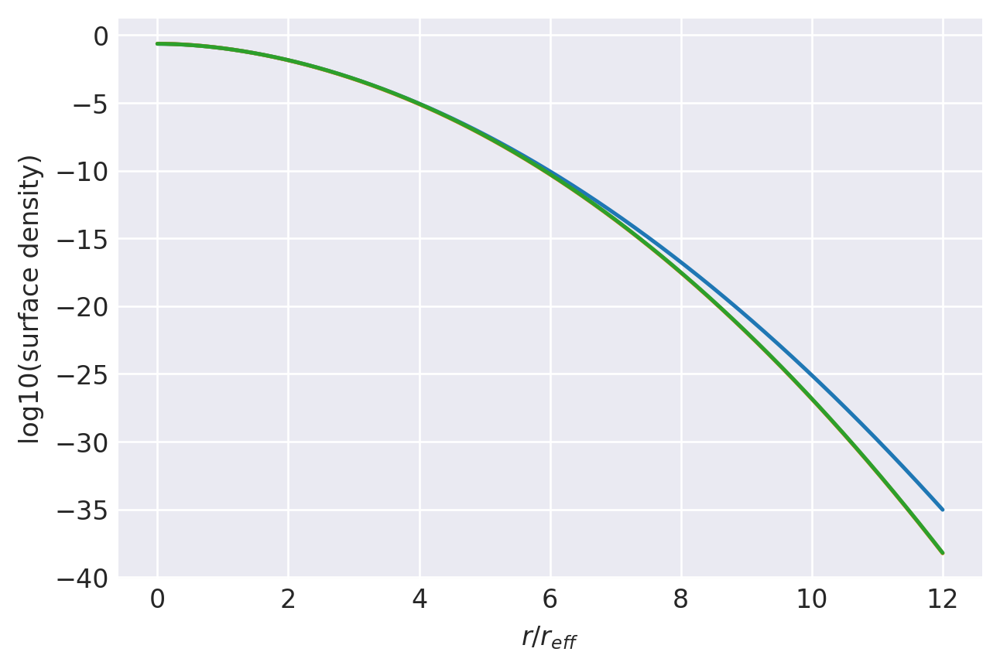

n=0.535: (
    normalize(np.array([5.9918808196e-01, 2.9677542159e-01, 8.8082893011e-02, 1.3034751655e-02, 2.3599928831e-03, 4.6930724393e-04, 8.2410922273e-05, 7.1407388649e-06])),
    np.array([1.0785766716e+00, 9.5316213221e-01, 7.9932379468e-01, 5.7404364267e-01, 4.0699848261e-01, 2.7059515228e-01, 1.6222404265e-01, 7.8677199293e-02]),
),
1.000000014984337 1.0000000153117834
prev.  chisq = -7.516038403767653
ws, re: (array([5.99188082e-01, 2.96775422e-01, 8.80828930e-02, 1.30347517e-02,
       2.35999288e-03, 4.69307244e-04, 8.24109223e-05, 7.14073886e-06]), array([1.0673133 , 0.94691771, 0.7967012 , 0.57296663, 0.40699848,
       0.27110379, 0.16283448, 0.07912171]))
         Current function value: -12.374396
         Iterations: 19
         Function evaluations: 1020
         Gradient evaluations: 112
-12.37439588561472 [0.56996489 1.11425594 1.74923191 1.46320233 1.48990383 1.59457057
 2.52303014]
1.000000014984337 1.0000000149832764


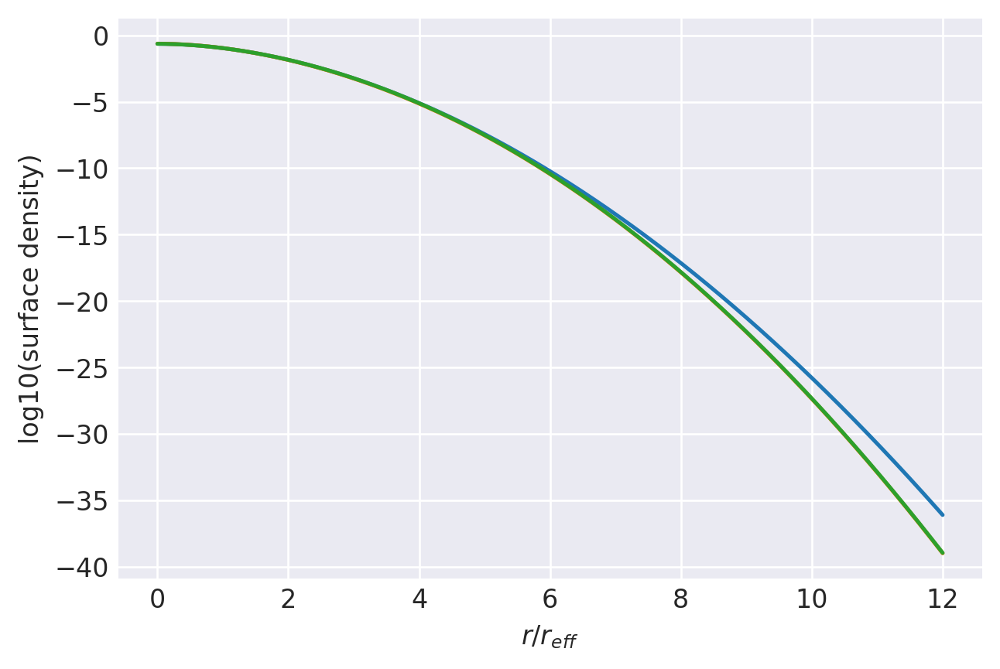

n=0.53: (
    normalize(np.array([6.3875507340e-01, 2.7198914397e-01, 7.6033064829e-02, 1.0737137406e-02, 2.0283922703e-03, 3.8004136368e-04, 7.1417886623e-05, 5.7288694628e-06])),
    np.array([1.0673133028e+00, 9.4691771495e-01, 7.9670120149e-01, 5.7296663012e-01, 4.0699848261e-01, 2.7110379338e-01, 1.6283448496e-01, 7.9121705340e-02]),
),
1.000000014891245 1.0000000152278234
prev.  chisq = -7.481665722747167
ws, re: (array([6.38755073e-01, 2.71989144e-01, 7.60330648e-02, 1.07371374e-02,
       2.02839227e-03, 3.80041364e-04, 7.14178866e-05, 5.72886946e-06]), array([1.05606247, 0.9406556 , 0.79406248, 0.57188146, 0.40699848,
       0.27161823, 0.16345304, 0.07957297]))
         Current function value: -12.462641
         Iterations: 20
         Function evaluations: 1065
         Gradient evaluations: 117
-12.462640665040627 [0.76659108 1.18473379 1.79144781 1.42265659 1.5475832  1.52255516
 2.61152303]
1.000000014891245 1.0000000148903838


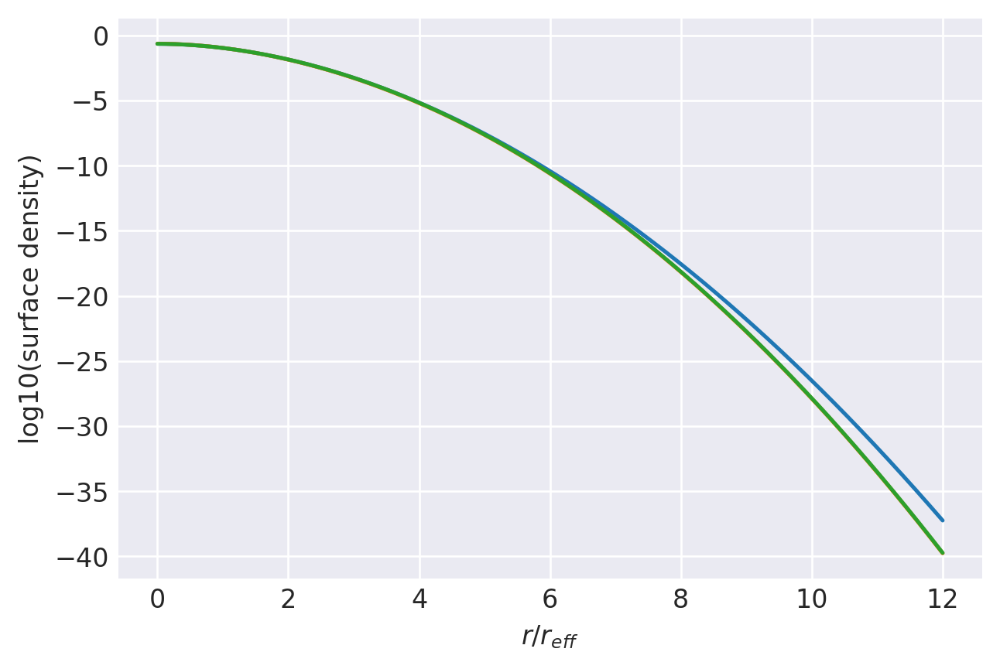

n=0.525: (
    normalize(np.array([6.8278301465e-01, 2.4292409615e-01, 6.3676783770e-02, 8.5539752337e-03, 1.7003591408e-03, 2.9698308173e-04, 6.0356445549e-05, 4.4315291824e-06])),
    np.array([1.0560624656e+00, 9.4065559947e-01, 7.9406247663e-01, 5.7188145825e-01, 4.0699848261e-01, 2.7161822553e-01, 1.6345304341e-01, 7.9572971987e-02]),
),
1.000000014799145 1.0000000151457247
prev.  chisq = -7.445916721893174
ws, re: (array([6.82783015e-01, 2.42924096e-01, 6.36767838e-02, 8.55397523e-03,
       1.70035914e-03, 2.96983082e-04, 6.03564455e-05, 4.43152918e-06]), array([1.04482427, 0.93437557, 0.79140737, 0.57078799, 0.40699848,
       0.27213857, 0.1640799 , 0.08003117]))
         Current function value: -12.586231
         Iterations: 22
         Function evaluations: 1163
         Gradient evaluations: 128
-12.586231304434444 [1.0046365  1.26024005 1.83537704 1.37351959 1.6150098  1.43819317
 2.71527625]
1.000000014799145 1.0000000147984613


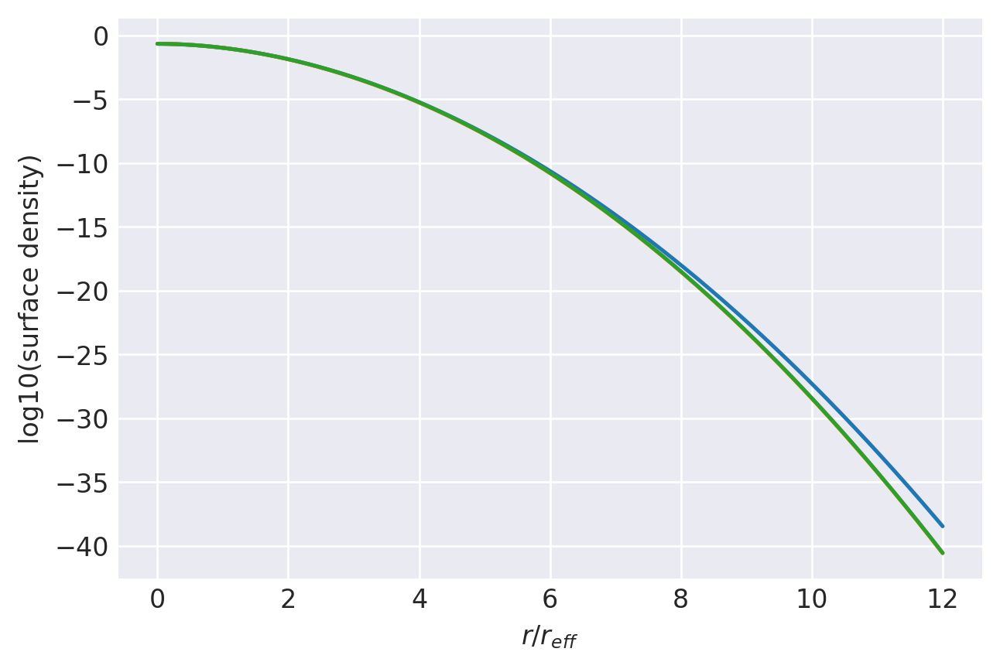

n=0.52: (
    normalize(np.array([7.3196919232e-01, 2.0881407192e-01, 5.1068574515e-02, 6.5018106068e-03, 1.3732305680e-03, 2.2072873063e-04, 4.9138994140e-05, 3.2523462096e-06])),
    np.array([1.0448242651e+00, 9.3437556634e-01, 7.9140736581e-01, 5.7078798666e-01, 4.0699848261e-01, 2.7213857077e-01, 1.6407990475e-01, 8.0031167928e-02]),
),
1.0000000147625825 1.00000001490438
prev.  chisq = -8.20980101105586
ws, re: (array([7.31969192e-01, 2.08814072e-01, 5.10685745e-02, 6.50181061e-03,
       1.37323057e-03, 2.20728731e-04, 4.91389941e-05, 3.25234621e-06]), array([1.04033255, 0.93185849, 0.79034068, 0.57034824, 0.40699848,
       0.27234839, 0.16433302, 0.08021643]))
         Current function value: -12.649720
         Iterations: 22
         Function evaluations: 1055
         Gradient evaluations: 116
-12.649719831590726 [1.11612984 1.29200457 1.85345081 1.3511648  1.64495227 1.40073138
 2.76008758]
1.0000000147625825 1.0000000147619703


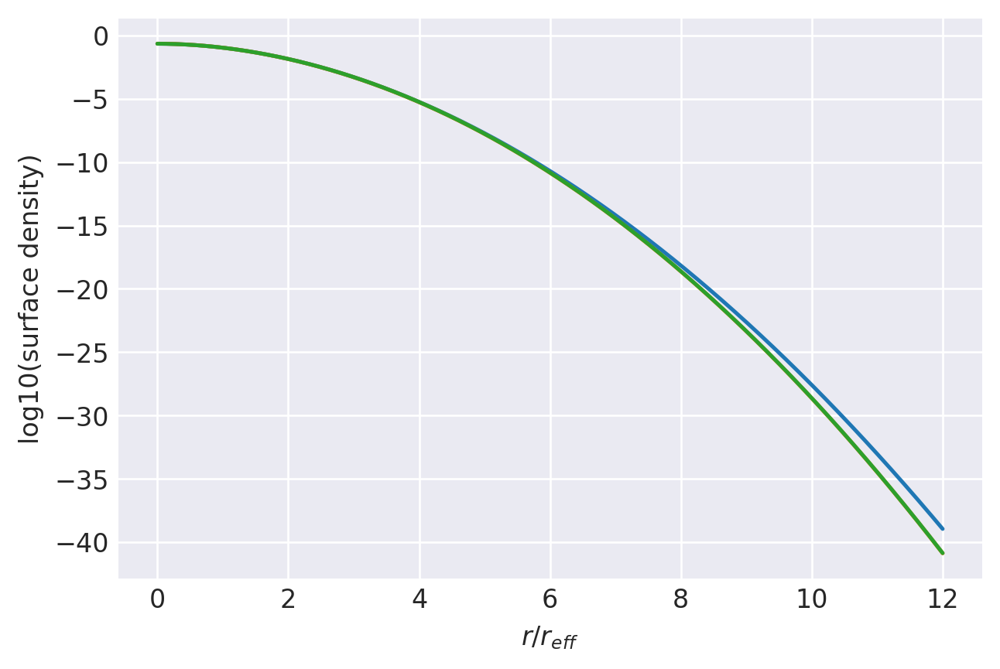

n=0.518: (
    normalize(np.array([7.5327013658e-01, 1.9355619523e-01, 4.5970324903e-02, 5.7217595931e-03, 1.2418748103e-03, 1.9231841549e-04, 4.4569809178e-05, 2.8206549857e-06])),
    np.array([1.0403325471e+00, 9.3185848607e-01, 7.9034067523e-01, 5.7034824193e-01, 4.0699848261e-01, 2.7234839259e-01, 1.6433301709e-01, 8.0216425408e-02]),
),
1.0000000147261765 1.000000014869878
prev.  chisq = -8.194461717783273
ws, re: (array([7.53270137e-01, 1.93556195e-01, 4.59703249e-02, 5.72175959e-03,
       1.24187481e-03, 1.92318415e-04, 4.45698092e-05, 2.82065499e-06]), array([1.03584288, 0.92933849, 0.7892713 , 0.56990714, 0.40699848,
       0.27255919, 0.1645875 , 0.08040283]))
         Current function value: -12.724069
         Iterations: 20
         Function evaluations: 820
         Gradient evaluations: 90
-12.724068746156316 [1.24014603 1.32473844 1.87182009 1.32711492 1.67678269 1.36072343
 2.80862629]
1.0000000147261765 1.0000000147256325


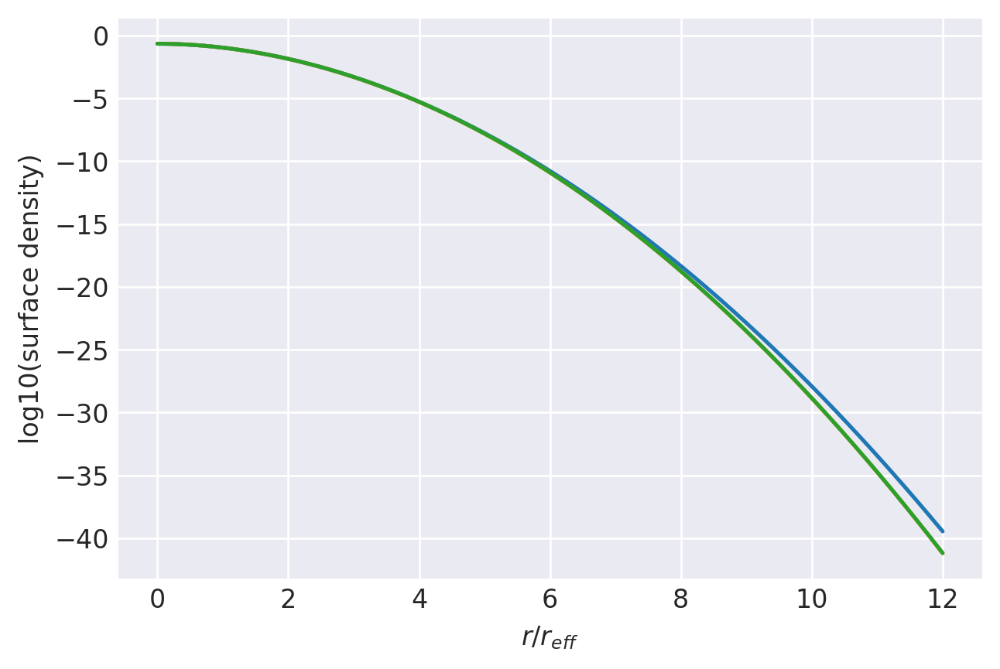

n=0.516: (
    normalize(np.array([7.7558943163e-01, 1.7727738776e-01, 4.0848854081e-02, 4.9668992165e-03, 1.1099035731e-03, 1.6516342092e-04, 3.9951716791e-05, 2.4085992607e-06])),
    np.array([1.0358428751e+00, 9.2933848856e-01, 7.8927130424e-01, 5.6990713680e-01, 4.0699848261e-01, 2.7255918881e-01, 1.6458750131e-01, 8.0402830884e-02]),
),
1.0000000146899282 1.0000000148356074
prev.  chisq = -8.178847367336305
ws, re: (array([7.75589432e-01, 1.77277388e-01, 4.08488541e-02, 4.96689922e-03,
       1.10990357e-03, 1.65163421e-04, 3.99517168e-05, 2.40859926e-06]), array([1.03135526, 0.92681556, 0.78819924, 0.56946466, 0.40699848,
       0.27277097, 0.16484337, 0.0805904 ]))
         Current function value: -12.812185
         Iterations: 20
         Function evaluations: 1344
         Gradient evaluations: 147
-12.812185081870677 [1.38001351 1.35849072 1.8905138  1.30120032 1.71070571 1.31796802
 2.8602476 ]
1.0000000146899282 1.000000014689451


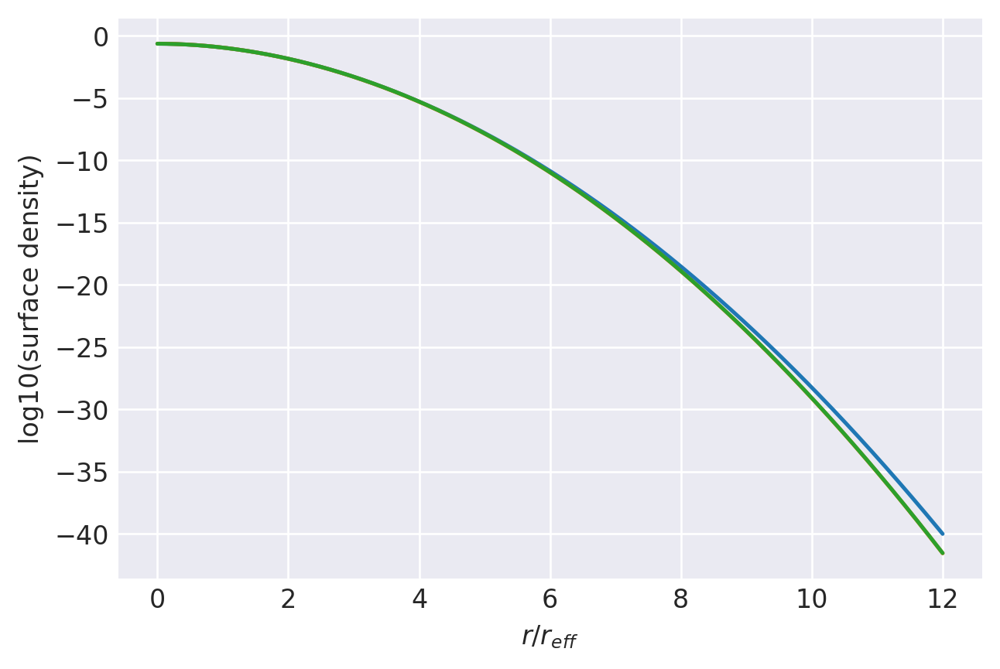

n=0.514: (
    normalize(np.array([7.9899316921e-01, 1.5990380647e-01, 3.5710887171e-02, 4.2384189024e-03, 9.7711604708e-04, 1.3931148321e-04, 3.5271270163e-05, 2.0194418417e-06])),
    np.array([1.0313552560e+00, 9.2681555911e-01, 7.8819923570e-01, 5.6946466178e-01, 4.0699848261e-01, 2.7277096777e-01, 1.6484337022e-01, 8.0590395959e-02]),
),
1.0000000146538368 1.0000000148015757
prev.  chisq = -8.162946971047306
ws, re: (array([7.98993169e-01, 1.59903806e-01, 3.57108872e-02, 4.23841890e-03,
       9.77116047e-04, 1.39311483e-04, 3.52712702e-05, 2.01944184e-06]), array([1.0268697 , 0.92428968, 0.78712445, 0.56902081, 0.40699848,
       0.27298374, 0.16510064, 0.08077913]))
         Current function value: -12.918315
         Iterations: 21
         Function evaluations: 917
         Gradient evaluations: 101
-12.918315493990876 [1.54060391 1.39332694 1.90953023 1.27332118 1.7468213  1.27211648
 2.91518672]
1.0000000146538368 1.0000000146534274


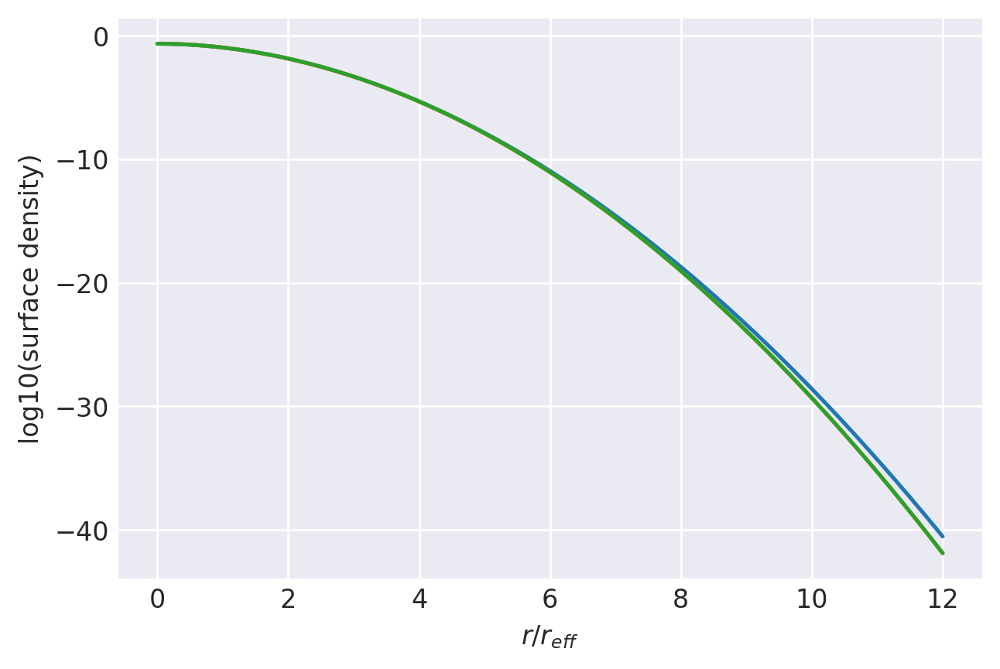

n=0.512: (
    normalize(np.array([8.2355249852e-01, 1.4135612329e-01, 3.0563410006e-02, 3.5377502180e-03, 8.4322152425e-04, 1.1481963468e-04, 3.0522667684e-05, 1.6541427379e-06])),
    np.array([1.0268696968e+00, 9.2428968288e-01, 7.8712445227e-01, 5.6902080726e-01, 4.0699848261e-01, 2.7298373789e-01, 1.6510063678e-01, 8.0779132403e-02]),
),
1.000000014617902 1.0000000147677899
prev.  chisq = -8.146748607681241
ws, re: (array([8.23552499e-01, 1.41356123e-01, 3.05634100e-02, 3.53775022e-03,
       8.43221524e-04, 1.14819635e-04, 3.05226677e-05, 1.65414274e-06]), array([1.0223862 , 0.92176084, 0.78604694, 0.56857556, 0.40699848,
       0.27319751, 0.16535931, 0.08096905]))
         Current function value: -13.049033
         Iterations: 23
         Function evaluations: 980
         Gradient evaluations: 108
-13.049032850477042 [1.72947064 1.42931592 1.92886453 1.24338782 1.78513477 1.22331096
 2.97392354]
1.000000014617902 1.0000000146175585


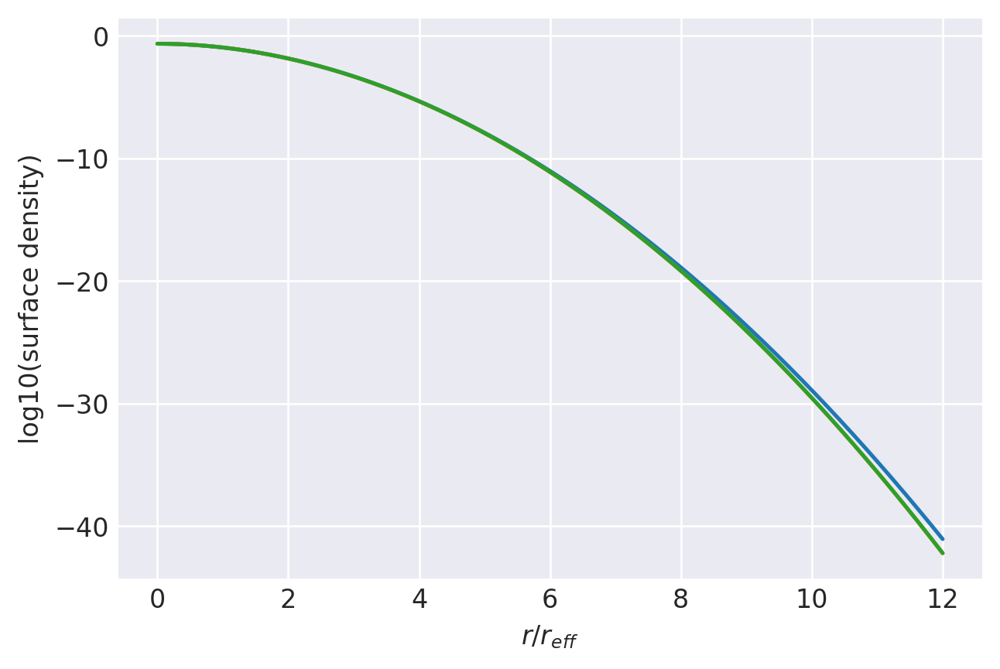

n=0.51: (
    normalize(np.array([8.4934469629e-01, 1.2154790138e-01, 2.5414362440e-02, 2.8663645915e-03, 7.0790665304e-04, 9.1766084840e-05, 2.5689755528e-05, 1.3128085204e-06])),
    np.array([1.0223862047e+00, 9.2176084490e-01, 7.8604693641e-01, 5.6857556352e-01, 4.0699848261e-01, 2.7319750772e-01, 1.6535931412e-01, 8.0969052148e-02]),
),
1.0000000145999934 1.000000014675726
prev.  chisq = -8.734062561841988
ws, re: (array([8.49344696e-01, 1.21547901e-01, 2.54143624e-02, 2.86636459e-03,
       7.07906653e-04, 9.17660848e-05, 2.56897555e-05, 1.31280852e-06]), array([1.02014524, 0.92049531, 0.78550715, 0.56835242, 0.40699848,
       0.27330477, 0.16548919, 0.08106446]))
         Current function value: -13.126773
         Iterations: 26
         Function evaluations: 1791
         Gradient evaluations: 197
-13.12677328266745 [1.83814428 1.44775809 1.93868674 1.22749941 1.80538672 1.19716985
 3.00540426]
1.0000000145999934 1.000000014599683


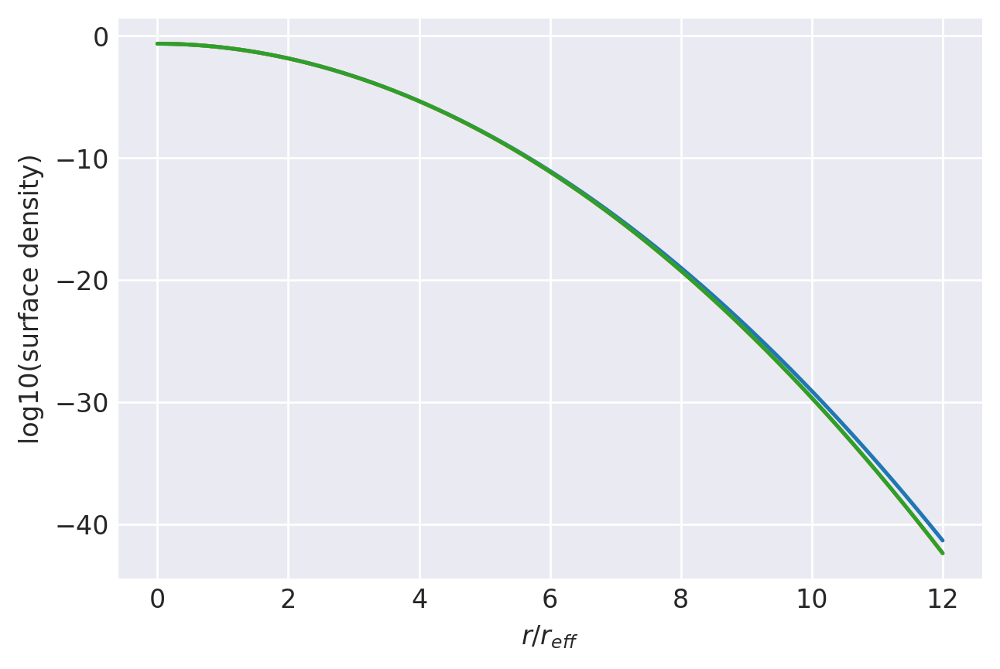

n=0.509: (
    normalize(np.array([8.6272908630e-01, 1.1114182942e-01, 2.2842249206e-02, 2.5419745249e-03, 6.3968876885e-04, 8.0774130388e-05, 2.3246514064e-05, 1.1511378976e-06])),
    np.array([1.0201452361e+00, 9.2049531053e-01, 7.8550714830e-01, 5.6835241762e-01, 4.0699848261e-01, 2.7330477022e-01, 1.6548918599e-01, 8.1064459535e-02]),
),
1.0000000145821235 1.0000000146584496
prev.  chisq = -8.725693009703239
ws, re: (array([8.62729086e-01, 1.11141829e-01, 2.28422492e-02, 2.54197452e-03,
       6.39688769e-04, 8.07741304e-05, 2.32465141e-05, 1.15113790e-06]), array([1.01790479, 0.91922903, 0.78496667, 0.56812892, 0.40699848,
       0.27341229, 0.16561942, 0.08116017]))
         Current function value: -13.215337
         Iterations: 31
         Function evaluations: 1227
         Gradient evaluations: 135
-13.21533736348015 [1.95926854 1.46650726 1.94862342 1.21092189 1.82669314 1.16902668
 3.04244135]
1.0000000145821235 1.0000000145818433


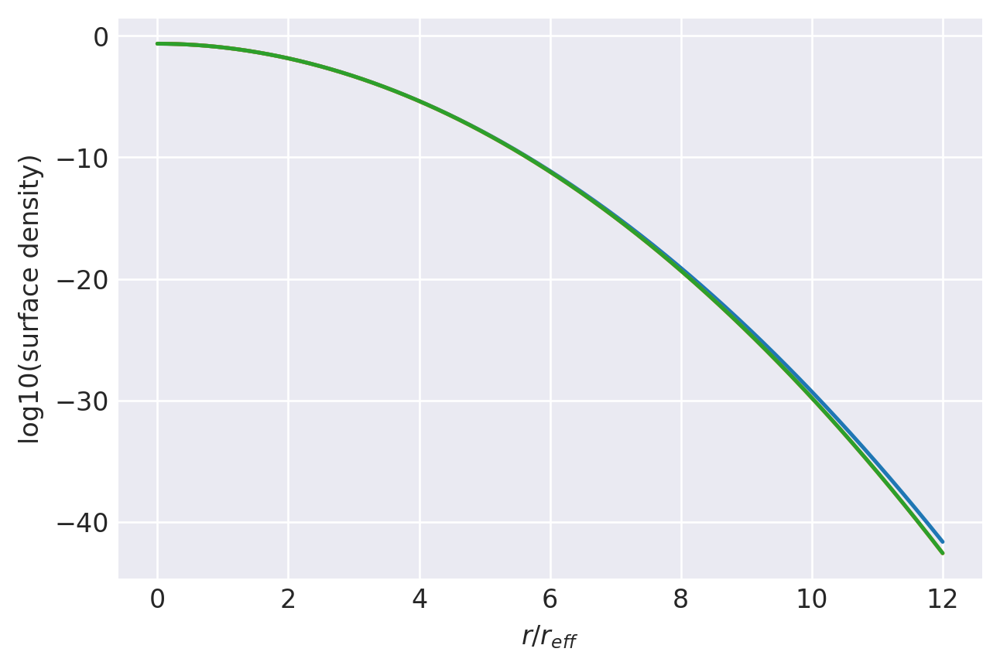

n=0.508: (
    normalize(np.array([8.7645376939e-01, 1.0038451549e-01, 2.0273367304e-02, 2.2253623113e-03, 5.7107404161e-04, 7.0125599132e-05, 2.0793626493e-05, 9.9223547090e-07])),
    np.array([1.0179047869e+00, 9.1922903005e-01, 7.8496667043e-01, 5.6812892073e-01, 4.0699848261e-01, 2.7341228590e-01, 1.6561941557e-01, 8.1160167299e-02]),
),
1.0000000145642924 1.000000014641221
prev.  chisq = -8.717240314315093
ws, re: (array([8.76453769e-01, 1.00384515e-01, 2.02733673e-02, 2.22536231e-03,
       5.71074042e-04, 7.01255991e-05, 2.07936265e-05, 9.92235471e-07]), array([1.01566486, 0.917962  , 0.7844255 , 0.56790507, 0.40699848,
       0.27352006, 0.16575   , 0.08125618]))
         Current function value: -13.317616
         Iterations: 30
         Function evaluations: 1406
         Gradient evaluations: 155
-13.317615541212826 [2.09616512 1.48560849 1.95855626 1.19406901 1.84749845 1.14296141
 3.07091745]
1.0000000145642924 1.0000000145640486


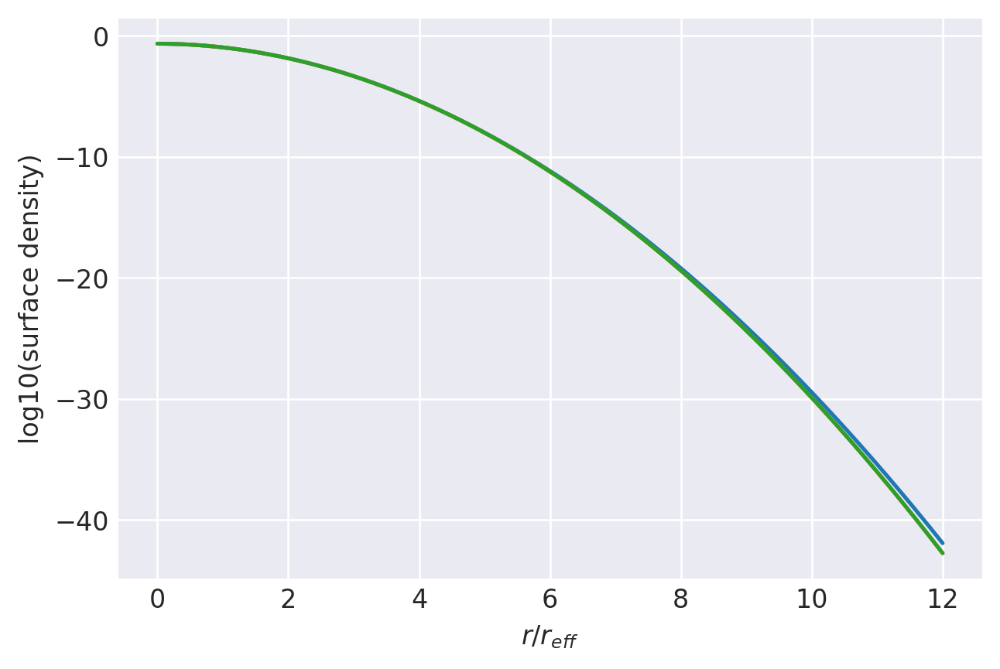

n=0.507: (
    normalize(np.array([8.9052988922e-01, 8.9263922450e-02, 1.7708231070e-02, 1.9171022956e-03, 5.0176176043e-04, 5.9970283261e-05, 1.8275338331e-05, 8.4758433427e-07])),
    np.array([1.0156648580e+00, 9.1796200154e-01, 7.8442550056e-01, 5.6790507160e-01, 4.0699848261e-01, 2.7352005585e-01, 1.6575000453e-01, 8.1256176980e-02]),
),
1.000000014546501 1.0000000146240517
prev.  chisq = -8.708702899062837
ws, re: (array([8.90529889e-01, 8.92639224e-02, 1.77082311e-02, 1.91710230e-03,
       5.01761760e-04, 5.99702833e-05, 1.82753383e-05, 8.47584334e-07]), array([1.01342545, 0.91669422, 0.78388364, 0.56768087, 0.40699848,
       0.27362808, 0.16588095, 0.08135249]))
         Current function value: -13.437839
         Iterations: 35
         Function evaluations: 1569
         Gradient evaluations: 173
-13.437839344495117 [2.25371204 1.50501706 1.96867207 1.17629226 1.86983524 1.11383531
 3.10573518]
1.000000014546501 1.0000000145462913


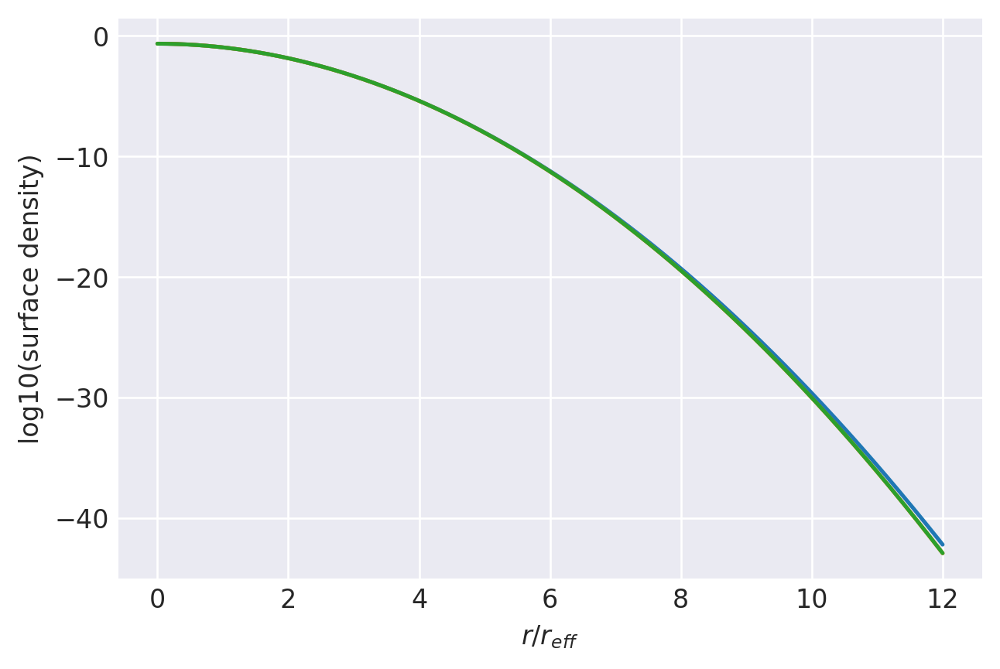

n=0.506: (
    normalize(np.array([9.0497024754e-01, 7.7764895442e-02, 1.5149366619e-02, 1.6168280315e-03, 4.3206062801e-04, 5.0140682061e-05, 1.5755349674e-05, 7.0570695410e-07])),
    np.array([1.0134254504e+00, 9.1669422309e-01, 7.8388363644e-01, 5.6768086897e-01, 4.0699848261e-01, 2.7362808119e-01, 1.6588095460e-01, 8.1352490130e-02]),
),
1.0000000145287486 1.000000014606932
prev.  chisq = -8.700079017025903
ws, re: (array([9.04970248e-01, 7.77648954e-02, 1.51493666e-02, 1.61682803e-03,
       4.32060628e-04, 5.01406821e-05, 1.57553497e-05, 7.05706954e-07]), array([1.01118656, 0.91542569, 0.78334108, 0.56745631, 0.40699848,
       0.27373636, 0.16601227, 0.08144911]))
         Current function value: -13.582568
         Iterations: 59
         Function evaluations: 1703
         Gradient evaluations: 188
-13.58256800909094 [2.43945162 1.52482119 1.97872436 1.15830313 1.89168765 1.08617693
 3.12640905]
1.0000000145287486 1.000000014528583


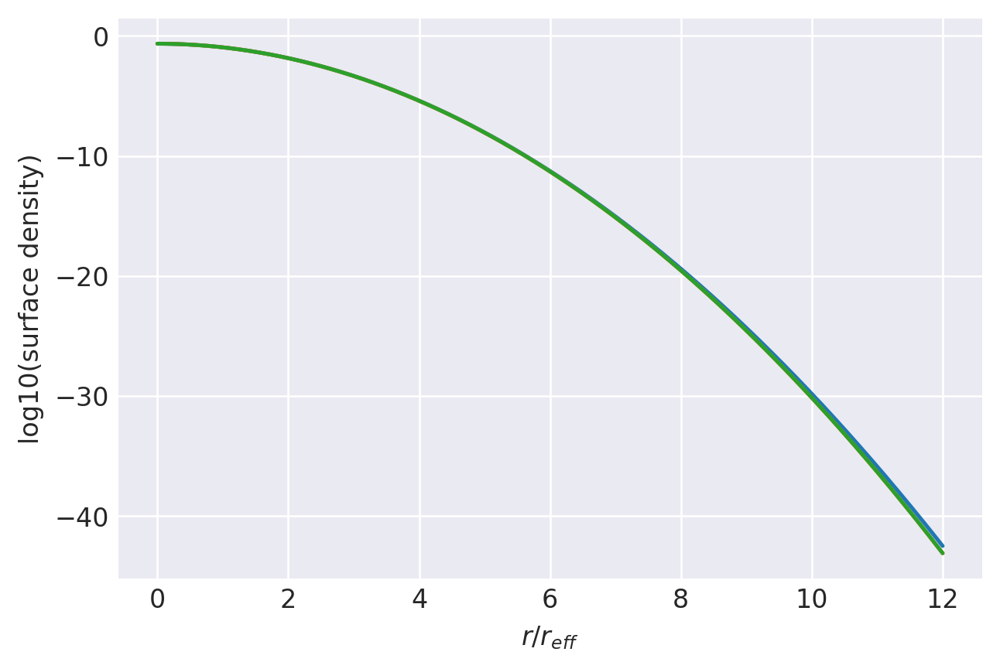

n=0.505: (
    normalize(np.array([9.1978663802e-01, 6.5875009211e-02, 1.2596889736e-02, 1.3252955933e-03, 3.6162779264e-04, 4.0777171354e-05, 1.3184022145e-05, 5.7844986723e-07])),
    np.array([1.0111865650e+00, 9.1542569277e-01, 7.8334107580e-01, 5.6745631160e-01, 4.0699848261e-01, 2.7373636301e-01, 1.6601226749e-01, 8.1449108310e-02]),
),
1.0000000145110344 1.0000000145898769
prev.  chisq = -8.691366693699027
ws, re: (array([9.19786638e-01, 6.58750092e-02, 1.25968897e-02, 1.32529559e-03,
       3.61627793e-04, 4.07771714e-05, 1.31840221e-05, 5.78449867e-07]), array([1.0089482 , 0.91415641, 0.78279782, 0.5672314 , 0.40699848,
       0.2738449 , 0.16614394, 0.08154603]))
         Current function value: -13.762795
         Iterations: 25
         Function evaluations: 1649
         Gradient evaluations: 181
-13.762794519693669 [2.66604912 1.54491512 1.989114   1.13887611 1.91653772 1.05225908
 3.18351902]
1.0000000145110344 1.0000000145108903


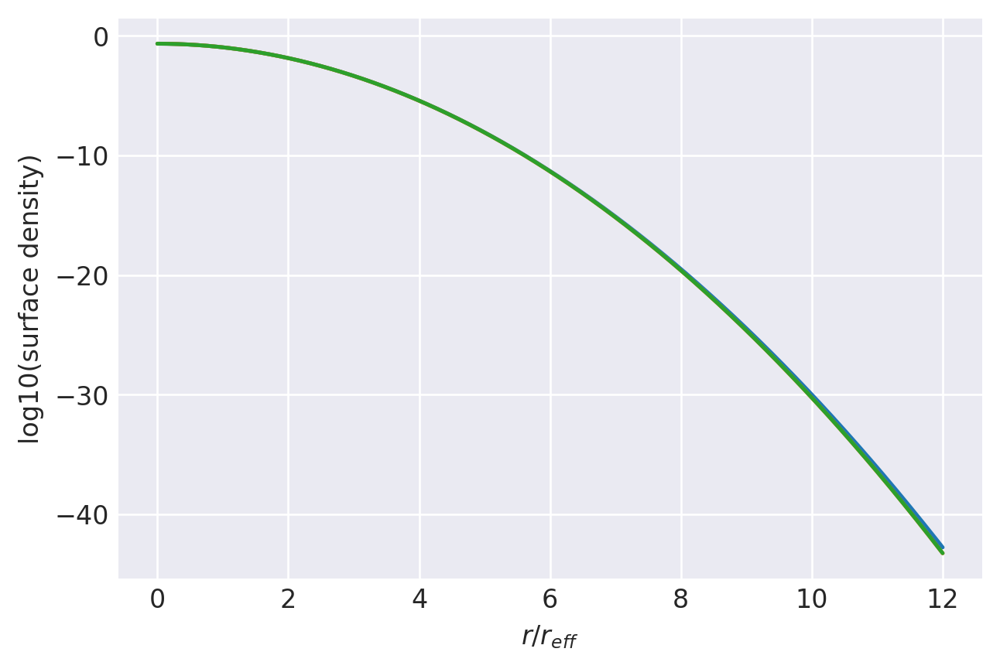

n=0.504: (
    normalize(np.array([9.3499330605e-01, 5.3577093716e-02, 1.0054040662e-02, 1.0419495572e-03, 2.9082514962e-04, 3.1712507187e-05, 1.0631785117e-05, 4.4057661952e-07])),
    np.array([1.0089482026e+00, 9.1415640864e-01, 7.8279781637e-01, 5.6723139821e-01, 4.0699848261e-01, 2.7384490244e-01, 1.6614394491e-01, 8.1546033092e-02]),
),
1.000000014493359 1.0000000145728516
prev.  chisq = -8.682564022034384
ws, re: (array([9.34993306e-01, 5.35770937e-02, 1.00540407e-02, 1.04194956e-03,
       2.90825150e-04, 3.17125072e-05, 1.06317851e-05, 4.40576620e-07]), array([1.00671036, 0.91288637, 0.78225386, 0.56700613, 0.40699848,
       0.2739537 , 0.16627599, 0.08164327]))
         Current function value: -13.999115
         Iterations: 25
         Function evaluations: 1352
         Gradient evaluations: 149
-13.99911514846924 [2.95720795 1.56543221 1.99941444 1.11926378 1.94107384 1.01877212
 3.21377335]
1.000000014493359 1.0000000144932564


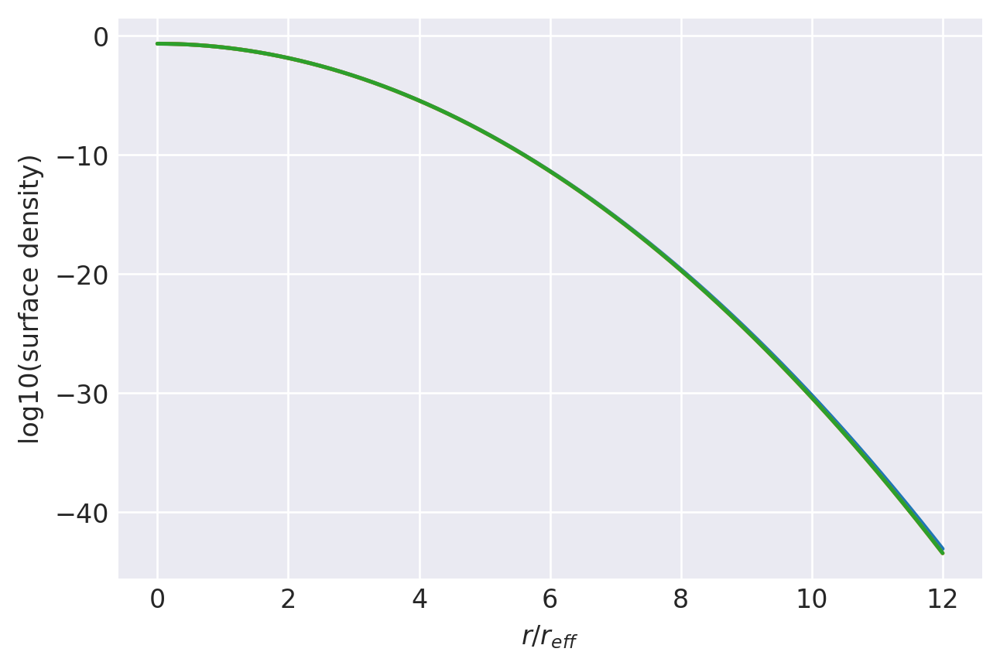

n=0.503: (
    normalize(np.array([9.5060305253e-01, 4.0857769233e-02, 7.5207581369e-03, 7.6773816414e-04, 2.1921385256e-04, 2.3120652785e-05, 8.0247997539e-06, 3.2263403005e-07])),
    np.array([1.0067103642e+00, 9.1288636876e-01, 7.8225385585e-01, 5.6700612752e-01, 4.0699848261e-01, 2.7395370061e-01, 1.6627598862e-01, 8.1643266061e-02]),
),
1.0000000144757226 1.0000000145559
prev.  chisq = -8.67367012818901
ws, re: (array([9.50603053e-01, 4.08577692e-02, 7.52075814e-03, 7.67738164e-04,
       2.19213853e-04, 2.31206528e-05, 8.02479975e-06, 3.22634030e-07]), array([1.00447305, 0.91161557, 0.78170919, 0.5667805 , 0.40699848,
       0.27406276, 0.1664084 , 0.08174081]))
         Current function value: -14.337776
         Iterations: 22
         Function evaluations: 1245
         Gradient evaluations: 137
-14.337776301213884 [3.36616723 1.58641874 2.00954342 1.09979176 1.96247733 0.9951205
 3.21374194]
1.0000000144757226 1.0000000144756613


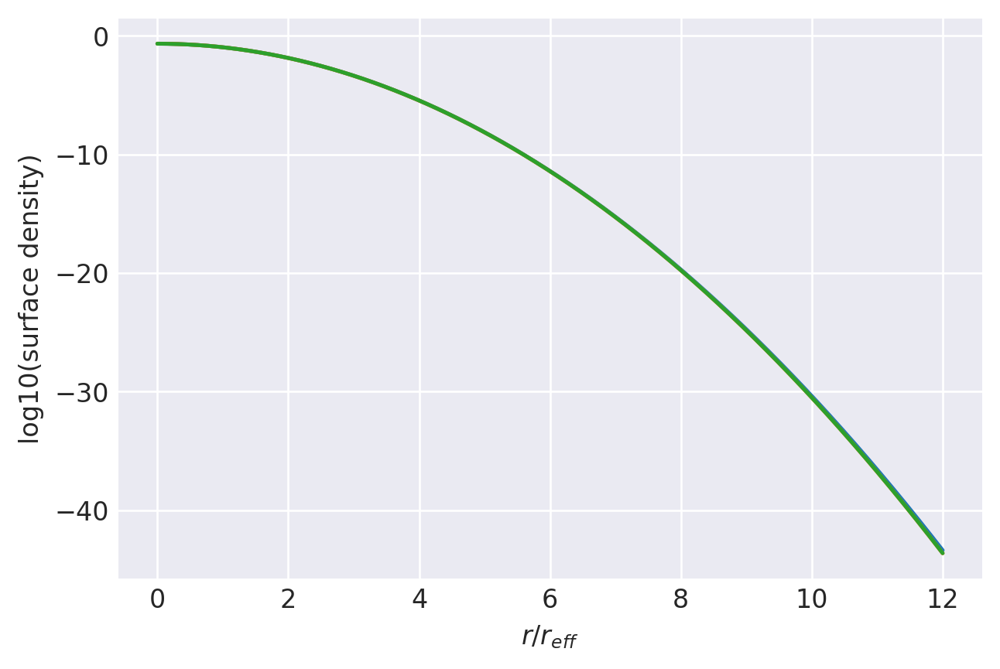

n=0.502: (
    normalize(np.array([9.6663028145e-01, 2.7700592068e-02, 4.9990098784e-03, 5.0273560468e-04, 1.4675979308e-04, 1.5055502427e-05, 5.3505768485e-06, 2.1512466830e-07])),
    np.array([1.0044730508e+00, 9.1161557118e-01, 7.8170919194e-01, 5.6678049827e-01, 4.0699848261e-01, 2.7406275865e-01, 1.6640840035e-01, 8.1740808813e-02]),
),
1.0000000144581254 1.0000000145390031
prev.  chisq = -8.664679110267638
ws, re: (array([9.66630281e-01, 2.77005921e-02, 4.99900988e-03, 5.02735605e-04,
       1.46759793e-04, 1.50555024e-05, 5.35057685e-06, 2.15124668e-07]), array([1.00223626, 0.91034401, 0.78116382, 0.56655451, 0.40699848,
       0.27417208, 0.16654118, 0.08183866]))
         Current function value: -14.926351
         Iterations: 20
         Function evaluations: 1064
         Gradient evaluations: 117
-14.926350773567812 [4.06284427 1.60774336 2.01997041 1.07895266 1.98676525 0.96499146
 3.22002516]
1.0000000144581254 1.0000000144580985


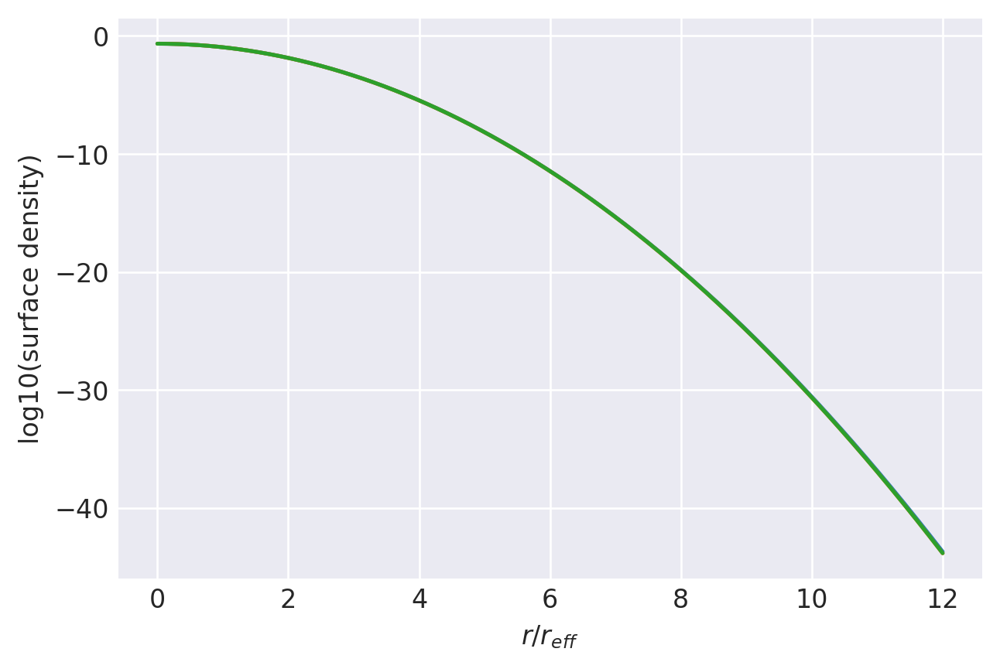

n=0.501: (
    normalize(np.array([9.8309081062e-01, 1.4087009237e-02, 2.4916406163e-03, 2.4668023661e-04, 7.3745899515e-05, 7.3233075902e-06, 2.6828887191e-06, 1.0719227828e-07])),
    np.array([1.0022362632e+00, 9.1034401393e-01, 7.8116382234e-01, 5.6655450917e-01, 4.0699848261e-01, 2.7417207769e-01, 1.6654118188e-01, 8.1838662954e-02]),
),
1.000000014440567 1.000000014522155
prev.  chisq = -8.655592621527944
ws, re: (array([9.83090811e-01, 1.40870092e-02, 2.49164062e-03, 2.46680237e-04,
       7.37458995e-05, 7.32330759e-06, 2.68288872e-06, 1.07192278e-07]), array([1.        , 0.9090717 , 0.78061774, 0.56632816, 0.40699848,
       0.27428166, 0.16667433, 0.08193683]))
Optimization terminated successfully.
         Current function value: -20.617227
         Iterations: 3
         Function evaluations: 81
         Gradient evaluations: 9
-20.617227474775095 [21.99479348  5.50479353  2.79756248  1.13800524  1.9774401   0.96115125
  3.21977231]
1.000000014440567 1.0000000144405667


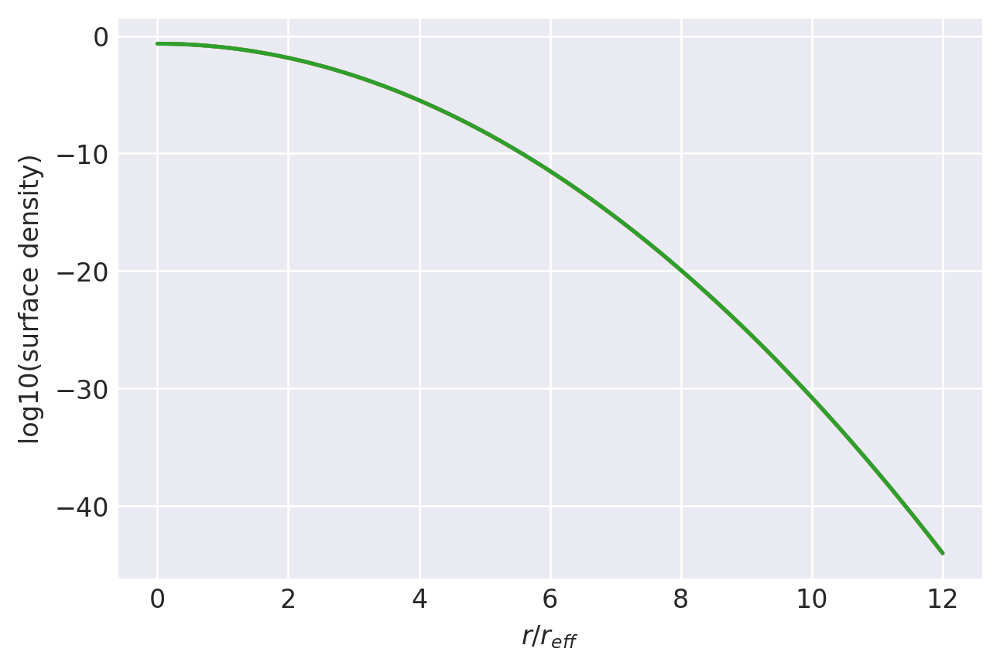

n=0.5: (
    normalize(np.array([9.9999999972e-01, 2.7926719072e-10, 1.0705823480e-12, 4.9423063822e-14, 1.3912223774e-14, 1.3930126655e-15, 5.1228779701e-16, 1.1102230246e-16])),
    np.array([1.0000000023e+00, 9.0907169503e-01, 7.8061774471e-01, 5.6632815891e-01, 4.0699848261e-01, 2.7428165889e-01, 1.6667433497e-01, 8.1936830104e-02]),
),


In [6]:
# Let's try one more approach. From n=0.7 to n=1, log(n) vs log(rdivre) for the sigmaspline is nearly linear, so just fix those and only fit the weights
x100 = np.log10(np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01,
                          4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02]))
x70 = np.log10(np.array([1.5052384522e+00, 1.1895849021e+00, 8.9211604870e-01, 6.2729710480e-01,
                         4.1395531956e-01, 2.5476146085e-01, 1.4180217436e-01, 6.4647551382e-02]))
w70 =     normalize(np.array([1.1646435020e-01, 4.2739124945e-01, 3.1922751878e-01, 1.0653680383e-01,
                              2.4816881868e-02, 4.7669777519e-03, 7.2686739303e-04, 6.9350722705e-05])),
slopes = (x100-x70)/-np.log10(0.7)
print(slopes)
# That did not actually work well below n<0.7, which was the whole point, so let's try again
x50 = np.array([0])
slopes[:len(x50)] = (x100[:len(x50)]-x50)/-np.log10(0.5/1.0)
slopes[4] = 0
print(slopes)

class RadiusExtrapolator:
    # Straight n=0.7 slopes
    # delta = np.array([1.11799858, 0.89465879, 0.49097738,  0.21019219, 0.19796296, -0.07311309, -0.49345005, -0.88741601])
    # Adjusted slopes
    # delta = np.array([1.21540882, 1.20028606, 0.68721482, 0.66704026, 0.45818359, 0.19252795, -0.67281483, -1.29645156])
    delta = np.array([1.11799858, 0.7, 0.35, 0.2, 0., -0.2, -0.4, -0.6])
    #xref = np.log10(np.array([1.5052384522e+00, 1.1895849021e+00, 8.9211604870e-01, 6.2729710480e-01, 4.1395531956e-01, 2.5476146085e-01, 1.4180217436e-01, 6.4647551382e-02]))
    xref = np.log10(np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02]))
    nref = 1.0
    @staticmethod
    def r(nsersic):
        return(RadiusExtrapolator.xref + RadiusExtrapolator.delta*np.log10(nsersic/RadiusExtrapolator.nref))

for n in [1, 0.75, 0.5]:
    print(n, 10**RadiusExtrapolator.r(n))

nvals = [
    (
        np.array([
            1.0, 0.975, 0.95, 0.925, 0.9, 0.875, 0.85, 0.825, 0.8,
            0.775, 0.75, 0.725, 0.7, 0.675, 0.65, 0.625, 0.6, 0.59,
            0.58, 0.57, 0.56, 0.55, 0.545, 0.54, 0.535, 0.53, 0.525,
            0.52, 0.518, 0.516, 0.514, 0.512, 0.51, 0.509, 0.508,
            0.507, 0.506, 0.505, 0.504, 0.503, 0.502, 0.501, 0.5
        ]),
        (
	normalize(np.array([7.7900190678e-02, 3.1264016273e-01, 3.3937178782e-01, 1.8392530470e-01, 6.5418042323e-02, 1.7095071454e-02, 3.2661231097e-03, 3.8331719642e-04])),
	np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02])
        ),
    )
]
fitweights(nvals, rmid, areasq, funcrdivreslog=RadiusExtrapolator.r)

## Fitting large n profiles

Up to n=2.5, we continue from the exponential solution. Beyond n=2.5, it becomes very difficult to fit the outer profile because more of the Gaussian components trend to tiny sizes. By masking the inner bins, we can limit this issue and ensure a nearly constant central surface brightness. In the real universe, most massive nearby ellipticals don't have the steep cusp of an n>4 profile - only the outer part is well-approximated by an n>4 profile. Kormendy & co. discuss this at length in a number of papers, hypothesizing that the shallow inner cores are due to massive black holes scattering stars and scouring the inner regions of stars. It could be possible that higher-redshift ellipticals and/or recent merger remnants do have very cuspy centers, but these are probably merger-induced and distinct enough from the rest of the galaxy that they should be considered a separate component.

[0, 24000]
0.9999999914677243 1.0000000283694637
prev.  chisq = -10.928842290897967
ws, re: (array([0.07790019, 0.31264016, 0.33937179, 0.1839253 , 0.06541804,
       0.01709507, 0.00326612, 0.00038332]), array([2.17045661, 1.47679133, 0.99494464, 0.65054022, 0.40699848,
       0.23877605, 0.12631553, 0.05405815]))
         Current function value: -10.928845
         Iterations: 11
         Function evaluations: 1440
         Gradient evaluations: 84
-10.928845491478475 [-2.47097404e+00 -6.67480465e-01  2.28191308e-01  7.58177529e-01
  1.14859079e+00  1.54422359e+00  2.14252636e+00  3.36537132e-01
  1.69306081e-01 -2.20183867e-03 -1.86709012e-01 -3.90388717e-01
 -6.21999543e-01 -8.98532521e-01 -1.26716408e+00]
0.9999999914677243 1.0000000283697712


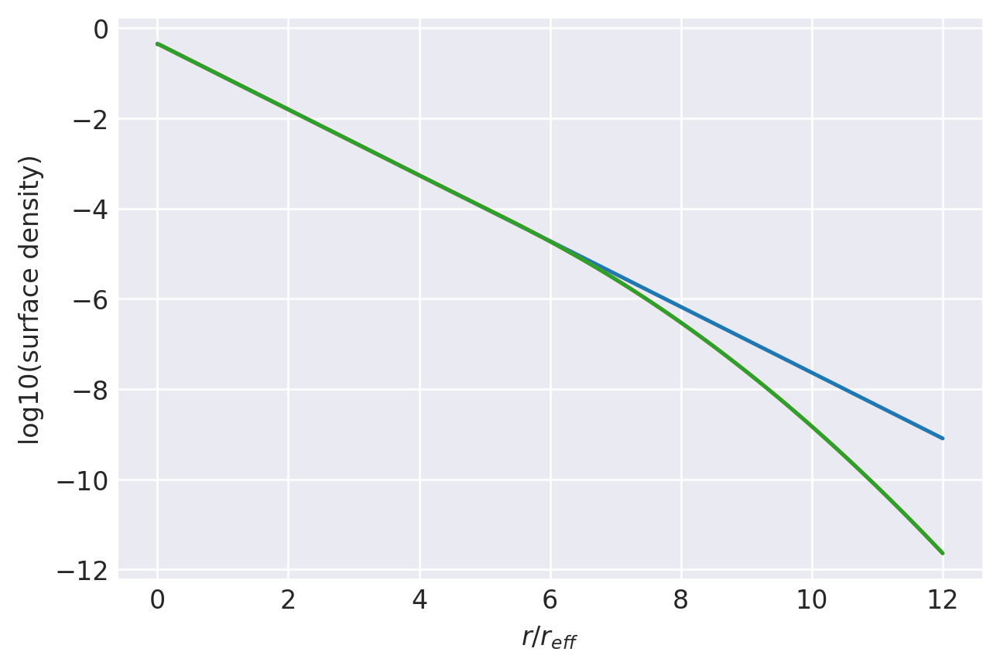

n=1.0: (
    normalize(np.array([7.7918224454e-02, 3.1264218663e-01, 3.3933691570e-01, 1.8392855585e-01, 6.5427993720e-02, 1.7096421442e-02, 3.2663678777e-03, 3.8333433416e-04])),
    np.array([2.1703867615e+00, 1.4767469440e+00, 9.9494290945e-01, 6.5056543885e-01, 4.0701581400e-01, 2.3878137930e-01, 1.2631865104e-01, 5.4055006342e-02]),
),
[0, 24000]
0.9999999524961687 1.0000000283697712
prev.  chisq = -7.751041409870326
ws, re: (array([0.07791822, 0.31264219, 0.33933692, 0.18392856, 0.06542799,
       0.01709642, 0.00326637, 0.00038333]), array([2.17038676, 1.47674694, 0.99494291, 0.65056544, 0.40701581,
       0.23878138, 0.12631865, 0.05405501]))
         Current function value: -10.823923
         Iterations: 51
         Function evaluations: 2273
         Gradient evaluations: 133
-10.823922863790685 [-2.48448711e+00 -6.95157227e-01  1.96637621e-01  7.29817123e-01
  1.12601037e+00  1.52700568e+00  2.12852120e+00  3.47251861e-01
  1.75727228e-01  1.17515822e-03 -1.85621494e-01 -3.

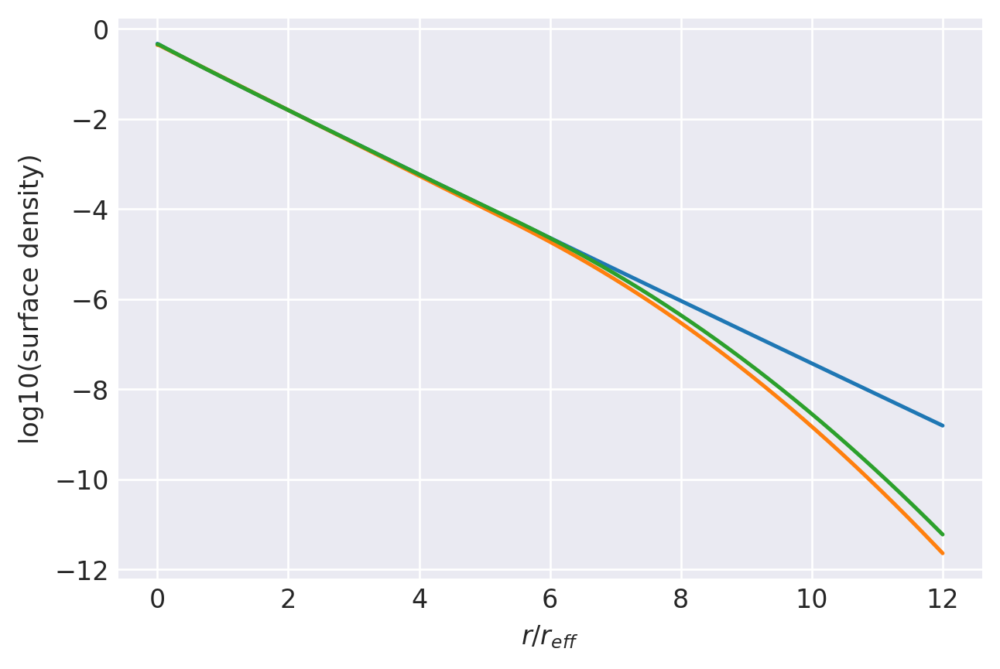

n=1.025: (
    normalize(np.array([7.6952872212e-02, 3.0727021030e-01, 3.3806252163e-01, 1.8739199324e-01, 6.8202615579e-02, 1.8172904487e-02, 3.5271100413e-03, 4.1977251196e-04])),
    np.array([2.2245996320e+00, 1.4987432070e+00, 1.0027095661e+00, 6.5219656293e-01, 4.0628145229e-01, 2.3742373239e-01, 1.2510083328e-01, 5.3290499264e-02]),
),
[0, 24000]
0.9999998805166705 1.0000000292943443
prev.  chisq = -7.771427518703303
ws, re: (array([0.07695287, 0.30727021, 0.33806252, 0.18739199, 0.06820262,
       0.0181729 , 0.00352711, 0.00041977]), array([2.22459963, 1.49874321, 1.00270957, 0.65219656, 0.40628145,
       0.23742373, 0.12510083, 0.0532905 ]))
         Current function value: -10.724036
         Iterations: 48
         Function evaluations: 2409
         Gradient evaluations: 141
-10.724035532728138 [-2.49872426 -0.72186408  0.1668127   0.70286182  1.10426634  1.51006868
  2.11437843  0.35783511  0.18213458  0.00458986 -0.18448651 -0.39190631
 -0.62689004 -0.90683346 -1.279367

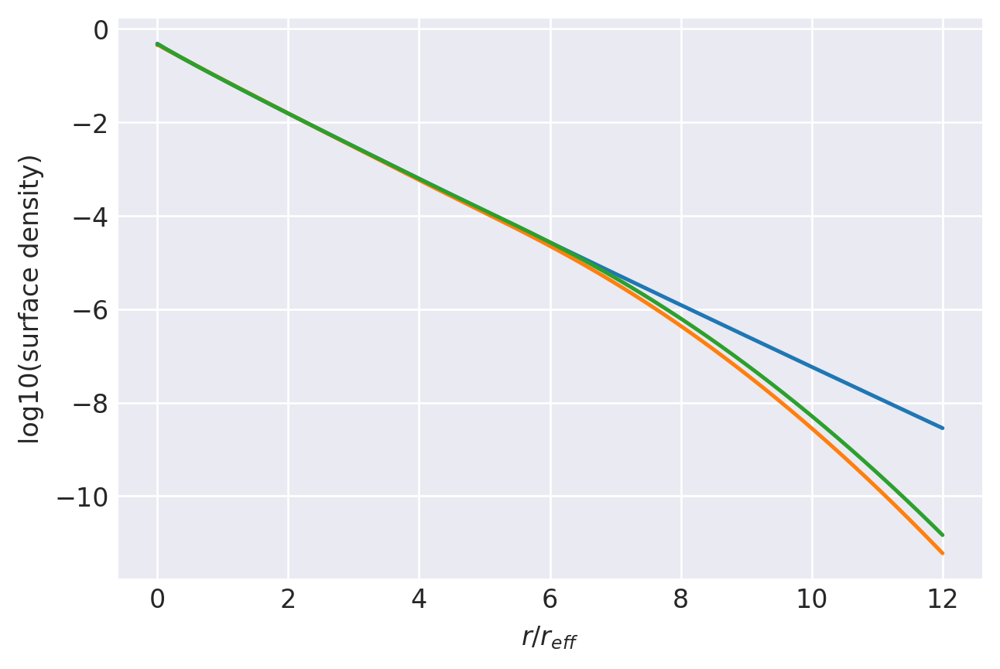

n=1.05: (
    normalize(np.array([7.5947662718e-02, 3.0214906503e-01, 3.3682700248e-01, 1.9066527218e-01, 7.0908195025e-02, 1.9250473038e-02, 3.7943232352e-03, 4.5800628636e-04])),
    np.array([2.2794764352e+00, 1.5210188040e+00, 1.0106245927e+00, 6.5390323690e-01, 4.0559602700e-01, 2.3610759482e-01, 1.2392717095e-01, 5.2557290082e-02]),
),
[0, 24000]
0.9999997552406892 1.0000000301264065
prev.  chisq = -7.79123421580168
ws, re: (array([0.07594766, 0.30214907, 0.336827  , 0.19066527, 0.0709082 ,
       0.01925047, 0.00379432, 0.00045801]), array([2.27947644, 1.5210188 , 1.01062459, 0.65390324, 0.40559603,
       0.23610759, 0.12392717, 0.05255729]))
         Current function value: -10.628740
         Iterations: 43
         Function evaluations: 2187
         Gradient evaluations: 128
-10.628740389048325 [-2.51049116 -0.74624195  0.13906346  0.67742407  1.08333488  1.49338985
  2.10036355  0.36810798  0.18831533  0.00783143 -0.18350208 -0.3927791
 -0.62941944 -0.91099741 -1.28539888]

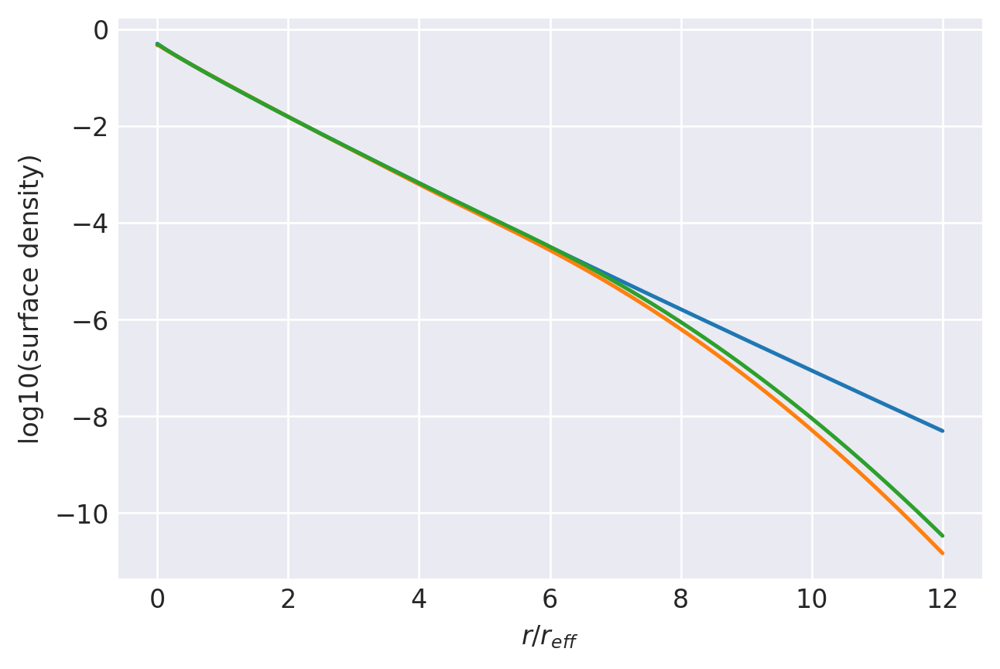

n=1.075: (
    normalize(np.array([7.5125975873e-02, 2.9747713930e-01, 3.3547535376e-01, 1.9359171430e-01, 7.3464621041e-02, 2.0304583786e-02, 4.0632247908e-03, 4.9738713851e-04])),
    np.array([2.3340382969e+00, 1.5428202583e+00, 1.0181961046e+00, 6.5538714264e-01, 4.0478172510e-01, 2.3473646662e-01, 1.2274465614e-01, 5.1832376710e-02]),
),
[0, 24000]
0.9999995478677557 1.0000000307199197
prev.  chisq = -7.810487641998823
ws, re: (array([0.07512598, 0.29747714, 0.33547535, 0.19359171, 0.07346462,
       0.02030458, 0.00406322, 0.00049739]), array([2.3340383 , 1.54282026, 1.0181961 , 0.65538714, 0.40478173,
       0.23473647, 0.12274466, 0.05183238]))
         Current function value: -10.537687
         Iterations: 38
         Function evaluations: 2103
         Gradient evaluations: 123
-10.537687190054049 [-2.51942639 -0.76842028  0.11299889  0.65316938  1.06331207  1.47746862
  2.08709612  0.37804283  0.19424433  0.01089789 -0.18264029 -0.3937519
 -0.63205974 -0.91529377 -1.2915887

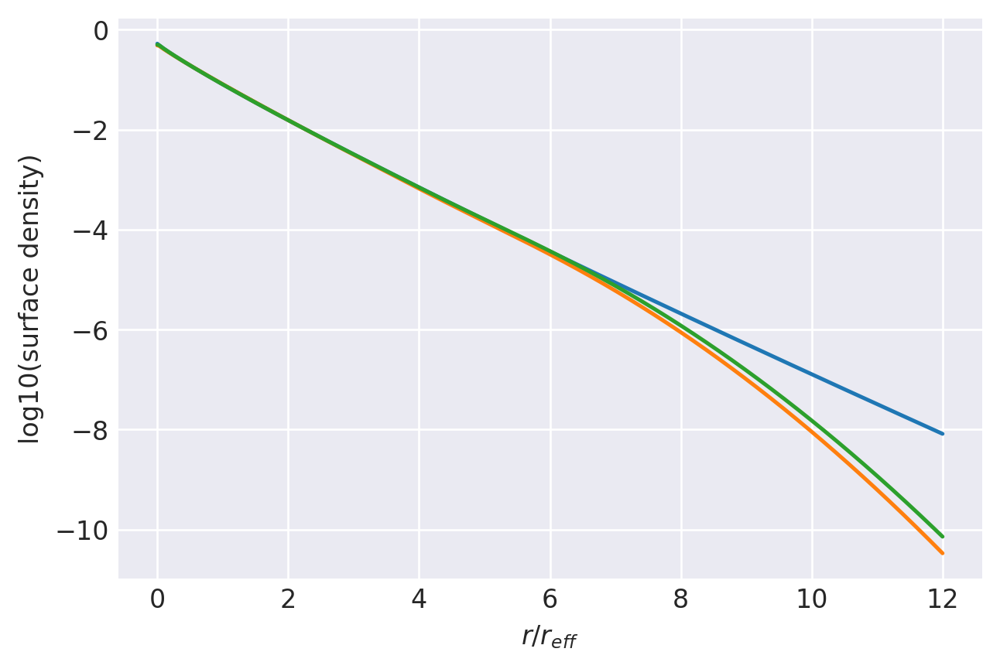

n=1.1: (
    normalize(np.array([7.4507489628e-02, 2.9321539786e-01, 3.3398122765e-01, 1.9619645775e-01, 7.5892850165e-02, 2.1337130941e-02, 4.3320668521e-03, 5.3737916226e-04])),
    np.array([2.3880467681e+00, 1.5640273127e+00, 1.0254108077e+00, 6.5668894662e-01, 4.0387605340e-01, 2.3331371078e-01, 1.2153636097e-01, 5.1098868783e-02]),
),
[0, 24000]
0.999999042644294 1.000000030796426
prev.  chisq = -7.541106818231463
ws, re: (array([0.07450749, 0.2932154 , 0.33398123, 0.19619646, 0.07589285,
       0.02133713, 0.00433207, 0.00053738]), array([2.38804677, 1.56402731, 1.02541081, 0.65668895, 0.40387605,
       0.23331371, 0.12153636, 0.05109887]))
         Current function value: -10.416764
         Iterations: 46
         Function evaluations: 2477
         Gradient evaluations: 145
-10.41676369894462 [-2.53002838 -0.79678143  0.07943032  0.62154681  1.0366442   1.45585932
  2.06874663  0.39156499  0.20228791  0.01499285 -0.18162052 -0.39529755
 -0.6359148  -0.92142849 -1.30027434]
0

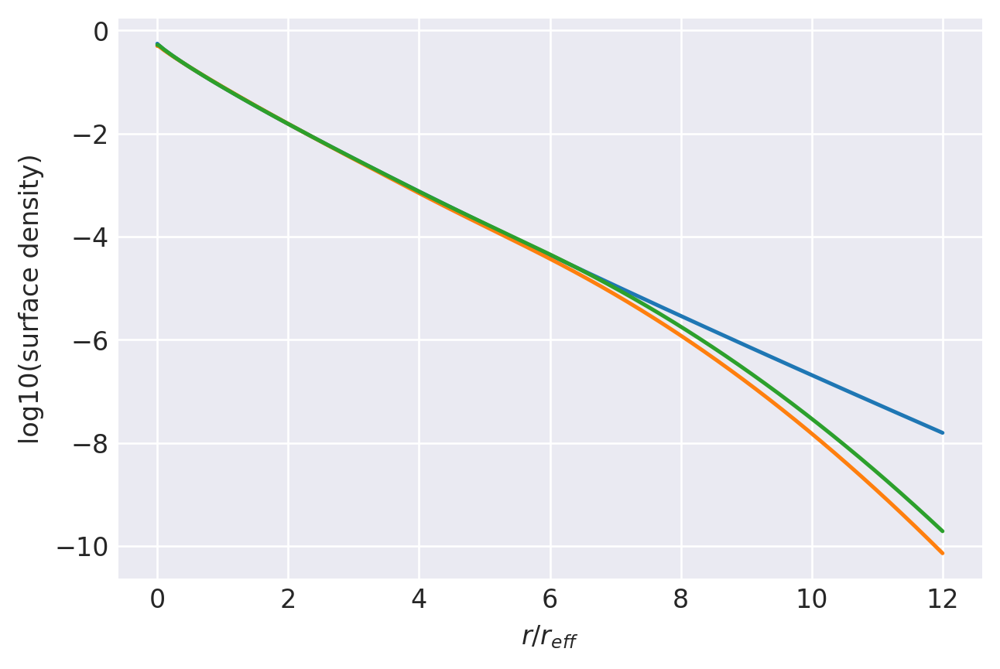

n=1.135: (
    normalize(np.array([7.3779707114e-02, 2.8779000412e-01, 3.3188616436e-01, 1.9942849227e-01, 7.9072972016e-02, 2.2739752460e-02, 4.7080709607e-03, 5.9483669916e-04])),
    np.array([2.4635704805e+00, 1.5932645971e+00, 1.0351251235e+00, 6.5823273619e-01, 4.0244121748e-01, 2.3125184402e-01, 1.1983164237e-01, 5.0087073335e-02]),
),
[0, 24000]
0.9999983071986108 1.00000002896595
prev.  chisq = -7.698342614216935
ws, re: (array([0.07377971, 0.28779   , 0.33188616, 0.19942849, 0.07907297,
       0.02273975, 0.00470807, 0.00059484]), array([2.46357048, 1.5932646 , 1.03512512, 0.65823274, 0.40244122,
       0.23125184, 0.11983164, 0.05008707]))
         Current function value: -10.318691
         Iterations: 42
         Function evaluations: 2324
         Gradient evaluations: 136
-10.318691033720778 [-2.53924637 -0.82022667  0.05206912  0.59583308  1.01484266  1.43790932
  2.05361677  0.40292733  0.2091156   0.01854486 -0.18065388 -0.39651188
 -0.63909893 -0.92654184 -1.3075692 

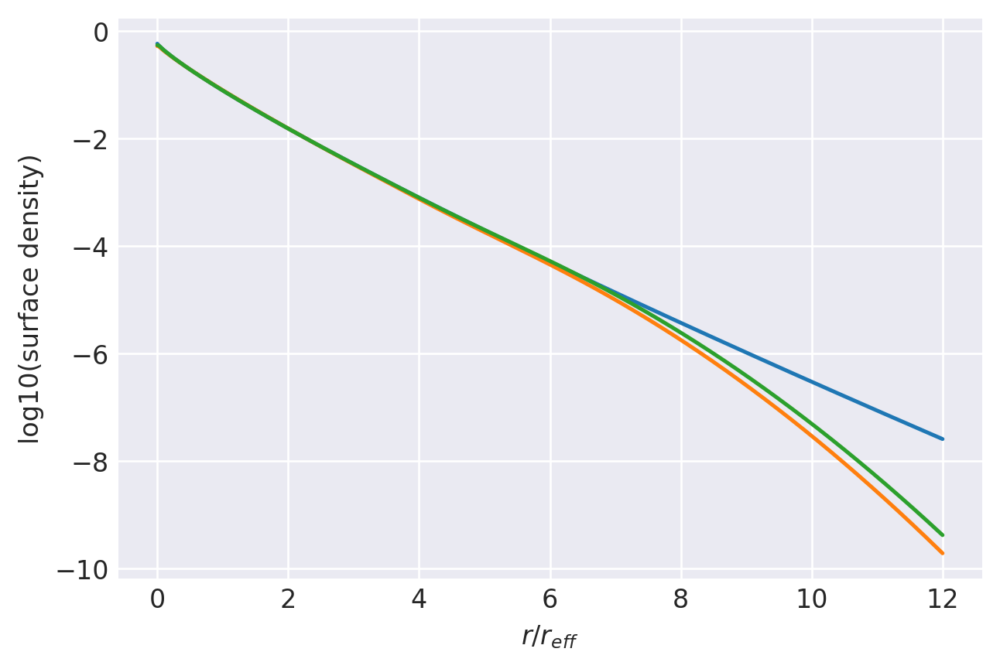

n=1.165: (
    normalize(np.array([7.3152254157e-02, 2.8335176587e-01, 3.3012266599e-01, 2.0203252865e-01, 8.1720439408e-02, 2.3937110552e-02, 5.0371229157e-03, 6.4611245862e-04])),
    np.array([2.5288747993e+00, 1.6185107936e+00, 1.0436259325e+00, 6.5969944564e-01, 4.0131752139e-01, 2.2956256529e-01, 1.1842902566e-01, 4.9252785864e-02]),
),
[1, 24000]
0.9999969189841783 1.0000000235374507
prev.  chisq = -7.587473370971484
ws, re: (array([0.07315225, 0.28335177, 0.33012267, 0.20203253, 0.08172044,
       0.02393711, 0.00503712, 0.00064611]), array([2.5288748 , 1.61851079, 1.04362593, 0.65969945, 0.40131752,
       0.22956257, 0.11842903, 0.04925279]))
         Current function value: -10.210191
         Iterations: 46
         Function evaluations: 1157
         Gradient evaluations: 68
-10.210190807064716 [-2.54075631 -0.84143591  0.02416328  0.56829422  0.99078977  1.41794927
  2.03628917  0.41527632  0.21622925  0.02190532 -0.18023722 -0.39857867
 -0.64341827 -0.93308318 -1.3165495

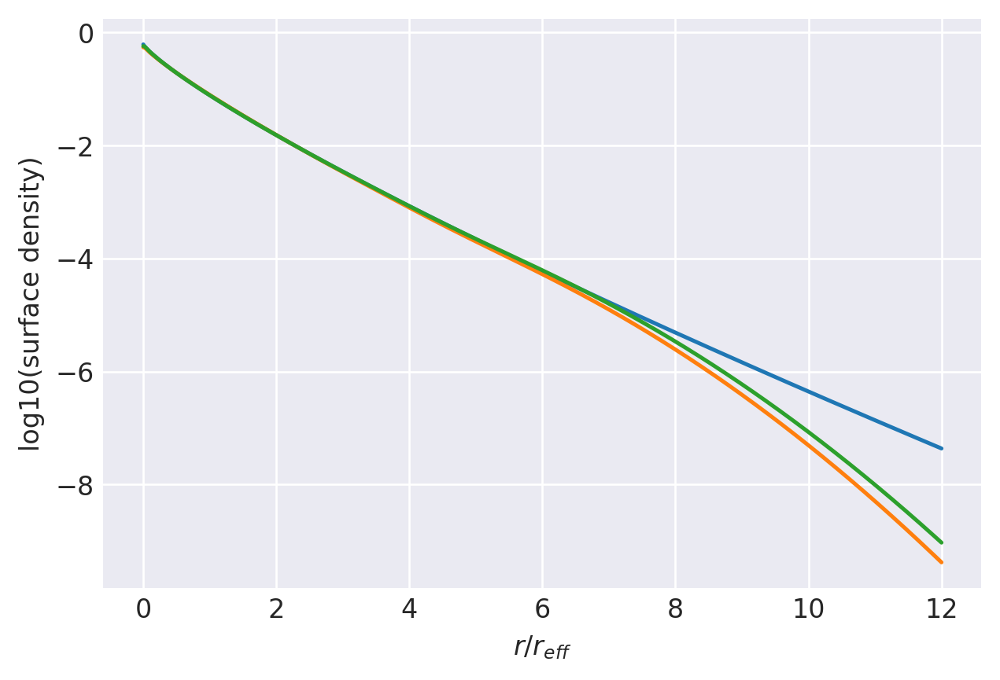

n=1.2: (
    normalize(np.array([7.3049944279e-02, 2.7922743707e-01, 3.2777389485e-01, 2.0424550117e-01, 8.4375868088e-02, 2.5219044380e-02, 5.4031354787e-03, 7.0517467532e-04])),
    np.array([2.6018144394e+00, 1.6452399518e+00, 1.0517325621e+00, 6.6033265884e-01, 3.9941220030e-01, 2.2729073295e-01, 1.1665861602e-01, 4.8244792635e-02]),
),
[1, 24000]
0.9999954437033961 1.0000000086378362
prev.  chisq = -7.898892993909739
ws, re: (array([0.07304994, 0.27922744, 0.32777389, 0.2042455 , 0.08437587,
       0.02521904, 0.00540314, 0.00070517]), array([2.60181444, 1.64523995, 1.05173256, 0.66033266, 0.3994122 ,
       0.22729073, 0.11665862, 0.04824479]))
         Current function value: -10.136294
         Iterations: 39
         Function evaluations: 2460
         Gradient evaluations: 144
-10.136294262614923 [-2.54254803 -0.85633034  0.00500144  0.54949304  0.97431484  1.40411112
  2.0244051   0.42396293  0.22128913  0.0243583  -0.179851   -0.39995296
 -0.64639198 -0.93762984 -1.32283687

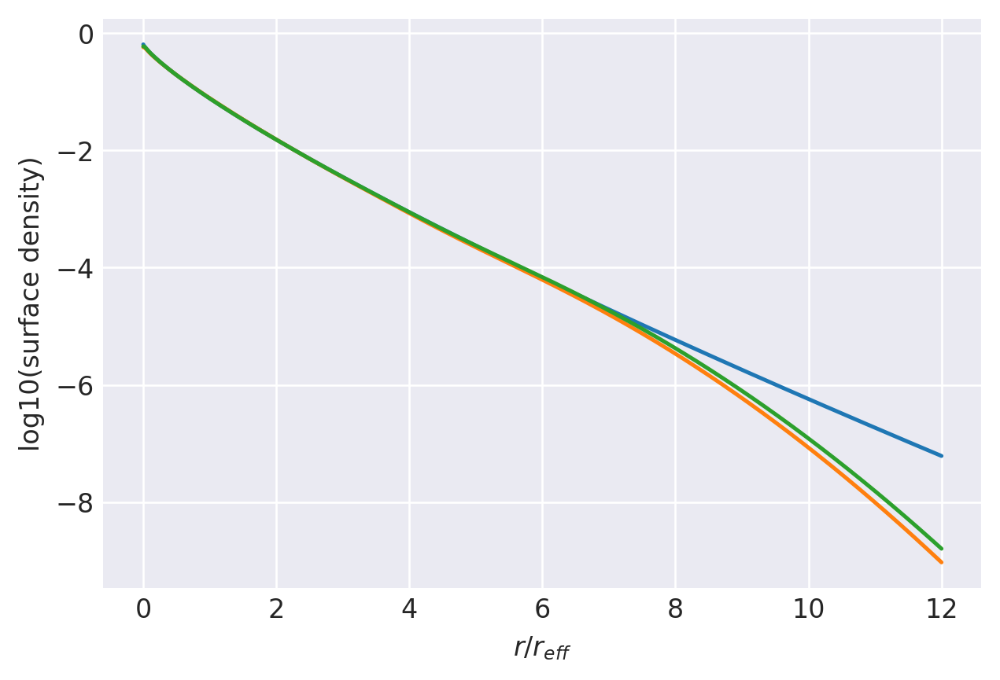

n=1.225: (
    normalize(np.array([7.2928712957e-02, 2.7636608139e-01, 3.2616621671e-01, 2.0576354900e-01, 8.6228439698e-02, 2.6129885634e-02, 5.6684666689e-03, 7.4864793937e-04])),
    np.array([2.6543790115e+00, 1.6645204355e+00, 1.0576897704e+00, 6.6092015366e-01, 3.9815029687e-01, 2.2573973776e-01, 1.1544367838e-01, 4.7551380379e-02]),
),
[1, 24000]
0.9999934376205089 0.9999999874432763
prev.  chisq = -7.91506895215381
ws, re: (array([0.07292871, 0.27636608, 0.32616622, 0.20576355, 0.08622844,
       0.02612989, 0.00566847, 0.00074865]), array([2.65437901, 1.66452044, 1.05768977, 0.66092015, 0.3981503 ,
       0.22573974, 0.11544368, 0.04755138]))
         Current function value: -10.065193
         Iterations: 36
         Function evaluations: 2001
         Gradient evaluations: 117
-10.065193128548332 [-2.54325622 -0.87003717 -0.01296034  0.53163281  0.95848393  1.39068541
  2.01265577  0.43242536  0.2261884   0.02668701 -0.17957033 -0.40141713
 -0.64944471 -0.94223748 -1.3291548

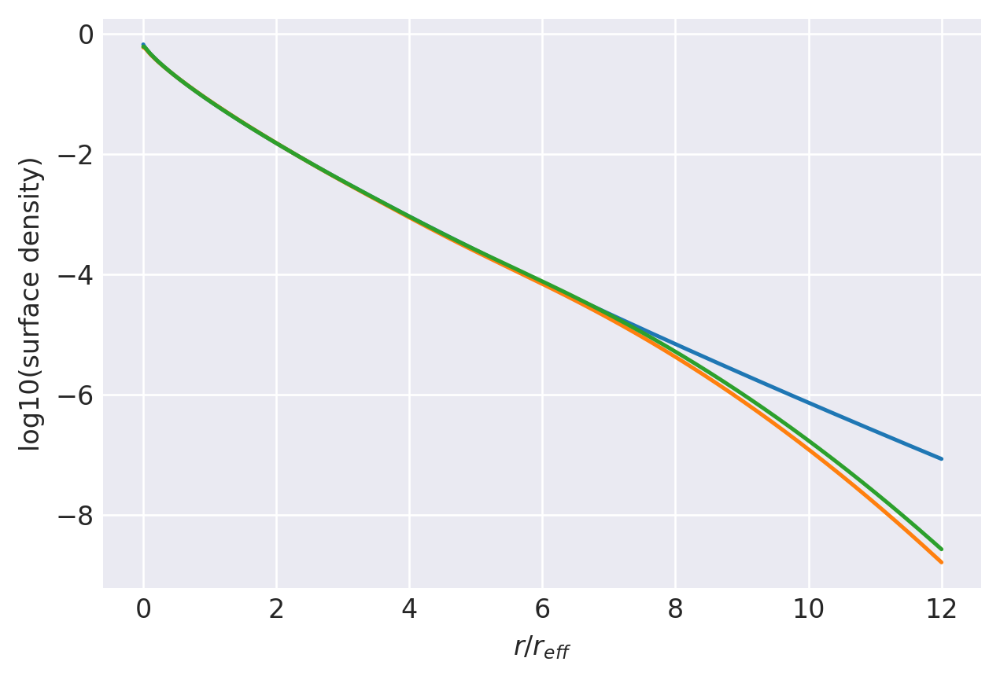

n=1.25: (
    normalize(np.array([7.2880846698e-02, 2.7372874848e-01, 3.2457819135e-01, 2.0710692931e-01, 8.7970789529e-02, 2.7011265275e-02, 5.9306914649e-03, 7.9253789696e-04])),
    np.array([2.7066080105e+00, 1.6834041747e+00, 1.0633763858e+00, 6.6134742715e-01, 3.9681023758e-01, 2.2415853892e-01, 1.1422535521e-01, 4.6864627506e-02]),
),
[1, 24000]
0.9999907689294948 0.9999999519528406
prev.  chisq = -7.9307664158835
ws, re: (array([0.07288085, 0.27372875, 0.32457819, 0.20710693, 0.08797079,
       0.02701127, 0.00593069, 0.00079254]), array([2.70660801, 1.68340417, 1.06337639, 0.66134743, 0.39681024,
       0.22415854, 0.11422536, 0.04686463]))
         Current function value: -9.996723
         Iterations: 34
         Function evaluations: 2494
         Gradient evaluations: 146
-9.996723010551534 [-2.54297184 -0.88278838 -0.03006414  0.51450173  0.94321257  1.3776502
  2.00127132  0.44066988  0.23093969  0.02892401 -0.17934296 -0.40291435
 -0.65251797 -0.94685624 -1.33547038]
0.

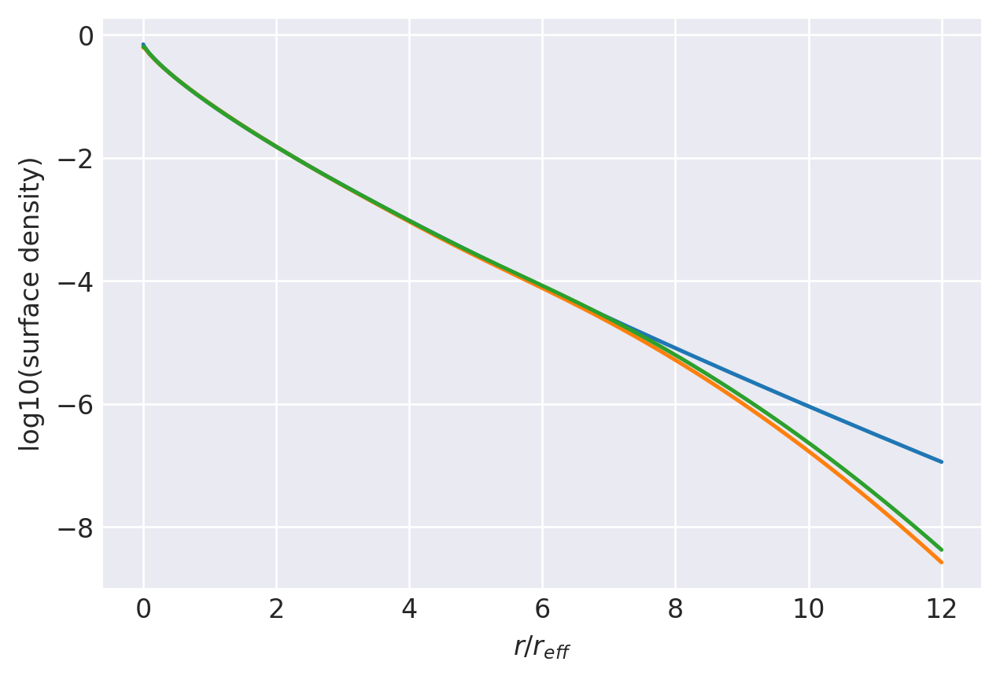

n=1.275: (
    normalize(np.array([7.2900064653e-02, 2.7126971182e-01, 3.2298624057e-01, 2.0831413111e-01, 8.9630127447e-02, 2.7871385695e-02, 6.1914778874e-03, 8.3686082244e-04])),
    np.array([2.7584802787e+00, 1.7019221531e+00, 1.0688678467e+00, 6.6169376060e-01, 3.9544460110e-01, 2.2257789384e-01, 1.1301699700e-01, 4.6188048898e-02]),
),
[1, 24000]
0.9999872885935822 0.9999998949857569
prev.  chisq = -7.9459843180403
ws, re: (array([0.07290006, 0.27126971, 0.32298624, 0.20831413, 0.08963013,
       0.02787139, 0.00619148, 0.00083686]), array([2.75848028, 1.70192215, 1.06886785, 0.66169376, 0.3954446 ,
       0.22257789, 0.113017  , 0.04618805]))
         Current function value: -9.930733
         Iterations: 32
         Function evaluations: 1422
         Gradient evaluations: 83
-9.930732557319814 [-2.54175022 -0.89453225 -0.0461946   0.49815853  0.92846182  1.36490234
  1.99007038  0.44870217  0.235539    0.03104914 -0.17920257 -0.40447894
 -0.65563696 -0.95149628 -1.34177939]
0

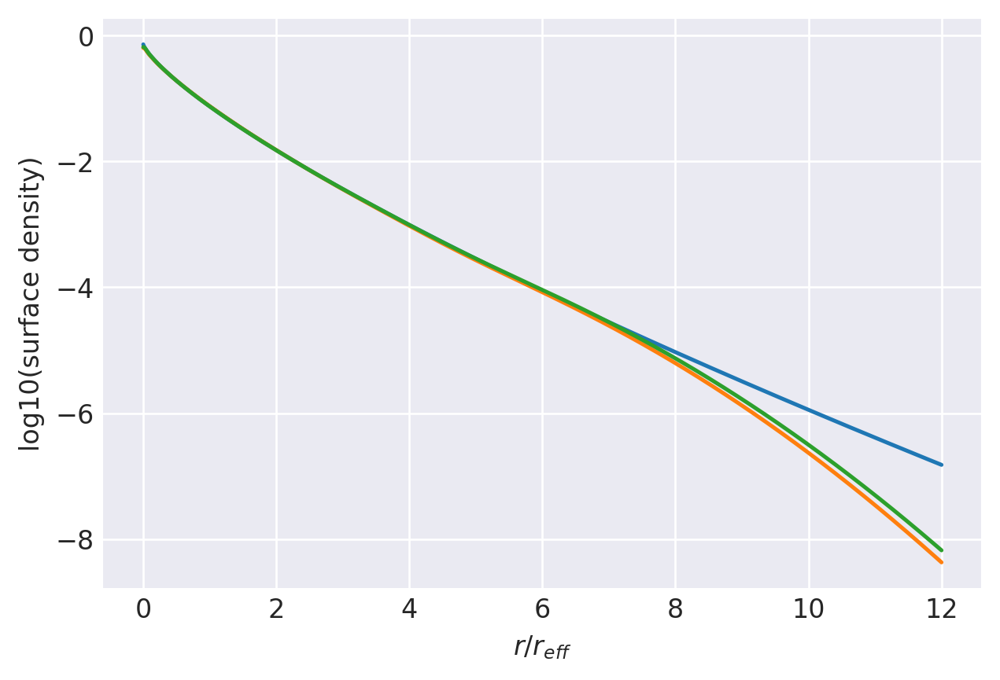

n=1.3: (
    normalize(np.array([7.2982671718e-02, 2.6899764005e-01, 3.2141195567e-01, 2.0937892367e-01, 9.1192917677e-02, 2.8704580167e-02, 6.4497251767e-03, 8.8158587806e-04])),
    np.array([2.8099731454e+00, 1.7200418088e+00, 1.0741109434e+00, 6.6190770219e-01, 3.9402253211e-01, 2.2098512194e-01, 1.1181594021e-01, 4.5521924250e-02]),
),
[2, 24000]
0.9999811688166128 0.9999998067359415
prev.  chisq = -7.724161350880312
ws, re: (array([0.07298267, 0.26899764, 0.32141196, 0.20937892, 0.09119292,
       0.02870458, 0.00644973, 0.00088159]), array([2.80997315, 1.72004181, 1.07411094, 0.6619077 , 0.39402253,
       0.22098512, 0.11181594, 0.04552192]))
         Current function value: -9.847301
         Iterations: 38
         Function evaluations: 2392
         Gradient evaluations: 140
-9.847301214856902 [-2.53879348 -0.90871949 -0.06616848  0.47770655  0.90985664  1.34875668
  1.97580604  0.45898423  0.24139033  0.03370124 -0.17913117 -0.40663596
 -0.6598362  -0.95769937 -1.35015427]


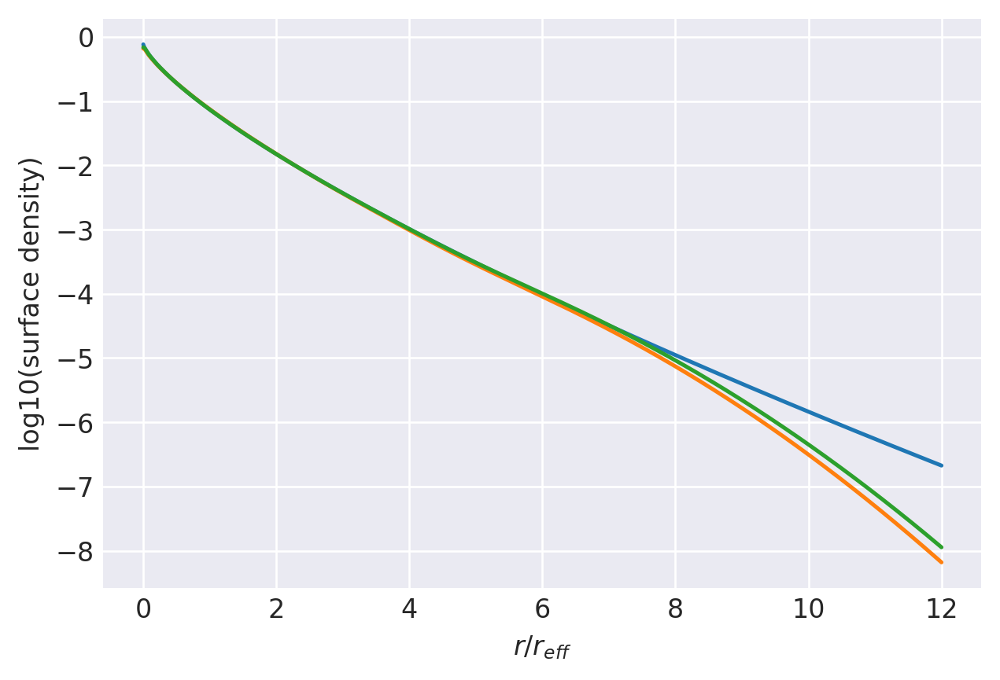

n=1.333: (
    normalize(np.array([7.3182965858e-02, 2.6623926074e-01, 3.1936551459e-01, 2.1059830961e-01, 9.3123935219e-02, 2.9764307566e-02, 6.7849732071e-03, 9.4073321002e-04])),
    np.array([2.8772939407e+00, 1.7433730579e+00, 1.0806902585e+00, 6.6201652309e-01, 3.9207038589e-01, 2.1885869378e-01, 1.1023020808e-01, 4.4652494996e-02]),
),
[2, 24000]
0.9999726339177898 0.999999619907623
prev.  chisq = -7.717952331944951
ws, re: (array([0.07318297, 0.26623926, 0.31936551, 0.21059831, 0.09312394,
       0.02976431, 0.00678497, 0.00094073]), array([2.87729394, 1.74337306, 1.08069026, 0.66201652, 0.39207039,
       0.21885869, 0.11023021, 0.04465249]))
         Current function value: -9.765208
         Iterations: 35
         Function evaluations: 2256
         Gradient evaluations: 132
-9.765208350624485 [-2.53434674 -0.92180931 -0.08533009  0.45780666  0.89155325  1.33272069
  1.96164264  0.46921903  0.24716108  0.03625053 -0.17918669 -0.40895027
 -0.66422543 -0.96412823 -1.35880848]

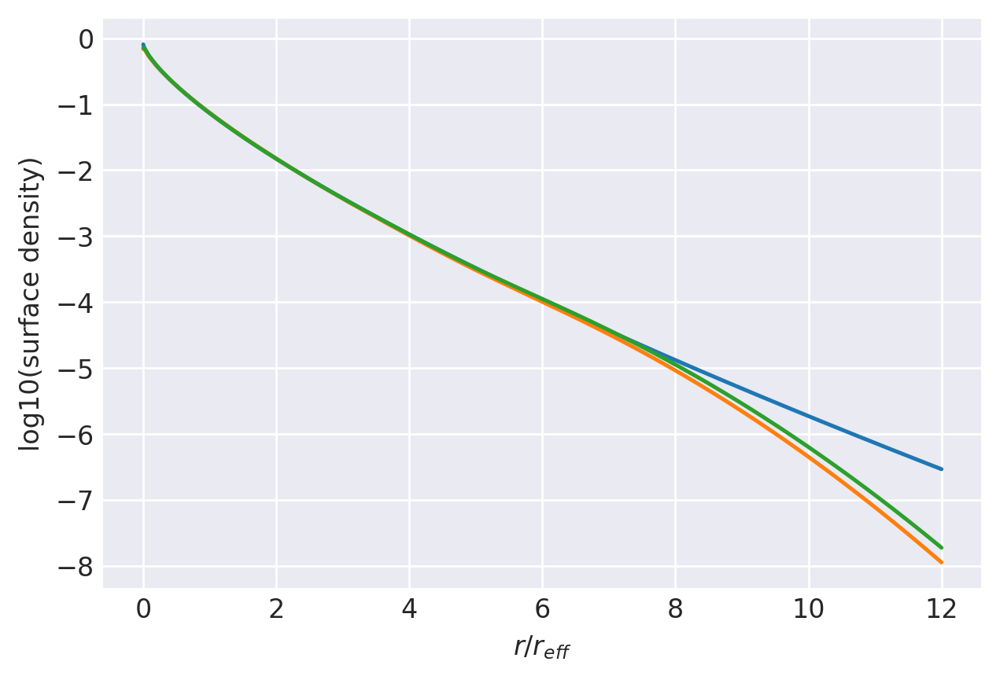

n=1.367: (
    normalize(np.array([7.3485149536e-02, 2.6367628580e-01, 3.1728783771e-01, 2.1164765257e-01, 9.4965480466e-02, 3.0810940840e-02, 7.1247229993e-03, 1.0019300726e-03])),
    np.array([2.9459070051e+00, 1.7666929634e+00, 1.0870525290e+00, 6.6193190049e-01, 3.8998664061e-01, 2.1665792221e-01, 1.0861049005e-01, 4.3771509306e-02]),
),
[3, 24000]
0.9999617084933684 0.9999993035777288
prev.  chisq = -7.762397386772114
ws, re: (array([0.07348515, 0.26367629, 0.31728784, 0.21164765, 0.09496548,
       0.03081094, 0.00712472, 0.00100193]), array([2.94590701, 1.76669296, 1.08705253, 0.6619319 , 0.38998664,
       0.21665792, 0.10861049, 0.04377151]))
         Current function value: -9.689420
         Iterations: 33
         Function evaluations: 1729
         Gradient evaluations: 101
-9.68941980839767 [-2.52871236 -0.93317602 -0.10259665  0.43960295  0.87459855  1.31763348
  1.9479831   0.47880312  0.25251729  0.03854804 -0.17937484 -0.41129776
 -0.66855709 -0.97039322 -1.3671464 ]

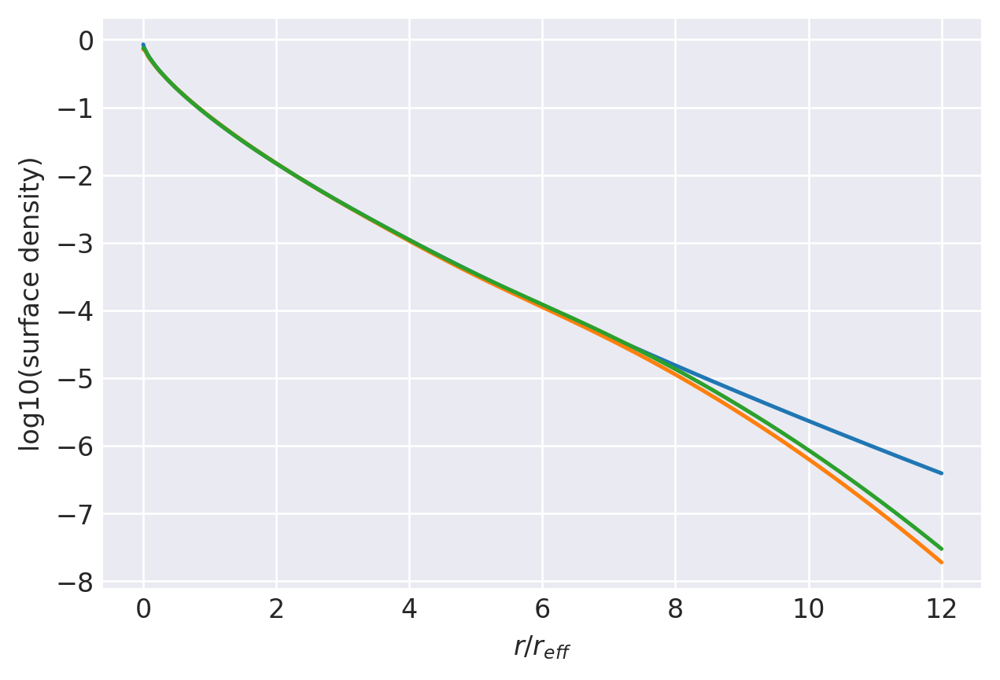

n=1.4: (
    normalize(np.array([7.3869689502e-02, 2.6142881791e-01, 3.1531664905e-01, 2.1248342972e-01, 9.6611554849e-02, 3.1780145611e-02, 7.4479270858e-03, 1.0617862743e-03])),
    np.array([3.0116404104e+00, 1.7886167246e+00, 1.0928184981e+00, 6.6164519625e-01, 3.8788433411e-01, 2.1450770993e-01, 1.0705495750e-01, 4.2939165893e-02]),
),
[3, 24000]
0.9999476740739993 0.9999988212113234
prev.  chisq = -7.780102058617983
ws, re: (array([0.07386969, 0.26142882, 0.31531665, 0.21248343, 0.09661155,
       0.03178015, 0.00744793, 0.00106179]), array([3.01164041, 1.78861672, 1.0928185 , 0.6616452 , 0.38788433,
       0.21450771, 0.10705496, 0.04293917]))
         Current function value: -9.616666
         Iterations: 37
         Function evaluations: 1677
         Gradient evaluations: 98
-9.616666138404772 [-2.52202835 -0.94339878 -0.11874444  0.42238154  0.85842366  1.30316931
  1.93494593  0.48806886  0.25765122  0.04069167 -0.17967082 -0.41372438
 -0.67294911 -0.97671263 -1.37554889]
0

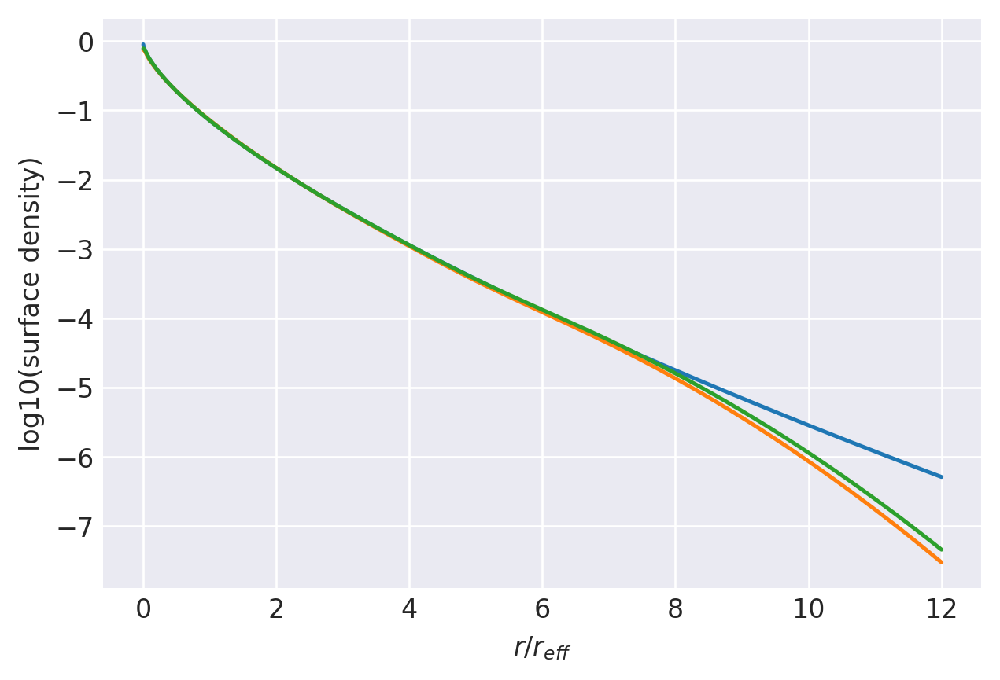

n=1.433: (
    normalize(np.array([7.4328266714e-02, 2.5938647192e-01, 3.1338642165e-01, 2.1316959930e-01, 9.8136205932e-02, 3.2707426744e-02, 7.7642071600e-03, 1.1214005793e-03])),
    np.array([3.0765846084e+00, 1.8098859821e+00, 1.0982258802e+00, 6.6119441876e-01, 3.8572307724e-01, 2.1234932963e-01, 1.0550847992e-01, 4.2116387298e-02]),
),
[4, 24000]
0.9999294019672034 0.9999980947491598
prev.  chisq = -7.771888096849798
ws, re: (array([0.07432827, 0.25938647, 0.31338642, 0.2131696 , 0.09813621,
       0.03270743, 0.00776421, 0.0011214 ]), array([3.07658461, 1.80988598, 1.09822588, 0.66119442, 0.38572308,
       0.21234933, 0.10550848, 0.04211639]))
         Current function value: -9.545536
         Iterations: 29
         Function evaluations: 1933
         Gradient evaluations: 113
-9.54553597624725 [-2.51415011 -0.95288164 -0.1343605   0.40548972  0.84237659  1.28865912
  1.92171459  0.49728835  0.26271902  0.04275241 -0.18006919 -0.41627436
 -0.67748377 -0.98318758 -1.38408479]

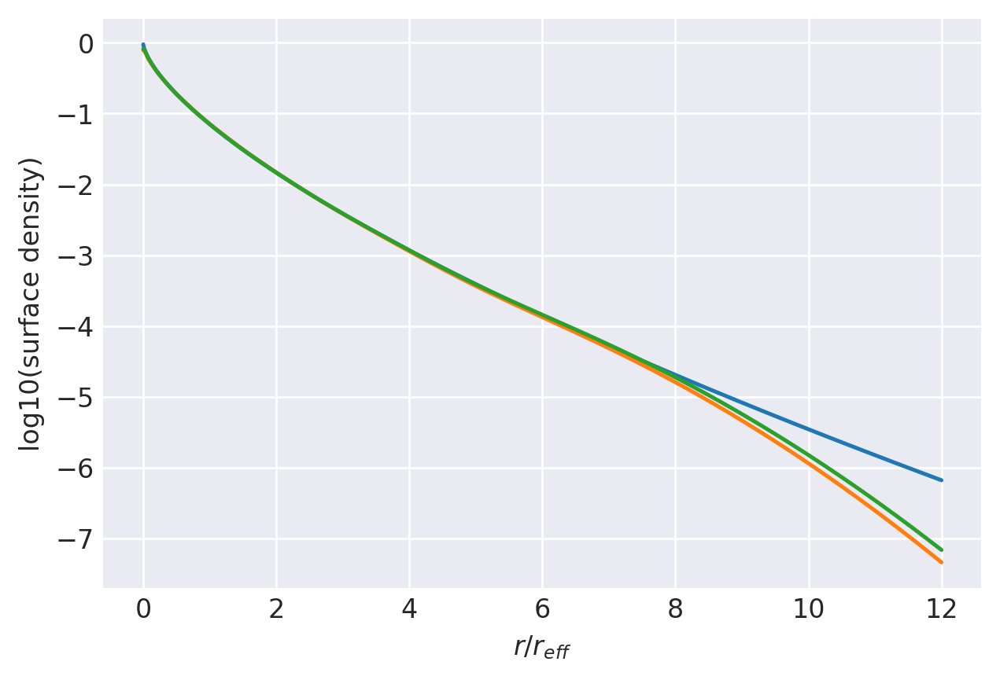

n=1.467: (
    normalize(np.array([7.4872139384e-02, 2.5746832915e-01, 3.1143667726e-01, 2.1373581700e-01, 9.9593525641e-02, 3.3625087816e-02, 8.0851195594e-03, 1.1833041896e-03])),
    np.array([3.1425944921e+00, 1.8311293230e+00, 1.1034493765e+00, 6.6058819749e-01, 3.8346492249e-01, 2.1014363221e-01, 1.0394711086e-01, 4.1296687153e-02]),
),
[4, 24000]
0.9999074016233933 0.9999969985448085
prev.  chisq = -7.813860016740509
ws, re: (array([0.07487214, 0.25746833, 0.31143668, 0.21373582, 0.09959353,
       0.03362509, 0.00808512, 0.0011833 ]), array([3.14259449, 1.83112932, 1.10344938, 0.6605882 , 0.38346492,
       0.21014363, 0.10394711, 0.04129669]))
         Current function value: -9.478926
         Iterations: 33
         Function evaluations: 2137
         Gradient evaluations: 125
-9.47892572039839 [-2.50553137 -0.96098513 -0.14840832  0.39007668  0.82758245  1.27515184
  1.90932963  0.50592675  0.26741136  0.04458064 -0.18059472 -0.41886632
 -0.6819869  -0.98955994 -1.39246191]

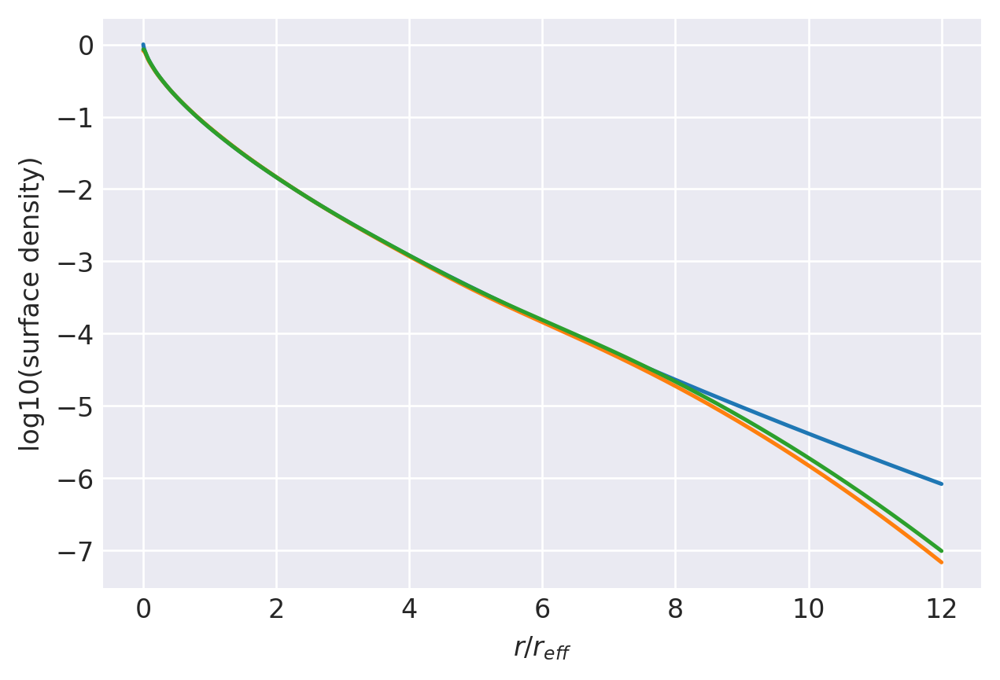

n=1.5: (
    normalize(np.array([7.5471318710e-02, 2.5579951961e-01, 3.0959877642e-01, 2.1414986428e-01, 1.0088375435e-01, 3.4467063886e-02, 8.3869300487e-03, 1.2427726881e-03])),
    np.array([3.2057286119e+00, 1.8510210628e+00, 1.1081042973e+00, 6.5978932034e-01, 3.8118313610e-01, 2.0797594296e-01, 1.0243303981e-01, 4.0507746656e-02]),
),
[5, 24000]
0.9998647896347695 0.9999954885993506
prev.  chisq = -7.478903696385744
ws, re: (array([0.07547132, 0.25579952, 0.30959878, 0.21414986, 0.10088375,
       0.03446706, 0.00838693, 0.00124277]), array([3.20572861, 1.85102106, 1.1081043 , 0.65978932, 0.38118314,
       0.20797594, 0.10243304, 0.04050775]))
         Current function value: -9.384169
         Iterations: 32
         Function evaluations: 1865
         Gradient evaluations: 109
-9.38416939868937 [-2.49084469 -0.97164523 -0.1681368   0.36805557  0.80620221  1.25541564
  1.89096301  0.51843804  0.27412878  0.04708875 -0.18155639 -0.42288622
 -0.6888391  -0.99917643 -1.40498057]
0

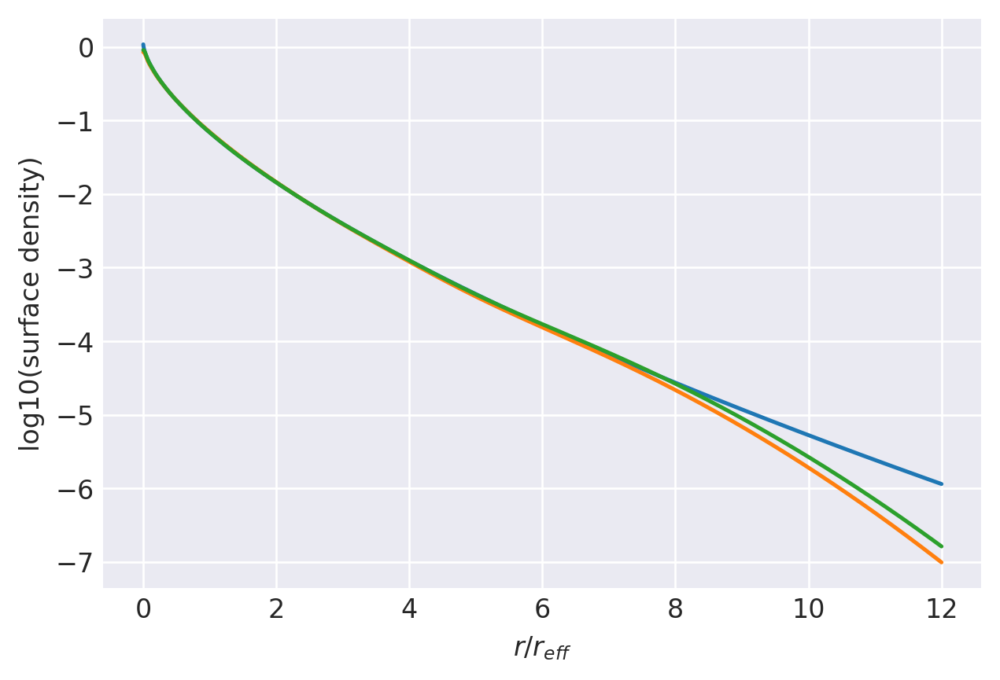

n=1.55: (
    normalize(np.array([7.6502498479e-02, 2.5354872765e-01, 3.0687978075e-01, 2.1456980051e-01, 1.0265743656e-01, 3.5675701527e-02, 8.8329319439e-03, 1.3331225834e-03])),
    np.array([3.2994233123e+00, 1.8798741630e+00, 1.1145222762e+00, 6.5832994552e-01, 3.7767111973e-01, 2.0472029597e-01, 1.0018981396e-01, 3.9356768492e-02]),
),
[6, 24000]
0.999809248153844 0.9999920848336195
prev.  chisq = -7.502741051732712
ws, re: (array([0.0765025 , 0.25354873, 0.30687978, 0.2145698 , 0.10265744,
       0.0356757 , 0.00883293, 0.00133312]), array([3.29942331, 1.87987416, 1.11452228, 0.65832995, 0.37767112,
       0.2047203 , 0.10018981, 0.03935677]))
         Current function value: -9.295707
         Iterations: 31
         Function evaluations: 1558
         Gradient evaluations: 91
-9.295707453928218 [-2.47457782 -0.98051127 -0.18607492  0.3475759   0.78598713  1.23644881
  1.87302356  0.53030194  0.28039836  0.04928607 -0.18272829 -0.4270337
 -0.69574168 -1.0087547  -1.4173156 ]
0.

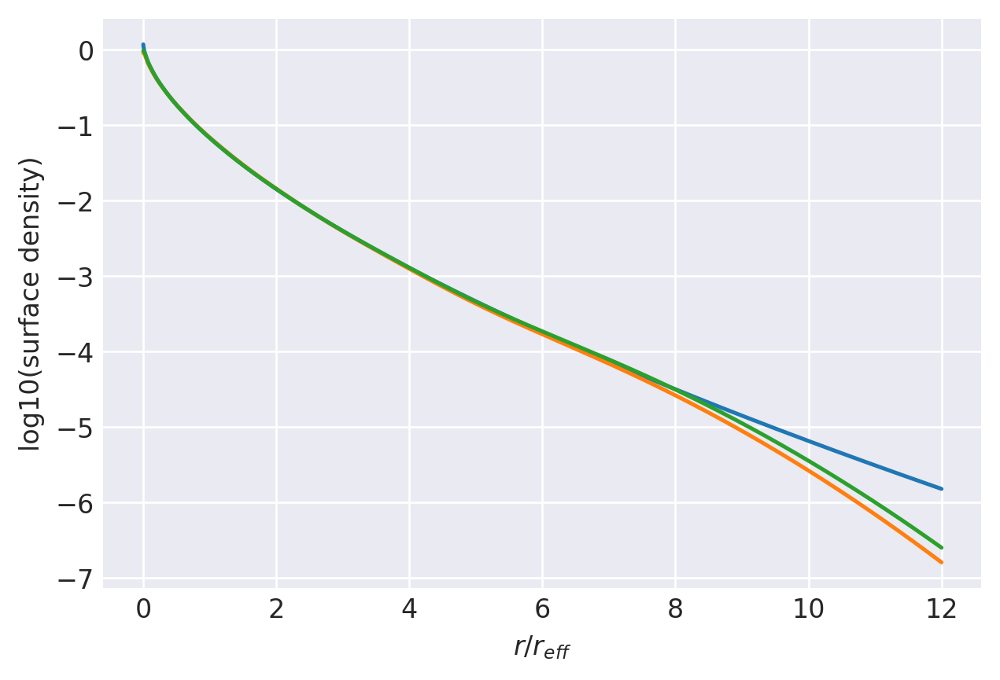

n=1.6: (
    normalize(np.array([7.7659697334e-02, 2.5160553331e-01, 3.0425537109e-01, 2.1476778214e-01, 1.0422118350e-01, 3.6802486285e-02, 9.2643946097e-03, 1.4235517191e-03])),
    np.array([3.3907981746e+00, 1.9072093049e+00, 1.1201754923e+00, 6.5655590499e-01, 3.7408156292e-01, 2.0149223799e-01, 9.8004338621e-02, 3.8254665024e-02]),
),
[7, 24000]
0.9997388353154099 0.9999868822295294
prev.  chisq = -7.525310019866584
ws, re: (array([0.0776597 , 0.25160553, 0.30425537, 0.21476778, 0.10422118,
       0.03680249, 0.00926439, 0.00142355]), array([3.39079817, 1.9072093 , 1.12017549, 0.6565559 , 0.37408156,
       0.20149224, 0.09800434, 0.03825467]))
         Current function value: -9.213154
         Iterations: 29
         Function evaluations: 1950
         Gradient evaluations: 114
-9.213153681209759 [-2.45695798 -0.9878324  -0.2024589   0.3284443   0.76680483  1.21816275
  1.85542376  0.54154511  0.28624328  0.05119423 -0.18408807 -0.43128553
 -0.70267011 -1.01826704 -1.42942591]


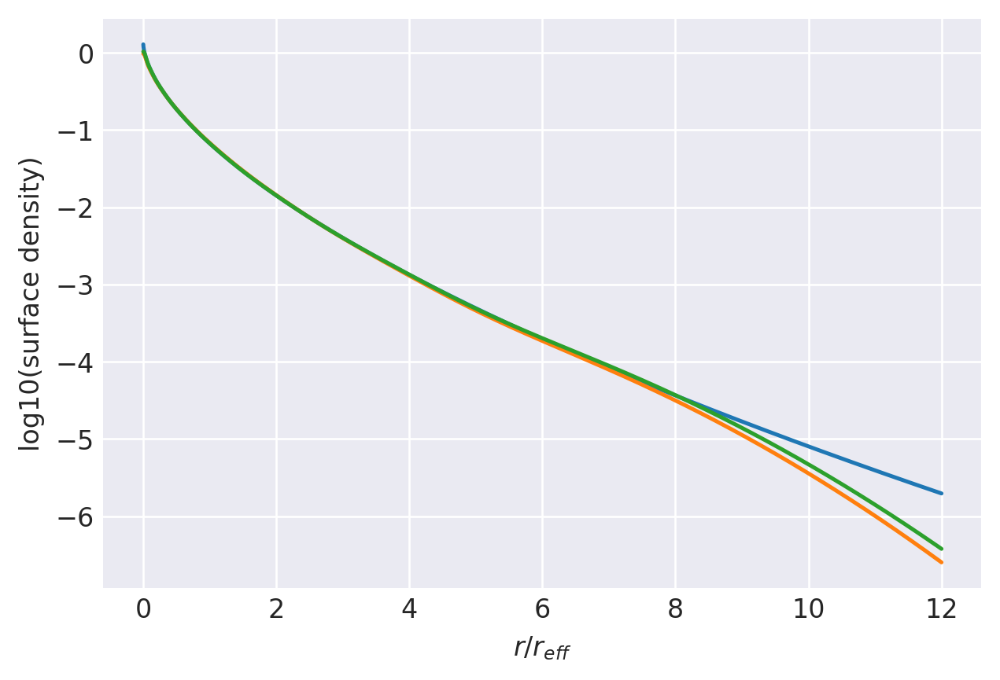

n=1.65: (
    normalize(np.array([7.8931212301e-02, 2.4992320265e-01, 3.0171850423e-01, 2.1477781300e-01, 1.0559905271e-01, 3.7854016279e-02, 9.6820546500e-03, 1.5141441757e-03])),
    np.array([3.4797264841e+00, 1.9330508534e+00, 1.1251080576e+00, 6.5450343136e-01, 3.7043709768e-01, 1.9830327588e-01, 9.5881090366e-02, 3.7202668501e-02]),
),
[8, 24000]
0.9996516909135026 0.9999793063519722
prev.  chisq = -7.5466314726383485
ws, re: (array([0.07893121, 0.2499232 , 0.3017185 , 0.21477781, 0.10559905,
       0.03785402, 0.00968205, 0.00151414]), array([3.47972648, 1.93305085, 1.12510806, 0.65450343, 0.3704371 ,
       0.19830328, 0.09588109, 0.03720267]))
         Current function value: -9.136156
         Iterations: 32
         Function evaluations: 2052
         Gradient evaluations: 120
-9.136156446367469 [-2.43805512 -0.99372924 -0.21744641  0.31052198  0.7485388   1.20046646
  1.83801943  0.55217918  0.29166765  0.05281488 -0.1856342  -0.43563848
 -0.70961632 -1.02769743 -1.44127195

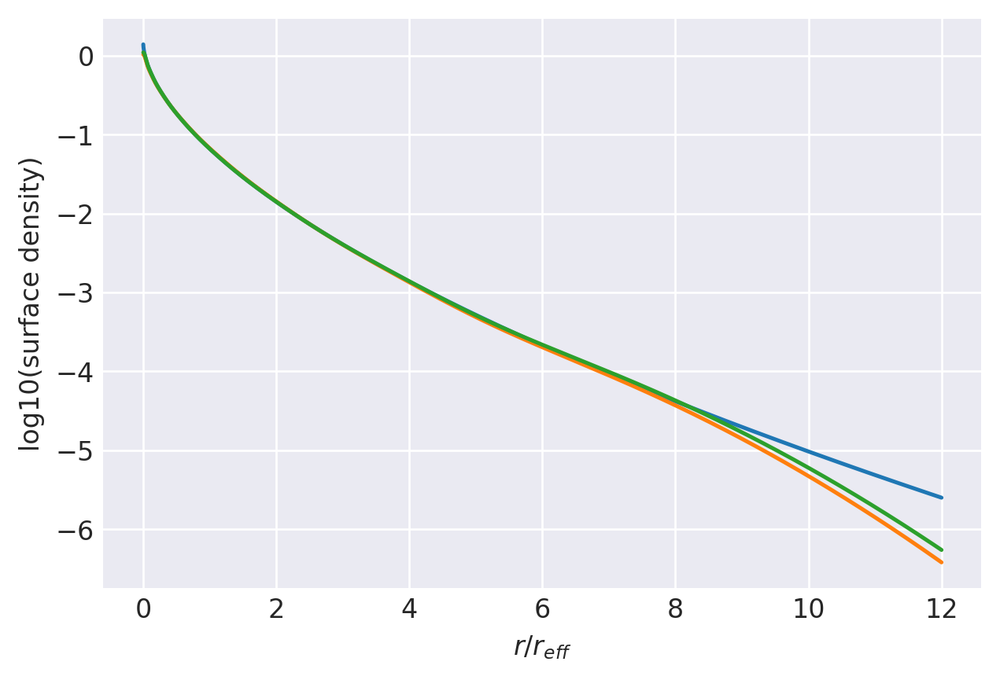

n=1.7: (
    normalize(np.array([8.0316454580e-02, 2.4847652433e-01, 2.9925871617e-01, 2.1461888253e-01, 1.0680468751e-01, 3.8833703020e-02, 1.0086020372e-02, 1.6050114871e-03])),
    np.array([3.5659822904e+00, 1.9573462246e+00, 1.1293144263e+00, 6.5217748014e-01, 3.6674273523e-01, 1.9515679622e-01, 9.3821542858e-02, 3.6201623345e-02]),
),
[9, 24000]
0.9995460765147542 0.9999687459503594
prev.  chisq = -7.566732147568997
ws, re: (array([0.08031645, 0.24847652, 0.29925872, 0.21461888, 0.10680469,
       0.0388337 , 0.01008602, 0.00160501]), array([3.56598229, 1.95734622, 1.12931443, 0.65217748, 0.36674274,
       0.1951568 , 0.09382154, 0.03620162]))
         Current function value: -9.064390
         Iterations: 33
         Function evaluations: 1004
         Gradient evaluations: 59
-9.064389622682441 [-2.41823493 -0.99849321 -0.23126936  0.29360846  0.73102645  1.18320998
  1.82070708  0.5622491   0.29671399  0.05418864 -0.18732496 -0.44004681
 -0.71652858 -1.03698318 -1.45276989]
0

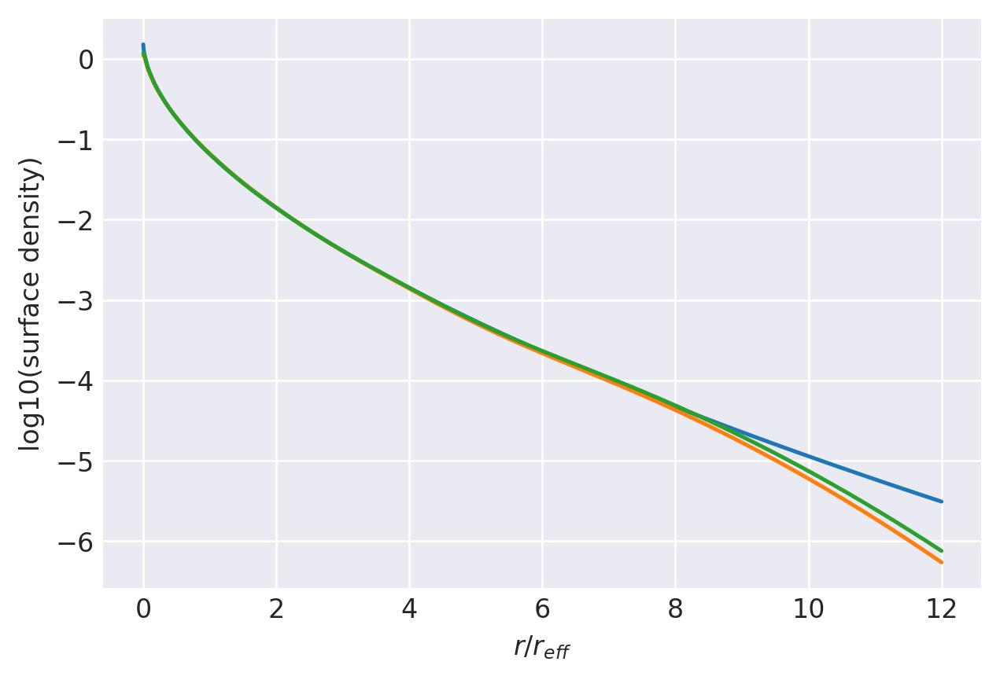

n=1.75: (
    normalize(np.array([8.1792719444e-02, 2.4721608822e-01, 2.9687266395e-01, 2.1432476563e-01, 1.0786566021e-01, 3.9752233523e-02, 1.0479173227e-02, 1.6966957921e-03])),
    np.array([3.6496321913e+00, 1.9802225057e+00, 1.1328923289e+00, 6.4964341109e-01, 3.6303892502e-01, 1.9207525583e-01, 9.1836816370e-02, 3.5255762009e-02]),
),
[10, 24000]
0.9994204058848846 0.9999545473858328
prev.  chisq = -7.585638345918196
ws, re: (array([0.08179272, 0.24721609, 0.29687266, 0.21432477, 0.10786566,
       0.03975223, 0.01047917, 0.0016967 ]), array([3.64963219, 1.98022251, 1.13289233, 0.64964341, 0.36303893,
       0.19207526, 0.09183682, 0.03525576]))
         Current function value: -8.997546
         Iterations: 31
         Function evaluations: 1457
         Gradient evaluations: 85
-8.997546004889452 [-2.39765457 -1.00227829 -0.2440844   0.27756601  0.71414831  1.16628801
  1.80335224  0.57177958  0.30140149  0.05533301 -0.18914237 -0.44448997
 -0.72338094 -1.04608845 -1.46385965]

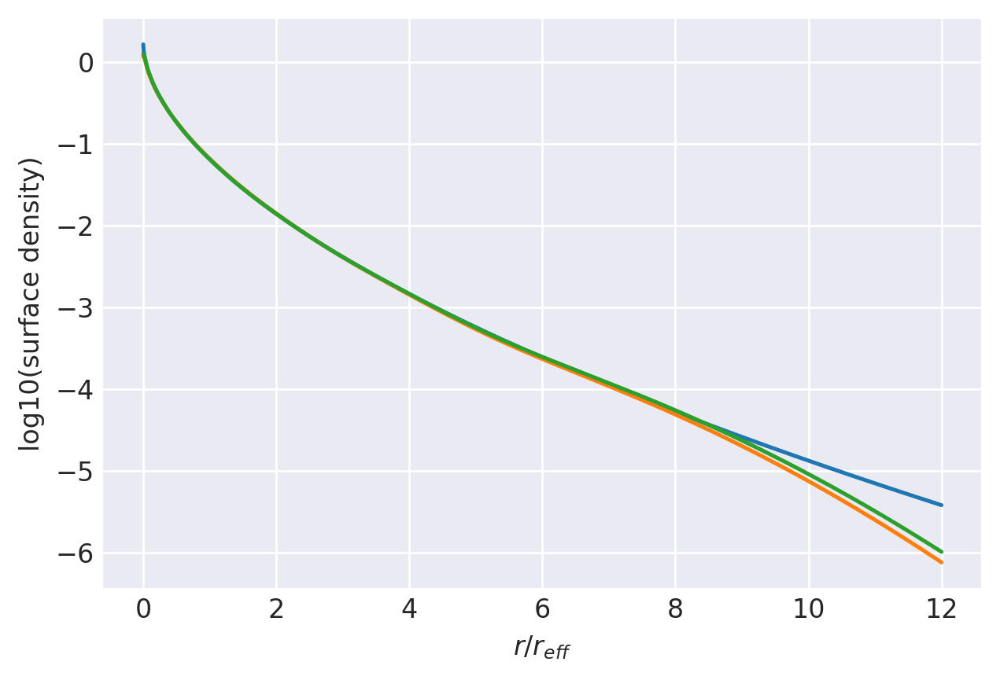

n=1.8: (
    normalize(np.array([8.3351722204e-02, 2.4611430399e-01, 2.9455220557e-01, 2.1391460114e-01, 1.0879846641e-01, 4.0615967394e-02, 1.0863086554e-02, 1.7896467388e-03])),
    np.array([3.7306076482e+00, 2.0017115259e+00, 1.1358814564e+00, 6.4693050933e-01, 3.5934369308e-01, 1.8906844853e-01, 8.9931441250e-02, 3.4366899026e-02]),
),
[12, 24000]
0.999273266155241 0.9999360731129672
prev.  chisq = -7.603884656546581
ws, re: (array([0.08335172, 0.2461143 , 0.29455221, 0.2139146 , 0.10879847,
       0.04061597, 0.01086309, 0.00178965]), array([3.73060765, 2.00171153, 1.13588146, 0.64693051, 0.35934369,
       0.18906845, 0.08993144, 0.0343669 ]))
         Current function value: -8.940054
         Iterations: 32
         Function evaluations: 2068
         Gradient evaluations: 121
-8.940054259606182 [-2.37807696 -1.00663356 -0.25735934  0.2608899   0.69620963  1.14753874
  1.78271768  0.58096252  0.30599927  0.05659992 -0.19063242 -0.44837768
 -0.72938308 -1.05388229 -1.47259363]


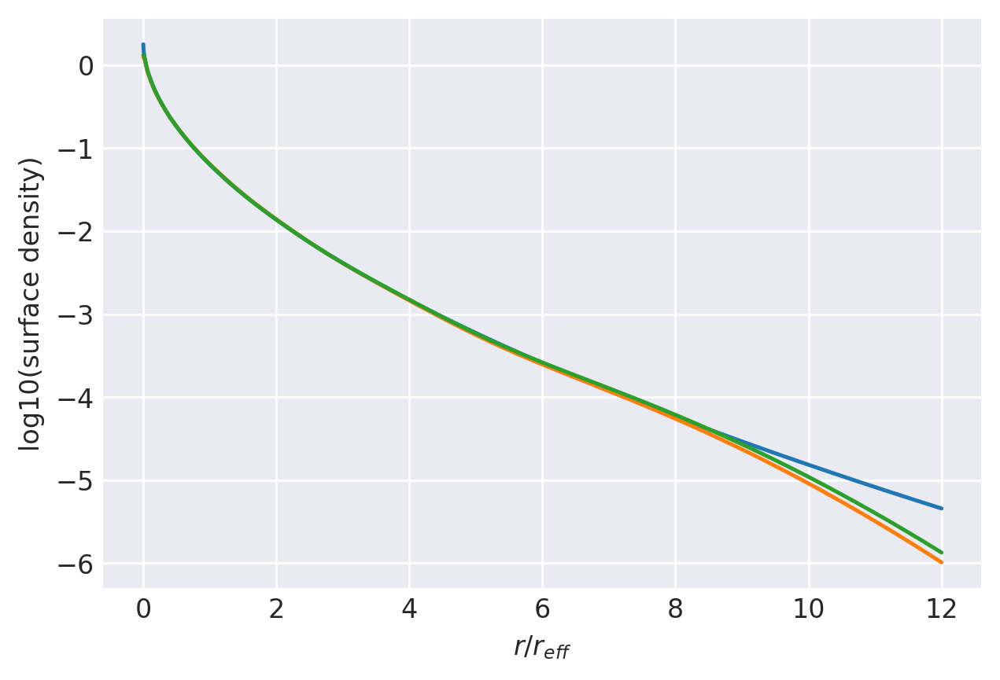

n=1.85: (
    normalize(np.array([8.4859786787e-02, 2.4492738045e-01, 2.9222147586e-01, 2.1351032129e-01, 1.0976590304e-01, 4.1532127128e-02, 1.1285076100e-02, 1.8979293519e-03])),
    np.array([3.8103293712e+00, 2.0230158011e+00, 1.1391998489e+00, 6.4471471080e-01, 3.5614128634e-01, 1.8647341180e-01, 8.8331928038e-02, 3.3682659081e-02]),
),
[13, 24000]
0.9991034306546077 0.9999123873994095
prev.  chisq = -7.620409536616951
ws, re: (array([0.08485979, 0.24492738, 0.29222148, 0.21351032, 0.1097659 ,
       0.04153213, 0.01128508, 0.00189793]), array([3.81032937, 2.0230158 , 1.13919985, 0.64471471, 0.35614129,
       0.18647341, 0.08833193, 0.03368266]))
         Current function value: -8.882781
         Iterations: 32
         Function evaluations: 1542
         Gradient evaluations: 90
-8.8827810062613 [-2.35681708 -1.00919443 -0.26883949  0.24595305  0.67998528  1.13063162
  1.7644533   0.58954002  0.31009688  0.05742415 -0.19254434 -0.45269998
 -0.73587565 -1.06230187 -1.48234773]
0

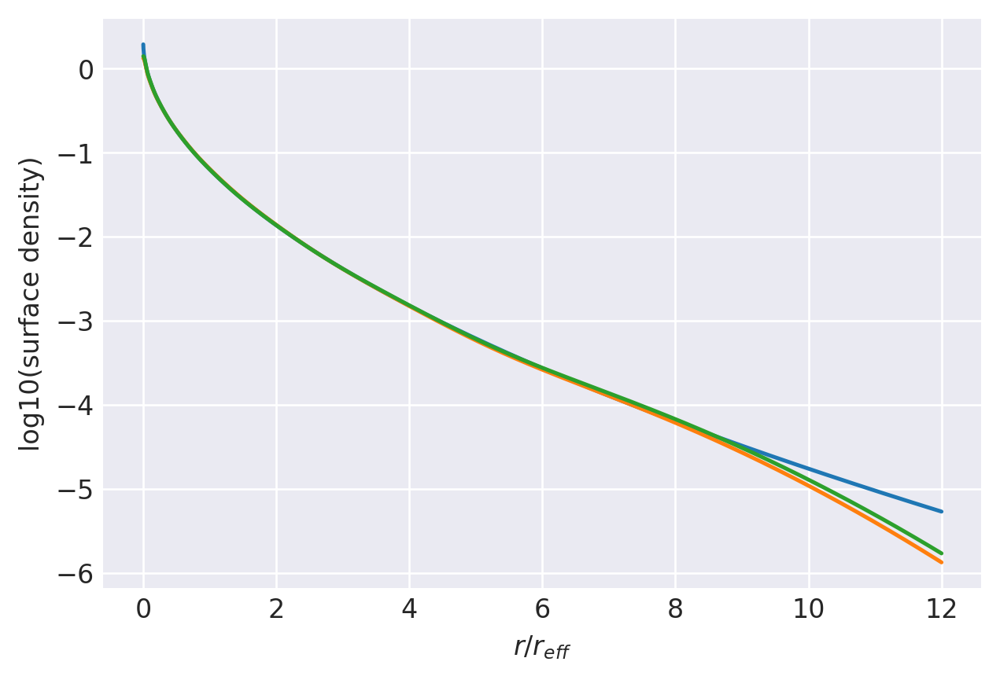

n=1.9: (
    normalize(np.array([8.6525438059e-02, 2.4402333900e-01, 2.9000092883e-01, 2.1293997627e-01, 1.1051879443e-01, 4.2327096857e-02, 1.1666229996e-02, 1.9981965418e-03])),
    np.array([3.8863330674e+00, 2.0421934711e+00, 1.1413639564e+00, 6.4188268409e-01, 3.5261438172e-01, 1.8370642688e-01, 8.6635948313e-02, 3.2934590375e-02]),
),
[15, 24000]
0.998909864591524 0.9998833903369703
prev.  chisq = -7.6369060422132655
ws, re: (array([0.08652544, 0.24402334, 0.29000093, 0.21293998, 0.11051879,
       0.0423271 , 0.01166623, 0.0019982 ]), array([3.88633307, 2.04219347, 1.14136396, 0.64188268, 0.35261438,
       0.18370643, 0.08663595, 0.03293459]))
         Current function value: -8.835670
         Iterations: 33
         Function evaluations: 2187
         Gradient evaluations: 128
-8.835670438038889 [-2.33756215 -1.01321473 -0.28162257  0.2295433   0.66180423  1.11083786
  1.7414705   0.59791623  0.31428085  0.05858405 -0.19386756 -0.45613935
 -0.74109356 -1.06882349 -1.48879474]

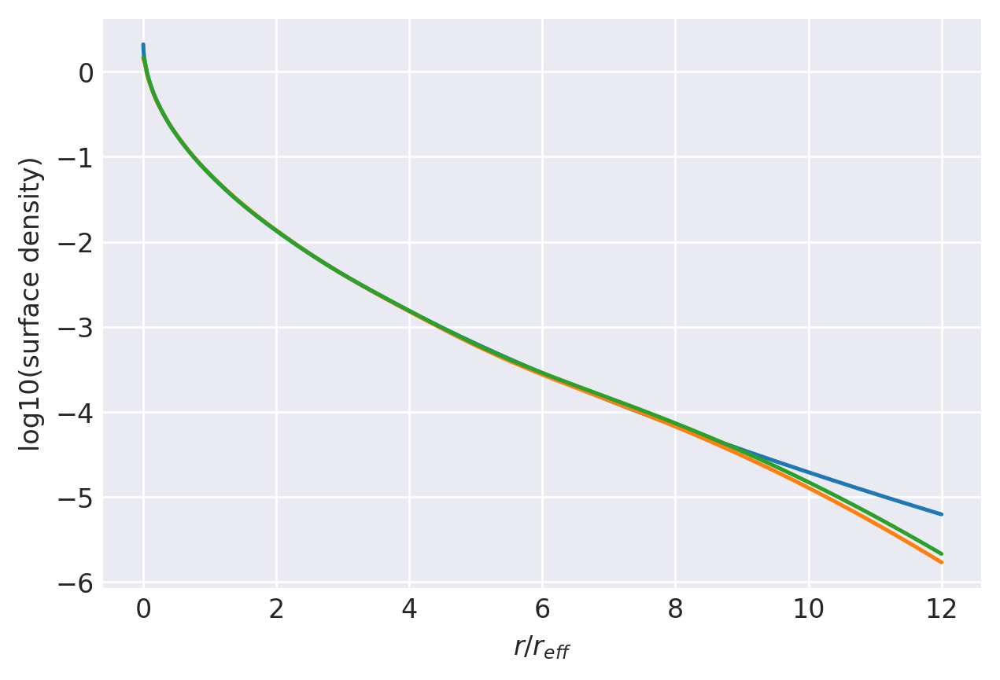

n=1.95: (
    normalize(np.array([8.8059490056e-02, 2.4289644458e-01, 2.8772643188e-01, 2.1244546632e-01, 1.1139915392e-01, 4.3236101897e-02, 1.2113814150e-02, 2.1230971980e-03])),
    np.array([3.9620160875e+00, 2.0619629285e+00, 1.1444163438e+00, 6.3992994883e-01, 3.4983289641e-01, 1.8151245748e-01, 8.5344690276e-02, 3.2449294525e-02]),
),
[16, 24000]
0.998691724858366 0.9998475828372719
prev.  chisq = -7.651325096914837
ws, re: (array([0.08805949, 0.24289644, 0.28772643, 0.21244547, 0.11139915,
       0.0432361 , 0.01211381, 0.0021231 ]), array([3.96201609, 2.06196293, 1.14441634, 0.63992995, 0.3498329 ,
       0.18151246, 0.08534469, 0.03244929]))
         Current function value: -8.786758
         Iterations: 30
         Function evaluations: 1899
         Gradient evaluations: 111
-8.786758493052405 [-2.31624399 -1.01510226 -0.29227411  0.21526765  0.64585652  1.09362789
  1.72205478  0.60566433  0.31789753  0.05919295 -0.19576667 -0.4602247
 -0.74709419 -1.07639882 -1.49701361]


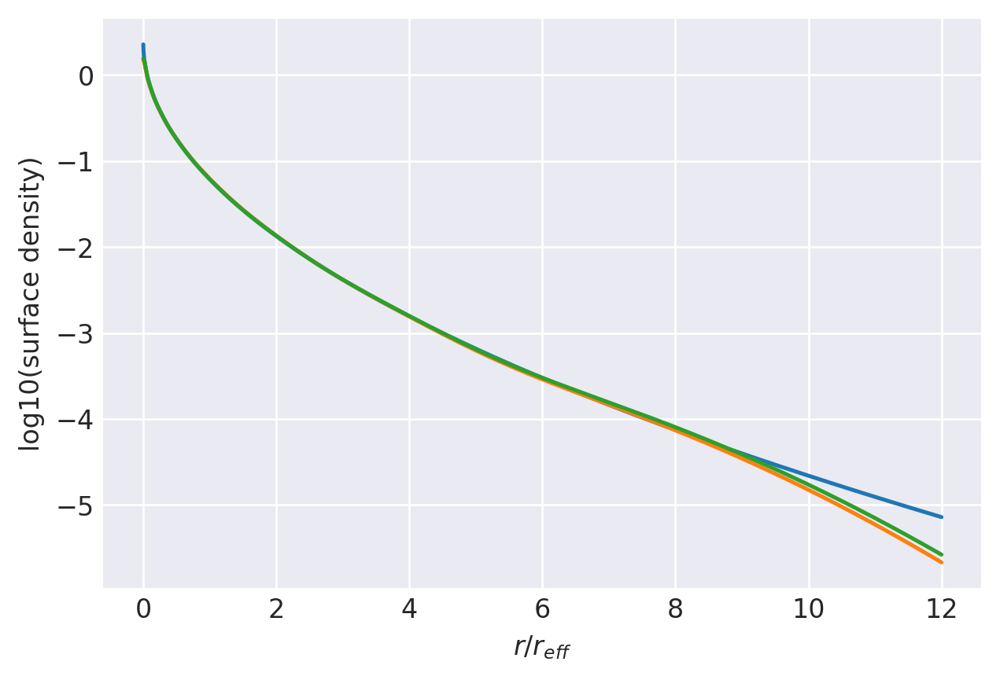

n=2.0: (
    normalize(np.array([8.9786546272e-02, 2.4210086689e-01, 2.8558286745e-01, 2.1177229654e-01, 1.1202986958e-01, 4.3990711321e-02, 1.2502638197e-02, 2.2342037485e-03])),
    np.array([4.0333353618e+00, 2.0792060391e+00, 1.1460219960e+00, 6.3713774459e-01, 3.4655749472e-01, 1.7902175374e-01, 8.3868944314e-02, 3.1840977387e-02]),
),
[18, 24000]
0.9984483551975021 0.9998057721399655
prev.  chisq = -7.66641554294581
ws, re: (array([0.08978655, 0.24210087, 0.28558287, 0.2117723 , 0.11202987,
       0.04399071, 0.01250264, 0.0022342 ]), array([4.03333536, 2.07920604, 1.146022  , 0.63713774, 0.34655749,
       0.17902175, 0.08386894, 0.03184098]))
         Current function value: -8.748569
         Iterations: 29
         Function evaluations: 2086
         Gradient evaluations: 122
-8.748568758882248 [-2.297731   -1.0191851  -0.30493691  0.19880838  0.62719529  1.07265661
  1.69682075  0.61334571  0.3217635   0.06033473 -0.1968365  -0.46312833
 -0.75143777 -1.08155822 -1.50112835]


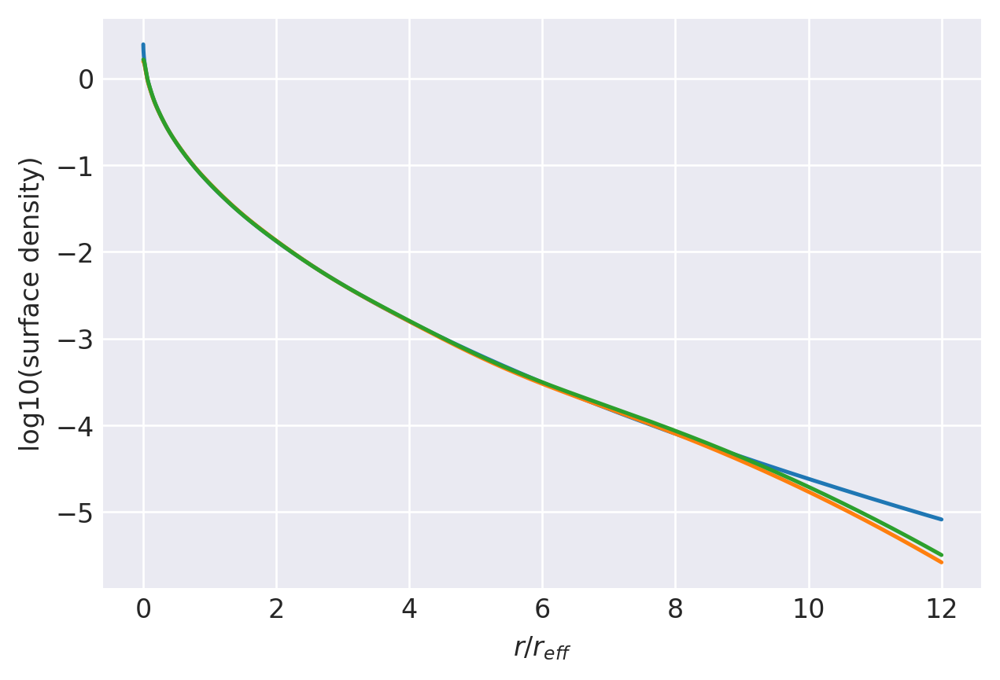

n=2.05: (
    normalize(np.array([9.1311053153e-02, 2.4097173563e-01, 2.8334650653e-01, 2.1122670585e-01, 1.1286447502e-01, 4.4914381823e-02, 1.2985374205e-02, 2.3797677884e-03])),
    np.array([4.1053076191e+00, 2.0977972032e+00, 1.1490388919e+00, 6.3557015970e-01, 3.4424819592e-01, 1.7724019997e-01, 8.2878481238e-02, 3.1540723588e-02]),
),
[19, 24000]
0.9981792778675241 0.9997555030405284
prev.  chisq = -7.678947010000141
ws, re: (array([0.09131105, 0.24097174, 0.28334651, 0.21122671, 0.11286448,
       0.04491438, 0.01298537, 0.00237977]), array([4.10530762, 2.0977972 , 1.14903889, 0.63557016, 0.3442482 ,
       0.1772402 , 0.08287848, 0.03154072]))
         Current function value: -8.706845
         Iterations: 32
         Function evaluations: 1678
         Gradient evaluations: 98
-8.7068449460529 [-2.27676806 -1.02074784 -0.3150717   0.18493171  0.61132845  1.05504051
  1.67631589  0.62037188  0.3249861   0.06080336 -0.1986544  -0.46691152
 -0.75688276 -1.08823061 -1.50779597]
0

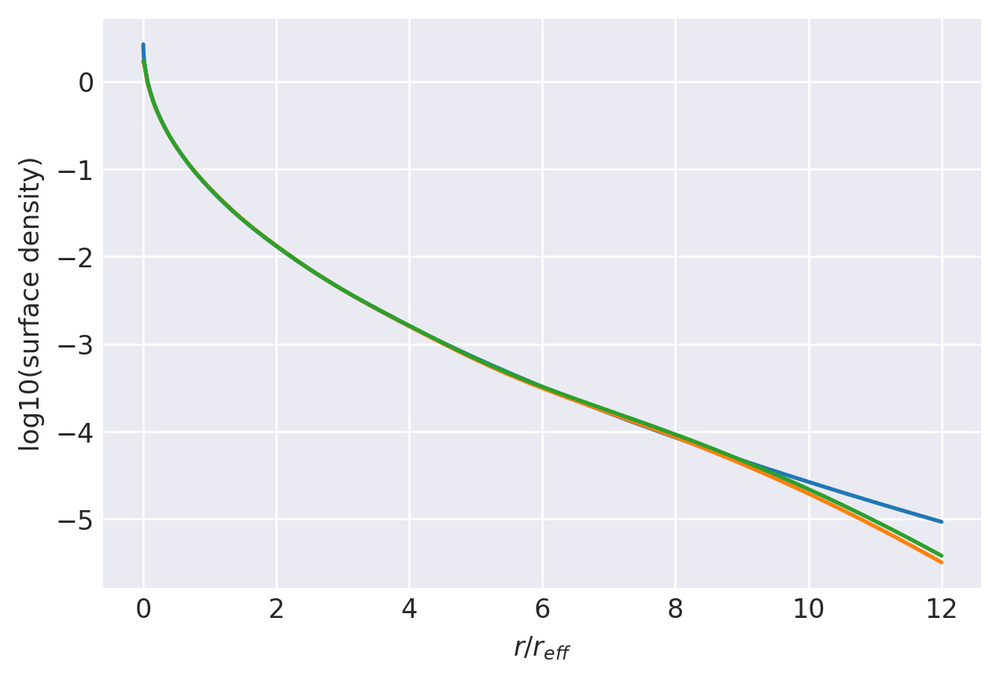

n=2.1: (
    normalize(np.array([9.3065383966e-02, 2.4023043428e-01, 2.8126734611e-01, 2.1048767797e-01, 1.1340970337e-01, 4.5646375770e-02, 1.3388584871e-02, 2.5044936620e-03])),
    np.array([4.1722649107e+00, 2.1134213835e+00, 1.1502794396e+00, 6.3291530847e-01, 3.4126243129e-01, 1.7503191198e-01, 8.1614888166e-02, 3.1060184091e-02]),
),
[21, 24000]
0.997884182807956 0.9996990758210779
prev.  chisq = -7.692977607509652
ws, re: (array([0.09306538, 0.24023043, 0.28126735, 0.21048768, 0.1134097 ,
       0.04564638, 0.01338858, 0.00250449]), array([4.17226491, 2.11342138, 1.15027944, 0.63291531, 0.34126243,
       0.17503191, 0.08161489, 0.03106018]))
         Current function value: -8.676181
         Iterations: 29
         Function evaluations: 1746
         Gradient evaluations: 102
-8.676181474398408 [-2.25917866 -1.02506185 -0.3277685   0.16831684  0.59216774  1.03302052
  1.64927318  0.62744569  0.32859594  0.06197166 -0.19944053 -0.46926421
 -0.76035731 -1.09207367 -1.50976858]


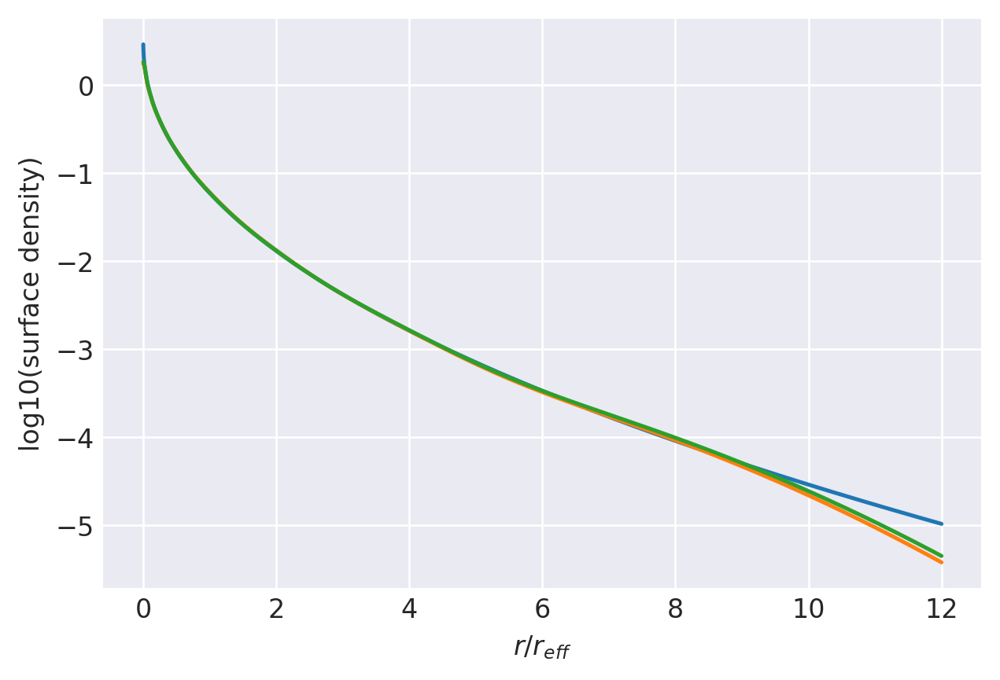

n=2.15: (
    normalize(np.array([9.4560667830e-02, 2.3907454315e-01, 2.7906269857e-01, 2.0991004357e-01, 1.1421606407e-01, 4.6592354706e-02, 1.3910227751e-02, 2.6734003477e-03])),
    np.array([4.2407794536e+00, 2.1310612704e+00, 1.1533779971e+00, 6.3177067896e-01, 3.3941872203e-01, 1.7363716523e-01, 8.0895866585e-02, 3.0919425446e-02]),
),
[23, 24000]
0.9975629151475797 0.9996325354440632
prev.  chisq = -7.706001984983542
ws, re: (array([0.09456067, 0.23907454, 0.2790627 , 0.20991004, 0.11421606,
       0.04659235, 0.01391023, 0.0026734 ]), array([4.24077945, 2.13106127, 1.153378  , 0.63177068, 0.33941872,
       0.17363717, 0.08089587, 0.03091943]))
         Current function value: -8.648975
         Iterations: 27
         Function evaluations: 1695
         Gradient evaluations: 99
-8.648975073396176 [-2.24215247 -1.02960656 -0.34059534  0.15152381  0.57267988  1.01044486
  1.62142101  0.6342564   0.33211645  0.06319255 -0.2000439  -0.47129796
 -0.76335152 -1.09521403 -1.51066266]

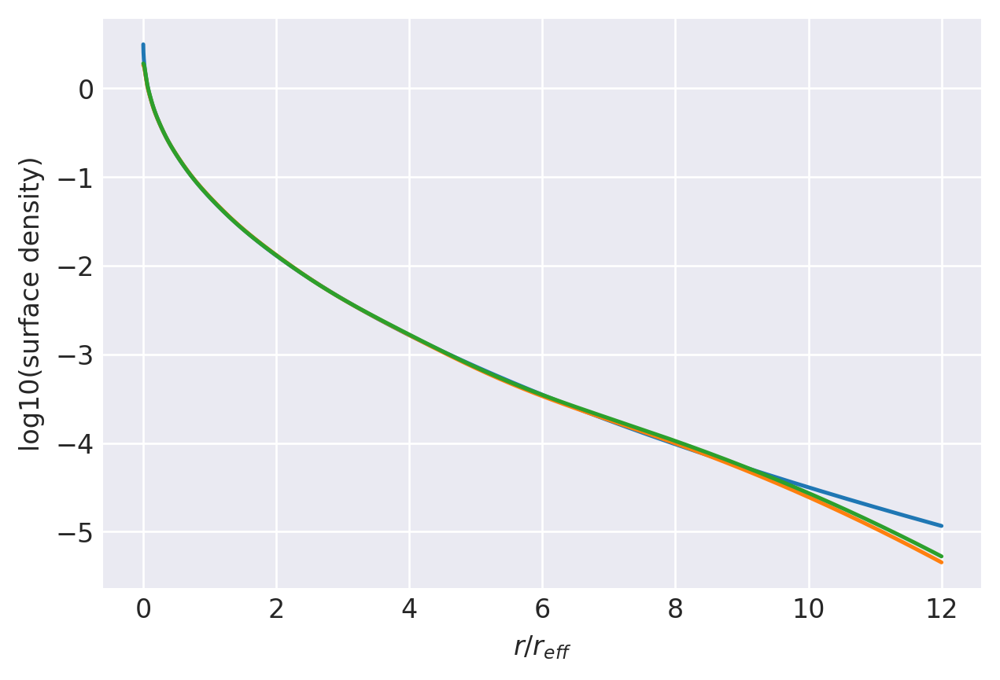

n=2.2: (
    normalize(np.array([9.6028529866e-02, 2.3788948189e-01, 2.7686688315e-01, 2.0932324686e-01, 1.1501949238e-01, 4.7558398441e-02, 1.4457007159e-02, 2.8569602593e-03])),
    np.array([4.3078086442e+00, 2.1484064489e+00, 1.1566249352e+00, 6.3089356733e-01, 3.3783297771e-01, 1.7244415561e-01, 8.0313022800e-02, 3.0855837253e-02]),
),
[25, 24000]
0.9972154617500036 0.9995570547516801
prev.  chisq = -7.718673949936787
ws, re: (array([0.09602853, 0.23788948, 0.27686688, 0.20932325, 0.11501949,
       0.0475584 , 0.01445701, 0.00285696]), array([4.30780864, 2.14840645, 1.15662494, 0.63089357, 0.33783298,
       0.17244416, 0.08031302, 0.03085584]))
         Current function value: -8.624876
         Iterations: 26
         Function evaluations: 1457
         Gradient evaluations: 85
-8.62487586592299 [-2.22565241 -1.03434994 -0.3535193   0.13459944  0.55294018  0.98744494
  1.59301322  0.64081475  0.33554955  0.06446019 -0.20047843 -0.47303685
 -0.76590407 -1.0977174  -1.51061906]
0

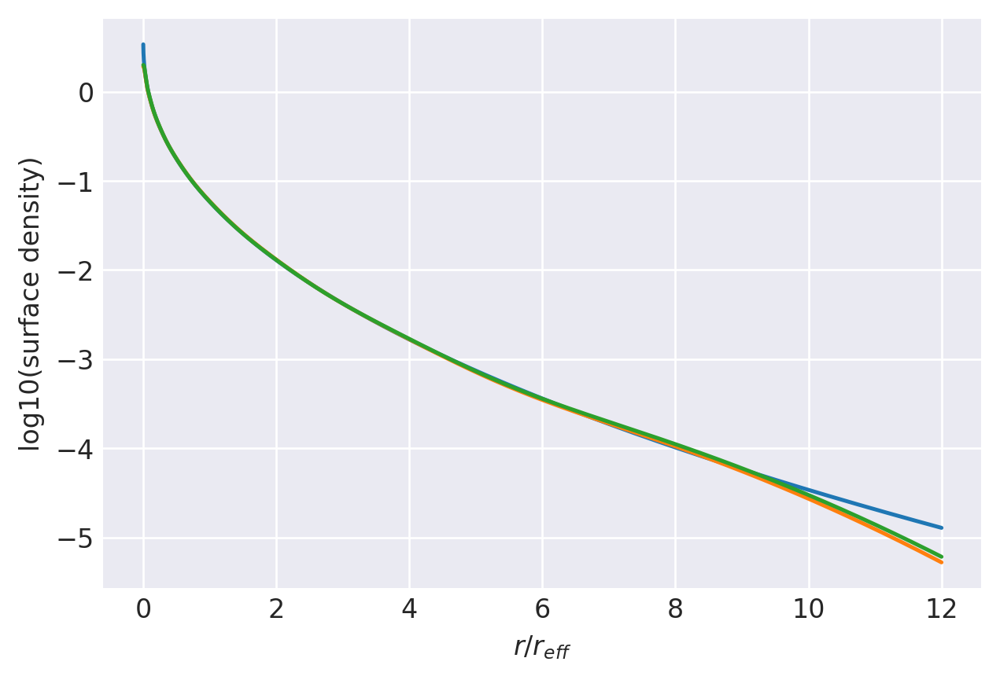

n=2.25: (
    normalize(np.array([9.7470429917e-02, 2.3668084097e-01, 2.7468208464e-01, 2.0872618880e-01, 1.1581638769e-01, 4.8541160367e-02, 1.5027612673e-02, 3.0552949499e-03])),
    np.array([4.3733551694e+00, 2.1654569253e+00, 1.1600058803e+00, 6.3026264779e-01, 3.3648301923e-01, 1.7143359303e-01, 7.9851411978e-02, 3.0858935506e-02]),
),
[27, 24000]
0.9968419373495957 0.9994723653027056
prev.  chisq = -7.731060829016109
ws, re: (array([0.09747043, 0.23668084, 0.27468208, 0.20872619, 0.11581639,
       0.04854116, 0.01502761, 0.00305529]), array([4.37335517, 2.16545693, 1.16000588, 0.63026265, 0.33648302,
       0.17143359, 0.07985141, 0.03085894]))
         Current function value: -8.603575
         Iterations: 23
         Function evaluations: 1660
         Gradient evaluations: 97
-8.603574635341394 [-2.20962936 -1.03925448 -0.36650373  0.11759241  0.53302207  0.96414588
  1.56427351  0.64713031  0.33889447  0.06576646 -0.2007603  -0.47450667
 -0.76805494 -1.0996489  -1.50976906]

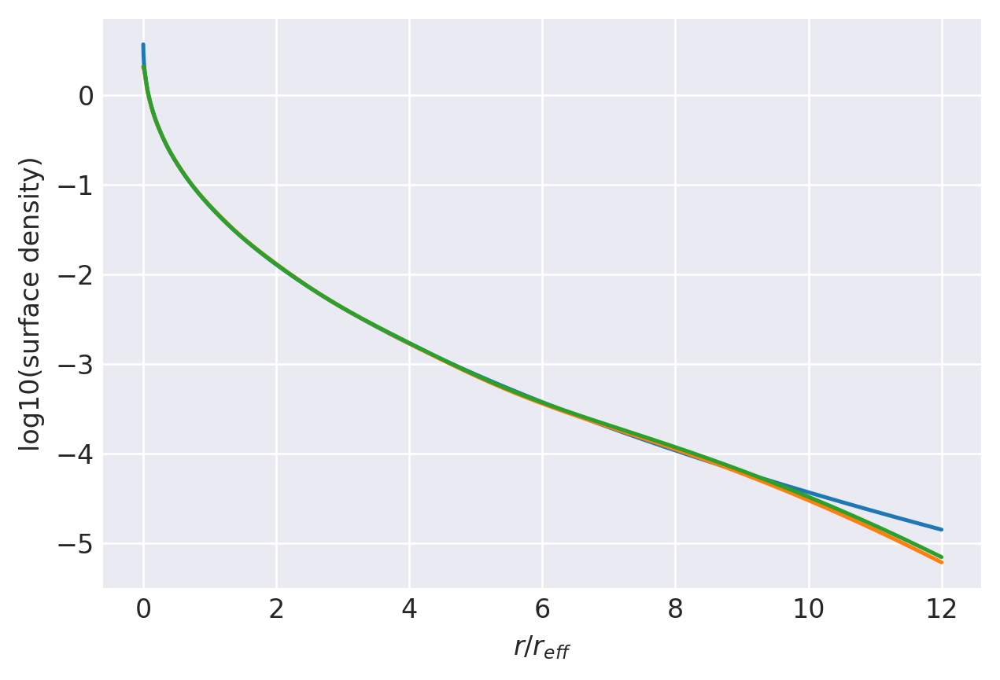

n=2.3: (
    normalize(np.array([9.8889096241e-02, 2.3545475290e-01, 2.7251038398e-01, 2.0811732294e-01, 1.1660264692e-01, 4.9536931821e-02, 1.5620443979e-02, 3.2684212245e-03])),
    np.array([4.4374176499e+00, 2.1821996018e+00, 1.1635001970e+00, 6.2985371711e-01, 3.3534615500e-01, 1.7058665658e-01, 7.9497065927e-02, 3.0919391789e-02]),
),
[29, 24000]
0.9964425707061946 0.9993782879304212
prev.  chisq = -7.743232346150179
ws, re: (array([0.0988891 , 0.23545475, 0.27251038, 0.20811732, 0.11660265,
       0.04953693, 0.01562044, 0.00326842]), array([4.43741765, 2.1821996 , 1.1635002 , 0.62985372, 0.33534616,
       0.17058666, 0.07949707, 0.03091939]))
         Current function value: -8.584799
         Iterations: 25
         Function evaluations: 1695
         Gradient evaluations: 99
-8.584799274591617 [-2.19405825 -1.04428859 -0.3795147   0.10054267  0.51299474  0.94065775
  1.53539532  0.65321271  0.34215315  0.06710476 -0.20090332 -0.47573051
 -0.76984052 -1.10106802 -1.50823029]


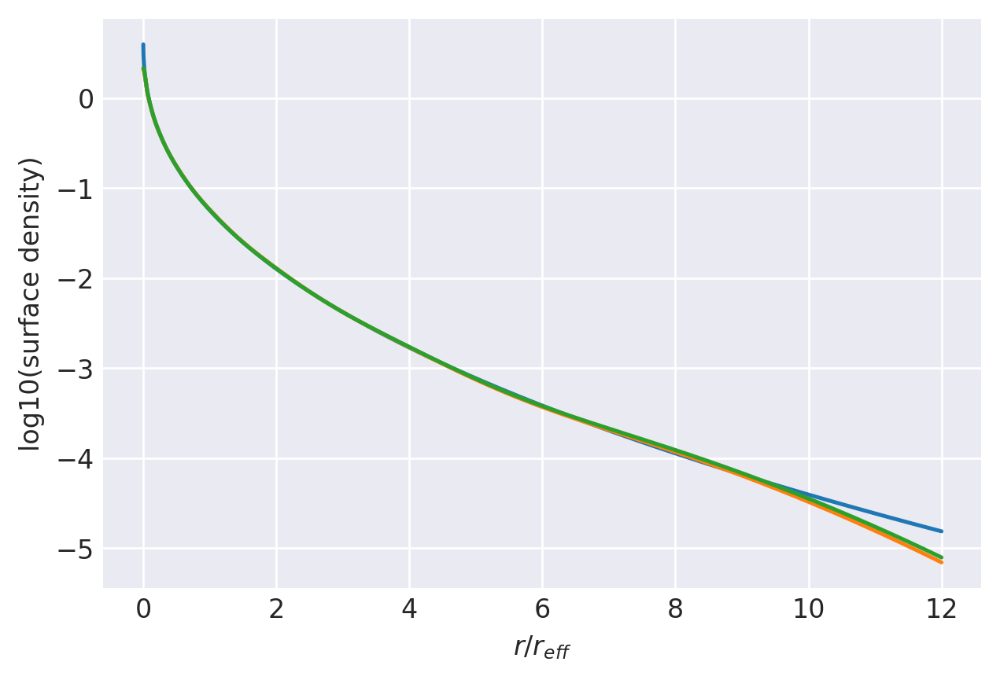

n=2.35: (
    normalize(np.array([1.0028533064e-01, 2.3421674119e-01, 2.7035450796e-01, 2.0749554489e-01, 1.1737529400e-01, 5.0542324332e-02, 1.6233943825e-02, 3.4963131646e-03])),
    np.array([4.5000020591e+00, 2.1986350402e+00, 1.1670911177e+00, 6.2964633820e-01, 3.3440247976e-01, 1.6988673764e-01, 7.9237722162e-02, 3.1029137590e-02]),
),
[31, 24000]
0.9960176910998889 0.9992747343707247
prev.  chisq = -7.75523635126757
ws, re: (array([0.10028533, 0.23421674, 0.27035451, 0.20749554, 0.11737529,
       0.05054232, 0.01623394, 0.00349631]), array([4.50000206, 2.19863504, 1.16709112, 0.62964634, 0.33440248,
       0.16988674, 0.07923772, 0.03102914]))
         Current function value: -8.568311
         Iterations: 26
         Function evaluations: 1626
         Gradient evaluations: 95
-8.568310565592087 [-2.17891432 -1.04943426 -0.39252957  0.0834928   0.49291797  0.91708303
  1.50655088  0.65907243  0.34532756  0.06847127 -0.20091916 -0.47672924
 -0.77129439 -1.1020304  -1.50611008]


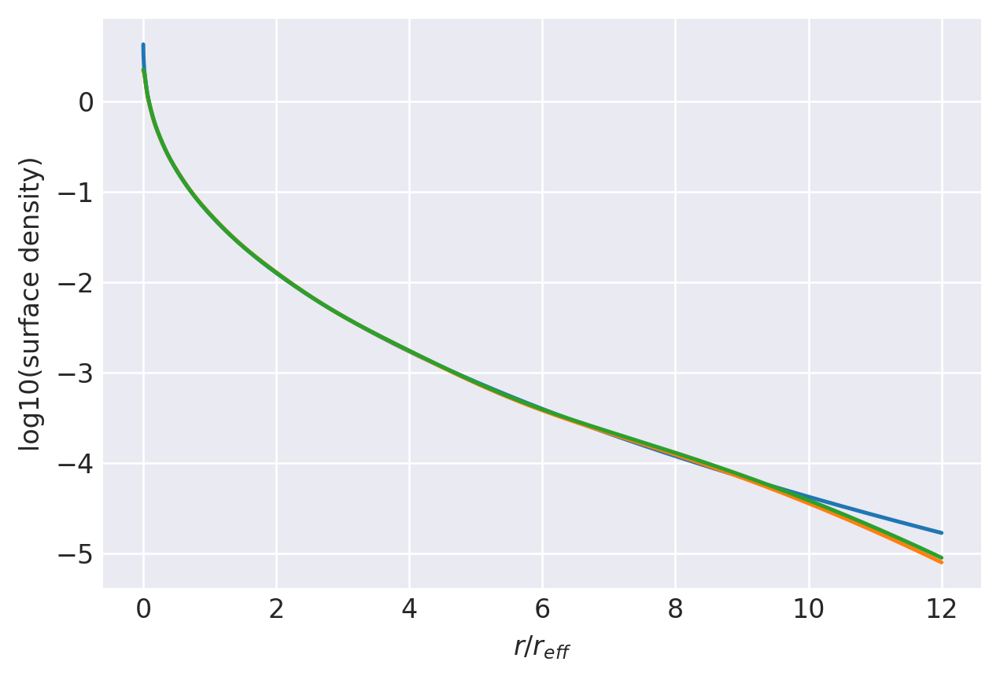

n=2.4: (
    normalize(np.array([1.0166003476e-01, 2.3296987403e-01, 2.6821634326e-01, 2.0686193148e-01, 1.1813193974e-01, 5.1554434841e-02, 1.6866573852e-02, 3.7388680455e-03])),
    np.array([4.5611298048e+00, 2.2147645380e+00, 1.1707691399e+00, 6.2962336691e-01, 3.3363435335e-01, 1.6931896763e-01, 7.9062328884e-02, 3.1180991102e-02]),
),
[33, 24000]
0.9955677153976663 0.999161676370142
prev.  chisq = -7.767133384601092
ws, re: (array([0.10166003, 0.23296987, 0.26821634, 0.20686193, 0.11813194,
       0.05155443, 0.01686657, 0.00373887]), array([4.5611298 , 2.21476454, 1.17076914, 0.62962337, 0.33363435,
       0.16931897, 0.07906233, 0.03118099]))
         Current function value: -8.553898
         Iterations: 24
         Function evaluations: 1763
         Gradient evaluations: 103
-8.55389796337675 [-2.16417739 -1.05466801 -0.4055215   0.06647451  0.47284379  0.89350455
  1.47787368  0.66471931  0.34841971  0.06986072 -0.20081963 -0.47752234
 -0.77244695 -1.10258457 -1.50349833]
0

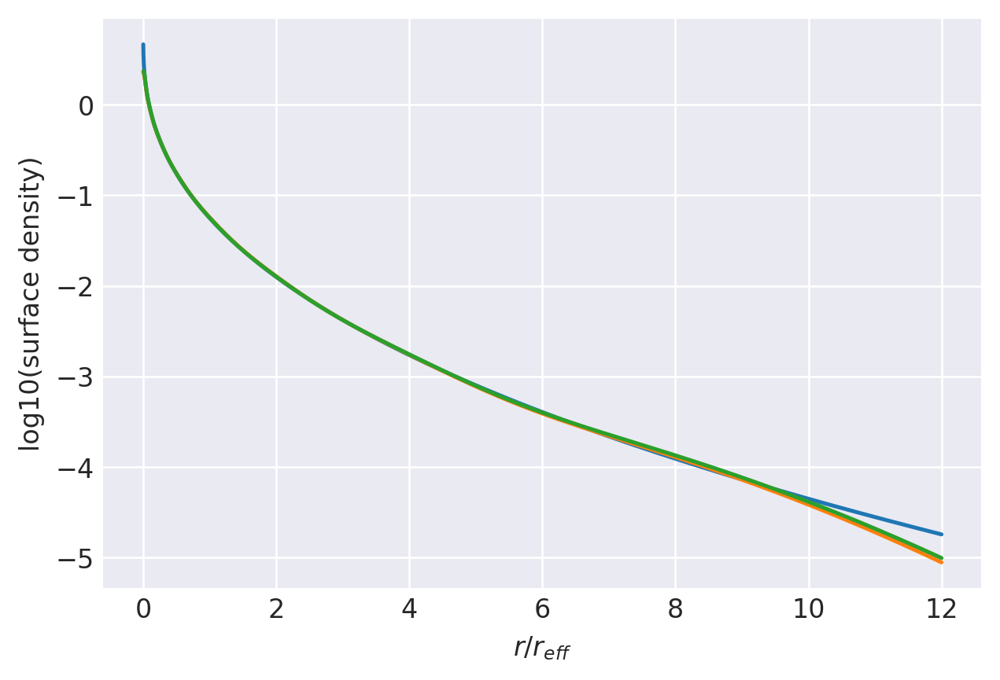

n=2.45: (
    normalize(np.array([1.0301381181e-01, 2.3171819387e-01, 2.6609819340e-01, 2.0621611304e-01, 1.1887039716e-01, 5.2570455687e-02, 1.7516851707e-02, 3.9959833419e-03])),
    np.array([4.6208227573e+00, 2.2305897891e+00, 1.1745208099e+00, 6.2976767881e-01, 3.3302563275e-01, 1.6887021095e-01, 7.8961506797e-02, 3.1369071976e-02]),
),
[35, 24000]
0.9950931358505836 0.9990391601264504
prev.  chisq = -7.77896993073643
ws, re: (array([0.10301381, 0.23171819, 0.26609819, 0.20621611, 0.1188704 ,
       0.05257046, 0.01751685, 0.00399598]), array([4.62082276, 2.23058979, 1.17452081, 0.62976768, 0.33302563,
       0.16887021, 0.07896151, 0.03136907]))
         Current function value: -8.541376
         Iterations: 23
         Function evaluations: 1389
         Gradient evaluations: 81
-8.5413757044378 [-2.14983461 -1.05997636 -0.41847512  0.04951677  0.45281477  0.86999419
  1.44947441  0.67016358  0.35143279  0.07127053 -0.20061356 -0.47812593
 -0.77332421 -1.10277316 -1.50047198]
0.

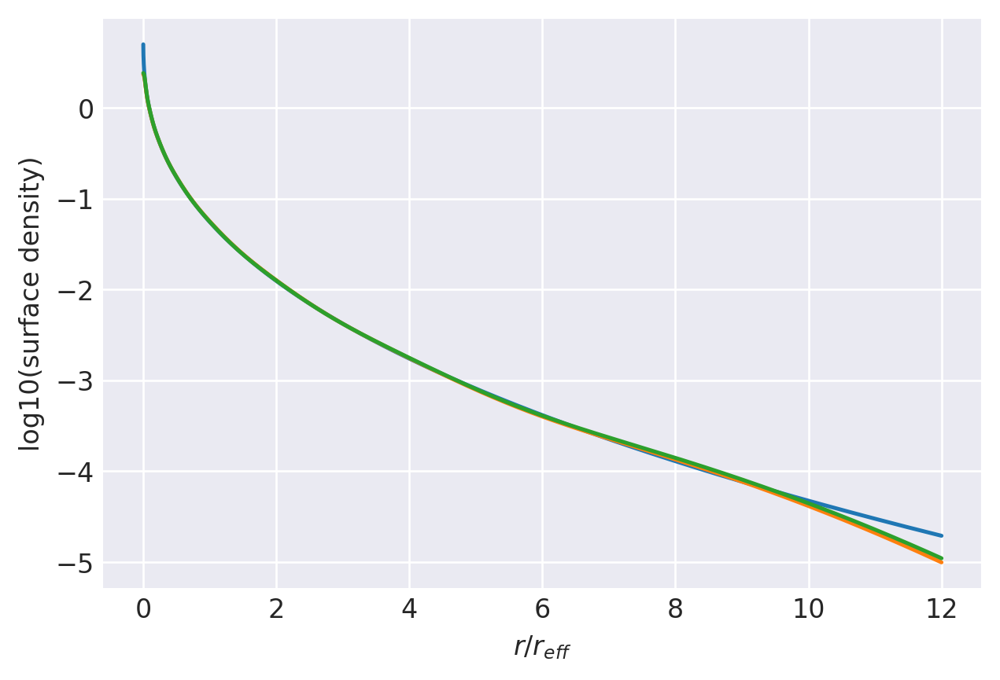

n=2.5: (
    normalize(np.array([1.0434667937e-01, 2.3046411306e-01, 2.6400142262e-01, 2.0555925868e-01, 1.1958933457e-01, 5.3588201227e-02, 1.8183450788e-02, 4.2675396887e-03])),
    np.array([4.6791134476e+00, 2.2461191703e+00, 1.1783397657e+00, 6.3006657699e-01, 3.3256310574e-01, 1.6852944520e-01, 7.8927226659e-02, 3.1588428386e-02]),
),
[37, 24000]
0.9945945087216512 0.9989072829773387
prev.  chisq = -7.790791215863488
ws, re: (array([0.10434668, 0.23046411, 0.26400142, 0.20555926, 0.11958933,
       0.0535882 , 0.01818345, 0.00426754]), array([4.67911345, 2.24611917, 1.17833977, 0.63006658, 0.33256311,
       0.16852945, 0.07892723, 0.03158843]))
         Current function value: -8.530579
         Iterations: 25
         Function evaluations: 1286
         Gradient evaluations: 75
-8.530579360296889 [-2.13585269 -1.06532519 -0.43136061  0.03264486  0.43287664  0.84661746
  1.42144485  0.67541259  0.35436493  0.07269217 -0.20031447 -0.47855996
 -0.7739549  -1.10263975 -1.49710271]


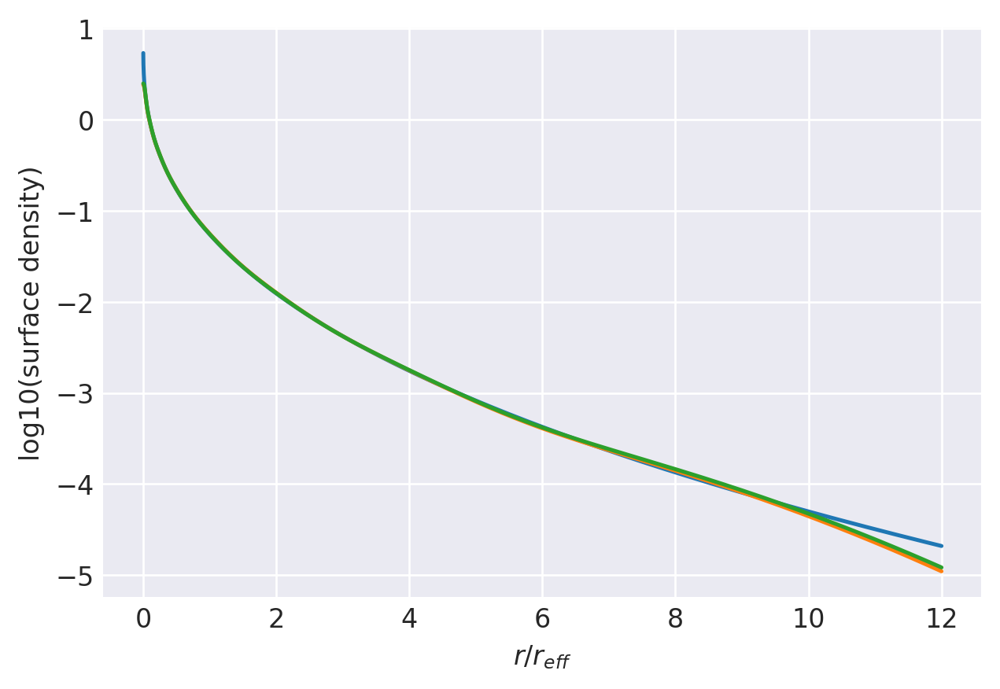

n=2.55: (
    normalize(np.array([1.0566065506e-01, 2.2921302115e-01, 2.6192772847e-01, 2.0488959617e-01, 1.2028638048e-01, 5.4604683332e-02, 1.8864664948e-02, 4.5532703911e-03])),
    np.array([4.7360097467e+00, 2.2613351170e+00, 1.1822033202e+00, 6.3050063632e-01, 3.3223091618e-01, 1.6828488073e-01, 7.8951474830e-02, 3.1834445606e-02]),
),
[40, 24000]
0.9940724437988419 0.9987662322235185
prev.  chisq = -7.806777227380031
ws, re: (array([0.10566066, 0.22921302, 0.26192773, 0.2048896 , 0.12028638,
       0.05460468, 0.01886466, 0.00455327]), array([4.73600975, 2.26133512, 1.18220332, 0.63050064, 0.33223092,
       0.16828488, 0.07895147, 0.03183445]))
Optimization terminated successfully.
         Current function value: -8.530619
         Iterations: 26
         Function evaluations: 697
         Gradient evaluations: 41
-8.530618924045099 [-2.12562957 -1.07418802 -0.44769099  0.01216714  0.40889482  0.81843662
  1.38754844  0.68097029  0.35799231  0.07518438 -0.19854623 -0.4770545
 

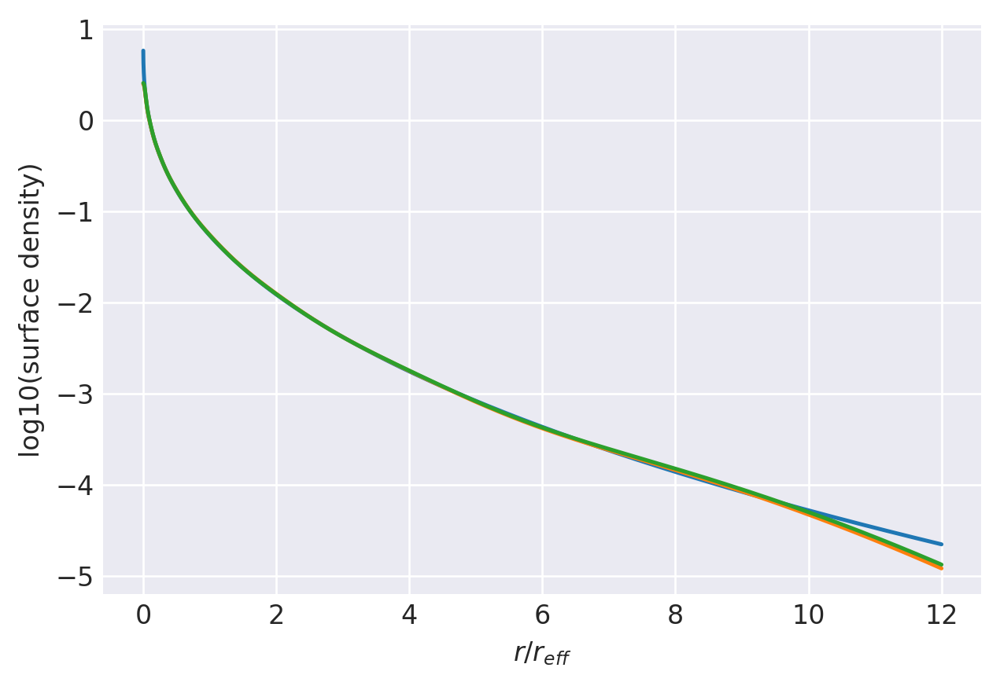

n=2.6: (
    normalize(np.array([1.0663060589e-01, 2.2745850812e-01, 2.5964524336e-01, 2.0436857901e-01, 1.2130436870e-01, 5.5923623797e-02, 1.9740204942e-02, 4.9288661838e-03])),
    np.array([4.7970063231e+00, 2.2803017096e+00, 1.1890069173e+00, 6.3307296335e-01, 3.3338457585e-01, 1.6903095615e-01, 7.9605667884e-02, 3.2456350917e-02]),
),
[42, 24000]
0.9935275948125303 0.998606703490336
prev.  chisq = -7.81730200413128
ws, re: (array([0.10663061, 0.22745851, 0.25964524, 0.20436858, 0.12130437,
       0.05592362, 0.0197402 , 0.00492887]), array([4.79700632, 2.28030171, 1.18900692, 0.63307296, 0.33338458,
       0.16903096, 0.07960567, 0.03245635]))
         Current function value: -8.522854
         Iterations: 25
         Function evaluations: 1185
         Gradient evaluations: 69
-8.522854031517259 [-2.1123154  -1.0795996  -0.46041599 -0.004469    0.3892412   0.79551898
  1.36059231  0.68586043  0.36078263  0.07663924 -0.19806543 -0.47717012
 -0.77221663 -1.09836673 -1.48483947]
0.

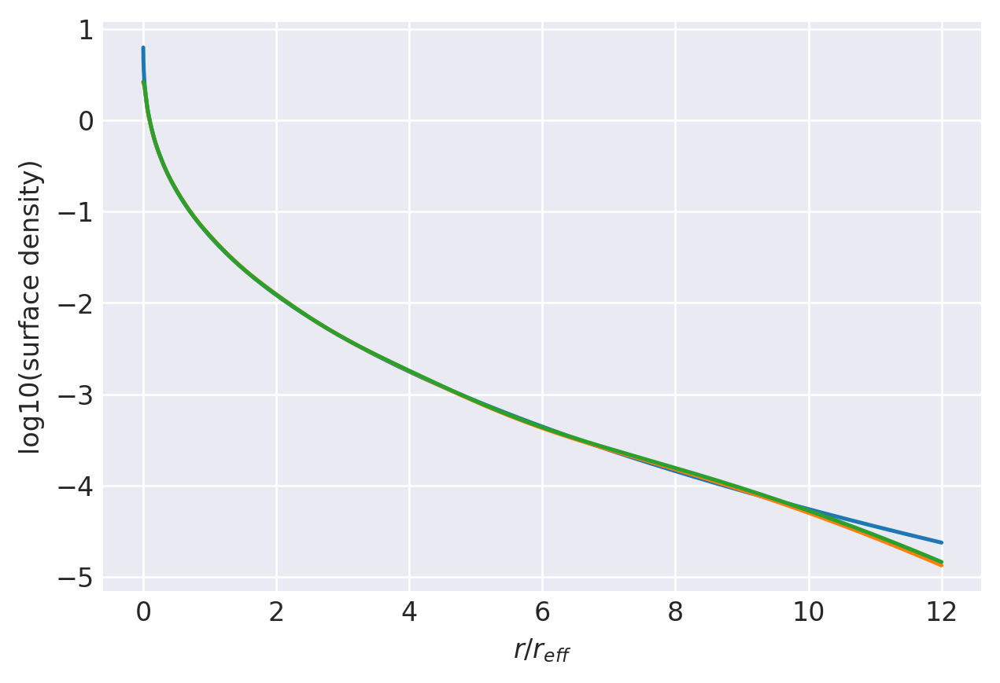

n=2.65: (
    normalize(np.array([1.0790557963e-01, 2.2621890548e-01, 2.5761867641e-01, 2.0367229513e-01, 1.2195285050e-01, 5.6934486717e-02, 2.0451274324e-02, 5.2459318145e-03])),
    np.array([4.8513256791e+00, 2.2949996734e+00, 1.1929966922e+00, 6.3377422290e-01, 3.3329583134e-01, 1.6895979310e-01, 7.9732113165e-02, 3.2746171507e-02]),
),
[44, 24000]
0.9929606507504876 0.9984470474822885
prev.  chisq = -7.829404250726928
ws, re: (array([0.10790558, 0.22621891, 0.25761868, 0.2036723 , 0.12195285,
       0.05693449, 0.02045127, 0.00524593]), array([4.85132568, 2.29499967, 1.19299669, 0.63377422, 0.33329583,
       0.16895979, 0.07973211, 0.03274617]))
         Current function value: -8.516411
         Iterations: 24
         Function evaluations: 1457
         Gradient evaluations: 85
-8.516411430601083 [-2.09934346 -1.08502947 -0.47303929 -0.02095891  0.36976688  0.77286823
  1.33416852  0.69058335  0.36350258  0.07810119 -0.19751226 -0.47715435
 -0.77221397 -1.09745001 -1.48078556]

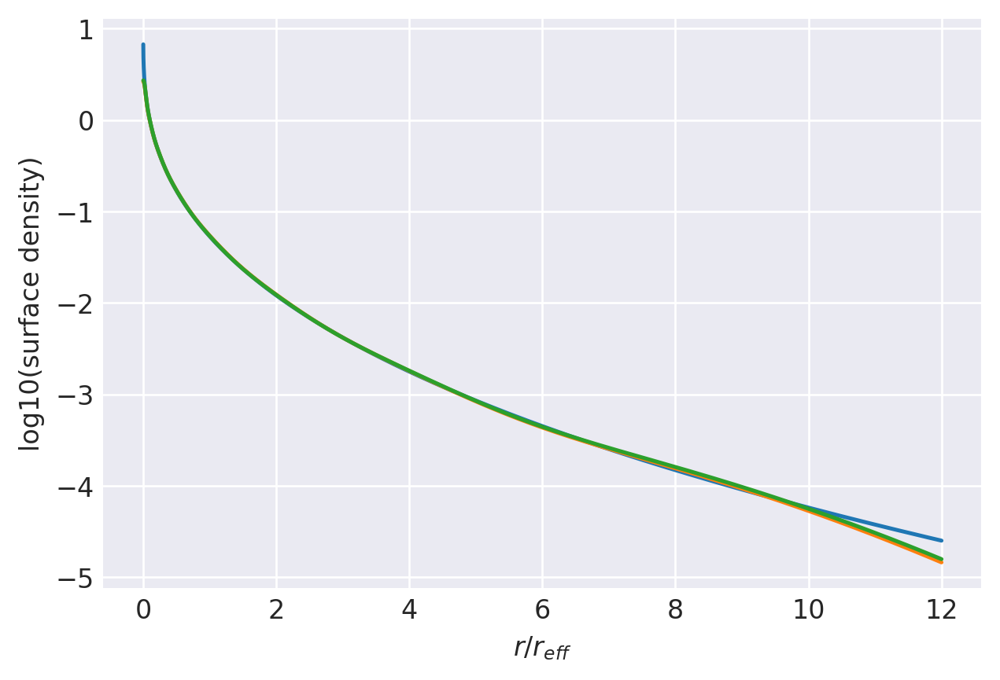

n=2.7: (
    normalize(np.array([1.0916064955e-01, 2.2498630413e-01, 2.5561907752e-01, 2.0296754854e-01, 1.2257790970e-01, 5.7938884208e-02, 2.1173113594e-02, 5.5765127536e-03])),
    np.array([4.9043713513e+00, 2.3094181913e+00, 1.1970194094e+00, 6.3458198701e-01, 3.3330793040e-01, 1.6896082709e-01, 7.9900591008e-02, 3.3053270605e-02]),
),
[47, 24000]
0.9923723280444858 0.9982788804058452
prev.  chisq = -7.84642888260282
ws, re: (array([0.10916065, 0.2249863 , 0.25561908, 0.20296755, 0.12257791,
       0.05793888, 0.02117311, 0.00557651]), array([4.90437135, 2.30941819, 1.19701941, 0.63458199, 0.33330793,
       0.16896083, 0.07990059, 0.03305327]))
         Current function value: -8.520349
         Iterations: 22
         Function evaluations: 1525
         Gradient evaluations: 89
-8.520349046469002 [-2.08987883 -1.09383279 -0.48900494 -0.04093605  0.34644604  0.74578228
  1.30258574  0.69563099  0.3669222   0.08063108 -0.1955017  -0.47522755
 -0.76972014 -1.09321547 -1.47203704]
0

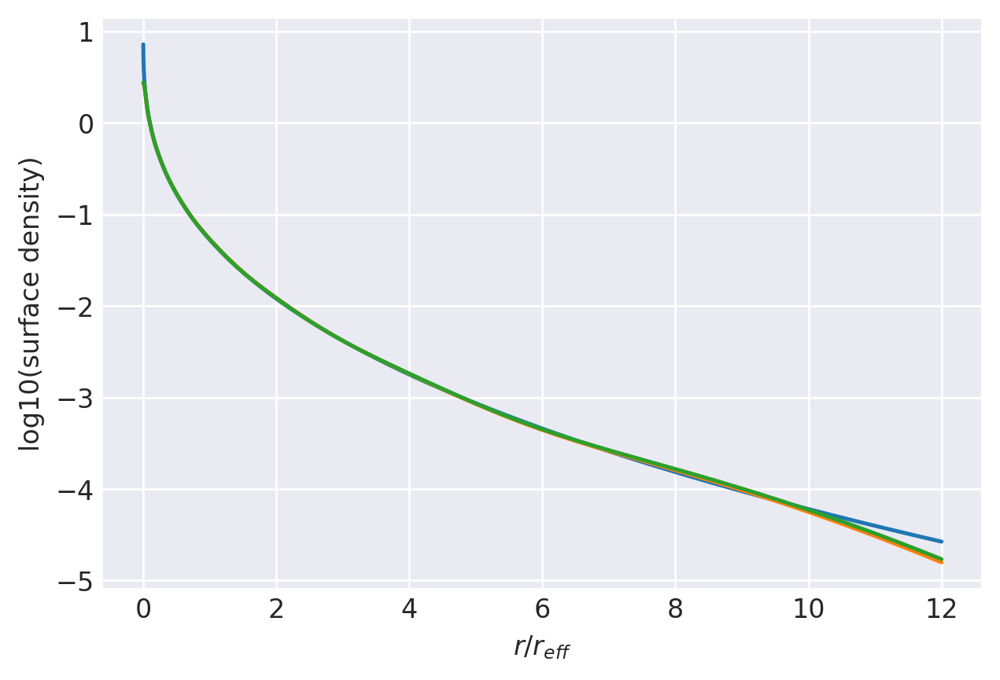

n=2.75: (
    normalize(np.array([1.1008444409e-01, 2.2327734545e-01, 2.5340785466e-01, 2.0238676361e-01, 1.2350279149e-01, 5.9239682885e-02, 2.2095061336e-02, 6.0060564883e-03])),
    np.array([4.9617055814e+00, 2.3276742621e+00, 1.2040127381e+00, 6.3752659029e-01, 3.3478998187e-01, 1.6993383568e-01, 8.0683463437e-02, 3.3725854667e-02]),
),
[49, 24000]
0.9917633635893499 0.9980906558228949
prev.  chisq = -7.857119264468125
ws, re: (array([0.11008444, 0.22327735, 0.25340785, 0.20238676, 0.12350279,
       0.05923968, 0.02209506, 0.00600606]), array([4.96170558, 2.32767426, 1.20401274, 0.63752659, 0.33478998,
       0.16993384, 0.08068346, 0.03372585]))
         Current function value: -8.516228
         Iterations: 24
         Function evaluations: 1508
         Gradient evaluations: 88
-8.516228094303822 [-2.07750443 -1.0992464  -0.50138326 -0.05707961  0.32741995  0.72381623
  1.27745906  0.70004201  0.36951009  0.08210561 -0.19481569 -0.47497406
 -0.76939099 -1.09192312 -1.46774912]

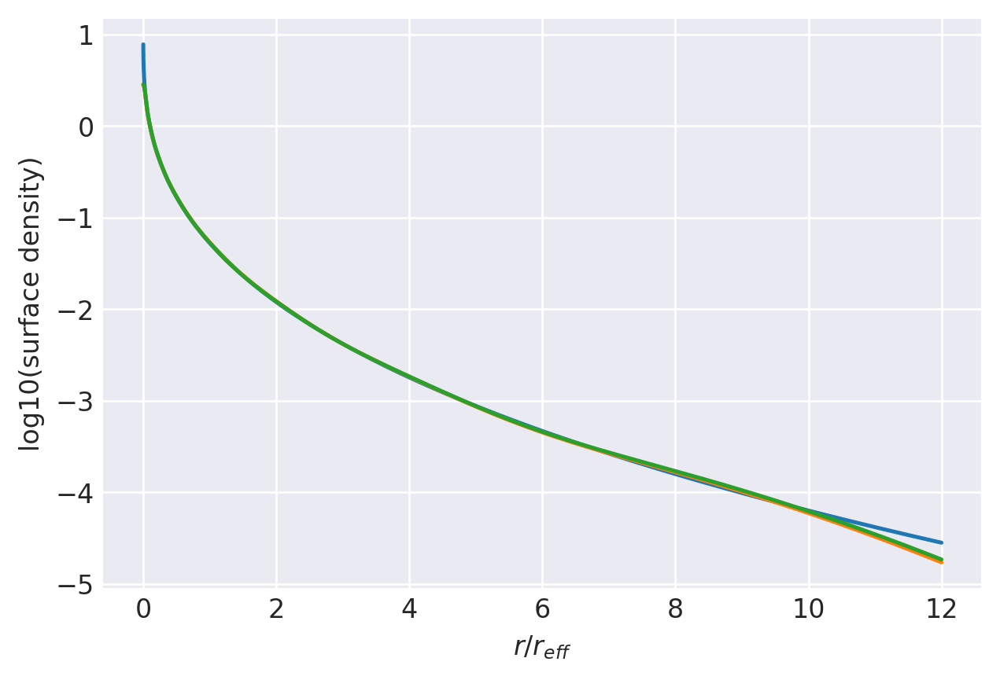

n=2.8: (
    normalize(np.array([1.1130257497e-01, 2.2206871057e-01, 2.5146278498e-01, 2.0166019496e-01, 1.2407490328e-01, 6.0226909207e-02, 2.2837961812e-02, 6.3659602189e-03])),
    np.array([5.0123571868e+00, 2.3415858860e+00, 1.2081075754e+00, 6.3853442226e-01, 3.3498544732e-01, 1.7006267846e-01, 8.0923914930e-02, 3.4060488965e-02]),
),
[52, 24000]
0.9911345085465334 0.9979055335809208
prev.  chisq = -7.8749102641026605
ws, re: (array([0.11130257, 0.22206871, 0.25146278, 0.20166019, 0.1240749 ,
       0.06022691, 0.02283796, 0.00636596]), array([5.01235719, 2.34158589, 1.20810758, 0.63853442, 0.33498545,
       0.17006268, 0.08092391, 0.03406049]))
         Current function value: -8.522181
         Iterations: 22
         Function evaluations: 1116
         Gradient evaluations: 65
-8.522181212909505 [-2.06845601 -1.10792011 -0.51700977 -0.07660114  0.30470527  0.69767432
  1.24761213  0.70478203  0.37279273  0.08463663 -0.1926926  -0.47284387
 -0.76662956 -1.08742096 -1.4590001 ]

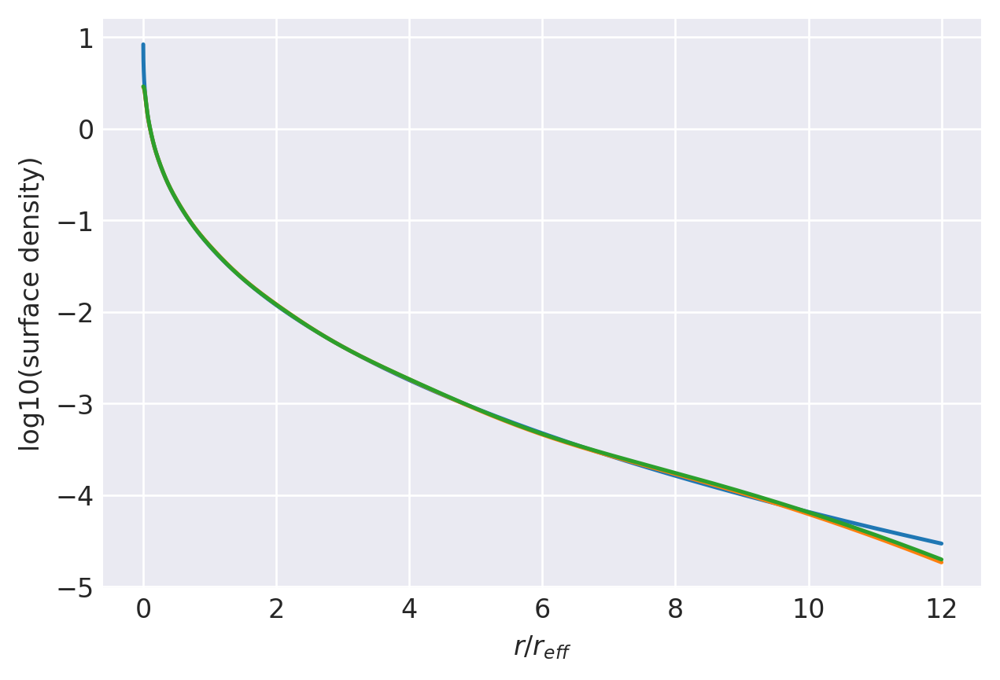

n=2.85: (
    normalize(np.array([1.1220074634e-01, 2.2040401966e-01, 2.4930663476e-01, 2.0104169672e-01, 1.2493053742e-01, 6.1503511953e-02, 2.3782704250e-02, 6.8301489050e-03])),
    np.array([5.0673631139e+00, 2.3593519384e+00, 1.2151688628e+00, 6.4166360065e-01, 3.3663256766e-01, 1.7114745375e-01, 8.1767183160e-02, 3.4753607786e-02]),
),
[55, 24000]
0.9904865228790861 0.9976995032048316
prev.  chisq = -7.891225263231407
ws, re: (array([0.11220075, 0.22040402, 0.24930663, 0.2010417 , 0.12493054,
       0.06150351, 0.0237827 , 0.00683015]), array([5.06736311, 2.35935194, 1.21516886, 0.6416636 , 0.33663257,
       0.17114745, 0.08176718, 0.03475361]))
         Current function value: -8.528961
         Iterations: 23
         Function evaluations: 1235
         Gradient evaluations: 72
-8.528961029768572 [-2.05959012 -1.11649939 -0.53243914 -0.09585787  0.28235304  0.6721007
  1.21875656  0.70937928  0.37601053  0.08716506 -0.19052294 -0.47062996
 -0.76376572 -1.0828391  -1.45034152]


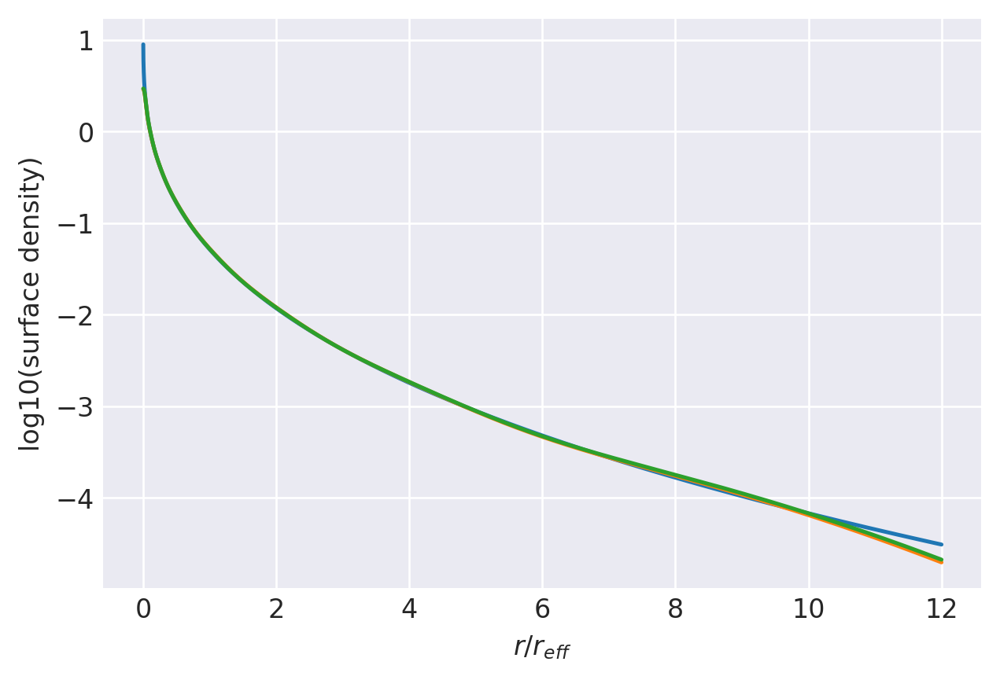

n=2.9: (
    normalize(np.array([1.1308693413e-01, 2.1876703102e-01, 2.4717940698e-01, 2.0040279104e-01, 1.2574851821e-01, 6.2765217002e-02, 2.4737699550e-02, 7.3124020706e-03])),
    np.array([5.1212889844e+00, 2.3768979074e+00, 1.2222641154e+00, 6.4487724861e-01, 3.3835300915e-01, 1.7227976974e-01, 8.2634404180e-02, 3.5453448379e-02]),
),
[57, 24000]
0.9898201705623486 0.9974846113250431
prev.  chisq = -7.9023473464514264
ws, re: (array([0.11308693, 0.21876703, 0.24717941, 0.20040279, 0.12574852,
       0.06276522, 0.0247377 , 0.0073124 ]), array([5.12128898, 2.37689791, 1.22226412, 0.64487725, 0.33835301,
       0.17227977, 0.0826344 , 0.03545345]))
         Current function value: -8.527657
         Iterations: 23
         Function evaluations: 1575
         Gradient evaluations: 92
-8.527656882336524 [-2.04799265 -1.1218012  -0.54436262 -0.1113707   0.26414735  0.65133641
  1.19568933  0.71336935  0.37840919  0.08863714 -0.1896879  -0.47010192
 -0.76306662 -1.08115204 -1.44592062]

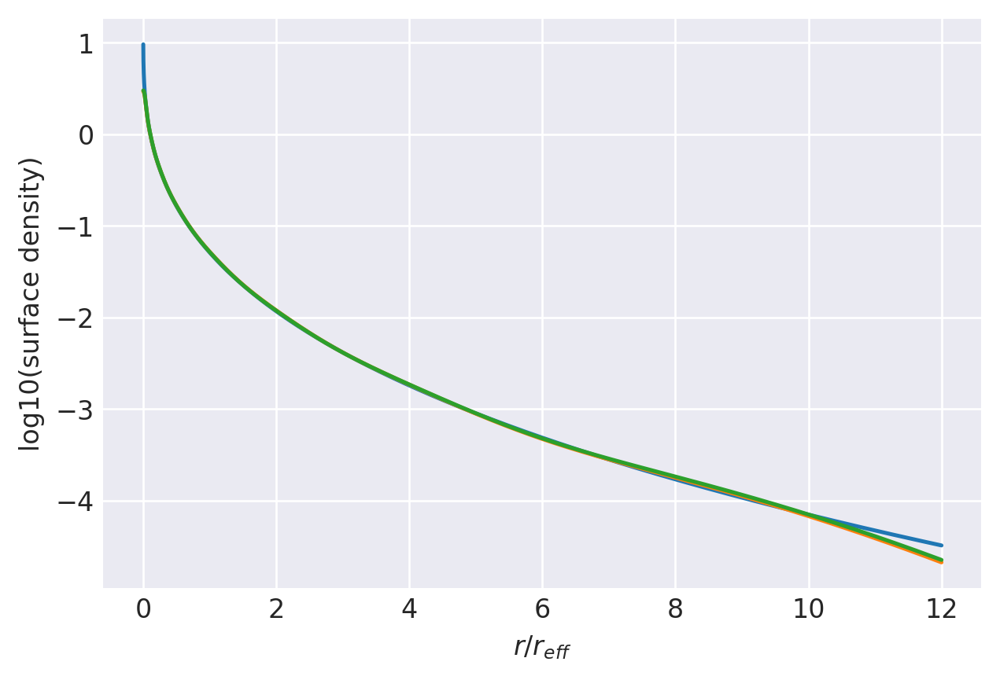

n=2.95: (
    normalize(np.array([1.1425537007e-01, 2.1760737734e-01, 2.4532216669e-01, 1.9964739261e-01, 1.2623603905e-01, 6.3714296513e-02, 2.5502860651e-02, 7.7144970706e-03])),
    np.array([5.1685574335e+00, 2.3900621016e+00, 1.2264141079e+00, 6.4611838282e-01, 3.3876464329e-01, 1.7255731761e-01, 8.2956029531e-02, 3.5816189767e-02]),
),
[60, 24000]
0.989136215414153 0.997276273279563
prev.  chisq = -7.9213177077077255
ws, re: (array([0.11425537, 0.21760738, 0.24532217, 0.19964739, 0.12623604,
       0.0637143 , 0.02550286, 0.0077145 ]), array([5.16855743, 2.3900621 , 1.22641411, 0.64611838, 0.33876464,
       0.17255732, 0.08295603, 0.03581619]))
Optimization terminated successfully.
         Current function value: -8.535973
         Iterations: 23
         Function evaluations: 680
         Gradient evaluations: 40
-8.535972803530976 [-2.03947653 -1.13018783 -0.55938577 -0.13009044  0.24249682  0.62678264
  1.168508    0.71769334  0.38149252  0.09114395 -0.18745184 -0.46775523
 

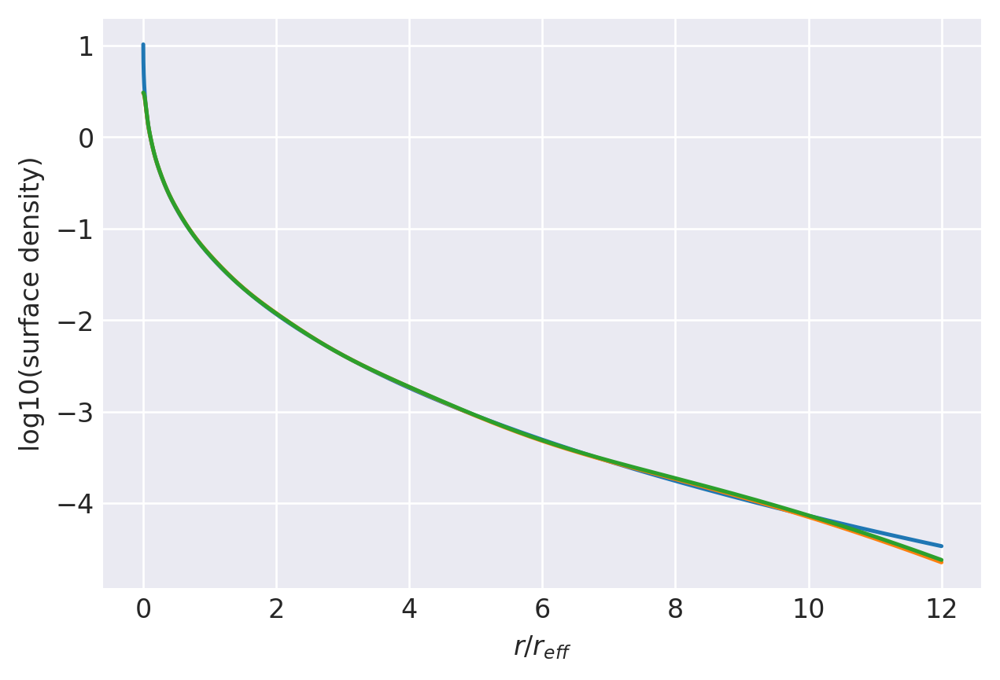

n=3.0: (
    normalize(np.array([1.1512004599e-01, 2.1602259220e-01, 2.4325646171e-01, 1.9897828528e-01, 1.2698319147e-01, 6.4940948634e-02, 2.6470606651e-02, 8.2278680637e-03])),
    np.array([5.2202744618e+00, 2.4070910710e+00, 1.2335136199e+00, 6.4945365327e-01, 3.4060010250e-01, 1.7376728114e-01, 8.3863632338e-02, 3.6527471738e-02]),
),
[63, 24000]
0.9884354174892175 0.9970458505840019
prev.  chisq = -7.938583835387494
ws, re: (array([0.11512005, 0.21602259, 0.24325646, 0.19897829, 0.12698319,
       0.06494095, 0.02647061, 0.00822787]), array([5.22027446, 2.40709107, 1.23351362, 0.64945365, 0.3406001 ,
       0.17376728, 0.08386363, 0.03652747]))
         Current function value: -8.544913
         Iterations: 24
         Function evaluations: 1440
         Gradient evaluations: 84
-8.544912650347673 [-2.03110044 -1.13844765 -0.57417758 -0.14850713  0.22124574  0.60280899
  1.14224424  0.72188814  0.38450949  0.09363498 -0.18519332 -0.46535992
 -0.75694021 -1.07167353 -1.42896856]


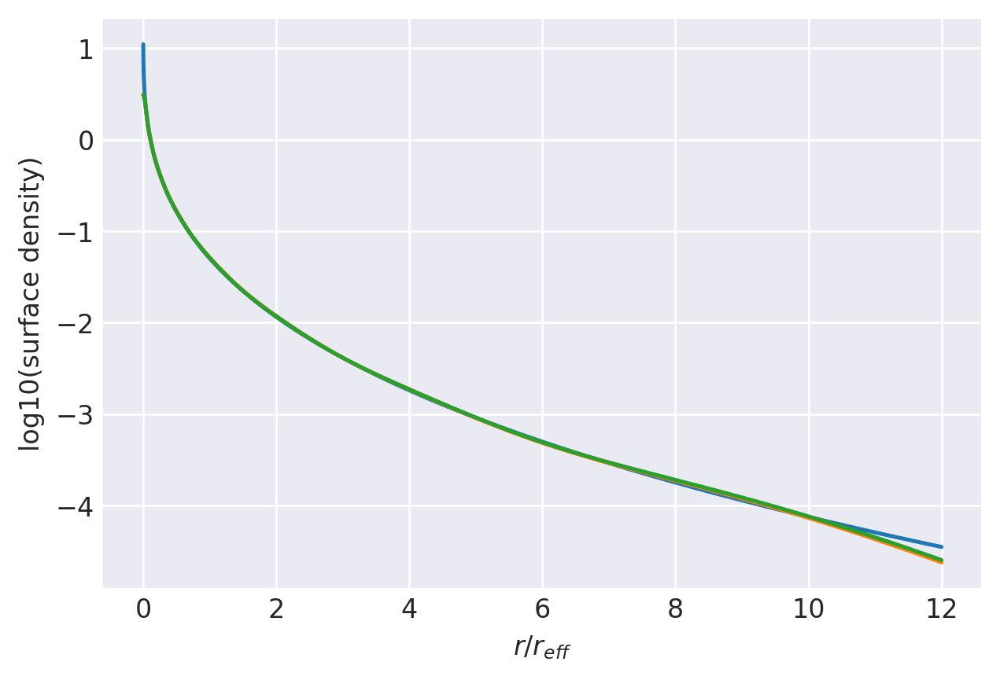

n=3.05: (
    normalize(np.array([1.1597605077e-01, 2.1446906204e-01, 2.4122283646e-01, 1.9829259656e-01, 1.2769189001e-01, 6.6147097255e-02, 2.7443264283e-02, 8.7572026236e-03])),
    np.array([5.2709408302e+00, 2.4238709552e+00, 1.2406091474e+00, 6.5283988827e-01, 3.4248383479e-01, 1.7500876132e-01, 8.4786452941e-02, 3.7241866593e-02]),
),
[66, 24000]
0.9877185299843769 0.9968078336670058
prev.  chisq = -7.956178041926119
ws, re: (array([0.11597605, 0.21446906, 0.24122284, 0.1982926 , 0.12769189,
       0.0661471 , 0.02744326, 0.0087572 ]), array([5.27094083, 2.42387096, 1.24060915, 0.65283989, 0.34248383,
       0.17500876, 0.08478645, 0.03724187]))
         Current function value: -8.554423
         Iterations: 23
         Function evaluations: 1797
         Gradient evaluations: 105
-8.55442300785678 [-2.022863   -1.14657853 -0.58873585 -0.16661759  0.20039671  0.57941135
  1.11686589  0.72595958  0.38746191  0.09610884 -0.18291648 -0.46292278
 -0.75380057 -1.06690436 -1.42068898]

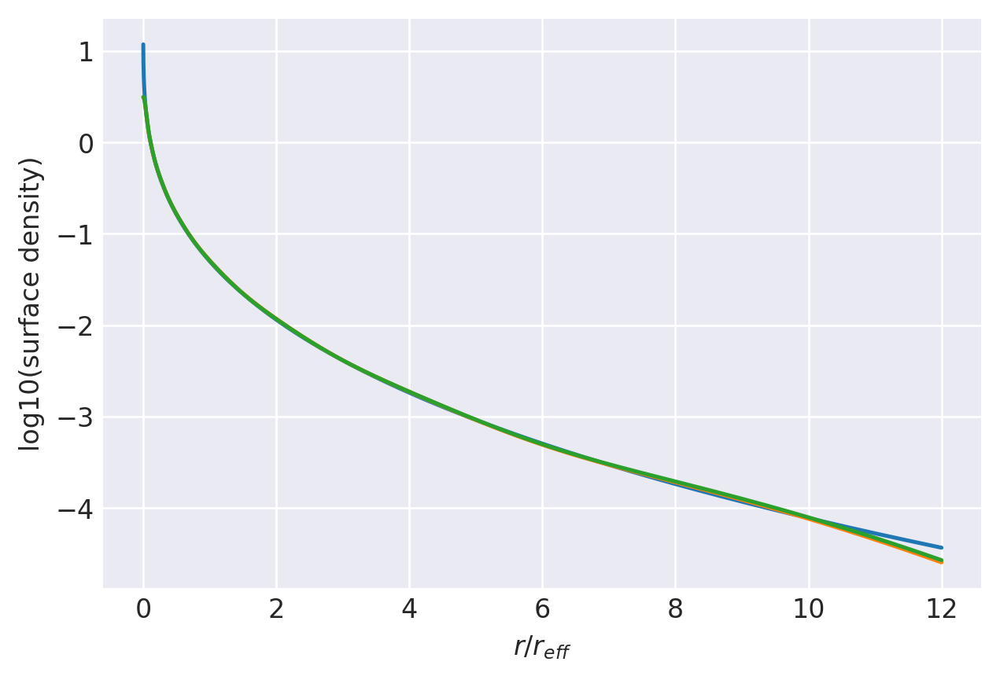

n=3.1: (
    normalize(np.array([1.1682327457e-01, 2.1294678794e-01, 2.3922179526e-01, 1.9759210609e-01, 1.2836299157e-01, 6.7331852449e-02, 2.8419406716e-02, 9.3017854092e-03])),
    np.array([5.3205874201e+00, 2.4404050474e+00, 1.2476961620e+00, 6.5627146816e-01, 3.4441116139e-01, 1.7627853311e-01, 8.5722659753e-02, 3.7958672952e-02]),
),
[68, 24000]
0.986986296603905 0.9965625992197001
prev.  chisq = -7.9679585064054805
ws, re: (array([0.11682327, 0.21294679, 0.2392218 , 0.19759211, 0.12836299,
       0.06733185, 0.02841941, 0.00930179]), array([5.32058742, 2.44040505, 1.24769616, 0.65627147, 0.34441116,
       0.17627853, 0.08572266, 0.03795867]))
         Current function value: -8.555963
         Iterations: 21
         Function evaluations: 1814
         Gradient evaluations: 106
-8.555963303451401 [-2.01228293 -1.15170449 -0.60002922 -0.1812404   0.18337421  0.56035284
  1.09645658  0.72948654  0.38965224  0.09757579 -0.1819242  -0.46211054
 -0.75273891 -1.06487944 -1.41628888]

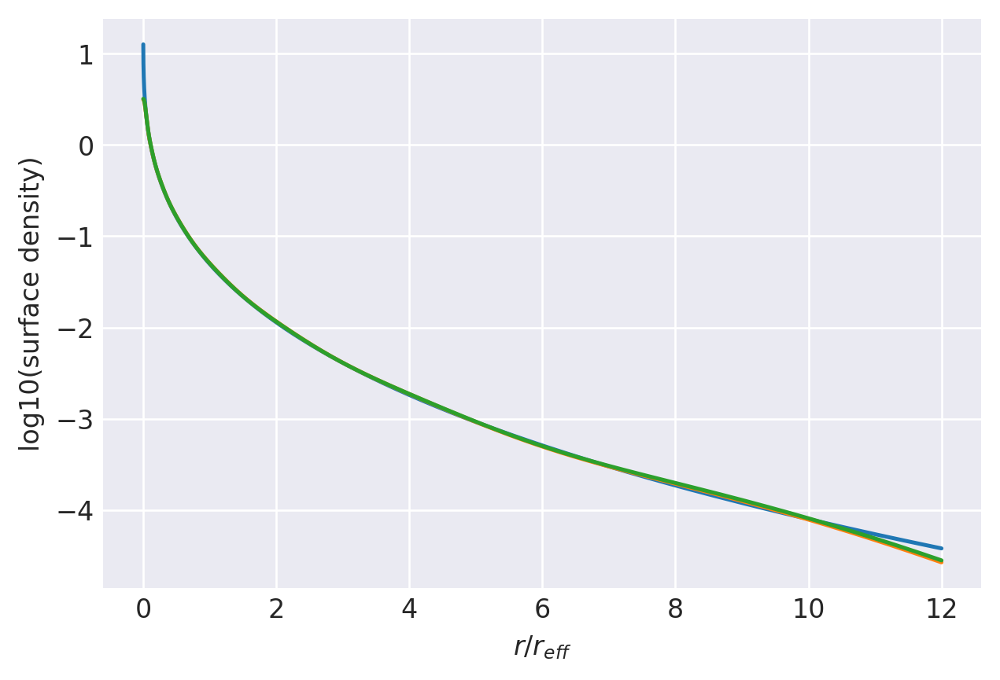

n=3.15: (
    normalize(np.array([1.1791931265e-01, 2.1185627649e-01, 2.3748531239e-01, 1.9681559448e-01, 1.2874711775e-01, 6.8221432694e-02, 2.9200461271e-02, 9.7544922750e-03])),
    np.array([5.3639724860e+00, 2.4527440762e+00, 1.2519177385e+00, 6.5777263357e-01, 3.4505590559e-01, 1.7670998664e-01, 8.6123279869e-02, 3.8345209670e-02]),
),
[71, 24000]
0.9862394493372659 0.9963275360602099
prev.  chisq = -7.988392859917532
ws, re: (array([0.11791931, 0.21185628, 0.23748531, 0.19681559, 0.12874712,
       0.06822143, 0.02920046, 0.00975449]), array([5.36397249, 2.45274408, 1.25191774, 0.65777263, 0.34505591,
       0.17670999, 0.08612328, 0.03834521]))
         Current function value: -8.566573
         Iterations: 21
         Function evaluations: 946
         Gradient evaluations: 55
-8.56657339711328 [-2.00440126 -1.15963982 -0.61417788 -0.19880224  0.16324388  0.53796388
  1.0725788   0.73333565  0.39249205  0.10002516 -0.17960464 -0.45958423
 -0.74949348 -1.06005011 -1.40818138]
0

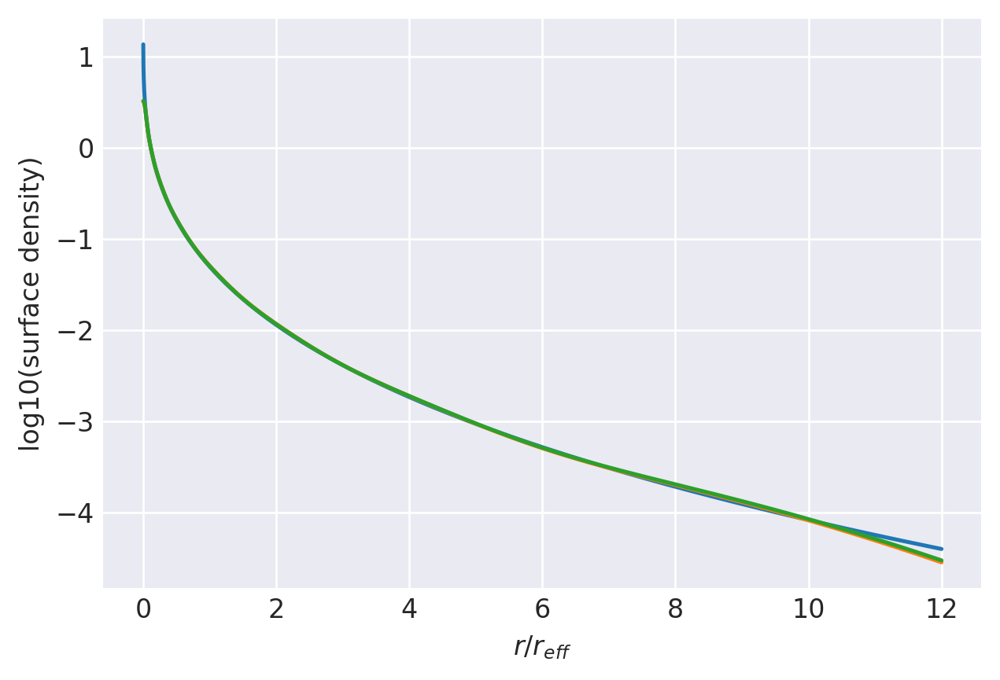

n=3.2: (
    normalize(np.array([1.1874159164e-01, 2.1038523288e-01, 2.3554810442e-01, 1.9609761326e-01, 1.2935520994e-01, 6.9366595374e-02, 3.0180236054e-02, 1.0325416436e-02])),
    np.array([5.4117241881e+00, 2.4688348857e+00, 1.2589983552e+00, 6.6129518349e-01, 3.4706895764e-01, 1.7803546244e-01, 8.7086310098e-02, 3.9067769501e-02]),
),
[74, 24000]
0.9854787066049464 0.9960695021029127
prev.  chisq = -8.006835407856817
ws, re: (array([0.11874159, 0.21038523, 0.2355481 , 0.19609761, 0.12935521,
       0.0693666 , 0.03018024, 0.01032542]), array([5.41172419, 2.46883489, 1.25899836, 0.66129518, 0.34706896,
       0.17803546, 0.08708631, 0.03906777]))
         Current function value: -8.577622
         Iterations: 21
         Function evaluations: 1559
         Gradient evaluations: 91
-8.577621933841623 [-1.99665182 -1.16744378 -0.62809148 -0.2160562   0.14351402  0.51612898
  1.04949871  0.7370771   0.39527308  0.10245496 -0.17727604 -0.45703171
 -0.74622138 -1.05522815 -1.40021235]


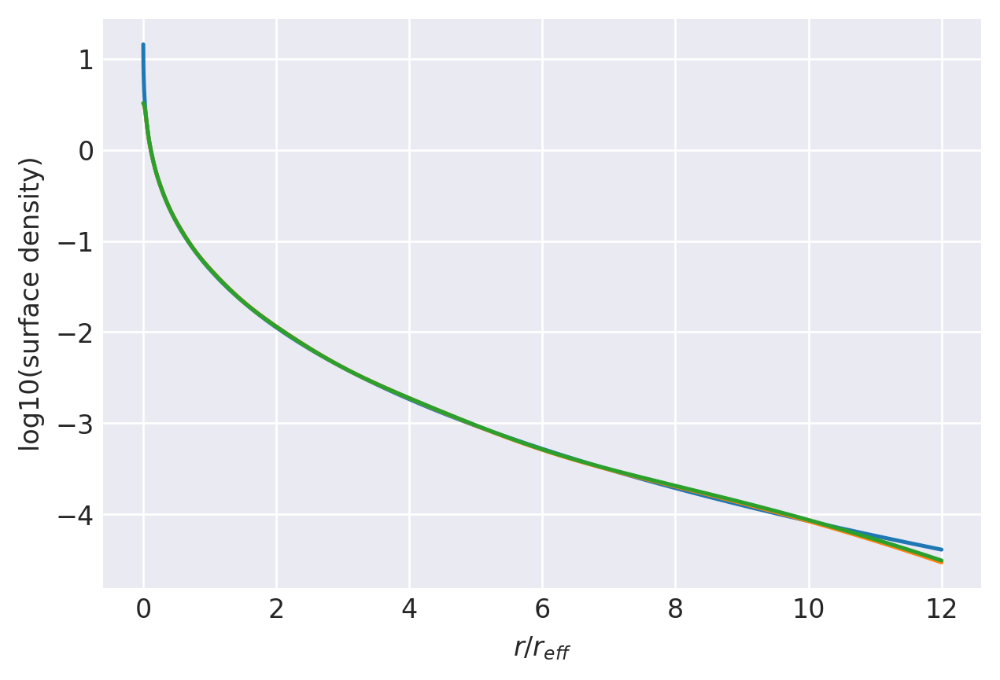

n=3.25: (
    normalize(np.array([1.1955490817e-01, 2.0894489078e-01, 2.3364407293e-01, 1.9536925406e-01, 1.2992860207e-01, 7.0488734072e-02, 3.1160007577e-02, 1.0909530348e-02])),
    np.array([5.4585475481e+00, 2.4846949566e+00, 1.2660619485e+00, 6.6485043164e-01, 3.4911482104e-01, 1.7938190142e-01, 8.8058615116e-02, 3.9791256142e-02]),
),
[77, 24000]
0.9847047717314209 0.9958053294705064
prev.  chisq = -8.025558256228184
ws, re: (array([0.11955491, 0.20894489, 0.23364407, 0.19536925, 0.1299286 ,
       0.07048873, 0.03116001, 0.01090953]), array([5.45854755, 2.48469496, 1.26606195, 0.66485043, 0.34911482,
       0.1793819 , 0.08805862, 0.03979126]))
         Current function value: -8.589073
         Iterations: 22
         Function evaluations: 1287
         Gradient evaluations: 75
-8.589073369472176 [-1.98903549 -1.1751159  -0.64176971 -0.23300472  0.12417856  0.49483382
  1.02718339  0.74071619  0.39799743  0.10486449 -0.17494108 -0.45445683
 -0.74292733 -1.05041802 -1.39238   ]

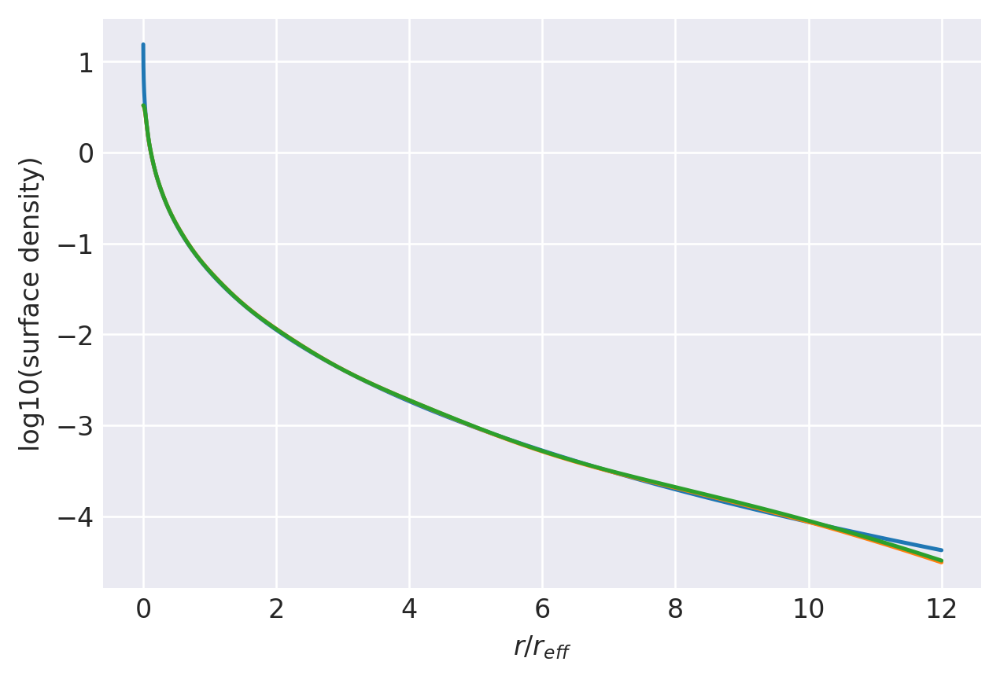

n=3.3: (
    normalize(np.array([1.2035894044e-01, 2.0753504076e-01, 2.3177347721e-01, 1.9463180117e-01, 1.3046827434e-01, 7.1587535031e-02, 3.2138794874e-02, 1.1506136169e-02])),
    np.array([5.5044786920e+00, 2.5003305456e+00, 1.2731057772e+00, 6.6843460034e-01, 3.5119082909e-01, 1.8074765332e-01, 8.9039349856e-02, 4.0515388188e-02]),
),
[80, 24000]
0.9839183317077059 0.9955353398659024
prev.  chisq = -8.04454279502107
ws, re: (array([0.12035894, 0.20753504, 0.23177348, 0.1946318 , 0.13046827,
       0.07158754, 0.03213879, 0.01150614]), array([5.50447869, 2.50033055, 1.27310578, 0.6684346 , 0.35119083,
       0.18074765, 0.08903935, 0.04051539]))
         Current function value: -8.600895
         Iterations: 23
         Function evaluations: 1610
         Gradient evaluations: 94
-8.600895347342782 [-1.98154536 -1.18265685 -0.65521899 -0.2496487   0.1052364   0.47407263
  1.00560247  0.74425639  0.40066605  0.1072535  -0.17260137 -0.4518634
 -0.73961706 -1.04562562 -1.38468272]
0.

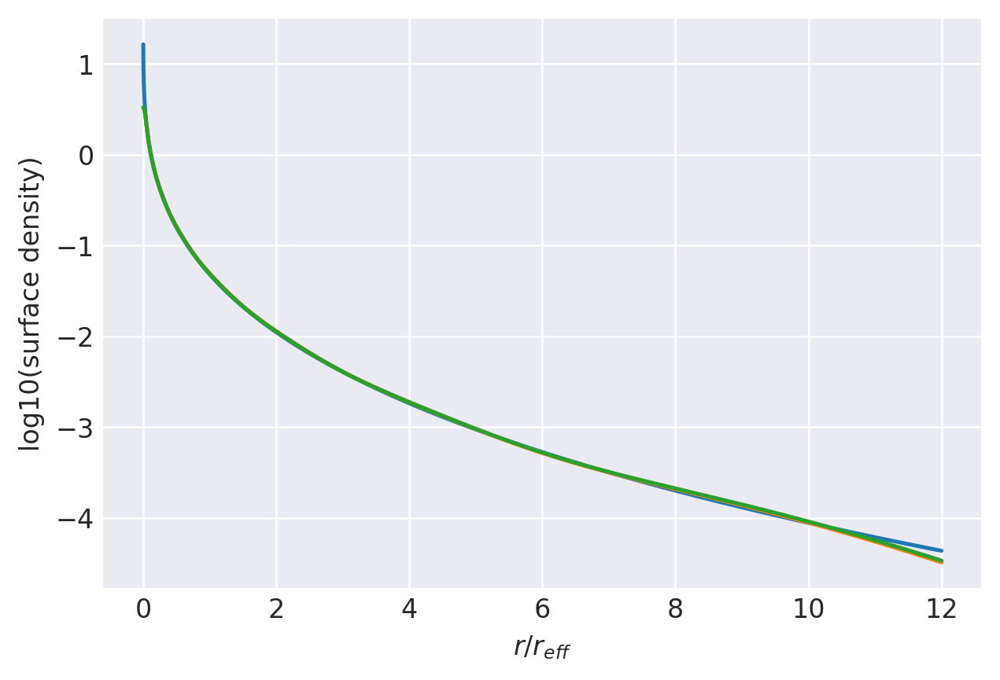

n=3.35: (
    normalize(np.array([1.2115419748e-01, 2.0615509943e-01, 2.2993538017e-01, 1.9388696919e-01, 1.3097564322e-01, 7.2662846617e-02, 3.3115436745e-02, 1.2114427141e-02])),
    np.array([5.5495323679e+00, 2.5157417004e+00, 1.2801282961e+00, 6.7204542052e-01, 3.5329427866e-01, 1.8213061062e-01, 9.0027332980e-02, 4.1239868900e-02]),
),
[83, 24000]
0.9831200562092832 0.9952599240752287
prev.  chisq = -8.063779189889486
ws, re: (array([0.1211542 , 0.2061551 , 0.22993538, 0.19388697, 0.13097564,
       0.07266285, 0.03311544, 0.01211443]), array([5.54953237, 2.5157417 , 1.2801283 , 0.67204542, 0.35329428,
       0.18213061, 0.09002733, 0.04123987]))
         Current function value: -8.613058
         Iterations: 23
         Function evaluations: 1882
         Gradient evaluations: 110
-8.613058322820812 [-1.97418488 -1.19006804 -0.66843572 -0.26599172  0.08668032  0.453825
  0.98472311  0.74770295  0.40328167  0.1096216  -0.17025947 -0.44925486
 -0.73629408 -1.04085321 -1.37711741]


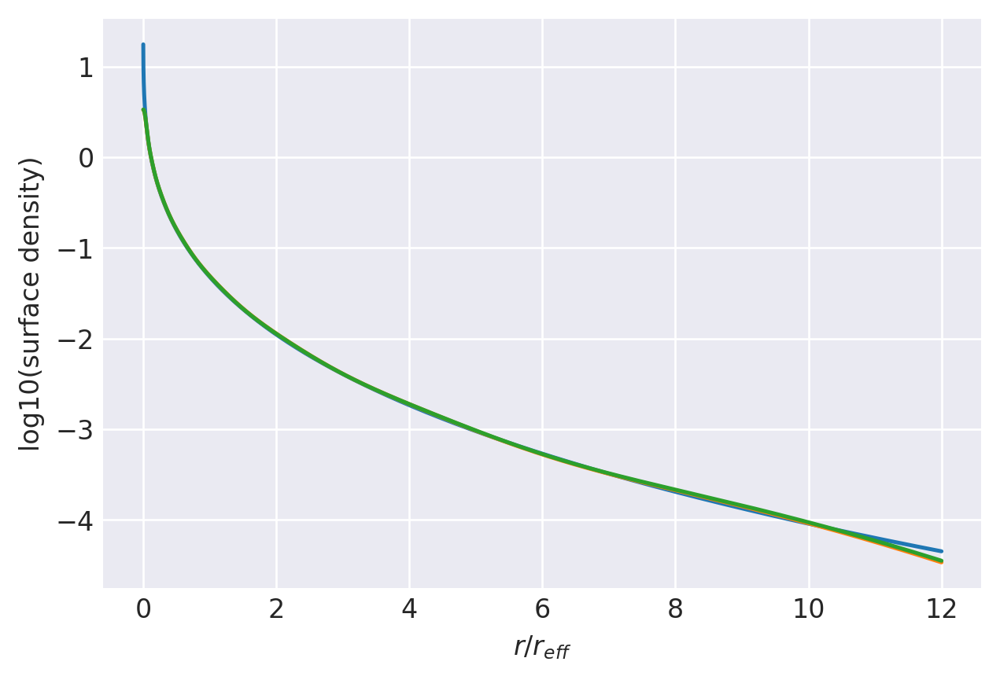

n=3.4: (
    normalize(np.array([1.2194009934e-01, 2.0480463315e-01, 2.2813066090e-01, 1.9313573268e-01, 1.3145163988e-01, 7.3714337673e-02, 3.4089146485e-02, 1.2733749899e-02])),
    np.array([5.5937487036e+00, 2.5309389735e+00, 1.2871275816e+00, 6.7567916655e-01, 3.5542268504e-01, 1.8352951764e-01, 9.1022086200e-02, 4.1964552123e-02]),
),
[86, 24000]
0.9823105968383219 0.9949793636566019
prev.  chisq = -8.08325224644676
ws, re: (array([0.1219401 , 0.20480463, 0.22813066, 0.19313573, 0.13145164,
       0.07371434, 0.03408915, 0.01273375]), array([5.5937487 , 2.53093897, 1.28712758, 0.67567917, 0.35542269,
       0.18352952, 0.09102209, 0.04196455]))
         Current function value: -8.625535
         Iterations: 22
         Function evaluations: 1558
         Gradient evaluations: 91
-8.62553524675657 [-1.96695066 -1.19735026 -0.68142429 -0.28203722  0.06850441  0.43408097
  0.96451645  0.75105966  0.40584573  0.11196864 -0.16791681 -0.4466339
 -0.73296209 -1.03610436 -1.36968146]
0.9

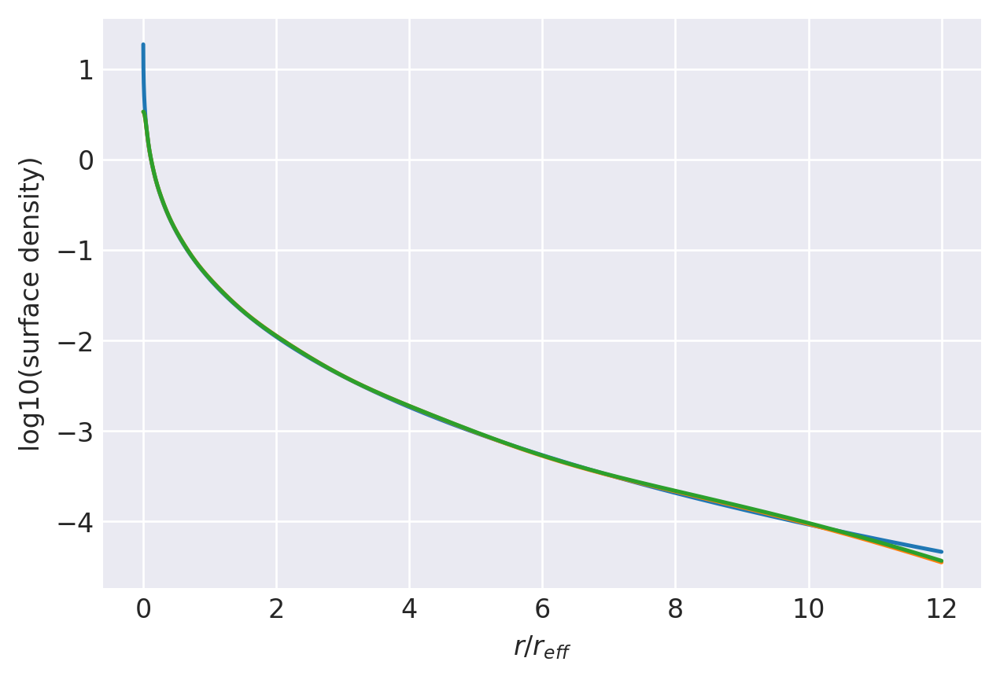

n=3.45: (
    normalize(np.array([1.2271679306e-01, 2.0348314226e-01, 2.2635874485e-01, 1.9237936250e-01, 1.3189748865e-01, 7.4742079878e-02, 3.5059027862e-02, 1.3363360946e-02])),
    np.array([5.6371509443e+00, 2.5459257132e+00, 1.2941024011e+00, 6.7933374757e-01, 3.5757414131e-01, 1.8494300582e-01, 9.2022842495e-02, 4.2689251017e-02]),
),
[89, 24000]
0.9814905865621665 0.9946939880178524
prev.  chisq = -8.102946132876424
ws, re: (array([0.12271679, 0.20348314, 0.22635874, 0.19237936, 0.13189749,
       0.07474208, 0.03505903, 0.01336336]), array([5.63715094, 2.54592571, 1.2941024 , 0.67933375, 0.35757414,
       0.18494301, 0.09202284, 0.04268925]))
         Current function value: -8.638301
         Iterations: 22
         Function evaluations: 1797
         Gradient evaluations: 105
-8.638301295495076 [-1.95984135 -1.20450501 -0.69418749 -0.29778903  0.05070277  0.41482689
  0.94495283  0.75433048  0.40836002  0.11429463 -0.16557479 -0.44400306
 -0.72962429 -1.03138146 -1.36237173

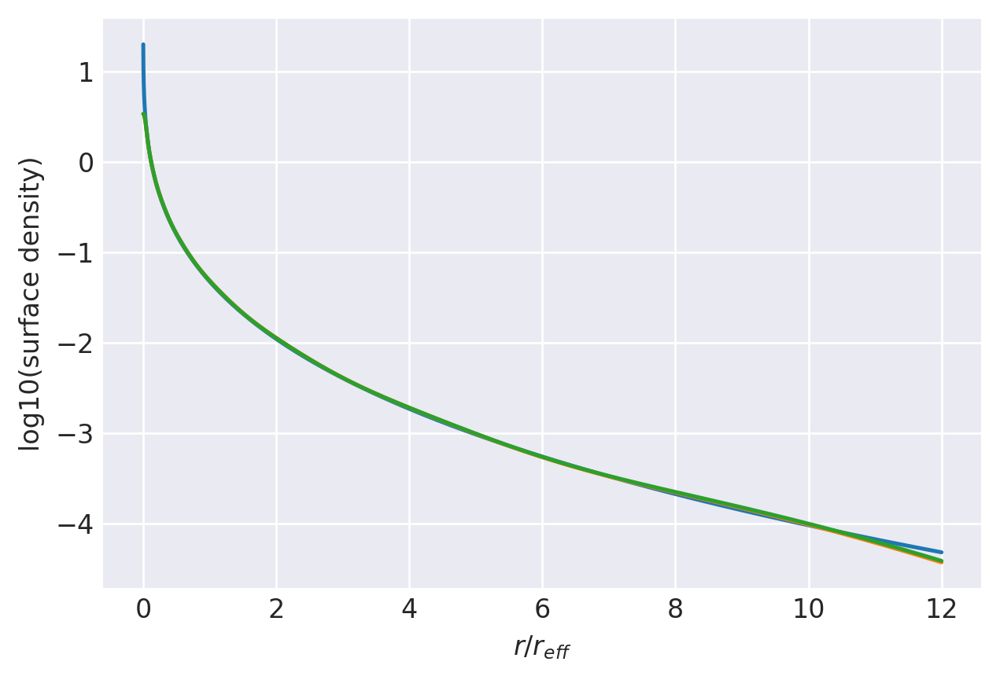

n=3.5: (
    normalize(np.array([1.2348421770e-01, 2.0219007708e-01, 2.2461937219e-01, 1.9161899717e-01, 1.3231440306e-01, 7.5746083391e-02, 3.6024285191e-02, 1.4002564204e-02])),
    np.array([5.6797664868e+00, 2.5607077503e+00, 1.3010519173e+00, 6.8300708835e-01, 3.5974680405e-01, 1.8636987223e-01, 9.3029040533e-02, 4.3413847107e-02]),
),
[92, 24000]
0.9806606393228348 0.994404095833635
prev.  chisq = -8.12284595392618
ws, re: (array([0.12348422, 0.20219008, 0.22461937, 0.191619  , 0.1323144 ,
       0.07574608, 0.03602429, 0.01400256]), array([5.67976649, 2.56070775, 1.30105192, 0.68300709, 0.3597468 ,
       0.18636987, 0.09302904, 0.04341385]))
         Current function value: -8.651334
         Iterations: 21
         Function evaluations: 1474
         Gradient evaluations: 86
-8.651333638511435 [-1.9528521  -1.21153183 -0.706727   -0.31325037  0.03326965  0.39604906
  0.92600506  0.75751851  0.41082552  0.11659882 -0.16323539 -0.44136538
 -0.72628426 -1.02668711 -1.3551852 ]
0.

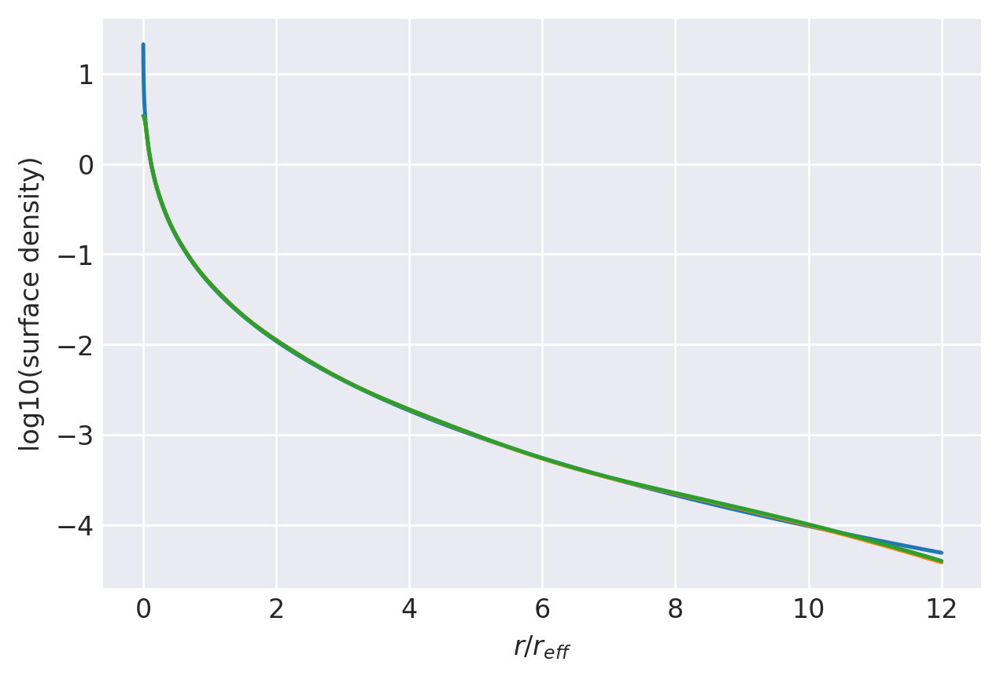

n=3.55: (
    normalize(np.array([1.2424269824e-01, 2.0092510605e-01, 2.2291222831e-01, 1.9085554555e-01, 1.3270339084e-01, 7.6726270591e-02, 3.6984125051e-02, 1.4650635372e-02])),
    np.array([5.7216133501e+00, 2.5752863124e+00, 1.3079731213e+00, 6.8669613925e-01, 3.6193836223e-01, 1.8780871255e-01, 9.4040057594e-02, 4.4138218593e-02]),
),
[95, 24000]
0.9798213497949013 0.9941100092029084
prev.  chisq = -8.142945513348788
ws, re: (array([0.1242427 , 0.20092511, 0.22291223, 0.19085555, 0.13270339,
       0.07672627, 0.03698413, 0.01465064]), array([5.72161335, 2.57528631, 1.30797312, 0.68669614, 0.36193836,
       0.18780871, 0.09404006, 0.04413822]))
         Current function value: -8.664611
         Iterations: 22
         Function evaluations: 1559
         Gradient evaluations: 91
-8.664611239876281 [-1.94598417 -1.21843518 -0.71904844 -0.32842794  0.01619494  0.37773606
  0.90764974  0.76062795  0.41324466  0.1188823  -0.16089863 -0.43872138
 -0.7229429  -1.02202246 -1.34811884]

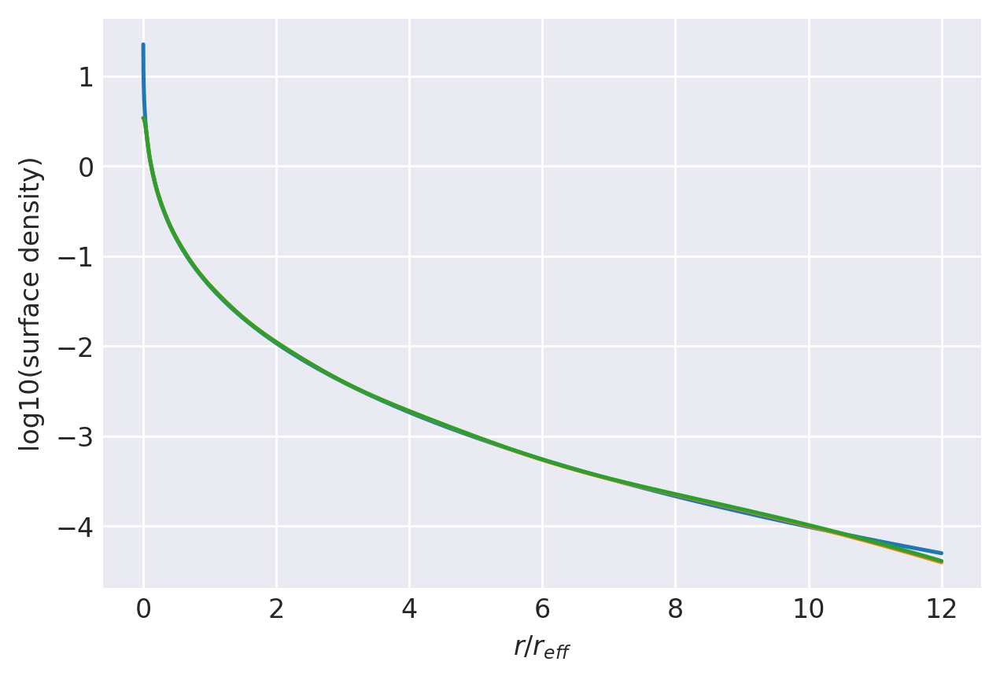

n=3.6: (
    normalize(np.array([1.2499190471e-01, 1.9968730118e-01, 2.2123681917e-01, 1.9009007711e-01, 1.3306576706e-01, 7.7683188913e-02, 3.7938032012e-02, 1.5306909845e-02])),
    np.array([5.7627256837e+00, 2.5896713805e+00, 1.3148684210e+00, 6.9040093739e-01, 3.6414858217e-01, 1.8925924574e-01, 9.5055564161e-02, 4.4862260863e-02]),
),
[98, 24000]
0.9789732932715328 0.9938119640933153
prev.  chisq = -8.16321312956376
ws, re: (array([0.1249919 , 0.1996873 , 0.22123682, 0.19009008, 0.13306577,
       0.07768319, 0.03793803, 0.01530691]), array([5.76272568, 2.58967138, 1.31486842, 0.69040094, 0.36414858,
       0.18925925, 0.09505556, 0.04486226]))
         Current function value: -8.678115
         Iterations: 21
         Function evaluations: 1848
         Gradient evaluations: 108
-8.678114682161832 [-1.93923646e+00 -1.22521769e+00 -7.31155109e-01 -3.43324067e-01
 -5.27458085e-04  3.59873461e-01  8.89861885e-01  7.63662254e-01
  4.15619321e-01  1.21145505e-01 -1.58565459e-01 -4.36

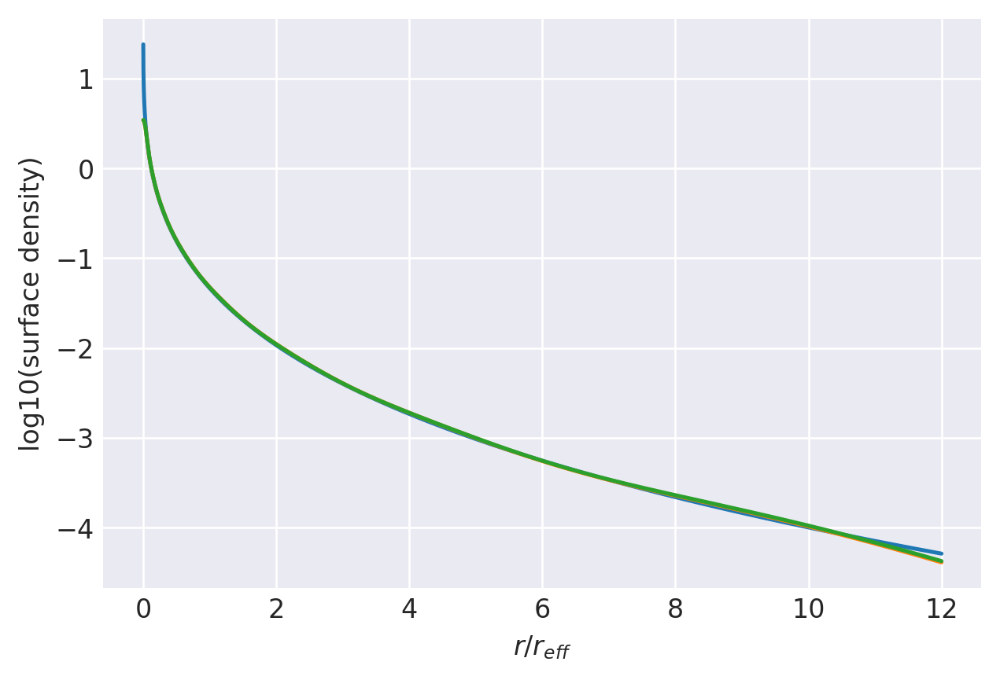

n=3.65: (
    normalize(np.array([1.2573176346e-01, 1.9847597080e-01, 2.1959281595e-01, 1.8932379720e-01, 1.3340263486e-01, 7.8616915775e-02, 3.8885388012e-02, 1.5970713935e-02])),
    np.array([5.8031293909e+00, 2.6038701364e+00, 1.3217383920e+00, 6.9411997283e-01, 3.6637579529e-01, 1.9072050502e-01, 9.6075159116e-02, 4.5585915818e-02]),
),
[101, 24000]
0.9781170256606457 0.9935102169221575
prev.  chisq = -8.183635024136915
ws, re: (array([0.12573176, 0.19847597, 0.21959282, 0.1893238 , 0.13340263,
       0.07861692, 0.03888539, 0.01597071]), array([5.80312939, 2.60387014, 1.32173839, 0.69411997, 0.3663758 ,
       0.19072051, 0.09607516, 0.04558592]))
         Current function value: -8.691826
         Iterations: 23
         Function evaluations: 1763
         Gradient evaluations: 103
-8.691826012558167 [-1.93260019 -1.23187491 -0.74304626 -0.35794404 -0.01690283  0.34244748
  0.87261465  0.76662324  0.41794918  0.12338634 -0.15623866 -0.43342419
 -0.71626712 -1.01278843 -1.3343334

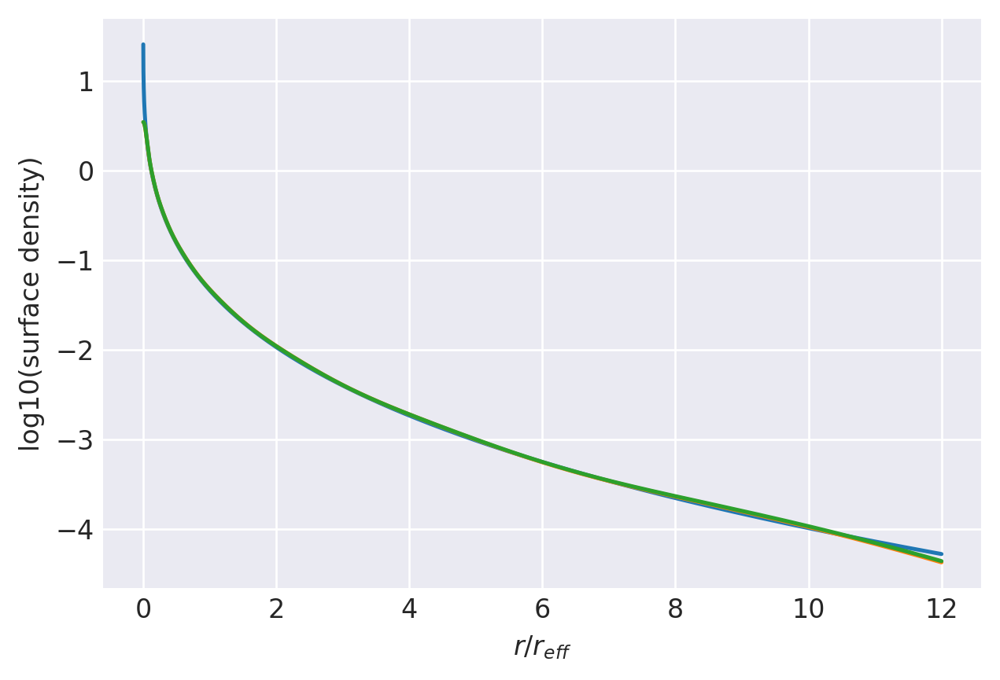

n=3.7: (
    normalize(np.array([1.2646305759e-01, 1.9729132488e-01, 2.1797990950e-01, 1.8855679277e-01, 1.3371477378e-01, 7.9527323422e-02, 3.9825451635e-02, 1.6641366417e-02])),
    np.array([5.8428298355e+00, 2.6178766634e+00, 1.3285757979e+00, 6.9784880784e-01, 3.6861738171e-01, 1.9219092700e-01, 9.7098286807e-02, 4.6309119597e-02]),
),
[104, 24000]
0.9772530835751599 0.9932051001385883
prev.  chisq = -8.204219903864683
ws, re: (array([0.12646306, 0.19729132, 0.21797991, 0.18855679, 0.13371477,
       0.07952732, 0.03982545, 0.01664137]), array([5.84282984, 2.61787666, 1.3285758 , 0.69784881, 0.36861738,
       0.19219093, 0.09709829, 0.04630912]))
         Current function value: -8.705729
         Iterations: 24
         Function evaluations: 1780
         Gradient evaluations: 104
-8.70572861296067 [-1.92607897 -1.23841388 -0.75472867 -0.37229216 -0.03294013  0.32544691
  0.85588857  0.76951507  0.42023727  0.12560685 -0.15391746 -0.43077437
 -0.7129367  -1.00822149 -1.3276083 ]

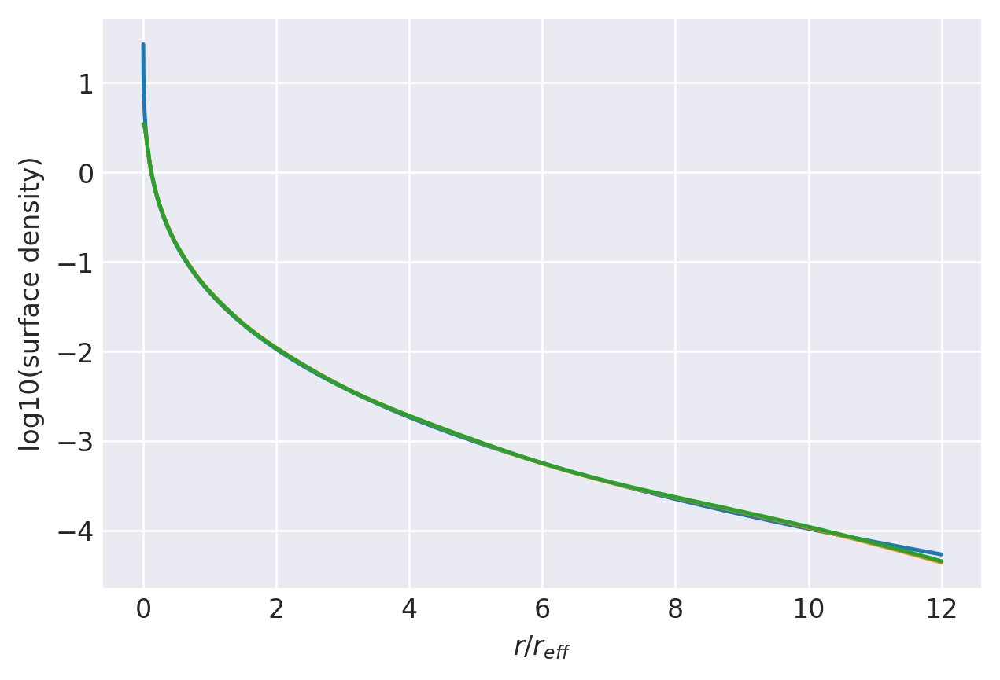

n=3.75: (
    normalize(np.array([1.2718521394e-01, 1.9613212574e-01, 2.1639758088e-01, 1.8779045382e-01, 1.3400351387e-01, 8.0415020511e-02, 4.0757855618e-02, 1.7318235611e-02])),
    np.array([5.8818652050e+00, 2.6317054052e+00, 1.3353861106e+00, 7.0158861993e-01, 3.7087335577e-01, 1.9367042425e-01, 9.8124737154e-02, 4.7031811038e-02]),
),
[107, 24000]
0.9763819845031494 0.9928967818437149
prev.  chisq = -8.224932098828713
ws, re: (array([0.12718521, 0.19613213, 0.21639758, 0.18779045, 0.13400351,
       0.08041502, 0.04075786, 0.01731824]), array([5.88186521, 2.63170541, 1.33538611, 0.70158862, 0.37087336,
       0.19367042, 0.09812474, 0.04703181]))
         Current function value: -8.719807
         Iterations: 22
         Function evaluations: 1472
         Gradient evaluations: 86
-8.719807076799945 [-1.9196685  -1.24483426 -0.76620491 -0.38637367 -0.04864658  0.30885842
  0.8396621   0.77234013  0.42248438  0.12780654 -0.15160311 -0.42812551
 -0.7096132  -1.00368892 -1.32099074

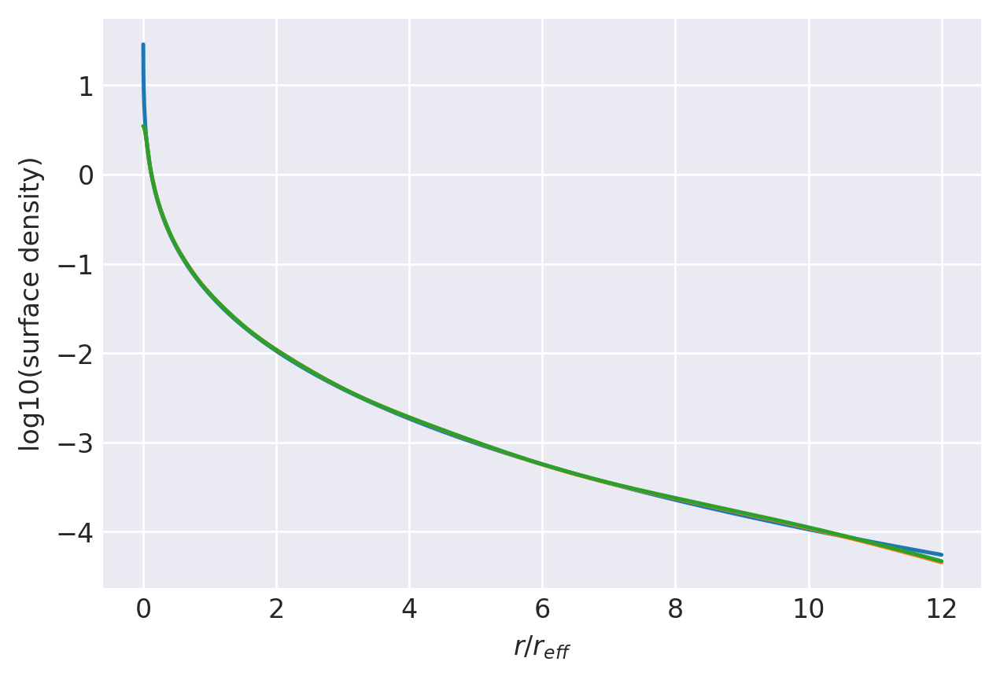

n=3.8: (
    normalize(np.array([1.2789853707e-01, 1.9499808016e-01, 2.1484533174e-01, 1.8702524801e-01, 1.3426977784e-01, 8.1280209260e-02, 4.1682123255e-02, 1.8000692666e-02])),
    np.array([5.9202511612e+00, 2.6453575422e+00, 1.3421669631e+00, 7.0533735977e-01, 3.7314230928e-01, 1.9515819722e-01, 9.9154193076e-02, 4.7753945360e-02]),
),
[111, 24000]
0.9755042270453178 0.992585517662799
prev.  chisq = -8.25239561090196
ws, re: (array([0.12789854, 0.19499808, 0.21484533, 0.18702525, 0.13426978,
       0.08128021, 0.04168212, 0.01800069]), array([5.92025116, 2.64535754, 1.34216696, 0.70533736, 0.37314231,
       0.1951582 , 0.09915419, 0.04775395]))
         Current function value: -8.741357
         Iterations: 23
         Function evaluations: 1321
         Gradient evaluations: 77
-8.741357127277782 [-1.91493177 -1.2532102  -0.77974879 -0.40254871 -0.06645532  0.29019863
  0.8215169   0.77543347  0.42525155  0.13079967 -0.14821885 -0.42411321
 -0.70459445 -0.99706283 -1.311781  ]
0

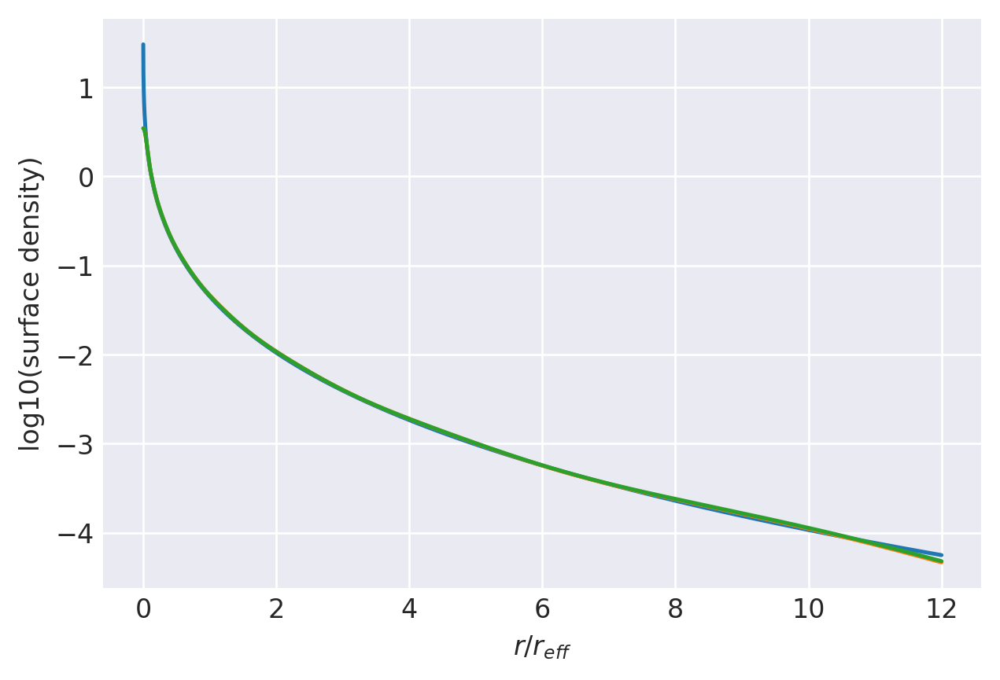

n=3.85: (
    normalize(np.array([1.2842780612e-01, 1.9361534669e-01, 2.1313202615e-01, 1.8625537049e-01, 1.3465832218e-01, 8.2323607080e-02, 4.2776120420e-02, 1.8811400873e-02])),
    np.array([5.9625697288e+00, 2.6622666298e+00, 1.3514490151e+00, 7.1085520106e-01, 3.7660561473e-01, 1.9742654893e-01, 1.0067859984e-01, 4.8777439396e-02]),
),
[114, 24000]
0.9746202912087364 0.9922487917675068
prev.  chisq = -8.271213642189574
ws, re: (array([0.12842781, 0.19361535, 0.21313203, 0.18625537, 0.13465832,
       0.08232361, 0.04277612, 0.0188114 ]), array([5.96256973, 2.66226663, 1.35144902, 0.7108552 , 0.37660561,
       0.19742655, 0.1006786 , 0.04877744]))
         Current function value: -8.755675
         Iterations: 21
         Function evaluations: 1661
         Gradient evaluations: 97
-8.755675131668092 [-1.90868478 -1.25935153 -0.79077715 -0.41606368 -0.08146536  0.274467
  0.80630673  0.77812706  0.42741159  0.13294685 -0.14593441 -0.42148833
 -0.70131411 -0.99263633 -1.30542355]


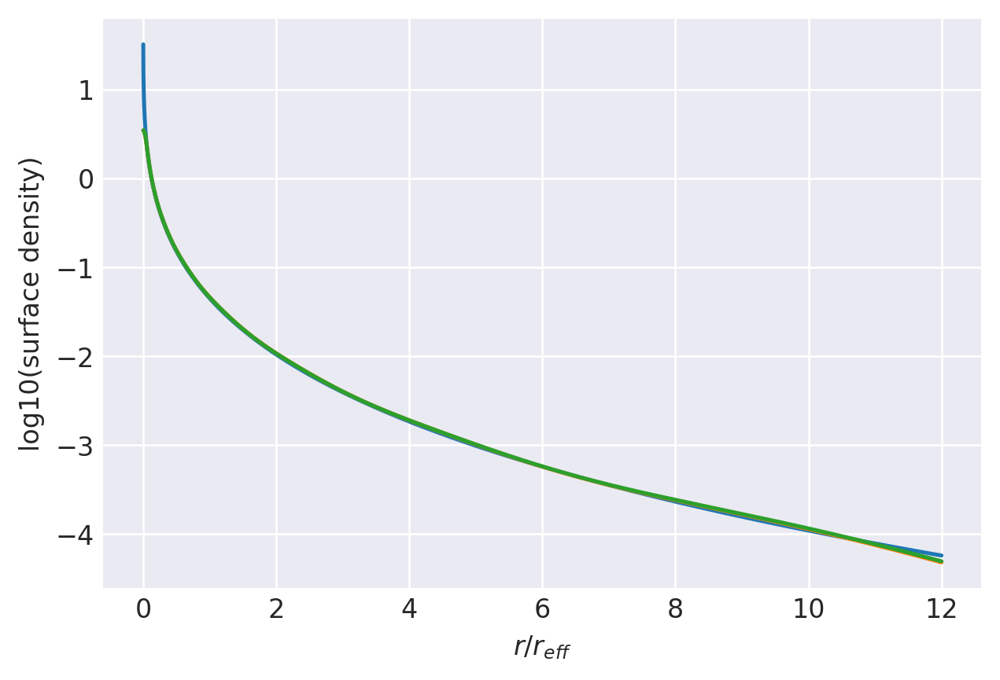

n=3.9: (
    normalize(np.array([1.2912868221e-01, 1.9253705833e-01, 2.1164152663e-01, 1.8549125519e-01, 1.3487685947e-01, 8.3140070335e-02, 4.3680863706e-02, 1.9503684125e-02])),
    np.array([5.9996658548e+00, 2.6755408661e+00, 1.3581472364e+00, 7.1460423651e-01, 3.7888871241e-01, 1.9892340866e-01, 1.0171000340e-01, 4.9496723353e-02]),
),
[117, 24000]
0.9737306387470838 0.9919320072531209
prev.  chisq = -8.292277115872803
ws, re: (array([0.12912868, 0.19253706, 0.21164153, 0.18549126, 0.13487686,
       0.08314007, 0.04368086, 0.01950368]), array([5.99966585, 2.67554087, 1.35814724, 0.71460424, 0.37888871,
       0.19892341, 0.10171   , 0.04949672]))
         Current function value: -8.770131
         Iterations: 21
         Function evaluations: 1508
         Gradient evaluations: 88
-8.770130688173447 [-1.90254364 -1.26538093 -0.80160857 -0.42932461 -0.09616579  0.25910868
  0.79153262  0.78076174  0.42953482  0.13507386 -0.14365899 -0.41886848
 -0.69804495 -0.98824525 -1.29916314]

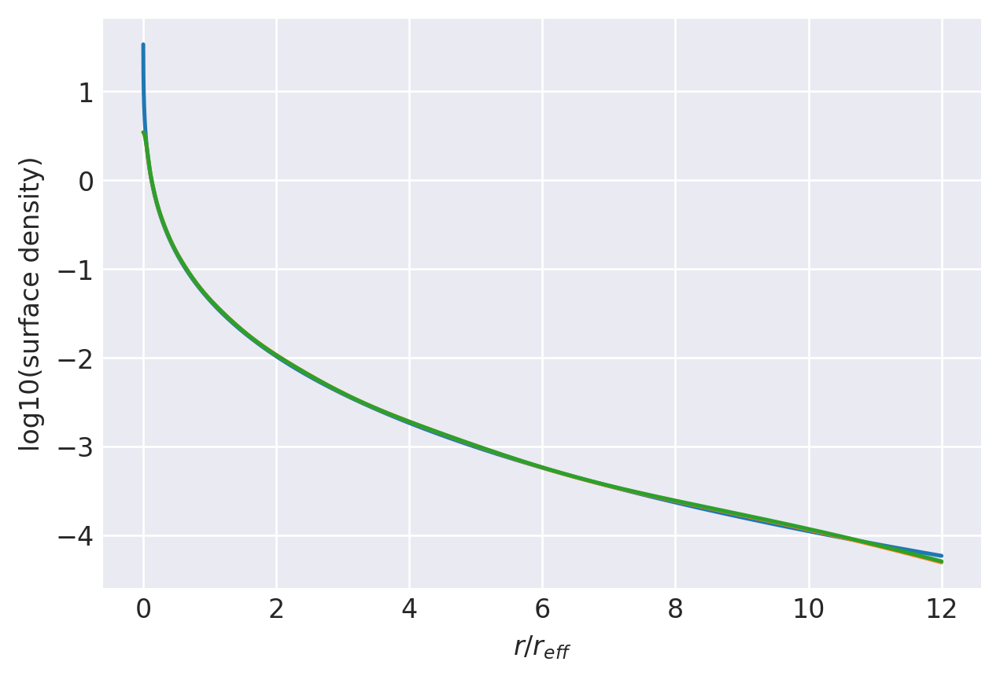

n=3.95: (
    normalize(np.array([1.2982085534e-01, 1.9148203802e-01, 2.1017996245e-01, 1.8473050976e-01, 1.3507592855e-01, 8.3934876296e-02, 4.4576155591e-02, 2.0199673979e-02])),
    np.array([6.0361738369e+00, 2.6886534107e+00, 1.3648152416e+00, 7.1835812288e-01, 3.8118124005e-01, 2.0042645906e-01, 1.0274359418e-01, 5.0215392010e-02]),
),
[120, 24000]
0.9728357135388462 0.9916129032293254
prev.  chisq = -8.313421689210942
ws, re: (array([0.12982086, 0.19148204, 0.21017996, 0.18473051, 0.13507593,
       0.08393488, 0.04457616, 0.02019967]), array([6.03617384, 2.68865341, 1.36481524, 0.71835812, 0.38118124,
       0.20042646, 0.10274359, 0.05021539]))
         Current function value: -8.784712
         Iterations: 21
         Function evaluations: 1610
         Gradient evaluations: 94
-8.78471224431729 [-1.89650386 -1.27130145 -0.81225143 -0.44234147 -0.11056747  0.24411299
  0.7771782   0.78333924  0.43162204  0.13718142 -0.14139174 -0.4162527
 -0.69478607 -0.98388851 -1.29299646]


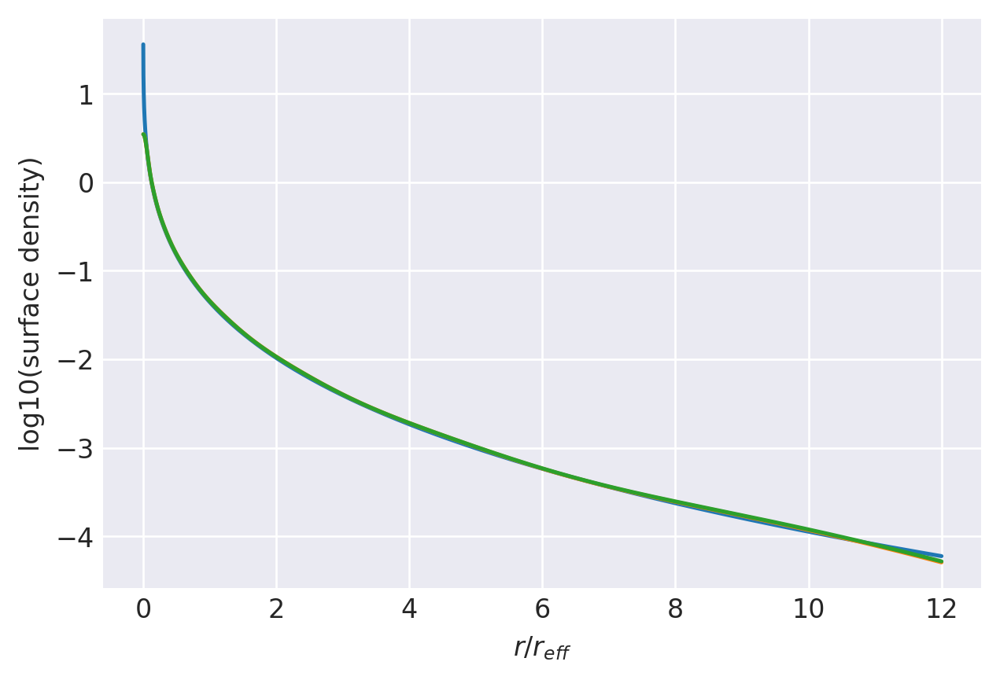

n=4.0: (
    normalize(np.array([1.3050467996e-01, 1.9044951336e-01, 2.0874610737e-01, 1.8397333459e-01, 1.3525664015e-01, 8.4708870468e-02, 4.5461938706e-02, 2.0898915397e-02])),
    np.array([6.0721046047e+00, 2.7016061853e+00, 1.3714545448e+00, 7.2211814166e-01, 3.8348404790e-01, 2.0193608629e-01, 1.0377947960e-01, 5.0933502312e-02]),
),
[126, 24000]
0.9710317334965136 0.9912917060467619
prev.  chisq = -7.87754034948971
ws, re: (array([0.13050468, 0.19044951, 0.20874611, 0.18397333, 0.13525664,
       0.08470887, 0.04546194, 0.02089892]), array([6.0721046 , 2.70160619, 1.37145454, 0.72211814, 0.38348405,
       0.20193609, 0.10377948, 0.0509335 ]))
         Current function value: -8.814211
         Iterations: 25
         Function evaluations: 1422
         Gradient evaluations: 83
-8.814211006079042 [-1.88471486 -1.28281117 -0.83296849 -0.46765337 -0.13849431  0.21516969
  0.74966097  0.78833091  0.43569124  0.14133467 -0.13688909 -0.41104235
 -0.68830863 -0.97528337 -1.2809355 ]


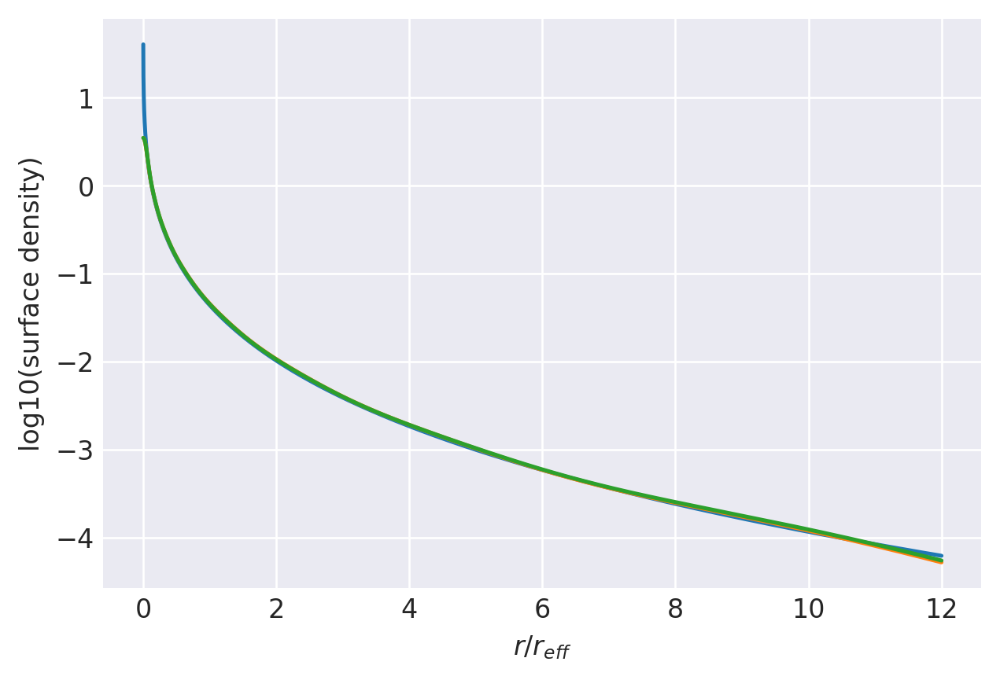

n=4.1: (
    normalize(np.array([1.3184825326e-01, 1.8845150516e-01, 2.0596124832e-01, 1.8247090558e-01, 1.3556538948e-01, 8.6194808862e-02, 4.7203142808e-02, 2.2304746523e-02])),
    np.array([6.1422983252e+00, 2.7270383257e+00, 1.3846329804e+00, 7.2964381891e-01, 3.8811251476e-01, 2.0497050317e-01, 1.0585627962e-01, 5.2367820579e-02]),
),
[133, 24000]
0.9692115606886255 0.9906437437132606
prev.  chisq = -7.9296800614665655
ws, re: (array([0.13184825, 0.18845151, 0.20596125, 0.18247091, 0.13556539,
       0.08619481, 0.04720314, 0.02230475]), array([6.14229833, 2.72703833, 1.38463298, 0.72964382, 0.38811251,
       0.2049705 , 0.10585628, 0.05236782]))
         Current function value: -8.850916
         Iterations: 25
         Function evaluations: 1388
         Gradient evaluations: 81
-8.850916080188673 [-1.87455862 -1.29566314 -0.85492151 -0.4940617  -0.16735023  0.18552066
  0.72173711  0.79341623  0.44013079  0.14614833 -0.13144858 -0.40462527
 -0.68035542 -0.9649333  -1.26688237

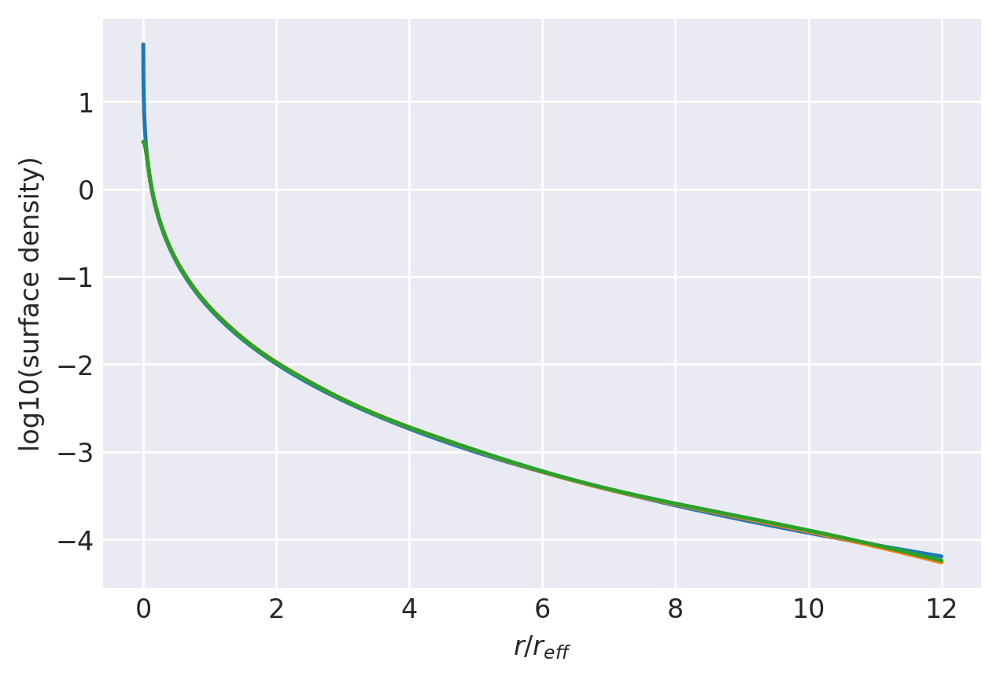

n=4.2: (
    normalize(np.array([1.3301513297e-01, 1.8631141314e-01, 2.0311396441e-01, 1.8096505735e-01, 1.3591730868e-01, 8.7769492259e-02, 4.9066064848e-02, 2.3841566337e-02])),
    np.array([6.2146435737e+00, 2.7550582953e+00, 1.4000654133e+00, 7.3884173855e-01, 3.9388979472e-01, 2.0875870015e-01, 1.0840933900e-01, 5.4090080980e-02]),
),
[139, 24000]
0.9673781468920812 0.9899647726495735
prev.  chisq = -7.976279664380049
ws, re: (array([0.13301513, 0.18631141, 0.20311396, 0.18096506, 0.13591731,
       0.08776949, 0.04906606, 0.02384157]), array([6.21464357, 2.7550583 , 1.40006541, 0.73884174, 0.39388979,
       0.2087587 , 0.10840934, 0.05409008]))
         Current function value: -8.880998
         Iterations: 24
         Function evaluations: 1712
         Gradient evaluations: 100
-8.880997690422834 [-1.86342522 -1.30625823 -0.87413587 -0.51747492 -0.19299747  0.15925496
  0.69719539  0.79800523  0.44392775  0.15012645 -0.12705716 -0.39951304
 -0.6740367  -0.95667028 -1.25557739

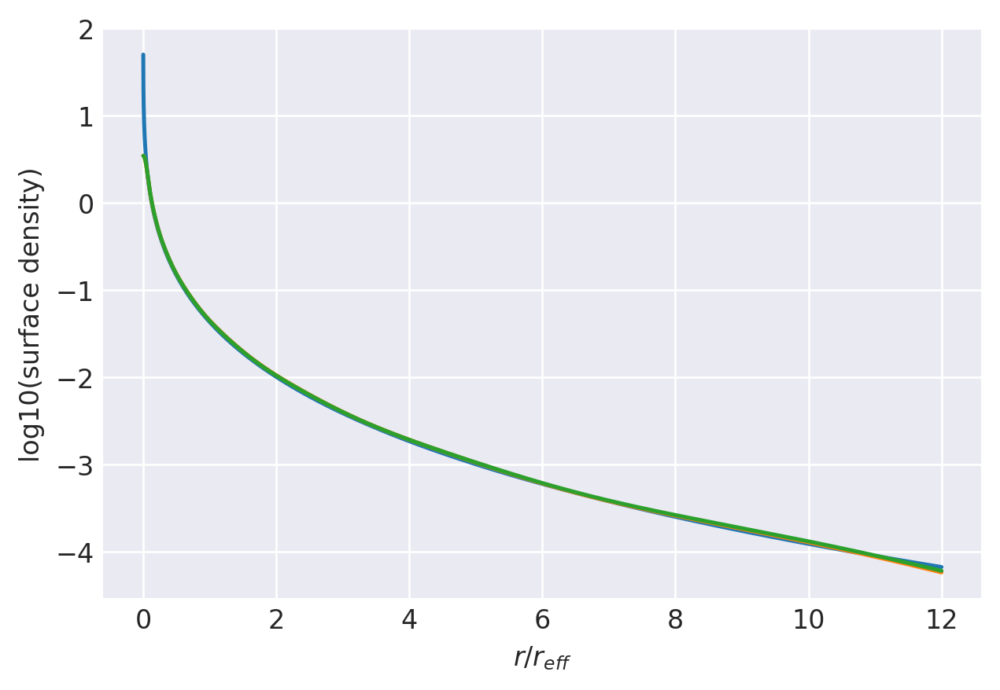

n=4.3: (
    normalize(np.array([1.3430431375e-01, 1.8449156851e-01, 2.0054270615e-01, 1.7949957729e-01, 1.3609498560e-01, 8.9091498050e-02, 5.0718535262e-02, 2.5256815395e-02])),
    np.array([6.2806592372e+00, 2.7792508404e+00, 1.4129488810e+00, 7.4635051555e-01, 3.9855380965e-01, 2.1181821485e-01, 1.1049171761e-01, 5.5516568095e-02]),
),
[145, 24000]
0.9655342012270172 0.9893047753190393
prev.  chisq = -8.024089044596758
ws, re: (array([0.13430431, 0.18449157, 0.20054271, 0.17949958, 0.13609499,
       0.0890915 , 0.05071854, 0.02525682]), array([6.28065924, 2.77925084, 1.41294888, 0.74635052, 0.39855381,
       0.21181821, 0.11049172, 0.05551657]))
         Current function value: -8.911341
         Iterations: 25
         Function evaluations: 1473
         Gradient evaluations: 86
-8.911340992541197 [-1.8526325  -1.31646341 -0.89267542 -0.54003447 -0.2176313   0.13415888
  0.67392442  0.8024177   0.44760762  0.15403036 -0.12271217 -0.39444042
 -0.66778194 -0.94854661 -1.24457966]

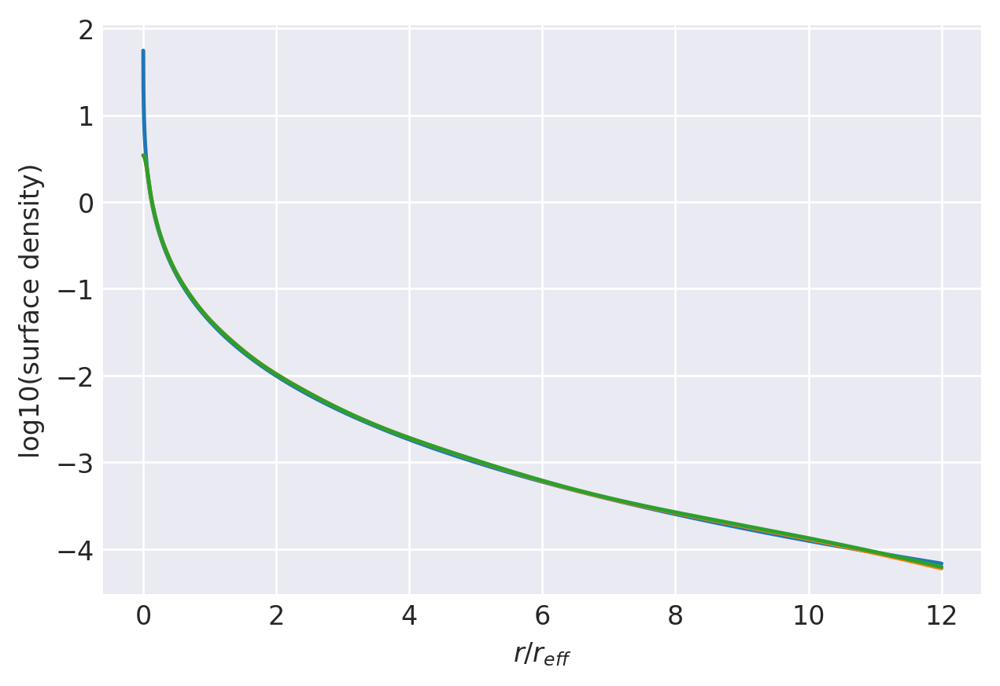

n=4.4: (
    normalize(np.array([1.3556410767e-01, 1.8274805056e-01, 1.9806987135e-01, 1.7805825378e-01, 1.3622032695e-01, 9.0340787278e-02, 5.2327200553e-02, 2.6671401862e-02])),
    np.array([6.3447966107e+00, 2.8029000887e+00, 1.4257072688e+00, 7.5385502453e-01, 4.0323626605e-01, 2.1489091932e-01, 1.1257796320e-01, 5.6940376594e-02]),
),
[151, 24000]
0.9636822054935538 0.9886406666528083
prev.  chisq = -8.072010938436767
ws, re: (array([0.13556411, 0.18274805, 0.19806987, 0.17805825, 0.13622033,
       0.09034079, 0.0523272 , 0.0266714 ]), array([6.34479661, 2.80290009, 1.42570727, 0.75385502, 0.40323627,
       0.21489092, 0.11257796, 0.05694038]))
         Current function value: -8.941894
         Iterations: 24
         Function evaluations: 1644
         Gradient evaluations: 96
-8.941893761665197 [-1.84216071 -1.32628735 -0.9105679  -0.56177709 -0.24129996  0.11016584
  0.65183056  0.80666471  0.45117612  0.157861   -0.11841519 -0.38941063
 -0.6615939  -0.94056051 -1.23387249]

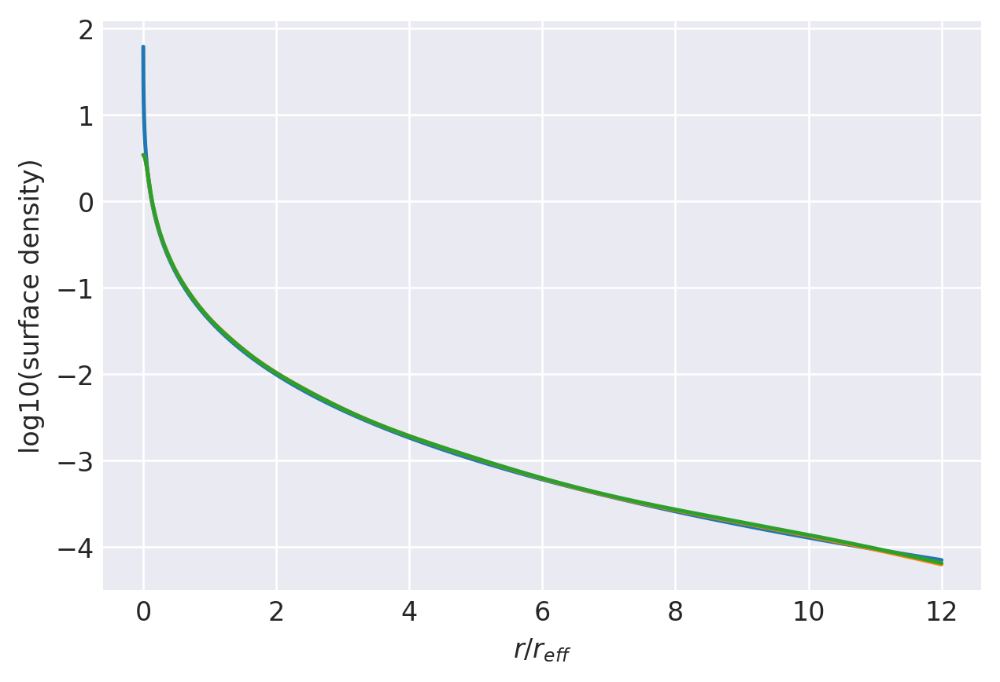

n=4.5: (
    normalize(np.array([1.3679595000e-01, 1.8107789084e-01, 1.9569083644e-01, 1.7664236019e-01, 1.3629837725e-01, 9.1520759899e-02, 5.3891466439e-02, 2.8082358946e-02])),
    np.array([6.4071472489e+00, 2.8260258148e+00, 1.4383381554e+00, 7.6135080675e-01, 4.0793349395e-01, 2.1797470330e-01, 1.1466727375e-01, 5.8361643414e-02]),
),
[157, 24000]
0.9618244293482081 0.987973457615808
prev.  chisq = -8.119978532157601
ws, re: (array([0.13679595, 0.18107789, 0.19569084, 0.17664236, 0.13629838,
       0.09152076, 0.05389147, 0.02808236]), array([6.40714725, 2.82602581, 1.43833816, 0.76135081, 0.40793349,
       0.2179747 , 0.11466727, 0.05836164]))
         Current function value: -8.972610
         Iterations: 24
         Function evaluations: 1710
         Gradient evaluations: 100
-8.972610157944853 [-1.83199246 -1.33574337 -0.92783735 -0.58273455 -0.26404933  0.08721181
  0.63083147  0.81075718  0.45463919  0.16162021 -0.11416758 -0.38442678
 -0.65547514 -0.93270994 -1.22344093]

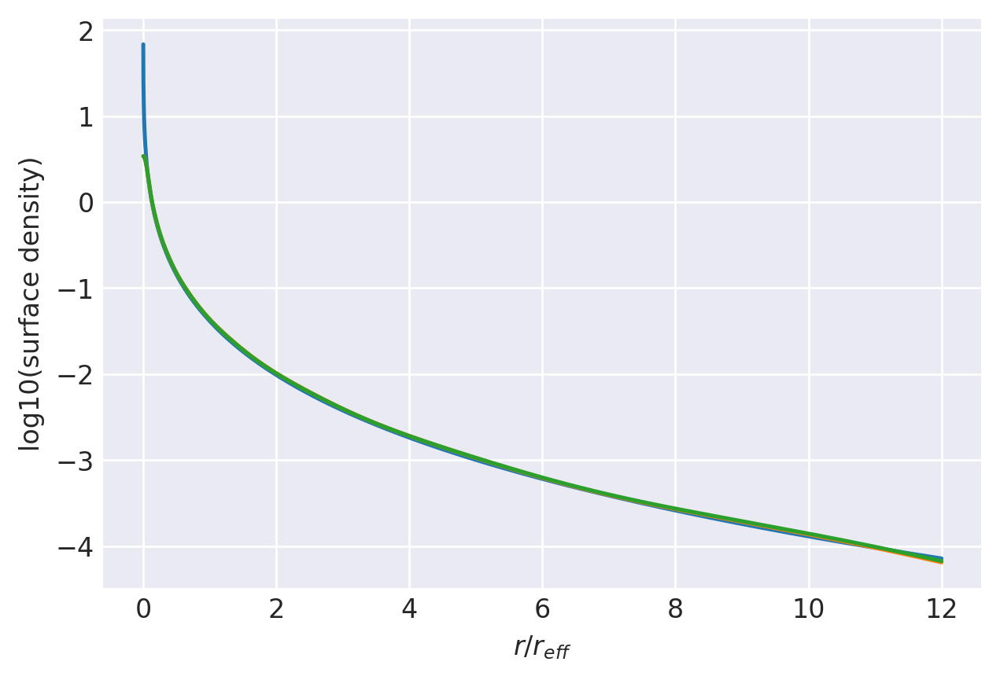

n=4.6: (
    normalize(np.array([1.3800108550e-01, 1.7947759703e-01, 1.9340174843e-01, 1.7525331033e-01, 1.3633363296e-01, 9.2634596733e-02, 5.5411073464e-02, 2.9486955550e-02])),
    np.array([6.4678088446e+00, 2.8486506589e+00, 1.4508422920e+00, 7.6883371839e-01, 4.1264180362e-01, 2.2106747922e-01, 1.1675891742e-01, 5.9780435479e-02]),
),
[163, 24000]
0.959962945088921 0.9873039493705712
prev.  chisq = -8.167931445077452
ws, re: (array([0.13800109, 0.1794776 , 0.19340175, 0.17525331, 0.13633363,
       0.0926346 , 0.05541107, 0.02948696]), array([6.46780884, 2.84865066, 1.45084229, 0.76883372, 0.4126418 ,
       0.22106748, 0.11675892, 0.05978044]))
         Current function value: -9.003450
         Iterations: 24
         Function evaluations: 1695
         Gradient evaluations: 99
-9.003449887287463 [-1.82210676 -1.34483538 -0.94450464 -0.60294483 -0.28592172  0.06524051
  0.61085393  0.81470358  0.45800017  0.16530695 -0.10997234 -0.3794924
 -0.64942903 -0.924995   -1.21327475]
0

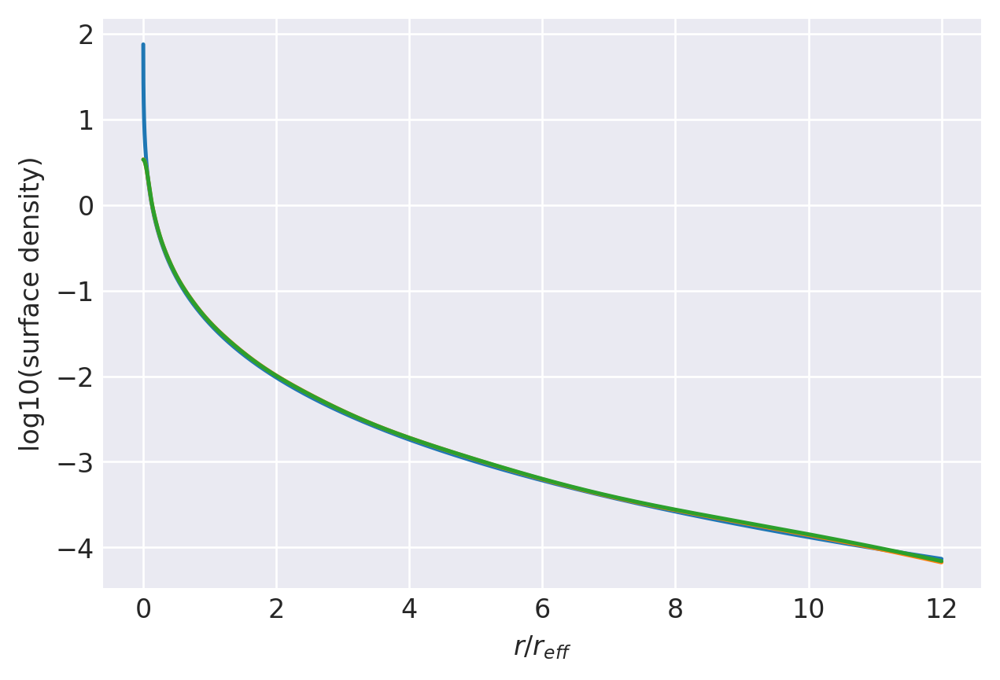

n=4.7: (
    normalize(np.array([1.3918127031e-01, 1.7794500999e-01, 1.9119871789e-01, 1.7389082152e-01, 1.3633023640e-01, 9.3685459562e-02, 5.6885876647e-02, 3.0882607683e-02])),
    np.array([6.5268491818e+00, 2.8707816778e+00, 1.4632109907e+00, 7.7629656305e-01, 4.1735689853e-01, 2.2416663451e-01, 1.1885159182e-01, 6.1196311791e-02]),
),
[169, 24000]
0.9580996418891259 0.9866330143775937
prev.  chisq = -8.215829608085382
ws, re: (array([0.13918127, 0.17794501, 0.19119872, 0.17389082, 0.13633024,
       0.09368546, 0.05688588, 0.03088261]), array([6.52684918, 2.87078168, 1.46321099, 0.77629656, 0.4173569 ,
       0.22416663, 0.11885159, 0.06119631]))
         Current function value: -9.034377
         Iterations: 24
         Function evaluations: 1695
         Gradient evaluations: 99
-9.034377492664634 [-1.81249239 -1.35358356 -0.96059519 -0.62243342 -0.30695976  0.04419473
  0.59182685  0.81851389  0.46126606  0.16892541 -0.10582843 -0.37460852
 -0.64345567 -0.9174114  -1.2033585 ]

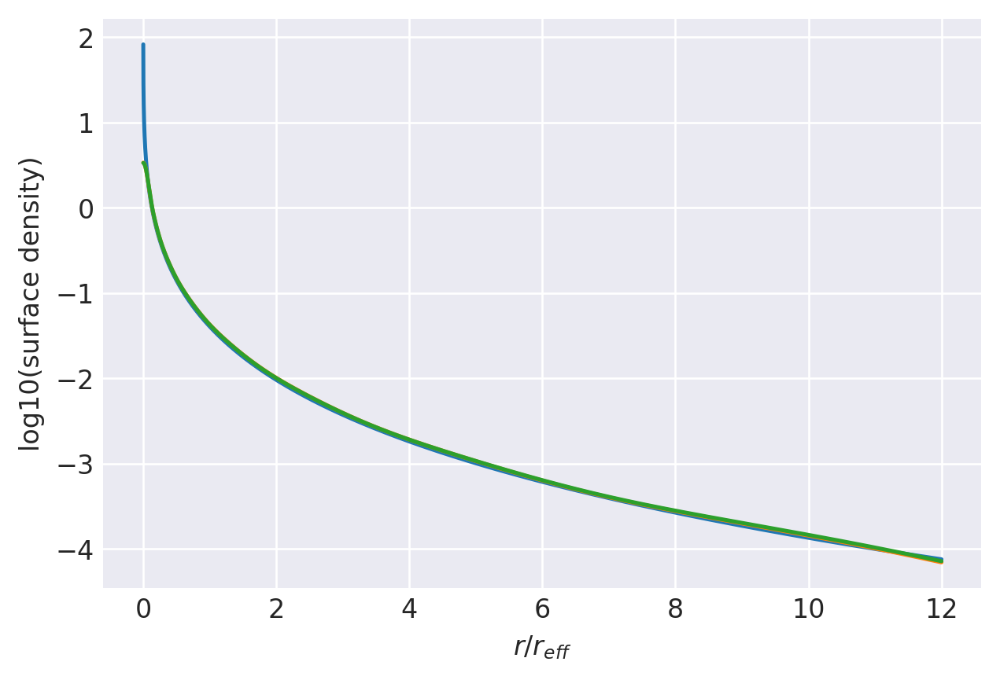

n=4.8: (
    normalize(np.array([1.4033716718e-01, 1.7647598896e-01, 1.8907813777e-01, 1.7255669950e-01, 1.3629206859e-01, 9.4676514249e-02, 5.8316176921e-02, 3.2267246832e-02])),
    np.array([6.5843648308e+00, 2.8924513070e+00, 1.4754531156e+00, 7.8373919287e-01, 4.2207680231e-01, 2.2727115967e-01, 1.2094518916e-01, 6.2609681937e-02]),
),
[174, 24000]
0.9562362393759125 0.9859612099977625
prev.  chisq = -8.258222662005721
ws, re: (array([0.14033717, 0.17647599, 0.18907814, 0.1725567 , 0.13629207,
       0.09467651, 0.05831618, 0.03226725]), array([6.58436483, 2.89245131, 1.47545312, 0.78373919, 0.4220768 ,
       0.22727116, 0.12094519, 0.06260968]))
         Current function value: -9.059266
         Iterations: 24
         Function evaluations: 1338
         Gradient evaluations: 78
-9.059266205187852 [-1.80230052 -1.360698   -0.97462229 -0.63968225 -0.32567123  0.025482
  0.57497854  0.82194833  0.46402599  0.17185655 -0.10256598 -0.37082207
 -0.63883672 -0.91150637 -1.19554632]
0

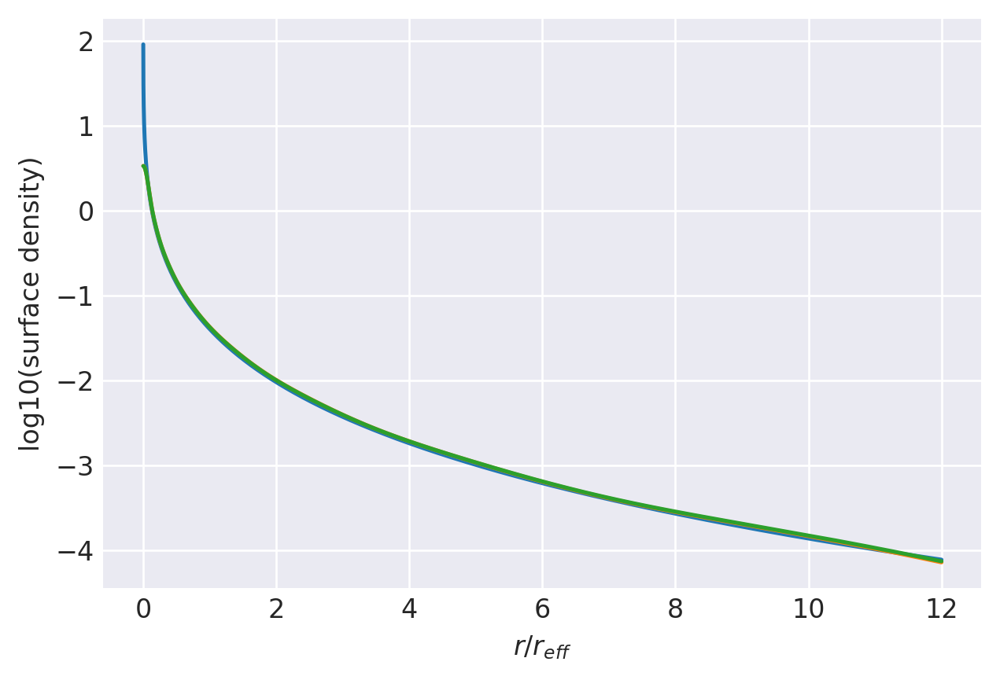

n=4.9: (
    normalize(np.array([1.4157125528e-01, 1.7522838385e-01, 1.8716966686e-01, 1.7128851163e-01, 1.3616253043e-01, 9.5491107717e-02, 5.9568397495e-02, 3.3520146737e-02])),
    np.array([6.6366409909e+00, 2.9108913340e+00, 1.4854448990e+00, 7.8964887506e-01, 4.2577281315e-01, 2.2970120822e-01, 1.2260089165e-01, 6.3746108966e-02]),
),
[180, 24000]
0.9543743004887094 0.9853166261857419
prev.  chisq = -8.30731783371842
ws, re: (array([0.14157126, 0.17522838, 0.18716967, 0.17128851, 0.13616253,
       0.09549111, 0.0595684 , 0.03352015]), array([6.63664099, 2.91089133, 1.4854449 , 0.78964888, 0.42577281,
       0.22970121, 0.12260089, 0.06374611]))
         Current function value: -9.090368
         Iterations: 22
         Function evaluations: 1576
         Gradient evaluations: 92
-9.090368033098144 [-1.7932287  -1.36884135 -0.98967833 -0.65787884 -0.34521701  0.00607584
  0.55761074  0.82551498  0.46712415  0.17535582 -0.09850858 -0.36601999
 -0.63298143 -0.9041395  -1.18604495]


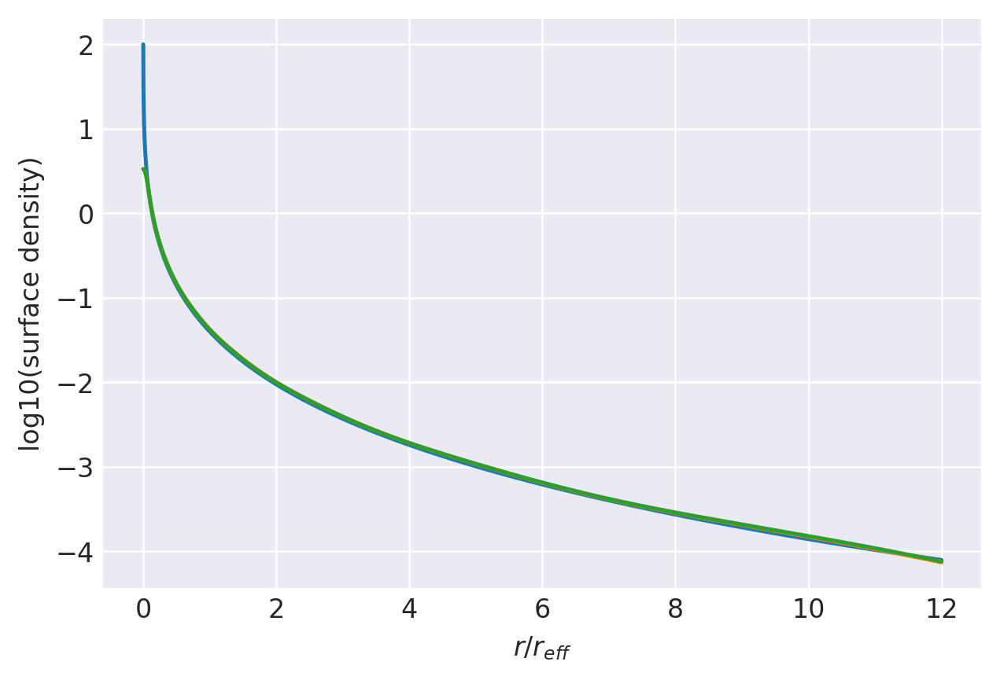

n=5.0: (
    normalize(np.array([1.4267733174e-01, 1.7387113145e-01, 1.8519870331e-01, 1.7001196939e-01, 1.3606987424e-01, 9.6377393963e-02, 6.0915102653e-02, 3.4878493236e-02])),
    np.array([6.6913690216e+00, 2.9317311761e+00, 1.4974620491e+00, 7.9706075066e-01, 4.3050679110e-01, 2.3281907904e-01, 1.2469829135e-01, 6.5156094817e-02]),
),
[185, 24000]
0.9525152435859581 0.9846452014873761
prev.  chisq = -8.349310464471241
ws, re: (array([0.14267733, 0.17387113, 0.1851987 , 0.17001197, 0.13606987,
       0.09637739, 0.0609151 , 0.03487849]), array([6.69136902, 2.93173118, 1.49746205, 0.79706075, 0.43050679,
       0.23281908, 0.12469829, 0.06515609]))
         Current function value: -9.115532
         Iterations: 23
         Function evaluations: 1405
         Gradient evaluations: 82
-9.115531745910161 [-1.78363578 -1.37547058 -1.00280505 -0.67398635 -0.36261163 -0.01120145
  0.54219897  0.8287298   0.46974287  0.17819569 -0.09530232 -0.36227848
 -0.62843076 -0.89837814 -1.17853484]

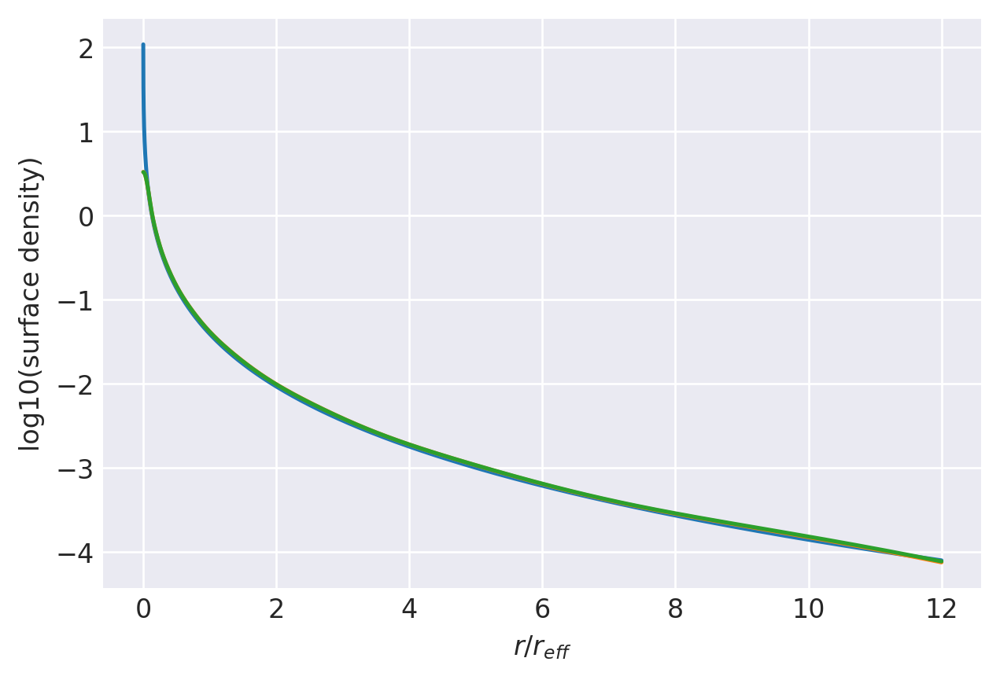

n=5.1: (
    normalize(np.array([1.4385476871e-01, 1.7271653842e-01, 1.8342561335e-01, 1.6880344284e-01, 1.3590032251e-01, 9.7102753727e-02, 6.2092022761e-02, 3.6104537687e-02])),
    np.array([6.7410849907e+00, 2.9494624615e+00, 1.5072860892e+00, 8.0296696510e-01, 4.3423169189e-01, 2.3527145325e-01, 1.2636356070e-01, 6.6292615794e-02]),
),
[191, 24000]
0.9506603537901954 0.9840027392127968
prev.  chisq = -8.398024521917595
ws, re: (array([0.14385477, 0.17271654, 0.18342561, 0.16880344, 0.13590032,
       0.09710275, 0.06209202, 0.03610454]), array([6.74108499, 2.94946246, 1.50728609, 0.80296697, 0.43423169,
       0.23527145, 0.12636356, 0.06629262]))
         Current function value: -9.146699
         Iterations: 23
         Function evaluations: 1372
         Gradient evaluations: 80
-9.146698590942433 [-1.77504372 -1.38304193 -1.01689643 -0.69098486 -0.38079324 -0.02913448
  0.52629062  0.83207899  0.47268737  0.18157912 -0.09133646 -0.35756763
 -0.6227014  -0.89122535 -1.16941872]

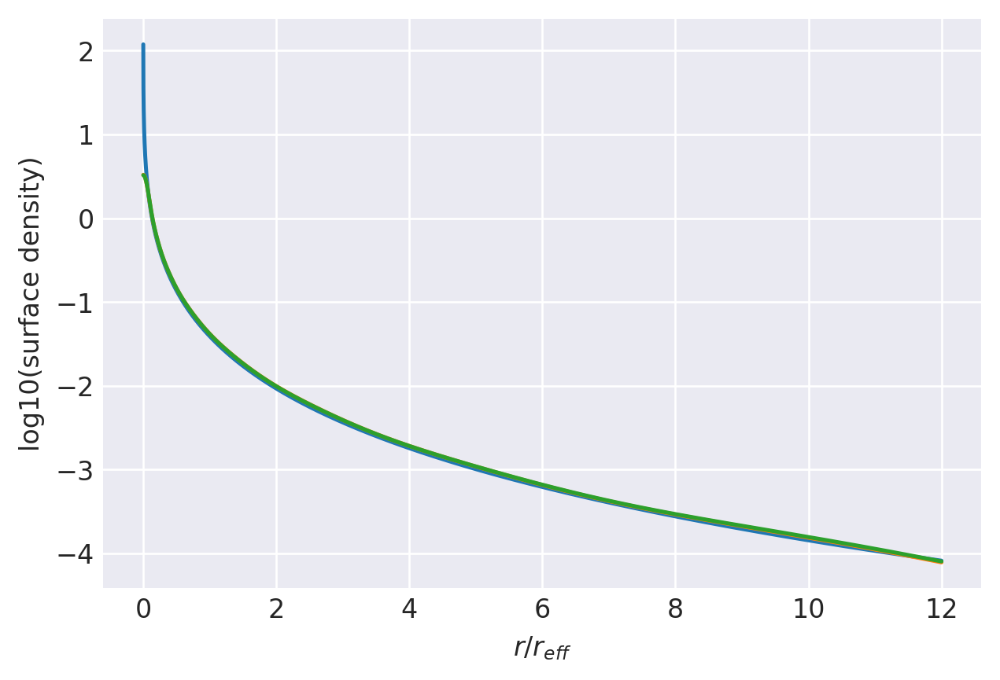

n=5.2: (
    normalize(np.array([1.4491621407e-01, 1.7146216731e-01, 1.8159203692e-01, 1.6758451355e-01, 1.3576315651e-01, 9.7893934486e-02, 6.3357090557e-02, 3.7430886590e-02])),
    np.array([6.7932718258e+00, 2.9695276503e+00, 1.5190746506e+00, 8.1033302501e-01, 4.3896750095e-01, 2.3839579850e-01, 1.2846199079e-01, 6.7698848429e-02]),
),
[196, 24000]
0.9488107935787129 0.9833335111516863
prev.  chisq = -8.43950389843621
ws, re: (array([0.14491621, 0.17146217, 0.18159204, 0.16758451, 0.13576316,
       0.09789393, 0.06335709, 0.03743089]), array([6.79327183, 2.96952765, 1.51907465, 0.81033303, 0.4389675 ,
       0.2383958 , 0.12846199, 0.06769885]))
         Current function value: -9.172031
         Iterations: 24
         Function evaluations: 1610
         Gradient evaluations: 94
-9.172030904988432 [-1.76598202 -1.38920659 -1.02918816 -0.70604389 -0.39698631 -0.04511499
  0.51215404  0.83509771  0.47517609  0.1843292  -0.08819093 -0.35387912
 -0.61822716 -0.88560981 -1.16219285]


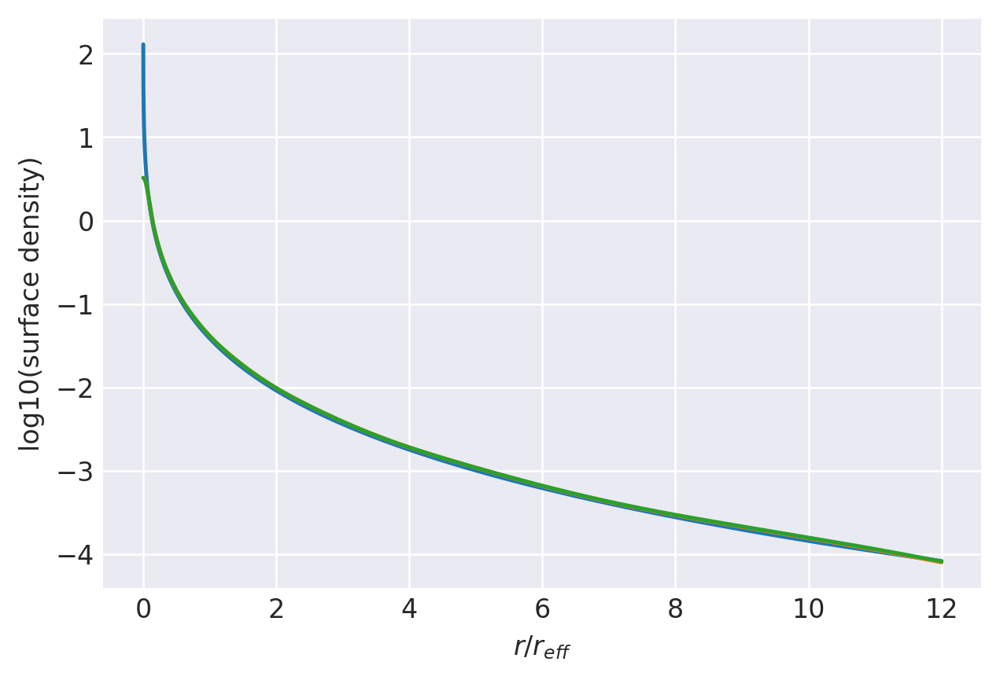

n=5.3: (
    normalize(np.array([1.4604271634e-01, 1.7039389760e-01, 1.7994226957e-01, 1.6643347505e-01, 1.3556178213e-01, 9.8539228232e-02, 6.4461234948e-02, 3.8625396127e-02])),
    np.array([6.8406553091e+00, 2.9865933236e+00, 1.5287243930e+00, 8.1622345426e-01, 4.4271157722e-01, 2.4086452721e-01, 1.3013382338e-01, 6.8834656601e-02]),
),
[205, 24000]
0.9451317570150136 0.9826946689354921
prev.  chisq = -7.974100033325445
ws, re: (array([0.14604272, 0.1703939 , 0.17994227, 0.16643348, 0.13556178,
       0.09853923, 0.06446123, 0.0386254 ]), array([6.84065531, 2.98659332, 1.52872439, 0.81622345, 0.44271158,
       0.24086453, 0.13013382, 0.06883466]))
         Current function value: -9.217235
         Iterations: 28
         Function evaluations: 2052
         Gradient evaluations: 120
-9.21723533061758 [-1.74802589 -1.39990384 -1.05141647 -0.73347778 -0.42652787 -0.07421279
  0.48652712  0.84065588  0.47962125  0.18916511 -0.08271565 -0.34749921
 -0.61050752 -0.87591768 -1.14970391]

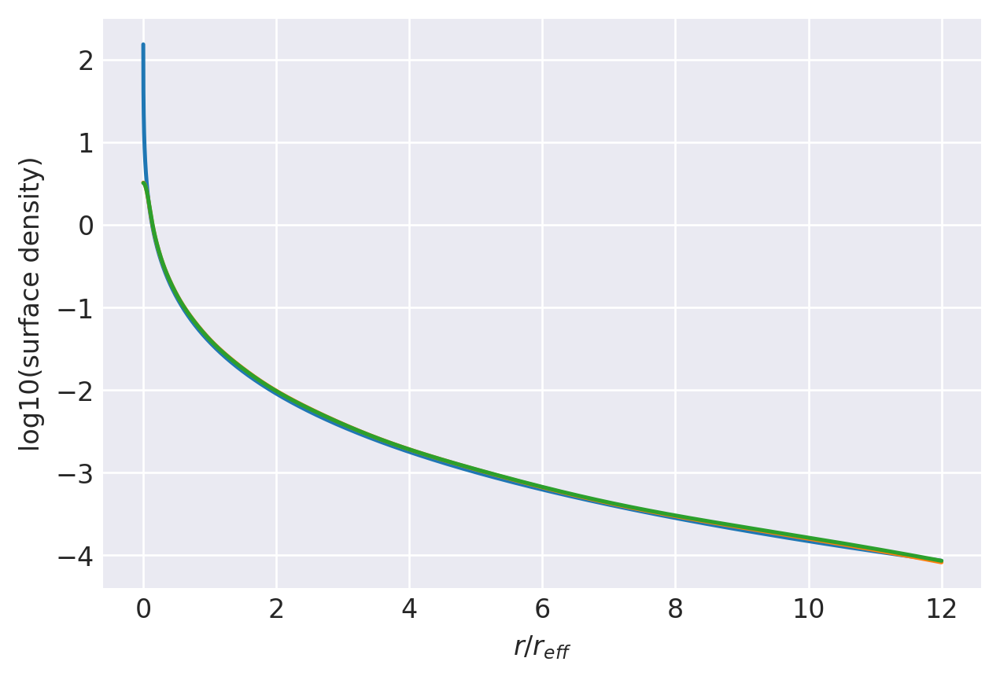

n=5.5: (
    normalize(np.array([1.4829636448e-01, 1.6849369836e-01, 1.7691939375e-01, 1.6425686238e-01, 1.3508816853e-01, 9.9635016683e-02, 6.6456099223e-02, 4.0854396586e-02])),
    np.array([6.9287658262e+00, 3.0173191718e+00, 1.5458420329e+00, 8.2657896327e-01, 4.4926313753e-01, 2.4518419923e-01, 1.3307066330e-01, 7.0842859956e-02]),
),
[205, 24000]
0.9451317570150136 0.9814539850674786
prev.  chisq = -9.21723533061758
ws, re: (array([0.14829636, 0.1684937 , 0.17691939, 0.16425686, 0.13508817,
       0.09963502, 0.0664561 , 0.0408544 ]), array([6.92876583, 3.01731917, 1.54584203, 0.82657896, 0.44926314,
       0.2451842 , 0.13307066, 0.07084286]))
         Current function value: -9.217235
         Iterations: 8
         Function evaluations: 947
         Gradient evaluations: 55
-9.217235332549611 [-1.74802588 -1.39990398 -1.05141651 -0.73347791 -0.42652793 -0.07421291
  0.48652705  0.8406559   0.47962122  0.189165   -0.08271568 -0.34749938
 -0.61050761 -0.87591786 -1.14970465]
0.

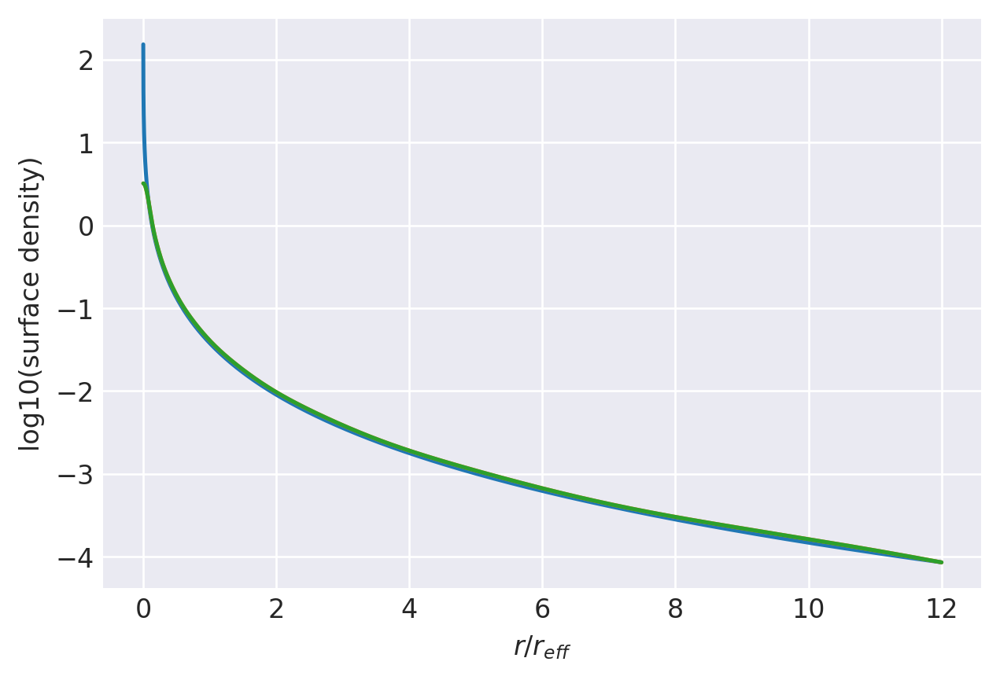

n=5.5: (
    normalize(np.array([1.4829636574e-01, 1.6849367812e-01, 1.7691939339e-01, 1.6425685436e-01, 1.3508817426e-01, 9.9635020891e-02, 6.6456108241e-02, 4.0854404991e-02])),
    np.array([6.9287660539e+00, 3.0173189309e+00, 1.5458416167e+00, 8.2657891148e-01, 4.4926296293e-01, 2.4518414825e-01, 1.3307060654e-01, 7.0842739958e-02]),
),
[209, 24000]
0.9433040775806638 0.9814539823816574
prev.  chisq = -8.556913187955887
ws, re: (array([0.14829637, 0.16849368, 0.17691939, 0.16425685, 0.13508817,
       0.09963502, 0.06645611, 0.0408544 ]), array([6.92876605, 3.01731893, 1.54584162, 0.82657891, 0.44926296,
       0.24518415, 0.13307061, 0.07084274]))
         Current function value: -9.237172
         Iterations: 23
         Function evaluations: 1848
         Gradient evaluations: 108
-9.23717201077407 [-1.73914429 -1.40450241 -1.06143148 -0.74594786 -0.43998325 -0.08744921
  0.4749213   0.84320583  0.4815879   0.19126118 -0.08037472 -0.3447933
 -0.60724078 -0.87180837 -1.14438916]


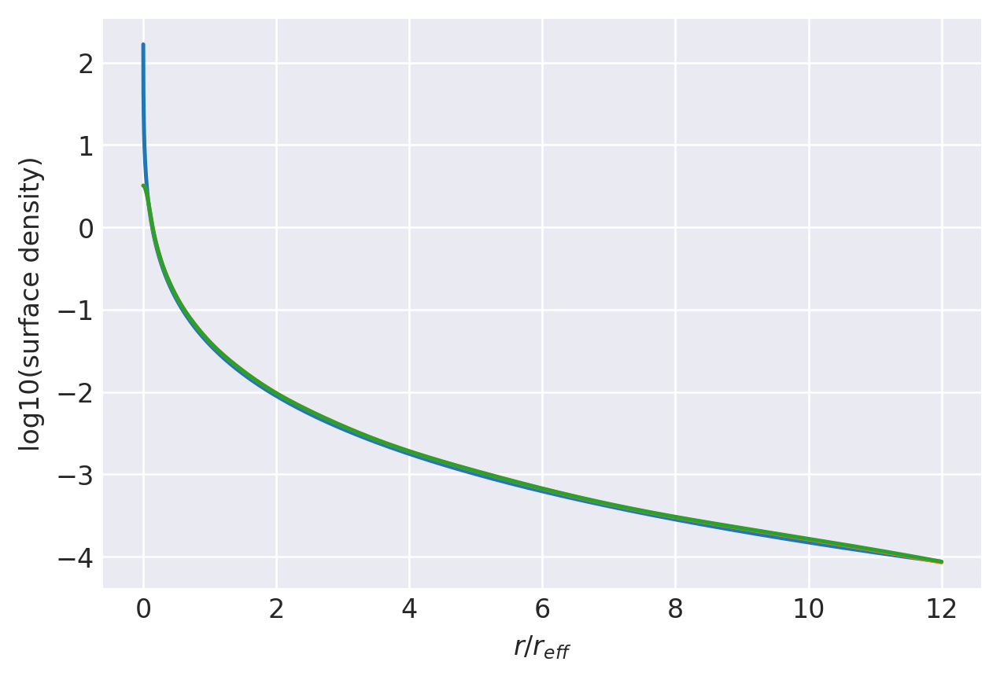

n=5.6: (
    normalize(np.array([1.4942165853e-01, 1.6765121841e-01, 1.7553685061e-01, 1.6322992744e-01, 1.3482308107e-01, 1.0009495186e-01, 6.7353117953e-02, 4.1889194127e-02])),
    np.array([6.9695674736e+00, 3.0310136884e+00, 1.5533208886e+00, 8.3104641811e-01, 4.5207105442e-01, 2.4703541594e-01, 1.3433575916e-01, 7.1715139034e-02]),
),
[213, 24000]
0.9414853378702125 0.9808539417191928
prev.  chisq = -8.594689882573693
ws, re: (array([0.14942166, 0.16765122, 0.17553685, 0.16322993, 0.13482308,
       0.10009495, 0.06735312, 0.04188919]), array([6.96956747, 3.03101369, 1.55332089, 0.83104642, 0.45207105,
       0.24703542, 0.13433576, 0.07171514]))
         Current function value: -9.257236
         Iterations: 23
         Function evaluations: 1660
         Gradient evaluations: 97
-9.257236016427218 [-1.7305441  -1.40898537 -1.07117858 -0.75806524 -0.45303524 -0.10025926
  0.46371785  0.84568876  0.48351898  0.19334032 -0.07803637 -0.34208223
 -0.60397062 -0.86771037 -1.13911986]

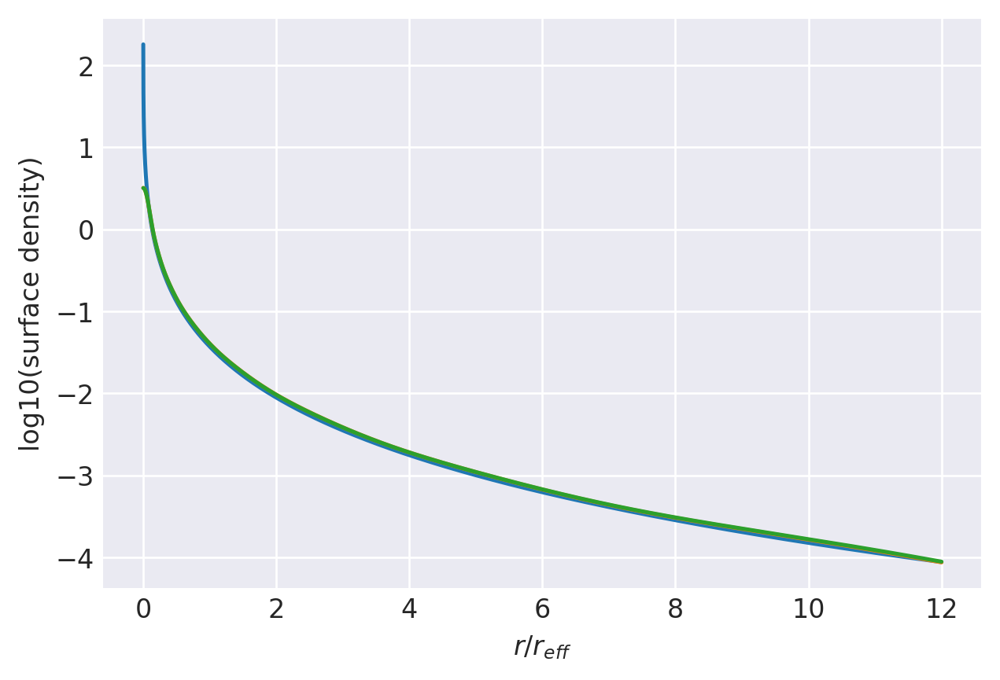

n=5.7: (
    normalize(np.array([1.5051799600e-01, 1.6683328683e-01, 1.7419762780e-01, 1.6222969417e-01, 1.3455525875e-01, 1.0053213554e-01, 6.8224694523e-02, 4.2909306387e-02])),
    np.array([7.0095277172e+00, 3.0445210712e+00, 1.5607750885e+00, 8.3553304553e-01, 4.5490191896e-01, 2.4890256982e-01, 1.3560935012e-01, 7.2590558660e-02]),
),
[217, 24000]
0.9396762213094526 0.9802573770344609
prev.  chisq = -8.632122576426445
ws, re: (array([0.150518  , 0.16683329, 0.17419763, 0.16222969, 0.13455526,
       0.10053214, 0.06822469, 0.04290931]), array([7.00952772, 3.04452107, 1.56077509, 0.83553305, 0.45490192,
       0.24890257, 0.13560935, 0.07259056]))
         Current function value: -9.277409
         Iterations: 23
         Function evaluations: 1762
         Gradient evaluations: 103
-9.277409482554317 [-1.72220064 -1.41334594 -1.08066236 -0.76984173 -0.46569756 -0.11265531
  0.45290875  0.8481055   0.48541225  0.19539846 -0.07570542 -0.33937147
 -0.60070318 -0.86363092 -1.13390276

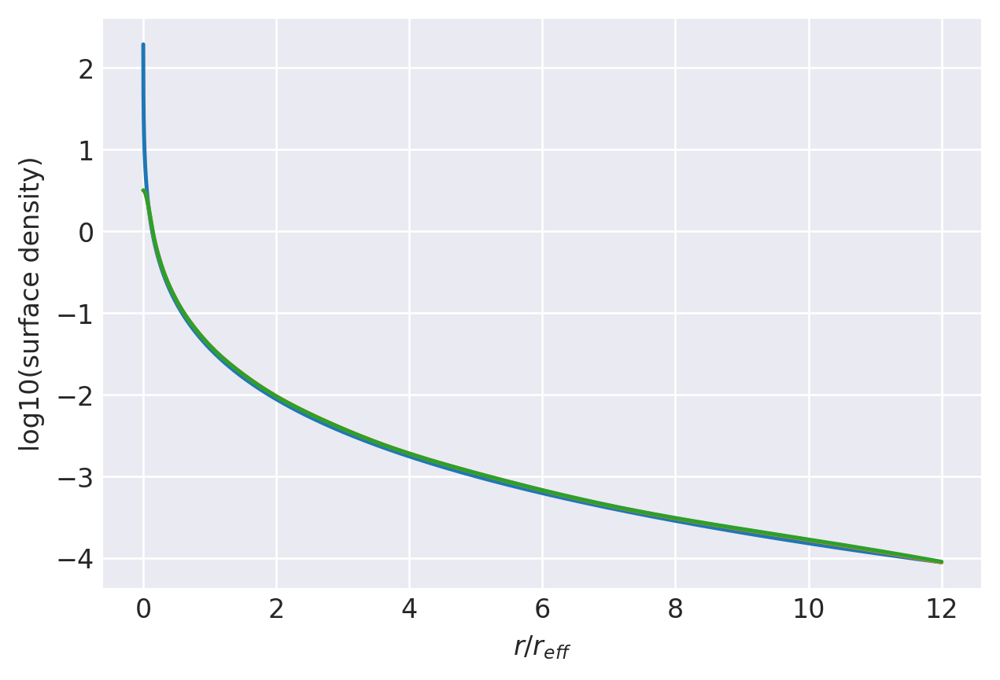

n=5.8: (
    normalize(np.array([1.5158792399e-01, 1.6604005460e-01, 1.7289989525e-01, 1.6125472608e-01, 1.3428484402e-01, 1.0094748272e-01, 6.9071231805e-02, 4.3913841543e-02])),
    np.array([7.0486427786e+00, 3.0578223204e+00, 1.5681891926e+00, 8.4002957564e-01, 4.5775018951e-01, 2.5078226448e-01, 1.3688916540e-01, 7.3467833868e-02]),
),
[221, 24000]
0.9378773378820429 0.9796647021251204
prev.  chisq = -8.669203780448337
ws, re: (array([0.15158792, 0.16604005, 0.1728999 , 0.16125473, 0.13428484,
       0.10094748, 0.06907123, 0.04391384]), array([7.04864278, 3.05782232, 1.56818919, 0.84002958, 0.45775019,
       0.25078226, 0.13688917, 0.07346783]))
         Current function value: -9.297676
         Iterations: 21
         Function evaluations: 1576
         Gradient evaluations: 92
-9.297676116508368 [-1.71409912 -1.41758706 -1.08988695 -0.78128243 -0.47798545 -0.12466264
  0.44247142  0.8504583   0.48726894  0.19743519 -0.07338435 -0.33666455
 -0.59744101 -0.85957092 -1.12873687]

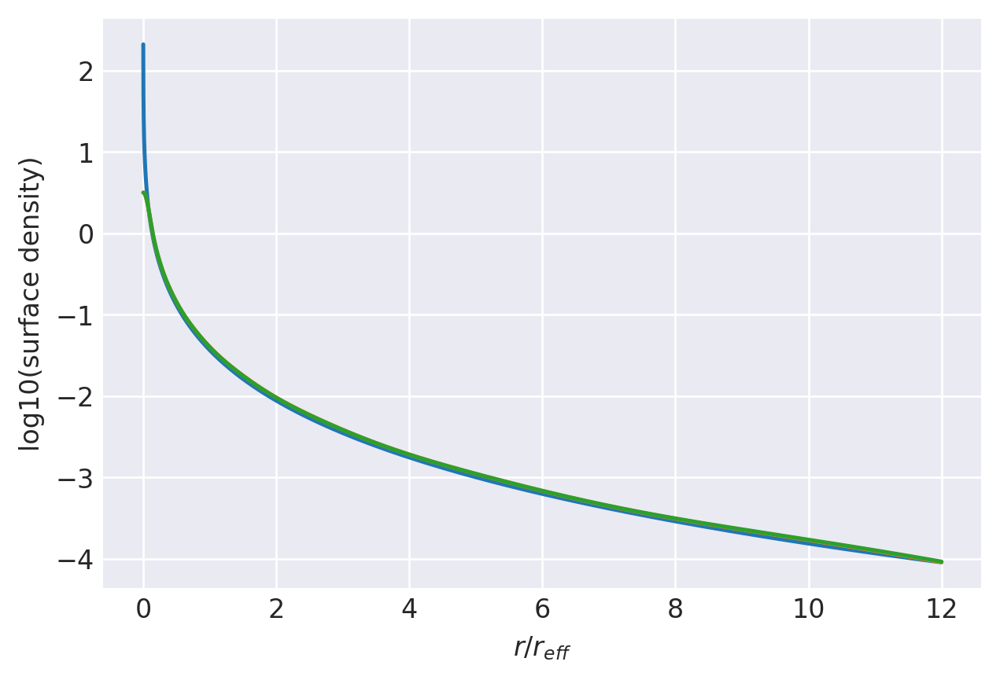

n=5.9: (
    normalize(np.array([1.5263279710e-01, 1.6527061359e-01, 1.7164249036e-01, 1.6030482236e-01, 1.3401191253e-01, 1.0134132857e-01, 6.9893309295e-02, 4.4902726205e-02])),
    np.array([7.0869325893e+00, 3.0709231017e+00, 1.5755608795e+00, 8.4453109996e-01, 4.6061221053e-01, 2.5267309165e-01, 1.3817487502e-01, 7.4346945730e-02]),
),
[224, 24000]
0.9360892302700337 0.9790761657922136
prev.  chisq = -8.699601818750935
ws, re: (array([0.1526328 , 0.16527061, 0.17164249, 0.16030482, 0.13401191,
       0.10134133, 0.06989331, 0.04490273]), array([7.08693259, 3.0709231 , 1.57556088, 0.8445311 , 0.46061221,
       0.25267309, 0.13817488, 0.07434695]))
         Current function value: -9.312535
         Iterations: 22
         Function evaluations: 1627
         Gradient evaluations: 95
-9.312535274045759 [-1.70573951 -1.42081245 -1.09775595 -0.79126784 -0.48880292 -0.13527092
  0.43324238  0.8525423   0.4887468   0.19892983 -0.07177607 -0.334848
 -0.59526381 -0.8568155  -1.12513057]
0

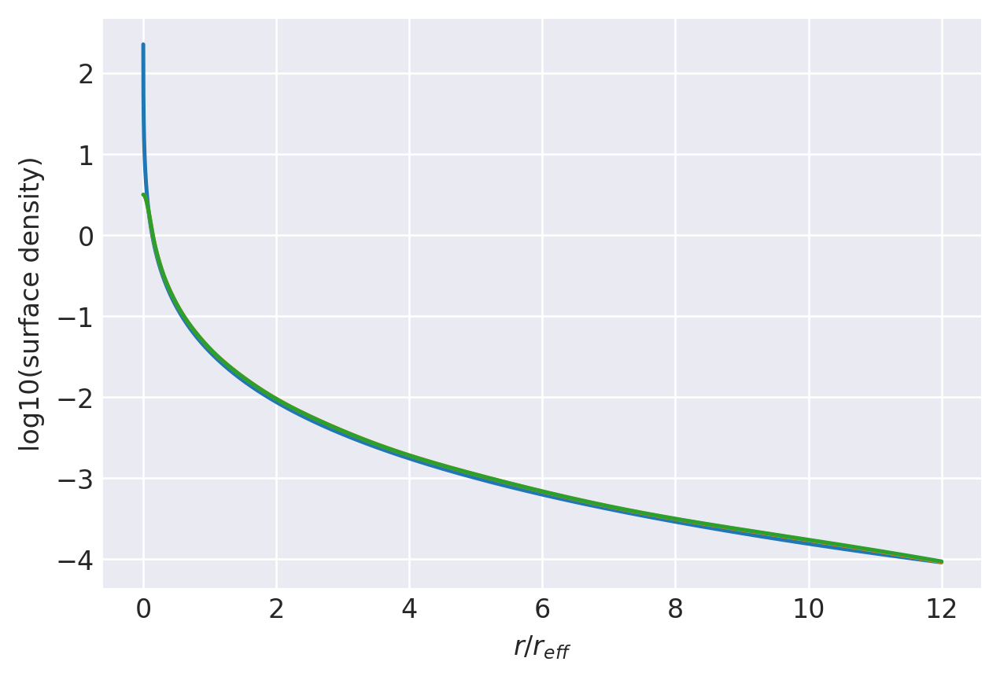

n=6.0: (
    normalize(np.array([1.5371713839e-01, 1.6463100054e-01, 1.7052243753e-01, 1.5941948006e-01, 1.3371154238e-01, 1.0163821068e-01, 7.0589636227e-02, 4.5770554199e-02])),
    np.array([7.1210215306e+00, 3.0813908954e+00, 1.5809925559e+00, 8.4766436932e-01, 4.6254287752e-01, 2.5394296895e-01, 1.3905432347e-01, 7.4966879448e-02]),
),
[228, 24000]
0.9334283101933241 0.9785235196661816
prev.  chisq = -8.45463214112976
ws, re: (array([0.15371714, 0.164631  , 0.17052244, 0.15941948, 0.13371154,
       0.10163821, 0.07058964, 0.04577055]), array([7.12102153, 3.0813909 , 1.58099256, 0.84766437, 0.46254288,
       0.25394297, 0.13905432, 0.07496688]))
         Current function value: -9.332344
         Iterations: 25
         Function evaluations: 1626
         Gradient evaluations: 95
-9.332343636606995 [-1.69345515 -1.42509832 -1.10866321 -0.80520977 -0.50394658 -0.1501196
  0.42035914  0.85546692  0.49074786  0.20089794 -0.06970402 -0.33253813
 -0.59250213 -0.85330111 -1.12048714]
0

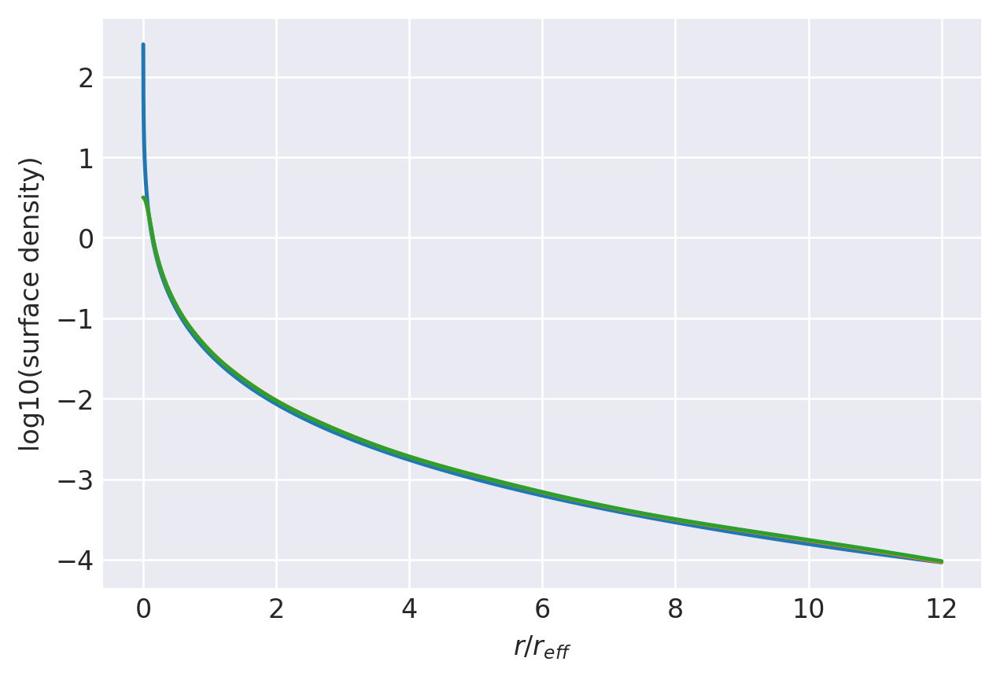

n=6.15: (
    normalize(np.array([1.5532199413e-01, 1.6375229553e-01, 1.6895141794e-01, 1.5815510683e-01, 1.3325313736e-01, 1.0202071319e-01, 7.1550311296e-02, 4.6995023720e-02])),
    np.array([7.1691376791e+00, 3.0956215241e+00, 1.5881734668e+00, 8.5171830811e-01, 4.6500954372e-01, 2.5556293833e-01, 1.4018414144e-01, 7.5772717251e-02]),
),
[232, 24000]
0.9307940951591035 0.9777200001291112
prev.  chisq = -8.504618439234545
ws, re: (array([0.15532199, 0.1637523 , 0.16895142, 0.15815511, 0.13325314,
       0.10202071, 0.07155031, 0.04699502]), array([7.16913768, 3.09562152, 1.58817347, 0.85171831, 0.46500954,
       0.25556294, 0.14018414, 0.07577272]))
         Current function value: -9.352447
         Iterations: 24
         Function evaluations: 1388
         Gradient evaluations: 81
-9.352447487715164 [-1.68173375 -1.42926056 -1.11918668 -0.81862643 -0.51848867 -0.16434136
  0.40805086  0.85828261  0.49269787  0.202849   -0.06762085 -0.33019818
 -0.58970443 -0.8497614  -1.11585304

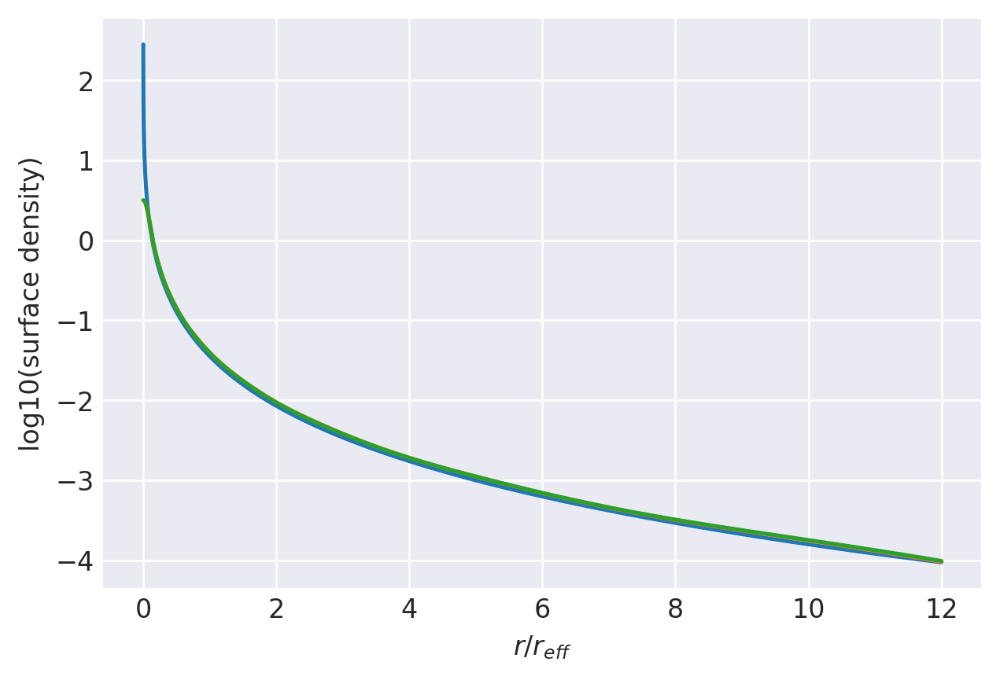

n=6.3: (
    normalize(np.array([1.5686602847e-01, 1.6290522275e-01, 1.6744658963e-01, 1.5693970219e-01, 1.3280243338e-01, 1.0237690551e-01, 7.2472732550e-02, 4.8190385522e-02])),
    np.array([7.2157688706e+00, 3.1095523627e+00, 1.5953243787e+00, 8.5581354338e-01, 4.6752175541e-01, 2.5721457390e-01, 1.4133137878e-01, 7.6585572605e-02]),
),
[235, 24000]
0.9281877248795032 0.9769281642703019
prev.  chisq = -8.547953250778626
ws, re: (array([0.15686603, 0.16290522, 0.16744659, 0.1569397 , 0.13280243,
       0.10237691, 0.07247273, 0.04819039]), array([7.21576887, 3.10955236, 1.59532438, 0.85581354, 0.46752176,
       0.25721457, 0.14133138, 0.07658557]))
         Current function value: -9.367413
         Iterations: 26
         Function evaluations: 1780
         Gradient evaluations: 104
-9.367412580698574 [-1.67012392 -1.43249497 -1.12832232 -0.83049708 -0.53145333 -0.17705268
  0.3970642   0.86079367  0.49426902  0.2042788  -0.06621173 -0.32869259
 -0.58791833 -0.84743972 -1.11268112

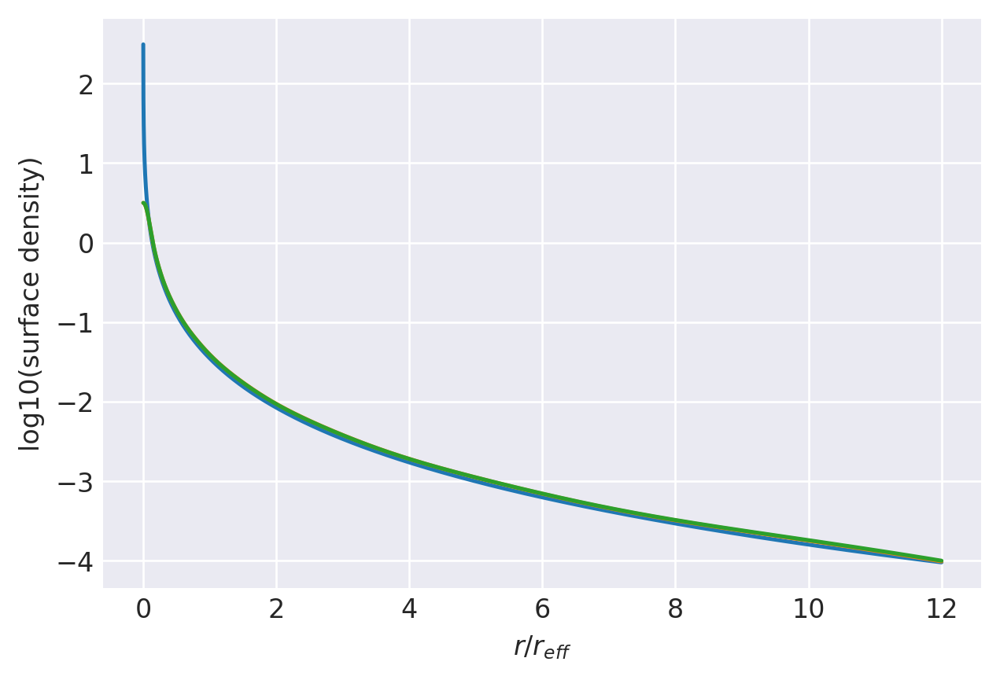

n=6.45: (
    normalize(np.array([1.5840765845e-01, 1.6218345944e-01, 1.6609566239e-01, 1.5581108257e-01, 1.3233942077e-01, 1.0264089642e-01, 7.3265855103e-02, 4.9255964871e-02])),
    np.array([7.2576107662e+00, 3.1208221640e+00, 1.6005852007e+00, 8.5859482713e-01, 4.6914534819e-01, 2.5827458524e-01, 1.4208894083e-01, 7.7146971284e-02]),
),
[237, 24000]
0.925610119750512 0.9761819929702159
prev.  chisq = -8.586220925208718
ws, re: (array([0.15840766, 0.16218346, 0.16609566, 0.15581108, 0.13233942,
       0.1026409 , 0.07326586, 0.04925596]), array([7.25761077, 3.12082216, 1.6005852 , 0.85859483, 0.46914535,
       0.25827459, 0.14208894, 0.07714697]))
         Current function value: -9.377270
         Iterations: 24
         Function evaluations: 1729
         Gradient evaluations: 101
-9.37726964147553 [-1.65865179 -1.43486897 -1.13615679 -0.84091817 -0.542944   -0.18835953
  0.38729442  0.86301137  0.49547157  0.20519693 -0.06546675 -0.32800944
 -0.58712766 -0.84631118 -1.11093239]

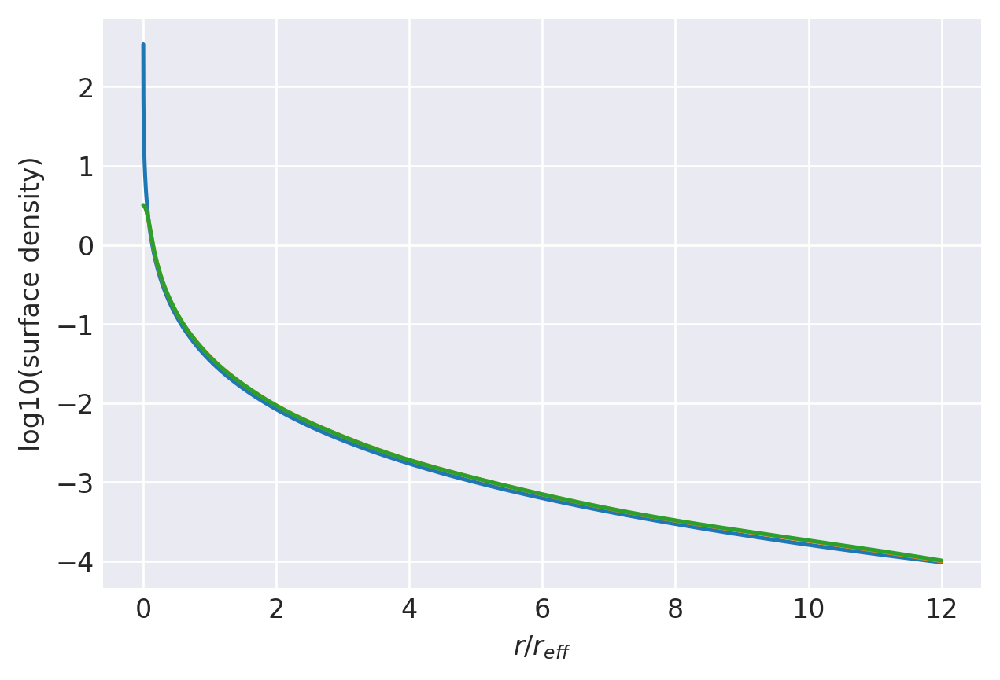

n=6.6: (
    normalize(np.array([1.5994306150e-01, 1.6157753934e-01, 1.6488859457e-01, 1.5476619315e-01, 1.3186912082e-01, 1.0282192420e-01, 7.3937827197e-02, 5.0195739221e-02])),
    np.array([7.2947660215e+00, 3.1294755824e+00, 1.6039725387e+00, 8.6006890906e-01, 4.6988389066e-01, 2.5874522494e-01, 1.4245864745e-01, 7.7458236969e-02]),
),
[239, 24000]
0.9230620084235226 0.9754834479770446
prev.  chisq = -8.625997915717281
ws, re: (array([0.15994306, 0.16157754, 0.16488859, 0.15476619, 0.13186912,
       0.10282192, 0.07393783, 0.05019574]), array([7.29476602, 3.12947558, 1.60397254, 0.86006891, 0.46988389,
       0.25874522, 0.14245865, 0.07745824]))
         Current function value: -9.387406
         Iterations: 25
         Function evaluations: 1592
         Gradient evaluations: 93
-9.387405618526126 [-1.64770693 -1.43721934 -1.14374656 -0.85098314 -0.55401886 -0.19923649
  0.37791794  0.86514487  0.49664286  0.20611355 -0.06469874 -0.32728469
 -0.58628482 -0.84513064 -1.10914652]

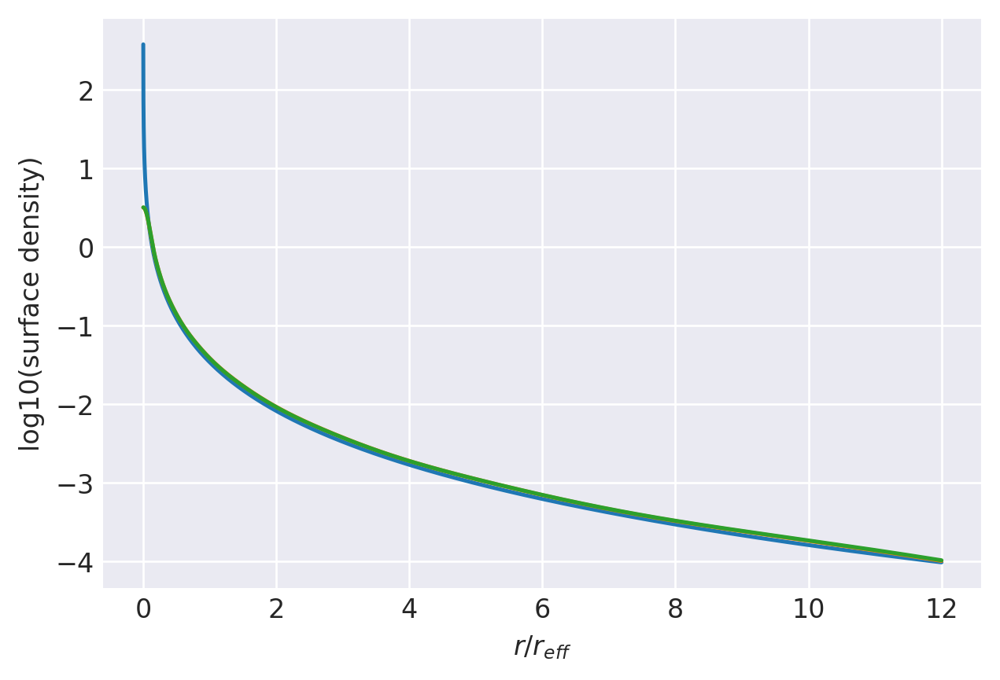

n=6.75: (
    normalize(np.array([1.6141910479e-01, 1.6098767407e-01, 1.6372898624e-01, 1.5376187990e-01, 1.3141305468e-01, 1.0299136760e-01, 7.4585487711e-02, 5.1112445009e-02])),
    np.array([7.3306901904e+00, 3.1379271377e+00, 1.6073614588e+00, 8.6159120592e-01, 4.7066869570e-01, 2.5924786241e-01, 1.4284641915e-01, 7.7777411397e-02]),
),
[240, 24000]
0.9188821553764069 0.9747991017931917
prev.  chisq = -8.280479131392937
ws, re: (array([0.1614191 , 0.16098767, 0.16372899, 0.15376188, 0.13141305,
       0.10299137, 0.07458549, 0.05111245]), array([7.33069019, 3.13792714, 1.60736146, 0.86159121, 0.4706687 ,
       0.25924786, 0.14284642, 0.07777741]))
         Current function value: -9.392293
         Iterations: 29
         Function evaluations: 1865
         Gradient evaluations: 109
-9.392292581605997 [-1.62973436 -1.43932078 -1.15364264 -0.86471109 -0.56941034 -0.2144738
  0.36476496  0.86806031  0.49776248  0.20646192 -0.06496484 -0.32799633
 -0.58719766 -0.8459235  -1.1094302 

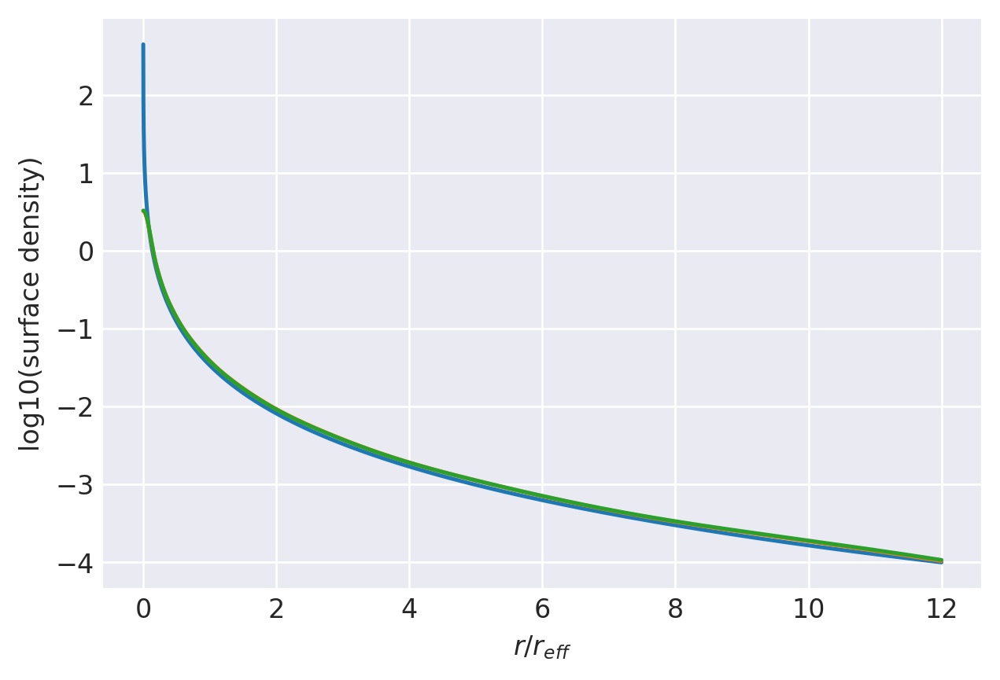

n=7.0: (
    normalize(np.array([1.6386675398e-01, 1.6024539793e-01, 1.6209437650e-01, 1.5226577996e-01, 1.3064630931e-01, 1.0310842575e-01, 7.5410756406e-02, 5.2362200171e-02])),
    np.array([7.3800671529e+00, 3.1460272260e+00, 1.6086513322e+00, 8.6106346081e-01, 4.6989808395e-01, 2.5870352409e-01, 1.4258587257e-01, 7.7726622669e-02]),
),
[239, 24000]
0.9147874621973633 0.9737752953231953
prev.  chisq = -8.327500739795195
ws, re: (array([0.16386675, 0.1602454 , 0.16209438, 0.15226578, 0.13064631,
       0.10310843, 0.07541076, 0.0523622 ]), array([7.38006715, 3.14602723, 1.60865133, 0.86106346, 0.46989808,
       0.25870352, 0.14258587, 0.07772662]))
         Current function value: -9.386949
         Iterations: 30
         Function evaluations: 1508
         Gradient evaluations: 88
-9.386949480525113 [-1.61243761 -1.43997783 -1.16115261 -0.87574114 -0.58205897 -0.22711881
  0.35383154  0.8703757   0.49814765  0.20578829 -0.06655962 -0.33034965
 -0.59008587 -0.84906338 -1.11248154]

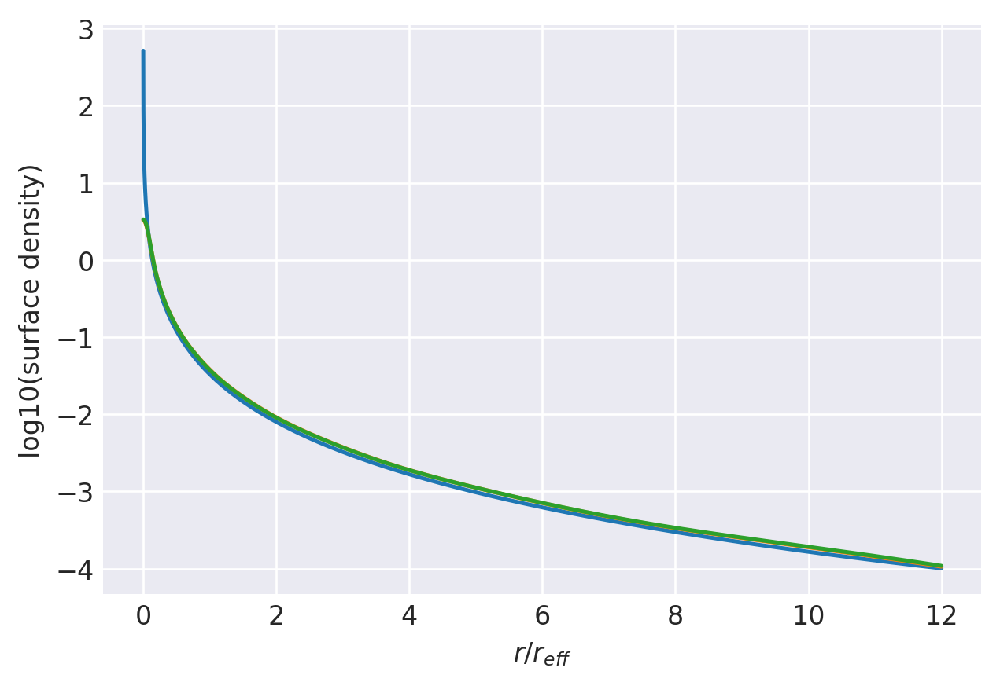

n=7.25: (
    normalize(np.array([1.6625045870e-01, 1.5970370893e-01, 1.6073156289e-01, 1.5094575688e-01, 1.2989424068e-01, 1.0309376505e-01, 7.6017052224e-02, 5.3363454648e-02])),
    np.array([7.4195181068e+00, 3.1488186706e+00, 1.6061580736e+00, 8.5790734117e-01, 4.6735872400e-01, 2.5698876120e-01, 1.4155871677e-01, 7.7182432017e-02]),
),
[236, 24000]
0.9107787615124019 0.9728717507005855
prev.  chisq = -8.362276151250555
ws, re: (array([0.16625046, 0.15970371, 0.16073156, 0.15094576, 0.12989424,
       0.10309377, 0.07601705, 0.05336345]), array([7.41951811, 3.14881867, 1.60615807, 0.85790734, 0.46735872,
       0.25698876, 0.14155872, 0.07718243]))
         Current function value: -9.371074
         Iterations: 27
         Function evaluations: 1847
         Gradient evaluations: 108
-9.371073530990124 [-1.59578363 -1.43925075 -1.16637959 -0.88420775 -0.59212158 -0.23733612
  0.34495966  0.87209893  0.49778624  0.20405913 -0.0695362  -0.33441215
 -0.59502659 -0.85463091 -1.1183761

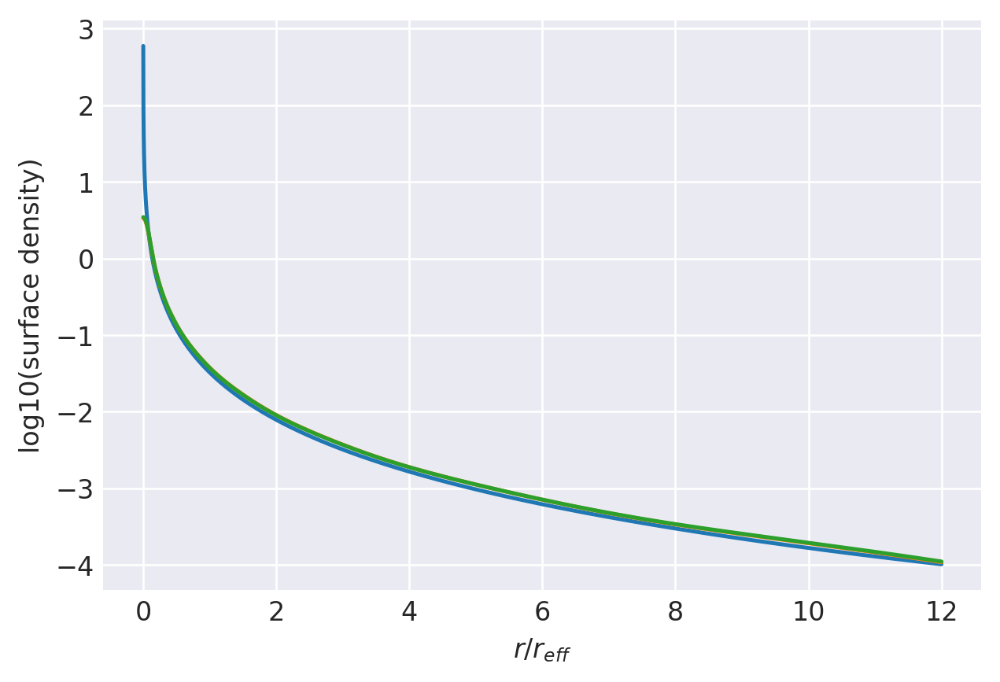

n=7.5: (
    normalize(np.array([1.6857173637e-01, 1.5935270557e-01, 1.5962467447e-01, 1.4979276979e-01, 1.2916003932e-01, 1.0295932403e-01, 7.6416702891e-02, 5.4122047551e-02])),
    np.array([7.4490163885e+00, 3.1461993523e+00, 1.5997758400e+00, 8.5204748511e-01, 4.6300730880e-01, 2.5408171629e-01, 1.3975555694e-01, 7.6141917945e-02]),
),
[231, 24000]
0.9068561721135253 0.9720962281326072
prev.  chisq = -8.383567594602976
ws, re: (array([0.16857174, 0.15935271, 0.15962467, 0.14979277, 0.12916004,
       0.10295932, 0.0764167 , 0.05412205]), array([7.44901639, 3.14619935, 1.59977584, 0.85204749, 0.46300731,
       0.25408172, 0.13975556, 0.07614192]))
         Current function value: -9.344217
         Iterations: 25
         Function evaluations: 1389
         Gradient evaluations: 81
-9.34421656570469 [-1.57972555 -1.43714611 -1.16936367 -0.89018428 -0.5996885  -0.24522635
  0.338053    0.87322799  0.49664903  0.20121421 -0.07398099 -0.34029255
 -0.60214723 -0.86276726 -1.12726271]


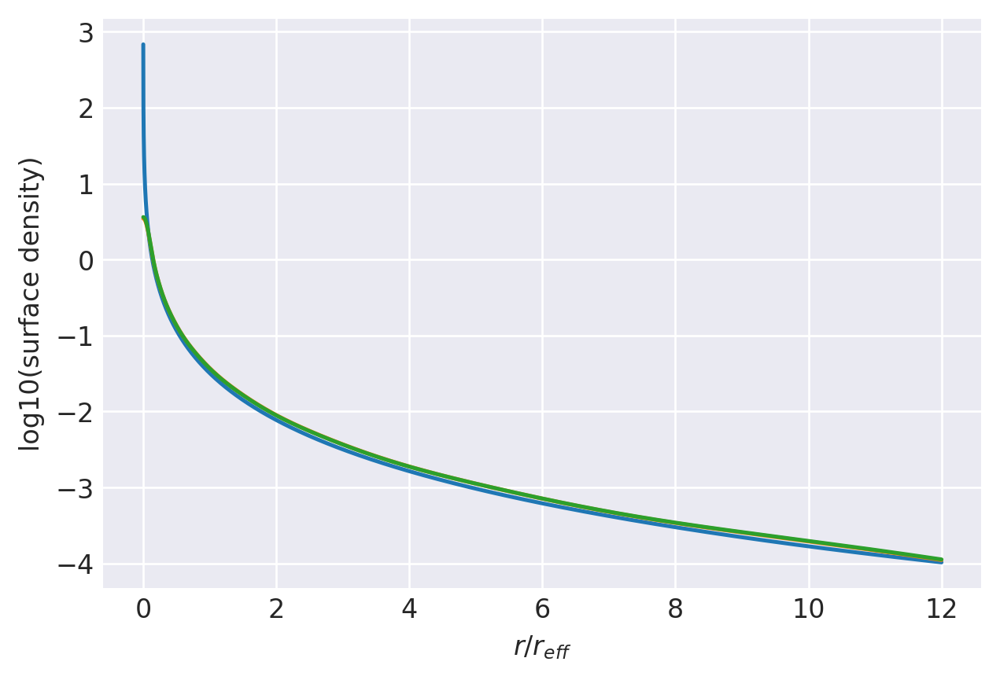

n=7.75: (
    normalize(np.array([1.7083435410e-01, 1.5918958719e-01, 1.5876424188e-01, 1.4879934396e-01, 1.2844440294e-01, 1.0271170284e-01, 7.6616637948e-02, 5.4639729143e-02])),
    np.array([7.4684072075e+00, 3.1379717466e+00, 1.5893304766e+00, 8.4337166619e-01, 4.5678038571e-01, 2.4994978357e-01, 1.3716166120e-01, 7.4599735689e-02]),
),
[224, 24000]
0.9030192502990908 0.9714571670312804
prev.  chisq = -8.389739979663974
ws, re: (array([0.17083435, 0.15918959, 0.15876424, 0.14879934, 0.1284444 ,
       0.1027117 , 0.07661664, 0.05463973]), array([7.46840721, 3.13797175, 1.58933048, 0.84337167, 0.45678039,
       0.24994978, 0.13716166, 0.07459974]))
         Current function value: -9.305756
         Iterations: 23
         Function evaluations: 1661
         Gradient evaluations: 97
-9.305755599327153 [-1.56417589 -1.433608   -1.17007585 -0.89366634 -0.60478407 -0.25084075
  0.33305287  0.87374144  0.49467708  0.1971564  -0.08002766 -0.34815595
 -0.61163771 -0.87368372 -1.13937055

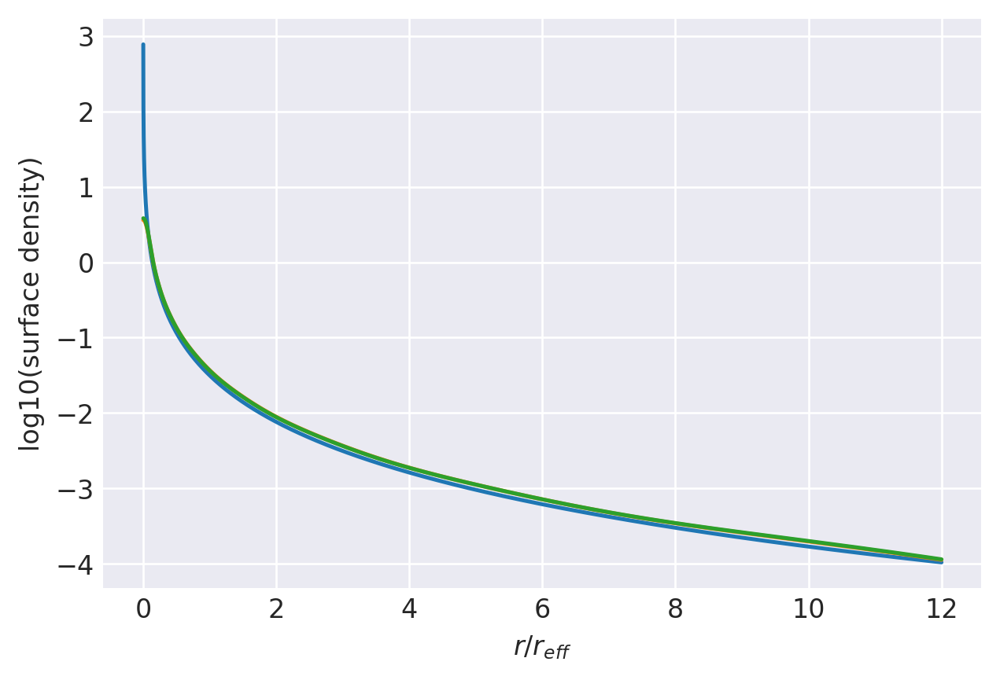

n=8.0: (
    normalize(np.array([1.7304825020e-01, 1.5921892344e-01, 1.5814669289e-01, 1.4796027223e-01, 1.2774431277e-01, 1.0235044155e-01, 7.6617132949e-02, 5.4913973956e-02])),
    np.array([7.4772420254e+00, 3.1237558242e+00, 1.5745497841e+00, 8.3171080475e-01, 4.4858427995e-01, 2.4454696957e-01, 1.3375692731e-01, 7.2548668959e-02]),
),


In [7]:
# Fit for n>1. It works well enough up to n=2
# For n>2, the steep cusp requires components to migrate in further and further, degrading the quality of the fit at R/Re > 4
# Since we aren't convinced that real galaxies are that cuspy, we skip fitting a small fraction of the interior profile
# The arbitrary fraction I picked scales as a sinusoid from 0 at n=1 to 0.5*0.12 at n=4 and caps at 0.12 at n=7.
# The sinusoidal function is a reasonable choice for its continuous derivatives
def funcrangefitn(radii, n):
    nbins = len(radii)
    facn = (np.sin((n-4)/6*np.pi)+1.)/2.
    # np.int(np.floor(nbins*(1-facn/3.)))
    ranges = [np.int(np.round(facn*nbins/100.)), nbins]
    print(ranges)
    return range(ranges[0], ranges[1])

# Close to np.round(10**np.linspace(np.log10(0.5005), np.log10(6.3), num=100), 4)

nvals = [
    (
        np.array([
            1., 1.025, 1.05, 1.075, 1.10, 1.135, 1.165, 1.2, 1.225, 1.25, 1.275,
            1.3, 1.333, 1.367, 1.4, 1.433, 1.467, 1.5, 1.55, 1.6, 1.65, 1.7,
            1.75, 1.8, 1.85, 1.9 , 1.95, 2.0, 2.05, 2.1, 2.15, 2.2, 2.25, 2.3,
            2.35, 2.4, 2.45, 2.5, 2.55, 2.6, 2.65, 2.7, 2.75, 2.8, 2.85, 2.9,
            2.95, 3., 3.05, 3.1, 3.15, 3.2, 3.25, 3.3, 3.35, 3.4, 3.45, 3.5,
            3.55, 3.6, 3.65, 3.7, 3.75, 3.8, 3.85, 3.9, 3.95, 4., 4.1, 4.2,
            4.3, 4.4, 4.5, 4.6, 4.7, 4.8, 4.9, 5., 5.1, 5.2, 5.3, 5.5, 5.5,
            5.6, 5.7, 5.8, 5.9, 6., 6.15, 6.3, 6.45, 6.6, 6.75, 7, 7.25, 7.5,
            7.75, 8,
        ]),
        (
            normalize(np.array([7.7900190678e-02, 3.1264016273e-01, 3.3937178782e-01, 1.8392530470e-01,
                                6.5418042323e-02, 1.7095071454e-02, 3.2661231097e-03, 3.8331719642e-04])),
            np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01,
                      2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02])
        ),
    )
]
fitweights(nvals, rmid, areasq, funcrangefit=funcrangefitn)

### 4-Component Sersic MGA

Unsurprisingly, 4 Gaussians is not enough to accurately approximate a Sersic profile as you'll see below, but it's useful as a starting point for free MG fits.

1.000000014984337 1.0000000150612618
prev.  chisq = -8.034436622248457
ws, re: (array([0.59933484, 0.35956993, 0.03777997, 0.00331526]), array([1.08885318, 0.92149653, 0.64439709, 0.379284  ]))
         Current function value: -11.866127
         Iterations: 73
         Function evaluations: 1191
         Gradient evaluations: 131
-11.86612675237935 [ 1.03949797  2.74177944  2.94245234  0.0252867  -0.05665531 -0.25646952
 -0.57025258]
1.000000014984337 1.0000000149610702


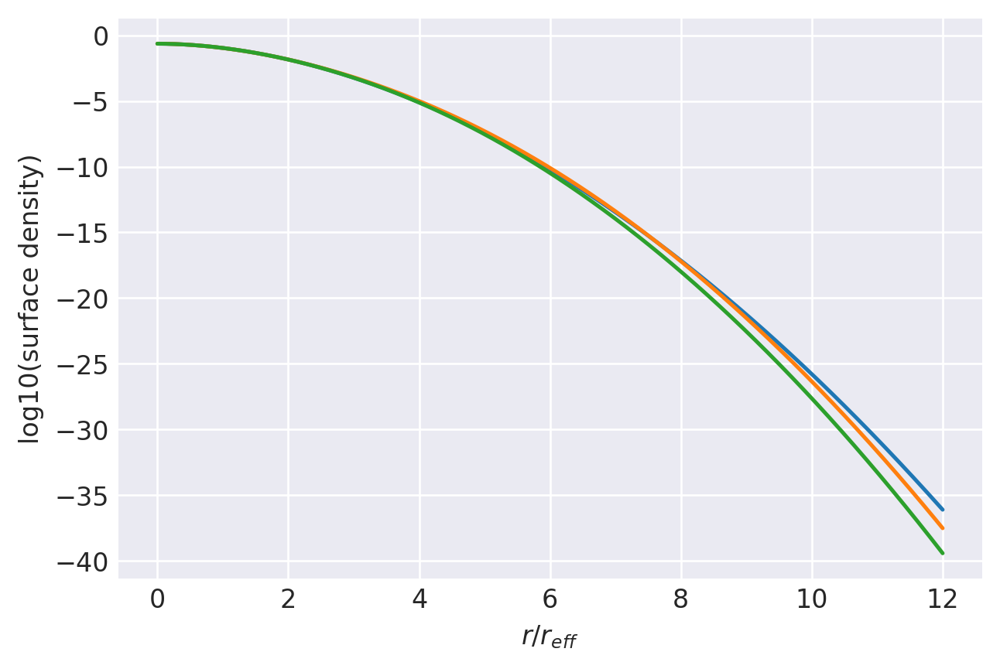

n=0.53: (
    normalize(np.array([7.3875312820e-01, 2.4542769471e-01, 1.5026724116e-02, 7.9245297099e-04])),
    np.array([1.0599532357e+00, 8.7769714840e-01, 5.5402642897e-01, 2.6899699021e-01]),
),
1.000000014891245 1.0000000149610702
prev.  chisq = -8.58937138783239
ws, re: (array([0.73875313, 0.24542769, 0.01502672, 0.00079245]), array([1.05995324, 0.87769715, 0.55402643, 0.26899699]))
         Current function value: -12.063909
         Iterations: 50
         Function evaluations: 1254
         Gradient evaluations: 138
-12.063908737481464 [ 1.20455043  2.8321562   2.95494346  0.02134281 -0.05747228 -0.25775645
 -0.57124271]
1.000000014891245 1.0000000148728263


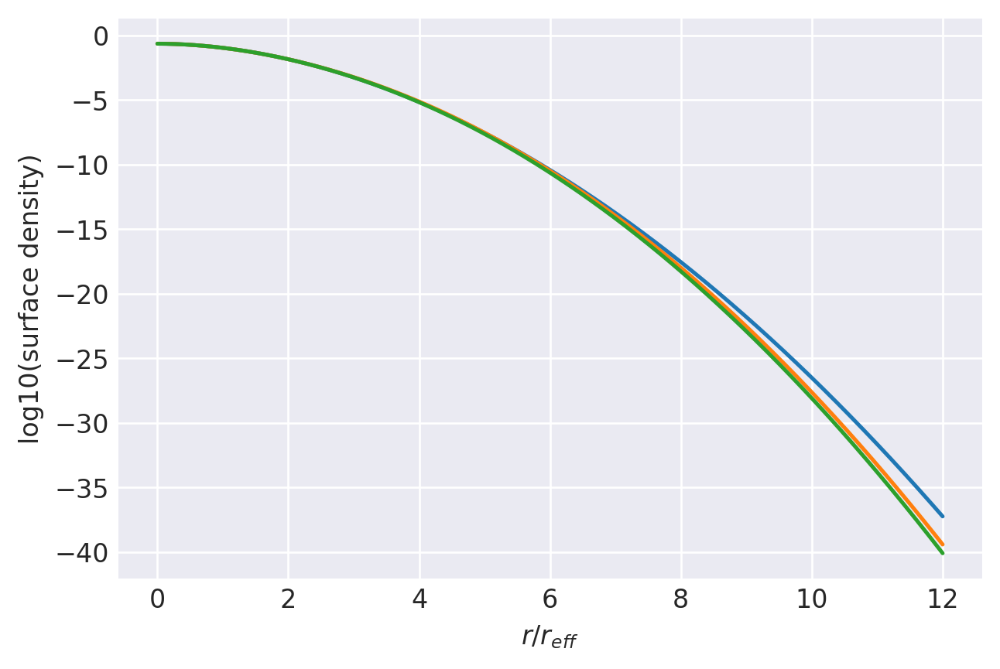

n=0.525: (
    normalize(np.array([7.6933329111e-01, 2.1783909121e-01, 1.2192607130e-02, 6.3501054964e-04])),
    np.array([1.0503712131e+00, 8.7604763161e-01, 5.5238713125e-01, 2.6838441626e-01]),
),
1.000000014799145 1.0000000148728263
prev.  chisq = -8.581147263182615
ws, re: (array([7.69333291e-01, 2.17839091e-01, 1.21926071e-02, 6.35010550e-04]), array([1.05037121, 0.87604763, 0.55238713, 0.26838442]))
         Current function value: -12.298731
         Iterations: 48
         Function evaluations: 992
         Gradient evaluations: 109
-12.29873135983647 [ 1.40175766  2.92573599  2.96500193  0.0173523  -0.05789957 -0.25827789
 -0.57114444]
1.000000014799145 1.0000000147850436


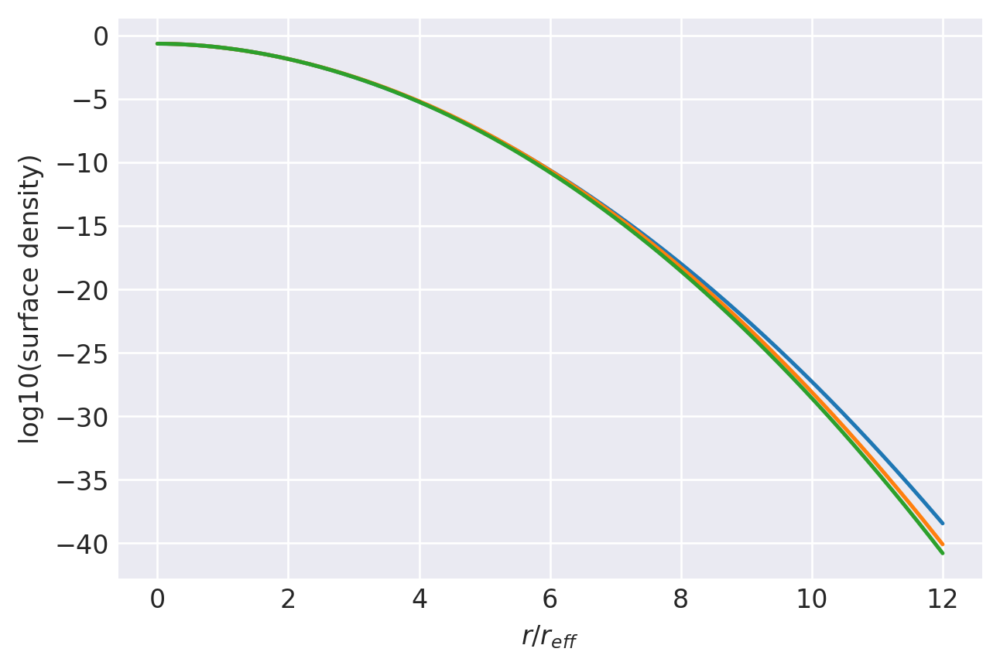

n=0.52: (
    normalize(np.array([8.0246265385e-01, 1.8748350391e-01, 9.5608797516e-03, 4.9296249415e-04])),
    np.array([1.0407640924e+00, 8.7518613346e-01, 5.5172430276e-01, 2.6844514757e-01]),
),
1.0000000147625825 1.0000000147850439
prev.  chisq = -9.370920085839352
ws, re: (array([8.02462654e-01, 1.87483504e-01, 9.56087975e-03, 4.92962494e-04]), array([1.04076409, 0.87518613, 0.5517243 , 0.26844515]))
         Current function value: -12.407412
         Iterations: 34
         Function evaluations: 857
         Gradient evaluations: 94
-12.407412035467917 [ 1.4923208   2.96292641  2.96873454  0.01574368 -0.05786937 -0.25802255
 -0.57053272]
1.0000000147625825 1.000000014750097


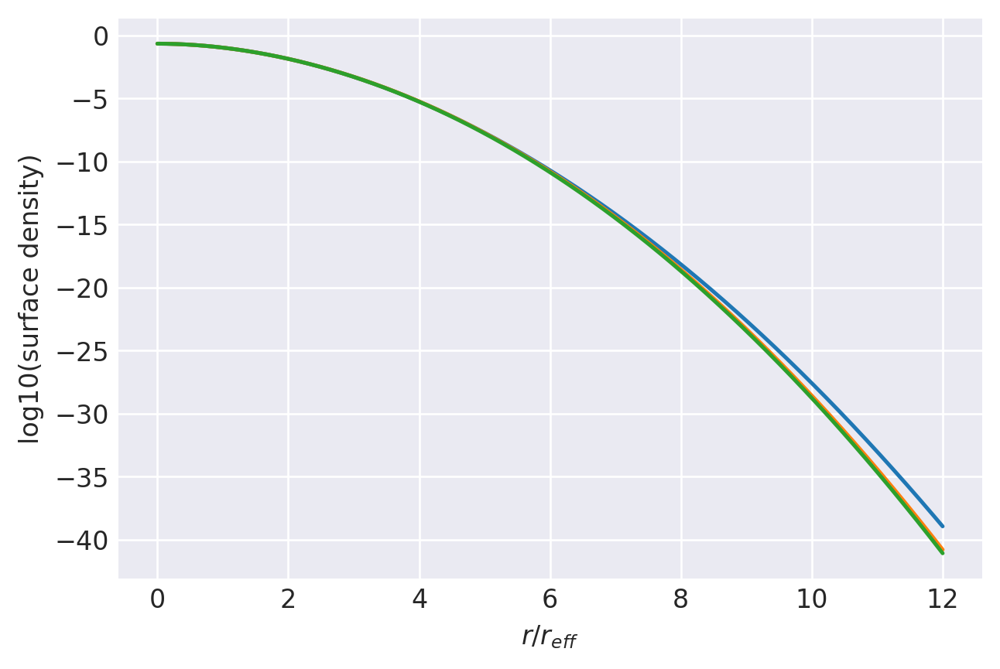

n=0.518: (
    normalize(np.array([8.1642635696e-01, 1.7455483203e-01, 8.5781654557e-03, 4.4064555255e-04])),
    np.array([1.0369162425e+00, 8.7524699659e-01, 5.5204878050e-01, 2.6882353098e-01]),
),
1.0000000147261765 1.000000014750097
prev.  chisq = -9.367752837641909
ws, re: (array([8.16426357e-01, 1.74554832e-01, 8.57816546e-03, 4.40645553e-04]), array([1.03691624, 0.875247  , 0.55204878, 0.26882353]))
         Current function value: -12.526829
         Iterations: 34
         Function evaluations: 758
         Gradient evaluations: 83
-12.52682930655028 [ 1.59886643  3.00479129  2.9716811   0.01409231 -0.05802161 -0.25832028
 -0.57060805]
1.0000000147261765 1.0000000147153143


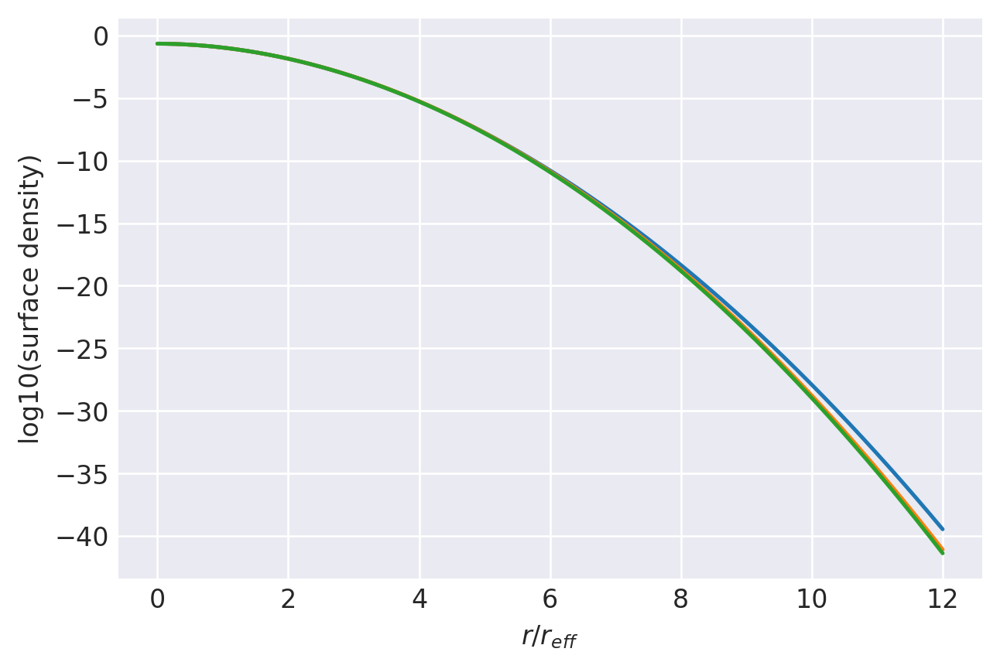

n=0.516: (
    normalize(np.array([8.3185989344e-01, 1.6020223102e-01, 7.5511283706e-03, 3.8674717382e-04])),
    np.array([1.0329809534e+00, 8.7494024307e-01, 5.5167044950e-01, 2.6877690538e-01]),
),
1.0000000146899282 1.0000000147153143
prev.  chisq = -9.364410475842556
ws, re: (array([8.31859893e-01, 1.60202231e-01, 7.55112837e-03, 3.86747174e-04]), array([1.03298095, 0.87494024, 0.55167045, 0.26877691]))
         Current function value: -12.660420
         Iterations: 36
         Function evaluations: 1353
         Gradient evaluations: 149
-12.660419910937634 [ 1.72851801  3.05138722  2.9760985   0.01238439 -0.05850127 -0.25948261
 -0.5717555 ]
1.0000000146899282 1.0000000146806403


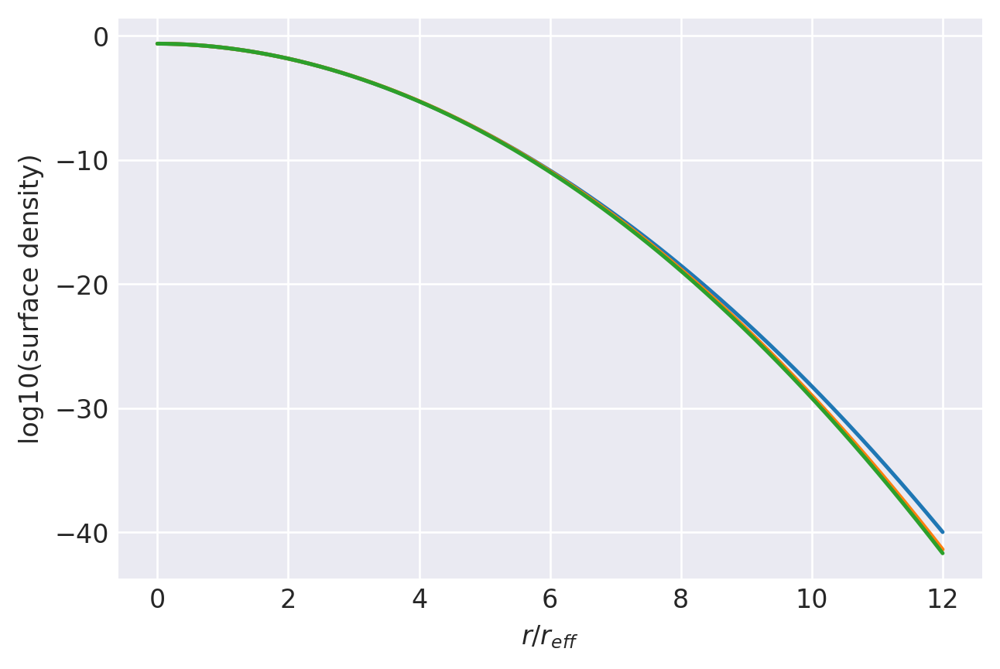

n=0.514: (
    normalize(np.array([8.4922275979e-01, 1.4396849873e-01, 6.4783989118e-03, 3.3034256095e-04])),
    np.array([1.0289265869e+00, 8.7397444646e-01, 5.5019594913e-01, 2.6806770434e-01]),
),
1.0000000146538368 1.0000000146806403
prev.  chisq = -9.36125323190853
ws, re: (array([8.49222760e-01, 1.43968499e-01, 6.47839891e-03, 3.30342561e-04]), array([1.02892659, 0.87397445, 0.55019595, 0.2680677 ]))
         Current function value: -12.811894
         Iterations: 57
         Function evaluations: 1002
         Gradient evaluations: 110
-12.811893709911118 [ 1.87474001  3.09779419  2.97951837  0.01067754 -0.05880039 -0.26024627
 -0.57239449]
1.0000000146538368 1.0000000146460506


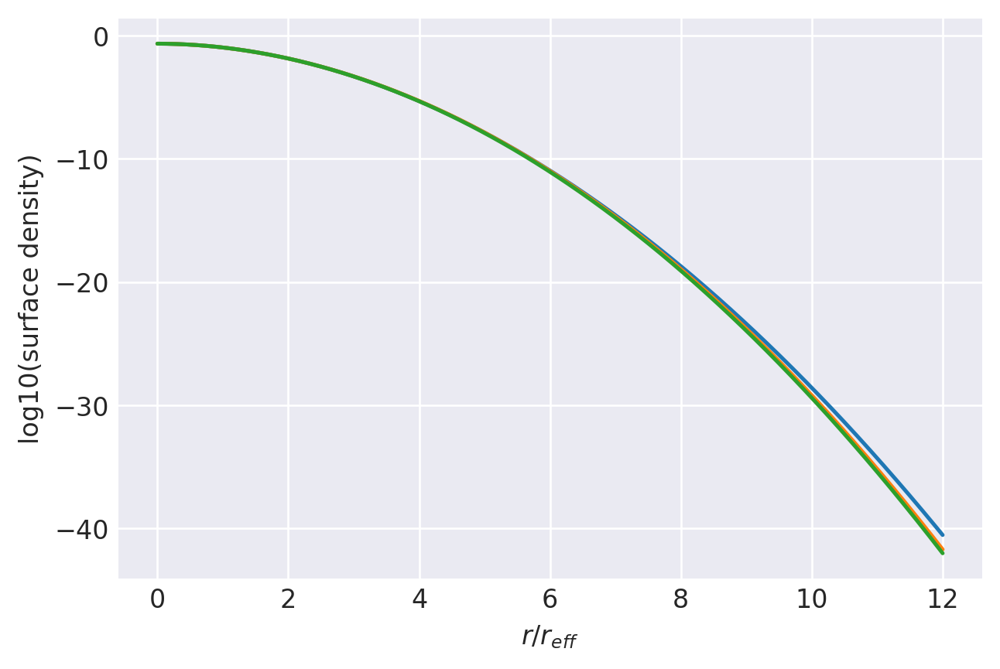

n=0.512: (
    normalize(np.array([8.6700578402e-01, 1.2724908740e-01, 5.4672953732e-03, 2.7783320734e-04])),
    np.array([1.0248906685e+00, 8.7337269083e-01, 5.4922933975e-01, 2.6767358358e-01]),
),
1.000000014617902 1.0000000146460506
prev.  chisq = -9.357965121281481
ws, re: (array([8.67005784e-01, 1.27249087e-01, 5.46729537e-03, 2.77833207e-04]), array([1.02489067, 0.87337269, 0.54922934, 0.26767358]))
         Current function value: -12.988654
         Iterations: 67
         Function evaluations: 1262
         Gradient evaluations: 139
-12.988653747865165 [ 2.042605    3.14286084  2.9810614   0.00897209 -0.05881506 -0.26027386
 -0.57198283]
1.000000014617902 1.0000000146115224


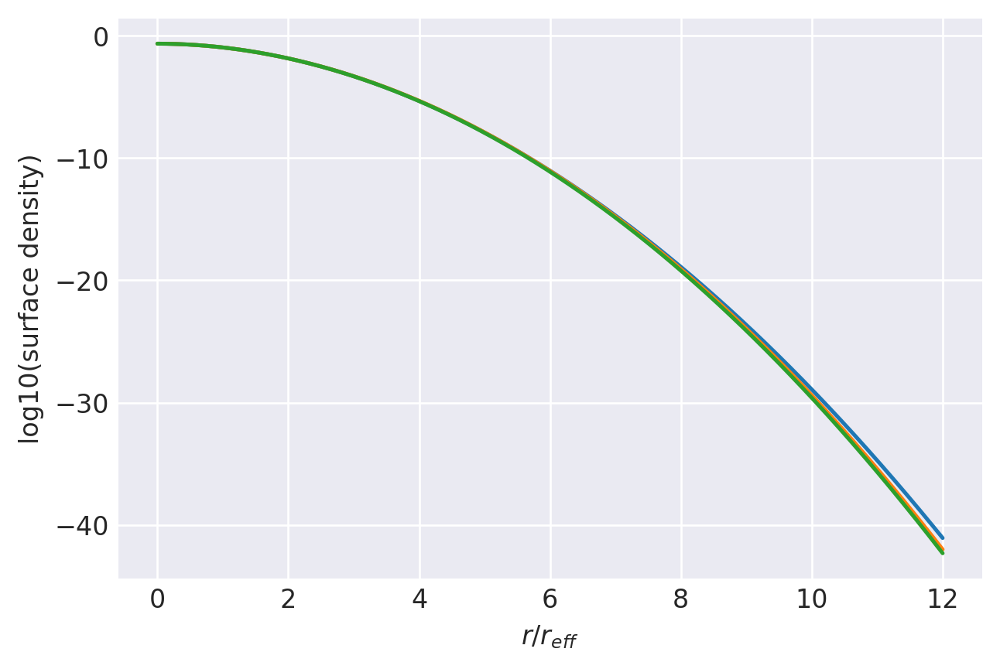

n=0.51: (
    normalize(np.array([8.8519826027e-01, 1.1005198944e-01, 4.5203904184e-03, 2.2935986869e-04])),
    np.array([1.0208738812e+00, 8.7334319737e-01, 5.4919444425e-01, 2.6792742286e-01]),
),
1.0000000145999934 1.0000000146115227
prev.  chisq = -9.95737971247538
ws, re: (array([8.85198260e-01, 1.10051989e-01, 4.52039042e-03, 2.29359869e-04]), array([1.02087388, 0.8733432 , 0.54919444, 0.26792742]))
         Current function value: -13.088964
         Iterations: 33
         Function evaluations: 840
         Gradient evaluations: 92
-13.088963863183265 [ 2.14731411  3.16914042  2.98162043  0.00808932 -0.05911199 -0.26106894
 -0.57268123]
1.0000000145999934 1.000000014594322


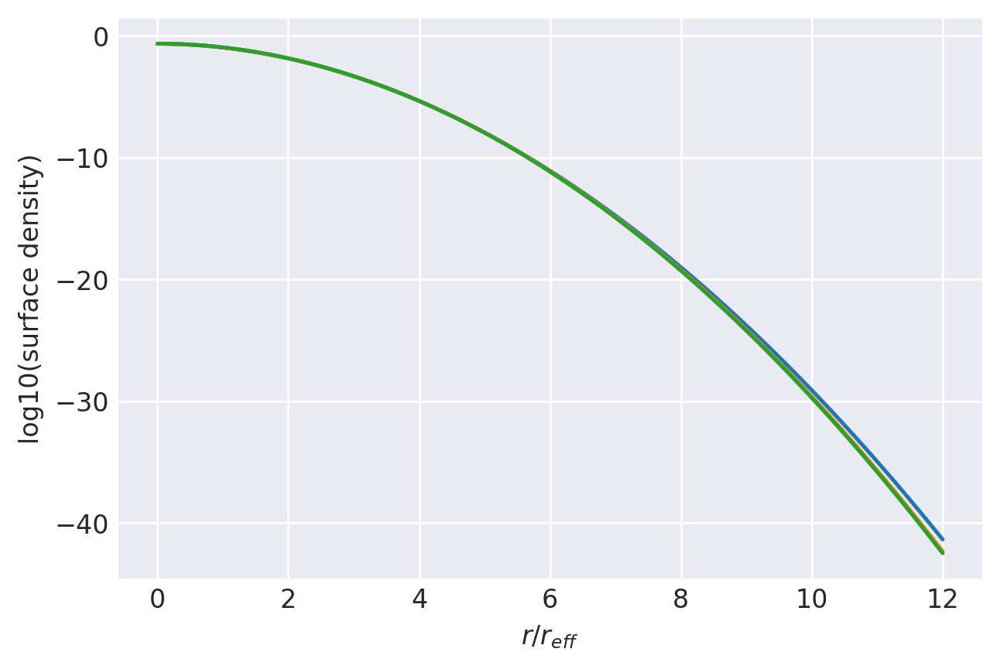

n=0.509: (
    normalize(np.array([8.9541752346e-01, 1.0036323438e-01, 4.0156082780e-03, 2.0363388219e-04])),
    np.array([1.0188008935e+00, 8.7274629422e-01, 5.4818993768e-01, 2.6749690993e-01]),
),
1.0000000145821235 1.000000014594322
prev.  chisq = -9.955811318459295
ws, re: (array([8.95417523e-01, 1.00363234e-01, 4.01560828e-03, 2.03633882e-04]), array([1.01880089, 0.87274629, 0.54818994, 0.26749691]))
         Current function value: -13.200430
         Iterations: 34
         Function evaluations: 1380
         Gradient evaluations: 152
-13.200430337908204 [ 2.26364533  3.19572014  2.98364408  0.00720553 -0.05937459 -0.26183384
 -0.5735318 ]
1.0000000145821235 1.0000000145771588


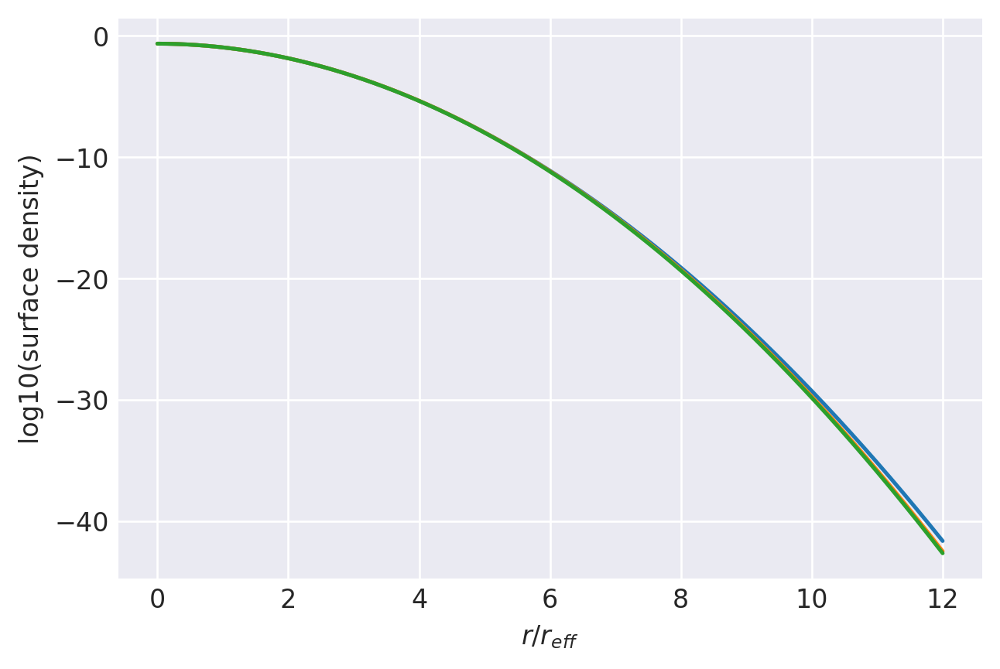

n=0.508: (
    normalize(np.array([9.0582107148e-01, 9.0475144421e-02, 3.5253718058e-03, 1.7841228896e-04])),
    np.array([1.0167297573e+00, 8.7221873496e-01, 5.4722529340e-01, 2.6697352496e-01]),
),
1.0000000145642924 1.0000000145771588
prev.  chisq = -9.954116197568556
ws, re: (array([9.05821071e-01, 9.04751444e-02, 3.52537181e-03, 1.78412289e-04]), array([1.01672976, 0.87221873, 0.54722529, 0.26697352]))
         Current function value: -13.325848
         Iterations: 35
         Function evaluations: 1074
         Gradient evaluations: 118
-13.325848433481395 [ 2.38098139  3.2150995   2.98017739  0.00635181 -0.05898843 -0.26070801
 -0.5715776 ]
1.0000000145642924 1.0000000145599444


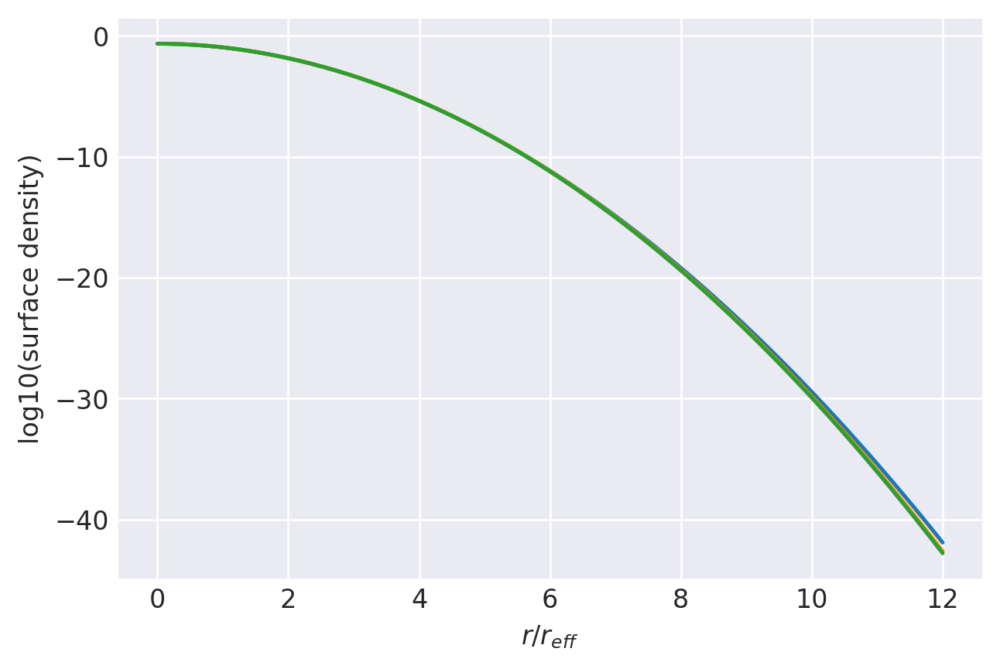

n=0.507: (
    normalize(np.array([9.1536549499e-01, 8.1367491333e-02, 3.1091206430e-03, 1.5789303772e-04])),
    np.array([1.0147330674e+00, 8.7299461952e-01, 5.4864571896e-01, 2.6817753904e-01]),
),
1.000000014546501 1.0000000145599444
prev.  chisq = -9.952638544961493
ws, re: (array([9.15365495e-01, 8.13674913e-02, 3.10912064e-03, 1.57893038e-04]), array([1.01473307, 0.87299462, 0.54864572, 0.26817754]))
         Current function value: -13.468749
         Iterations: 42
         Function evaluations: 1065
         Gradient evaluations: 117
-13.468749384961392 [ 2.52814063  3.23970514  2.98186417  0.00546699 -0.05900914 -0.26079277
 -0.57162108]
1.000000014546501 1.0000000145428105


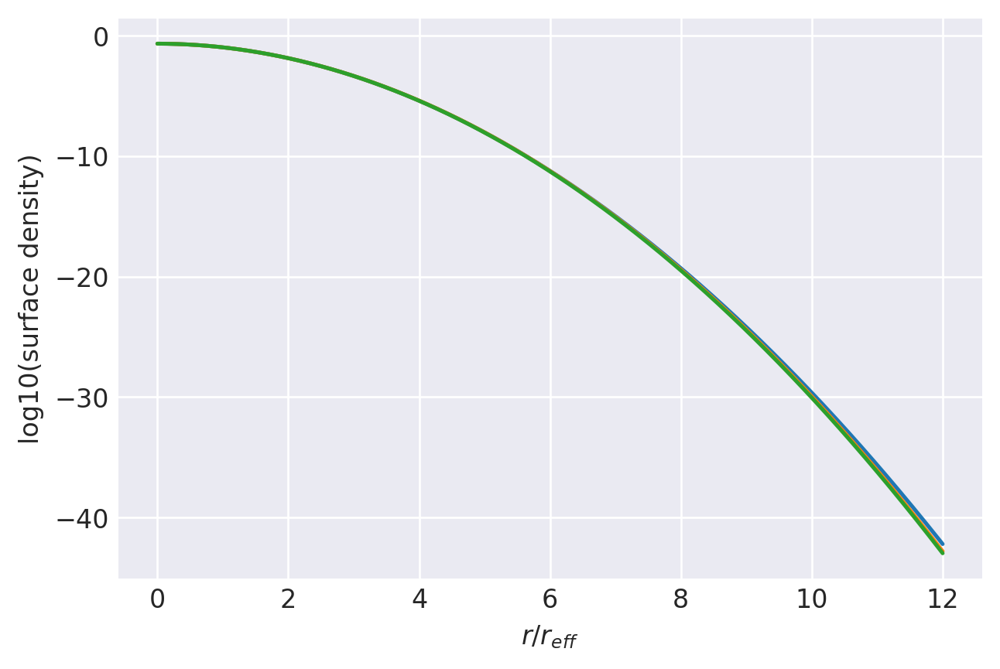

n=0.506: (
    normalize(np.array([9.2609118718e-01, 7.1122555100e-02, 2.6518153568e-03, 1.3444235955e-04])),
    np.array([1.0126677857e+00, 8.7295300140e-01, 5.4853864048e-01, 2.6815069027e-01]),
),
1.0000000145287486 1.0000000145428105
prev.  chisq = -9.950781968885398
ws, re: (array([9.26091187e-01, 7.11225551e-02, 2.65181536e-03, 1.34442360e-04]), array([1.01266779, 0.872953  , 0.54853864, 0.26815069]))
         Current function value: -13.635924
         Iterations: 47
         Function evaluations: 1398
         Gradient evaluations: 154
-13.635924352403071 [ 2.69467951  3.26082406  2.98135279  0.00458933 -0.05865343 -0.25980565
 -0.57013835]
1.0000000145287486 1.0000000145256773


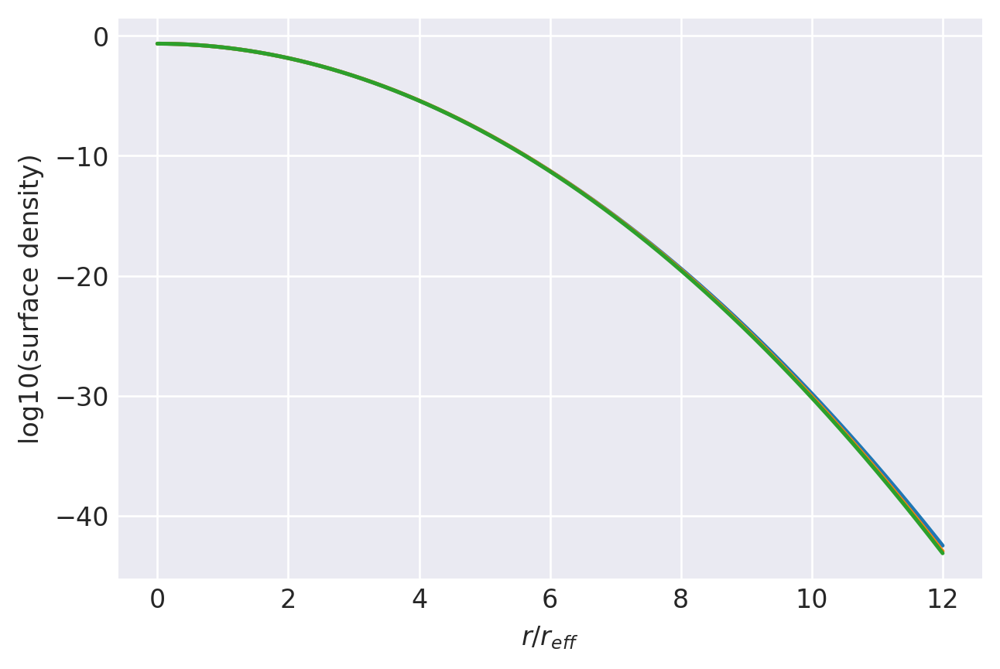

n=0.505: (
    normalize(np.array([9.3671196324e-01, 6.0950184159e-02, 2.2249917464e-03, 1.1286085541e-04])),
    np.array([1.0106233567e+00, 8.7366827422e-01, 5.4978685824e-01, 2.6906775431e-01]),
),
1.0000000145110344 1.0000000145256773
prev.  chisq = -9.949110849128044
ws, re: (array([9.36711963e-01, 6.09501842e-02, 2.22499175e-03, 1.12860855e-04]), array([1.01062336, 0.87366827, 0.54978686, 0.26906775]))
         Current function value: -13.721046
         Iterations: 27
         Function evaluations: 813
         Gradient evaluations: 89
-13.721046482094277 [ 2.69081437  3.202279    2.96224699  0.0039881  -0.04993662 -0.23513504
 -0.53776471]
1.0000000145110344 1.0000000145081276


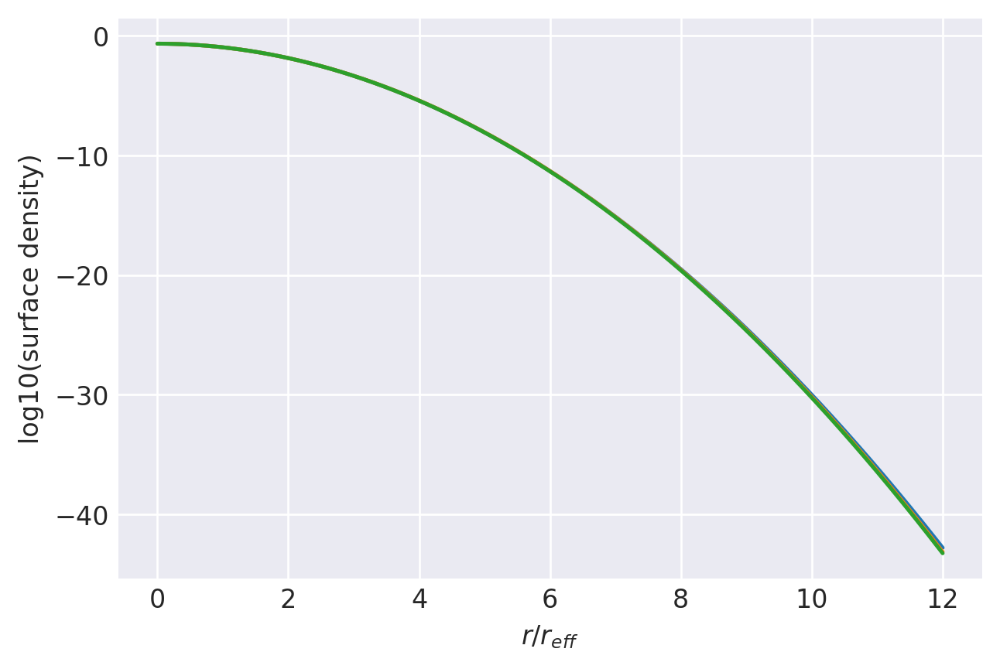

n=0.504: (
    normalize(np.array([9.3648244001e-01, 6.1035290571e-02, 2.3602388997e-03, 1.2203051458e-04])),
    np.array([1.0092252334e+00, 8.9138101078e-01, 5.8192225174e-01, 2.8989137013e-01]),
),
1.000000014493359 1.0000000145081276
prev.  chisq = -9.947259952264128
ws, re: (array([9.36482440e-01, 6.10352906e-02, 2.36023890e-03, 1.22030515e-04]), array([1.00922523, 0.89138101, 0.58192225, 0.28989137]))
         Current function value: -12.770931
         Iterations: 67
         Function evaluations: 1695
         Gradient evaluations: 187
-12.770931231080775 [ 3.69409011e+00  3.83793149e+00  1.33618113e+00  2.30348875e-03
 -8.44664025e-02 -3.81064763e-01 -3.44105003e-01]
1.000000014493359 1.000000014488939


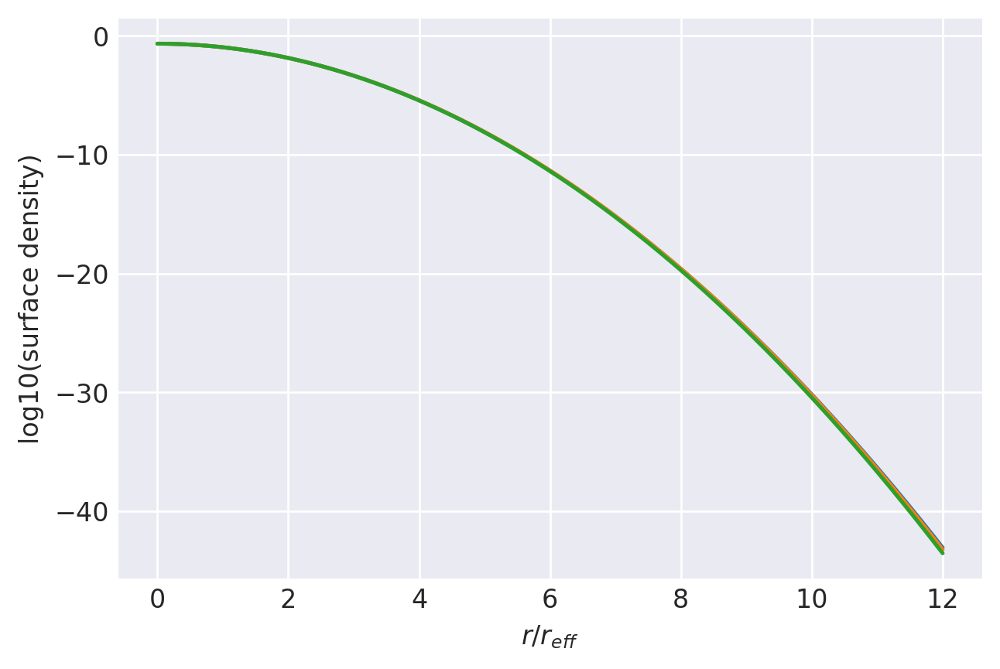

n=0.503: (
    normalize(np.array([9.7573343876e-01, 2.3754925121e-02, 1.0649131340e-04, 4.0514480740e-04])),
    np.array([1.0053180699e+00, 8.2325352217e-01, 4.5278809229e-01, 4.1584859376e-01]),
),
1.0000000144757226 1.000000014488939
prev.  chisq = -9.945833811362206
ws, re: (array([9.75733439e-01, 2.37549251e-02, 4.05144807e-04, 1.06491313e-04]), array([1.00531807, 0.82325352, 0.41584859, 0.45278809]))
         Current function value: -14.247857
         Iterations: 43
         Function evaluations: 1191
         Gradient evaluations: 131
-14.247857203539875 [ 3.82339990e+00  3.46608886e+00  3.04655098e+00  1.70424069e-03
 -6.92850843e-02 -2.92420881e-01 -6.14804928e-01]
1.0000000144757226 1.000000014474826


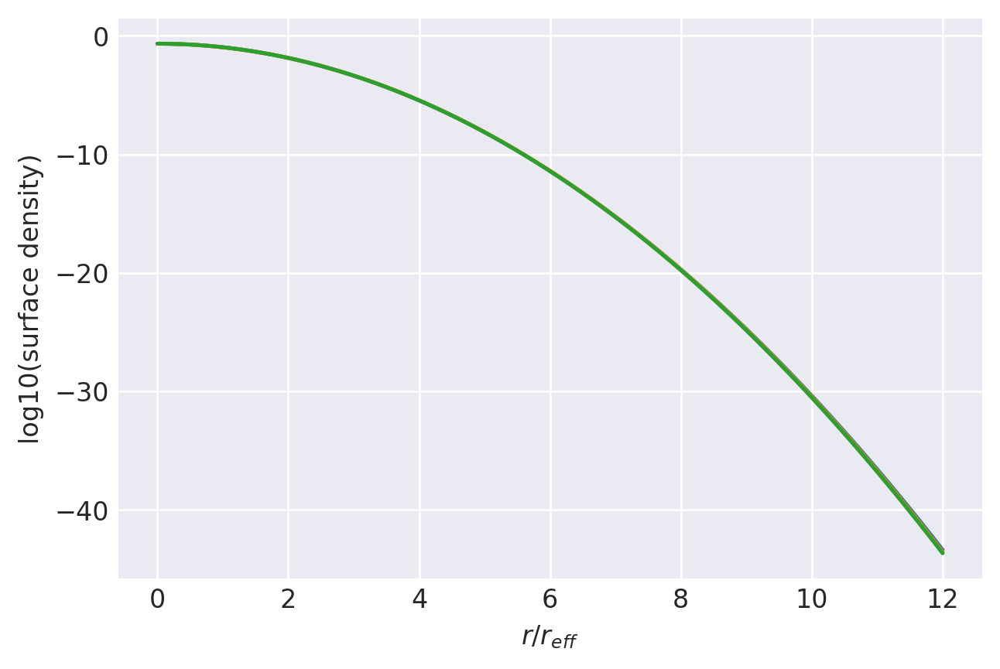

n=0.502: (
    normalize(np.array([9.7861398149e-01, 2.0738179118e-02, 6.1844911859e-04, 2.9390278222e-05])),
    np.array([1.0039318688e+00, 8.5254029654e-01, 5.1001050182e-01, 2.4277002998e-01]),
),
1.0000000144581254 1.000000014474826
prev.  chisq = -9.943913020543208
ws, re: (array([9.78613981e-01, 2.07381791e-02, 6.18449119e-04, 2.93902782e-05]), array([1.00393187, 0.8525403 , 0.5100105 , 0.24277003]))
         Current function value: -13.834656
         Iterations: 22
         Function evaluations: 1020
         Gradient evaluations: 112
-13.83465568291352 [ 3.66300268e+00  1.42424805e+00  3.51054812e+00  1.01725414e-03
 -2.14662750e-02 -1.03456904e-01 -3.90289702e-01]
1.0000000144581254 1.0000000144567767


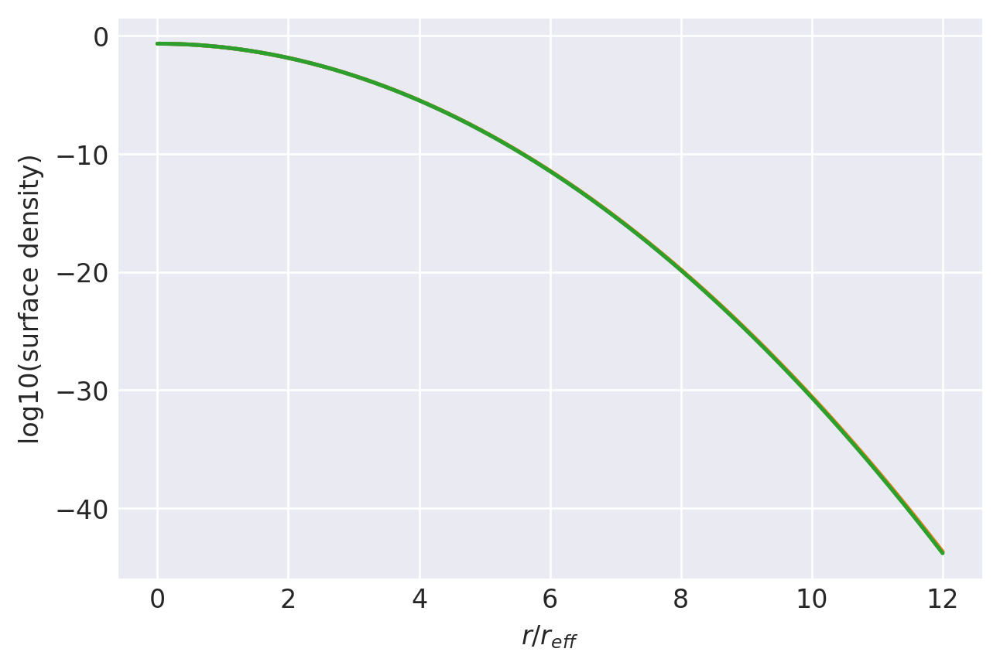

n=0.501: (
    normalize(np.array([9.7498637160e-01, 2.0161072352e-02, 4.7117659750e-03, 1.4079007288e-04])),
    np.array([1.0023450596e+00, 9.5177375488e-01, 7.8803062542e-01, 4.0710861988e-01]),
),
1.000000014440567 1.0000000144567767
prev.  chisq = -9.942575682482813
ws, re: (array([9.74986372e-01, 2.01610724e-02, 4.71176598e-03, 1.40790073e-04]), array([1.00234506, 0.95177375, 0.78803063, 0.40710862]))
         Current function value: -17.056607
         Iterations: 25
         Function evaluations: 1191
         Gradient evaluations: 131
-17.056606633384614 [ 3.67571550e+00  1.66051737e+00  4.07447015e+00  1.81365497e-05
 -5.08407650e-04 -1.72749597e-03 -5.99643331e-03]
1.000000014440567 1.000000014440567


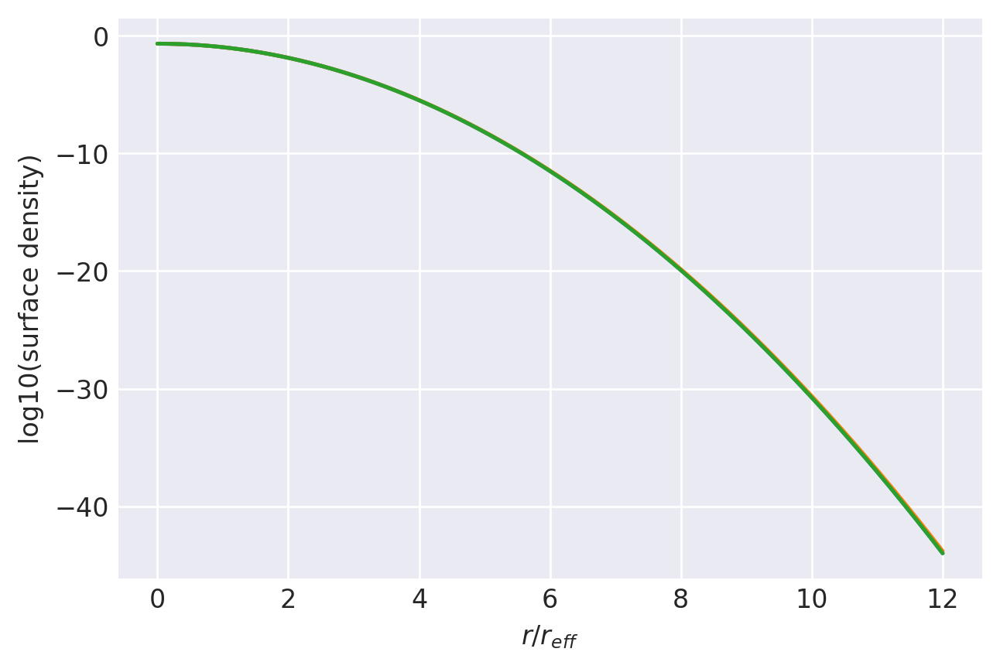

n=0.5: (
    normalize(np.array([9.7529454617e-01, 2.0760176699e-02, 3.8793238890e-03, 6.5953240275e-05])),
    np.array([1.0000417618e+00, 9.9883003307e-01, 9.9603019413e-01, 9.8628758559e-01]),
),


In [8]:
# Despite my best efforts, free weights and sizes don't work for N=4 either:
nvals = [
    (
        np.array([
            0.53, 0.525, 0.52,
        ]),
        (
    normalize(np.array([5.9919829101e-01, 3.5948801370e-01, 3.7771361281e-02, 3.3145069862e-03])),
    np.array([1.0888531764e+00, 9.2149653125e-01, 6.4439708848e-01, 3.7928399702e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
nvals = [
    (
        np.array([
            0.518, 0.516, 0.514, 0.512, 0.51,
        ]),
        (
    normalize(np.array([8.0246265385e-01, 1.8748350391e-01, 9.5608797516e-03, 4.9296249415e-04])),
    np.array([1.0407640924e+00, 8.7518613346e-01, 5.5172430276e-01, 2.6844514757e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
nvals = [
    (
        np.array([
            0.509, 0.508, 0.507, 0.506, 0.505, 0.504, 0.503, 0.502, 0.501, 0.5
        ]),
        (
            normalize(np.array([8.8519826027e-01, 1.1005198944e-01, 4.5203904184e-03, 2.2935986869e-04])),
            np.array([1.0208738812e+00, 8.7334319737e-01, 5.4919444425e-01, 2.6792742286e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])

1.000000011065797 1.0000000256336785
prev.  chisq = -7.56952619808977
ws, re: (array([0.32466848, 0.4780321 , 0.17258587, 0.02471355]), array([1.70077926, 0.97809128, 0.51487137, 0.21966932]))
Optimization terminated successfully.
         Current function value: -8.077198
         Iterations: 15
         Function evaluations: 225
         Gradient evaluations: 25
-8.077198007238293 [-0.72152067  0.91231904  1.97189707  0.22369629 -0.01094158 -0.28573695
 -0.65251265]
1.000000011065797 1.0000000249562393


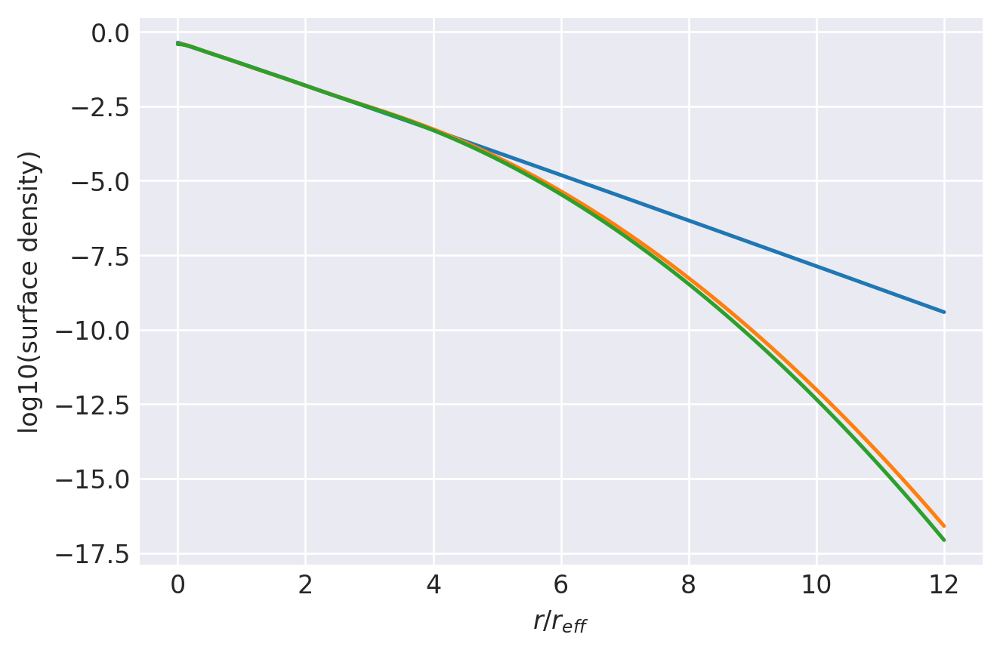

n=0.975: (
    normalize(np.array([3.2705820815e-01, 4.8012679182e-01, 1.6925584733e-01, 2.3559152698e-02])),
    np.array([1.6737719728e+00, 9.7512079513e-01, 5.1792043407e-01, 2.2258062250e-01]),
),
1.0000000199734806 1.0000000249562393
prev.  chisq = -7.577230483771114
ws, re: (array([0.32705821, 0.48012679, 0.16925585, 0.02355915]), array([1.67377197, 0.9751208 , 0.51792043, 0.22258062]))
         Current function value: -8.158426
         Iterations: 13
         Function evaluations: 614
         Gradient evaluations: 67
-8.158426052242126 [-0.70884739  0.941896    2.00195907  0.21648135 -0.01236464 -0.28319163
 -0.64678366]
1.0000000199734806 1.000000024290962


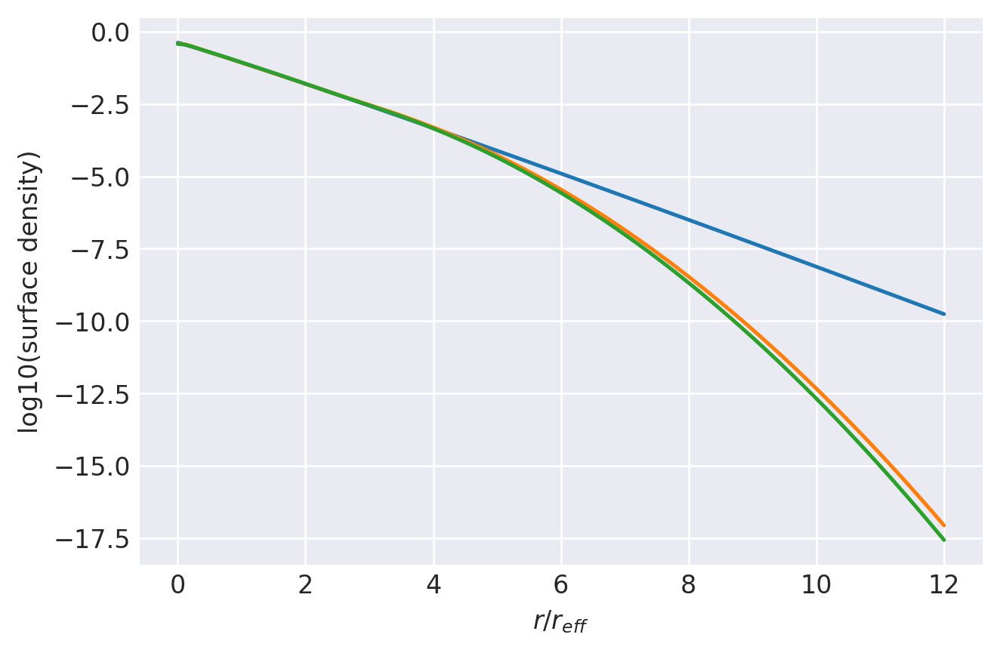

n=0.95: (
    normalize(np.array([3.2985357508e-01, 4.8215861242e-01, 1.6561775424e-01, 2.2370058269e-02])),
    np.array([1.6461952712e+00, 9.7193082380e-01, 5.2096478580e-01, 2.2553624276e-01]),
),
1.0000000233902284 1.000000024290962
prev.  chisq = -7.580823492189793
ws, re: (array([0.32985358, 0.48215861, 0.16561775, 0.02237006]), array([1.64619527, 0.97193082, 0.52096479, 0.22553624]))
         Current function value: -8.244690
         Iterations: 11
         Function evaluations: 939
         Gradient evaluations: 103
-8.24469043396828 [-0.69411267  0.97396121  2.03387883  0.20898586 -0.01389517 -0.2806669
 -0.64104637]
1.0000000233902284 1.0000000236377702


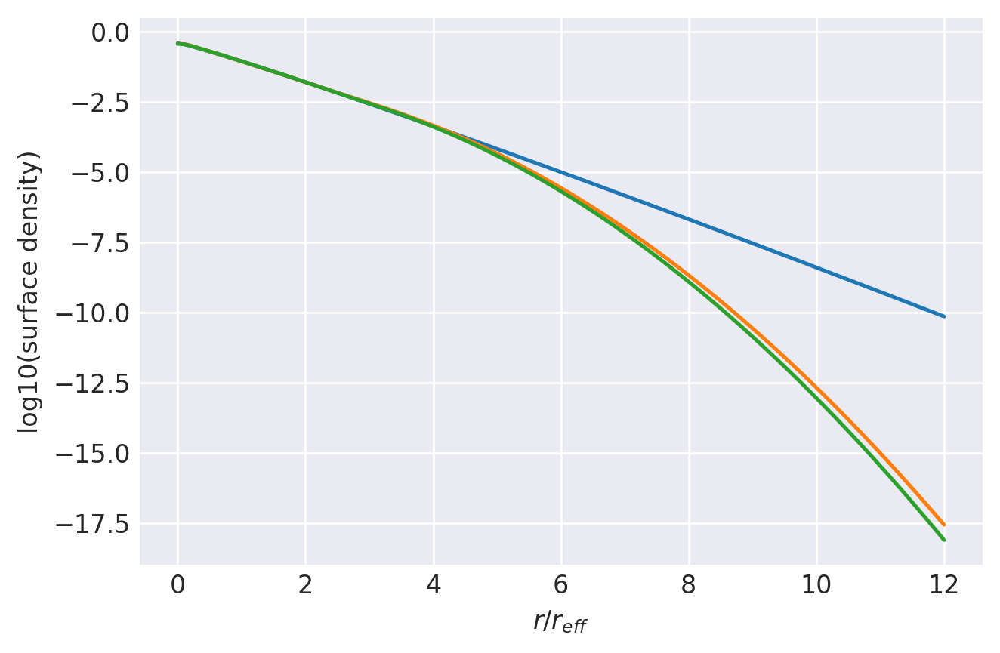

n=0.925: (
    normalize(np.array([3.3311881357e-01, 4.8409461947e-01, 1.6163971512e-01, 2.1146851843e-02])),
    np.array([1.6180273453e+00, 9.6851160006e-01, 5.2400218926e-01, 2.2853547559e-01]),
),
1.0000000242164144 1.0000000236377702
prev.  chisq = -7.580253044894256
ws, re: (array([0.33311881, 0.48409462, 0.16163972, 0.02114685]), array([1.61802735, 0.9685116 , 0.52400219, 0.22853548]))
         Current function value: -8.336561
         Iterations: 17
         Function evaluations: 667
         Gradient evaluations: 74
-8.336561152192129 [-0.67698372  1.00886015  2.06785943  0.20118994 -0.0155406  -0.27816911
 -0.63531436]
1.0000000242164144 1.0000000229967045


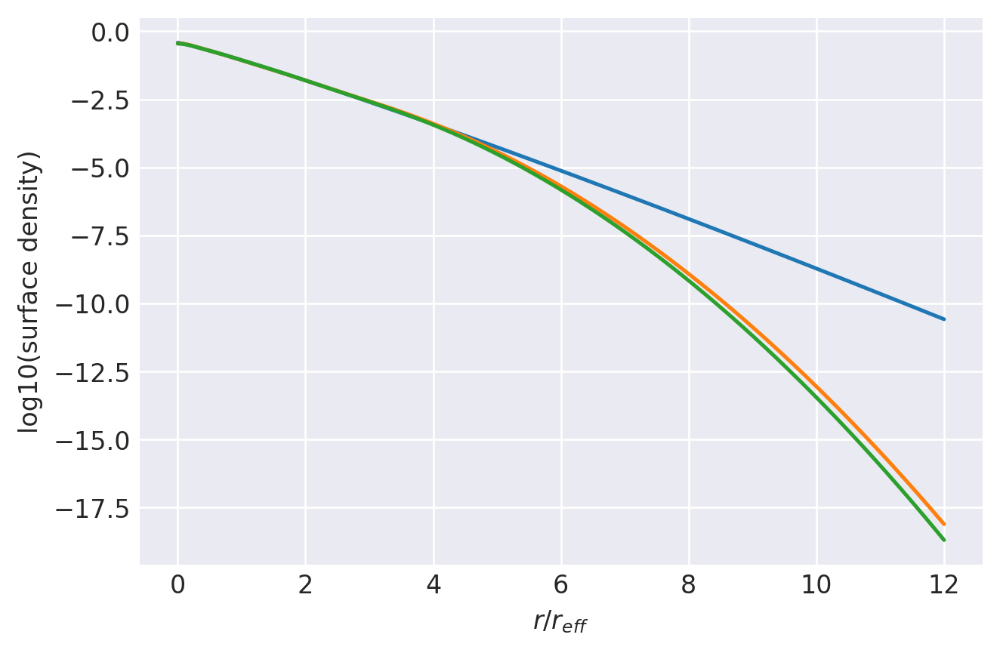

n=0.9: (
    normalize(np.array([3.3693483823e-01, 4.8589217444e-01, 1.5728351471e-01, 1.9889472624e-02])),
    np.array([1.5892416384e+00, 9.6484911931e-01, 5.2702460930e-01, 2.3157178352e-01]),
),
1.0000000239425677 1.0000000229967045
prev.  chisq = -7.575560357283357
ws, re: (array([0.33693484, 0.48589217, 0.15728351, 0.01988947]), array([1.58924164, 0.96484912, 0.52702461, 0.23157178]))
         Current function value: -8.434707
         Iterations: 15
         Function evaluations: 866
         Gradient evaluations: 95
-8.43470713864832 [-0.6570849   1.04697347  2.10407363  0.19307307 -0.01730591 -0.27569863
 -0.62958892]
1.0000000239425677 1.0000000223676782


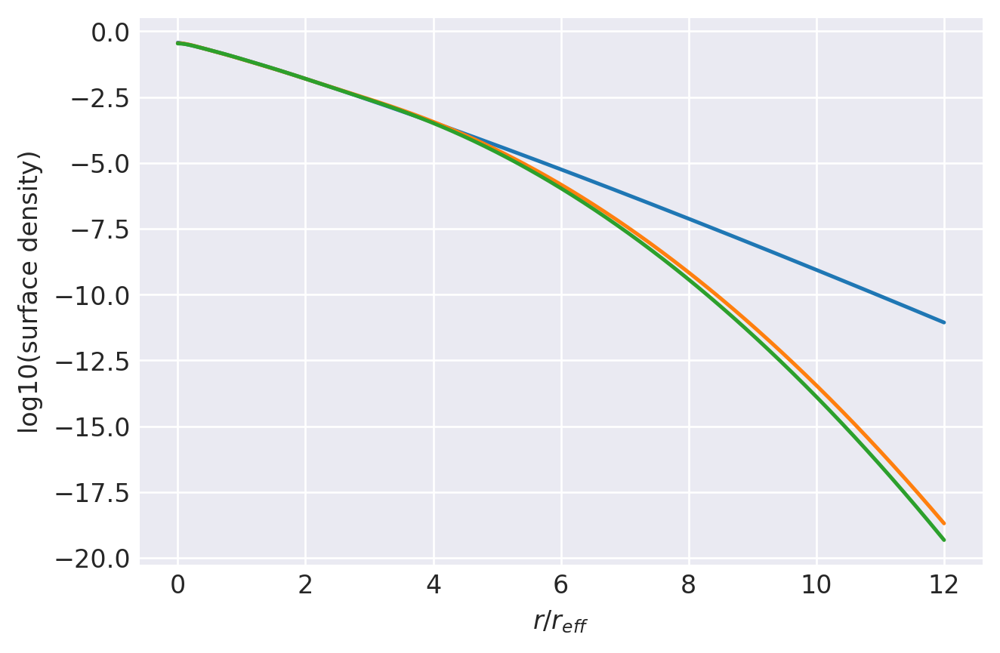

n=0.875: (
    normalize(np.array([3.4139475178e-01, 4.8749519173e-01, 1.5251013392e-01, 1.8599922570e-02])),
    np.array([1.5598149092e+00, 9.6093516491e-01, 5.3003111821e-01, 2.3464487823e-01]),
),
1.0000000232649449 1.0000000223676782
prev.  chisq = -7.566896583249418
ws, re: (array([0.34139475, 0.48749519, 0.15251013, 0.01859992]), array([1.55981491, 0.96093516, 0.53003112, 0.23464488]))
         Current function value: -8.539921
         Iterations: 15
         Function evaluations: 280
         Gradient evaluations: 31
-8.539920768878831 [-0.63393289  1.08878675  2.14274894  0.18461091 -0.0191991  -0.27326176
 -0.62388252]
1.0000000232649449 1.0000000217507046


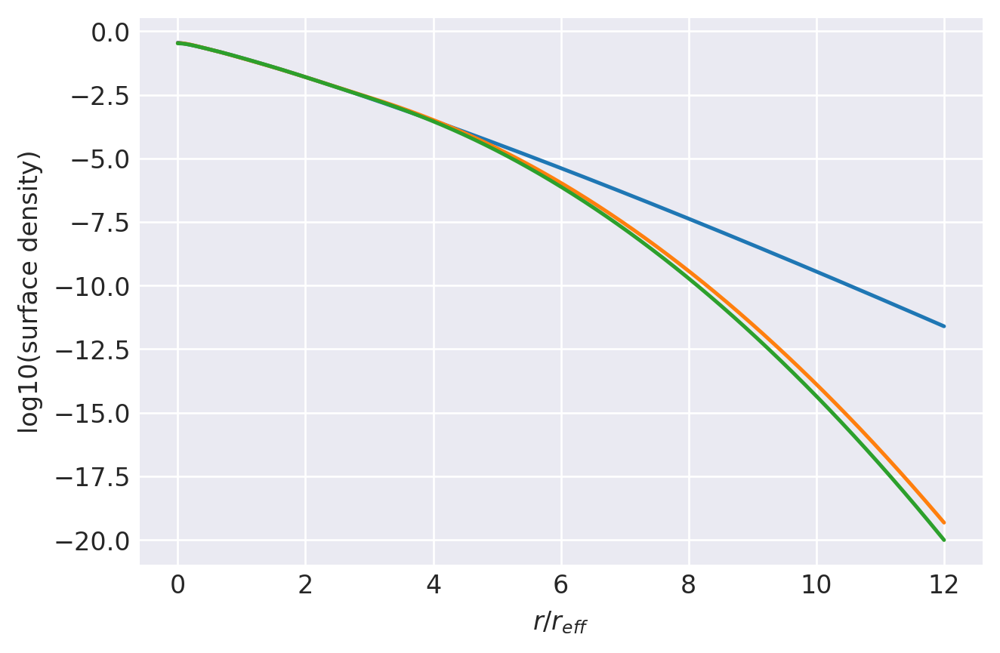

n=0.85: (
    normalize(np.array([3.4661930227e-01, 4.8882885283e-01, 1.4727213167e-01, 1.7279713237e-02])),
    np.array([1.5297163559e+00, 9.5675535334e-01, 5.3301353941e-01, 2.3774833319e-01]),
),
1.000000022474237 1.0000000217507046
prev.  chisq = -7.554483868556167
ws, re: (array([0.3466193 , 0.48882885, 0.14727213, 0.01727971]), array([1.52971636, 0.95675535, 0.53301354, 0.23774833]))
         Current function value: -8.653151
         Iterations: 13
         Function evaluations: 893
         Gradient evaluations: 98
-8.65315068549441 [-0.60694505  1.13487559  2.18413428  0.17577686 -0.02122694 -0.27086363
 -0.61820768]
1.000000022474237 1.0000000211457996


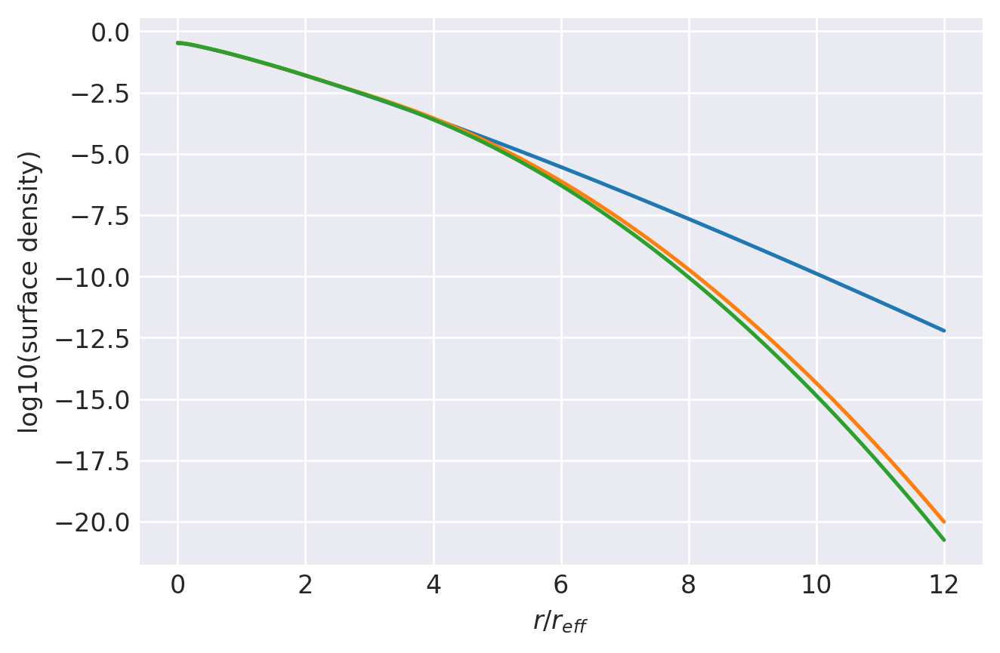

n=0.825: (
    normalize(np.array([3.5275638884e-01, 4.8979354452e-01, 1.4151859016e-01, 1.5931476486e-02])),
    np.array([1.4989145047e+00, 9.5229840735e-01, 5.3596493005e-01, 2.4087532891e-01]),
),
1.0000000216764655 1.0000000211457996
prev.  chisq = -7.538593950969053
ws, re: (array([0.35275639, 0.48979354, 0.14151859, 0.01593148]), array([1.4989145 , 0.95229841, 0.53596493, 0.24087533]))
         Current function value: -8.775547
         Iterations: 16
         Function evaluations: 767
         Gradient evaluations: 84
-8.775546650235349 [-0.57539018  1.18596386  2.22851109  0.1665407  -0.02339726 -0.26851262
 -0.61258327]
1.0000000216764655 1.0000000205530228


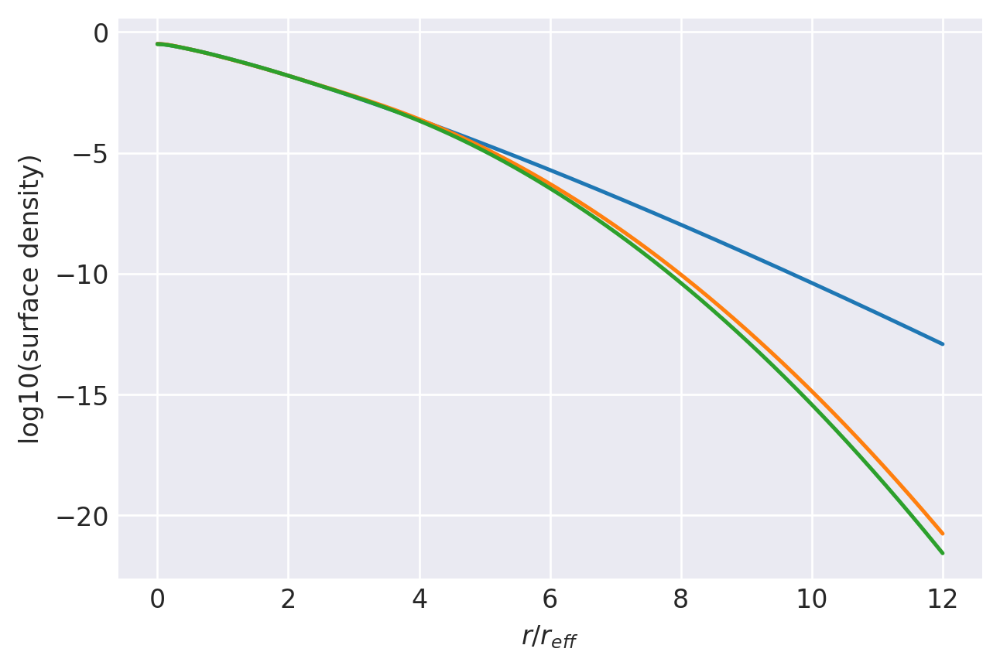

n=0.8: (
    normalize(np.array([3.5999400190e-01, 4.9025638794e-01, 1.3519106673e-01, 1.4558543438e-02])),
    np.array([1.4673735837e+00, 9.4755130911e-01, 5.3887419185e-01, 2.4401511404e-01]),
),
1.0000000209041424 1.0000000205530228
prev.  chisq = -7.519539514930755
ws, re: (array([0.359994  , 0.49025639, 0.13519107, 0.01455854]), array([1.46737358, 0.94755131, 0.53887419, 0.24401511]))
         Current function value: -8.908522
         Iterations: 16
         Function evaluations: 649
         Gradient evaluations: 71
-8.908522327379139 [-0.53830852  1.24294686  2.27618166  0.15686658 -0.02571978 -0.2662196
 -0.60702851]
1.0000000209041424 1.0000000199723913


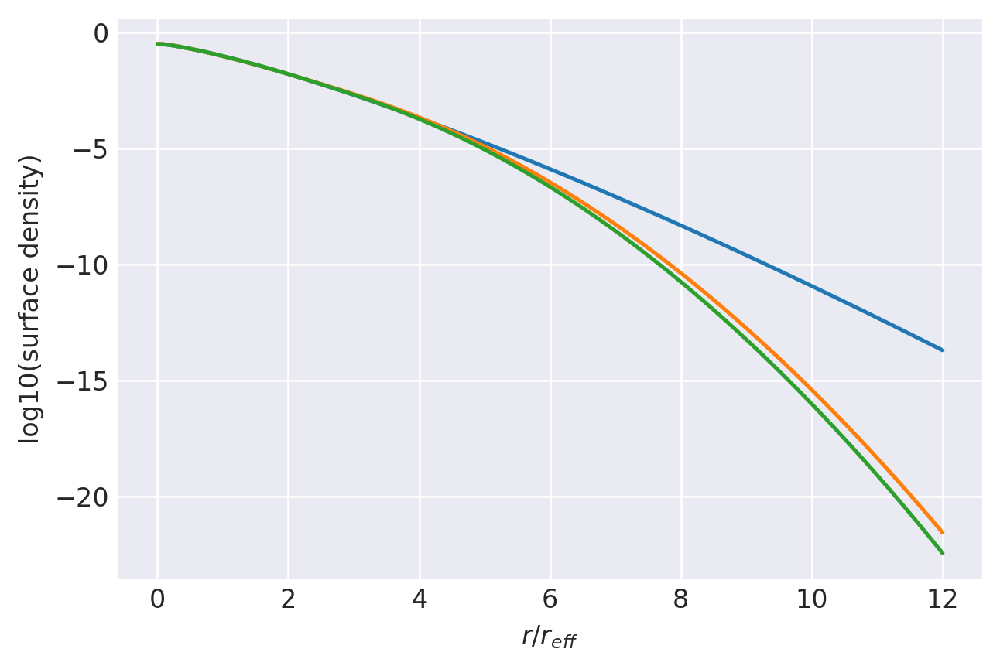

n=0.775: (
    normalize(np.array([3.6858115238e-01, 4.9002935491e-01, 1.2822402555e-01, 1.3165467156e-02])),
    np.array([1.4350485124e+00, 9.4249753902e-01, 5.4172689777e-01, 2.4715619082e-01]),
),
1.0000000201648103 1.0000000199723913
prev.  chisq = -7.497618524142937
ws, re: (array([0.36858115, 0.49002935, 0.12822403, 0.01316547]), array([1.43504851, 0.94249754, 0.5417269 , 0.24715619]))
         Current function value: -9.053846
         Iterations: 20
         Function evaluations: 893
         Gradient evaluations: 98
-9.05384566806524 [-0.49450813  1.30696218  2.32747325  0.14671558 -0.02820137 -0.26399666
 -0.60157255]
1.0000000201648103 1.000000019404032


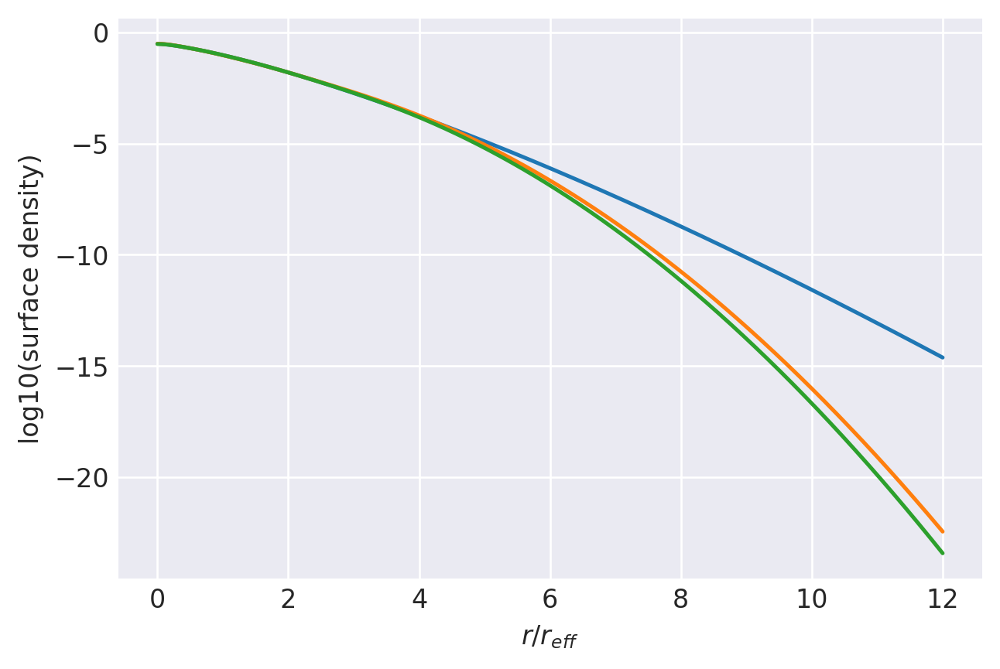

n=0.75: (
    normalize(np.array([3.7883214393e-01, 4.8886181980e-01, 1.2054759480e-01, 1.1758441469e-02])),
    np.array([1.4018952939e+00, 9.3712739357e-01, 5.4450683796e-01, 2.5028075100e-01]),
),
1.0000000194590108 1.000000019404032
prev.  chisq = -7.473145733786876
ws, re: (array([0.37883214, 0.48886182, 0.12054759, 0.01175844]), array([1.40189529, 0.93712739, 0.54450684, 0.25028075]))
         Current function value: -9.213773
         Iterations: 22
         Function evaluations: 1038
         Gradient evaluations: 114
-9.213773403662652 [-0.44237755  1.37948884  2.38273376  0.13604131 -0.03085086 -0.26186307
 -0.59625062]
1.0000000194590108 1.000000018848041


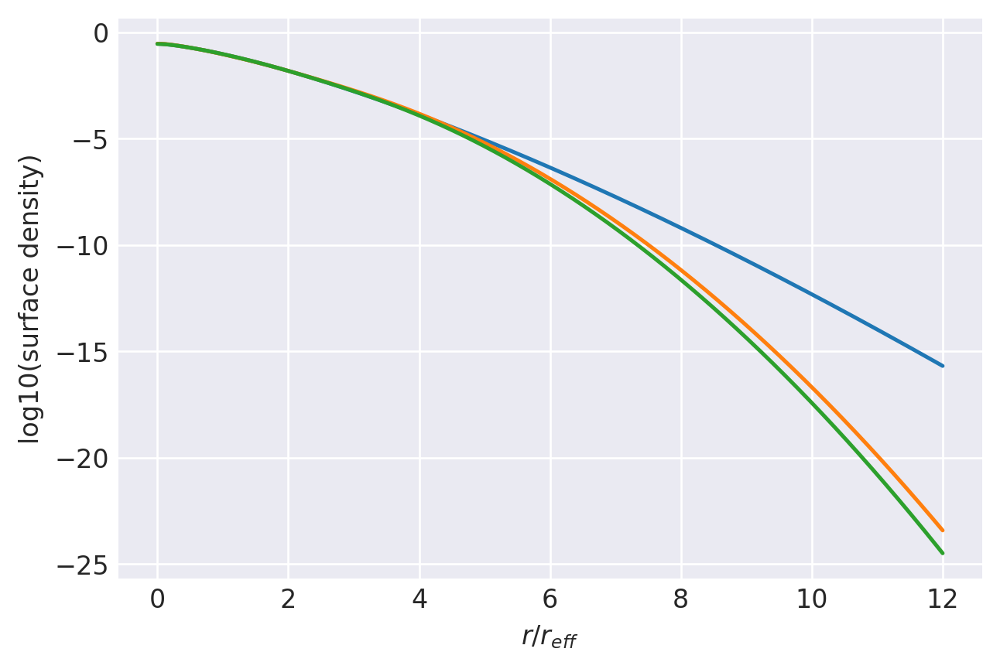

n=0.725: (
    normalize(np.array([3.9117459271e-01, 4.8639603270e-01, 1.1208423379e-01, 1.0345140795e-02])),
    np.array([1.3678589145e+00, 9.3142767823e-01, 5.4718845799e-01, 2.5336660763e-01]),
),
1.0000000187857572 1.000000018848041
prev.  chisq = -7.446378028726412
ws, re: (array([0.39117459, 0.48639603, 0.11208423, 0.01034514]), array([1.36785891, 0.93142768, 0.54718846, 0.25336661]))
         Current function value: -9.391259
         Iterations: 24
         Function evaluations: 1029
         Gradient evaluations: 113
-9.39125937373701 [-0.37972754  1.4624711   2.44231901  0.12478886 -0.03367595 -0.25984489
 -0.59111141]
1.0000000187857572 1.0000000183045734


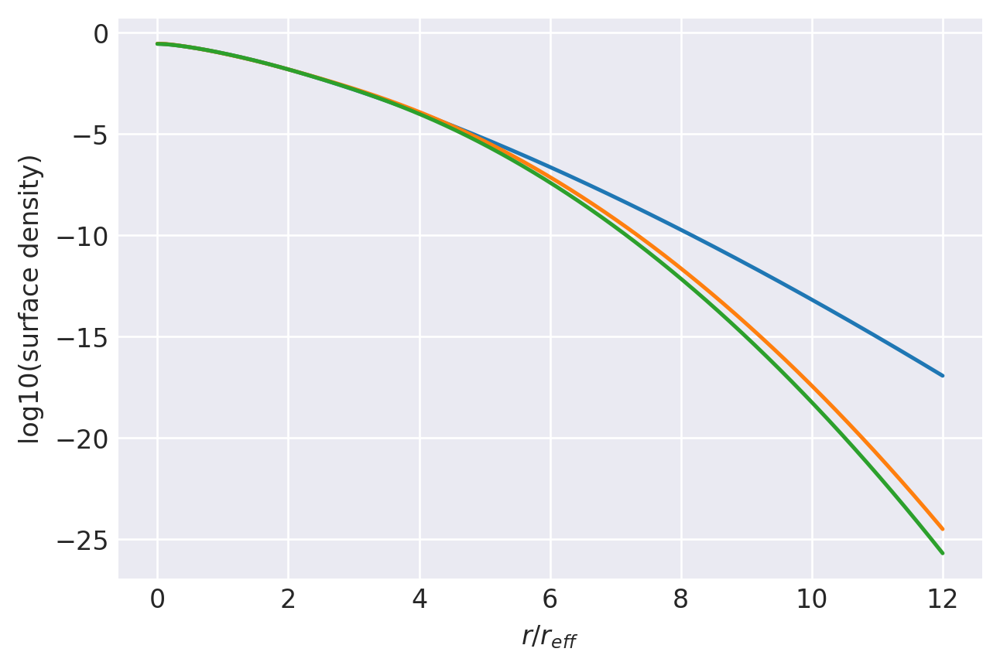

n=0.7: (
    normalize(np.array([4.0619261279e-01, 4.8211835269e-01, 1.0275368140e-01, 8.9353531141e-03])),
    np.array([1.3328732728e+00, 9.2538839592e-01, 5.4973718519e-01, 2.5638262685e-01]),
),
1.000000018143855 1.0000000183045734
prev.  chisq = -7.41754636570788
ws, re: (array([0.40619261, 0.48211835, 0.10275368, 0.00893535]), array([1.33287327, 0.9253884 , 0.54973719, 0.25638263]))
         Current function value: -9.590293
         Iterations: 25
         Function evaluations: 794
         Gradient evaluations: 87
-9.59029349398381 [-0.30356096  1.55850536  2.50653821  0.11289601 -0.03667722 -0.25797259
 -0.58620887]
1.000000018143855 1.0000000177737878


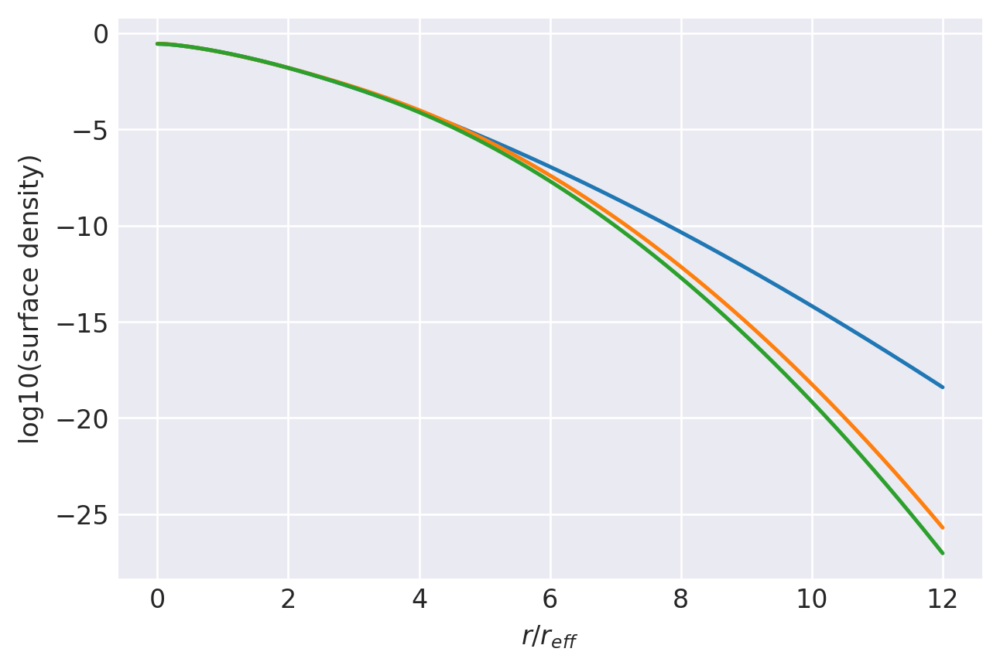

n=0.675: (
    normalize(np.array([4.2468720925e-01, 4.7528820509e-01, 9.2482622270e-02, 7.5419633935e-03])),
    np.array([1.2968687054e+00, 9.1901538645e-01, 5.5211228246e-01, 2.5929320267e-01]),
),
1.000000017532151 1.0000000177737878
prev.  chisq = -7.386825411528941
ws, re: (array([0.42468721, 0.47528821, 0.09248262, 0.00754196]), array([1.29686871, 0.91901539, 0.55211228, 0.2592932 ]))
         Current function value: -9.816487
         Iterations: 32
         Function evaluations: 984
         Gradient evaluations: 108
-9.816487397345021 [-0.20911984  1.67138747  2.57560852  0.10027426 -0.03987404 -0.25632604
 -0.58166273]
1.000000017532151 1.000000017256003


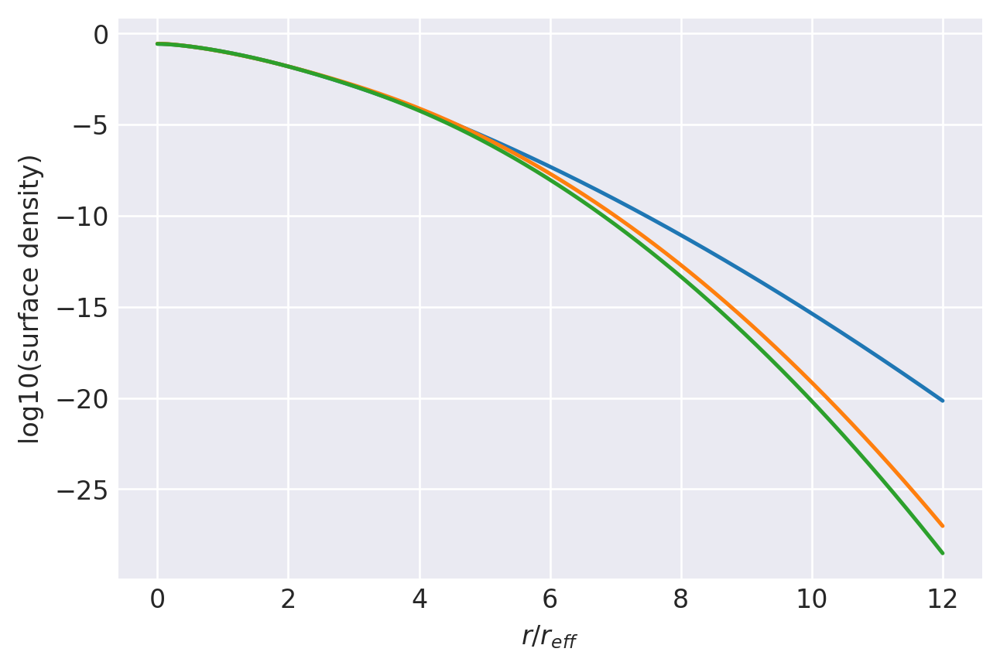

n=0.65: (
    normalize(np.array([4.4790973196e-01, 4.6472790091e-01, 8.1183680488e-02, 6.1786866405e-03])),
    np.array([1.2597206861e+00, 9.1227538845e-01, 5.5420949557e-01, 2.6202170433e-01]),
),
1.0000000169495604 1.000000017256003
prev.  chisq = -7.354348088579527
ws, re: (array([0.44790973, 0.4647279 , 0.08118368, 0.00617869]), array([1.25972069, 0.91227539, 0.5542095 , 0.2620217 ]))
         Current function value: -10.078172
         Iterations: 35
         Function evaluations: 956
         Gradient evaluations: 105
-10.078171891386534 [-0.08971269  1.80633374  2.64964666  0.08683618 -0.04324132 -0.25497429
 -0.57759526]
1.0000000169495604 1.0000000167514635


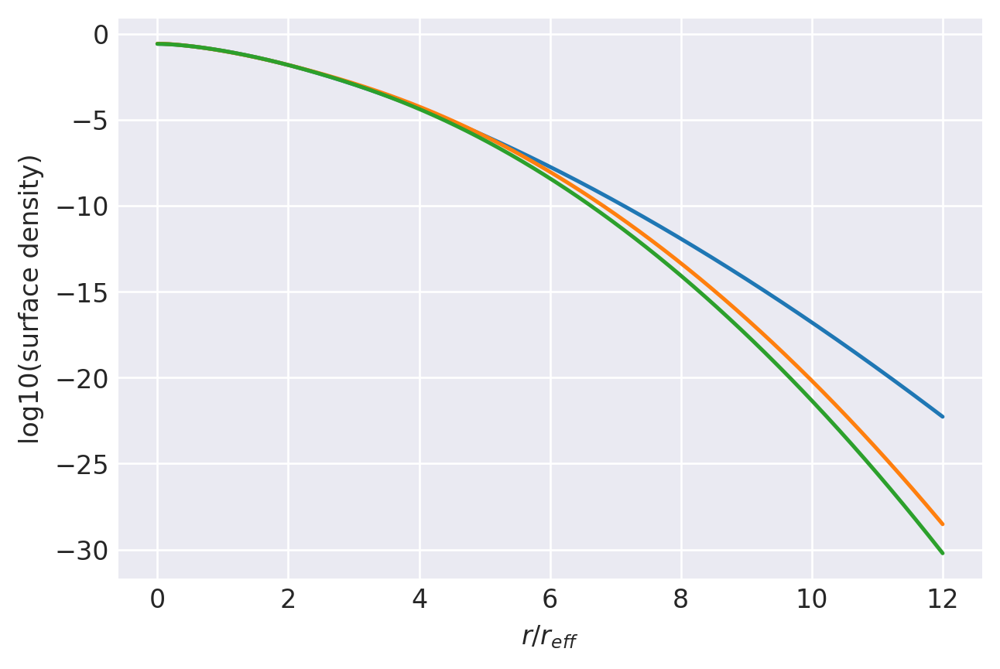

n=0.625: (
    normalize(np.array([4.7758685902e-01, 4.4871014896e-01, 6.8837799255e-02, 4.8651927687e-03])),
    np.array([1.2213388674e+00, 9.0522947018e-01, 5.5593716167e-01, 2.6448724702e-01]),
),
1.000000016395073 1.0000000167514635
prev.  chisq = -7.320174484354153
ws, re: (array([0.47758686, 0.44871015, 0.0688378 , 0.00486519]), array([1.22133887, 0.90522947, 0.55593716, 0.26448725]))
         Current function value: -10.388675
         Iterations: 38
         Function evaluations: 1083
         Gradient evaluations: 119
-10.388674928639118 [ 0.0667696   1.97119568  2.72734927  0.07244167 -0.04677605 -0.25404774
 -0.57407156]
1.000000016395073 1.0000000162603524


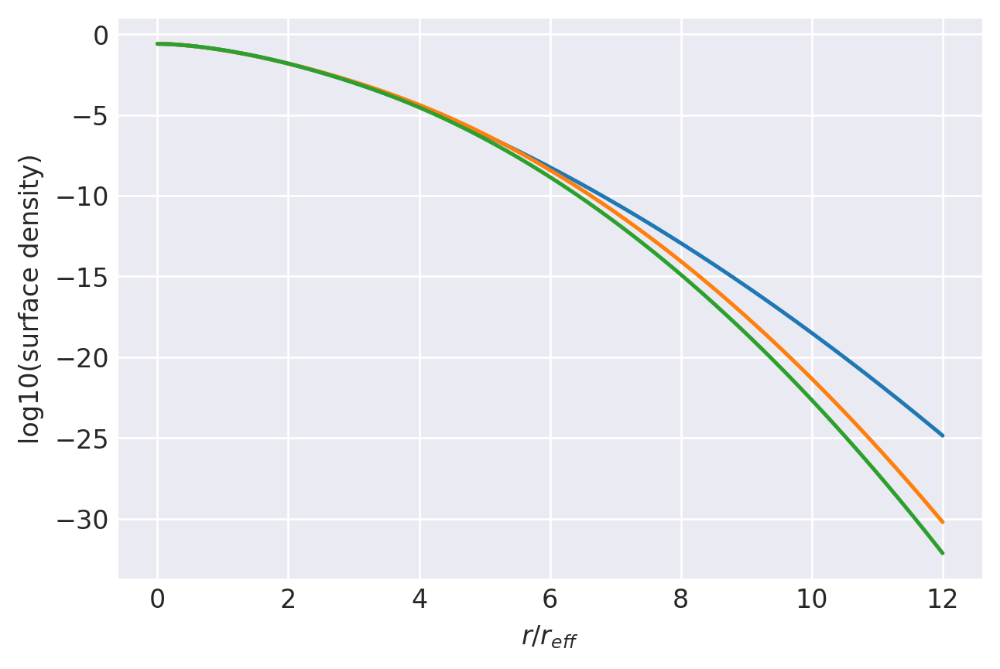

n=0.6: (
    normalize(np.array([5.1668620161e-01, 4.2422360341e-01, 5.5463315784e-02, 3.6268791954e-03])),
    np.array([1.1815216222e+00, 8.9789169364e-01, 5.5712450495e-01, 2.6664192455e-01]),
),
0.6 [1.18152162 0.89789169 0.5571245  0.26664192]
0.55 [1.09076081 0.88294585 0.55656225 0.26932096]
0.5 [1.    0.868 0.556 0.272]
1.000000016180935 1.00000001647738
prev.  chisq = -7.506764435524934
ws, re: (array([0.5166862 , 0.4242236 , 0.05546332, 0.00362688]), array([1.16336946, 0.89490252, 0.55701205, 0.26717773]))
Optimization terminated successfully.
         Current function value: -10.408457
         Iterations: 11
         Function evaluations: 125
         Gradient evaluations: 25
-10.408456708462694 [0.15845908 2.029124   2.79352154]
1.000000016180935 1.0000000160653781


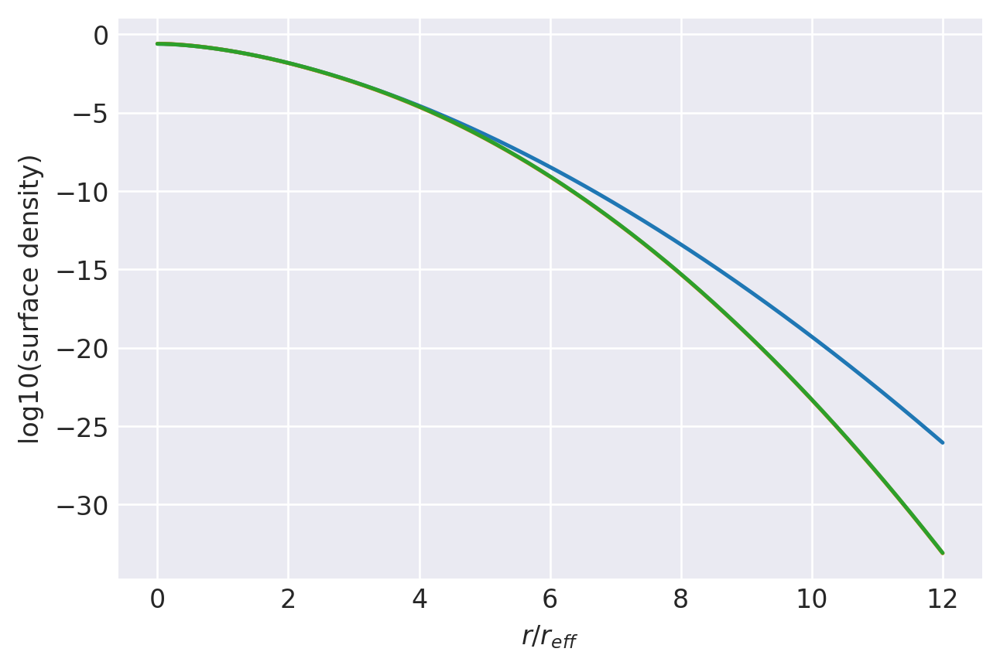

n=0.59: (
    normalize(np.array([5.3953208499e-01, 4.0697128630e-01, 5.0411196453e-02, 3.0854322571e-03])),
    np.array([1.1633694600e+00, 8.9490252428e-01, 5.5701205446e-01, 2.6717773209e-01]),
),
1.0000000159710858 1.0000000162970348
prev.  chisq = -7.456046884298334
ws, re: (array([0.53953208, 0.40697129, 0.0504112 , 0.00308543]), array([1.1452173 , 0.89191335, 0.5568996 , 0.26771354]))
Optimization terminated successfully.
         Current function value: -10.276589
         Iterations: 9
         Function evaluations: 120
         Gradient evaluations: 24
-10.276589402916564 [0.26260081 2.09083684 2.86545524]
1.0000000159710858 1.0000000158729627


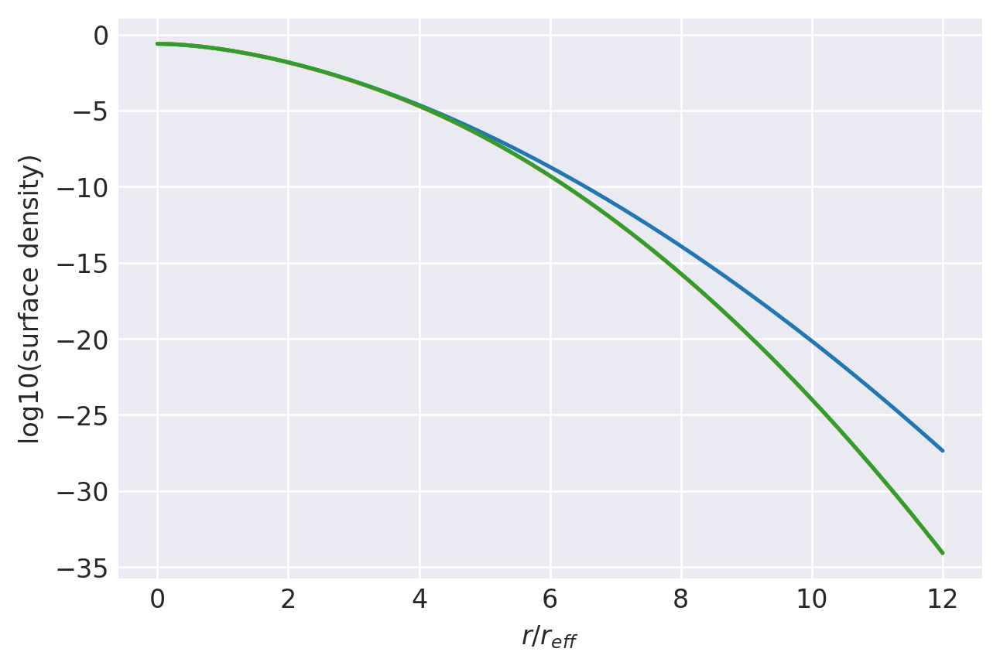

n=0.58: (
    normalize(np.array([5.6527551984e-01, 3.8690886198e-01, 4.5238935286e-02, 2.5766828937e-03])),
    np.array([1.1452172978e+00, 8.9191335491e-01, 5.5689960396e-01, 2.6771353964e-01]),
),
1.0000000157654723 1.0000000161211537
prev.  chisq = -7.402343960514983
ws, re: (array([0.56527552, 0.38690886, 0.04523894, 0.00257668]), array([1.12706514, 0.88892419, 0.55678715, 0.26824935]))
Optimization terminated successfully.
         Current function value: -10.135487
         Iterations: 11
         Function evaluations: 130
         Gradient evaluations: 26
-10.135486773822874 [0.38254952 2.1568006  2.94417663]
1.0000000157654723 1.0000000156832178


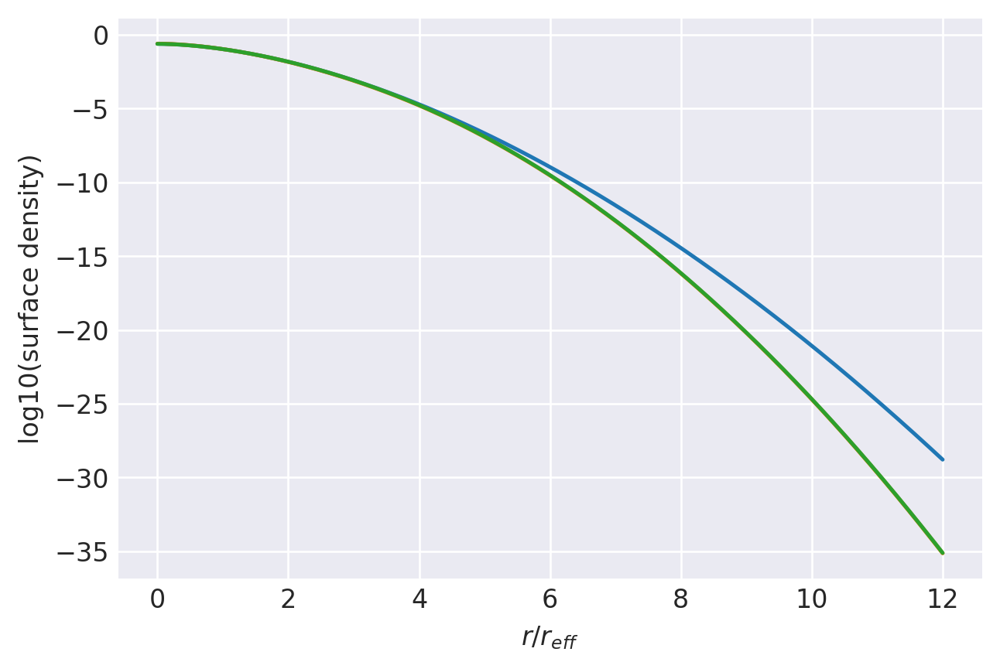

n=0.57: (
    normalize(np.array([5.9448786957e-01, 3.6346156025e-01, 3.9947517585e-02, 2.1030525873e-03])),
    np.array([1.1270651355e+00, 8.8892418555e-01, 5.5678715347e-01, 2.6824934719e-01]),
),
1.0000000155640396 1.0000000159502507
prev.  chisq = -7.345458104236319
ws, re: (array([0.59448787, 0.36346156, 0.03994752, 0.00210305]), array([1.10891297, 0.88593502, 0.5566747 , 0.26878515]))
Optimization terminated successfully.
         Current function value: -10.038220
         Iterations: 13
         Function evaluations: 165
         Gradient evaluations: 33
-10.038220287678538 [0.52320322 2.22757584 3.03101688]
1.0000000155640396 1.0000000154962667


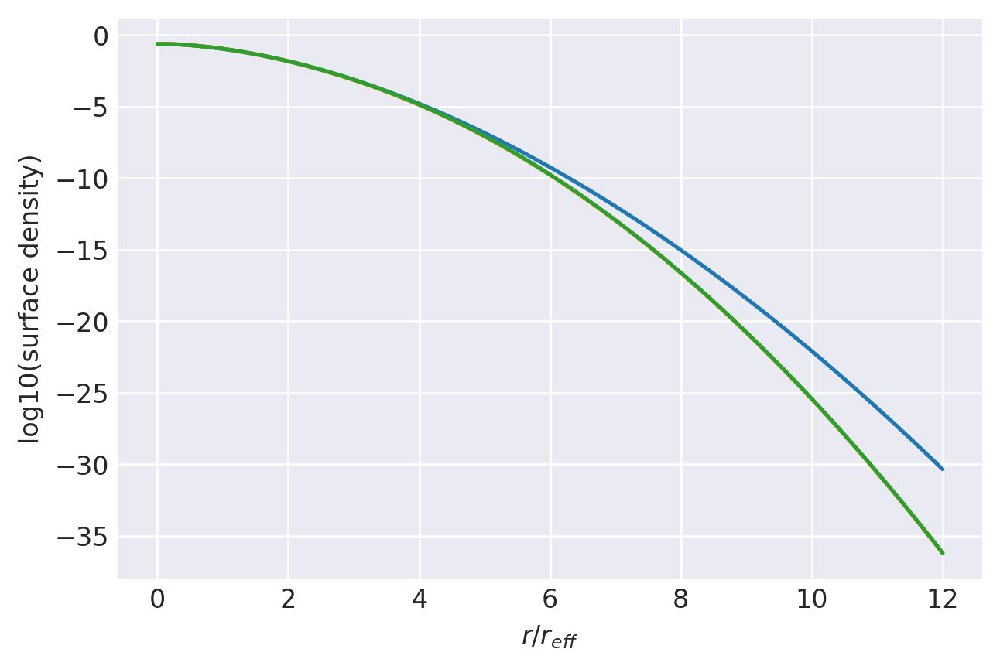

n=0.56: (
    normalize(np.array([6.2789648133e-01, 3.3589734166e-01, 3.4539094688e-02, 1.6670823192e-03])),
    np.array([1.1089129733e+00, 8.8593501618e-01, 5.5667470297e-01, 2.6878515473e-01]),
),
1.000000015366738 1.0000000157849676
prev.  chisq = -7.285034090765773
ws, re: (array([0.62789648, 0.33589734, 0.03453909, 0.00166708]), array([1.09076081, 0.88294585, 0.55656225, 0.26932096]))
Optimization terminated successfully.
         Current function value: -9.995211
         Iterations: 10
         Function evaluations: 115
         Gradient evaluations: 23
-9.995211325676152 [0.69214471 2.303838   3.12774462]
1.000000015366738 1.0000000153122373


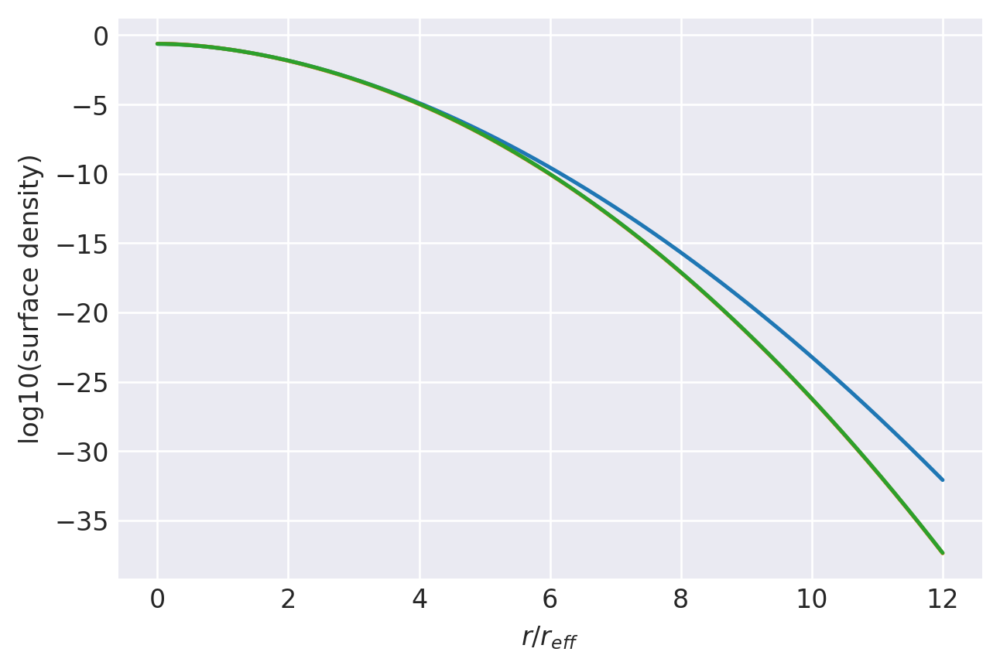

n=0.55: (
    normalize(np.array([6.6644385745e-01, 3.0326737752e-01, 2.9017327056e-02, 1.2714379704e-03])),
    np.array([1.0907608111e+00, 8.8294584682e-01, 5.5656225248e-01, 2.6932096228e-01]),
),
1.0000000152696222 1.000000015467386
prev.  chisq = -7.8280794721730285
ws, re: (array([0.66644386, 0.30326738, 0.02901733, 0.00127144]), array([1.08168473, 0.88145126, 0.55650603, 0.26958887]))
Optimization terminated successfully.
         Current function value: -9.995680
         Iterations: 12
         Function evaluations: 110
         Gradient evaluations: 22
-9.99567991326431 [0.79087008 2.34427711 3.18053915]
1.0000000152696222 1.0000000152213582


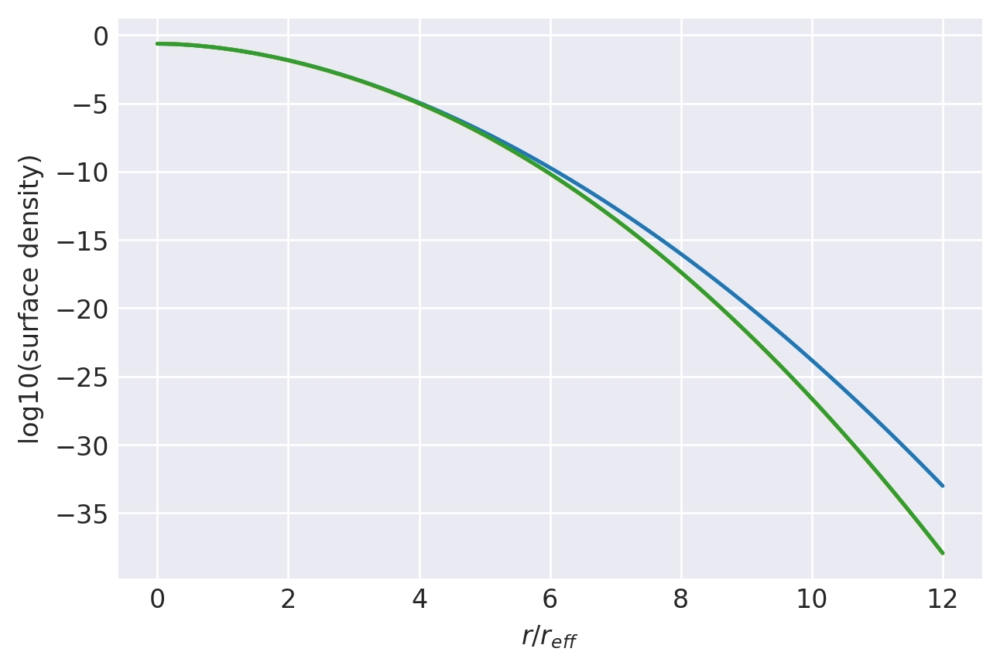

n=0.545: (
    normalize(np.array([6.8801812381e-01, 2.8467668137e-01, 2.6215589953e-02, 1.0896048655e-03])),
    np.array([1.0816847300e+00, 8.8145126214e-01, 5.5650602723e-01, 2.6958886605e-01]),
),
1.00000001517352 1.0000000153834767
prev.  chisq = -7.7944182765523315
ws, re: (array([0.68801812, 0.28467668, 0.02621559, 0.0010896 ]), array([1.07260865, 0.87995668, 0.5564498 , 0.26985677]))
         Current function value: -10.012424
         Iterations: 9
         Function evaluations: 283
         Gradient evaluations: 55
-10.012424265552902 [0.90206114 2.38641079 3.23678123]
1.00000001517352 1.0000000151312591


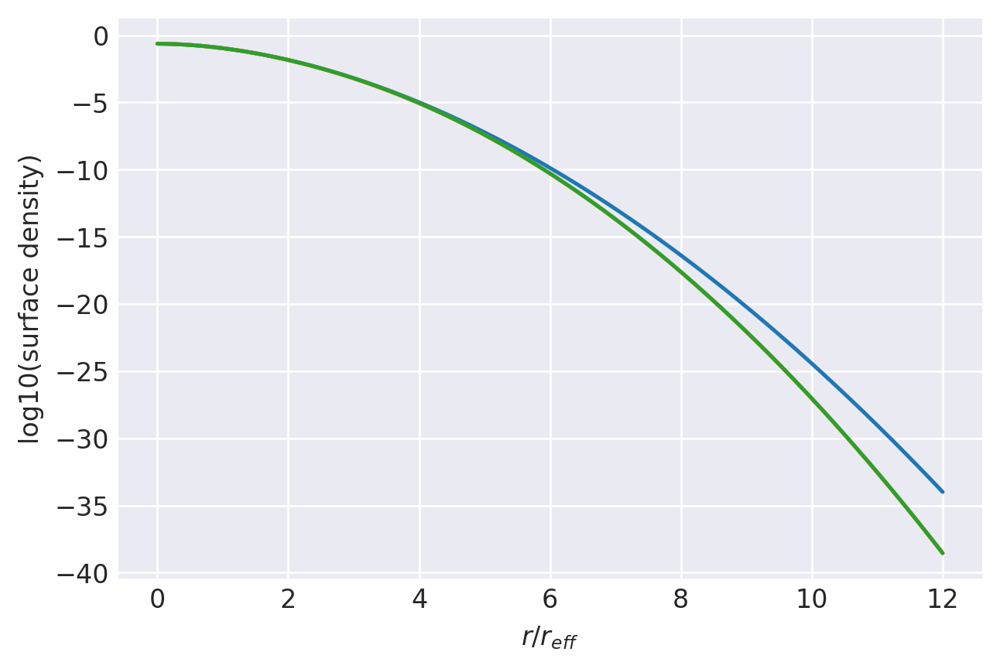

n=0.54: (
    normalize(np.array([7.1137288409e-01, 2.6432043281e-01, 2.3387773784e-02, 9.1890931808e-04])),
    np.array([1.0726086489e+00, 8.7995667746e-01, 5.5644980198e-01, 2.6985676982e-01]),
),
1.0000000150784267 1.0000000153009532
prev.  chisq = -7.759553205534321
ws, re: (array([0.71137288, 0.26432043, 0.02338777, 0.00091891]), array([1.06353257, 0.87846209, 0.55639358, 0.27012467]))
         Current function value: -10.047700
         Iterations: 11
         Function evaluations: 497
         Gradient evaluations: 97
-10.047699825403813 [1.02904911 2.43037285 3.29693386]
1.0000000150784267 1.000000015041956


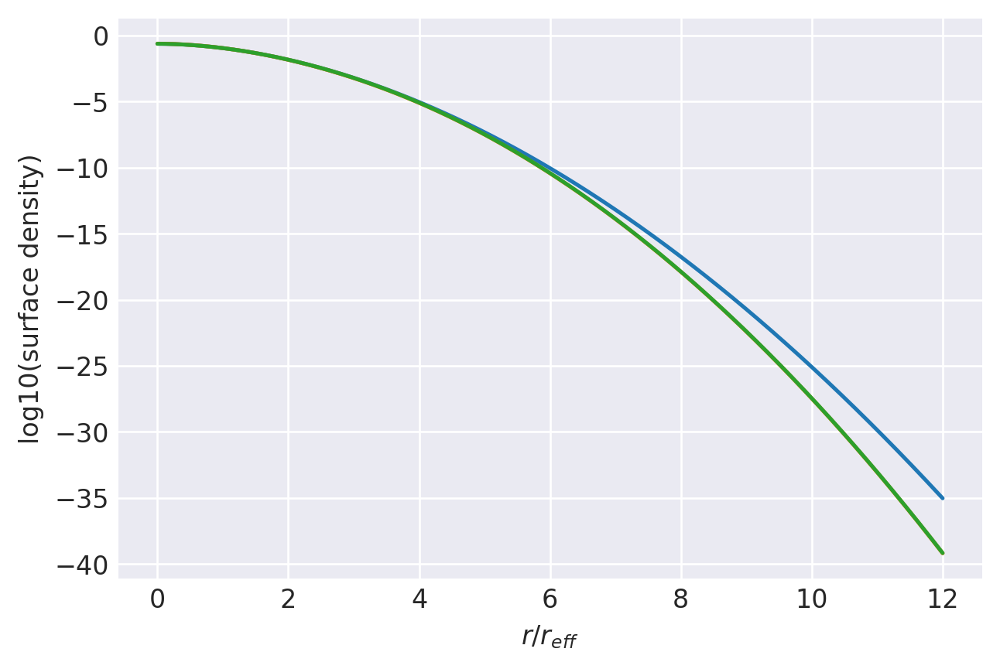

n=0.535: (
    normalize(np.array([7.3673150348e-01, 2.4197382835e-01, 2.0534948388e-02, 7.5971977755e-04])),
    np.array([1.0635325678e+00, 8.7846209277e-01, 5.5639357673e-01, 2.7012467359e-01]),
),
1.000000014984337 1.0000000152199124
prev.  chisq = -7.723358091364127
ws, re: (array([0.7367315 , 0.24197383, 0.02053495, 0.00075972]), array([1.05445649, 0.87696751, 0.55633735, 0.27039258]))
Optimization terminated successfully.
         Current function value: -10.105181
         Iterations: 8
         Function evaluations: 95
         Gradient evaluations: 19
-10.105180624888822 [1.17671067 2.47631346 3.36155897]
1.000000014984337 1.0000000149534662


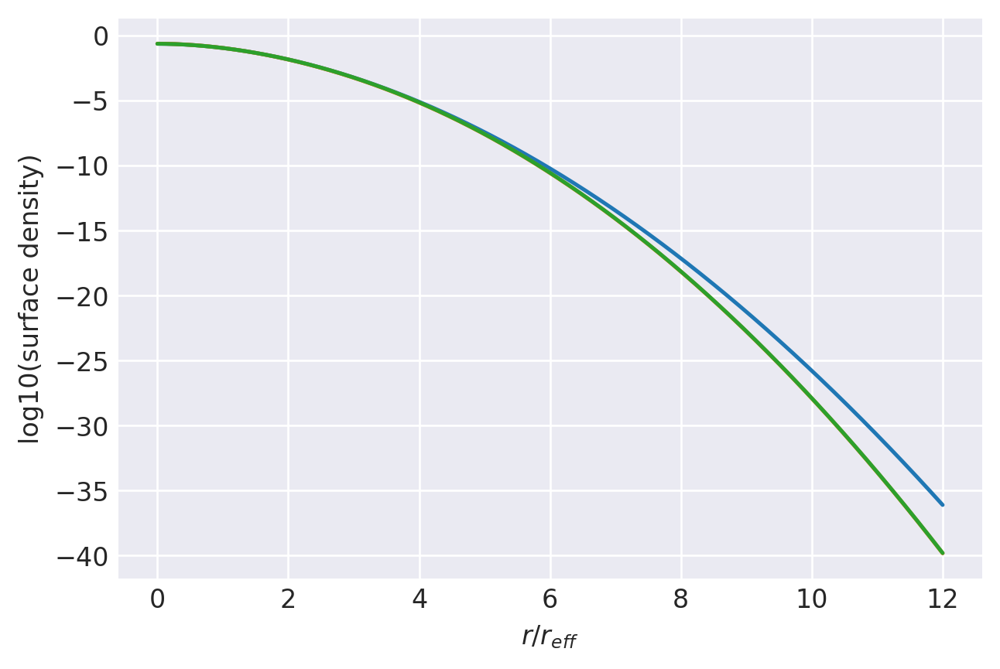

n=0.53: (
    normalize(np.array([7.6435585744e-01, 2.1737336399e-01, 1.7658366124e-02, 6.1241244531e-04])),
    np.array([1.0544564867e+00, 8.7696750809e-01, 5.5633735149e-01, 2.7039257736e-01]),
),
1.000000014891245 1.0000000151404653
prev.  chisq = -7.685690898074962
ws, re: (array([7.64355857e-01, 2.17373364e-01, 1.76583661e-02, 6.12412445e-04]), array([1.04538041, 0.87547292, 0.55628113, 0.27066048]))
         Current function value: -10.190943
         Iterations: 9
         Function evaluations: 431
         Gradient evaluations: 84
-10.19094284124281 [1.35260371 2.52440127 3.43135215]
1.000000014891245 1.0000000148658068


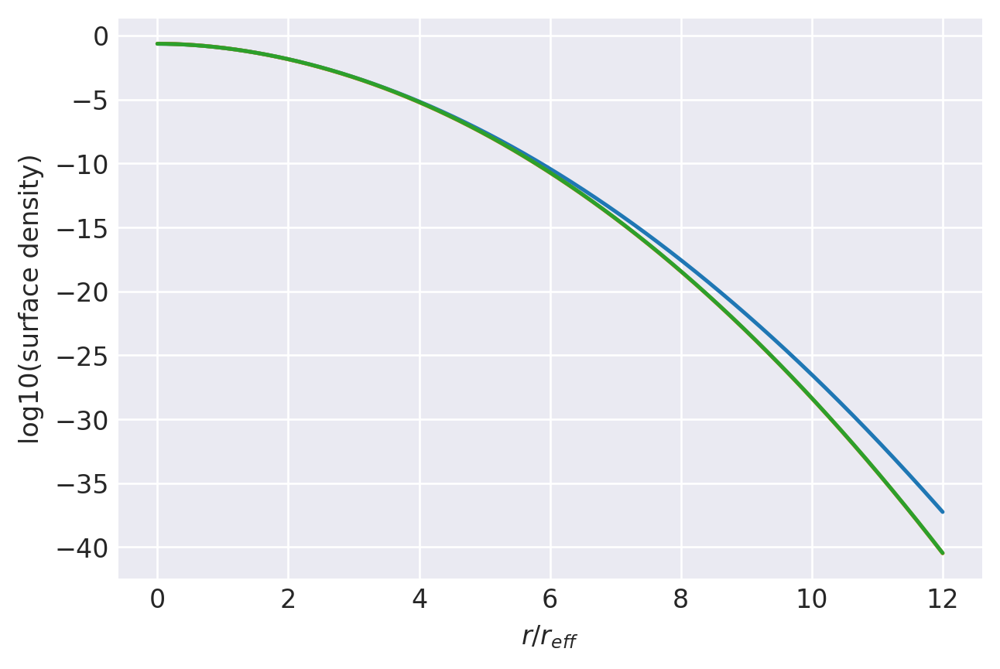

n=0.525: (
    normalize(np.array([7.9455497749e-01, 1.9020815824e-01, 1.4759495284e-02, 4.7736898718e-04])),
    np.array([1.0453804056e+00, 8.7547292341e-01, 5.5628112624e-01, 2.7066048114e-01]),
),
1.000000014799145 1.000000015062741
prev.  chisq = -7.646393191122449
ws, re: (array([7.94554977e-01, 1.90208158e-01, 1.47594953e-02, 4.77368987e-04]), array([1.03630432, 0.87397834, 0.5562249 , 0.27092838]))
Optimization terminated successfully.
         Current function value: -10.315558
         Iterations: 11
         Function evaluations: 105
         Gradient evaluations: 21
-10.315558184280908 [1.56938599 2.57482776 3.50717793]
1.000000014799145 1.0000000147789954


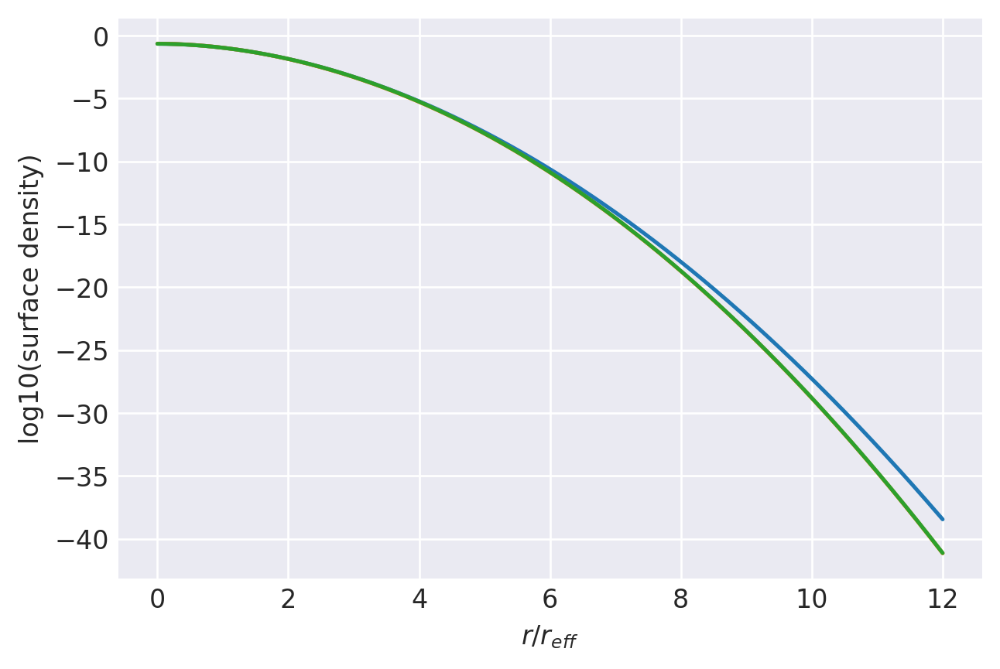

n=0.52: (
    normalize(np.array([8.2769605865e-01, 1.6010893375e-01, 1.1840026965e-02, 3.5498064219e-04])),
    np.array([1.0363043244e+00, 8.7397833873e-01, 5.5622490099e-01, 2.7092838491e-01]),
),
1.0000000147625825 1.0000000148615213
prev.  chisq = -8.401882019528868
ws, re: (array([8.27696059e-01, 1.60108934e-01, 1.18400270e-02, 3.54980642e-04]), array([1.03267389, 0.8733805 , 0.55620241, 0.27103555]))
Optimization terminated successfully.
         Current function value: -10.380260
         Iterations: 7
         Function evaluations: 80
         Gradient evaluations: 16
-10.380259790179087 [1.67222248 2.59570062 3.53943965]
1.0000000147625825 1.0000000147445114


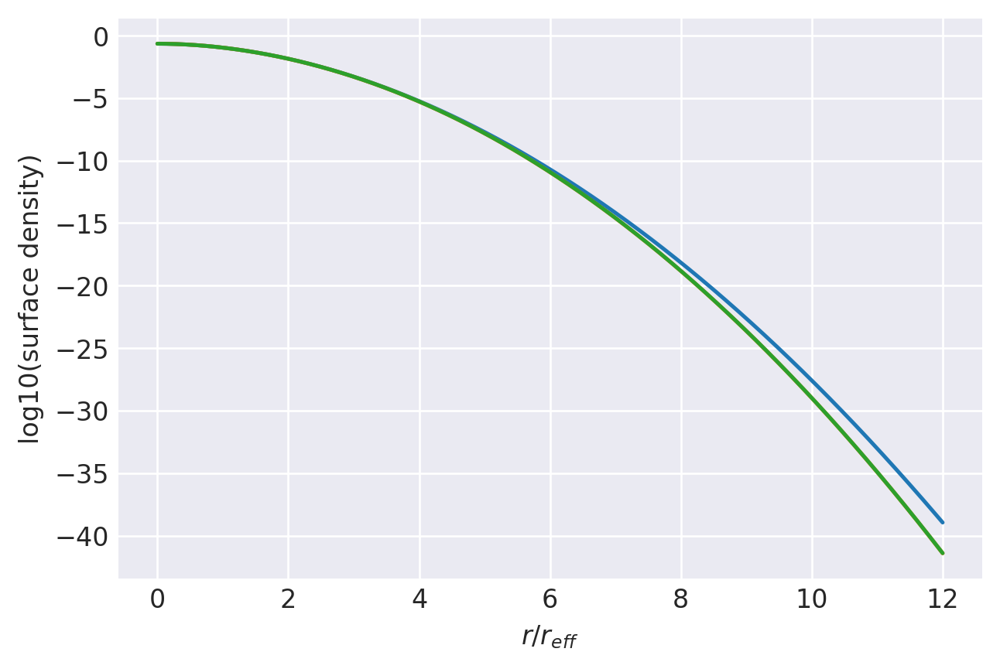

n=0.518: (
    normalize(np.array([8.4187191031e-01, 1.4715152809e-01, 1.0666905708e-02, 3.0965589274e-04])),
    np.array([1.0326738920e+00, 8.7338050486e-01, 5.5620241089e-01, 2.7103554642e-01]),
),
1.0000000147261765 1.0000000148289008
prev.  chisq = -8.385651385935214
ws, re: (array([8.41871910e-01, 1.47151528e-01, 1.06669057e-02, 3.09655893e-04]), array([1.02904346, 0.87278267, 0.55617992, 0.27114271]))
Optimization terminated successfully.
         Current function value: -10.456216
         Iterations: 7
         Function evaluations: 75
         Gradient evaluations: 15
-10.456215969949163 [1.78749377 2.6169981  3.57290978]
1.0000000147261765 1.0000000147101678


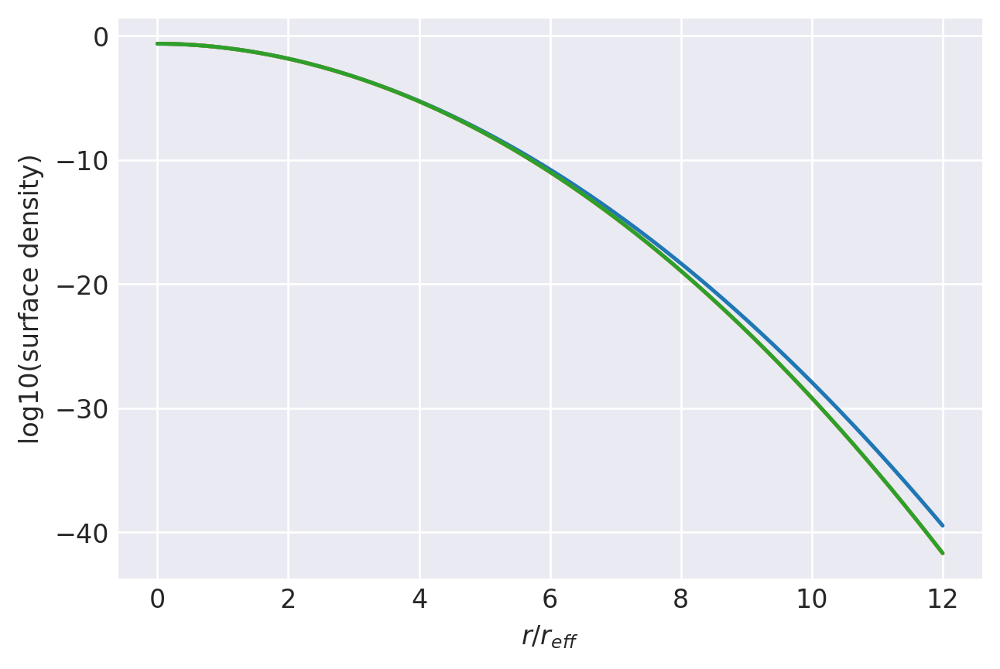

n=0.516: (
    normalize(np.array([8.5661973094e-01, 1.3362289316e-01, 9.4909271779e-03, 2.6644872161e-04])),
    np.array([1.0290434596e+00, 8.7278267098e-01, 5.5617992079e-01, 2.7114270793e-01]),
),
1.0000000146899282 1.0000000147964991
prev.  chisq = -8.369030663254154
ws, re: (array([8.56619731e-01, 1.33622893e-01, 9.49092718e-03, 2.66448722e-04]), array([1.02541303, 0.87218484, 0.55615743, 0.27124987]))
Optimization terminated successfully.
         Current function value: -10.546296
         Iterations: 10
         Function evaluations: 100
         Gradient evaluations: 20
-10.546295968271926 [1.9185265  2.63873444 3.60771351]
1.0000000146899282 1.0000000146759638


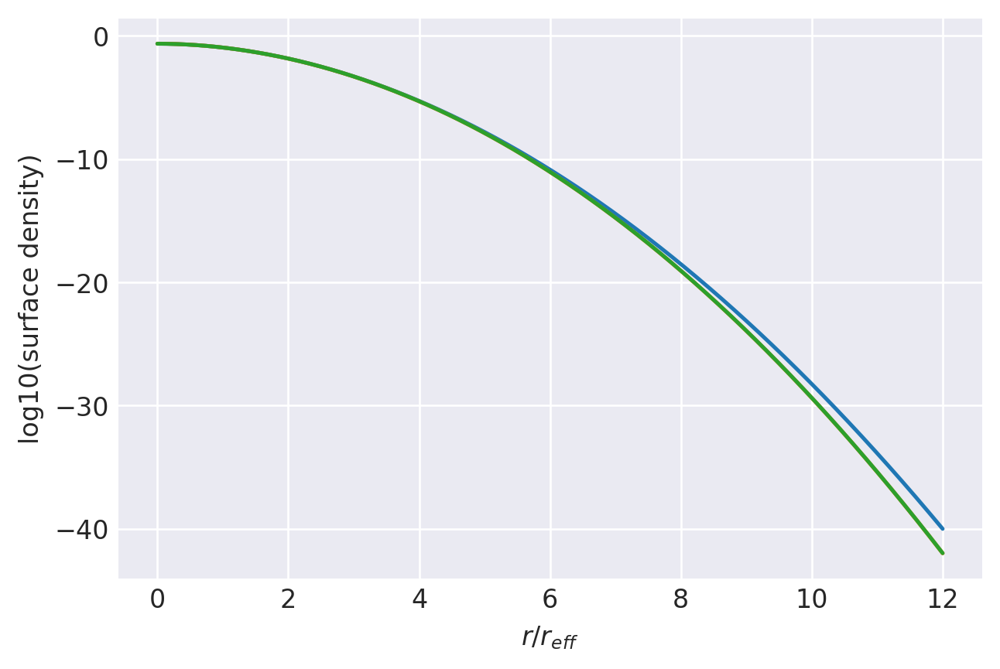

n=0.514: (
    normalize(np.array([8.7197402933e-01, 1.1948833341e-01, 8.3122605259e-03, 2.2537673275e-04])),
    np.array([1.0254130271e+00, 8.7218483711e-01, 5.5615743069e-01, 2.7124986944e-01]),
),
1.0000000146538368 1.0000000147643222
prev.  chisq = -8.351996893433963
ws, re: (array([8.71974029e-01, 1.19488333e-01, 8.31226053e-03, 2.25376733e-04]), array([1.02178259, 0.871587  , 0.55613494, 0.27135703]))
Optimization terminated successfully.
         Current function value: -10.654712
         Iterations: 7
         Function evaluations: 85
         Gradient evaluations: 17
-10.654712175652614 [2.07019189 2.6609281  3.64393317]
1.0000000146538368 1.0000000146419017


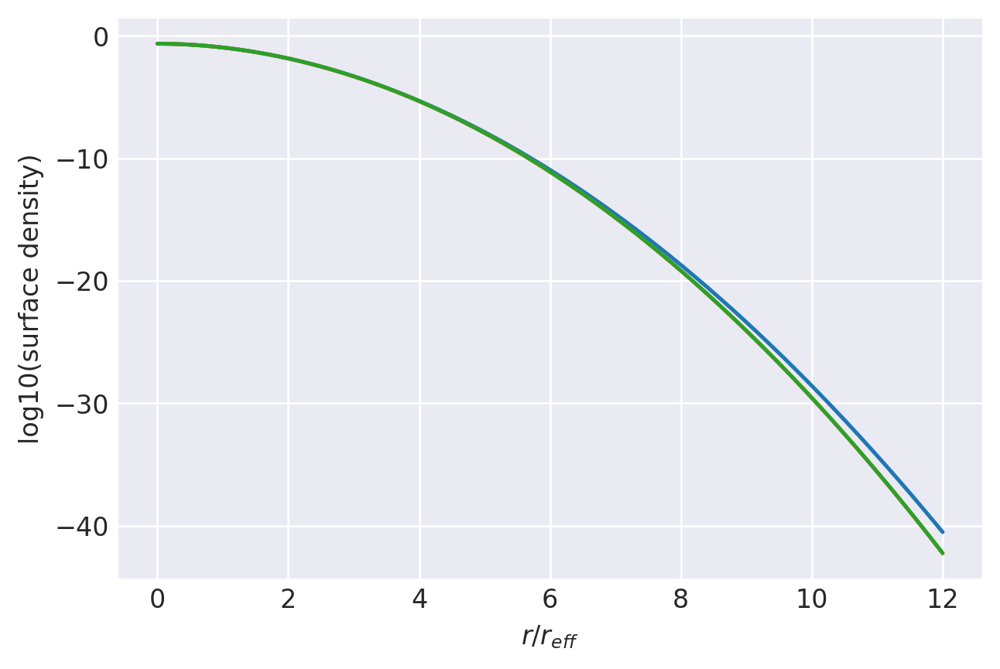

n=0.512: (
    normalize(np.array([8.8797205161e-01, 1.0471043423e-01, 7.1310424559e-03, 1.8647171091e-04])),
    np.array([1.0217825947e+00, 8.7158700324e-01, 5.5613494059e-01, 2.7135703095e-01]),
),
1.000000014617902 1.0000000147323769
prev.  chisq = -8.334527069228711
ws, re: (array([8.87972052e-01, 1.04710434e-01, 7.13104246e-03, 1.86471711e-04]), array([1.01815216, 0.87098917, 0.55611245, 0.27146419]))
Optimization terminated successfully.
         Current function value: -10.788006
         Iterations: 10
         Function evaluations: 90
         Gradient evaluations: 18
-10.788006397885551 [2.25004202 2.68359745 3.68167737]
1.000000014617902 1.0000000146079826


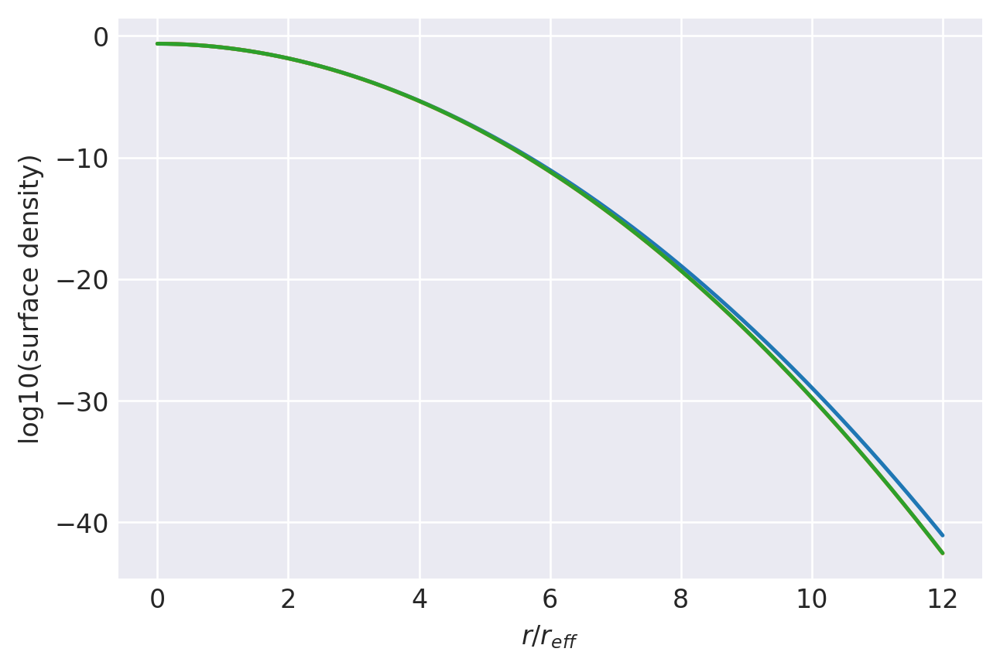

n=0.51: (
    normalize(np.array([9.0465415940e-01, 8.9248645803e-02, 5.9474342283e-03, 1.4976056908e-04])),
    np.array([1.0181521622e+00, 8.7098916936e-01, 5.5611245050e-01, 2.7146419246e-01]),
),
1.0000000145999934 1.0000000146542047
prev.  chisq = -8.916353704720438
ws, re: (array([9.04654159e-01, 8.92486458e-02, 5.94743423e-03, 1.49760569e-04]), array([1.01633695, 0.87069025, 0.55610121, 0.27151777]))
Optimization terminated successfully.
         Current function value: -10.867135
         Iterations: 13
         Function evaluations: 115
         Gradient evaluations: 23
-10.867135476547118 [2.35417227 2.69511588 3.70117225]
1.0000000145999934 1.0000000145910768


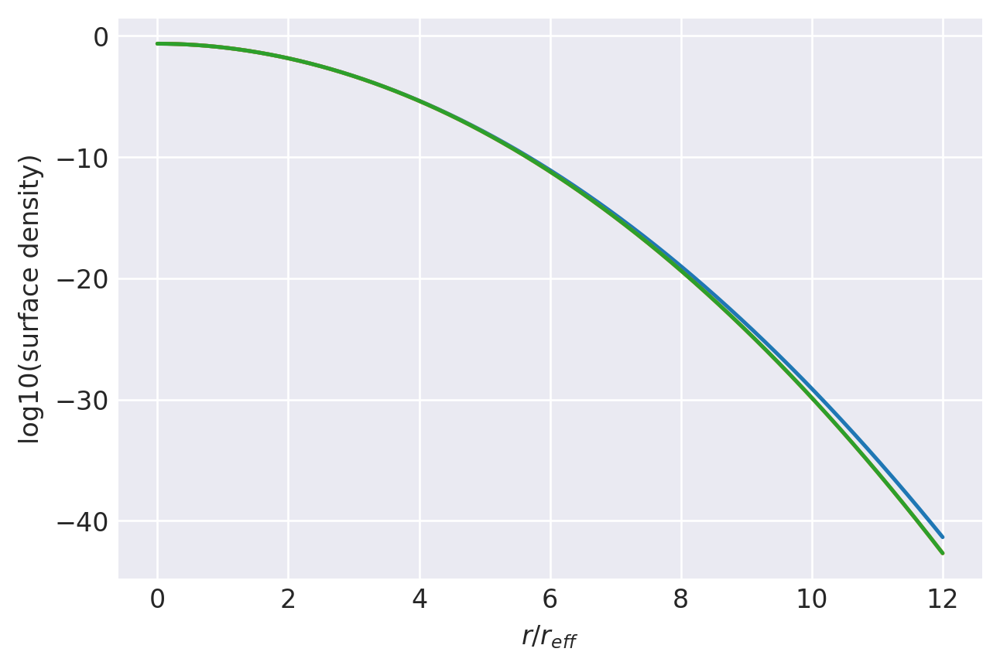

n=0.509: (
    normalize(np.array([9.1326529121e-01, 8.1247682677e-02, 5.3547918794e-03, 1.3223423568e-04])),
    np.array([1.0163369460e+00, 8.7069025243e-01, 5.5610120545e-01, 2.7151777321e-01]),
),
1.0000000145821235 1.000000014637869
prev.  chisq = -8.907979226414229
ws, re: (array([9.13265291e-01, 8.12476827e-02, 5.35479188e-03, 1.32234236e-04]), array([1.01452173, 0.87039134, 0.55608996, 0.27157135]))
Optimization terminated successfully.
         Current function value: -10.957151
         Iterations: 7
         Function evaluations: 75
         Gradient evaluations: 15
-10.957150791685425 [2.47072873 2.70676037 3.72110455]
1.0000000145821235 1.0000000145742074


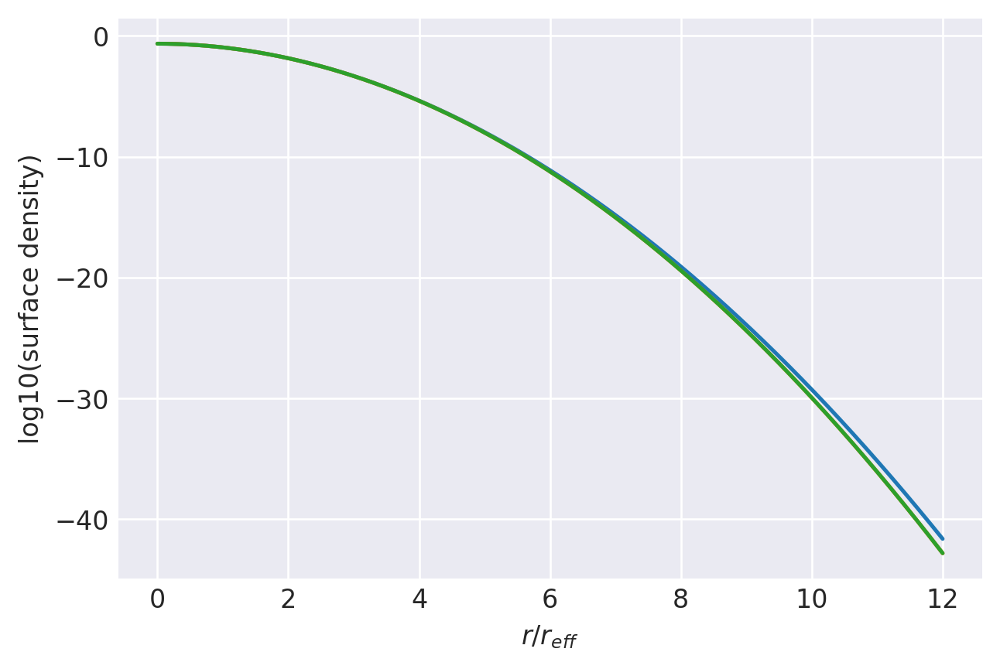

n=0.508: (
    normalize(np.array([9.2206414921e-01, 7.3058966723e-02, 4.7616185406e-03, 1.1526552325e-04])),
    np.array([1.0145217298e+00, 8.7039133549e-01, 5.5608996040e-01, 2.7157135396e-01]),
),
1.0000000145642924 1.0000000146215826
prev.  chisq = -8.89940446775965
ws, re: (array([9.22064149e-01, 7.30589667e-02, 4.76161854e-03, 1.15265523e-04]), array([1.01270651, 0.87009242, 0.55607872, 0.27162493]))
         Current function value: -11.060939
         Iterations: 15
         Function evaluations: 845
         Gradient evaluations: 167
-11.060939209873506 [2.60303713 2.71853487 3.74146011]
1.0000000145642924 1.0000000145573742


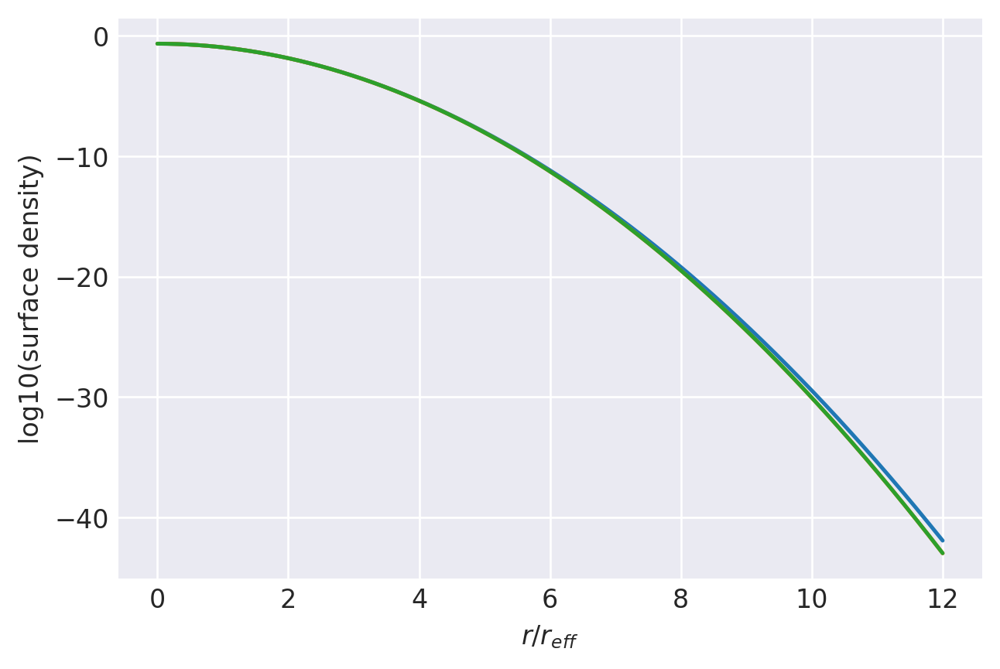

n=0.507: (
    normalize(np.array([9.3105678877e-01, 6.4676421037e-02, 4.1679292284e-03, 9.8860967198e-05])),
    np.array([1.0127065136e+00, 8.7009241855e-01, 5.5607871535e-01, 2.7162493472e-01]),
),
1.000000014546501 1.0000000146053458
prev.  chisq = -8.890623456838984
ws, re: (array([9.31056789e-01, 6.46764210e-02, 4.16792923e-03, 9.88609672e-05]), array([1.0108913 , 0.8697935 , 0.55606747, 0.27167852]))
Optimization terminated successfully.
         Current function value: -11.182730
         Iterations: 9
         Function evaluations: 90
         Gradient evaluations: 18
-11.182729701200454 [2.75596902 2.73043797 3.76234295]
1.000000014546501 1.0000000145405767


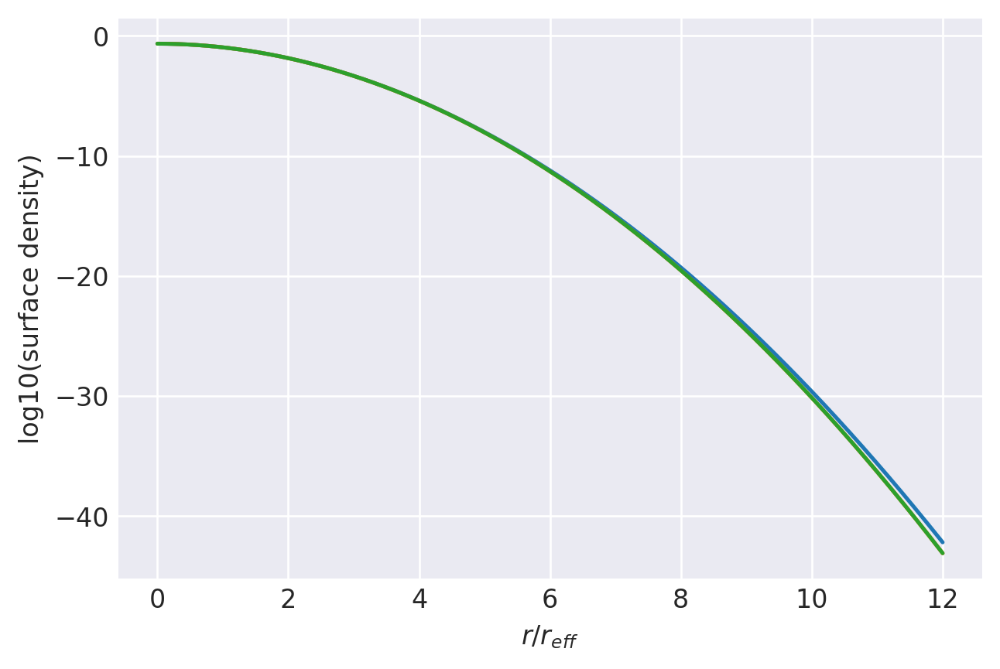

n=0.506: (
    normalize(np.array([9.4024957357e-01, 5.6093640927e-02, 3.5737695079e-03, 8.3015990936e-05])),
    np.array([1.0108912973e+00, 8.6979350162e-01, 5.5606747030e-01, 2.7167851547e-01]),
),
1.0000000145287486 1.0000000145891594
prev.  chisq = -8.881630382188565
ws, re: (array([9.40249574e-01, 5.60936409e-02, 3.57376951e-03, 8.30159909e-05]), array([1.00907608, 0.86949458, 0.55605623, 0.2717321 ]))
Optimization terminated successfully.
         Current function value: -11.329080
         Iterations: 19
         Function evaluations: 275
         Gradient evaluations: 55
-11.32907967716297 [2.93707563 2.74247555 3.78371394]
1.0000000145287486 1.0000000145238166


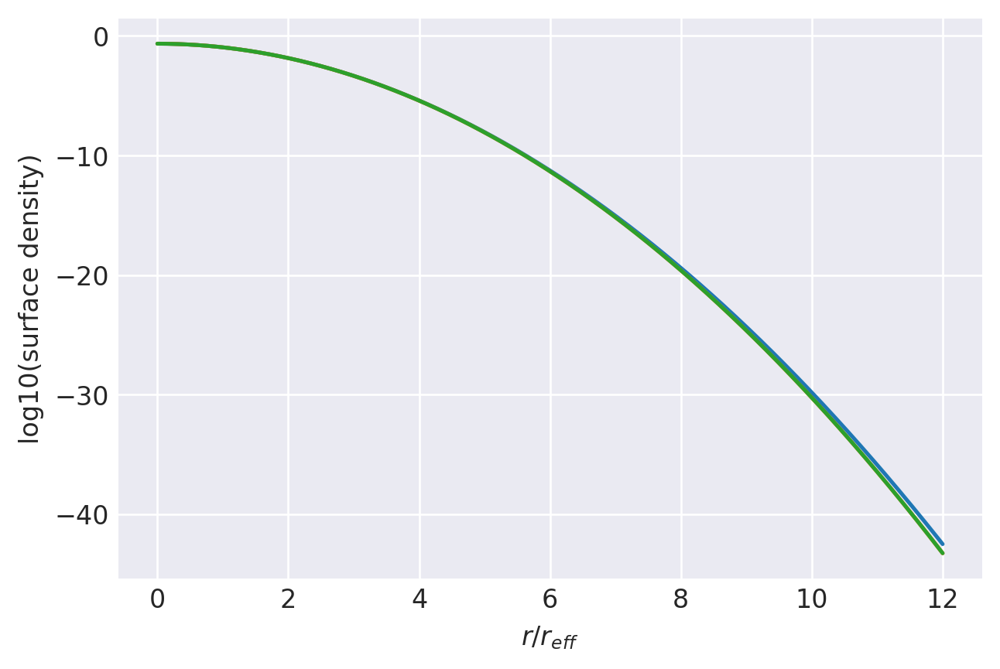

n=0.505: (
    normalize(np.array([9.4964907955e-01, 4.7304034601e-02, 2.9791457766e-03, 6.7740074277e-05])),
    np.array([1.0090760811e+00, 8.6949458468e-01, 5.5605622525e-01, 2.7173209623e-01]),
),
1.0000000145110344 1.000000014573024
prev.  chisq = -8.872419815363463
ws, re: (array([9.49649080e-01, 4.73040346e-02, 2.97914578e-03, 6.77400743e-05]), array([1.00726086, 0.86919567, 0.55604498, 0.27178568]))
         Current function value: -11.510976
         Iterations: 13
         Function evaluations: 354
         Gradient evaluations: 69
-11.510975992135794 [3.15900799 2.75465164 3.80557106]
1.0000000145110344 1.0000000145070926


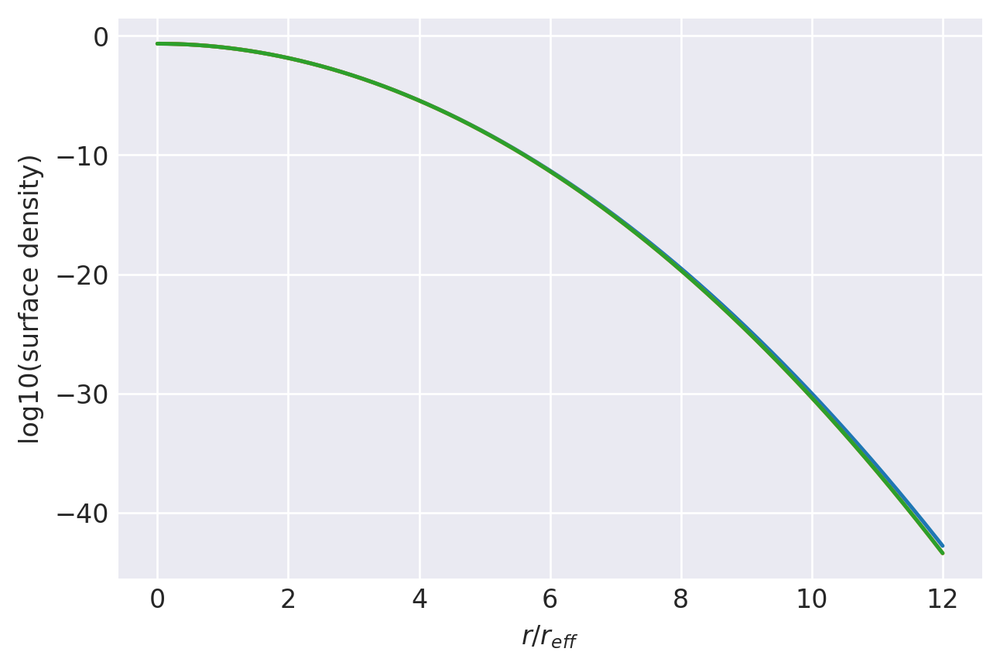

n=0.504: (
    normalize(np.array([9.5926219793e-01, 3.8300684239e-02, 2.3840804072e-03, 5.3037419541e-05])),
    np.array([1.0072608649e+00, 8.6919566775e-01, 5.5604498020e-01, 2.7178567698e-01]),
),
1.000000014493359 1.0000000145569403
prev.  chisq = -8.86298650466956
ws, re: (array([9.59262198e-01, 3.83006842e-02, 2.38408041e-03, 5.30374195e-05]), array([1.00544565, 0.86889675, 0.55603374, 0.27183926]))
Optimization terminated successfully.
         Current function value: -11.749017
         Iterations: 14
         Function evaluations: 140
         Gradient evaluations: 28
-11.74901683973368 [3.44548298 2.76696714 3.82799132]
1.000000014493359 1.000000014490406


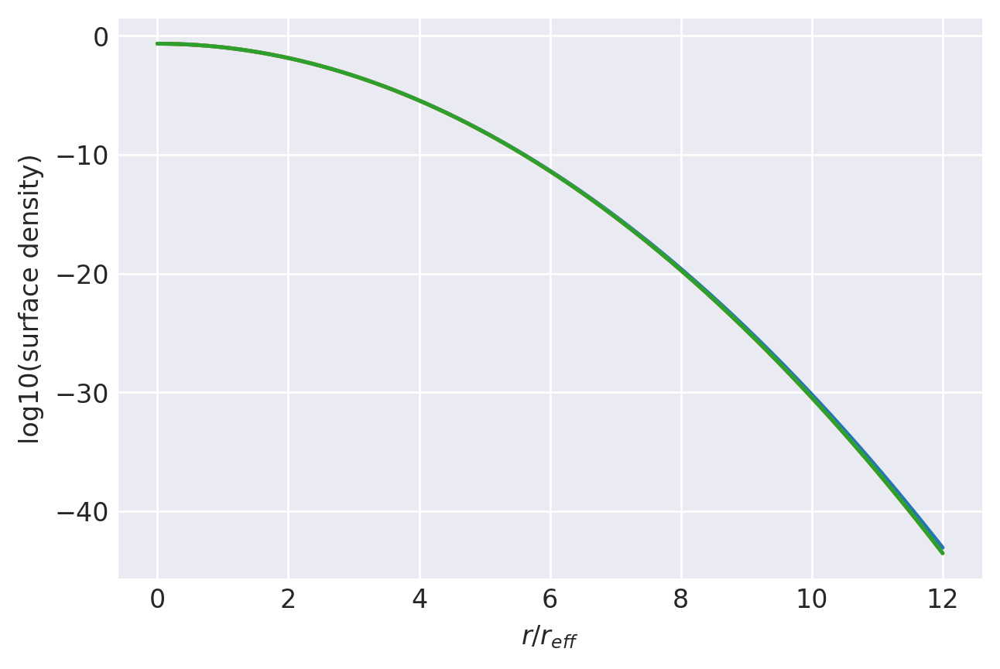

n=0.503: (
    normalize(np.array([9.6909614755e-01, 2.9076336691e-02, 1.7886076942e-03, 3.8908060978e-05])),
    np.array([1.0054456487e+00, 8.6889675081e-01, 5.5603373515e-01, 2.7183925774e-01]),
),
1.0000000144757226 1.0000000145409087
prev.  chisq = -8.853325619920506
ws, re: (array([9.69096148e-01, 2.90763367e-02, 1.78860769e-03, 3.89080610e-05]), array([1.00363043, 0.86859783, 0.55602249, 0.27189284]))
         Current function value: -12.089448
         Iterations: 13
         Function evaluations: 532
         Gradient evaluations: 104
-12.089448143435432 [3.84974504 2.77942706 3.85091975]
1.0000000144757226 1.0000000144737555


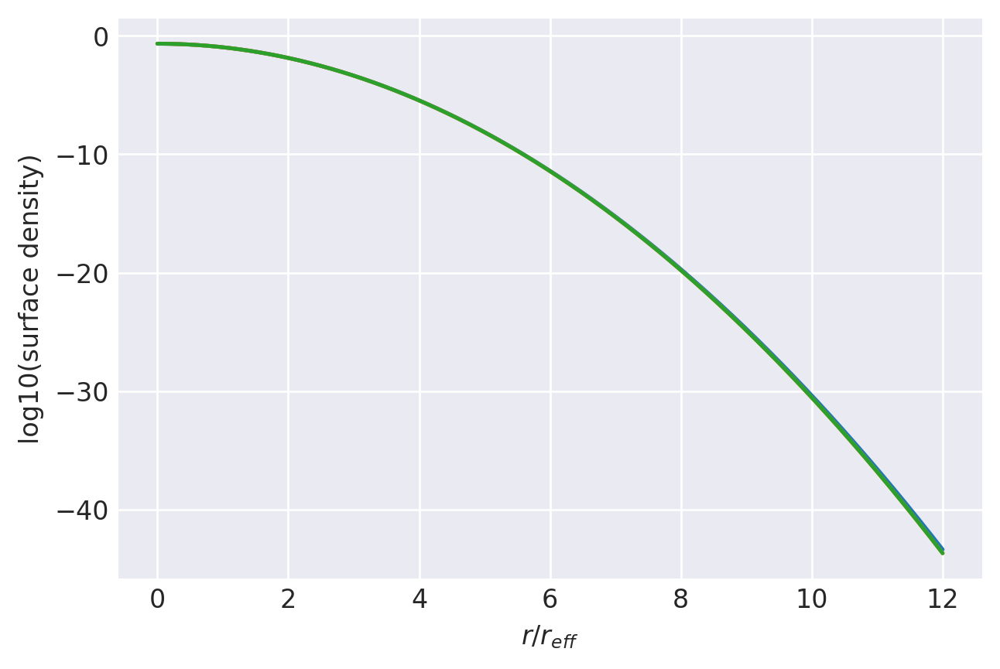

n=0.502: (
    normalize(np.array([9.7915845320e-01, 1.9623440160e-02, 1.1927485937e-03, 2.5358041869e-05])),
    np.array([1.0036304324e+00, 8.6859783387e-01, 5.5602249010e-01, 2.7189283849e-01]),
),
1.0000000144581254 1.0000000145249304
prev.  chisq = -8.843432716333025
ws, re: (array([9.79158453e-01, 1.96234402e-02, 1.19274859e-03, 2.53580419e-05]), array([1.00181522, 0.86829892, 0.55601125, 0.27194642]))
         Current function value: -12.679841
         Iterations: 11
         Function evaluations: 546
         Gradient evaluations: 107
-12.679840701590944 [4.54169443 2.79202662 3.87468417]
1.0000000144581254 1.0000000144571422


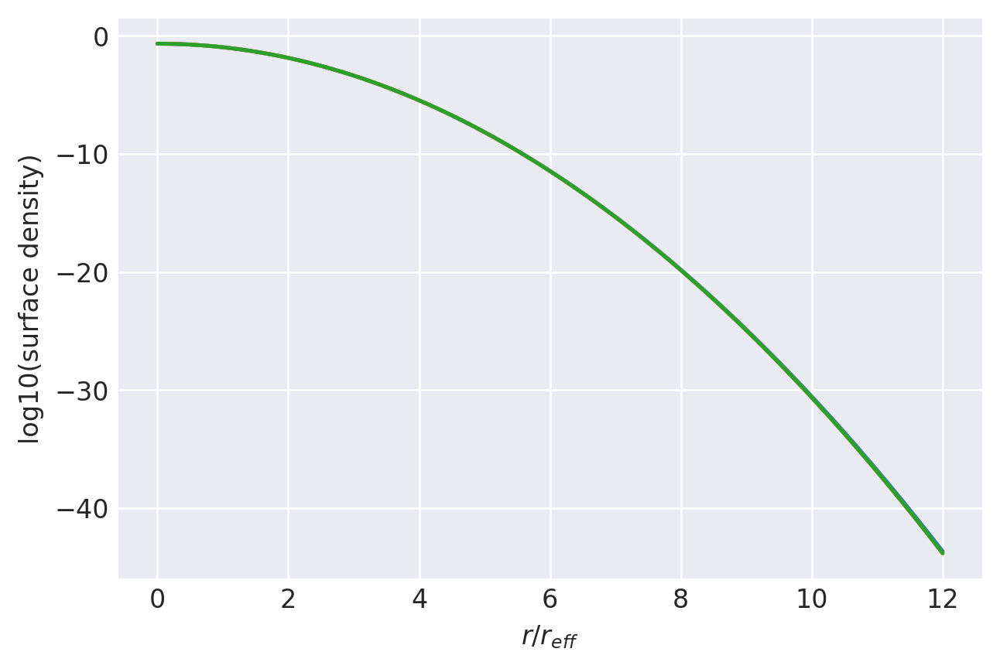

n=0.501: (
    normalize(np.array([9.8945700264e-01, 9.9340700388e-03, 5.9654256544e-04, 1.2384756796e-05])),
    np.array([1.0018152162e+00, 8.6829891694e-01, 5.5601124505e-01, 2.7194641925e-01]),
),
1.000000014440567 1.0000000145090056
prev.  chisq = -8.833303466127767
ws, re: (array([9.89457003e-01, 9.93407004e-03, 5.96542565e-04, 1.23847568e-05]), array([1.   , 0.868, 0.556, 0.272]))
Optimization terminated successfully.
         Current function value: -24.621656
         Iterations: 1
         Function evaluations: 20
         Gradient evaluations: 4
-24.62165647646808 [22.58978107  5.32230567  3.8842146 ]
1.000000014440567 1.0000000144405667


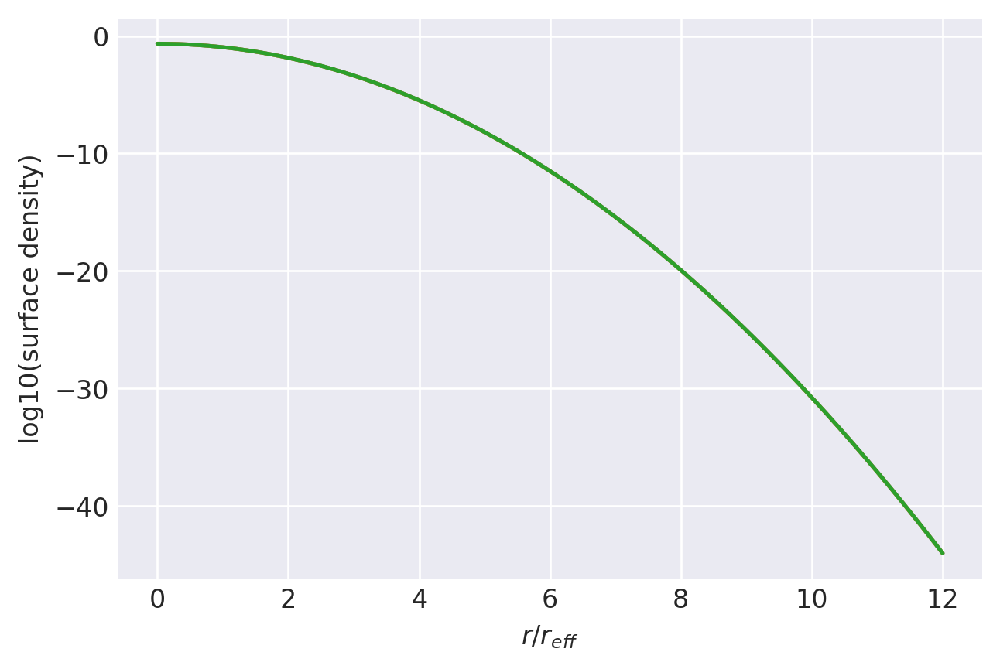

n=0.5: (
    normalize(np.array([9.9999999985e-01, 1.5391030589e-10, 7.3617232424e-13, 1.5099033135e-14])),
    np.array([1.0000000000e+00, 8.6800000000e-01, 5.5600000000e-01, 2.7200000000e-01]),
),


In [9]:
# Fit for n < 1. Use a fixed radius for n<0.6
nvals = [
    (
        np.array([
            0.975, 0.95, 0.925, 0.9, 0.875, 0.85, 0.825, 0.8,
            0.775, 0.75, 0.725, 0.7, 0.675, 0.65, 0.625, 0.6,
        ]),
        (
    normalize(np.array([3.2466847784e-01, 4.7803210251e-01, 1.7258586760e-01, 2.4713552046e-02])),
    np.array([1.7007792632e+00, 9.7809127671e-01, 5.1487137336e-01, 2.1966932363e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])

def radiuslogextrapmgfour(n):
    return np.log10(np.array([1.0, 0.868, 0.556, 0.272]) + 10*(n-0.5)*(
        np.array([1.1815216222e+00, 8.9789169364e-01, 5.5712450495e-01, 2.6664192455e-01]) -
        np.array([1.0, 0.868, 0.556, 0.272])))

for n in [0.6, 0.55, 0.5]:
    print(n, 10**radiuslogextrapmgfour(n))
    
nvals = [
    (
        np.array([
            0.59, 0.58, 0.57, 0.56, 0.55, 0.545, 0.54, 0.535, 0.53,
            0.525, 0.52, 0.518, 0.516, 0.514, 0.512, 0.51, 0.509,
            0.508, 0.507, 0.506, 0.505, 0.504, 0.503, 0.502, 0.501, 0.5
        ]),
        (
            normalize(
                np.array([5.1668620161e-01, 4.2422360341e-01, 5.5463315784e-02, 3.6268791954e-03])),
            np.array([1.1815216222e+00, 8.9789169364e-01, 5.5712450495e-01, 2.6664192455e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'], funcrdivreslog=radiuslogextrapmgfour)

[0, 24000]
0.9999999914677243 1.0000000256336785
prev.  chisq = -8.000517405216014
ws, re: (array([0.32466848, 0.4780321 , 0.17258587, 0.02471355]), array([1.70077926, 0.97809128, 0.51487137, 0.21966932]))
         Current function value: -8.000517
         Iterations: 6
         Function evaluations: 496
         Gradient evaluations: 54
-8.000517405221363 [-0.73239907  0.88495522  1.94354295  0.23064793 -0.00962061 -0.28830122
 -0.65823056]
0.9999999914677243 1.0000000256336792


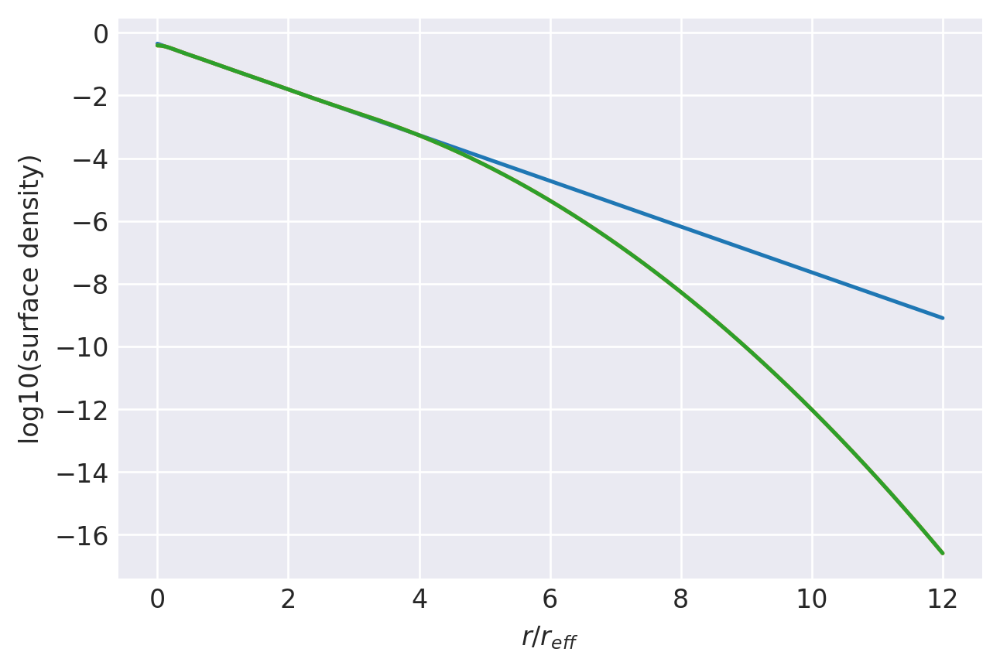

n=1.0: (
    normalize(np.array([3.2466848833e-01, 4.7803206711e-01, 1.7258588535e-01, 2.4713559210e-02])),
    np.array([1.7007791901e+00, 9.7809128350e-01, 5.1487140942e-01, 2.1966933602e-01]),
),
[0, 24000]
0.9999999524961687 1.0000000256336792
prev.  chisq = -7.530298824108015
ws, re: (array([0.32466849, 0.47803207, 0.17258589, 0.02471356]), array([1.70077919, 0.97809128, 0.51487141, 0.21966934]))
         Current function value: -7.927960
         Iterations: 12
         Function evaluations: 804
         Gradient evaluations: 88
-7.9279595930089 [-0.7417069   0.85956674  1.91675568  0.23735186 -0.00839656 -0.29088243
 -0.66393327]
0.9999999524961687 1.0000000263233384


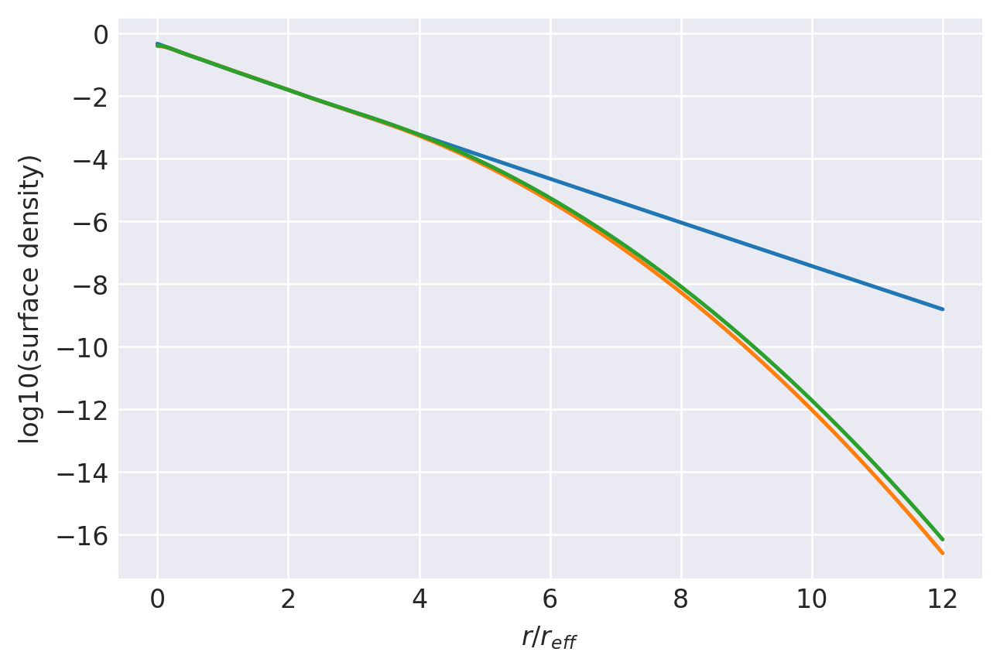

n=1.025: (
    normalize(np.array([3.2263100428e-01, 4.7589922000e-01, 1.7563655804e-01, 2.5833217683e-02])),
    np.array([1.7272366999e+00, 9.8085191356e-01, 5.1182037804e-01, 2.1680372209e-01]),
),
[0, 24000]
0.9999998805166705 1.0000000263233384
prev.  chisq = -7.512880520474455
ws, re: (array([0.322631  , 0.47589922, 0.17563656, 0.02583322]), array([1.7272367 , 0.98085191, 0.51182038, 0.21680372]))
Optimization terminated successfully.
         Current function value: -7.859156
         Iterations: 17
         Function evaluations: 234
         Gradient evaluations: 26
-7.859155906649445 [-0.74963572  0.83594953  1.89140931  0.24382241 -0.00726448 -0.29347873
 -0.66961764]
0.9999998805166705 1.0000000270252891


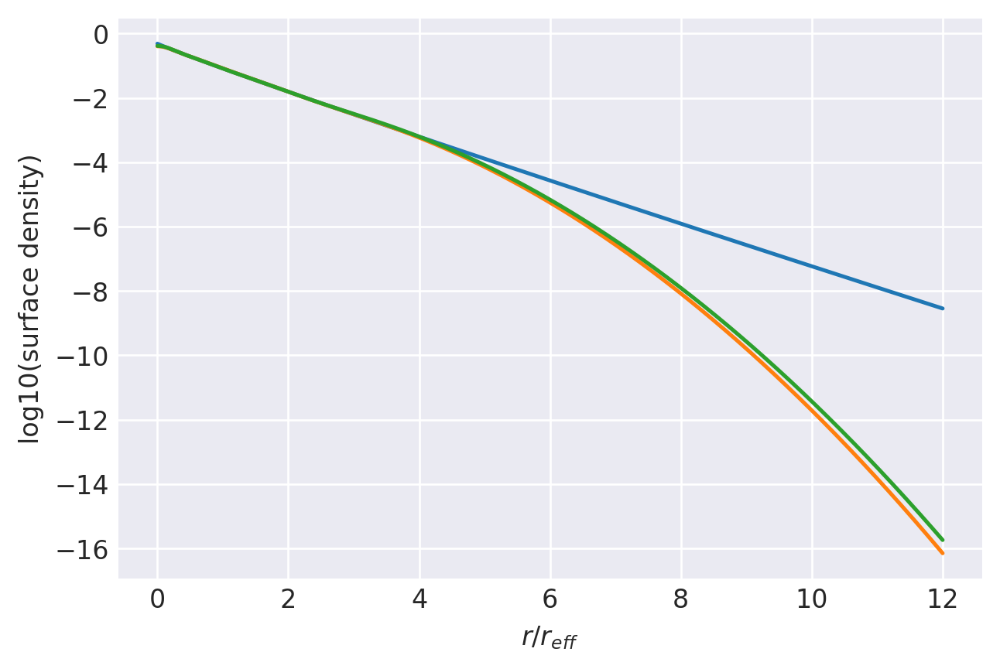

n=1.05: (
    normalize(np.array([3.2090068182e-01, 4.7374746397e-01, 1.7843353967e-01, 2.6918314538e-02])),
    np.array([1.7531634501e+00, 9.8341204737e-01, 5.0876973313e-01, 2.1398452230e-01]),
),
[0, 24000]
0.9999997552406892 1.0000000270252891
prev.  chisq = -7.492361551907761
ws, re: (array([0.32090068, 0.47374746, 0.17843354, 0.02691831]), array([1.75316345, 0.98341205, 0.50876973, 0.21398452]))
Optimization terminated successfully.
         Current function value: -7.793783
         Iterations: 16
         Function evaluations: 225
         Gradient evaluations: 25
-7.793783041257091 [-0.75634918  0.81392667  1.86738952  0.25007267 -0.00621968 -0.29608842
 -0.67528084]
0.9999997552406892 1.0000000277396082


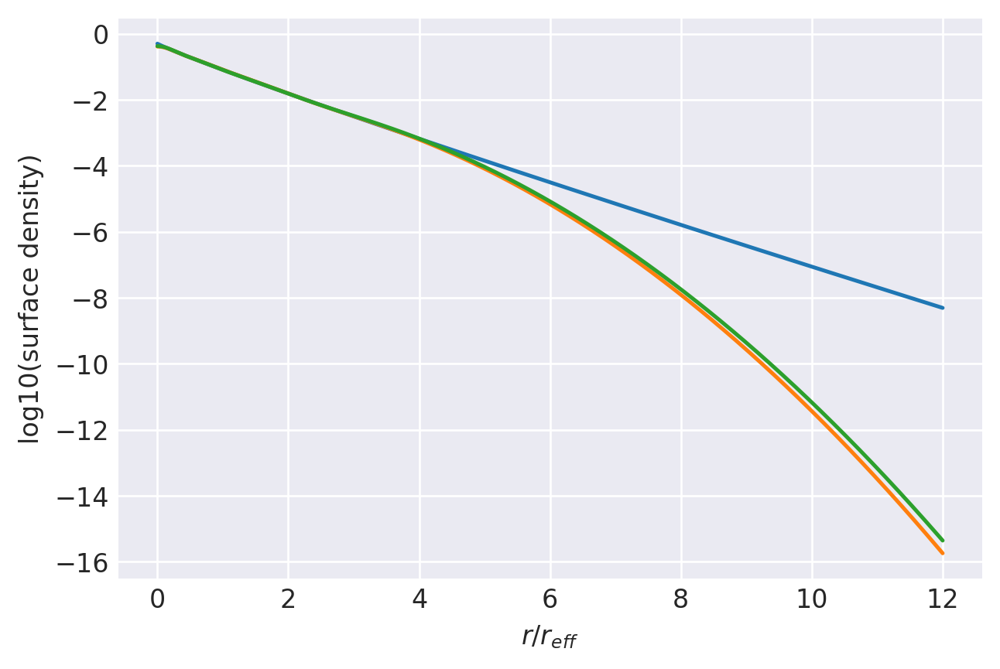

n=1.075: (
    normalize(np.array([3.1943942269e-01, 4.7159147284e-01, 1.8099982987e-01, 2.7969274601e-02])),
    np.array([1.7785769837e+00, 9.8578072808e-01, 5.0572168956e-01, 2.1121227971e-01]),
),
[0, 24000]
0.9999995478677557 1.0000000277396082
prev.  chisq = -7.469136721202342
ws, re: (array([0.31943942, 0.47159147, 0.18099983, 0.02796927]), array([1.77857698, 0.98578073, 0.50572169, 0.21121228]))
Optimization terminated successfully.
         Current function value: -7.731556
         Iterations: 16
         Function evaluations: 216
         Gradient evaluations: 24
-7.731556244760877 [-0.76198676  0.79334571  1.84459488  0.25611455 -0.00525794 -0.29871023
 -0.68092098]
0.9999995478677557 1.000000028466386


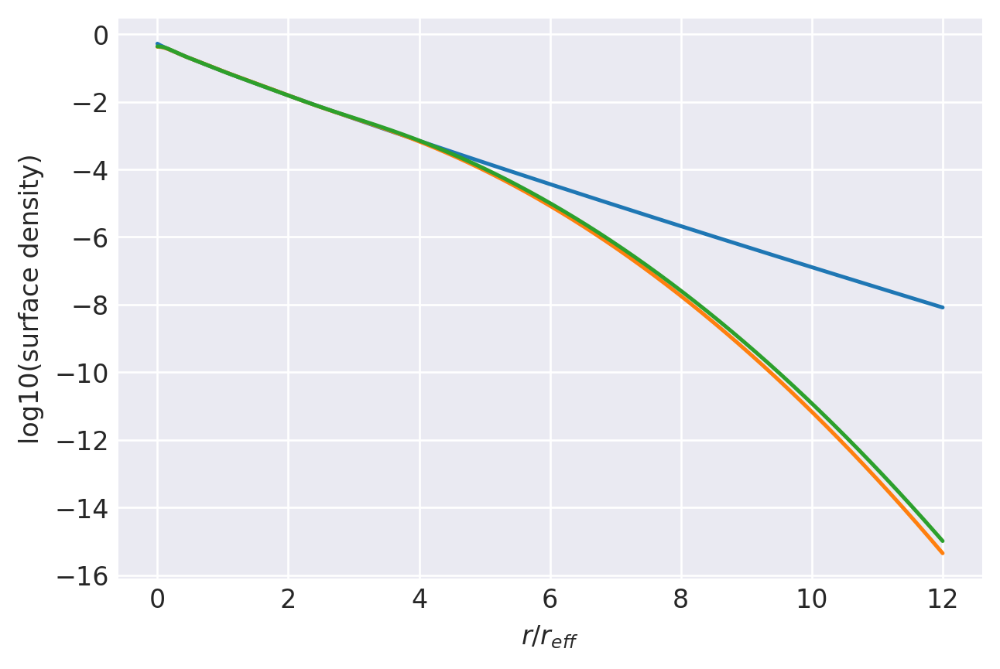

n=1.1: (
    normalize(np.array([3.1821507450e-01, 4.6944251051e-01, 1.8335581305e-01, 2.8986601939e-02])),
    np.array([1.8034933613e+00, 9.8796614174e-01, 5.0267787715e-01, 2.0848701764e-01]),
),
[0, 24000]
0.999999042644294 1.000000028466386
prev.  chisq = -7.291904198267477
ws, re: (array([0.31821507, 0.46944251, 0.18335581, 0.0289866 ]), array([1.80349336, 0.98796614, 0.50267788, 0.20848702]))
         Current function value: -7.649250
         Iterations: 16
         Function evaluations: 668
         Gradient evaluations: 73
-7.649249725011227 [-0.7682985   0.76670333  1.81456759  0.26424384 -0.00404346 -0.30239885
 -0.6887754 ]
0.999999042644294 1.0000000295049785


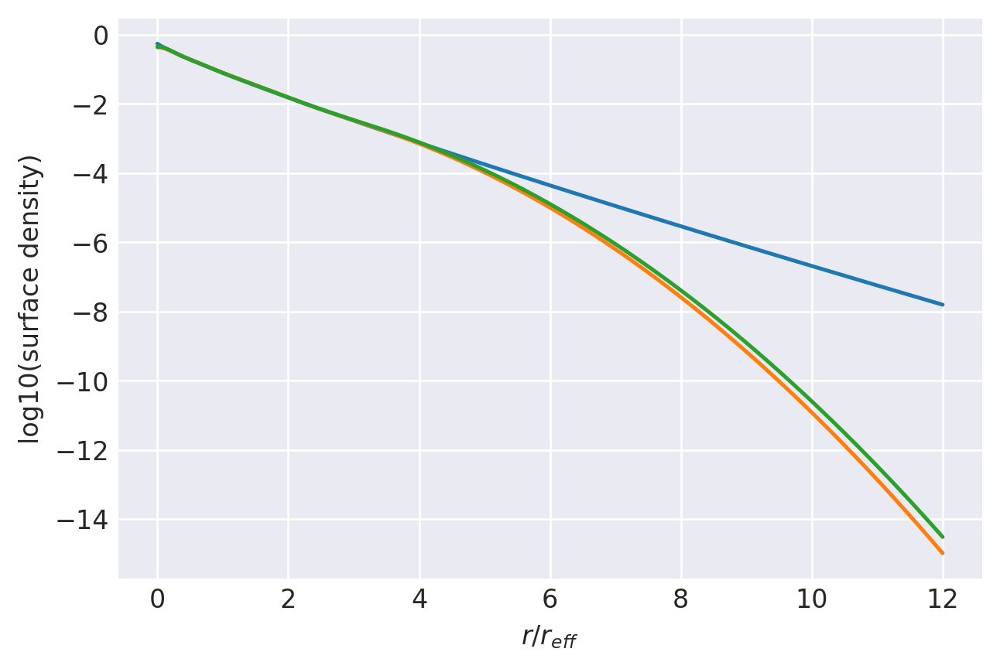

n=1.135: (
    normalize(np.array([3.1684728883e-01, 4.6646167700e-01, 1.8633543784e-01, 3.0355596331e-02])),
    np.array([1.8375698010e+00, 9.9073280379e-01, 4.9842652418e-01, 2.0475032650e-01]),
),
[0, 24000]
0.9999983071986108 1.0000000295049785
prev.  chisq = -7.336813019789801
ws, re: (array([0.31684729, 0.46646168, 0.18633544, 0.0303556 ]), array([1.8375698 , 0.9907328 , 0.49842652, 0.20475033]))
Optimization terminated successfully.
         Current function value: -7.582761
         Iterations: 15
         Function evaluations: 198
         Gradient evaluations: 22
-7.58276074653248 [-0.77242739  0.74567257  1.79042875  0.27092421 -0.00311852 -0.30557582
 -0.69546734]
0.9999983071986108 1.0000000304149932


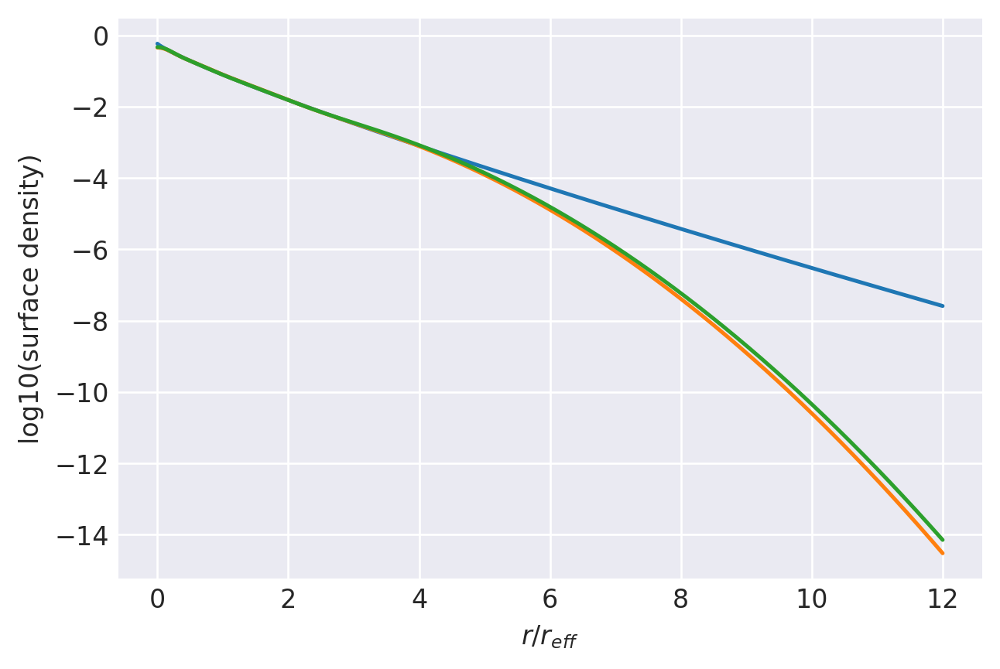

n=1.165: (
    normalize(np.array([3.1595424709e-01, 4.6394380147e-01, 1.8862293388e-01, 3.1479017558e-02])),
    np.array([1.8660539980e+00, 9.9284506375e-01, 4.9479372146e-01, 2.0161955683e-01]),
),
[1, 24000]
0.9999969189841783 1.0000000304149932
prev.  chisq = -7.246951084457131
ws, re: (array([0.31595425, 0.4639438 , 0.18862293, 0.03147902]), array([1.866054  , 0.99284506, 0.49479372, 0.20161956]))
         Current function value: -7.509468
         Iterations: 13
         Function evaluations: 624
         Gradient evaluations: 68
-7.509468209070201 [-0.77595626  0.7230055   1.76395868  0.27840407 -0.00216659 -0.30929788
 -0.70322509]
0.9999969189841783 1.0000000314999826


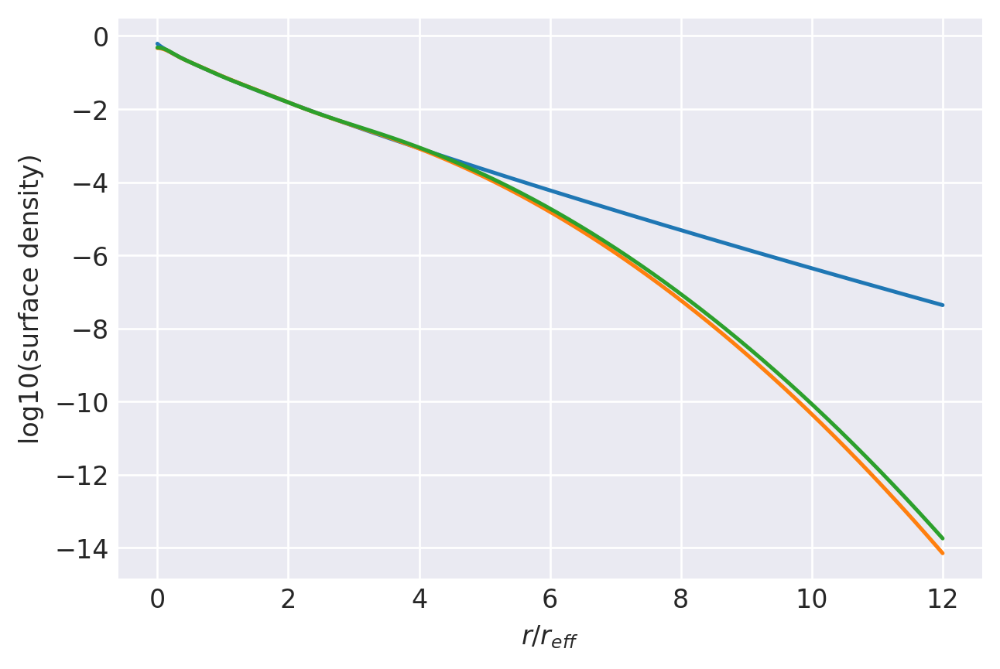

n=1.2: (
    normalize(np.array([3.1519205722e-01, 4.6105961983e-01, 1.9101500933e-01, 3.2733313627e-02])),
    np.array([1.8984714423e+00, 9.9502366855e-01, 4.9057128231e-01, 1.9805002861e-01]),
),
[1, 24000]
0.9999954437033961 1.0000000314999826
prev.  chisq = -7.326129344130349
ws, re: (array([0.31519206, 0.46105962, 0.19101501, 0.03273331]), array([1.89847144, 0.99502367, 0.49057128, 0.19805003]))
         Current function value: -7.459697
         Iterations: 13
         Function evaluations: 694
         Gradient evaluations: 76
-7.459696578403017 [-7.77733683e-01  7.07926591e-01  1.74607614e+00  2.83551899e-01
 -1.56582054e-03 -3.11965596e-01 -7.08732994e-01]
0.9999954437033961 1.0000000322904583


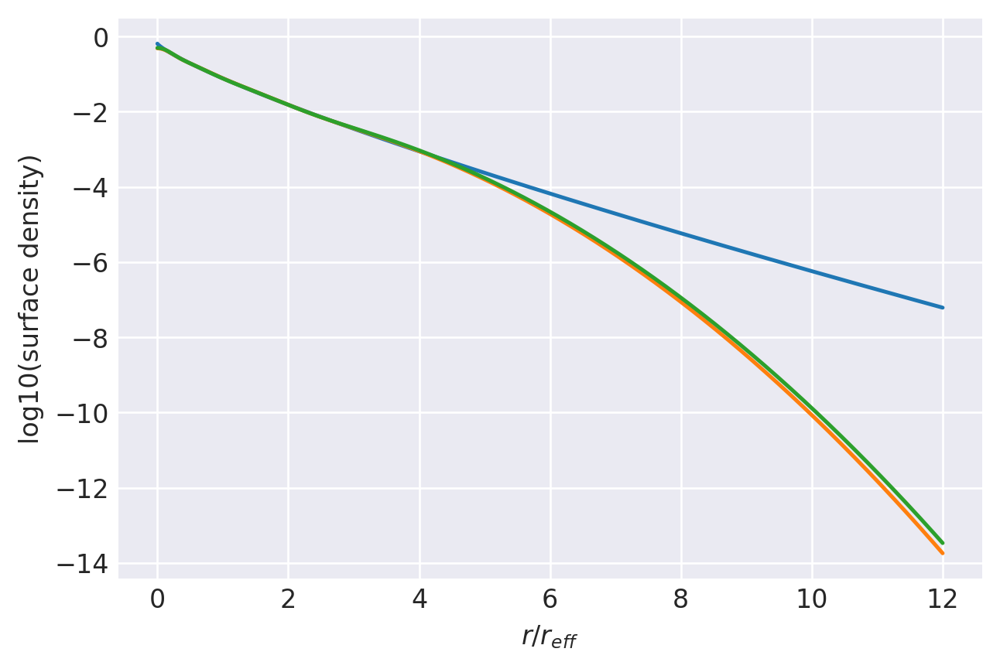

n=1.225: (
    normalize(np.array([3.1480853466e-01, 4.5903912334e-01, 1.9255904102e-01, 3.3593300986e-02])),
    np.array([1.9211085247e+00, 9.9640105674e-01, 4.8756711263e-01, 1.9555413609e-01]),
),
[1, 24000]
0.9999934376205089 1.0000000322904583
prev.  chisq = -7.294549248595064
ws, re: (array([0.31480853, 0.45903912, 0.19255904, 0.0335933 ]), array([1.92110852, 0.99640106, 0.48756711, 0.19555414]))
         Current function value: -7.411910
         Iterations: 12
         Function evaluations: 605
         Gradient evaluations: 66
-7.411909609774744 [-7.78957628e-01  6.93692713e-01  1.72898372e+00  2.88545063e-01
 -1.02837289e-03 -3.14640666e-01 -7.14213212e-01]
0.9999934376205089 1.0000000330939012


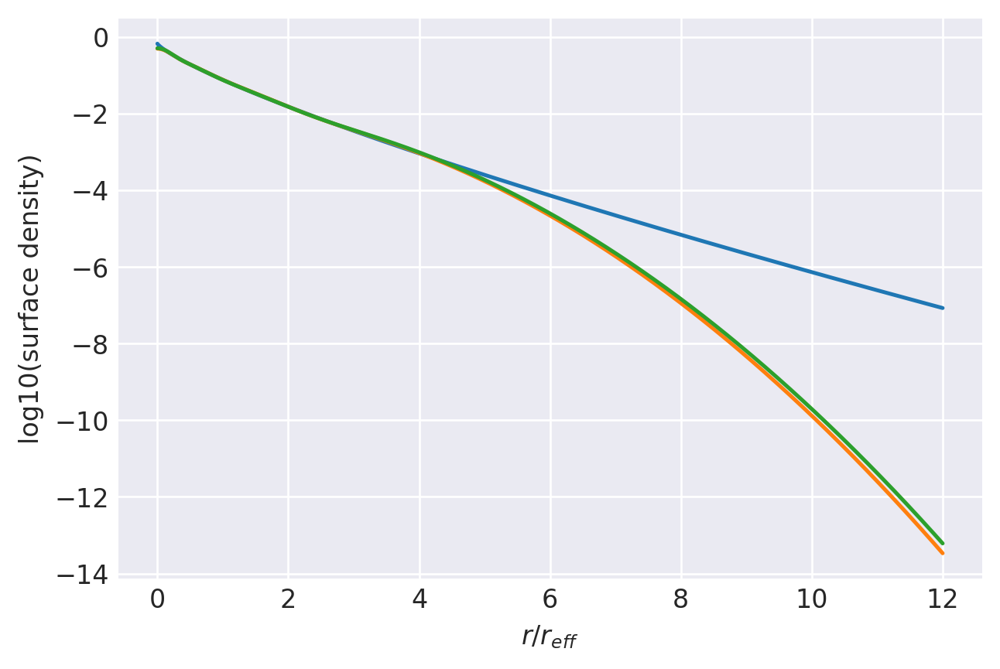

n=1.25: (
    normalize(np.array([3.1454458451e-01, 4.5705336686e-01, 1.9397783557e-01, 3.4424213069e-02])),
    np.array([1.9433233215e+00, 9.9763488522e-01, 4.8457313651e-01, 1.9310200700e-01]),
),
[1, 24000]
0.9999907689294948 1.0000000330939012
prev.  chisq = -7.262608384684373
ws, re: (array([0.31454458, 0.45705337, 0.19397784, 0.03442421]), array([1.94332332, 0.99763489, 0.48457314, 0.19310201]))
Optimization terminated successfully.
         Current function value: -7.365976
         Iterations: 12
         Function evaluations: 162
         Gradient evaluations: 18
-7.365975871690865 [-7.79682904e-01  6.80238872e-01  1.71262946e+00  2.93390470e-01
 -5.51563896e-04 -3.17322479e-01 -7.19665446e-01]
0.9999907689294948 1.0000000339103157


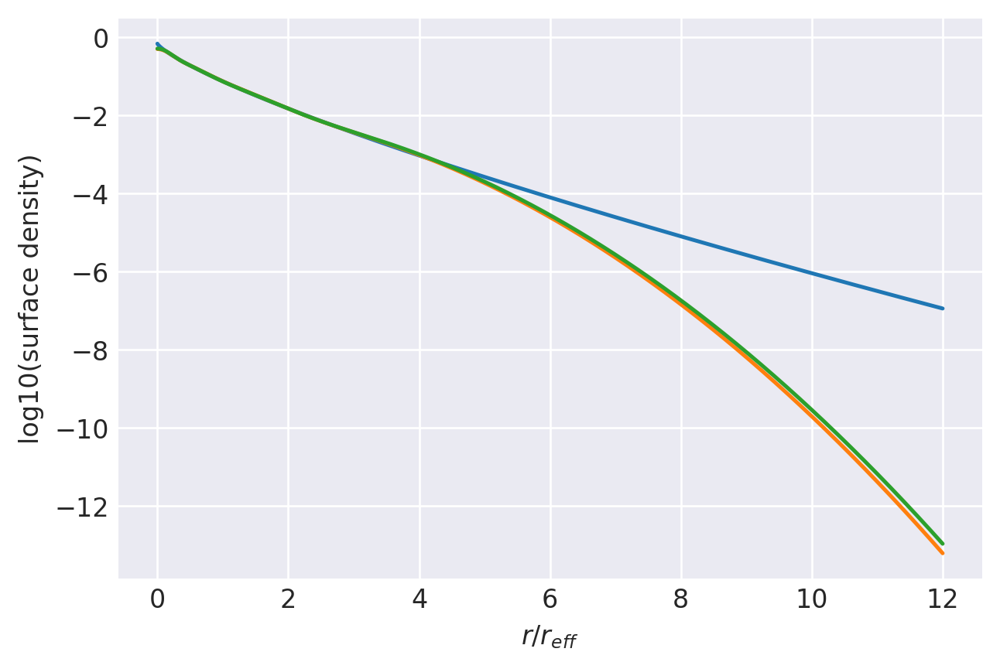

n=1.275: (
    normalize(np.array([3.1438823151e-01, 4.5510361329e-01, 1.9528121345e-01, 3.5226941742e-02])),
    np.array([1.9651263110e+00, 9.9873078333e-01, 4.8159006718e-01, 1.9069291337e-01]),
),
[1, 24000]
0.9999872885935822 1.0000000339103157
prev.  chisq = -7.230505605611886
ws, re: (array([0.31438823, 0.45510361, 0.19528121, 0.03522694]), array([1.96512631, 0.99873078, 0.48159007, 0.19069291]))
Optimization terminated successfully.
         Current function value: -7.321776
         Iterations: 13
         Function evaluations: 162
         Gradient evaluations: 18
-7.321776100915635 [-7.79959561e-01  6.67506058e-01  1.69696659e+00  2.98094718e-01
 -1.32670467e-04 -3.20010298e-01 -7.25089551e-01]
0.9999872885935822 1.0000000347396396


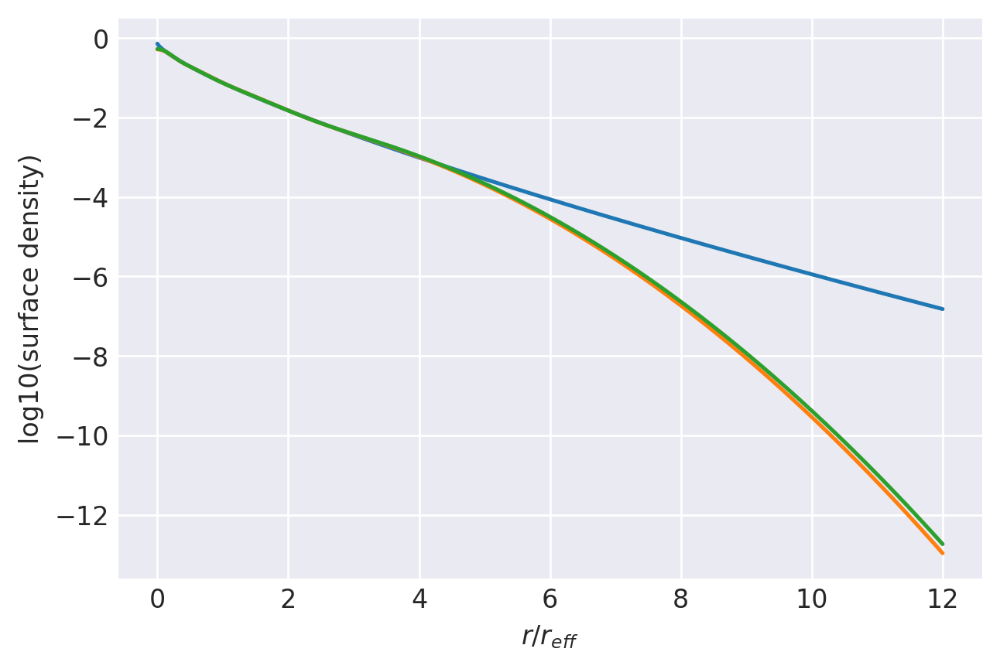

n=1.3: (
    normalize(np.array([3.1432860165e-01, 4.5319073892e-01, 1.9647827193e-01, 3.6002387496e-02])),
    np.array([1.9865281260e+00, 9.9969456162e-01, 4.7861874264e-01, 1.8832607216e-01]),
),
[2, 24000]
0.9999811688166128 1.0000000347396396
prev.  chisq = -7.137662528282959
ws, re: (array([0.3143286 , 0.45319074, 0.19647827, 0.03600239]), array([1.98652813, 0.99969456, 0.47861874, 0.18832607]))
         Current function value: -7.265912
         Iterations: 13
         Function evaluations: 759
         Gradient evaluations: 83
-7.265912059899452 [-7.79702441e-01  6.51716664e-01  1.67727719e+00  3.04096852e-01
  3.34484641e-04 -3.23567431e-01 -7.32206615e-01]
0.9999811688166128 1.0000000358538241


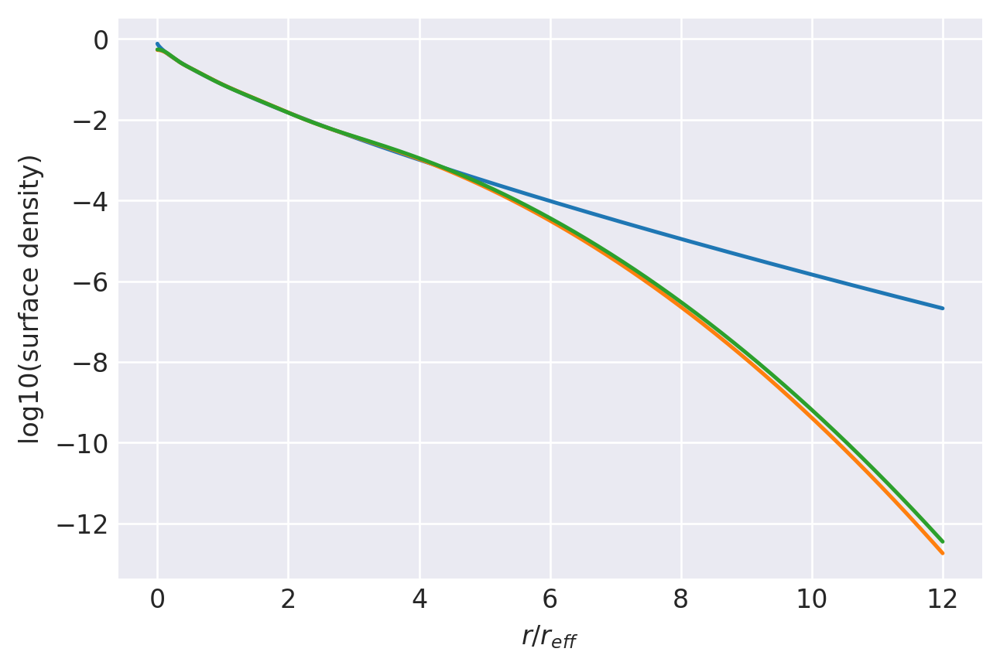

n=1.333: (
    normalize(np.array([3.1438402047e-01, 4.5072202839e-01, 1.9790840688e-01, 3.6985544257e-02])),
    np.array([2.0141733803e+00, 1.0007704760e+00, 4.7471457884e-01, 1.8526500170e-01]),
),
[2, 24000]
0.9999726339177898 1.0000000358538241
prev.  chisq = -7.094939495642633
ws, re: (array([0.31438402, 0.45072203, 0.19790841, 0.03698554]), array([2.01417338, 1.00077048, 0.47471458, 0.185265  ]))
Optimization terminated successfully.
         Current function value: -7.211074
         Iterations: 12
         Function evaluations: 171
         Gradient evaluations: 19
-7.211074355169193 [-7.78786463e-01  6.36556404e-01  1.65808066e+00  3.10047613e-01
  7.19374209e-04 -3.27241992e-01 -7.39489332e-01]
0.9999726339177898 1.0000000370241995


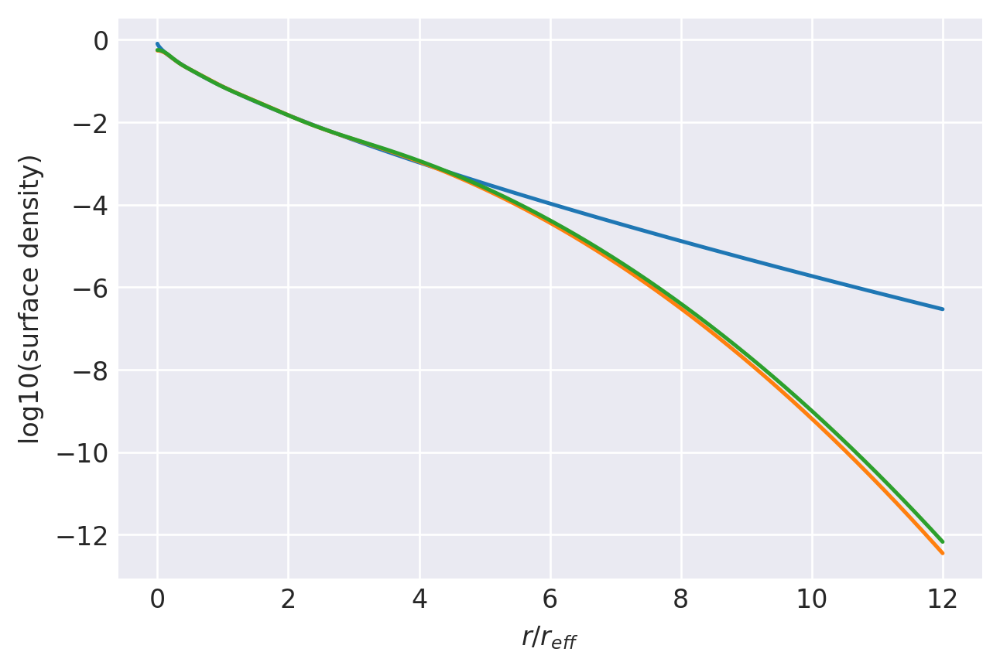

n=1.367: (
    normalize(np.array([3.1458148990e-01, 4.4824630752e-01, 1.9921995098e-01, 3.7952251599e-02])),
    np.array([2.0419617968e+00, 1.0016577930e+00, 4.7071496754e-01, 1.8218418248e-01]),
),
[3, 24000]
0.9999617084933684 1.0000000370241995
prev.  chisq = -7.065004382469214
ws, re: (array([0.31458149, 0.44824631, 0.19921995, 0.03795225]), array([2.0419618 , 1.00165779, 0.47071497, 0.18218418]))
         Current function value: -7.160307
         Iterations: 12
         Function evaluations: 632
         Gradient evaluations: 69
-7.160306585148349 [-7.77331675e-01  6.22821356e-01  1.64042006e+00  3.15606266e-01
  1.00251673e-03 -3.30817785e-01 -7.46509139e-01]
0.9999617084933684 1.0000000381804552


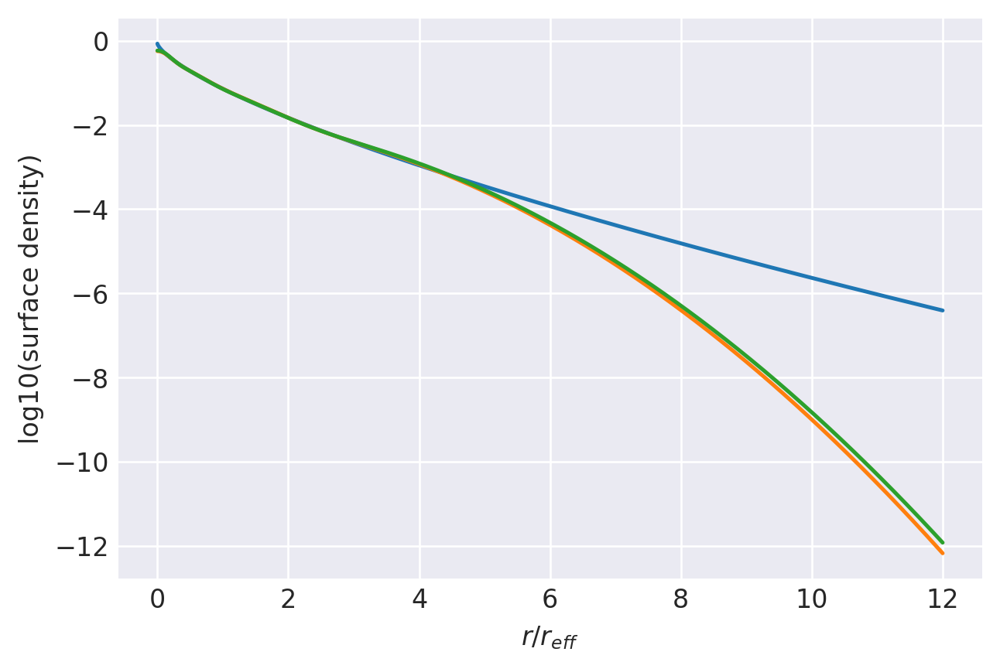

n=1.4: (
    normalize(np.array([3.1489525595e-01, 4.4590723918e-01, 2.0034993730e-01, 3.8847567566e-02])),
    np.array([2.0682653953e+00, 1.0023110464e+00, 4.6685521527e-01, 1.7926308296e-01]),
),
[3, 24000]
0.9999476740739993 1.0000000381804552
prev.  chisq = -7.028969326217495
ws, re: (array([0.31489526, 0.44590724, 0.20034994, 0.03884757]), array([2.0682654 , 1.00231105, 0.46685522, 0.17926308]))
Optimization terminated successfully.
         Current function value: -7.111749
         Iterations: 13
         Function evaluations: 297
         Gradient evaluations: 33
-7.111749121730644 [-7.75394361e-01  6.09967697e-01  1.62365011e+00  3.20964306e-01
  1.20218184e-03 -3.34401697e-01 -7.53483230e-01]
0.9999476740739993 1.0000000393544146


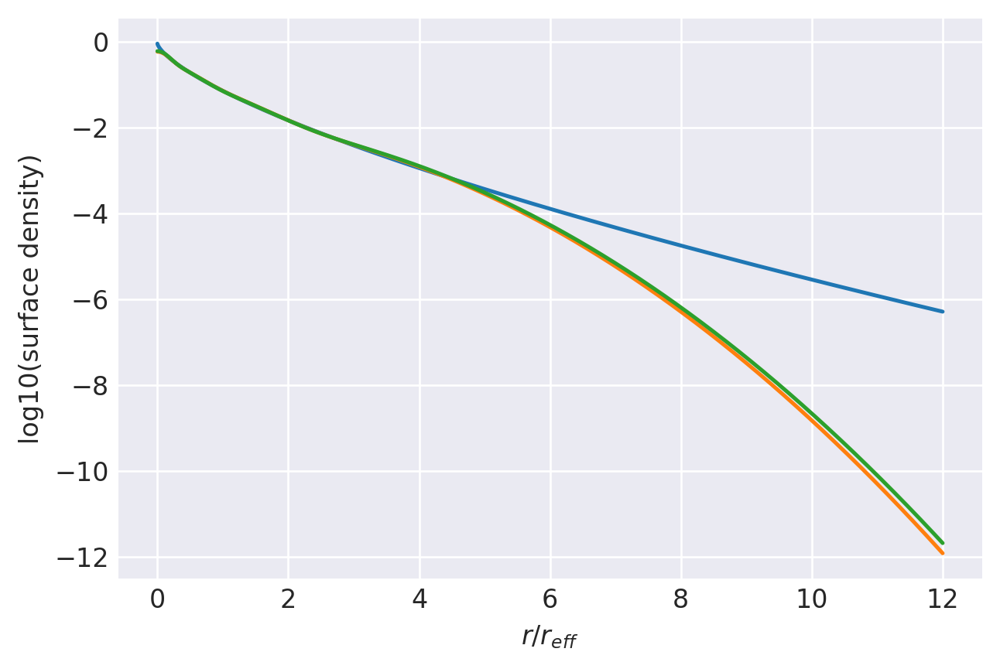

n=1.433: (
    normalize(np.array([3.1531335464e-01, 4.4363136889e-01, 2.0135296869e-01, 3.9702307776e-02])),
    np.array([2.0939403502e+00, 1.0027719608e+00, 4.6301845617e-01, 1.7640738813e-01]),
),
[4, 24000]
0.9999294019672034 1.0000000393544146
prev.  chisq = -6.987950834288692
ws, re: (array([0.31531335, 0.44363137, 0.20135297, 0.03970231]), array([2.09394035, 1.00277196, 0.46301846, 0.17640739]))
Optimization terminated successfully.
         Current function value: -7.063907
         Iterations: 12
         Function evaluations: 162
         Gradient evaluations: 18
-7.063907190647186 [-7.72938630e-01  5.97568178e-01  1.60722645e+00  3.26281059e-01
  1.32245414e-03 -3.38102770e-01 -7.60619405e-01]
0.9999294019672034 1.0000000405785565


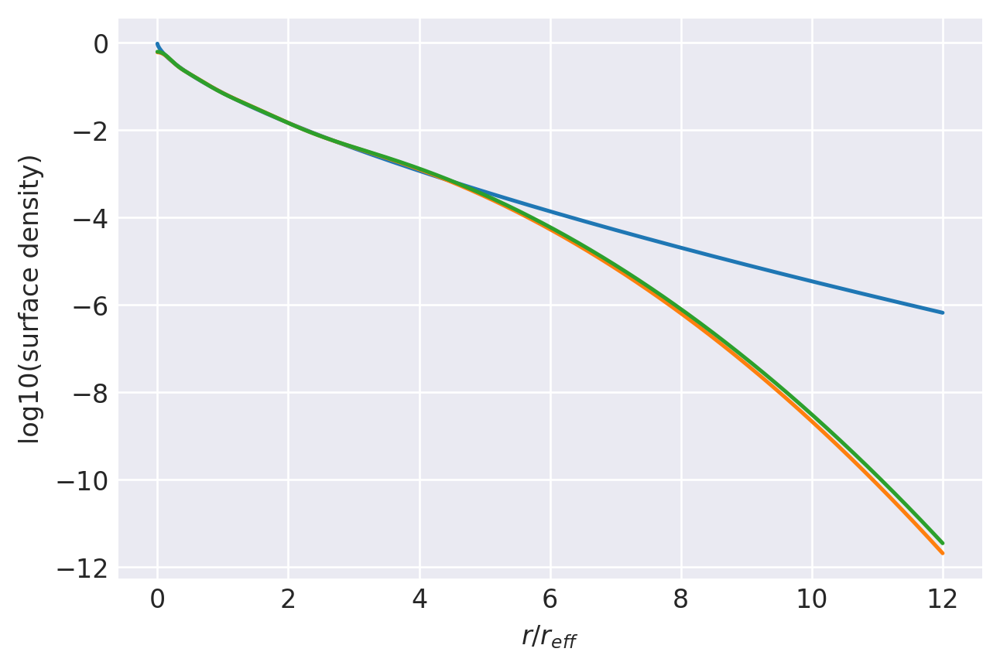

n=1.467: (
    normalize(np.array([3.1584376459e-01, 4.4134901429e-01, 2.0226471835e-01, 4.0542502768e-02])),
    np.array([2.1197325033e+00, 1.0030497041e+00, 4.5908936285e-01, 1.7353240855e-01]),
),
[4, 24000]
0.9999074016233933 1.0000000405785565
prev.  chisq = -6.9565176270483065
ws, re: (array([0.31584376, 0.44134901, 0.20226472, 0.0405425 ]), array([2.1197325 , 1.0030497 , 0.45908936, 0.17353241]))
Optimization terminated successfully.
         Current function value: -7.019395
         Iterations: 12
         Function evaluations: 162
         Gradient evaluations: 18
-7.019394879781056 [-7.70172091e-01  5.86287488e-01  1.59206698e+00  3.31256937e-01
  1.36185464e-03 -3.41702614e-01 -7.67502219e-01]
0.9999074016233933 1.0000000417755461


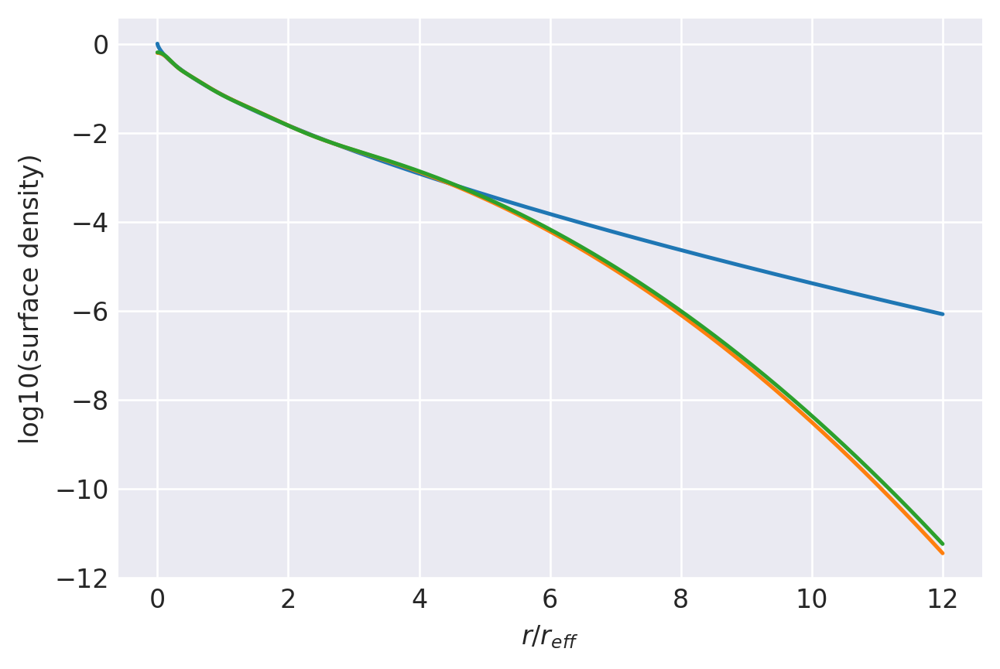

n=1.5: (
    normalize(np.array([3.1644188062e-01, 4.3919488938e-01, 2.0304304835e-01, 4.1320181654e-02])),
    np.array([2.1441587536e+00, 1.0031407079e+00, 4.5529972342e-01, 1.7080389933e-01]),
),
[5, 24000]
0.9998647896347695 1.0000000417755461
prev.  chisq = -6.843696615553129
ws, re: (array([0.31644188, 0.43919489, 0.20304305, 0.04132018]), array([2.14415875, 1.00314071, 0.45529972, 0.1708039 ]))
Optimization terminated successfully.
         Current function value: -6.955368
         Iterations: 12
         Function evaluations: 162
         Gradient evaluations: 18
-6.9553679630885235 [-7.65333230e-01  5.70477214e-01  1.57042417e+00  3.38460383e-01
  1.27991712e-03 -3.47170611e-01 -7.77844730e-01]
0.9998647896347695 1.0000000435877985


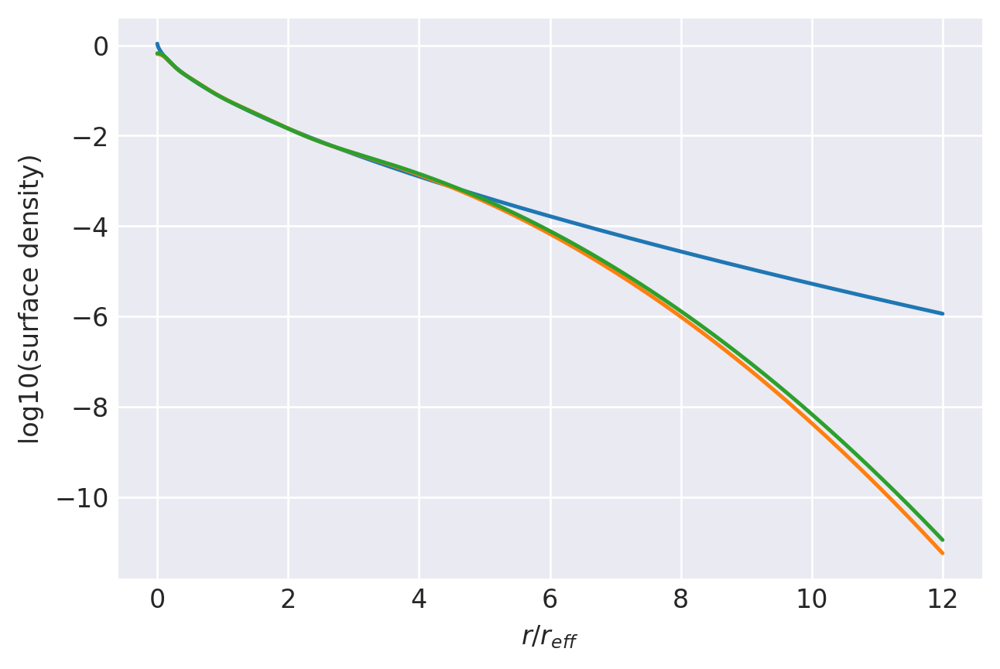

n=1.55: (
    normalize(np.array([3.1748948574e-01, 4.3603773260e-01, 2.0404103045e-01, 4.2431751204e-02])),
    np.array([2.1800195227e+00, 1.0029514651e+00, 4.4960319476e-01, 1.6678433983e-01]),
),
[6, 24000]
0.999809248153844 1.0000000435877985
prev.  chisq = -6.801482968919745
ws, re: (array([0.31748949, 0.43603773, 0.20404103, 0.04243175]), array([2.18001952, 1.00295147, 0.44960319, 0.16678434]))
         Current function value: -6.895078
         Iterations: 10
         Function evaluations: 605
         Gradient evaluations: 66
-6.895077586996232 [-7.59835288e-01  5.56057679e-01  1.55024601e+00  3.45284380e-01
  1.03769781e-03 -3.52653948e-01 -7.88088745e-01]
0.999809248153844 1.000000045362748


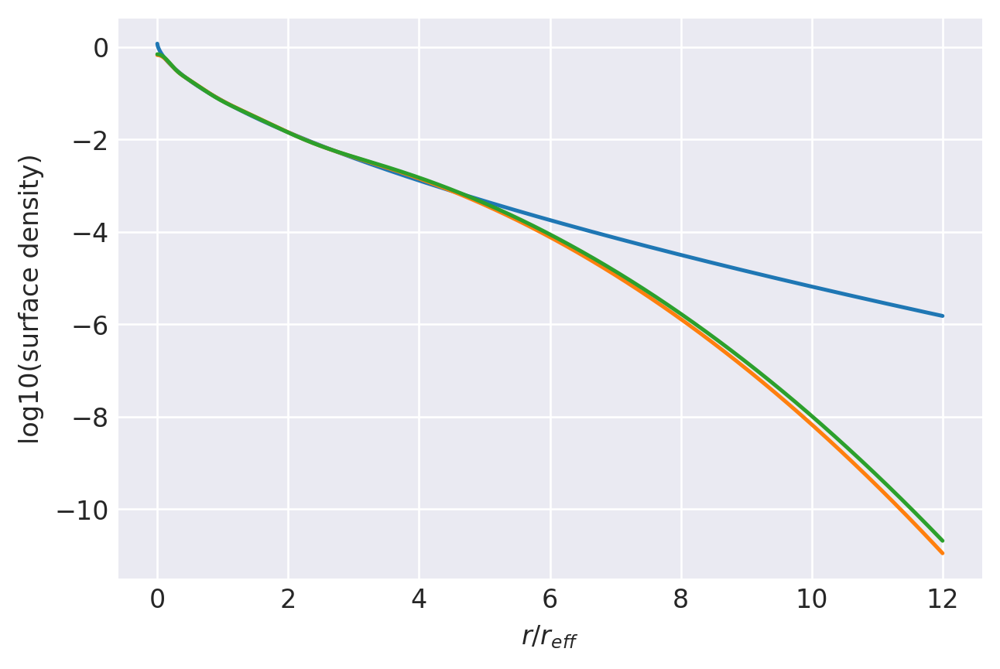

n=1.6: (
    normalize(np.array([3.1868202801e-01, 4.3300473779e-01, 2.0484581892e-01, 4.3467415280e-02])),
    np.array([2.2145443373e+00, 1.0023922444e+00, 4.4396225822e-01, 1.6289631328e-01]),
),
[7, 24000]
0.9997388353154099 1.000000045362748
prev.  chisq = -6.759283325237723
ws, re: (array([0.31868203, 0.43300474, 0.20484582, 0.04346742]), array([2.21454434, 1.00239224, 0.44396226, 0.16289631]))
Optimization terminated successfully.
         Current function value: -6.838186
         Iterations: 10
         Function evaluations: 162
         Gradient evaluations: 18
-6.838185961171686 [-7.53783612e-01  5.42876273e-01  1.53138721e+00  3.51751312e-01
  6.44271718e-04 -3.58151302e-01 -7.98236584e-01]
0.9997388353154099 1.0000000470421129


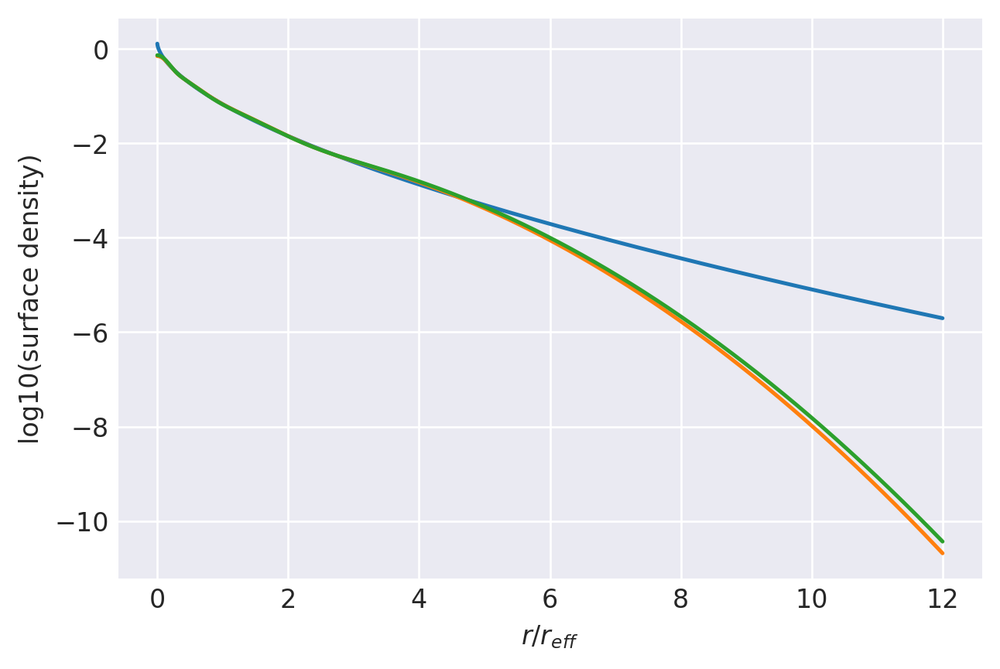

n=1.65: (
    normalize(np.array([3.1999743032e-01, 4.3008888071e-01, 2.0548133147e-01, 4.4432357499e-02])),
    np.array([2.2477671074e+00, 1.0014845914e+00, 4.3837794607e-01, 1.5913415993e-01]),
),
[8, 24000]
0.9996516909135026 1.0000000470421129
prev.  chisq = -6.717489978001206
ws, re: (array([0.31999743, 0.43008888, 0.20548133, 0.04443236]), array([2.24776711, 1.00148459, 0.43837795, 0.15913416]))
Optimization terminated successfully.
         Current function value: -6.784400
         Iterations: 10
         Function evaluations: 171
         Gradient evaluations: 19
-6.784400374385514 [-7.47269188e-01  5.30801160e-01  1.51372151e+00  3.57881703e-01
  1.08225254e-04 -3.63661218e-01 -8.08290219e-01]
0.9996516909135026 1.0000000485433773


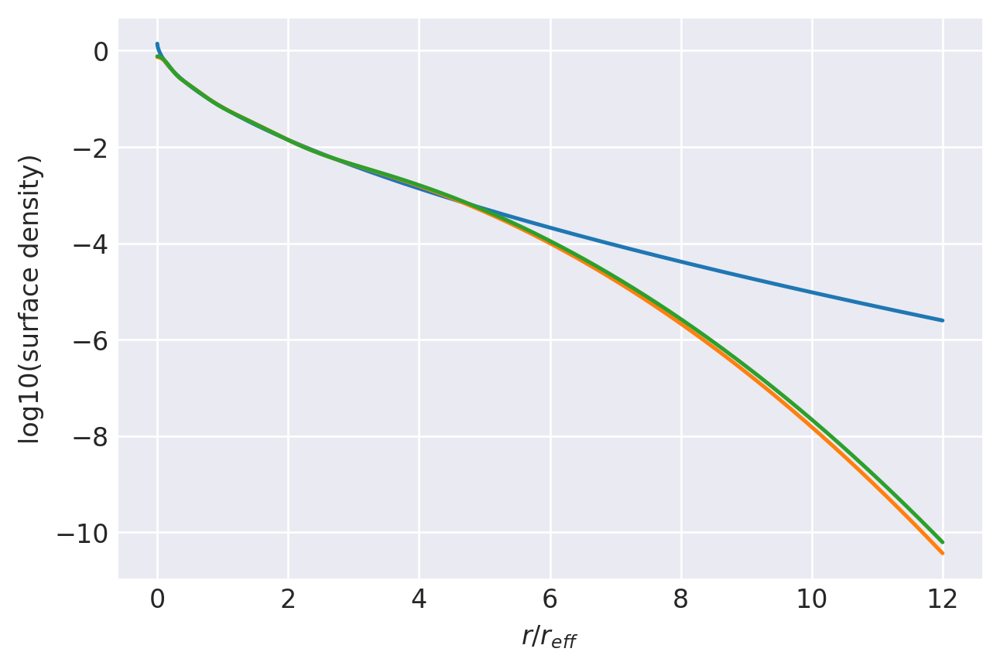

n=1.7: (
    normalize(np.array([3.2141662209e-01, 4.2728356197e-01, 2.0596836462e-01, 4.5331451319e-02])),
    np.array([2.2797210143e+00, 1.0002492289e+00, 4.3285135610e-01, 1.5549261979e-01]),
),
[9, 24000]
0.9995460765147542 1.0000000485433773
prev.  chisq = -6.676390862051445
ws, re: (array([0.32141662, 0.42728356, 0.20596836, 0.04533145]), array([2.27972101, 1.00024923, 0.43285136, 0.15549262]))
Optimization terminated successfully.
         Current function value: -6.733466
         Iterations: 10
         Function evaluations: 162
         Gradient evaluations: 18
-6.733466031291226 [-7.40369175e-01  5.19717530e-01  1.49713710e+00  3.63694170e-01
 -5.62505552e-04 -3.69182140e-01 -8.18251238e-01]
0.9995460765147542 1.0000000497553228


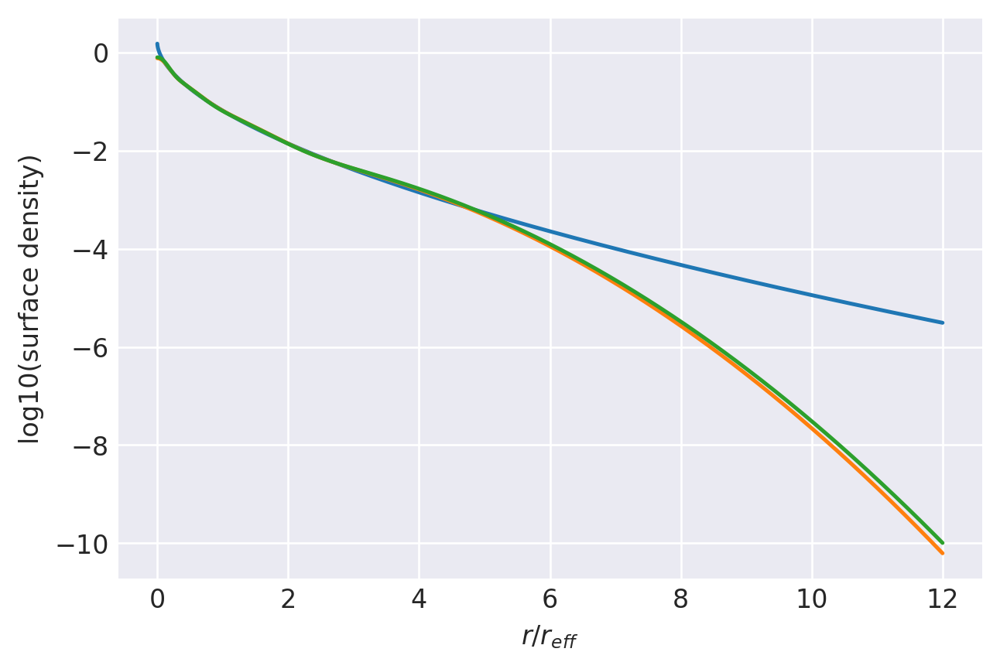

n=1.75: (
    normalize(np.array([3.2292342068e-01, 4.2458234122e-01, 2.0632493366e-01, 4.6169304440e-02])),
    np.array([2.3104372097e+00, 9.9870562153e-01, 4.2738360657e-01, 1.5196681535e-01]),
),
[10, 24000]
0.9994204058848846 1.0000000497553228
prev.  chisq = -6.636192183674562
ws, re: (array([0.32292342, 0.42458234, 0.20632493, 0.0461693 ]), array([2.31043721, 0.99870562, 0.42738361, 0.15196682]))
         Current function value: -6.685160
         Iterations: 10
         Function evaluations: 595
         Gradient evaluations: 65
-6.685160253640635 [-7.33151589e-01  5.09523790e-01  1.48153350e+00  3.69206059e-01
 -1.36014527e-03 -3.74712041e-01 -8.28120210e-01]
0.9994204058848846 1.0000000505343725


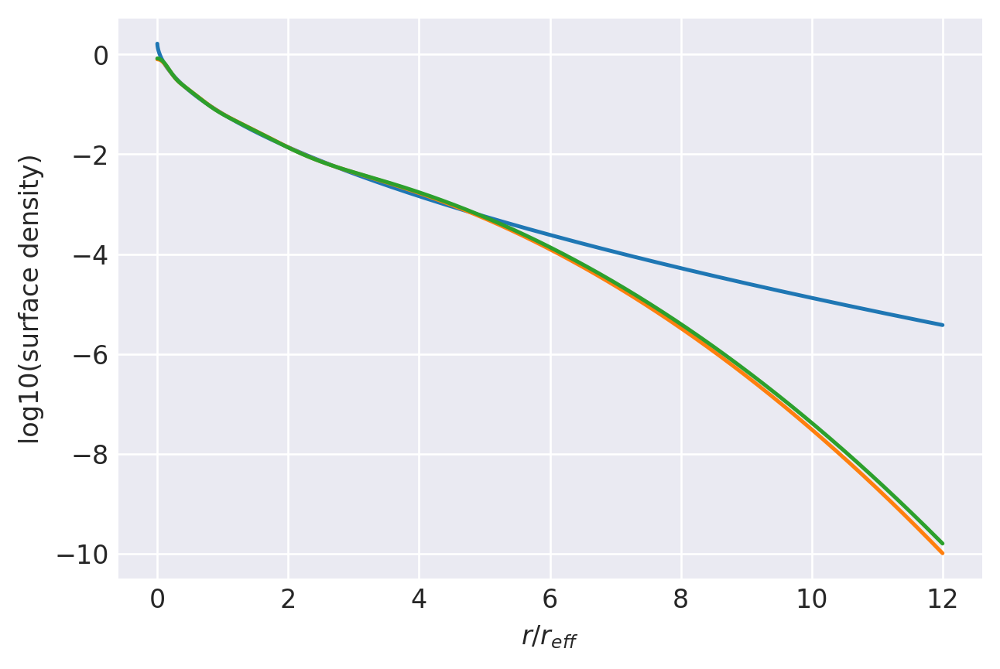

n=1.8: (
    normalize(np.array([3.2450351423e-01, 4.2197916446e-01, 2.0656695162e-01, 4.6950369685e-02])),
    np.array([2.3399472069e+00, 9.9687304891e-01, 4.2197620221e-01, 1.4855244028e-01]),
),
[12, 24000]
0.999273266155241 1.0000000505343725
prev.  chisq = -6.59736811727276
ws, re: (array([0.32450351, 0.42197916, 0.20656695, 0.04695037]), array([2.33994721, 0.99687305, 0.4219762 , 0.14855244]))
Optimization terminated successfully.
         Current function value: -6.639599
         Iterations: 9
         Function evaluations: 153
         Gradient evaluations: 17
-6.639599098959465 [-0.72570976  0.50006781  1.46672395  0.37442925 -0.00226984 -0.38022863
 -0.8378507 ]
0.999273266155241 1.0000000507005848


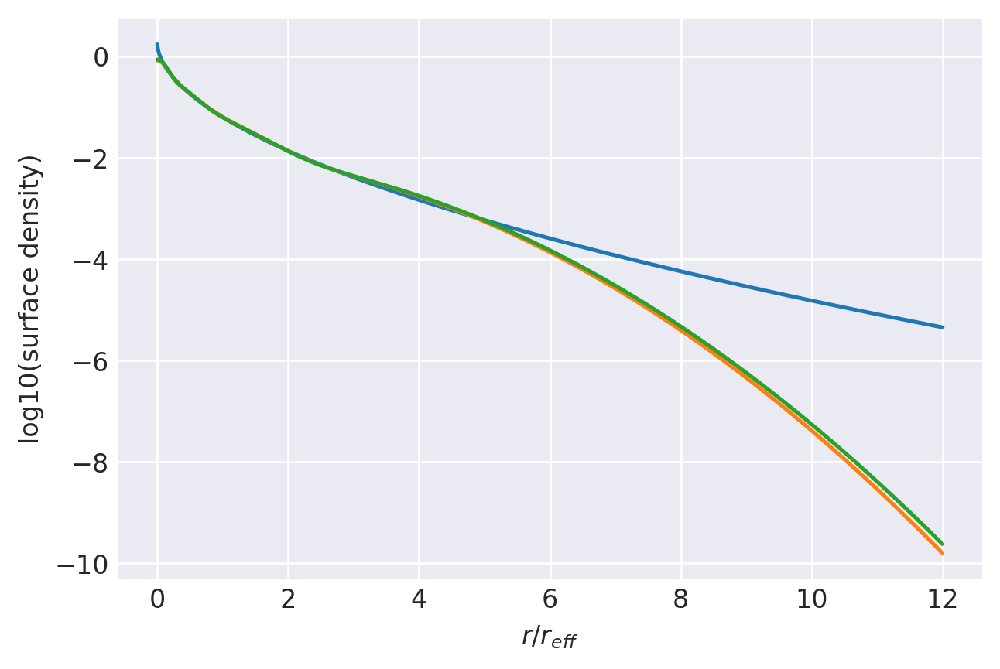

n=1.85: (
    normalize(np.array([3.2613689620e-01, 4.1946311531e-01, 2.0671498276e-01, 4.7685005737e-02])),
    np.array([2.3682592951e+00, 9.9478714481e-01, 4.1664998053e-01, 1.4526109194e-01]),
),
[13, 24000]
0.9991034306546077 1.0000000507005848
prev.  chisq = -6.55938025495437
ws, re: (array([0.3261369 , 0.41946312, 0.20671498, 0.04768501]), array([2.3682593 , 0.99478714, 0.41664998, 0.14526109]))
         Current function value: -6.596054
         Iterations: 10
         Function evaluations: 714
         Gradient evaluations: 78
-6.596054250743666 [-0.7180384   0.49137948  1.45279874  0.37938731 -0.00329665 -0.38576367
 -0.84752303]
0.9991034306546077 1.000000050044346


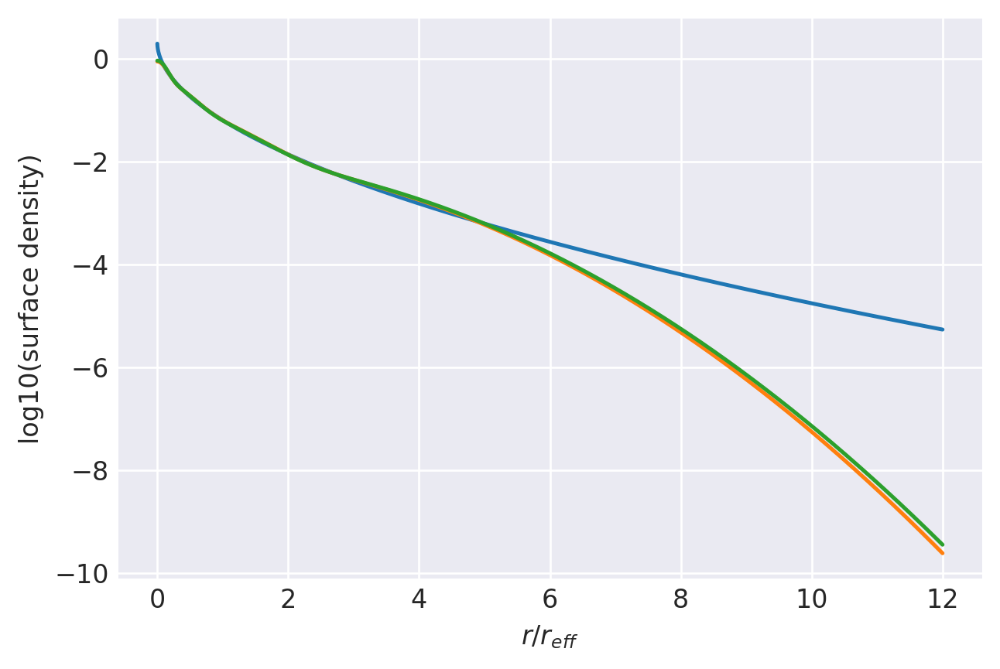

n=1.9: (
    normalize(np.array([3.2782508779e-01, 4.1703838773e-01, 2.0676998465e-01, 4.8366539827e-02])),
    np.array([2.3954511167e+00, 9.9243791028e-01, 4.1137352072e-01, 1.4206168739e-01]),
),
[15, 24000]
0.998909864591524 1.000000050044346
prev.  chisq = -6.523160936976464
ws, re: (array([0.32782509, 0.41703839, 0.20676998, 0.04836654]), array([2.39545112, 0.99243791, 0.41137352, 0.14206169]))
Optimization terminated successfully.
         Current function value: -6.555121
         Iterations: 9
         Function evaluations: 153
         Gradient evaluations: 17
-6.555120936706925 [-0.71029357  0.4832198   1.43943506  0.38409105 -0.0044088  -0.39125817
 -0.85701231]
0.998909864591524 1.000000048308962


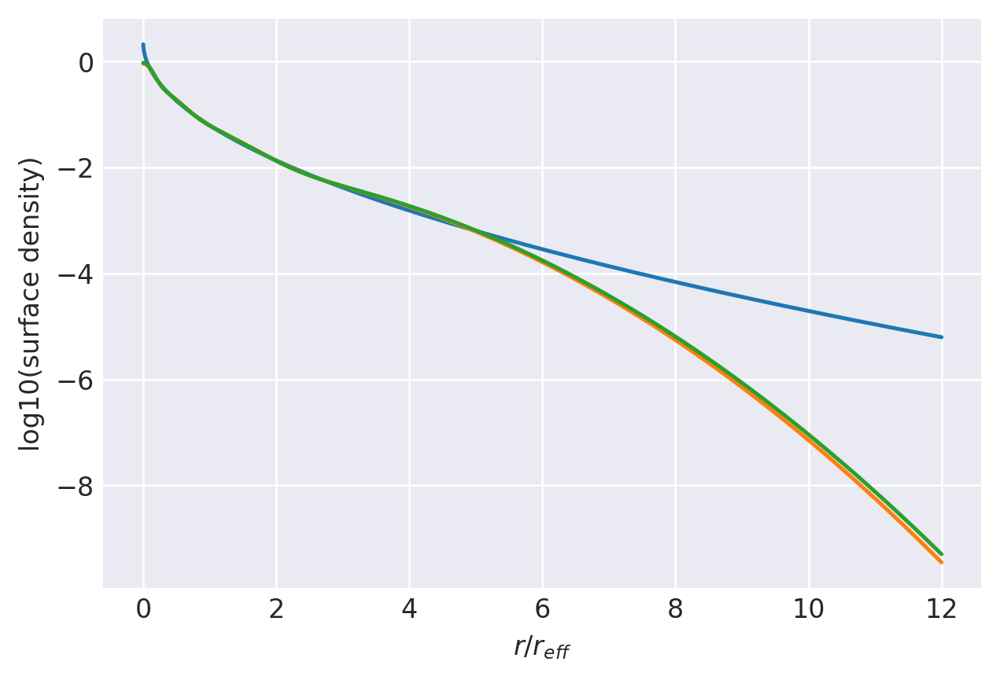

n=1.95: (
    normalize(np.array([3.2953397444e-01, 4.1468853043e-01, 2.0676212531e-01, 4.9015369813e-02])),
    np.array([2.4215366731e+00, 9.8989970610e-01, 4.0620178406e-01, 1.3899132229e-01]),
),
[16, 24000]
0.998691724858366 1.000000048308962
prev.  chisq = -6.487691722299859
ws, re: (array([0.32953397, 0.41468853, 0.20676213, 0.04901537]), array([2.42153667, 0.98989971, 0.40620178, 0.13899132]))
Optimization terminated successfully.
         Current function value: -6.515761
         Iterations: 9
         Function evaluations: 153
         Gradient evaluations: 17
-6.515760769699104 [-0.7023704   0.47573312  1.42687259  0.38855473 -0.00563223 -0.39677989
 -0.86647031]
0.998691724858366 1.000000045230111


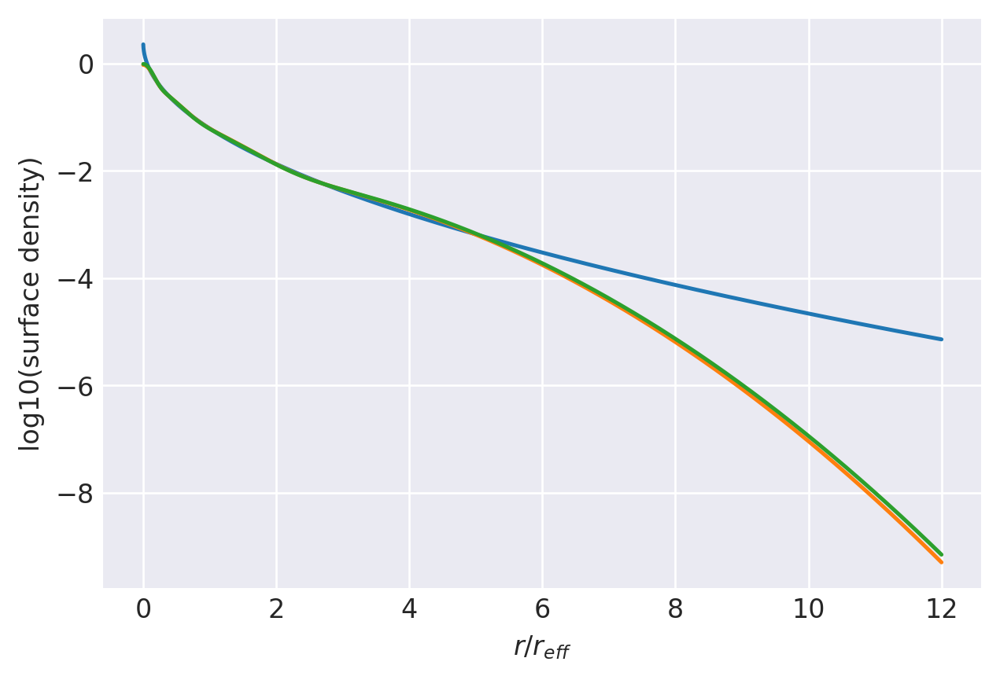

n=2.0: (
    normalize(np.array([3.3128688862e-01, 4.1242199648e-01, 2.0667663070e-01, 4.9614484193e-02])),
    np.array([2.4465535886e+00, 9.8711505046e-01, 4.0106993481e-01, 1.3599711178e-01]),
),
[18, 24000]
0.9984483551975021 1.000000045230111
prev.  chisq = -6.454298372113142
ws, re: (array([0.33128689, 0.412422  , 0.20667663, 0.04961448]), array([2.44655359, 0.98711505, 0.40106993, 0.13599711]))
Optimization terminated successfully.
         Current function value: -6.478988
         Iterations: 12
         Function evaluations: 162
         Gradient evaluations: 18
-6.478988353780478 [-0.69452737  0.46857225  1.41463736  0.39279989 -0.00690788 -0.40222213
 -0.87567975]
0.9984483551975021 1.0000000404671696


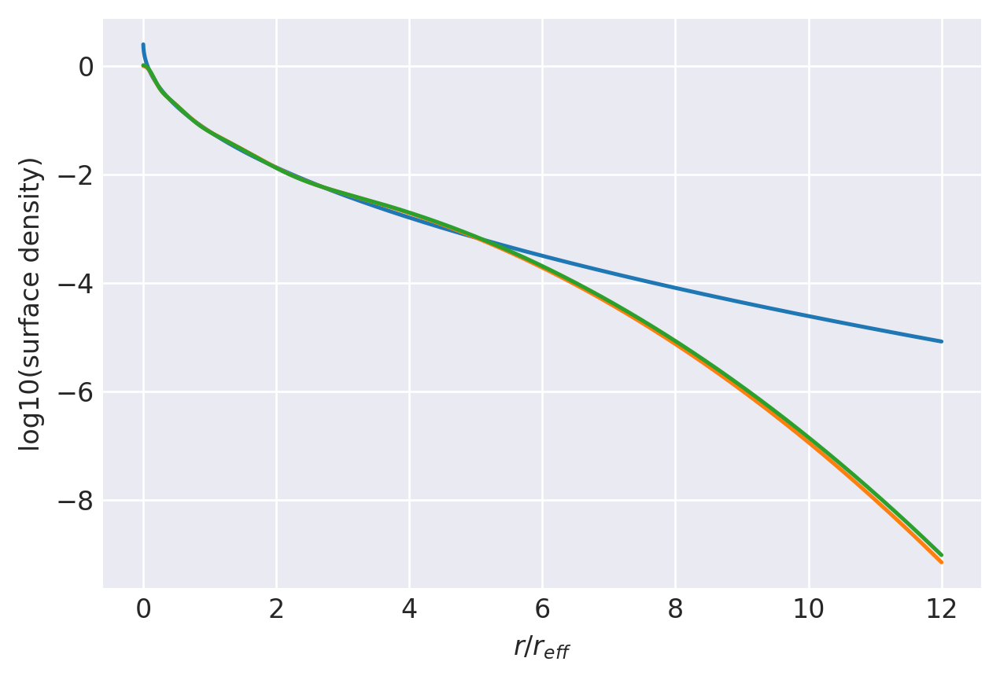

n=2.05: (
    normalize(np.array([3.3302669579e-01, 4.1021911004e-01, 2.0655781123e-01, 5.0196382943e-02])),
    np.array([2.4705855206e+00, 9.8421984046e-01, 3.9607539924e-01, 1.3314358517e-01]),
),
[19, 24000]
0.9981792778675241 1.0000000404671696
prev.  chisq = -6.421441613401786
ws, re: (array([0.3330267 , 0.41021911, 0.20655781, 0.05019638]), array([2.47058552, 0.98421984, 0.3960754 , 0.13314359]))
Optimization terminated successfully.
         Current function value: -6.443364
         Iterations: 13
         Function evaluations: 171
         Gradient evaluations: 19
-6.443363562464043 [-0.68651984  0.46203298  1.40316636  0.39682403 -0.00829467 -0.40770726
 -0.88489668]
0.9981792778675241 1.0000000337442632


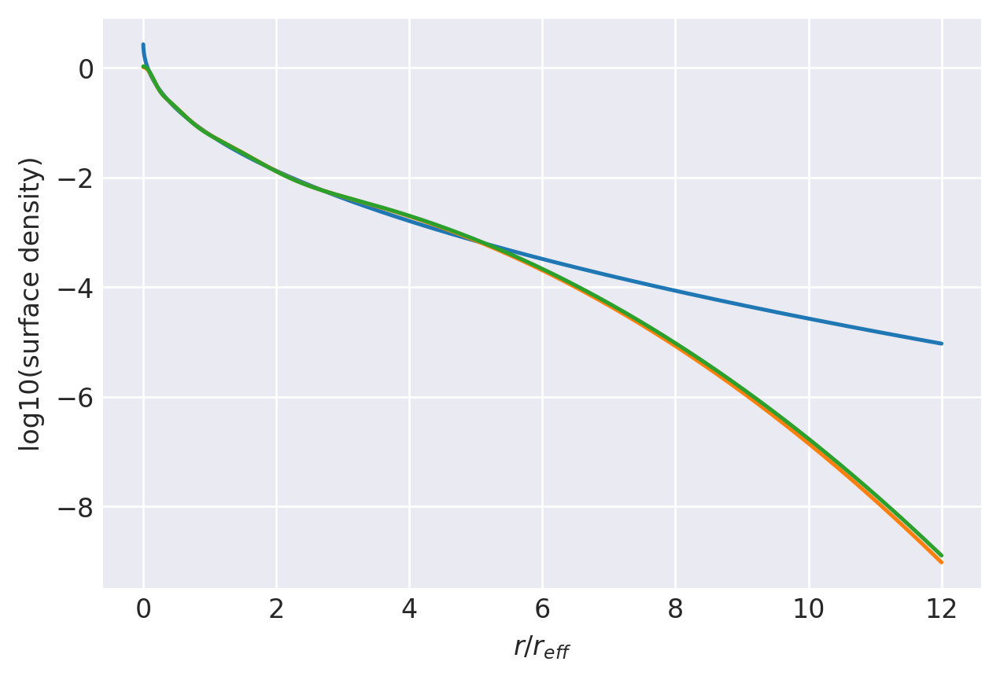

n=2.1: (
    normalize(np.array([3.3480769774e-01, 4.0809304583e-01, 2.0636993820e-01, 5.0729318233e-02])),
    np.array([2.4935841436e+00, 9.8108205179e-01, 3.9110443576e-01, 1.3034768573e-01]),
),
[21, 24000]
0.997884182807956 1.0000000337442632
prev.  chisq = -6.390948342839311
ws, re: (array([0.3348077 , 0.40809305, 0.20636994, 0.05072932]), array([2.49358414, 0.98108205, 0.39110444, 0.13034769]))
Optimization terminated successfully.
         Current function value: -6.410386
         Iterations: 12
         Function evaluations: 162
         Gradient evaluations: 18
-6.410386176565083 [-0.67875678  0.45561338  1.39177808  0.40066883 -0.0096926  -0.41306062
 -0.89377621]
0.997884182807956 1.000000024602546


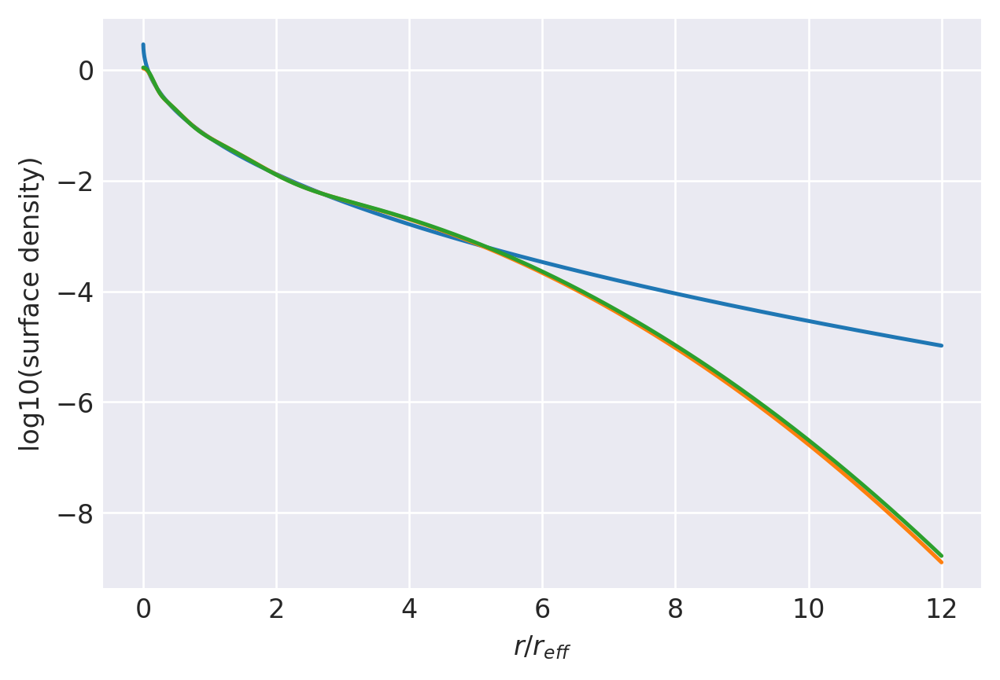

n=2.15: (
    normalize(np.array([3.3653883197e-01, 4.0602034344e-01, 2.0617816528e-01, 5.1262659300e-02])),
    np.array([2.5157578365e+00, 9.7792916934e-01, 3.8631304718e-01, 1.2770967270e-01]),
),
[23, 24000]
0.9975629151475797 1.000000024602546
prev.  chisq = -6.361901350734036
ws, re: (array([0.33653883, 0.40602034, 0.20617817, 0.05126266]), array([2.51575784, 0.97792917, 0.38631305, 0.12770967]))
Optimization terminated successfully.
         Current function value: -6.379272
         Iterations: 11
         Function evaluations: 153
         Gradient evaluations: 17
-6.379271967918728 [-0.67112764  0.44944359  1.38067191  0.4043402  -0.01112609 -0.41833914
 -0.90244158]
0.9975629151475797 1.0000000126692272


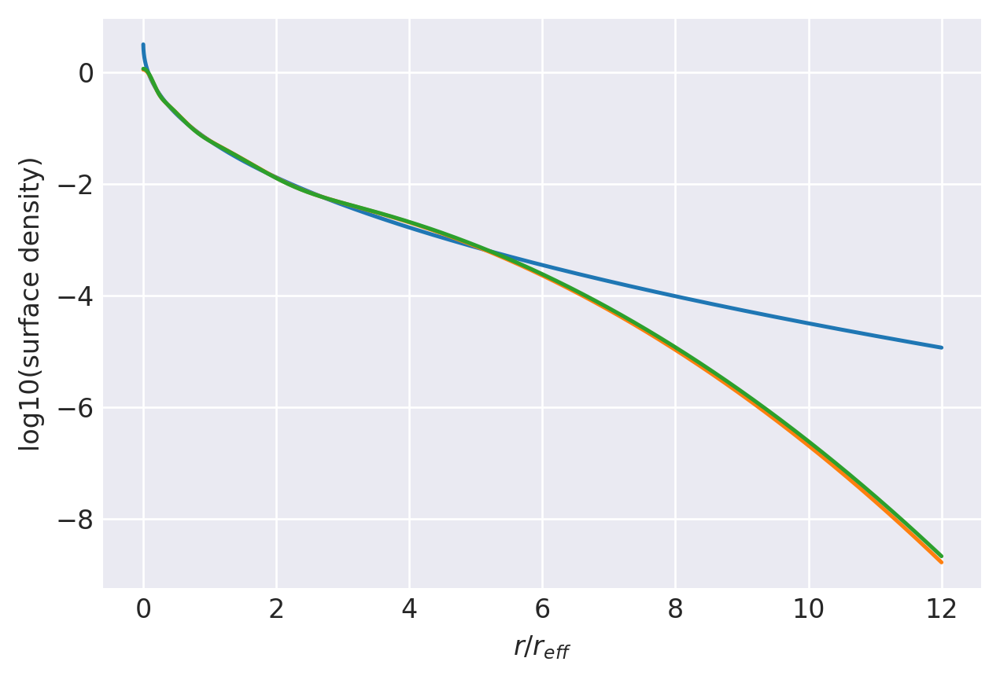

n=2.2: (
    normalize(np.array([3.3824438901e-01, 4.0400638976e-01, 2.0596711668e-01, 5.1782104540e-02])),
    np.array([2.5371152711e+00, 9.7470660711e-01, 3.8164612786e-01, 1.2518676471e-01]),
),
[25, 24000]
0.9972154617500036 1.0000000126692272
prev.  chisq = -6.334368028359935
ws, re: (array([0.33824439, 0.40400639, 0.20596712, 0.0517821 ]), array([2.53711527, 0.97470661, 0.38164613, 0.12518676]))
Optimization terminated successfully.
         Current function value: -6.349957
         Iterations: 12
         Function evaluations: 162
         Gradient evaluations: 18
-6.349956638543971 [-0.66367395  0.44346494  1.36978332  0.40785347 -0.01258204 -0.42352872
 -0.91087202]
0.9972154617500036 0.9999999975042498


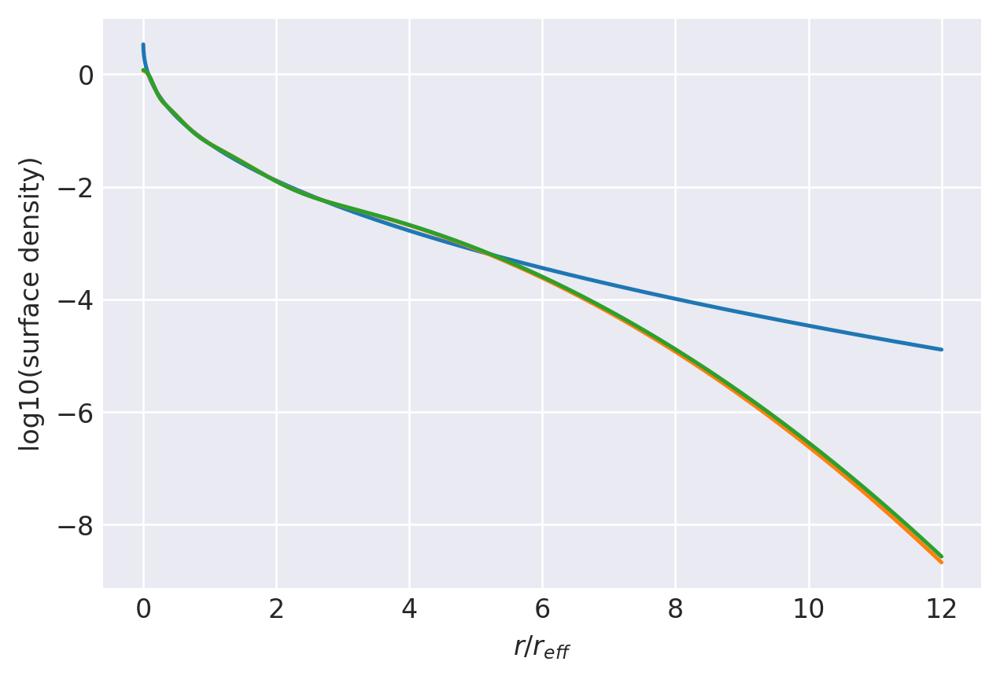

n=2.25: (
    normalize(np.array([3.3991479260e-01, 4.0204756693e-01, 2.0574505958e-01, 5.2292580888e-02])),
    np.array([2.5577227855e+00, 9.7144442814e-01, 3.7711280452e-01, 1.2278009877e-01]),
),
[27, 24000]
0.9968419373495957 0.9999999975042498
prev.  chisq = -6.308333007568617
ws, re: (array([0.33991479, 0.40204757, 0.20574506, 0.05229258]), array([2.55772279, 0.97144443, 0.3771128 , 0.1227801 ]))
Optimization terminated successfully.
         Current function value: -6.322378
         Iterations: 11
         Function evaluations: 153
         Gradient evaluations: 17
-6.322377784764008 [-0.65643903  0.43762065  1.35904615  0.4112244  -0.01404628 -0.42861368
 -0.91904436]
0.9968419373495957 0.9999999786228513


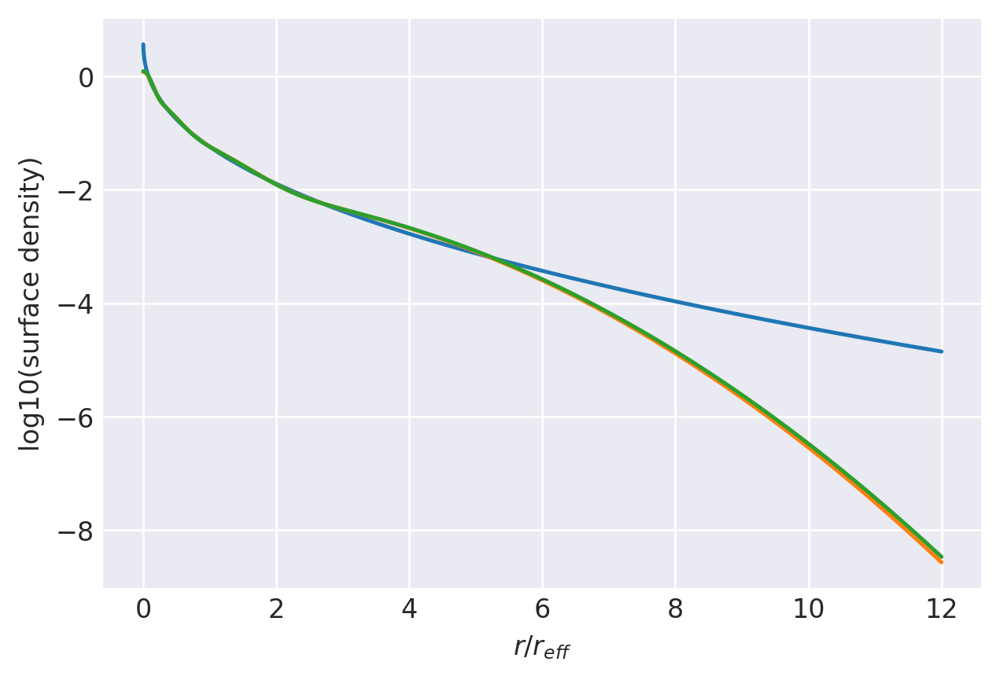

n=2.3: (
    normalize(np.array([3.4153998629e-01, 4.0014083889e-01, 2.0551993120e-01, 5.2799243621e-02])),
    np.array([2.5776527008e+00, 9.6817467377e-01, 3.7272310897e-01, 1.2049128672e-01]),
),
[29, 24000]
0.9964425707061946 0.9999999786228513
prev.  chisq = -6.283772817753359
ws, re: (array([0.34153999, 0.40014084, 0.20551993, 0.05279924]), array([2.5776527 , 0.96817467, 0.37272311, 0.12049129]))
Optimization terminated successfully.
         Current function value: -6.296474
         Iterations: 12
         Function evaluations: 153
         Gradient evaluations: 17
-6.296473984193273 [-0.64945874  0.43186005  1.34840559  0.41446777 -0.01550563 -0.43357967
 -0.92693788]
0.9964425707061946 0.9999999554929441


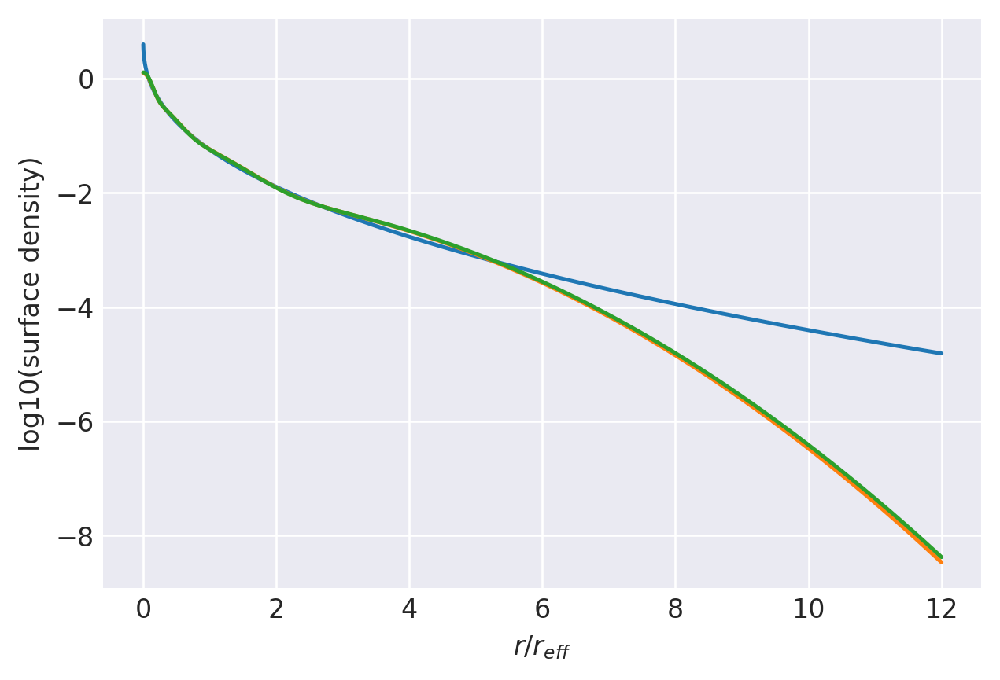

n=2.35: (
    normalize(np.array([3.4311152022e-01, 3.9828314049e-01, 2.0529872041e-01, 5.3306618888e-02])),
    np.array([2.5969750287e+00, 9.6492680106e-01, 3.6848543902e-01, 1.1832107946e-01]),
),
[31, 24000]
0.9960176910998889 0.9999999554929441
prev.  chisq = -6.26065812730283
ws, re: (array([0.34311152, 0.39828314, 0.20529872, 0.05330662]), array([2.59697503, 0.9649268 , 0.36848544, 0.11832108]))
Optimization terminated successfully.
         Current function value: -6.272184
         Iterations: 10
         Function evaluations: 153
         Gradient evaluations: 17
-6.272184181694609 [-0.64276519  0.42613725  1.33780834  0.41759789 -0.01694724 -0.43841229
 -0.93453178]
0.9960176910998889 0.9999999275218446


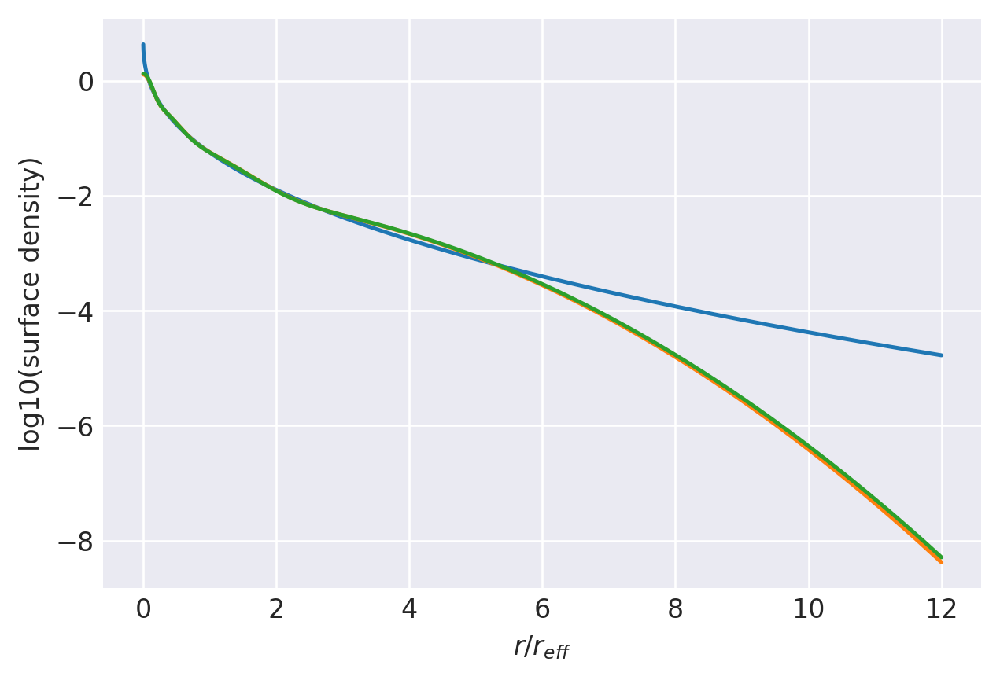

n=2.4: (
    normalize(np.array([3.4462173263e-01, 3.9647167540e-01, 2.0508749570e-01, 5.3819096276e-02])),
    np.array([2.6157599670e+00, 9.6172909602e-01, 3.6440784147e-01, 1.1627014656e-01]),
),
[33, 24000]
0.9955677153976663 0.9999999275218446
prev.  chisq = -6.238953409819561
ws, re: (array([0.34462173, 0.39647168, 0.2050875 , 0.0538191 ]), array([2.61575997, 0.9617291 , 0.36440784, 0.11627015]))
Optimization terminated successfully.
         Current function value: -6.249447
         Iterations: 9
         Function evaluations: 144
         Gradient evaluations: 16
-6.249447330139848 [-0.63638725  0.42041102  1.32720915  0.42062851 -0.01835872 -0.44309809
 -0.94180733]
0.9955677153976663 0.9999998940426698


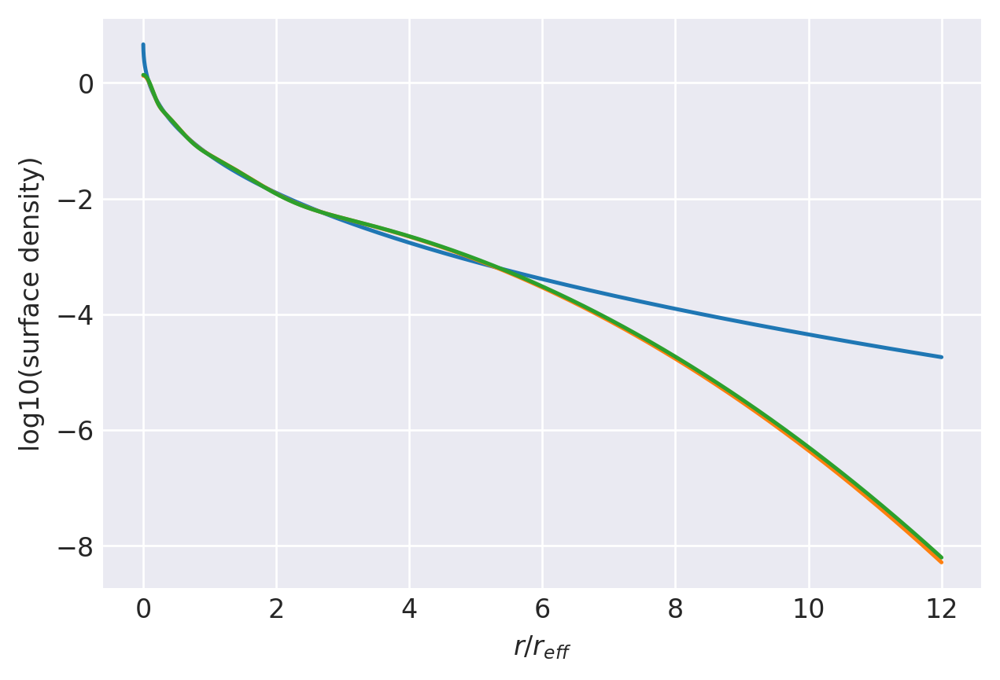

n=2.45: (
    normalize(np.array([3.4606366337e-01, 3.9470393918e-01, 2.0489174484e-01, 5.4340652611e-02])),
    np.array([2.6340772412e+00, 9.5860851736e-01, 3.6049721551e-01, 1.1433854853e-01]),
),
[35, 24000]
0.9950931358505836 0.9999998940426698
prev.  chisq = -6.2186191006506855
ws, re: (array([0.34606366, 0.39470394, 0.20489174, 0.05434065]), array([2.63407724, 0.95860852, 0.36049722, 0.11433855]))
Optimization terminated successfully.
         Current function value: -6.228202
         Iterations: 10
         Function evaluations: 153
         Gradient evaluations: 17
-6.228202241312654 [-0.6303528   0.41464195  1.31656593  0.42357322 -0.01972741 -0.44762323
 -0.94874614]
0.9950931358505836 0.9999998542908548


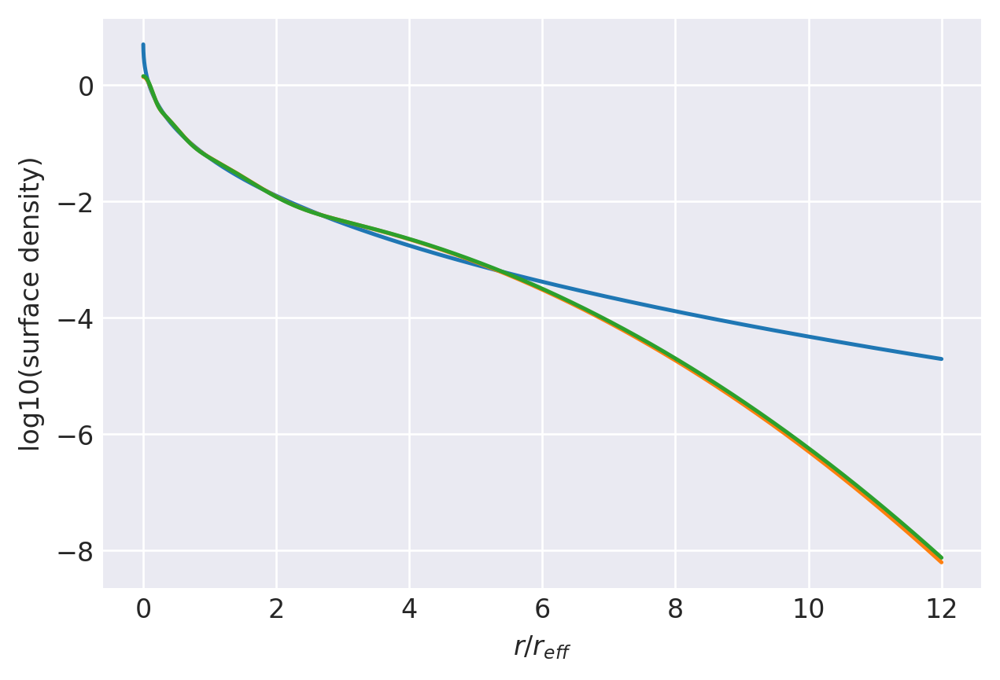

n=2.5: (
    normalize(np.array([3.4743054480e-01, 3.9297759143e-01, 2.0471668781e-01, 5.4875175951e-02])),
    np.array([2.6519981473e+00, 9.5559218168e-01, 3.5676050279e-01, 1.1252625304e-01]),
),
[37, 24000]
0.9945945087216512 0.9999998542908548
prev.  chisq = -6.199611424598677
ws, re: (array([0.34743054, 0.39297759, 0.20471669, 0.05487518]), array([2.65199815, 0.95559218, 0.3567605 , 0.11252625]))
Optimization terminated successfully.
         Current function value: -6.208388
         Iterations: 10
         Function evaluations: 144
         Gradient evaluations: 16
-6.208387602925502 [-0.62467794  0.40880176  1.30584798  0.42644351 -0.02104356 -0.45197752
 -0.955335  ]
0.9945945087216512 0.9999998074119676


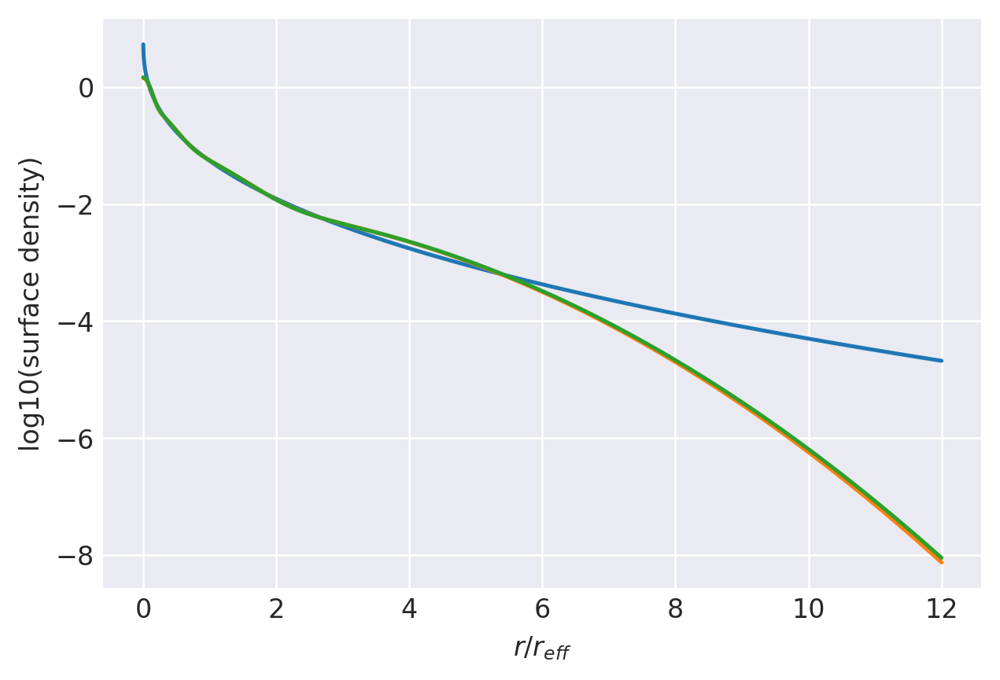

n=2.55: (
    normalize(np.array([3.4871827561e-01, 3.9129040446e-01, 2.0456573161e-01, 5.5425588318e-02])),
    np.array([2.6695834972e+00, 9.5270059951e-01, 3.5320145174e-01, 1.1083195658e-01]),
),
[40, 24000]
0.9940724437988419 0.9999998074119676
prev.  chisq = -6.18450972937799
ws, re: (array([0.34871828, 0.3912904 , 0.20456573, 0.05542559]), array([2.6695835 , 0.9527006 , 0.35320145, 0.11083196]))
Optimization terminated successfully.
         Current function value: -6.192388
         Iterations: 9
         Function evaluations: 144
         Gradient evaluations: 16
-6.1923877773466804 [-0.62045691  0.4017426   1.29358543  0.42943939 -0.0219733  -0.45564216
 -0.96064771]
0.9940724437988419 0.9999997482937617


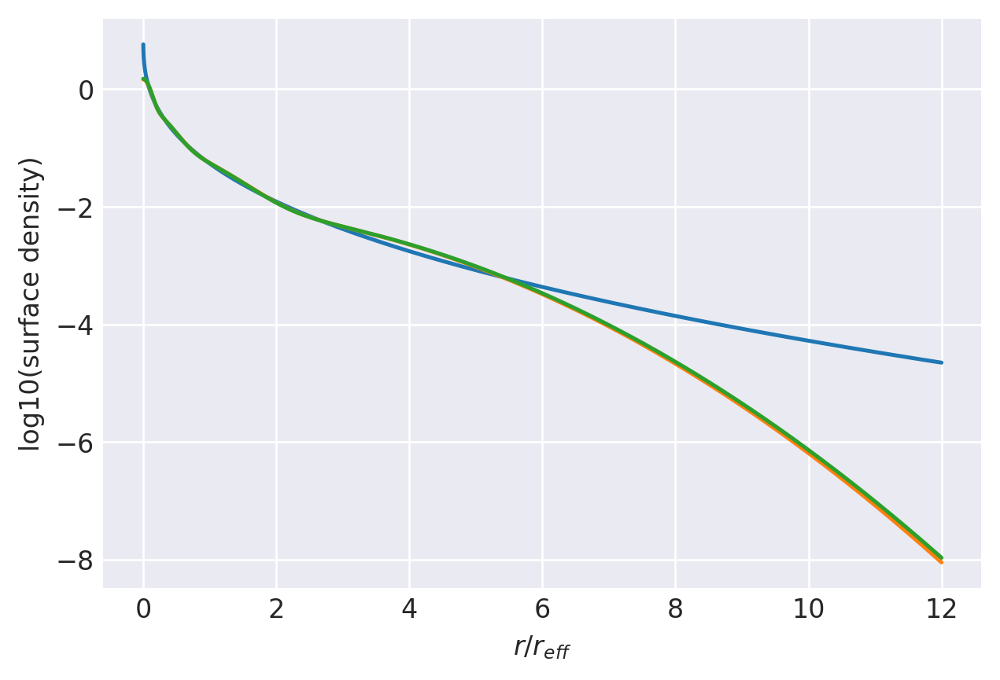

n=2.6: (
    normalize(np.array([3.4967754175e-01, 3.8961225943e-01, 2.0459322575e-01, 5.6116973072e-02])),
    np.array([2.6880626471e+00, 9.5066323188e-01, 3.5023362818e-01, 1.0948441078e-01]),
),
[42, 24000]
0.9935275948125303 0.9999997482937617
prev.  chisq = -6.167951749030254
ws, re: (array([0.34967754, 0.38961226, 0.20459323, 0.05611697]), array([2.68806265, 0.95066323, 0.35023363, 0.10948441]))
Optimization terminated successfully.
         Current function value: -6.175384
         Iterations: 9
         Function evaluations: 144
         Gradient evaluations: 16
-6.175384411515304 [-0.61564503  0.39558623  1.28252484  0.43221728 -0.02312002 -0.45957301
 -0.96641545]
0.9935275948125303 0.9999996827381026


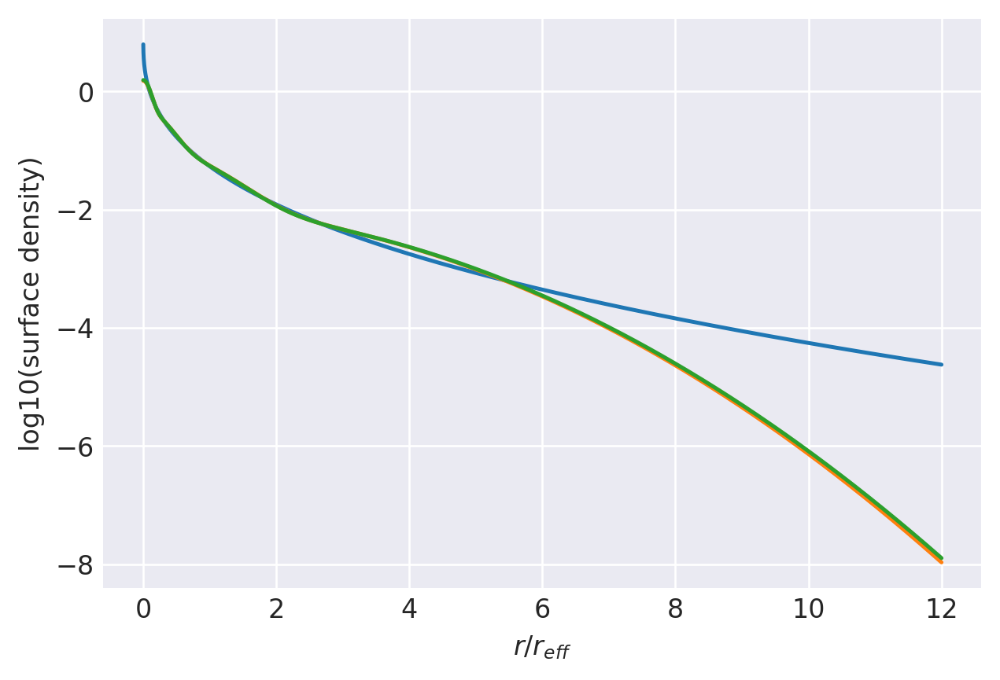

n=2.65: (
    normalize(np.array([3.5077256751e-01, 3.8799567644e-01, 2.0451292209e-01, 5.6718833972e-02])),
    np.array([2.7053114885e+00, 9.4815639442e-01, 3.4707792286e-01, 1.0803999440e-01]),
),
[44, 24000]
0.9929606507504876 0.9999996827381026
prev.  chisq = -6.1527637512054225
ws, re: (array([0.35077257, 0.38799568, 0.20451292, 0.05671883]), array([2.70531149, 0.94815639, 0.34707792, 0.10803999]))
Optimization terminated successfully.
         Current function value: -6.159621
         Iterations: 9
         Function evaluations: 144
         Gradient evaluations: 16
-6.159620662630834 [-0.61122574  0.38929611  1.27133182  0.43495188 -0.02418772 -0.46330719
 -0.97180678]
0.9929606507504876 0.9999996063332279


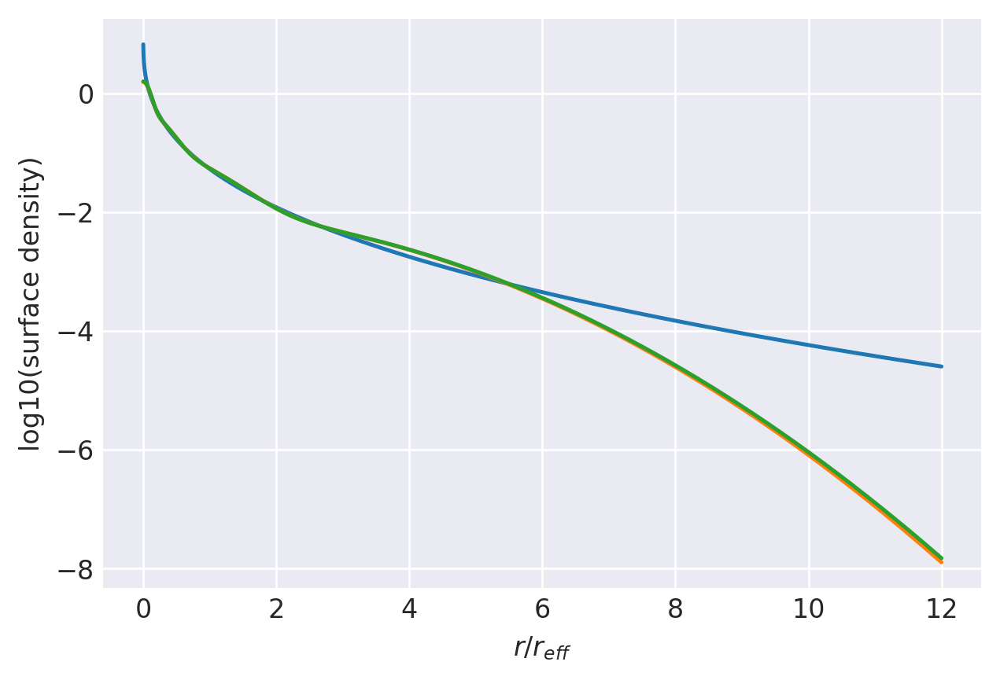

n=2.7: (
    normalize(np.array([3.5177963978e-01, 3.8641273959e-01, 2.0446406732e-01, 5.7343553314e-02])),
    np.array([2.7223996478e+00, 9.4582824710e-01, 3.4410644535e-01, 1.0670707549e-01]),
),
[47, 24000]
0.9923723280444858 0.9999996063332279
prev.  chisq = -6.1417467246454125
ws, re: (array([0.35177964, 0.38641274, 0.20446407, 0.05734355]), array([2.72239965, 0.94582825, 0.34410645, 0.10670708]))
Optimization terminated successfully.
         Current function value: -6.147875
         Iterations: 10
         Function evaluations: 144
         Gradient evaluations: 16
-6.147875044649583 [-0.60858817  0.38143599  1.25819535  0.43791489 -0.02473359 -0.46616573
 -0.97563245]
0.9923723280444858 0.9999995082132822


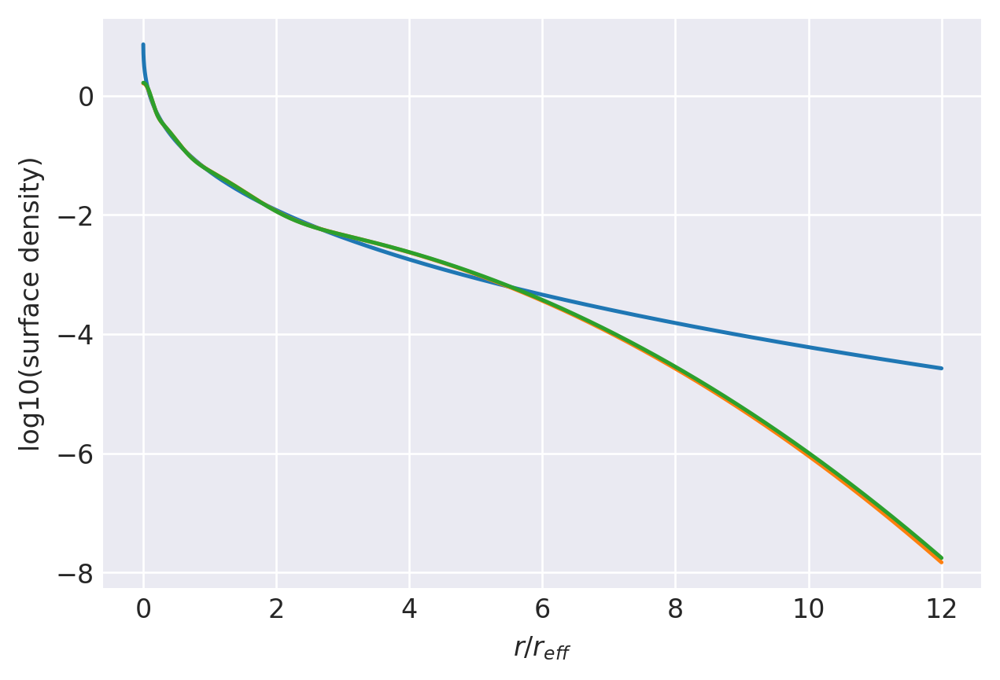

n=2.75: (
    normalize(np.array([3.5238132250e-01, 3.8482758170e-01, 2.0463944470e-01, 5.8151651106e-02])),
    np.array([2.7410369341e+00, 9.4464016849e-01, 3.4184896845e-01, 1.0577122895e-01]),
),
[49, 24000]
0.9917633635893499 0.9999995082132822
prev.  chisq = -6.128633777925684
ws, re: (array([0.35238132, 0.38482758, 0.20463944, 0.05815165]), array([2.74103693, 0.94464017, 0.34184897, 0.10577123]))
Optimization terminated successfully.
         Current function value: -6.134518
         Iterations: 9
         Function evaluations: 135
         Gradient evaluations: 15
-6.13451846489184 [-0.60504499  0.37476275  1.2466228   0.44060882 -0.02559197 -0.46944388
 -0.98018709]
0.9917633635893499 0.99999940285612


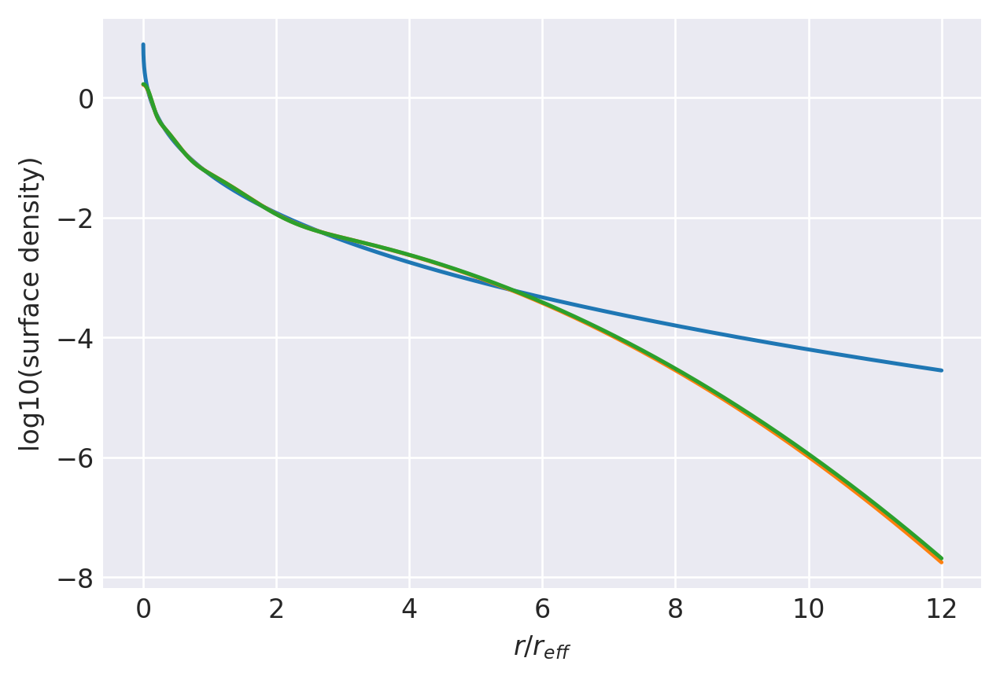

n=2.8: (
    normalize(np.array([3.5319032945e-01, 3.8330544123e-01, 2.0466760951e-01, 5.8836619809e-02])),
    np.array([2.7580924332e+00, 9.4277493934e-01, 3.3927833127e-01, 1.0466775421e-01]),
),
[52, 24000]
0.9911345085465334 0.99999940285612
prev.  chisq = -6.1200325165133
ws, re: (array([0.35319033, 0.38330544, 0.20466761, 0.05883662]), array([2.75809243, 0.94277494, 0.33927833, 0.10466775]))
Optimization terminated successfully.
         Current function value: -6.125269
         Iterations: 10
         Function evaluations: 144
         Gradient evaluations: 16
-6.125269160842197 [-0.60346257  0.36633231  1.23290707  0.4435936  -0.02584679 -0.47173636
 -0.98301435]
0.9911345085465334 0.9999992657379567


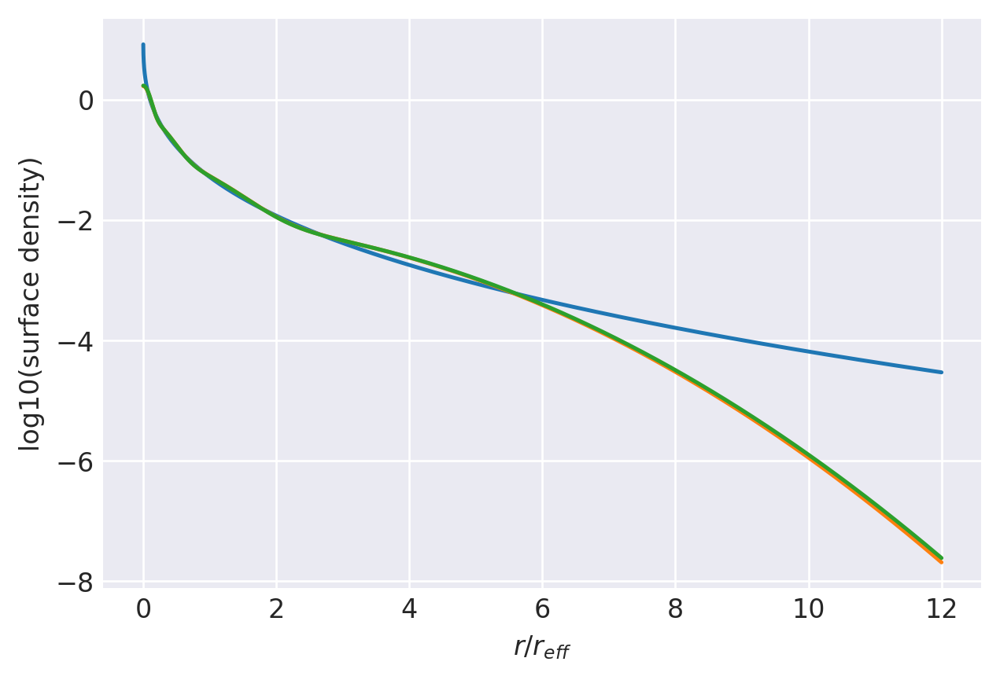

n=2.85: (
    normalize(np.array([3.5355191310e-01, 3.8177442249e-01, 2.0494395763e-01, 5.9729706777e-02])),
    np.array([2.7771132900e+00, 9.4222193382e-01, 3.3749212368e-01, 1.0398858089e-01]),
),
[55, 24000]
0.9904865228790861 0.9999992657379567
prev.  chisq = -6.112342950109445
ws, re: (array([0.35355191, 0.38177442, 0.20494396, 0.05972971]), array([2.77711329, 0.94222193, 0.33749212, 0.10398858]))
Optimization terminated successfully.
         Current function value: -6.117201
         Iterations: 10
         Function evaluations: 144
         Gradient evaluations: 16
-6.117201056278143 [-0.6024249   0.35759091  1.21889263  0.4466075  -0.02593708 -0.47372528
 -0.98532448]
0.9904865228790861 0.9999991020454205


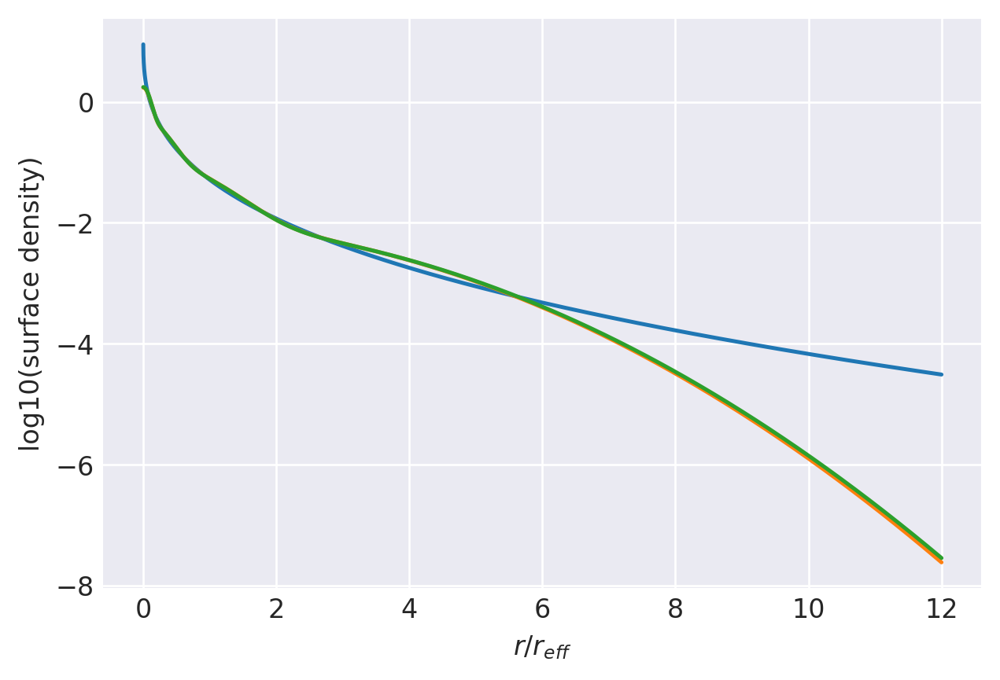

n=2.9: (
    normalize(np.array([3.5378911148e-01, 3.8026740966e-01, 2.0527342452e-01, 6.0670054345e-02])),
    np.array([2.7964528356e+00, 9.4202607546e-01, 3.3595005627e-01, 1.0343690559e-01]),
),
[57, 24000]
0.9898201705623486 0.9999991020454205
prev.  chisq = -6.102259579672239
ws, re: (array([0.35378911, 0.38026741, 0.20527342, 0.06067005]), array([2.79645284, 0.94202608, 0.33595006, 0.10343691]))
Optimization terminated successfully.
         Current function value: -6.107007
         Iterations: 10
         Function evaluations: 144
         Gradient evaluations: 16
-6.107006815603701 [-0.60015256  0.35033732  1.20680233  0.44928894 -0.02644926 -0.47630318
 -0.98865256]
0.9898201705623486 0.9999989311827288


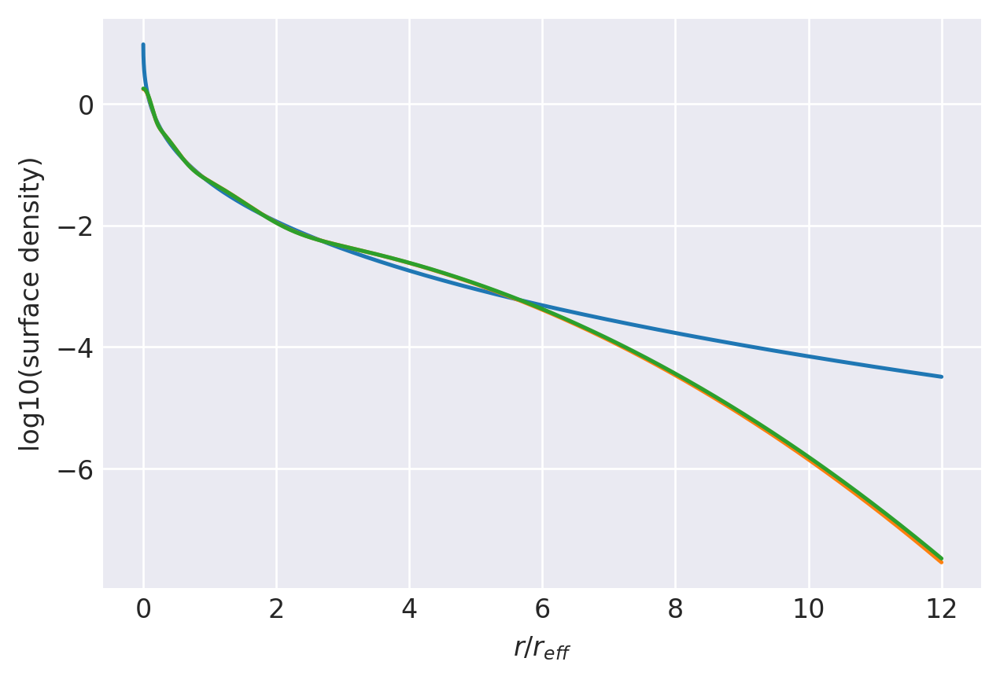

n=2.95: (
    normalize(np.array([3.5430879037e-01, 3.7882662977e-01, 2.0541438545e-01, 6.1450194406e-02])),
    np.array([2.8137722481e+00, 9.4091575212e-01, 3.3396181881e-01, 1.0264727843e-01]),
),
[60, 24000]
0.989136215414153 0.9999989311827288
prev.  chisq = -6.096794251156268
ws, re: (array([0.35430879, 0.37882663, 0.20541439, 0.06145019]), array([2.81377225, 0.94091575, 0.33396182, 0.10264728]))
Optimization terminated successfully.
         Current function value: -6.100988
         Iterations: 11
         Function evaluations: 153
         Gradient evaluations: 17
-6.100988138958478 [-0.60003721  0.34112251  1.19238327  0.45234061 -0.02625519 -0.47776142
 -0.99007327]
0.989136215414153 0.9999987050065218


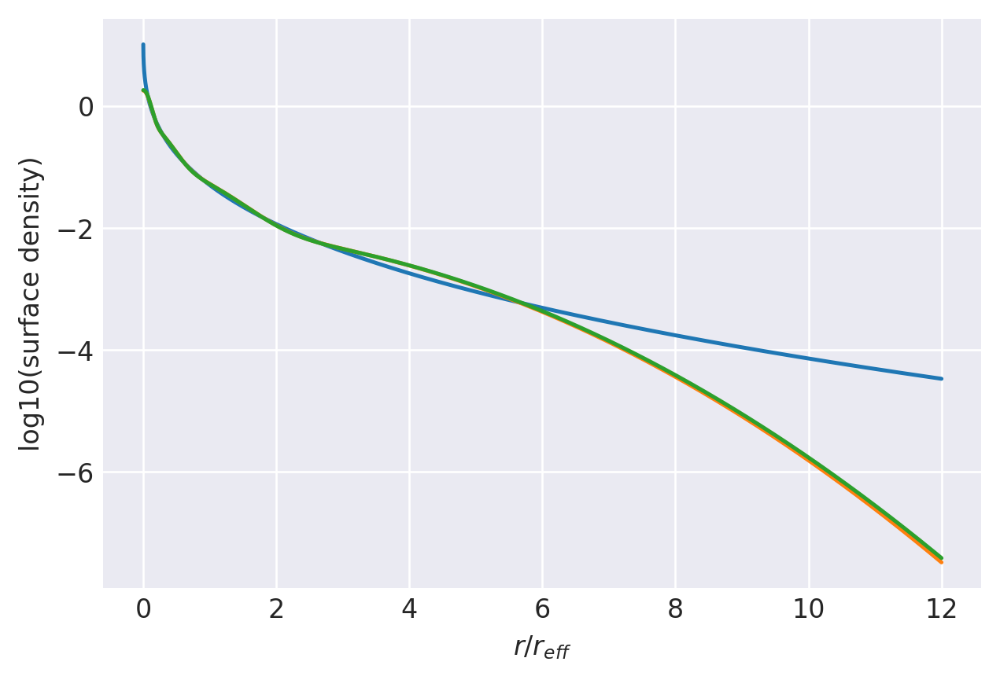

n=3.0: (
    normalize(np.array([3.5433518025e-01, 3.7736730553e-01, 2.0582900983e-01, 6.2468504396e-02])),
    np.array([2.8336134626e+00, 9.4133631235e-01, 3.3284235252e-01, 1.0231203660e-01]),
),
[63, 24000]
0.9884354174892175 0.9999987050065218
prev.  chisq = -6.092016870142994
ws, re: (array([0.35433518, 0.37736731, 0.20582901, 0.0624685 ]), array([2.83361346, 0.94133631, 0.33284235, 0.10231204]))
Optimization terminated successfully.
         Current function value: -6.095927
         Iterations: 10
         Function evaluations: 144
         Gradient evaluations: 16
-6.0959265202716715 [-0.60037713  0.3316722   1.17778353  0.45542251 -0.02590906 -0.47894683
 -0.99105321]
0.9884354174892175 0.9999984365160656


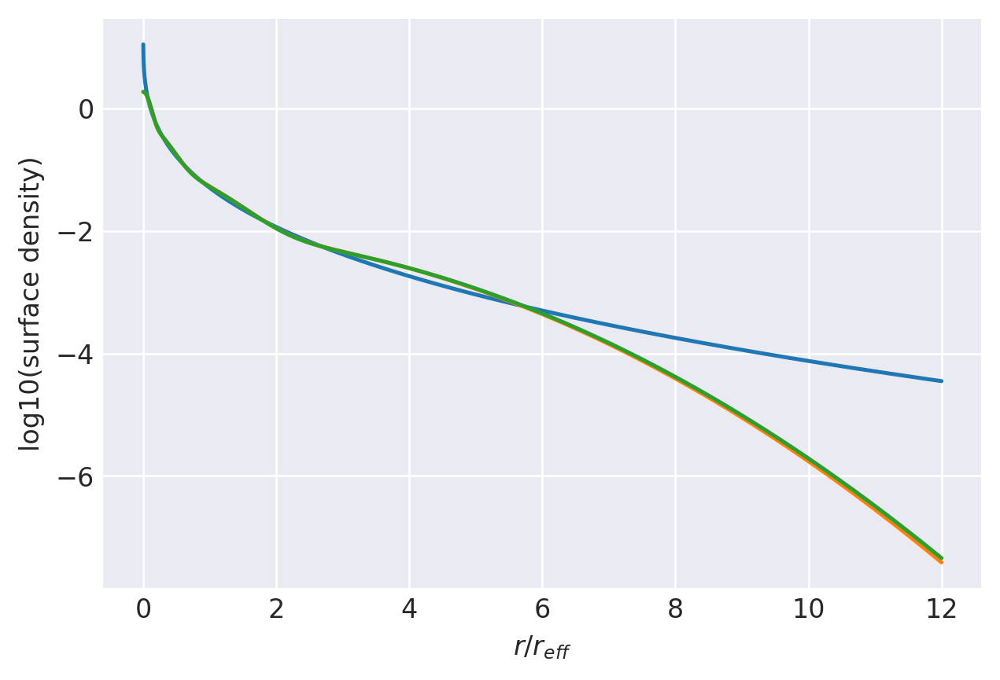

n=3.05: (
    normalize(np.array([3.5425741621e-01, 3.7592950192e-01, 2.0628533347e-01, 6.3527748404e-02])),
    np.array([2.8537933042e+00, 9.4208685085e-01, 3.3193509656e-01, 1.0208144094e-01]),
),
[66, 24000]
0.9877185299843769 0.9999984365160656
prev.  chisq = -6.0881026019250735
ws, re: (array([0.35425742, 0.3759295 , 0.20628533, 0.06352775]), array([2.8537933 , 0.94208685, 0.3319351 , 0.10208144]))
Optimization terminated successfully.
         Current function value: -6.091753
         Iterations: 11
         Function evaluations: 153
         Gradient evaluations: 17
-6.091752772567621 [-0.6011379   0.32201588  1.1630466   0.45853296 -0.0254175  -0.47987287
 -0.99162239]
0.9877185299843769 0.9999981184831859


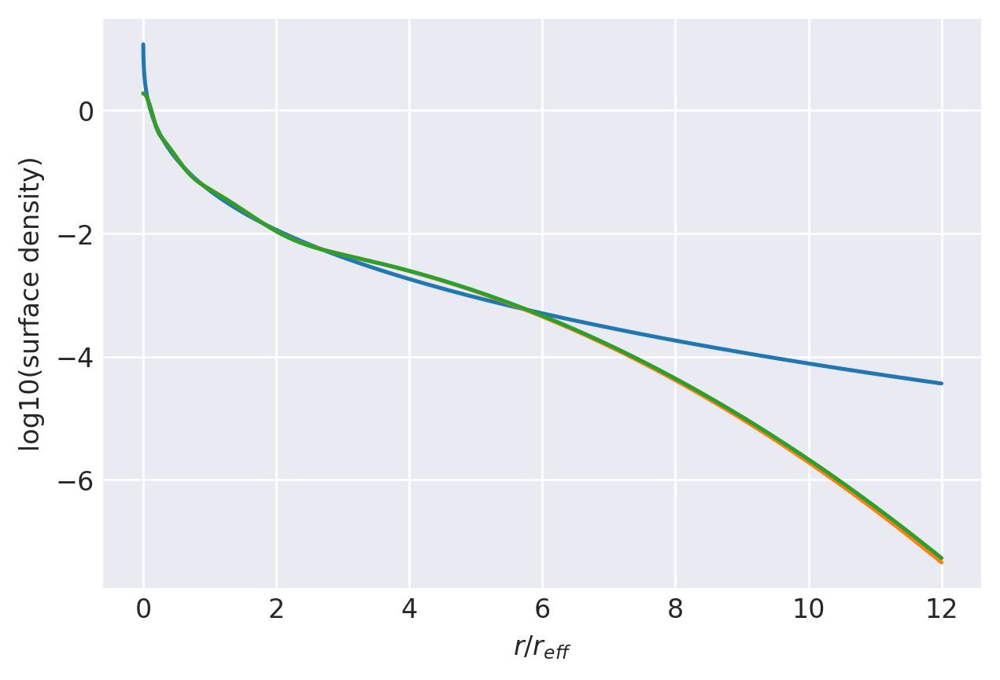

n=3.1: (
    normalize(np.array([3.5408340328e-01, 3.7451242860e-01, 2.0677899717e-01, 6.4625170948e-02])),
    np.array([2.8743057570e+00, 9.4315375517e-01, 3.3122806802e-01, 1.0194774200e-01]),
),
[68, 24000]
0.986986296603905 0.9999981184831859
prev.  chisq = -6.081315922289339
ws, re: (array([0.3540834 , 0.37451243, 0.206779  , 0.06462517]), array([2.87430576, 0.94315376, 0.33122807, 0.10194774]))
Optimization terminated successfully.
         Current function value: -6.084957
         Iterations: 11
         Function evaluations: 153
         Gradient evaluations: 17
-6.084956556042643 [-0.60029996  0.31416999  1.15058854  0.4612298  -0.02548307 -0.48159091
 -0.99353467]
0.986986296603905 0.9999977970343455


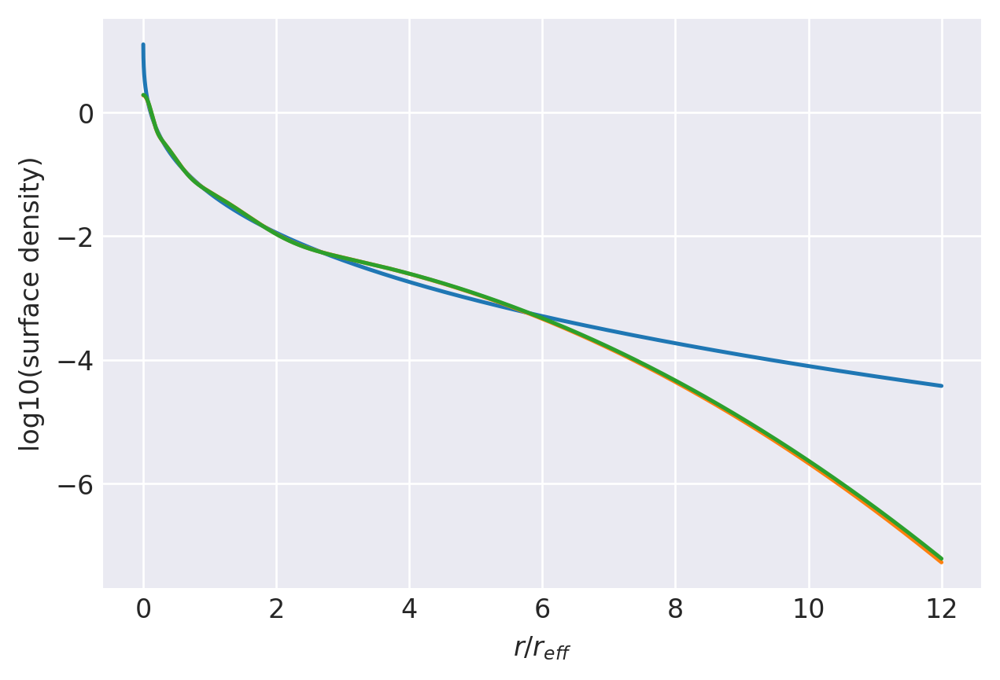

n=3.15: (
    normalize(np.array([3.5427507068e-01, 3.7316623268e-01, 2.0704060105e-01, 6.5518095596e-02])),
    np.array([2.8922098448e+00, 9.4301137397e-01, 3.2992033564e-01, 1.0149983267e-01]),
),
[71, 24000]
0.9862394493372659 0.9999977970343455
prev.  chisq = -6.07914798577053
ws, re: (array([0.35427507, 0.37316623, 0.2070406 , 0.0655181 ]), array([2.89220984, 0.94301137, 0.32992034, 0.10149983]))
Optimization terminated successfully.
         Current function value: -6.082337
         Iterations: 10
         Function evaluations: 153
         Gradient evaluations: 17
-6.082336529845435 [-0.60175781  0.30422561  1.13572603  0.46437395 -0.02474583 -0.48207122
 -0.99340995]
0.9862394493372659 0.9999973655009623


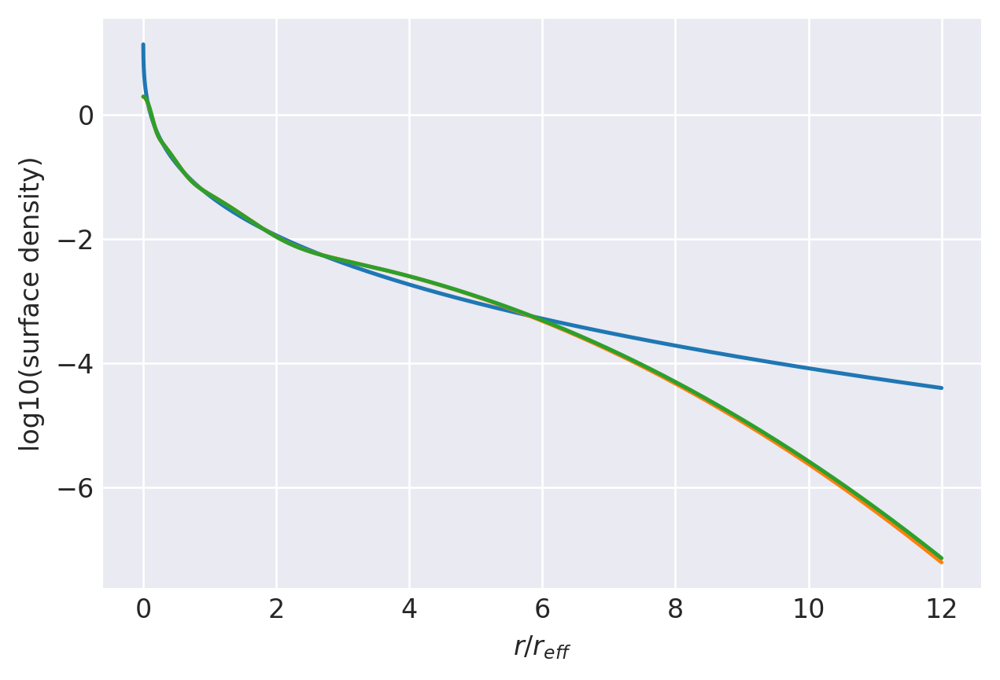

n=3.2: (
    normalize(np.array([3.5394163761e-01, 3.7179055045e-01, 2.0759168018e-01, 6.6676131755e-02])),
    np.array([2.9132244516e+00, 9.4461354648e-01, 3.2955566570e-01, 1.0152898592e-01]),
),
[74, 24000]
0.9854787066049464 0.9999973655009623
prev.  chisq = -6.077443783745658
ws, re: (array([0.35394164, 0.37179055, 0.20759168, 0.06667613]), array([2.91322445, 0.94461355, 0.32955567, 0.10152899]))
Optimization terminated successfully.
         Current function value: -6.080433
         Iterations: 11
         Function evaluations: 153
         Gradient evaluations: 17
-6.080432919045149 [-0.6035462   0.29415717  1.12083779  0.46754096 -0.02388307 -0.48233141
 -0.99295679]
0.9854787066049464 0.9999968580413564


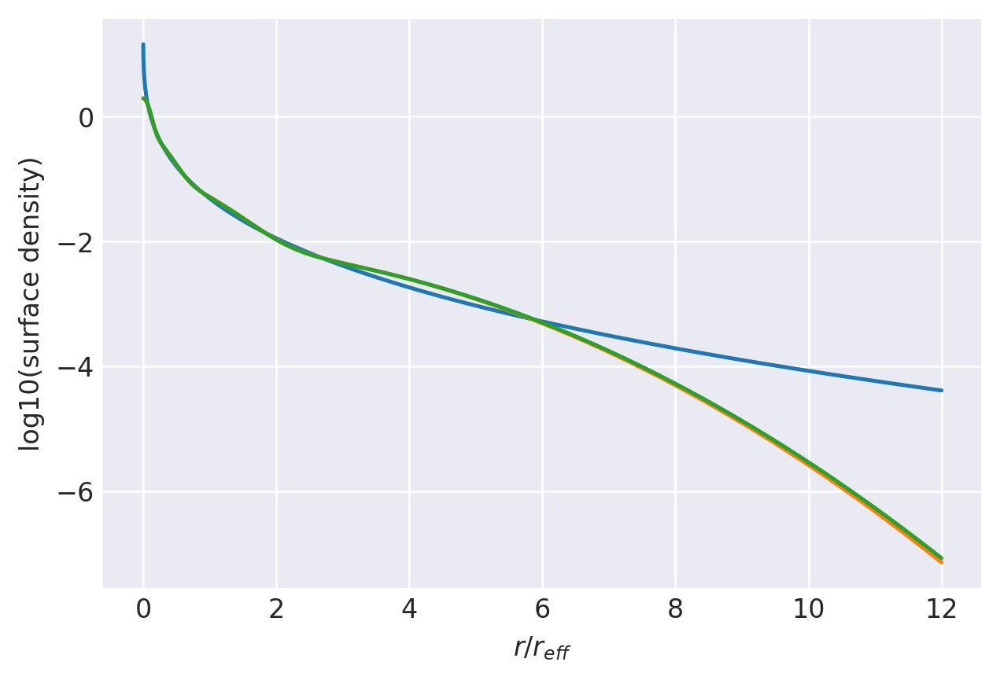

n=3.25: (
    normalize(np.array([3.5353279953e-01, 3.7043447960e-01, 2.0816844349e-01, 6.7864277380e-02])),
    np.array([2.9345462538e+00, 9.4649195756e-01, 3.2935828302e-01, 1.0163498184e-01]),
),
[77, 24000]
0.9847047717314209 0.9999968580413564
prev.  chisq = -6.076388803564074
ws, re: (array([0.3535328 , 0.37043448, 0.20816844, 0.06786428]), array([2.93454625, 0.94649196, 0.32935828, 0.10163498]))
Optimization terminated successfully.
         Current function value: -6.079195
         Iterations: 10
         Function evaluations: 144
         Gradient evaluations: 16
-6.079194514711567 [-0.60562835  0.2839888   1.10595846  0.47072657 -0.02290334 -0.48238552
 -0.99220272]
0.9847047717314209 0.9999962631580478


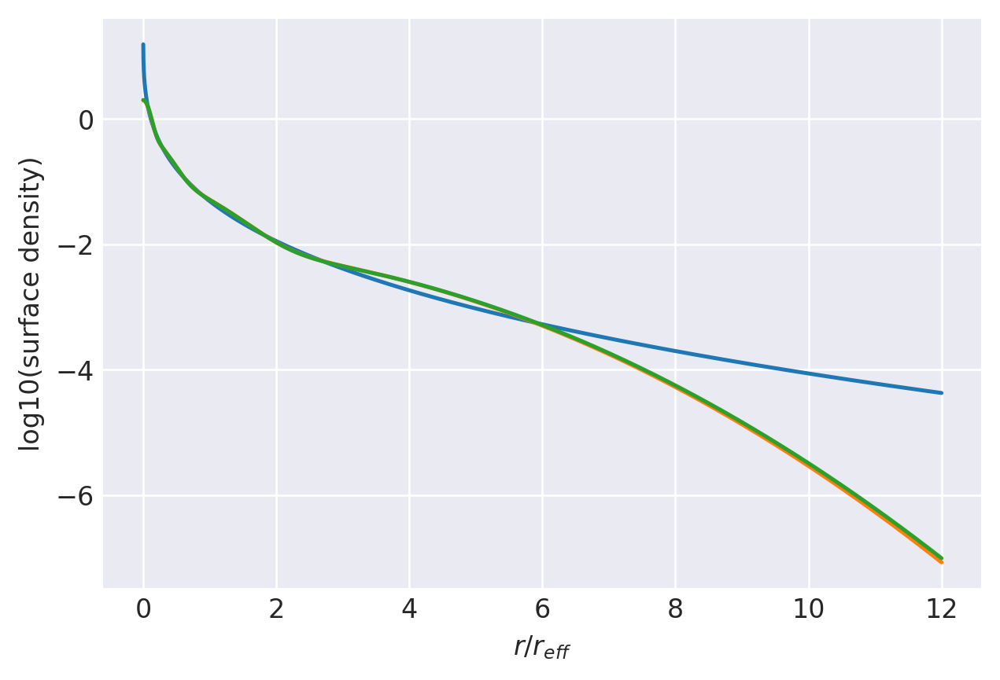

n=3.3: (
    normalize(np.array([3.5305707390e-01, 3.6909637511e-01, 2.0876691792e-01, 6.9079633068e-02])),
    np.array([2.9561507028e+00, 9.4862958267e-01, 3.2931725111e-01, 1.0181160428e-01]),
),
[80, 24000]
0.9839183317077059 0.9999962631580478
prev.  chisq = -6.075937481332593
ws, re: (array([0.35305707, 0.36909638, 0.20876692, 0.06907963]), array([2.9561507 , 0.94862958, 0.32931725, 0.1018116 ]))
Optimization terminated successfully.
         Current function value: -6.078574
         Iterations: 11
         Function evaluations: 153
         Gradient evaluations: 17
-6.078574201299044 [-0.60798422  0.27374541  1.09112098  0.47392979 -0.02181222 -0.48224612
 -0.99117336]
0.9839183317077059 0.9999955673318911


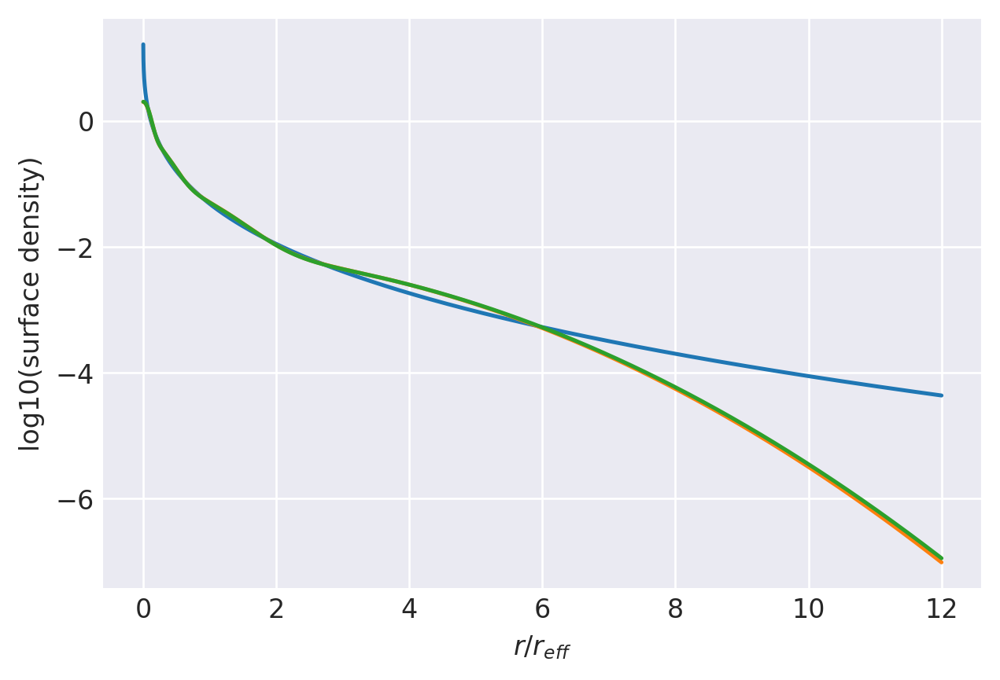

n=3.35: (
    normalize(np.array([3.5251916177e-01, 3.6777699263e-01, 2.0938427118e-01, 7.0319574424e-02])),
    np.array([2.9780349505e+00, 9.5101591090e-01, 3.2942297470e-01, 1.0205320299e-01]),
),
[83, 24000]
0.9831200562092832 0.9999955673318911
prev.  chisq = -6.076048004303755
ws, re: (array([0.35251916, 0.36777699, 0.20938427, 0.07031957]), array([2.97803495, 0.95101591, 0.32942297, 0.1020532 ]))
Optimization terminated successfully.
         Current function value: -6.078529
         Iterations: 10
         Function evaluations: 144
         Gradient evaluations: 16
-6.078528649168024 [-0.6105774   0.26345162  1.07635304  0.47714553 -0.02061913 -0.48192748
 -0.98989397]
0.9831200562092832 0.9999947563072189


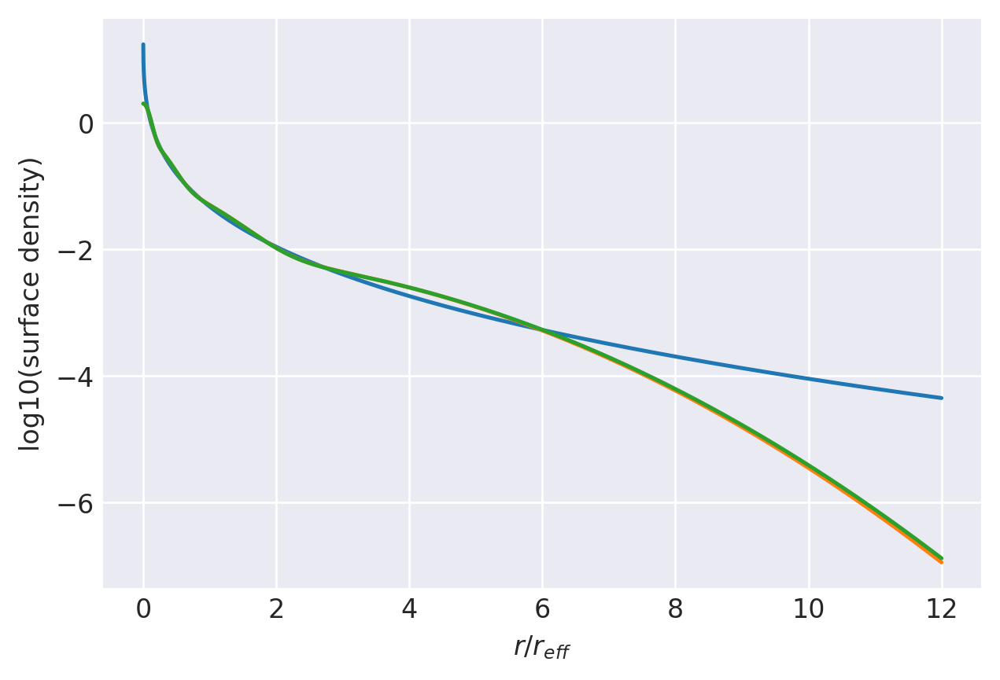

n=3.4: (
    normalize(np.array([3.5192749718e-01, 3.6647501106e-01, 2.1001631317e-01, 7.1581178586e-02])),
    np.array([3.0001677072e+00, 9.5363212732e-01, 3.2966475344e-01, 1.0235428592e-01]),
),
[86, 24000]
0.9823105968383219 0.9999947563072189
prev.  chisq = -6.076681555471574
ws, re: (array([0.3519275 , 0.36647501, 0.21001631, 0.07158118]), array([3.00016771, 0.95363213, 0.32966475, 0.10235429]))
Optimization terminated successfully.
         Current function value: -6.079018
         Iterations: 11
         Function evaluations: 144
         Gradient evaluations: 16
-6.079018012746969 [-0.61338852  0.25312691  1.06167809  0.48037247 -0.01932954 -0.48144074
 -0.98838606]
0.9823105968383219 0.9999938133803633


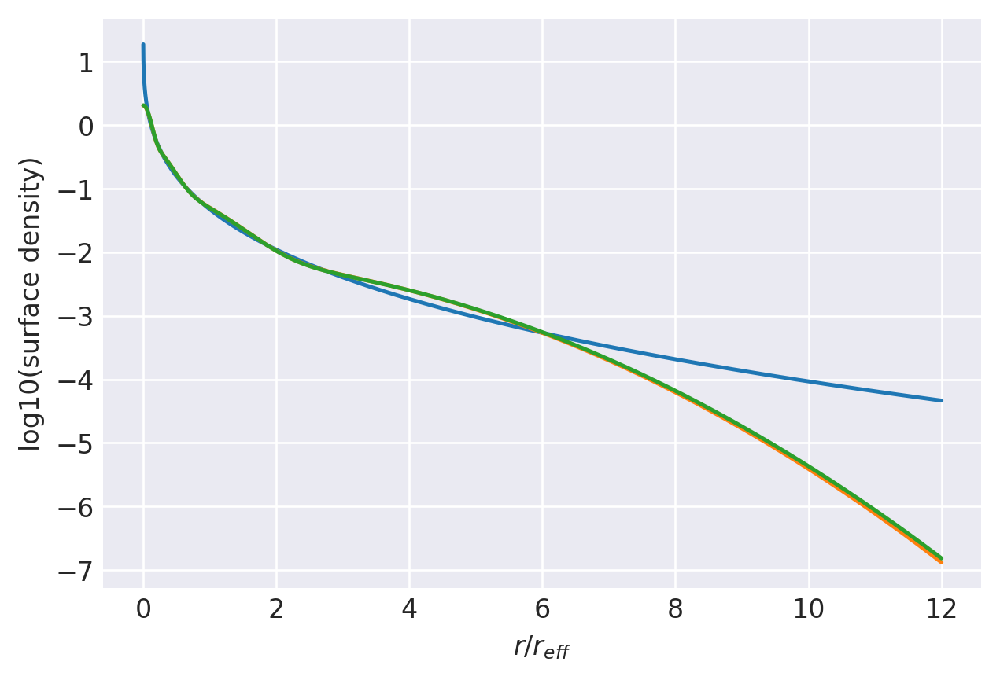

n=3.45: (
    normalize(np.array([3.5128661856e-01, 3.6519059739e-01, 2.1066057553e-01, 7.2862208526e-02])),
    np.array([3.0225428623e+00, 9.5646804338e-01, 3.3003443708e-01, 1.0271028581e-01]),
),
[89, 24000]
0.9814905865621665 0.9999938133803633
prev.  chisq = -6.077802776768269
ws, re: (array([0.35128662, 0.3651906 , 0.21066058, 0.07286221]), array([3.02254286, 0.95646804, 0.33003444, 0.10271029]))
Optimization terminated successfully.
         Current function value: -6.080006
         Iterations: 12
         Function evaluations: 162
         Gradient evaluations: 18
-6.08000564080061 [-0.61639148  0.24279109  1.04711963  0.48360699 -0.01795079 -0.48079815
 -0.98667145]
0.9814905865621665 0.9999927206694672


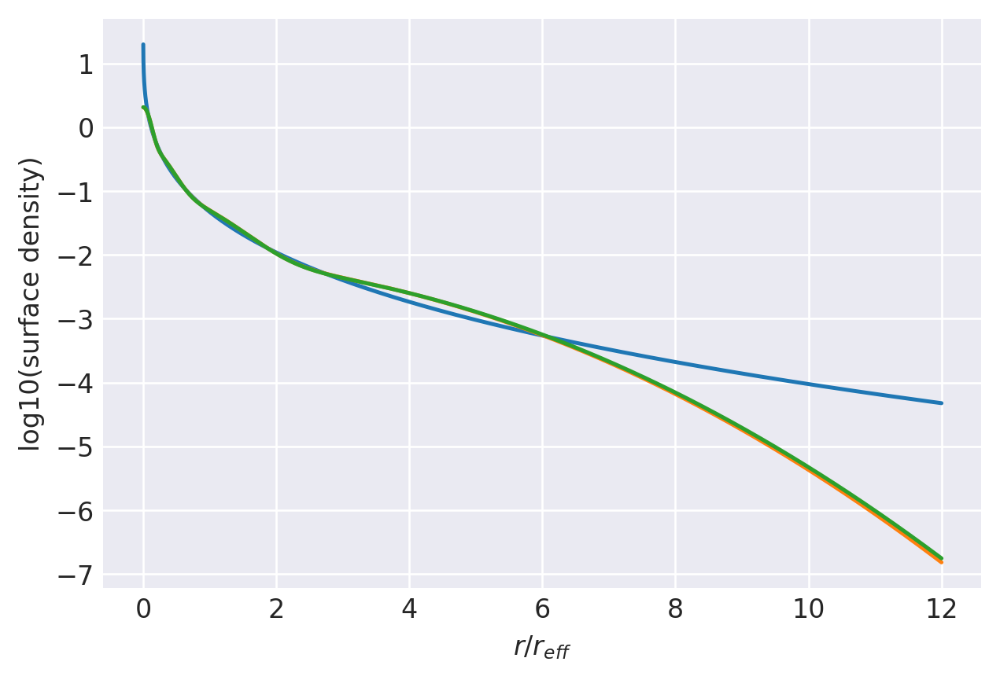

n=3.5: (
    normalize(np.array([3.5060259650e-01, 3.6392318499e-01, 2.1131412735e-01, 7.4160091171e-02])),
    np.array([3.0451380739e+00, 9.5950933686e-01, 3.3052312721e-01, 1.0311659224e-01]),
),
[92, 24000]
0.9806606393228348 0.9999927206694672
prev.  chisq = -6.079378796332868
ws, re: (array([0.3506026 , 0.36392318, 0.21131413, 0.07416009]), array([3.04513807, 0.95950934, 0.33052313, 0.10311659]))
Optimization terminated successfully.
         Current function value: -6.081458
         Iterations: 11
         Function evaluations: 153
         Gradient evaluations: 17
-6.081457803143476 [-0.61956719  0.2324616   1.03269629  0.48684718 -0.01648865 -0.4800103
 -0.98476911]
0.9806606393228348 0.9999914579600053


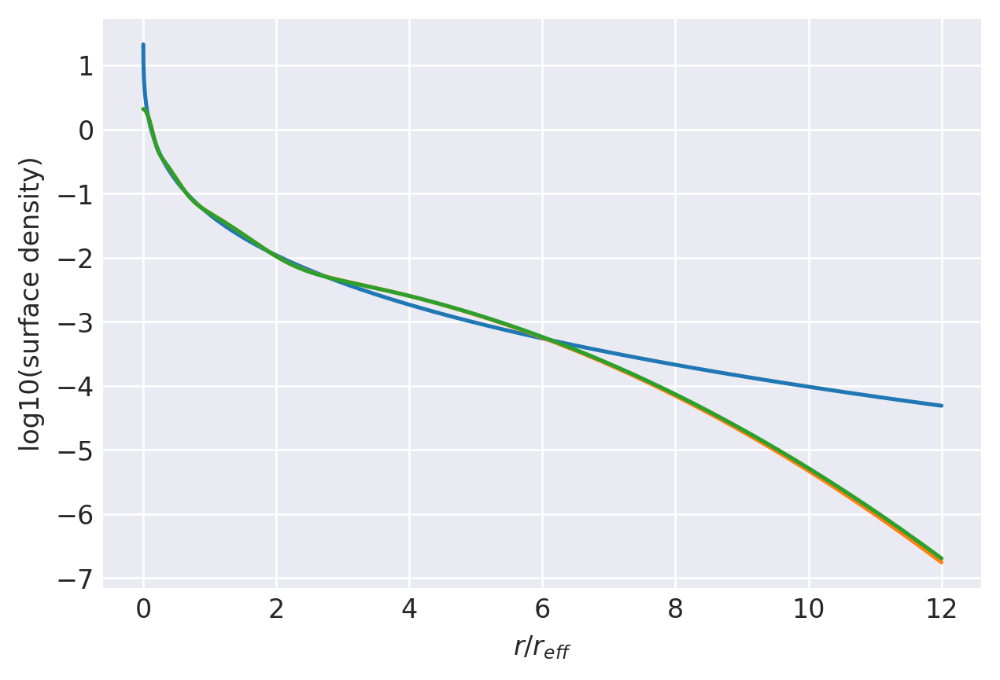

n=3.55: (
    normalize(np.array([3.4987989294e-01, 3.6267281772e-01, 2.1197463864e-01, 7.5472650700e-02])),
    np.array([3.0679422536e+00, 9.6274517615e-01, 3.3112326760e-01, 1.0356926327e-01]),
),
[95, 24000]
0.9798213497949013 0.9999914579600053
prev.  chisq = -6.081379433179568
ws, re: (array([0.34987989, 0.36267282, 0.21197464, 0.07547265]), array([3.06794225, 0.96274518, 0.33112327, 0.10356926]))
Optimization terminated successfully.
         Current function value: -6.083343
         Iterations: 11
         Function evaluations: 144
         Gradient evaluations: 16
-6.0833434359085325 [-0.6228905   0.22215385  1.01842538  0.49008922 -0.01495022 -0.47908824
 -0.98269758]
0.9798213497949013 0.9999900038678844


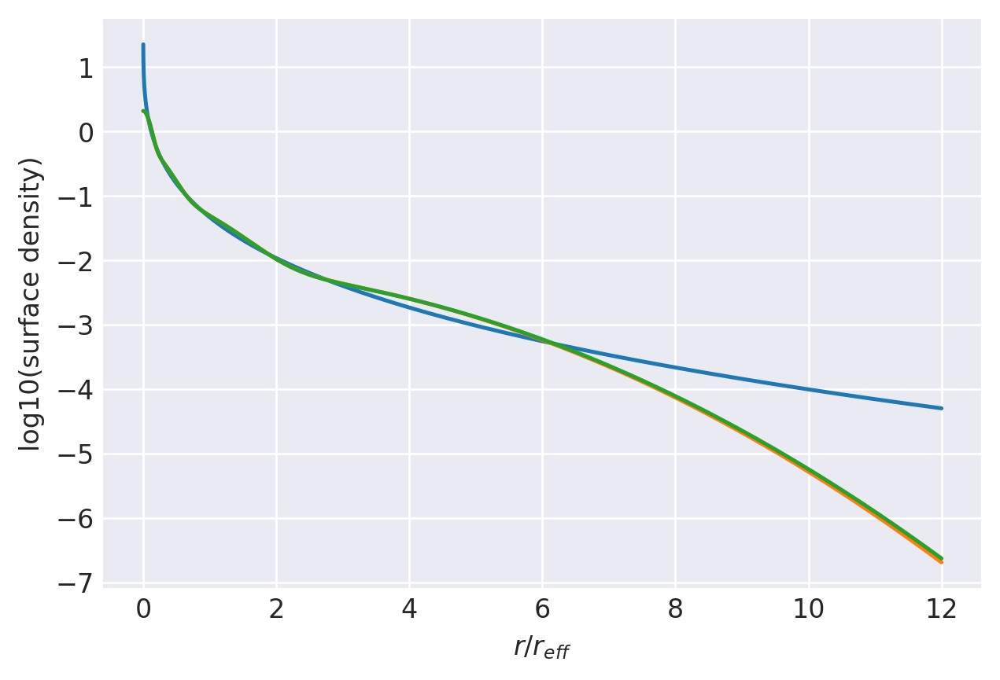

n=3.6: (
    normalize(np.array([3.4912433749e-01, 3.6143852615e-01, 2.1263955626e-01, 7.6797580096e-02])),
    np.array([3.0909303854e+00, 9.6616160754e-01, 3.3182703277e-01, 1.0406445589e-01]),
),
[98, 24000]
0.9789732932715328 0.9999900038678844
prev.  chisq = -6.083776756201404
ws, re: (array([0.34912434, 0.36143853, 0.21263956, 0.07679758]), array([3.09093039, 0.96616161, 0.33182703, 0.10406446]))
Optimization terminated successfully.
         Current function value: -6.085634
         Iterations: 11
         Function evaluations: 144
         Gradient evaluations: 16
-6.085633906286114 [-0.62634781  0.21188202  1.00431958  0.493332   -0.01334013 -0.47804094
 -0.98047247]
0.9789732932715328 0.9999883339550127


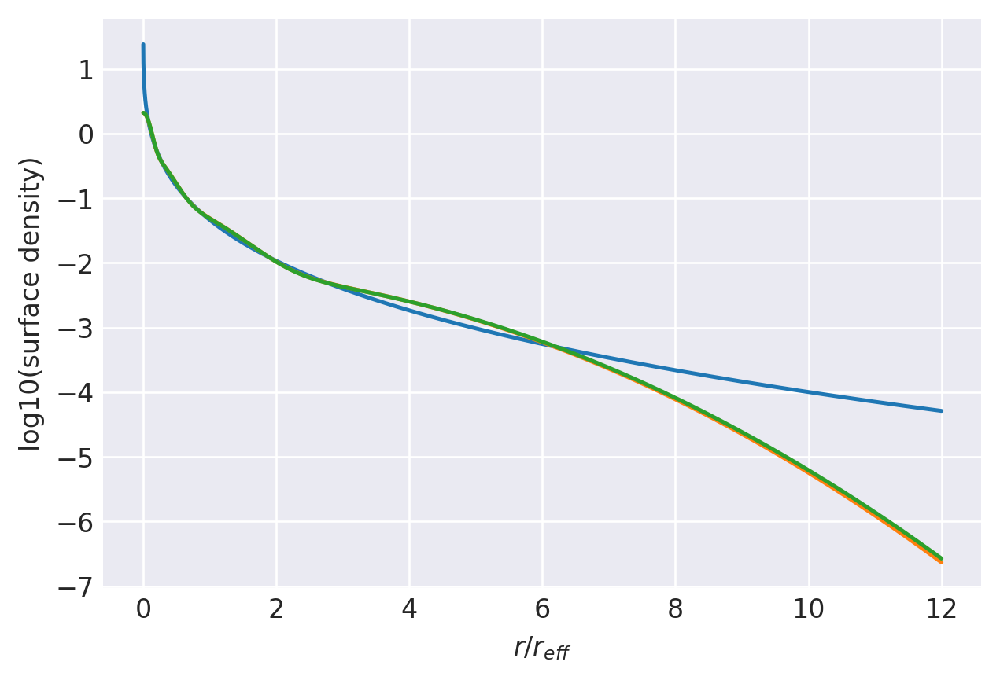

n=3.65: (
    normalize(np.array([3.4833912131e-01, 3.6022068210e-01, 2.1330712320e-01, 7.8133073388e-02])),
    np.array([3.1140960325e+00, 9.6975018327e-01, 3.3262819643e-01, 1.0459899986e-01]),
),
[101, 24000]
0.9781170256606457 0.9999883339550127
prev.  chisq = -6.086545108766038
ws, re: (array([0.34833912, 0.36022068, 0.21330712, 0.07813307]), array([3.11409603, 0.96975018, 0.3326282 , 0.104599  ]))
Optimization terminated successfully.
         Current function value: -6.088303
         Iterations: 11
         Function evaluations: 153
         Gradient evaluations: 17
-6.088302796704632 [-0.6299205   0.20165808  0.9903903   0.49657274 -0.01166405 -0.47687759
 -0.97810888]
0.9781170256606457 0.9999864224337782


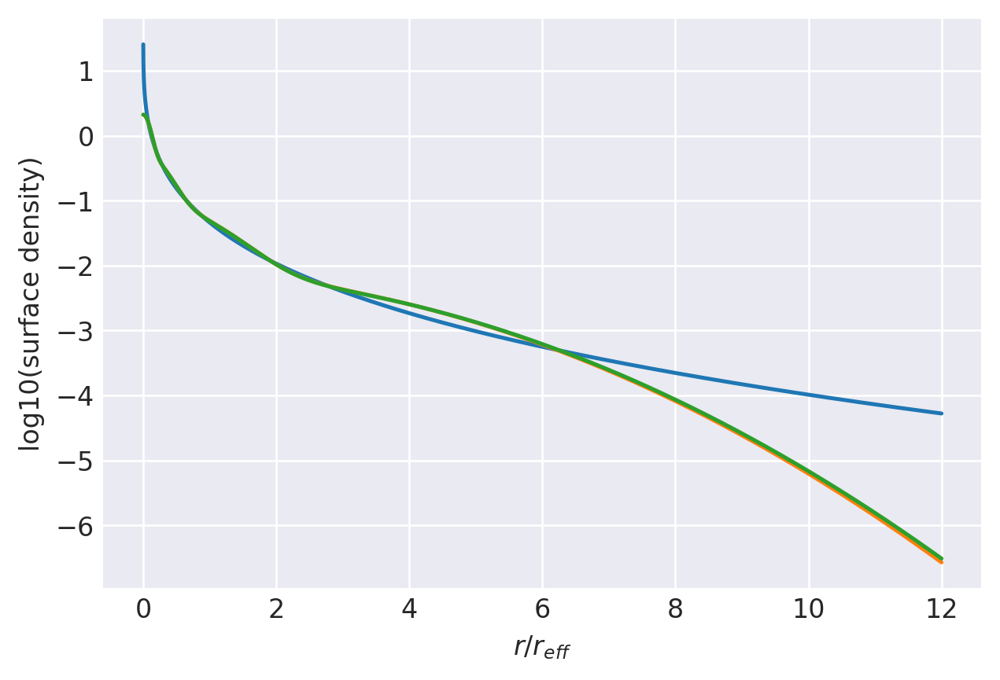

n=3.7: (
    normalize(np.array([3.4752856336e-01, 3.5901873163e-01, 2.1397544378e-01, 7.9477261228e-02])),
    np.array([3.1374205676e+00, 9.7349999075e-01, 3.3352040452e-01, 1.0516981737e-01]),
),
[104, 24000]
0.9772530835751599 0.9999864224337782
prev.  chisq = -6.089660723394074
ws, re: (array([0.34752856, 0.35901873, 0.21397544, 0.07947726]), array([3.13742057, 0.97349999, 0.3335204 , 0.10516982]))
Optimization terminated successfully.
         Current function value: -6.091326
         Iterations: 10
         Function evaluations: 144
         Gradient evaluations: 16
-6.091325707794995 [-0.63359335  0.19149357  0.97664802  0.49980945 -0.00992699 -0.47560676
 -0.97562069]
0.9772530835751599 0.9999842410699022


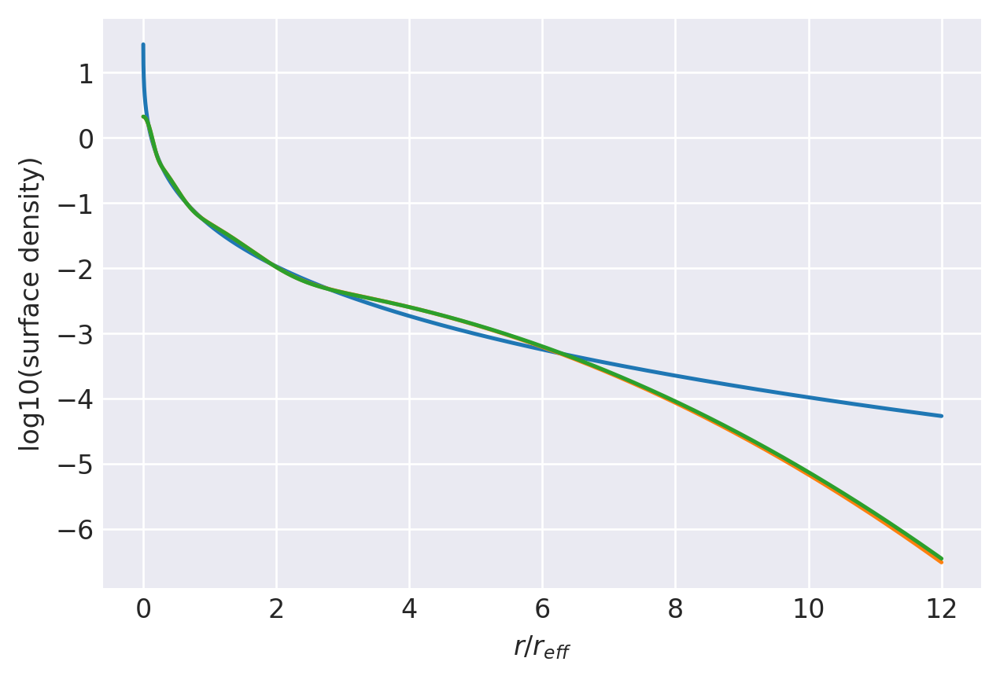

n=3.75: (
    normalize(np.array([3.4669620407e-01, 3.5783254349e-01, 2.1464290629e-01, 8.0828346146e-02])),
    np.array([3.1608904834e+00, 9.7740151693e-01, 3.3449778109e-01, 1.0577409311e-01]),
),
[107, 24000]
0.9763819845031494 0.9999842410699022
prev.  chisq = -6.09310153947499
ws, re: (array([0.3466962 , 0.35783254, 0.21464291, 0.08082835]), array([3.16089048, 0.97740152, 0.33449778, 0.10577409]))
Optimization terminated successfully.
         Current function value: -6.094680
         Iterations: 11
         Function evaluations: 153
         Gradient evaluations: 17
-6.094680079161631 [-0.63735144  0.18139851  0.963101    0.50304002 -0.00813386 -0.4742365
 -0.97302052]
0.9763819845031494 0.9999817595903205


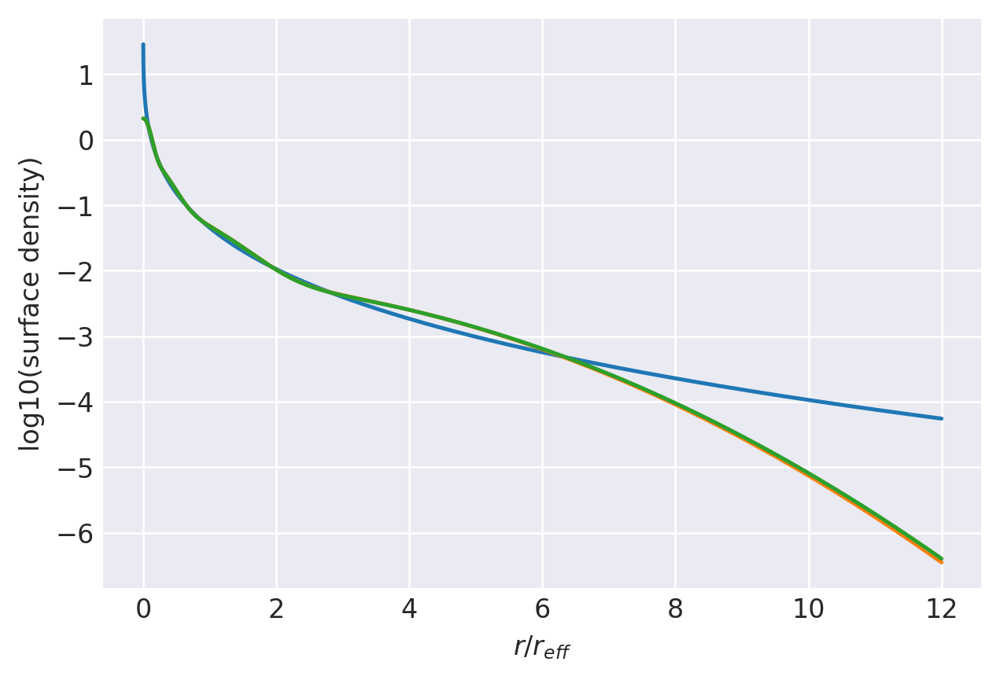

n=3.8: (
    normalize(np.array([3.4584549535e-01, 3.5666183563e-01, 2.1530801303e-01, 8.2184655998e-02])),
    np.array([3.1844909758e+00, 9.8144540014e-01, 3.3555483289e-01, 1.0640927338e-01]),
),
[111, 24000]
0.9755042270453178 0.9999817595903205
prev.  chisq = -6.100403512128534
ws, re: (array([0.3458455 , 0.35666184, 0.21530801, 0.08218466]), array([3.18449098, 0.9814454 , 0.33555483, 0.10640927]))
Optimization terminated successfully.
         Current function value: -6.101880
         Iterations: 11
         Function evaluations: 153
         Gradient evaluations: 17
-6.101879915110176 [-0.64329639  0.16936473  0.94759584  0.50681695 -0.00543335 -0.47155075
 -0.96846653]
0.9755042270453178 0.9999784443080382


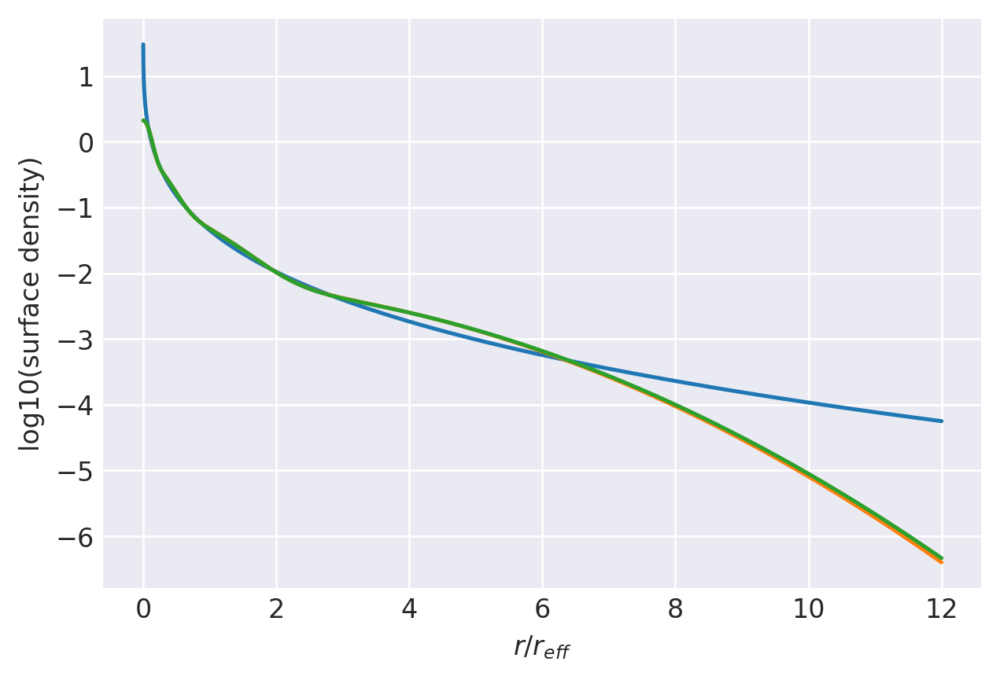

n=3.85: (
    normalize(np.array([3.4450176712e-01, 3.5543753282e-01, 2.1623317002e-01, 8.3827530043e-02])),
    np.array([3.2123063235e+00, 9.8756718252e-01, 3.3763638913e-01, 1.0753094609e-01]),
),
[114, 24000]
0.9746202912087364 0.9999784443080382
prev.  chisq = -6.104400761426339
ws, re: (array([0.34450177, 0.35543753, 0.21623317, 0.08382753]), array([3.21230632, 0.98756718, 0.33763639, 0.10753095]))
Optimization terminated successfully.
         Current function value: -6.105825
         Iterations: 12
         Function evaluations: 153
         Gradient evaluations: 17
-6.1058247296888775 [-0.64717372  0.15945183  0.93449183  0.51003172 -0.00353857 -0.47000263
 -0.96568509]
0.9746202912087364 0.9999751943902587


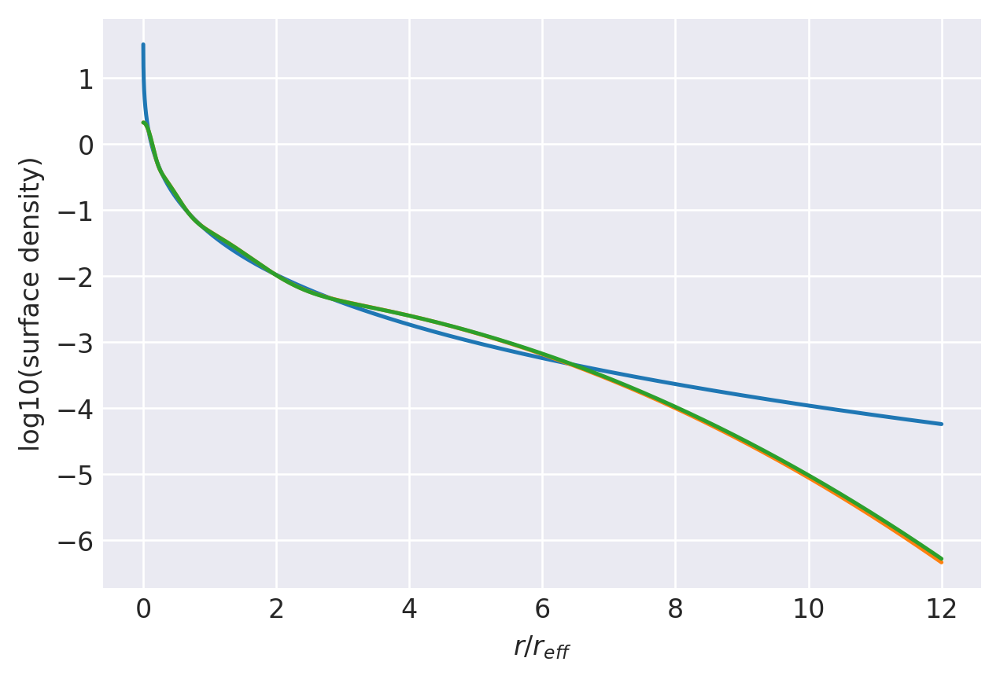

n=3.9: (
    normalize(np.array([3.4362671513e-01, 3.5429632640e-01, 2.1688693385e-01, 8.5190024624e-02])),
    np.array([3.2361728907e+00, 9.9188523879e-01, 3.3884210193e-01, 1.0822184003e-01]),
),
[117, 24000]
0.9737306387470838 0.9999751943902587
prev.  chisq = -6.10868852612533
ws, re: (array([0.34362672, 0.35429633, 0.21688693, 0.08519002]), array([3.23617289, 0.99188524, 0.3388421 , 0.10822184]))
Optimization terminated successfully.
         Current function value: -6.110042
         Iterations: 12
         Function evaluations: 153
         Gradient evaluations: 17
-6.110041838494366 [-0.6510993   0.14963216  0.92159735  0.51323469 -0.00160088 -0.46837657
 -0.96282391]
0.9737306387470838 0.9999715329238125


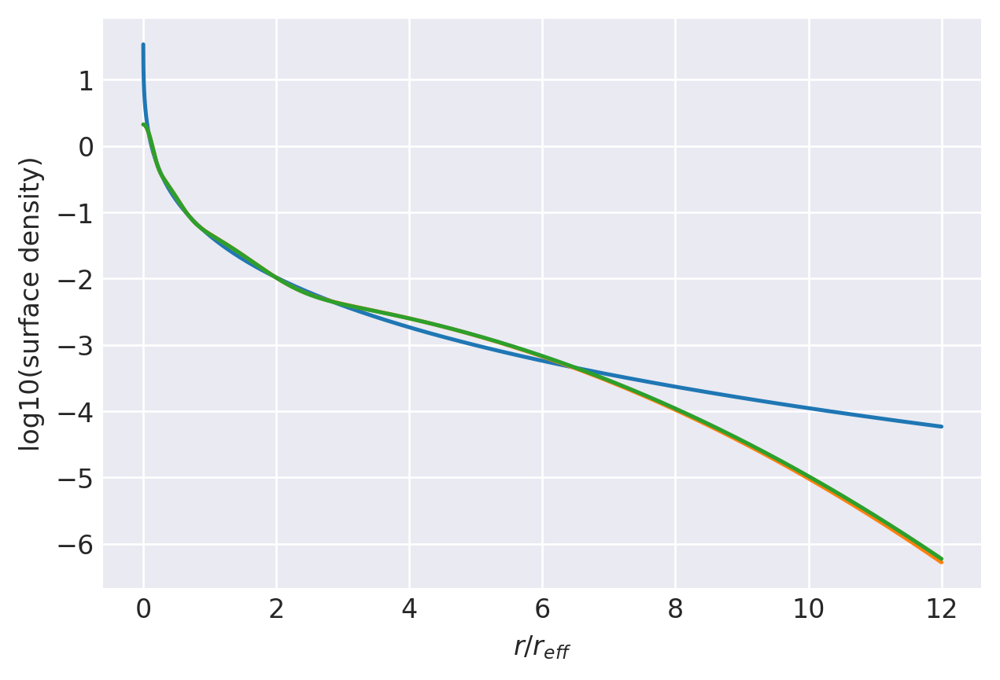

n=3.95: (
    normalize(np.array([3.4274185622e-01, 3.5317003968e-01, 2.1753473610e-01, 8.6553367996e-02])),
    np.array([3.2601282506e+00, 9.9632061863e-01, 3.4011315789e-01, 1.0893716991e-01]),
),
[120, 24000]
0.9728357135388462 0.9999715329238125
prev.  chisq = -6.113227507012529
ws, re: (array([0.34274186, 0.35317004, 0.21753474, 0.08655337]), array([3.26012825, 0.99632062, 0.34011316, 0.10893717]))
Optimization terminated successfully.
         Current function value: -6.114515
         Iterations: 12
         Function evaluations: 153
         Gradient evaluations: 17
-6.114514697235433 [-6.55061617e-01  1.39912337e-01  9.08916403e-01  5.16424099e-01
  3.75606592e-04 -4.66679032e-01 -9.59892060e-01]
0.9728357135388462 0.9999674206661314


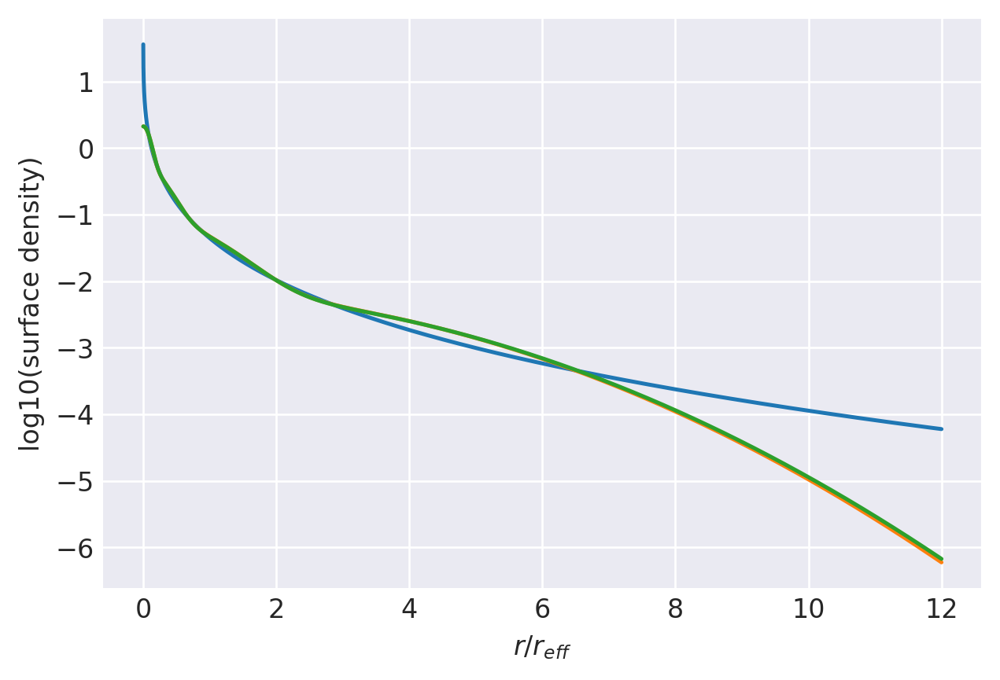

n=4.0: (
    normalize(np.array([3.4184982161e-01, 3.5205844141e-01, 2.1817557062e-01, 8.7916166370e-02])),
    np.array([3.2841584227e+00, 1.0008652402e+00, 3.4144516522e-01, 1.0967507503e-01]),
),
[126, 24000]
0.9710317334965136 0.9999674206661314
prev.  chisq = -6.11938137335508
ws, re: (array([0.34184982, 0.35205844, 0.21817557, 0.08791617]), array([3.28415842, 1.00086524, 0.34144517, 0.10967508]))
Optimization terminated successfully.
         Current function value: -6.124167
         Iterations: 12
         Function evaluations: 153
         Gradient evaluations: 17
-6.124167135777596 [-0.66306586  0.12078384  0.88419638  0.52275762  0.00443349 -0.46308884
 -0.95384502]
0.9710317334965136 0.9999576741536911


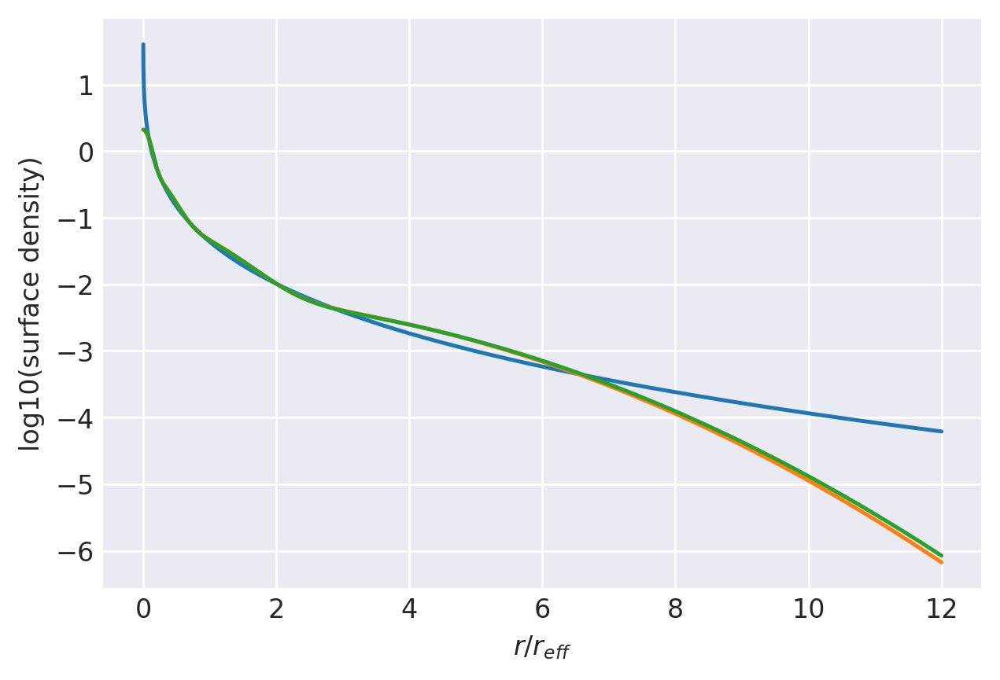

n=4.1: (
    normalize(np.array([3.4005124441e-01, 3.4987797218e-01, 2.1943432111e-01, 9.0636462294e-02])),
    np.array([3.3324037854e+00, 1.0102607608e+00, 3.4427949461e-01, 1.1121285337e-01]),
),
[133, 24000]
0.9692115606886255 0.9999576741536911
prev.  chisq = -6.133705054286801
ws, re: (array([0.34005124, 0.34987797, 0.21943432, 0.09063646]), array([3.33240379, 1.01026076, 0.34427949, 0.11121285]))
Optimization terminated successfully.
         Current function value: -6.138099
         Iterations: 13
         Function evaluations: 162
         Gradient evaluations: 18
-6.138098735391571 [-0.67310505  0.10024419  0.85844055  0.52957675  0.00946472 -0.45806878
 -0.9458401 ]
0.9692115606886255 0.9999444420023391


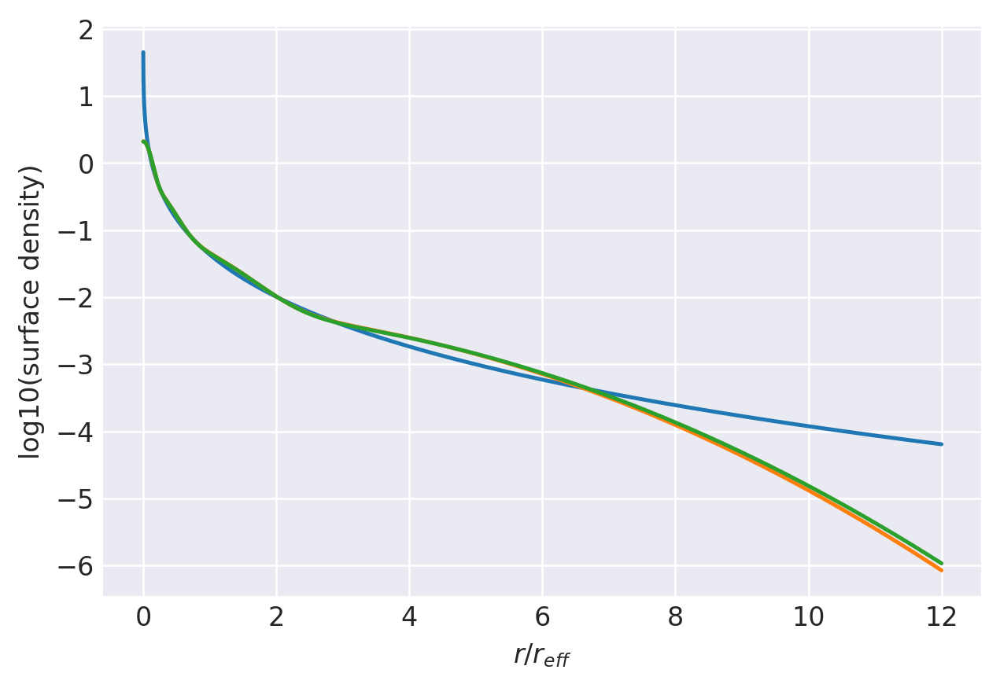

n=4.2: (
    normalize(np.array([3.3780191776e-01, 3.4768053587e-01, 2.2089659834e-01, 9.3620948035e-02])),
    np.array([3.3851409232e+00, 1.0220325314e+00, 3.4828215422e-01, 1.1328173660e-01]),
),
[139, 24000]
0.9673781468920812 0.9999444420023391
prev.  chisq = -6.145348839673623
ws, re: (array([0.33780192, 0.34768054, 0.2208966 , 0.09362095]), array([3.38514092, 1.02203253, 0.34828215, 0.11328174]))
Optimization terminated successfully.
         Current function value: -6.149326
         Iterations: 13
         Function evaluations: 162
         Gradient evaluations: 18
-6.149325806839641 [-0.68111139  0.0820726   0.83550237  0.53575989  0.01373227 -0.4540717
 -0.93947016]
0.9673781468920812 0.9999293898175473


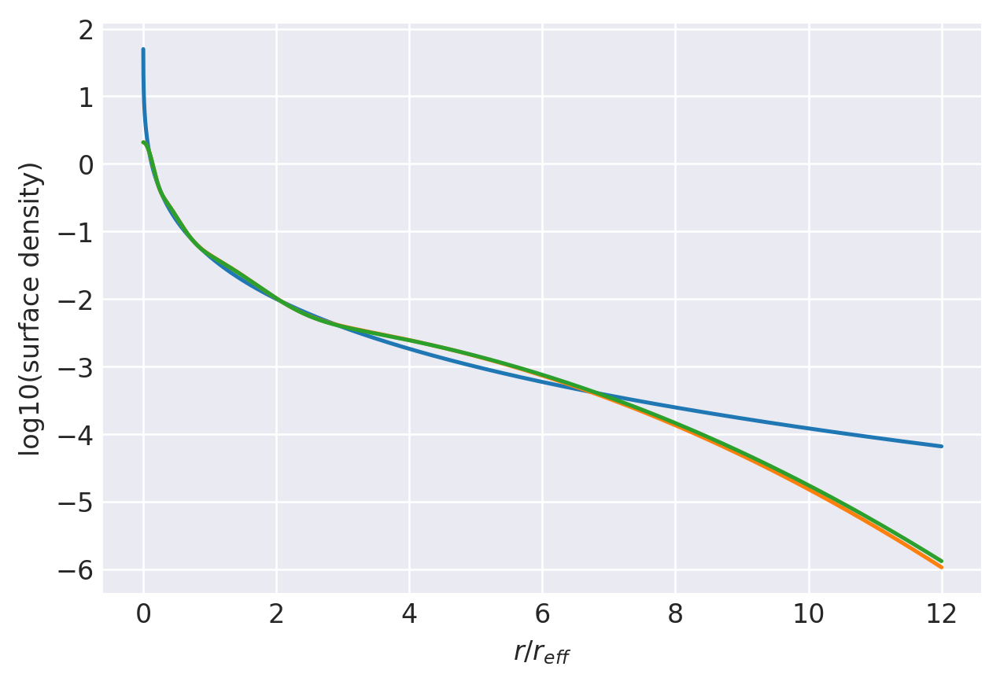

n=4.3: (
    normalize(np.array([3.3601329650e-01, 3.4560948757e-01, 2.2207355832e-01, 9.6303657614e-02])),
    np.array([3.4336805538e+00, 1.0321249269e+00, 3.5150240503e-01, 1.1495552169e-01]),
),
[145, 24000]
0.9655342012270172 0.9999293898175473
prev.  chisq = -6.15758019251854
ws, re: (array([0.3360133 , 0.34560949, 0.22207356, 0.09630366]), array([3.43368055, 1.03212493, 0.35150241, 0.11495552]))
Optimization terminated successfully.
         Current function value: -6.161222
         Iterations: 13
         Function evaluations: 162
         Gradient evaluations: 18
-6.161221793771074 [-0.68906481  0.06437945  0.81339928  0.5418558   0.01807426 -0.44991584
 -0.93298586]
0.9655342012270172 0.999911177191688


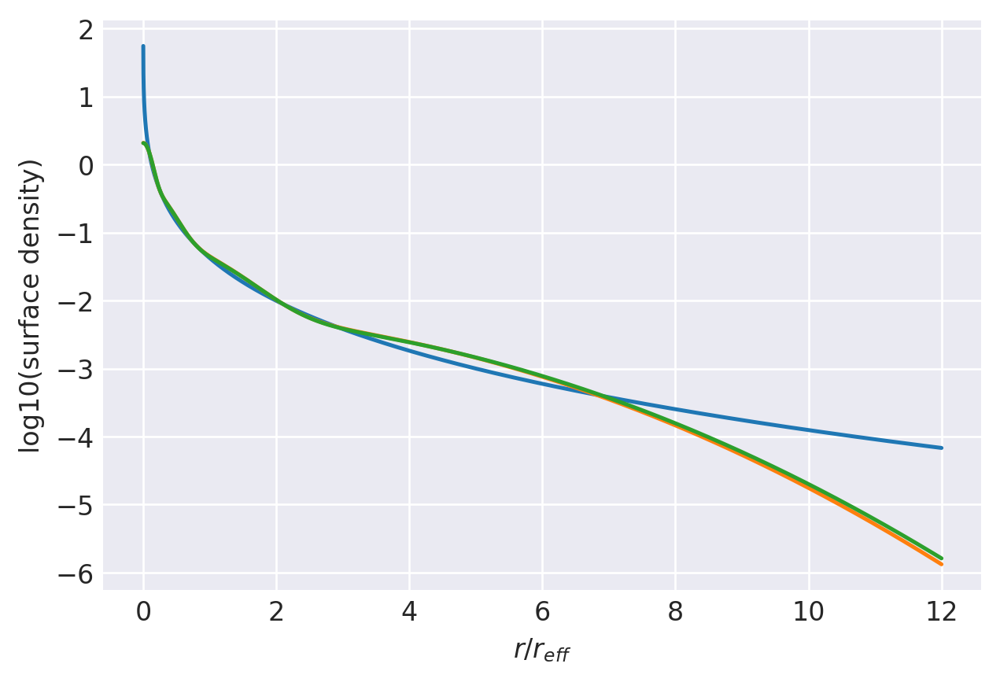

n=4.4: (
    normalize(np.array([3.3424114352e-01, 3.4359102673e-01, 2.2320863210e-01, 9.8959197655e-02])),
    np.array([3.4822167816e+00, 1.0424956778e+00, 3.5488215286e-01, 1.1668476120e-01]),
),
[151, 24000]
0.9636822054935538 0.999911177191688
prev.  chisq = -6.170367256319656
ws, re: (array([0.33424114, 0.34359103, 0.22320863, 0.0989592 ]), array([3.48221678, 1.04249568, 0.35488215, 0.11668476]))
Optimization terminated successfully.
         Current function value: -6.173712
         Iterations: 12
         Function evaluations: 162
         Gradient evaluations: 18
-6.173712472132402 [-0.69692619  0.04717317  0.79211316  0.54785775  0.02247306 -0.44562817
 -0.92641907]
0.9636822054935538 0.9998893786457239


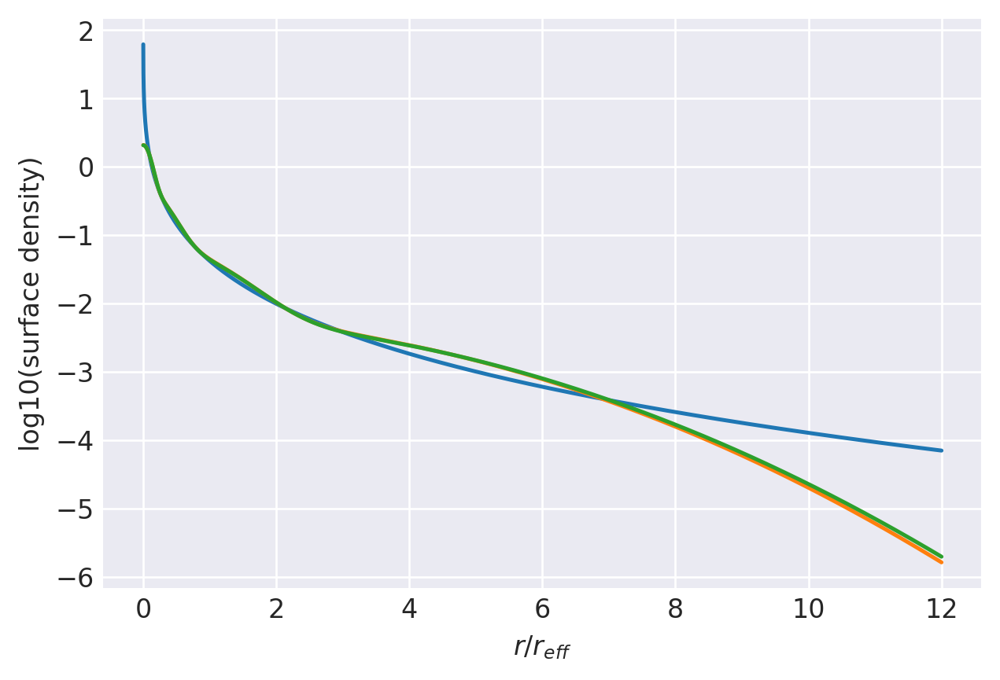

n=4.5: (
    normalize(np.array([3.3249408366e-01, 3.4162359150e-01, 2.2429987925e-01, 1.0158244559e-01])),
    np.array([3.5306750716e+00, 1.0531083688e+00, 3.5840316214e-01, 1.1846250859e-01]),
),
[157, 24000]
0.9618244293482081 0.9998893786457239
prev.  chisq = -6.183649101550983
ws, re: (array([0.33249408, 0.34162359, 0.22429988, 0.10158245]), array([3.53067507, 1.05310837, 0.35840316, 0.11846251]))
Optimization terminated successfully.
         Current function value: -6.186732
         Iterations: 12
         Function evaluations: 162
         Gradient evaluations: 18
-6.186732236979678 [-0.70466334  0.03045442  0.77161869  0.55375991  0.02691354 -0.44123128
 -0.91979563]
0.9618244293482081 0.9998635601365585


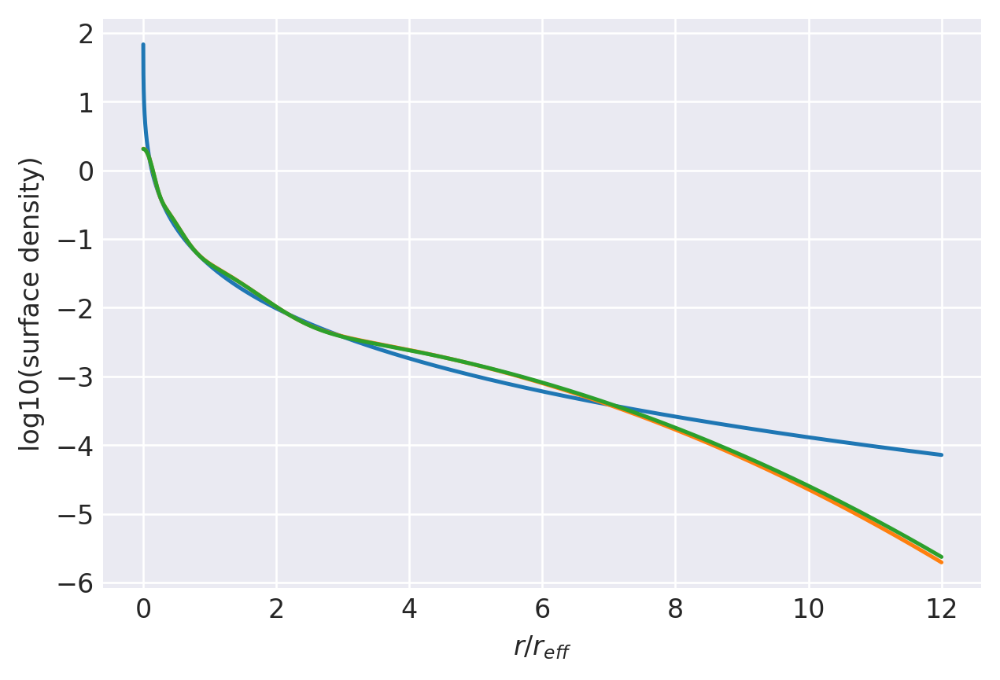

n=4.6: (
    normalize(np.array([3.3077911837e-01, 3.3970522984e-01, 2.2534618004e-01, 1.0416947174e-01])),
    np.array([3.5789852986e+00, 1.0639311799e+00, 3.6205013836e-01, 1.2028303224e-01]),
),
[163, 24000]
0.959962945088921 0.9998635601365585
prev.  chisq = -6.197371892823368
ws, re: (array([0.33077912, 0.33970523, 0.22534618, 0.10416947]), array([3.5789853 , 1.06393118, 0.36205014, 0.12028303]))
Optimization terminated successfully.
         Current function value: -6.200223
         Iterations: 12
         Function evaluations: 162
         Gradient evaluations: 18
-6.200222872999594 [-0.71224896  0.01422252  0.75189084  0.55955736  0.0313819  -0.43674575
 -0.9131378 ]
0.959962945088921 0.9998332868106418


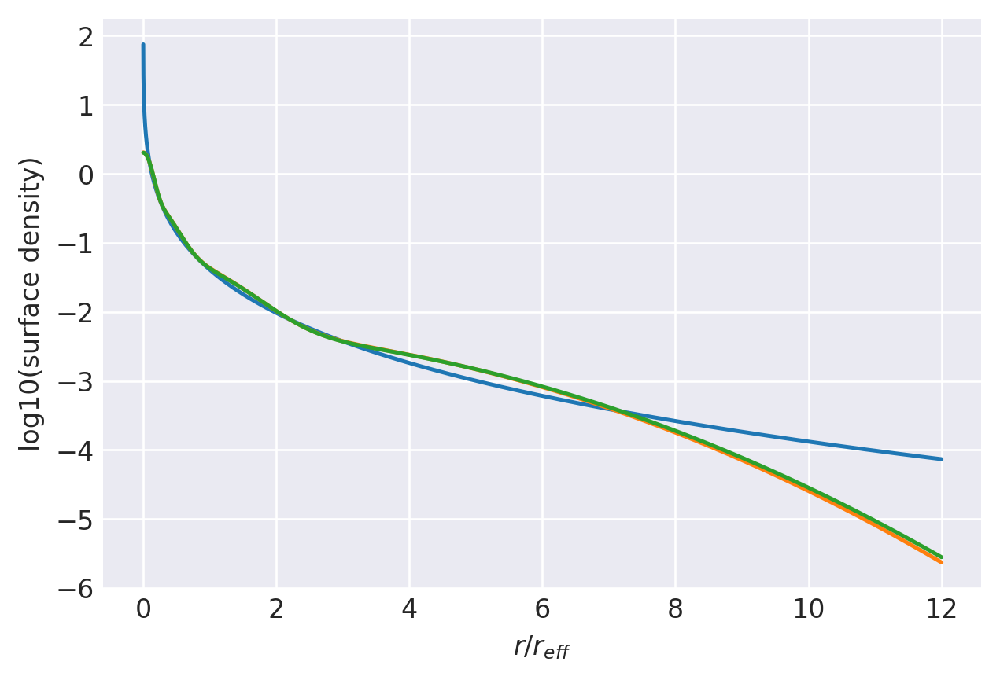

n=4.7: (
    normalize(np.array([3.2910209231e-01, 3.3783437864e-01, 2.2634683187e-01, 1.0671669719e-01])),
    np.array([3.6270818708e+00, 1.0749342489e+00, 3.6580888559e-01, 1.2214120399e-01]),
),
[169, 24000]
0.9580996418891259 0.9998332868106418
prev.  chisq = -6.211487320070376
ws, re: (array([0.32910209, 0.33783438, 0.22634683, 0.1067167 ]), array([3.62708187, 1.07493425, 0.36580889, 0.1221412 ]))
Optimization terminated successfully.
         Current function value: -6.214133
         Iterations: 12
         Function evaluations: 162
         Gradient evaluations: 18
-6.214132529513312 [-0.71966063 -0.00152677  0.73290245  0.56524596  0.03586608 -0.4321894
 -0.90646409]
0.9580996418891259 0.9997981311812943


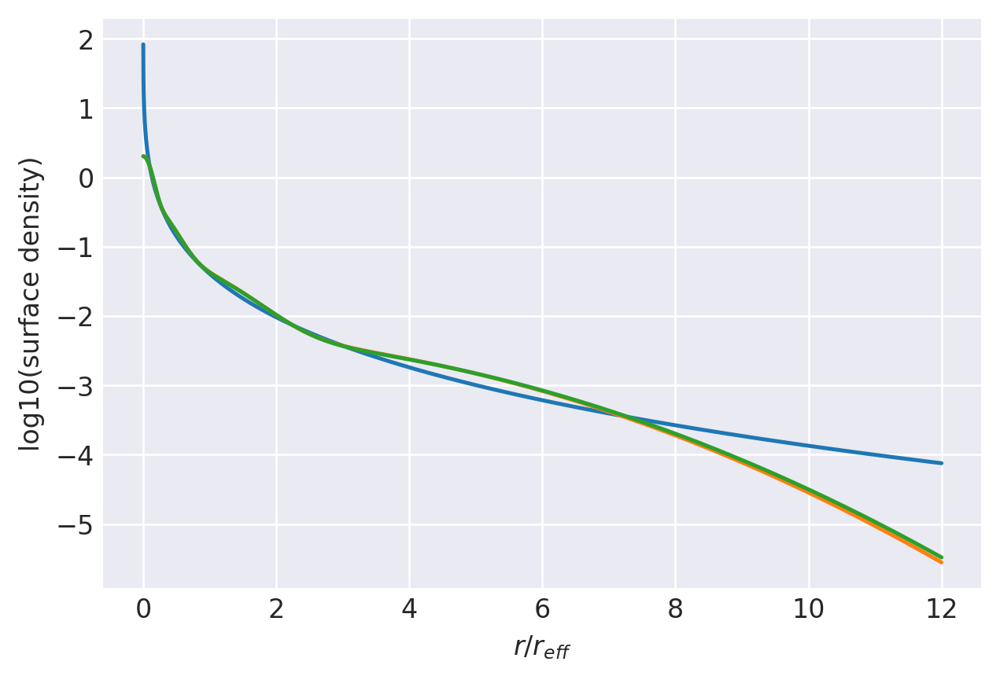

n=4.8: (
    normalize(np.array([3.2746771973e-01, 3.3600943966e-01, 2.2730161732e-01, 1.0922122329e-01])),
    np.array([3.6749036932e+00, 1.0860906591e+00, 3.6966692783e-01, 1.2403261727e-01]),
),
[174, 24000]
0.9562362393759125 0.9997981311812943
prev.  chisq = -6.222851186105536
ws, re: (array([0.32746772, 0.33600944, 0.22730162, 0.10922122]), array([3.67490369, 1.08609066, 0.36966693, 0.12403262]))
Optimization terminated successfully.
         Current function value: -6.225215
         Iterations: 12
         Function evaluations: 162
         Gradient evaluations: 18
-6.225215425777316 [-0.72521846 -0.01527781  0.71607182  0.57030598  0.03954802 -0.42869271
 -0.90133666]
0.9562362393759125 0.9997615373703368


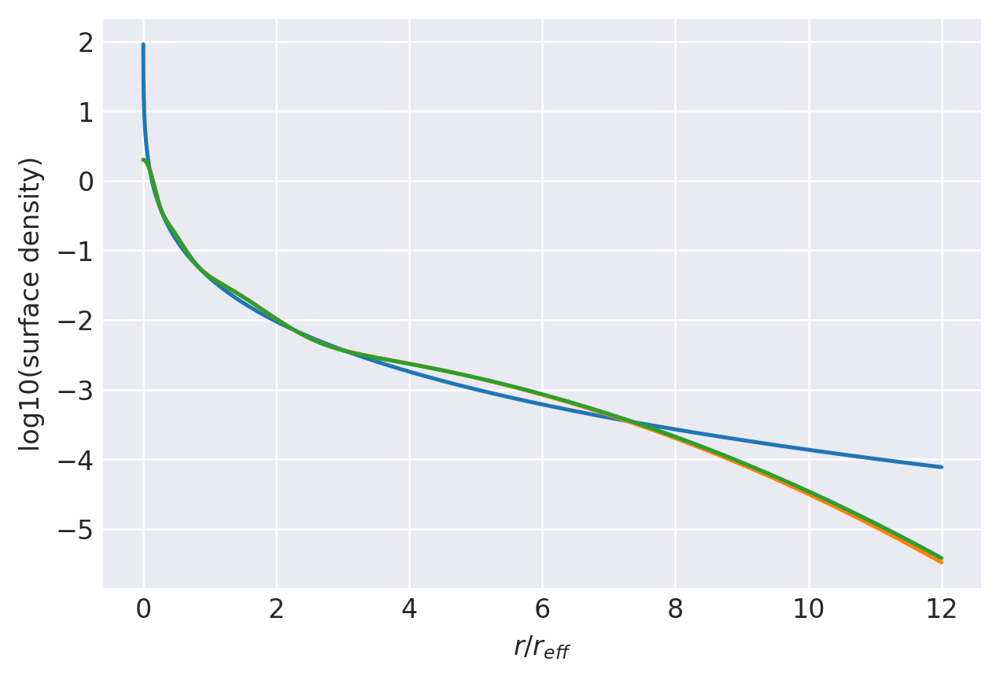

n=4.9: (
    normalize(np.array([3.2624487953e-01, 3.3430423388e-01, 2.2802322043e-01, 1.1142766615e-01])),
    np.array([3.7179708567e+00, 1.0953376614e+00, 3.7265529107e-01, 1.2550566856e-01]),
),
[180, 24000]
0.9543743004887094 0.9997615373703368
prev.  chisq = -6.2375579600091005
ws, re: (array([0.32624488, 0.33430423, 0.22802322, 0.11142767]), array([3.71797086, 1.09533766, 0.37265529, 0.12550567]))
Optimization terminated successfully.
         Current function value: -6.239861
         Iterations: 12
         Function evaluations: 153
         Gradient evaluations: 17
-6.239861275459192 [-0.7322784  -0.03012773  0.6984236   0.57577555  0.04404286 -0.4240244
 -0.89464528]
0.9543743004887094 0.9997159507352003


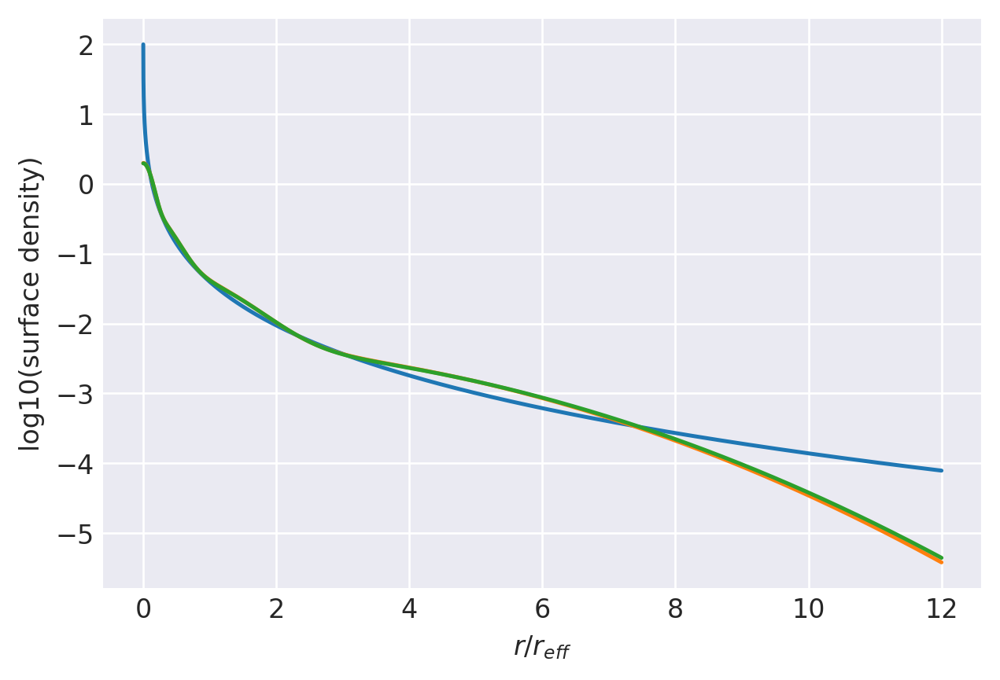

n=5.0: (
    normalize(np.array([3.2469494814e-01, 3.3256655791e-01, 2.2889384877e-01, 1.1384464518e-01])),
    np.array([3.7650916671e+00, 1.1067330058e+00, 3.7668263630e-01, 1.2745436702e-01]),
),
[185, 24000]
0.9525152435859581 0.9997159507352003
prev.  chisq = -6.249630904817529
ws, re: (array([0.32469495, 0.33256656, 0.22889385, 0.11384465]), array([3.76509167, 1.10673301, 0.37668264, 0.12745437]))
Optimization terminated successfully.
         Current function value: -6.251657
         Iterations: 11
         Function evaluations: 162
         Gradient evaluations: 18
-6.251656691153456 [-0.73754772 -0.04308008  0.68278168  0.580627    0.04773573 -0.42041427
 -0.88947197]
0.9525152435859581 0.9996692979967975


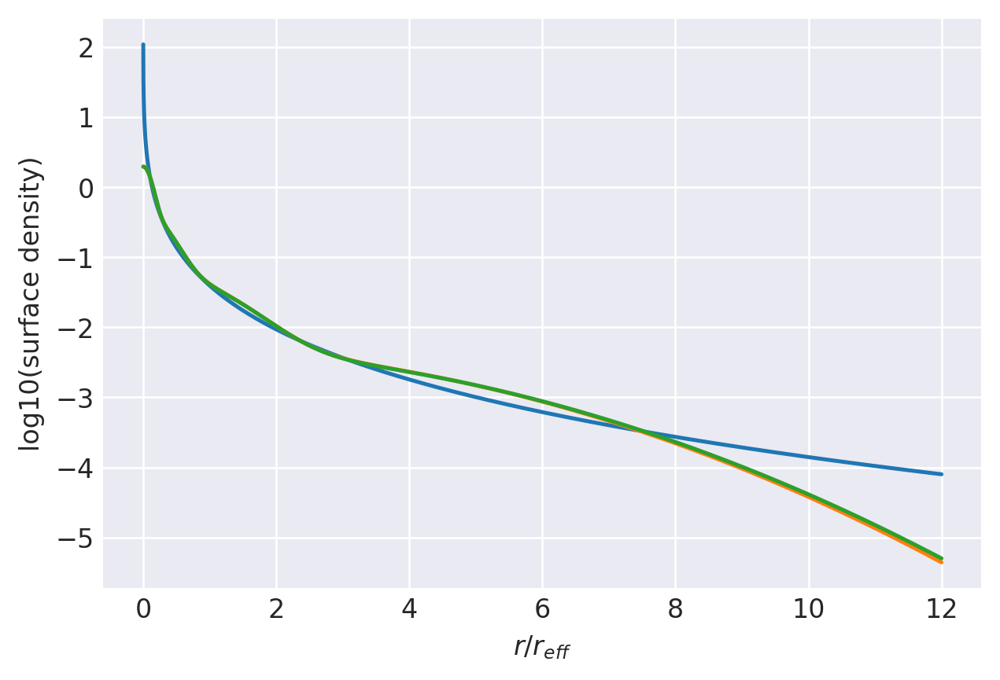

n=5.1: (
    normalize(np.array([3.2354062177e-01, 3.3094533514e-01, 2.2954545295e-01, 1.1596859014e-01])),
    np.array([3.8073867607e+00, 1.1161838442e+00, 3.7982691135e-01, 1.2898167938e-01]),
),
[191, 24000]
0.9506603537901954 0.9996692979967975
prev.  chisq = -6.264852754543693
ws, re: (array([0.32354062, 0.33094534, 0.22954545, 0.11596859]), array([3.80738676, 1.11618384, 0.37982691, 0.12898168]))
Optimization terminated successfully.
         Current function value: -6.266887
         Iterations: 11
         Function evaluations: 180
         Gradient evaluations: 20
-6.266887352949011 [-0.74420866 -0.05706648  0.66637265  0.58587117  0.05221028 -0.41568098
 -0.88280864]
0.9506603537901954 0.9996119777083153


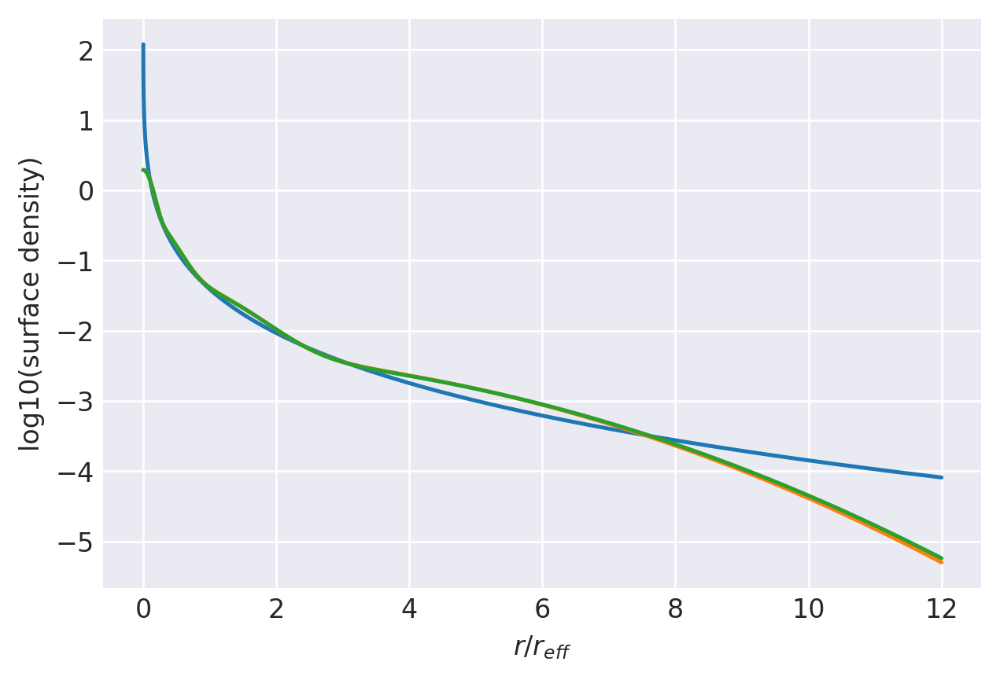

n=5.2: (
    normalize(np.array([3.2208451164e-01, 3.2928880600e-01, 2.3033432291e-01, 1.1829235945e-01])),
    np.array([3.8536402697e+00, 1.1277433735e+00, 3.8398920662e-01, 1.3097588978e-01]),
),
[196, 24000]
0.9488107935787129 0.9996119777083153
prev.  chisq = -6.277500830421351
ws, re: (array([0.32208451, 0.32928881, 0.23033432, 0.11829236]), array([3.85364027, 1.12774337, 0.38398921, 0.13097589]))
Optimization terminated successfully.
         Current function value: -6.279258
         Iterations: 13
         Function evaluations: 162
         Gradient evaluations: 18
-6.2792578267479175 [-0.74915034 -0.06925394  0.65182532  0.59051085  0.05588784 -0.41199812
 -0.87762941]
0.9488107935787129 0.9995542137802987


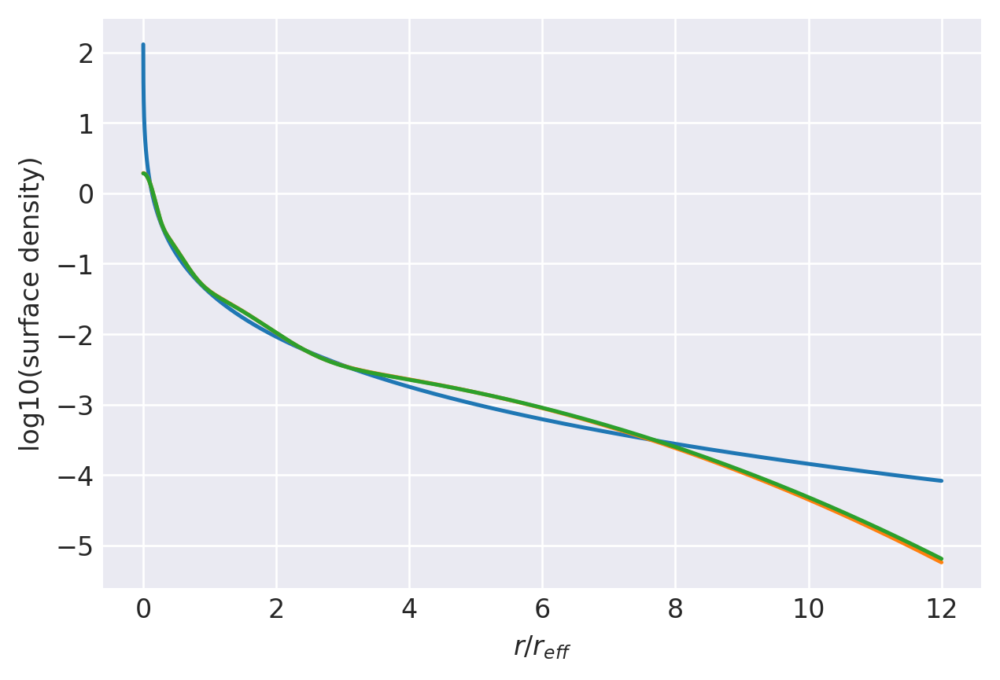

n=5.3: (
    normalize(np.array([3.2100646597e-01, 3.2774571939e-01, 2.3091792689e-01, 1.2032988775e-01])),
    np.array([3.8950303921e+00, 1.1373335203e+00, 3.8725932020e-01, 1.3254720867e-01]),
),
[205, 24000]
0.9451317570150136 0.9995542137802987
prev.  chisq = -6.295484588631517
ws, re: (array([0.32100647, 0.32774572, 0.23091793, 0.12032989]), array([3.89503039, 1.13733352, 0.38725932, 0.13254721]))
Optimization terminated successfully.
         Current function value: -6.301688
         Iterations: 13
         Function evaluations: 171
         Gradient evaluations: 19
-6.301687915839639 [-0.7571598  -0.09128736  0.62537625  0.59901037  0.06244606 -0.40559044
 -0.86867603]
0.9451317570150136 0.9994292214419578


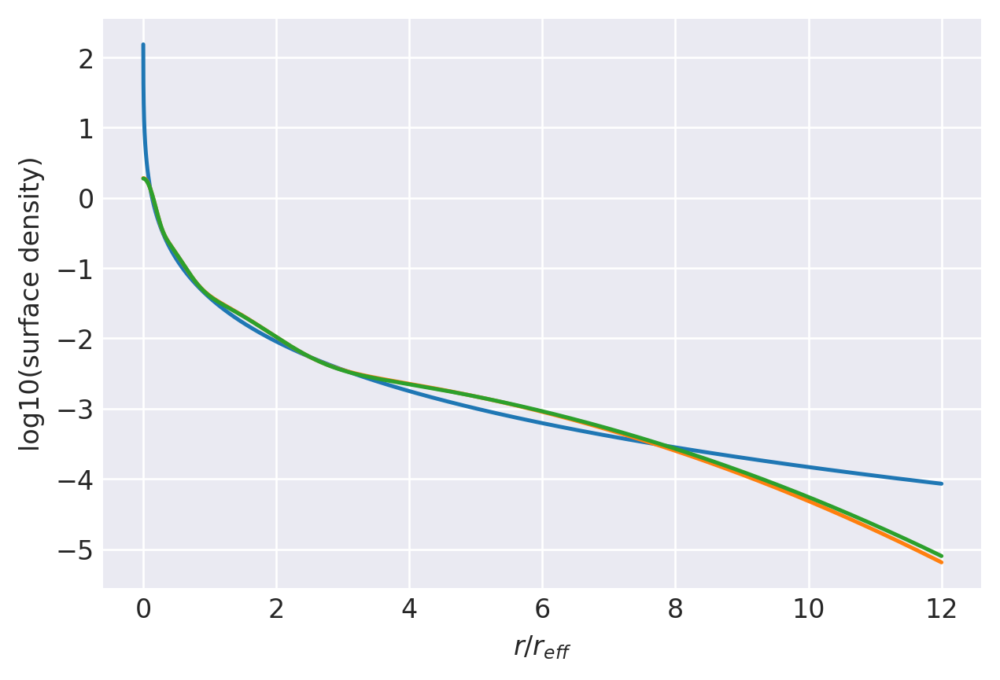

n=5.5: (
    normalize(np.array([3.1926322171e-01, 3.2484350361e-01, 2.3184322235e-01, 1.2405005232e-01])),
    np.array([3.9720103687e+00, 1.1546385730e+00, 3.9301539425e-01, 1.3530815580e-01]),
),
[205, 24000]
0.9451317570150136 0.9994292214419578
prev.  chisq = -6.301687915839639
ws, re: (array([0.31926322, 0.3248435 , 0.23184322, 0.12405005]), array([3.97201037, 1.15463857, 0.39301539, 0.13530816]))
Optimization terminated successfully.
         Current function value: -6.301688
         Iterations: 0
         Function evaluations: 9
         Gradient evaluations: 1
-6.301687915839639 [-0.7571598  -0.09128736  0.62537625  0.59901037  0.06244606 -0.40559044
 -0.86867603]
0.9451317570150136 0.9994292214419578


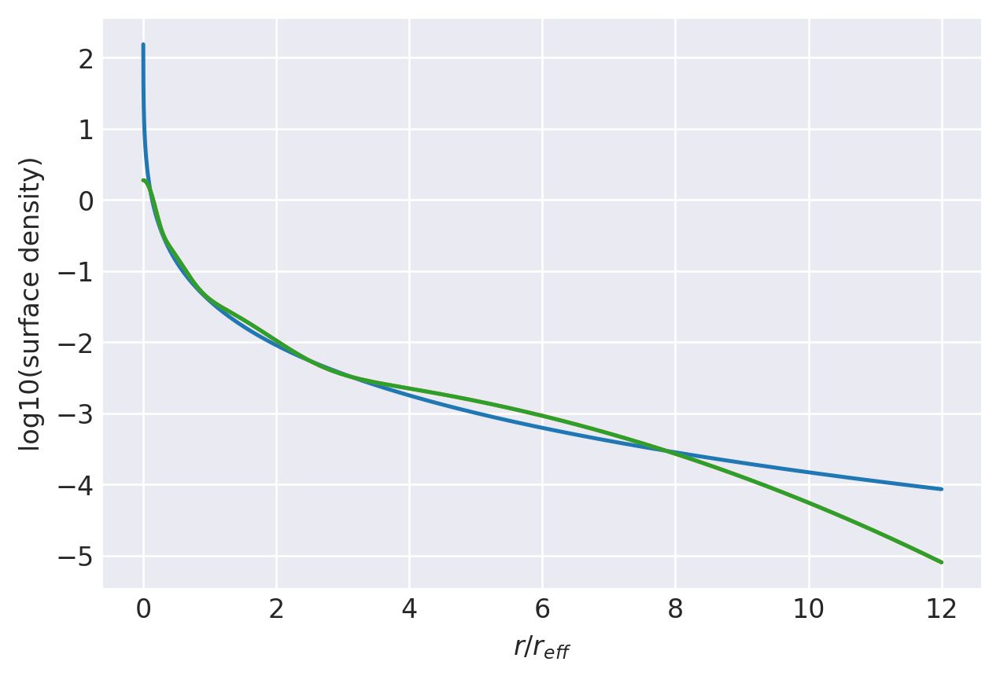

n=5.5: (
    normalize(np.array([3.1926322171e-01, 3.2484350361e-01, 2.3184322235e-01, 1.2405005232e-01])),
    np.array([3.9720103687e+00, 1.1546385730e+00, 3.9301539425e-01, 1.3530815580e-01]),
),
[209, 24000]
0.9433040775806638 0.9994292214419578
prev.  chisq = -6.310377523018106
ws, re: (array([0.31926322, 0.3248435 , 0.23184322, 0.12405005]), array([3.97201037, 1.15463857, 0.39301539, 0.13530816]))
Optimization terminated successfully.
         Current function value: -6.311736
         Iterations: 11
         Function evaluations: 162
         Gradient evaluations: 18
-6.311736393670239 [-0.76029369 -0.10121411  0.61336763  0.60288514  0.06533367 -0.40285791
 -0.86487698]
0.9433040775806638 0.9993629933566426


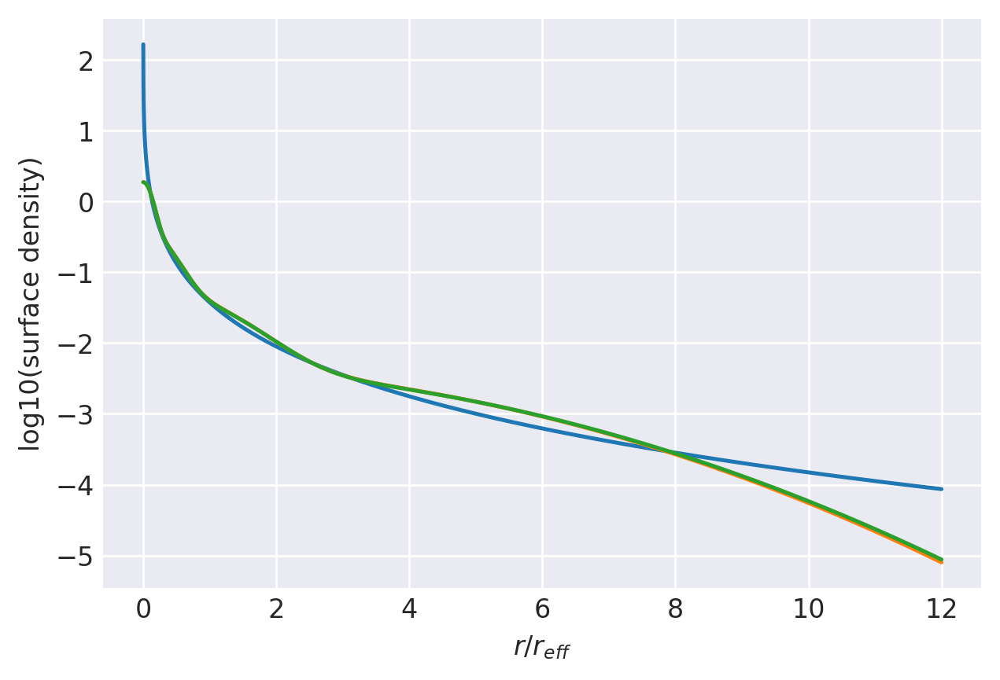

n=5.6: (
    normalize(np.array([3.1858250565e-01, 3.2348118601e-01, 2.3219636882e-01, 1.2573993952e-01])),
    np.array([4.0076071627e+00, 1.1623413112e+00, 3.9549599192e-01, 1.3649697288e-01]),
),
[213, 24000]
0.9414853378702125 0.9993629933566426
prev.  chisq = -6.320738831788962
ws, re: (array([0.31858251, 0.32348119, 0.23219637, 0.12573994]), array([4.00760716, 1.16234131, 0.39549599, 0.13649697]))
Optimization terminated successfully.
         Current function value: -6.322007
         Iterations: 10
         Function evaluations: 153
         Gradient evaluations: 17
-6.322007375843928 [-0.76333715 -0.11087764  0.60173107  0.60667395  0.06821406 -0.40009306
 -0.86105632]
0.9414853378702125 0.9992921592252119


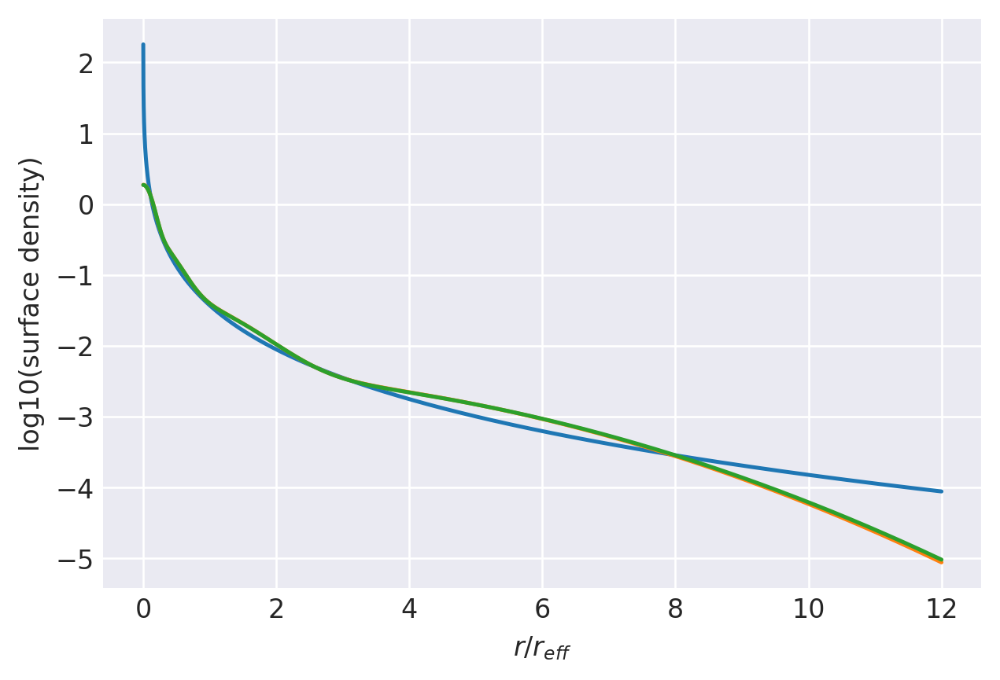

n=5.7: (
    normalize(np.array([3.1792217398e-01, 3.2215146334e-01, 2.3253123590e-01, 1.2739512678e-01])),
    np.array([4.0427227025e+00, 1.1700759613e+00, 3.9802187526e-01, 1.3770308773e-01]),
),
[217, 24000]
0.9396762213094526 0.9992921592252119
prev.  chisq = -6.331293457470066
ws, re: (array([0.31792217, 0.32215146, 0.23253124, 0.12739513]), array([4.0427227 , 1.17007596, 0.39802188, 0.13770309]))
Optimization terminated successfully.
         Current function value: -6.332481
         Iterations: 11
         Function evaluations: 162
         Gradient evaluations: 18
-6.332480980928606 [-0.76628809 -0.12028556  0.59045189  0.61037842  0.07108506 -0.39730037
 -0.85721903]
0.9396762213094526 0.9992166919977737


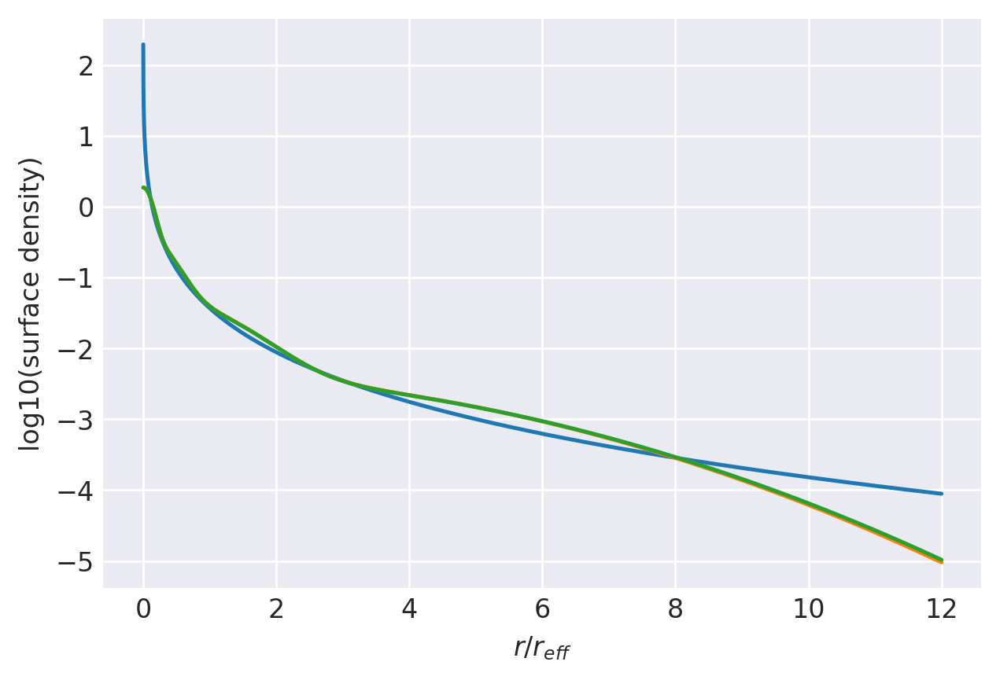

n=5.8: (
    normalize(np.array([3.1728261445e-01, 3.2085314973e-01, 2.3284835415e-01, 1.2901588167e-01])),
    np.array([4.0773540393e+00, 1.1778366399e+00, 4.0058956181e-01, 1.3892518042e-01]),
),
[221, 24000]
0.9378773378820429 0.9992166919977737
prev.  chisq = -6.342024080098564
ws, re: (array([0.31728261, 0.32085315, 0.23284835, 0.12901588]), array([4.07735404, 1.17783664, 0.40058956, 0.13892518]))
Optimization terminated successfully.
         Current function value: -6.343139
         Iterations: 11
         Function evaluations: 162
         Gradient evaluations: 18
-6.343138876353607 [-0.76914502 -0.12944502  0.57951672  0.61400036  0.07394476 -0.39448403
 -0.85336946]
0.9378773378820429 0.9991365795222179


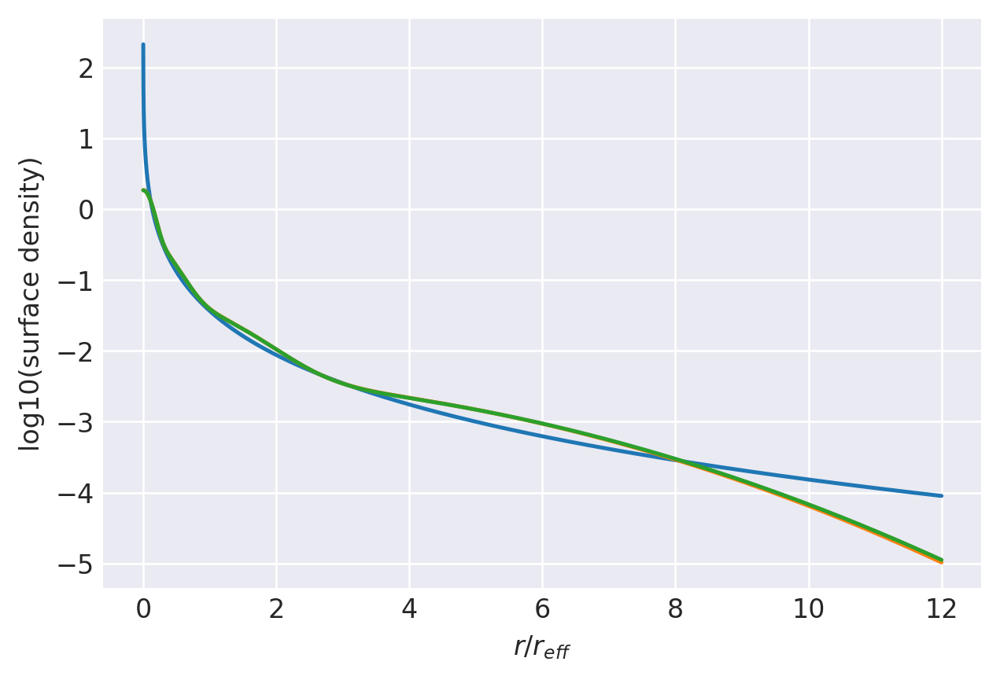

n=5.9: (
    normalize(np.array([3.1666408506e-01, 3.1958517592e-01, 2.3314828965e-01, 1.3060244937e-01])),
    np.array([4.1115006515e+00, 1.1856179306e+00, 4.0319577574e-01, 1.4016208249e-01]),
),
[224, 24000]
0.9360892302700337 0.9991365795222179
prev.  chisq = -6.349974966250162
ws, re: (array([0.31666409, 0.31958518, 0.23314829, 0.13060245]), array([4.11150065, 1.18561793, 0.40319578, 0.14016208]))
Optimization terminated successfully.
         Current function value: -6.350985
         Iterations: 10
         Function evaluations: 162
         Gradient evaluations: 18
-6.350984881045008 [-0.77065292 -0.1371939   0.56995372  0.61709534  0.07606035 -0.39264979
 -0.85084487]
0.9360892302700337 0.9990622881197191


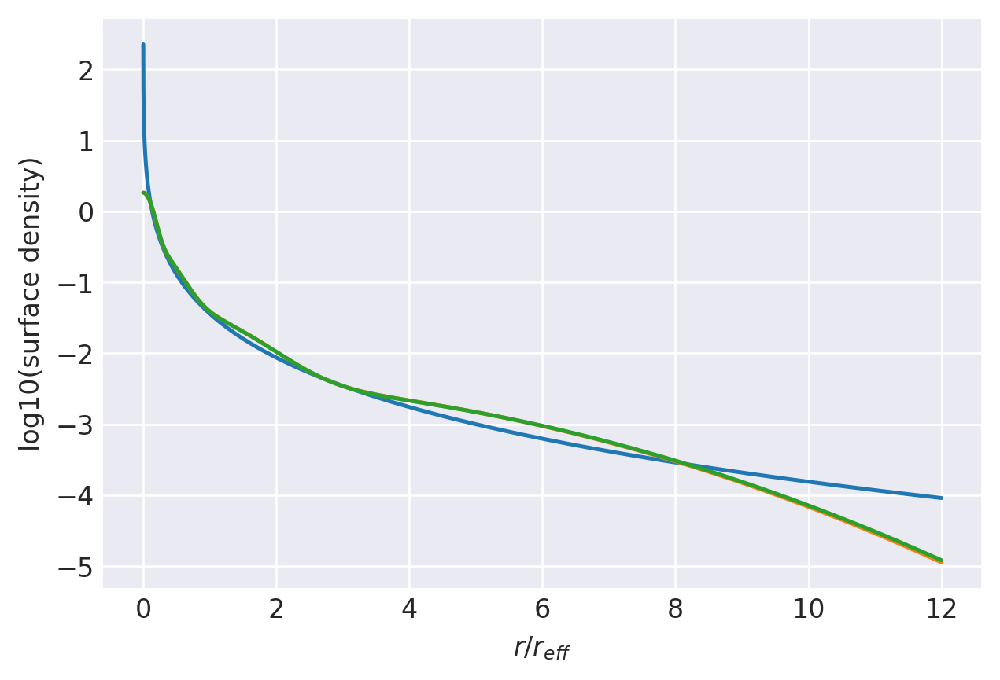

n=6.0: (
    normalize(np.array([3.1633788343e-01, 3.1841920091e-01, 2.3329982383e-01, 1.3194309184e-01])),
    np.array([4.1409057238e+00, 1.1914075509e+00, 4.0490227192e-01, 1.4097922958e-01]),
),
[228, 24000]
0.9334283101933241 0.9990622881197191
prev.  chisq = -6.359497480107359
ws, re: (array([0.31633788, 0.3184192 , 0.23329982, 0.13194309]), array([4.14090572, 1.19140755, 0.40490227, 0.14097923]))
Optimization terminated successfully.
         Current function value: -6.361596
         Iterations: 13
         Function evaluations: 171
         Gradient evaluations: 19
-6.361595881971248 [-0.77223256 -0.14789453  0.55661637  0.62138923  0.07886177 -0.39034049
 -0.84766381]
0.9334283101933241 0.9989502044277765


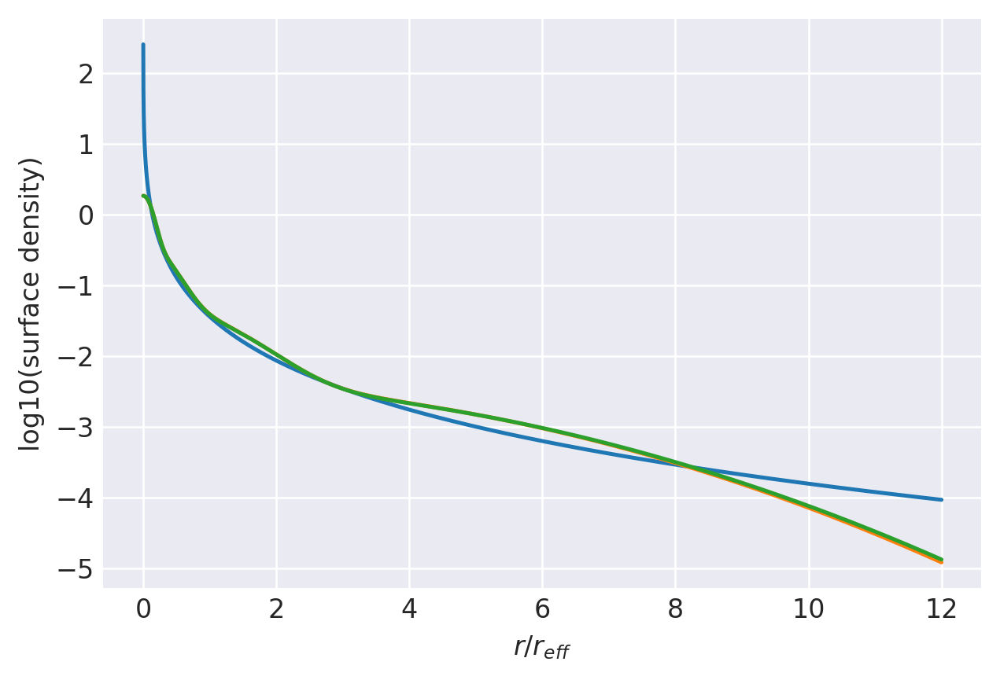

n=6.15: (
    normalize(np.array([3.1599635761e-01, 3.1675771866e-01, 2.3344694903e-01, 1.3379897469e-01])),
    np.array([4.1820500797e+00, 1.1991175666e+00, 4.0706101419e-01, 1.4201564592e-01]),
),
[232, 24000]
0.9307940951591035 0.9989502044277765
prev.  chisq = -6.370682050333252
ws, re: (array([0.31599636, 0.31675772, 0.23344695, 0.13379897]), array([4.18205008, 1.19911757, 0.40706101, 0.14201565]))
Optimization terminated successfully.
         Current function value: -6.372572
         Iterations: 13
         Function evaluations: 171
         Gradient evaluations: 19
-6.372571820800782 [-0.77375867 -0.15821872  0.54382041  0.62554165  0.08165605 -0.38796423
 -0.84441221]
0.9307940951591035 0.9988315716191938


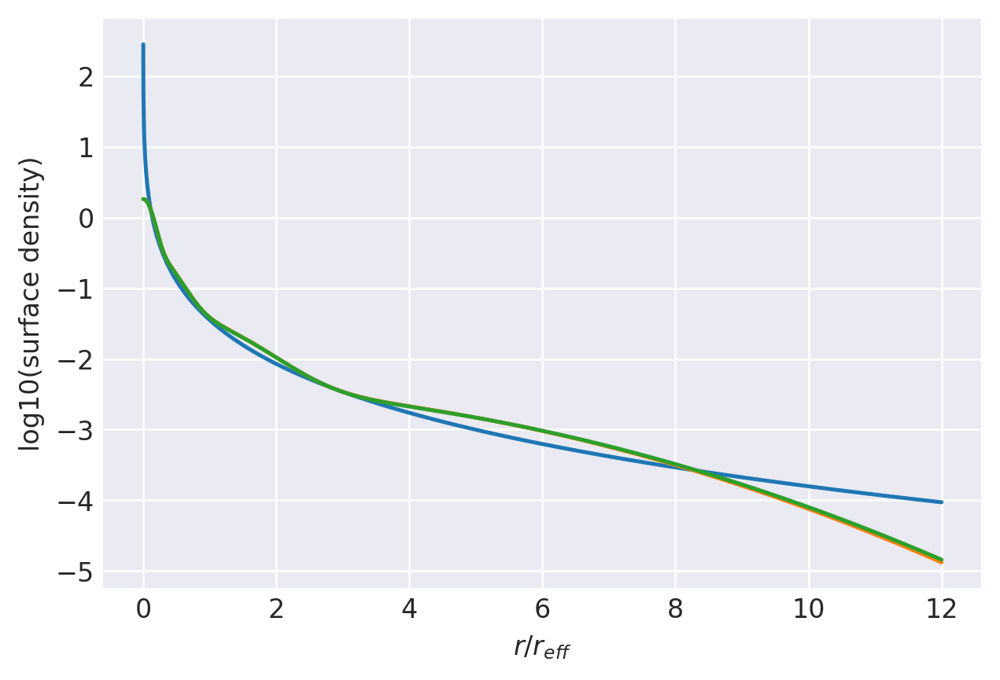

n=6.3: (
    normalize(np.array([3.1566659195e-01, 3.1515444098e-01, 2.3357978874e-01, 1.3559917832e-01])),
    np.array([4.2222277097e+00, 1.2068576445e+00, 4.0929437249e-01, 1.4308291759e-01]),
),
[235, 24000]
0.9281877248795032 0.9988315716191938
prev.  chisq = -6.379148930032501
ws, re: (array([0.31566659, 0.31515444, 0.23357979, 0.13559918]), array([4.22222771, 1.20685764, 0.40929437, 0.14308292]))
Optimization terminated successfully.
         Current function value: -6.380918
         Iterations: 13
         Function evaluations: 162
         Gradient evaluations: 18
-6.380918234806554 [-0.77407373 -0.16709249  0.53249294  0.62912825  0.08372122 -0.38651543
 -0.8424002 ]
0.9281877248795032 0.9987196030428996


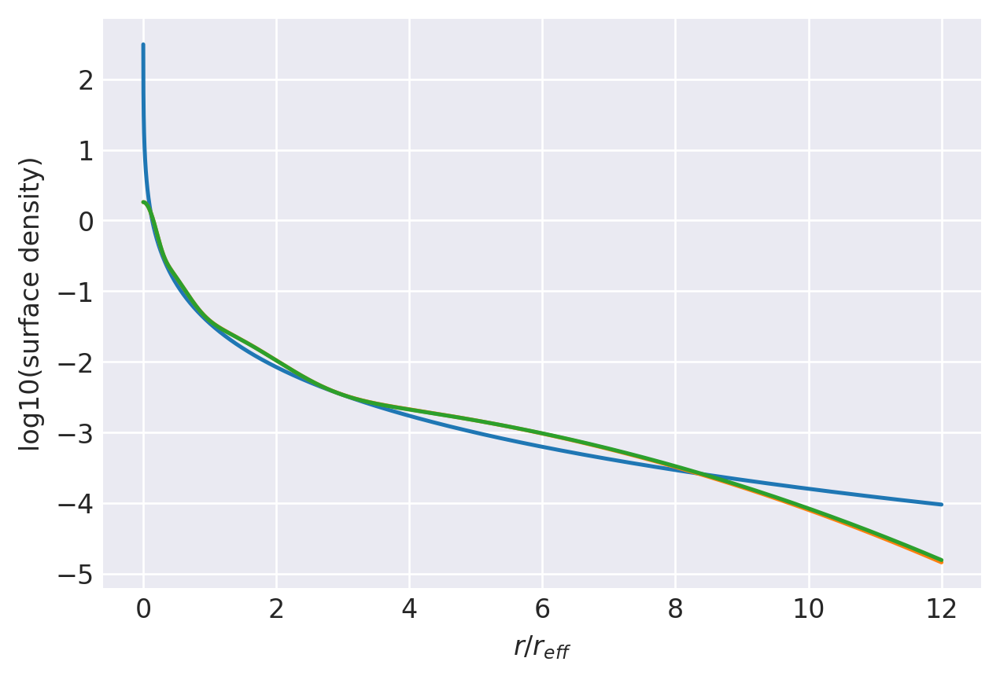

n=6.45: (
    normalize(np.array([3.1559853518e-01, 3.1367747894e-01, 2.3357997180e-01, 1.3714401408e-01])),
    np.array([4.2572411182e+00, 1.2126102151e+00, 4.1066204801e-01, 1.4374733393e-01]),
),
[237, 24000]
0.925610119750512 0.9987196030428996
prev.  chisq = -6.384871070490371
ws, re: (array([0.31559854, 0.31367748, 0.23357997, 0.13714401]), array([4.25724112, 1.21261022, 0.41066205, 0.14374733]))
Optimization terminated successfully.
         Current function value: -6.386614
         Iterations: 12
         Function evaluations: 171
         Gradient evaluations: 19
-6.386614081138079 [-0.77325904 -0.17459796  0.52253454  0.63216709  0.08506247 -0.38599131
 -0.84161257]
0.925610119750512 0.9986169827362464


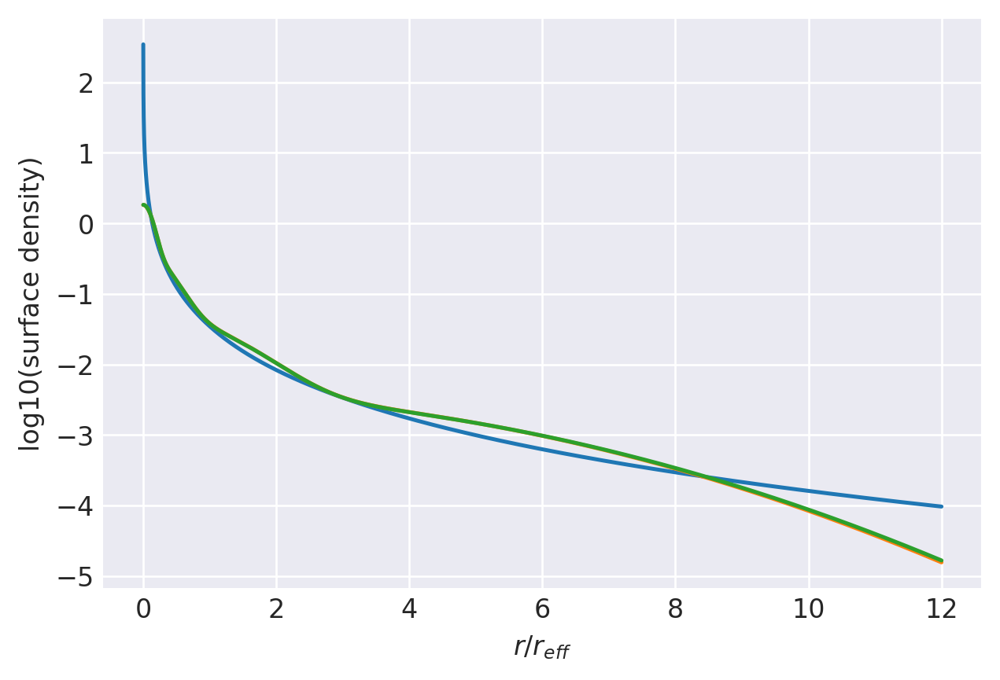

n=6.6: (
    normalize(np.array([3.1577453330e-01, 3.1232228089e-01, 2.3345859343e-01, 1.3844459238e-01])),
    np.array([4.2871343497e+00, 1.2163609444e+00, 4.1115794454e-01, 1.4400826899e-01]),
),
[239, 24000]
0.9230620084235226 0.9986169827362464
prev.  chisq = -6.391016433953971
ws, re: (array([0.31577453, 0.31232228, 0.23345859, 0.13844459]), array([4.28713435, 1.21636094, 0.41115794, 0.14400827]))
Optimization terminated successfully.
         Current function value: -6.392589
         Iterations: 10
         Function evaluations: 162
         Gradient evaluations: 18
-6.392589007686792 [-0.77249552 -0.18186122  0.51294421  0.63510066  0.08640273 -0.38540601
 -0.8407473 ]
0.9230620084235226 0.9985116494697359


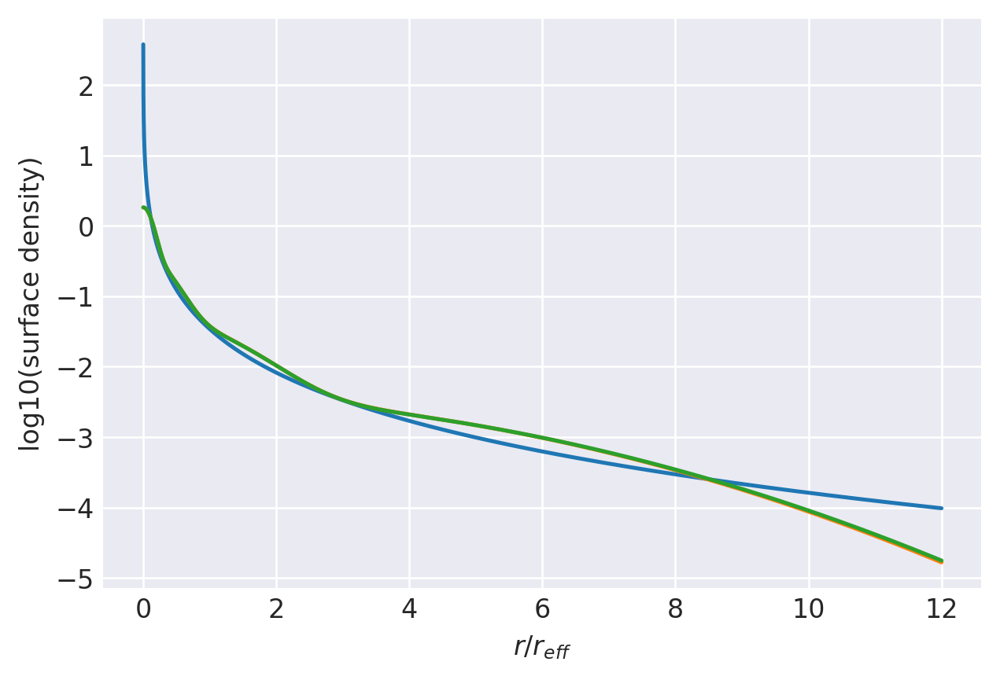

n=6.75: (
    normalize(np.array([3.1593952265e-01, 3.1101465599e-01, 2.3333882297e-01, 1.3970699839e-01])),
    np.array([4.3161910477e+00, 1.2201205225e+00, 4.1171243768e-01, 1.4429546934e-01]),
),
[240, 24000]
0.9188821553764069 0.9985116494697359
prev.  chisq = -6.391437330655235
ws, re: (array([0.31593952, 0.31101466, 0.23333882, 0.139707  ]), array([4.31619105, 1.22012052, 0.41171244, 0.14429547]))
Optimization terminated successfully.
         Current function value: -6.396170
         Iterations: 13
         Function evaluations: 171
         Gradient evaluations: 19
-6.3961697808115705 [-0.76880283 -0.19104714  0.49980768  0.63877912  0.08694403 -0.3866216
 -0.84217389]
0.9188821553764069 0.9983673648715636


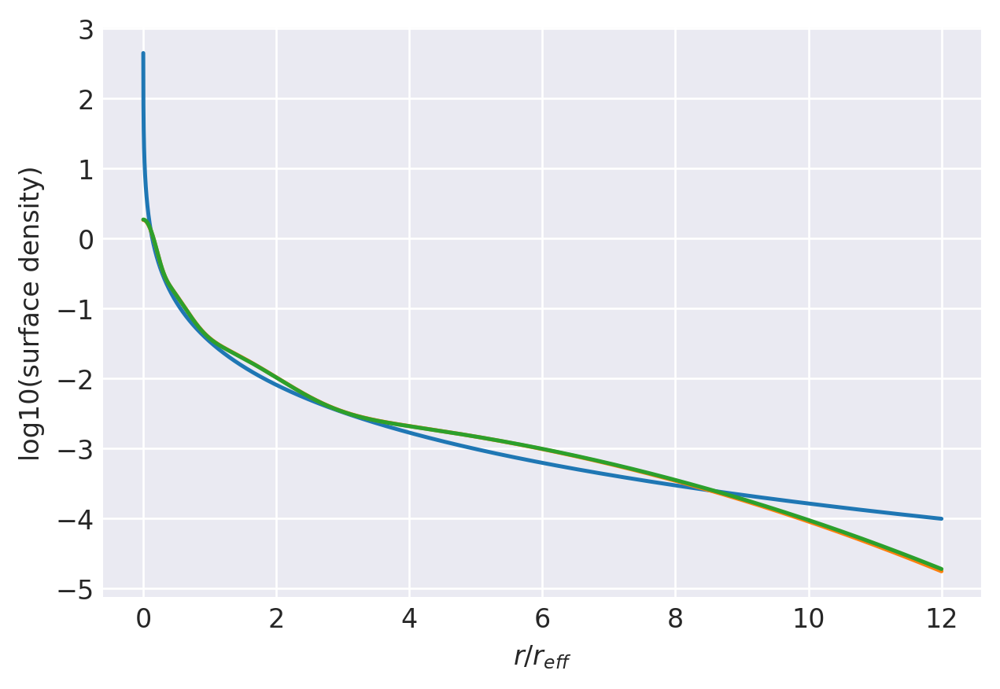

n=7.0: (
    normalize(np.array([3.1673813499e-01, 3.0909602449e-01, 2.3288610782e-01, 1.4127973270e-01])),
    np.array([4.3529042621e+00, 1.2216422105e+00, 4.1056167044e-01, 1.4382226070e-01]),
),
[239, 24000]
0.9147874621973633 0.9983673648715636
prev.  chisq = -6.389015727121357
ws, re: (array([0.31673813, 0.30909602, 0.23288611, 0.14127973]), array([4.35290426, 1.22164221, 0.41056167, 0.14382226]))
Optimization terminated successfully.
         Current function value: -6.394317
         Iterations: 11
         Function evaluations: 153
         Gradient evaluations: 17
-6.394316753361686 [-0.76322719 -0.19770017  0.48919623  0.64135907  0.0860015  -0.38972407
 -0.84604537]
0.9147874621973633 0.9982559291720297


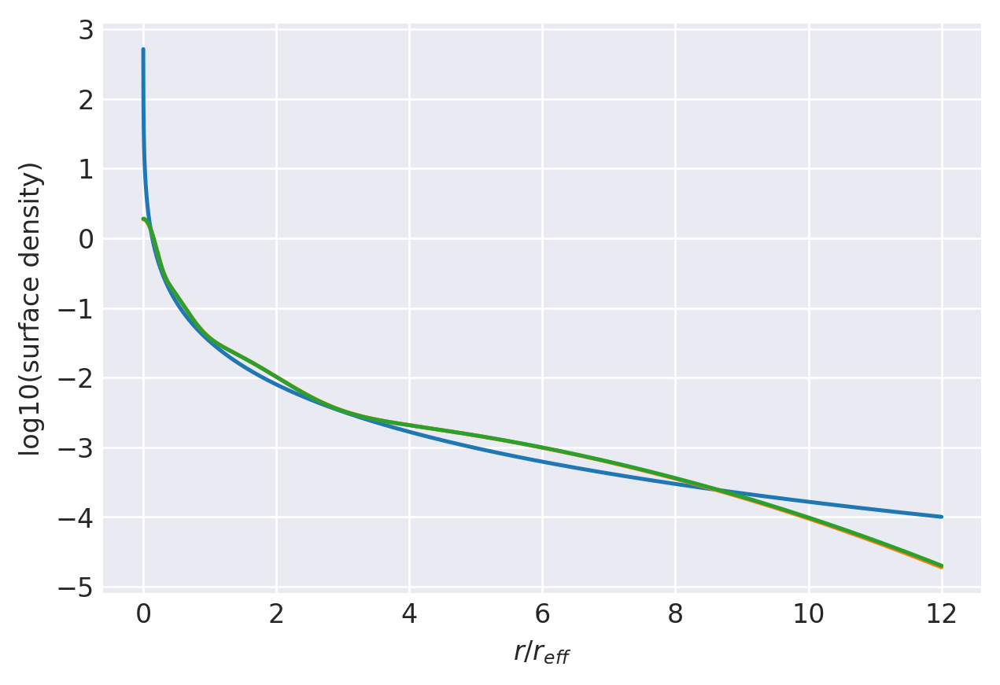

n=7.25: (
    normalize(np.array([3.1794601785e-01, 3.0742581612e-01, 2.3223839371e-01, 1.4238977233e-01])),
    np.array([4.3788399409e+00, 1.2189938031e+00, 4.0763919340e-01, 1.4254586811e-01]),
),
[236, 24000]
0.9107787615124019 0.9982559291720297
prev.  chisq = -6.3804157162386215
ws, re: (array([0.31794602, 0.30742582, 0.23223839, 0.14238977]), array([4.37883994, 1.2189938 , 0.40763919, 0.14254587]))
Optimization terminated successfully.
         Current function value: -6.386779
         Iterations: 12
         Function evaluations: 162
         Gradient evaluations: 18
-6.386779317077752 [-0.7558244  -0.20191735  0.48096702  0.64284346  0.08351414 -0.39481
 -0.85246666]
0.9107787615124019 0.9981838314766684


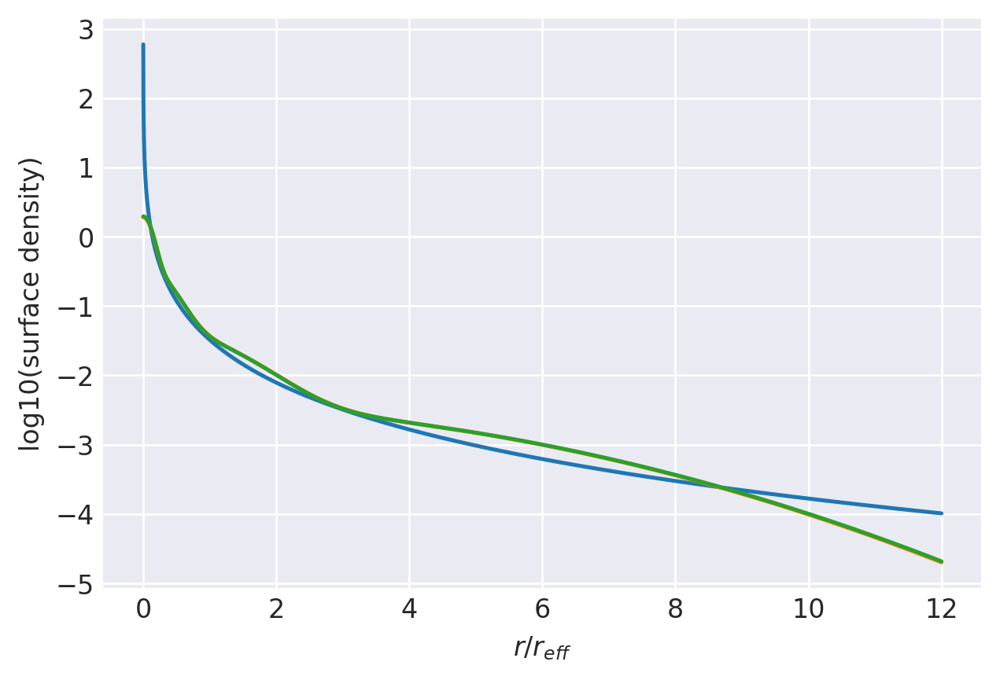

n=7.5: (
    normalize(np.array([3.1955351928e-01, 3.0599097960e-01, 2.3140458644e-01, 1.4305091468e-01])),
    np.array([4.3938321136e+00, 1.2120321414e+00, 4.0289325663e-01, 1.4045374990e-01]),
),
[231, 24000]
0.9068561721135253 0.9981838314766684
prev.  chisq = -6.36524342064764
ws, re: (array([0.31955352, 0.30599098, 0.23140459, 0.14305091]), array([4.39383211, 1.21203214, 0.40289326, 0.14045375]))
Optimization terminated successfully.
         Current function value: -6.373237
         Iterations: 14
         Function evaluations: 180
         Gradient evaluations: 20
-6.373236980099119 [-0.74657575 -0.20373519  0.47503464  0.64320782  0.07938503 -0.40202056
 -0.86160187]
0.9068561721135253 0.9981564757474385


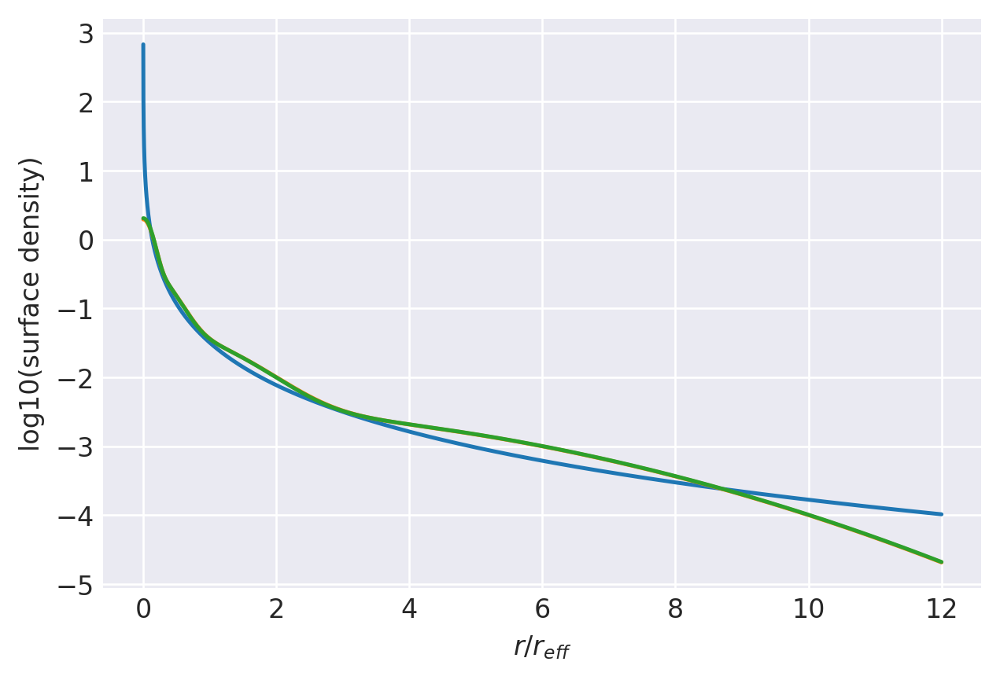

n=7.75: (
    normalize(np.array([3.2156788561e-01, 3.0477996523e-01, 2.3038445918e-01, 1.4326768999e-01])),
    np.array([4.3975199795e+00, 1.2005632008e+00, 3.9625927498e-01, 1.3753021869e-01]),
),
[224, 24000]
0.9030192502990908 0.9981564757474385
prev.  chisq = -6.342981433891881
ws, re: (array([0.32156789, 0.30477997, 0.23038446, 0.14326769]), array([4.39751998, 1.2005632 , 0.39625927, 0.13753022]))
Optimization terminated successfully.
         Current function value: -6.353279
         Iterations: 14
         Function evaluations: 189
         Gradient evaluations: 21
-6.353279298962979 [-0.73538137 -0.2031244   0.47137657  0.64239627  0.07347302 -0.41155307
 -0.87368797]
0.9030192502990908 0.9981780103152986


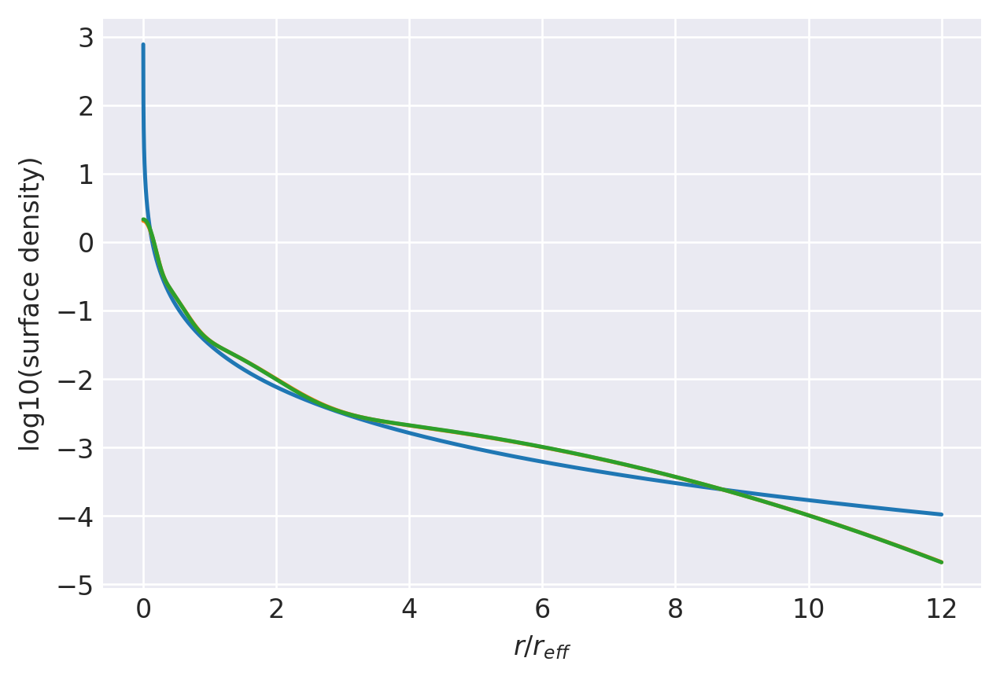

n=8.0: (
    normalize(np.array([3.2401493462e-01, 3.0378280937e-01, 2.2916847254e-01, 1.4303378347e-01])),
    np.array([4.3893101430e+00, 1.1843307847e+00, 3.8765637107e-01, 1.3375561775e-01]),
),


In [10]:
# Fit the softened Sersic from n=1 to n=8
nvals = [
    (
        np.array([
            1., 1.025, 1.05, 1.075, 1.10, 1.135, 1.165, 1.2, 1.225, 1.25, 1.275,
            1.3, 1.333, 1.367, 1.4, 1.433, 1.467, 1.5, 1.55, 1.6, 1.65, 1.7,
            1.75, 1.8, 1.85, 1.9 , 1.95, 2.0, 2.05, 2.1, 2.15, 2.2, 2.25, 2.3,
            2.35, 2.4, 2.45, 2.5, 2.55, 2.6, 2.65, 2.7, 2.75, 2.8, 2.85, 2.9,
            2.95, 3., 3.05, 3.1, 3.15, 3.2, 3.25, 3.3, 3.35, 3.4, 3.45, 3.5,
            3.55, 3.6, 3.65, 3.7, 3.75, 3.8, 3.85, 3.9, 3.95, 4., 4.1, 4.2,
            4.3, 4.4, 4.5, 4.6, 4.7, 4.8, 4.9, 5., 5.1, 5.2, 5.3, 5.5, 5.5,
            5.6, 5.7, 5.8, 5.9, 6., 6.15, 6.3, 6.45, 6.6, 6.75, 7, 7.25, 7.5,
            7.75, 8,
        ]),
        (
            normalize(np.array([3.2466847784e-01, 4.7803210251e-01, 1.7258586760e-01, 2.4713552046e-02])),
            np.array([1.7007792632e+00, 9.7809127671e-01, 5.1487137336e-01, 2.1966932363e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'], funcrangefit=funcrangefitn)

# To grep only the weights from the fit log:
# grep -C 2 normalize file.txt | grep [\(\)] | sed "s/n=//g"
# In reverse order add: | awk '{a[i++]=$0} END {for (j=i-1; j>=0;) { print a[j-3]; print a[j-2]; print a[j-1]; print a[j]; j-=4;}}'

## The graveyard of failed ideas

These are best-fit weights from the unsuccesful attempts - keeping both the weights and sizes free and either dropping components manually or keeping N=8 fixed and hoping for the best. We'll plot these up later along with the more successful fixed size below n=1 approach.

In [11]:
# Test out various spline weighting methods
# This first one is S-M-R-T I mean S-M-A-R-T
weightvarssmrtrev = {
    1.0: (
        normalize(np.array([7.7900190678e-02, 3.1264016273e-01, 3.3937178782e-01, 1.8392530470e-01, 6.5418042323e-02, 1.7095071454e-02, 3.2661231097e-03, 3.8331719642e-04])),
        np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02])
    ),
    0.95: (
        normalize(np.array([8.1403269909e-02, 3.2580644822e-01, 3.4058504404e-01, 1.7513222856e-01, 5.9192552167e-02, 1.4829085839e-02, 2.7394820156e-03, 3.1188925295e-04])),
        np.array([2.0580646746e+00, 1.4290161052e+00, 9.7686981214e-01, 6.4569266618e-01, 4.0748443014e-01, 2.4091847021e-01, 1.2844509011e-01, 5.5475573206e-02]),
    ),
    0.9: (
        normalize(np.array([8.3272428552e-02, 3.3761909938e-01, 3.4261897732e-01, 1.6737529882e-01, 5.3685032163e-02, 1.2877296215e-02, 2.2983216755e-03, 2.5354586925e-04])),
        np.array([1.9527835416e+00, 1.3873099285e+00, 9.6414763955e-01, 6.4496927062e-01, 4.1081182437e-01, 2.4485938373e-01, 1.3161541508e-01, 5.7397686985e-02]),
    ),
    0.85: (
        normalize(np.array([8.8648139071e-02, 3.5515361752e-01, 3.4150494943e-01, 1.5534344140e-01, 4.6674515325e-02, 1.0649023584e-02, 1.8309459995e-03, 1.9536767345e-04])),
        np.array([1.8404078380e+00, 1.3380994716e+00, 9.4543542703e-01, 6.3983409725e-01, 4.1113219993e-01, 2.4697493906e-01, 1.3384622629e-01, 5.8963889270e-02]),
    ),
    0.8: (
        normalize(np.array([9.5687123517e-02, 3.7600373993e-01, 3.3791793777e-01, 1.4102874894e-01, 3.9315698812e-02, 8.4969058837e-03, 1.4050252856e-03, 1.4481985933e-04])),
        np.array([1.7282573092e+00, 1.2882067554e+00, 9.2633448695e-01, 6.3439449883e-01, 4.1120486913e-01, 2.4896361205e-01, 1.3607248303e-01, 6.0593077676e-02]),
    ),
    0.75: (
        normalize(np.array([1.0845562525e-01, 4.0294151495e-01, 3.2729844440e-01, 1.2246687144e-01, 3.1333936150e-02, 6.3893051250e-03, 1.0137209694e-03, 1.0058171985e-04])),
        np.array([1.6116987996e+00, 1.2333069456e+00, 9.0359039048e-01, 6.2645430811e-01, 4.0957694795e-01, 2.5288574221e-01, 1.3272691536e-01, 6.1993912159e-02]),
    ),
    0.7: (
        normalize(np.array([1.1584759935e-01, 4.4925832966e-01, 3.1925666847e-01, 9.4161947089e-02, 1.8473365773e-02, 2.7452558180e-03, 2.5683384766e-04, 0])),
        np.array([1.5085840400e+00, 1.1827064676e+00, 8.7020346704e-01, 5.9083650141e-01, 3.6842090584e-01, 2.0622530253e-01, 9.4309343285e-02, 6.3000000000e-02]),
    ),
    0.65: (
        normalize(np.array([2.6183027504e-01, 5.1131393105e-01, 1.8810590649e-01, 3.3865510527e-02, 4.4969433749e-03, 3.8743351832e-04, 0, 0])),
        np.array([1.3289631973e+00, 1.0385774455e+00, 7.3841834696e-01, 4.7109549871e-01, 2.6719483672e-01, 1.2384372936e-01, 3.0000000000e-02, -1]),
    ),
    0.60: (
        normalize(np.array([4.1546178873e-01, 4.7896375027e-01, 9.4459324448e-02, 1.0342408068e-02, 7.7272848509e-04, 0, 0, 0])),
        np.array([1.2056568803e+00, 9.5376794968e-01, 6.5169818599e-01, 3.7969948423e-01, 1.7909375620e-01, 4.0e-2, -1, -1]),
    ),
    #0.58: (
    #    normalize(np.array([4.5627440940e-01, 4.5801419853e-01, 7.7273178826e-02, 7.8676616590e-03, 5.7055159001e-04, 0, 0, 0])),
    #    np.array([1.1683467566e+00, 9.4363227290e-01, 6.5093086112e-01, 3.8085301923e-01, 1.8069824796e-01, -1, -1, -1]),
    #),
    0.56: (
        normalize(np.array([5.1383520859e-01, 4.2259270295e-01, 5.7812648759e-02, 5.3832054183e-03, 3.7623428159e-04, 0, 0, 0])),
        np.array([1.1295299365e+00, 9.3257427802e-01, 6.4722357532e-01, 3.7870305436e-01, 1.8038588490e-01, -1, -1, -1]),
    ),
    0.55: (
        normalize(np.array([5.5214529709e-01, 3.9529450455e-01, 4.7928536367e-02, 4.3319689703e-03, 2.9969302520e-04, 0, 0, 0])),
        np.array([1.1094018518e+00, 9.2705543556e-01, 6.4619989426e-01, 3.7926137736e-01, 1.8130968040e-01, -1, -1, -1]),
    ),
    0.54: (
        normalize(np.array([5.9919829101e-01, 3.5948801370e-01, 3.7771361281e-02, 3.3145069862e-03, 2.2782702383e-04, 0, 0, 0])),
        np.array([1.0888531764e+00, 9.2149653125e-01, 6.4439708848e-01, 3.7928399702e-01, 1.8209937478e-01, -1, -1, -1]),
    ),
    0.535: (
        normalize(np.array([6.3126439025e-01, 3.3392767586e-01, 3.1879935445e-02, 2.7407850764e-03, 1.8721337590e-04, 0, 0, 0])),
        np.array([1.0779584267e+00, 9.1705503997e-01, 6.4002041507e-01, 3.7627159296e-01, 1.8081161389e-01, -1, -1, -1]),
    ),
    0.515: (
        normalize(np.array([8.4097559276e-01, 1.5169627279e-01, 6.9714772900e-03, 3.5665715873e-04, 0, 0, 0, 0])),
        np.array([1.0309116597e+00, 8.7408078966e-01, 5.5036185175e-01, 2.6808638784e-01, 1.60e-01, -1, -1, -1]),
    ),
    0.507: (
        normalize(np.array([9.4662548327e-01, 5.2171305034e-02, 1.2032116992e-03, 0, 0, 0, 0, 0])),
        np.array([1.0122615136e+00, 8.2195507899e-01, 4.2112943705e-01, 1.5e-1, -1, -1, -1, -1]),
    ),
    0.501: (
        normalize(np.array([9.9645469317e-01, 3.5453068336e-03, 0, 0, 0, 0, 0, 0])),
        np.array([1.0012334877e+00, 7.1605157116e-01, 3.2e-1, -1, -1, -1, -1, -1]),
    ),
}
weightvarssmrt = {key: weightvarssmrtrev[key] for key in list(weightvarssmrtrev.keys())[::-1]}

weightvarslinrev = {
    1.0: (
        normalize(np.array([7.7900190678e-02, 3.1264016273e-01, 3.3937178782e-01, 1.8392530470e-01, 6.5418042323e-02, 1.7095071454e-02, 3.2661231097e-03, 3.8331719642e-04])),
        np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02])
    ),
    0.995: (
        normalize(np.array([7.8446183932e-02, 3.1406434947e-01, 3.3932384870e-01, 1.8296223981e-01, 6.4764639051e-02, 1.6854415782e-02, 3.2090104756e-03, 3.7531277364e-04])),
        np.array([2.1583165776e+00, 1.4713798133e+00, 9.9276532523e-01, 6.4986444561e-01, 4.0693622906e-01, 2.3891710322e-01, 1.2647686885e-01, 5.4168977602e-02]),
    ),
    0.99: (
        normalize(np.array([7.8748882011e-02, 3.1527662000e-01, 3.3948179457e-01, 1.8216089349e-01, 6.4173199336e-02, 1.6633815653e-02, 3.1566703056e-03, 3.6812463680e-04])),
        np.array([2.1471476039e+00, 1.4667048040e+00, 9.9104503426e-01, 6.4944861490e-01, 4.0703634466e-01, 2.3916382111e-01, 1.2670689594e-01, 5.4317404722e-02]),
    ),
    0.985: (
        normalize(np.array([7.8994186452e-02, 3.1641620349e-01, 3.3968469926e-01, 1.8140525885e-01, 6.3605998603e-02, 1.6424599579e-02, 3.1076505756e-03, 3.6140318626e-04])),
        np.array([2.1362142657e+00, 1.4622314919e+00, 9.8948045158e-01, 6.4914027013e-01, 4.0722153691e-01, 2.3947910549e-01, 1.2698412679e-01, 5.4487684484e-02]),
    ),
    0.98: (
        normalize(np.array([7.8389101272e-02, 3.1638765311e-01, 3.4043547772e-01, 1.8156010509e-01, 6.3463387972e-02, 1.6329208096e-02, 3.0783508966e-03, 3.5671584639e-04])),
        np.array([2.1282781338e+00, 1.4604809912e+00, 9.9010354726e-01, 6.5040118063e-01, 4.0839544944e-01, 2.4033837843e-01, 1.2751651151e-01, 5.4759268657e-02]),
    ),
    0.975: (
        normalize(np.array([7.8492259575e-02, 3.1733990238e-01, 3.4064424822e-01, 1.8096336632e-01, 6.3017149586e-02, 1.6156519811e-02, 3.0357224100e-03, 3.5083170430e-04])),
        np.array([2.1178361862e+00, 1.4564466460e+00, 9.8896894906e-01, 6.5051832346e-01, 4.0890150279e-01, 2.4083944712e-01, 1.2788064118e-01, 5.4971854773e-02]),
    ),
    0.97: (
        normalize(np.array([7.8803523011e-02, 3.1858245887e-01, 3.4085154814e-01, 1.8013538246e-01, 6.2376851464e-02, 1.5922265126e-02, 2.9838701624e-03, 3.4410076591e-04])),
        np.array([2.1066586105e+00, 1.4517852082e+00, 9.8724682936e-01, 6.5003217856e-01, 4.0891261440e-01, 2.4105316221e-01, 1.2812638619e-01, 5.5135777007e-02]),
    ),
    0.965: (
        normalize(np.array([7.9652906813e-02, 3.2064939074e-01, 3.4068122966e-01, 1.7869038231e-01, 6.1466919163e-02, 1.5610725907e-02, 2.9134649523e-03, 3.3498045458e-04])),
        np.array([2.0937412212e+00, 1.4454149529e+00, 9.8410731982e-01, 6.4852336195e-01, 4.0824832753e-01, 2.4081266904e-01, 1.2808520606e-01, 5.5176596936e-02]),
    ),
    0.96: (
        normalize(np.array([8.0576453325e-02, 3.2290280030e-01, 3.4043969613e-01, 1.7709543098e-01, 6.0518663358e-02, 1.5295811356e-02, 2.8452778659e-03, 3.2586667691e-04])),
        np.array([2.0807024304e+00, 1.4388256059e+00, 9.8071976898e-01, 6.4685562505e-01, 4.0752304916e-01, 2.4056824190e-01, 1.2805531444e-01, 5.5198631668e-02]),
    ),
    0.955: (
        normalize(np.array([8.1040966768e-02, 3.2441065469e-01, 3.4047060583e-01, 1.7607117085e-01, 5.9838132967e-02, 1.5058095207e-02, 2.7915913744e-03, 3.1878231861e-04])),
        np.array([2.0692003931e+00, 1.4337627137e+00, 9.7867808047e-01, 6.4620077939e-01, 4.0746271722e-01, 2.4072384138e-01, 1.2824200177e-01, 5.5335703966e-02]),
    ),
    0.95: (
        normalize(np.array([8.1450263763e-02, 3.2585428363e-01, 3.4053884485e-01, 1.7509555332e-01, 5.9182670718e-02, 1.4827402200e-02, 2.7392015200e-03, 3.1177999432e-04])),
        np.array([2.0579132805e+00, 1.4288880244e+00, 9.7678450884e-01, 6.4564909129e-01, 4.0746517450e-01, 2.4090898319e-01, 1.2843833062e-01, 5.5469238331e-02]),
    ),
    0.945: (
        normalize(np.array([8.0838455136e-02, 3.2567038291e-01, 3.4122816179e-01, 1.7534334294e-01, 5.9123091044e-02, 1.4767026054e-02, 2.7206010931e-03, 3.0893902196e-04])),
        np.array([2.0497666873e+00, 1.4271898496e+00, 9.7773166817e-01, 6.4732448277e-01, 4.0900680557e-01, 2.4205144694e-01, 1.2917105921e-01, 5.5858036130e-02]),
    ),
    0.94: (
        normalize(np.array([8.1026477351e-02, 3.2706329786e-01, 3.4151639944e-01, 1.7442331104e-01, 5.8463968941e-02, 1.4536816076e-02, 2.6680176172e-03, 3.0171168430e-04])),
        np.array([2.0392493702e+00, 1.4227973744e+00, 9.7605089889e-01, 6.4682602711e-01, 4.0901861837e-01, 2.4223611781e-01, 1.2935204729e-01, 5.5949712693e-02]),
    ),
    0.935: (
        normalize(np.array([8.2608793996e-02, 3.3016404617e-01, 3.4076708635e-01, 1.7218633093e-01, 5.7242376406e-02, 1.4152019485e-02, 2.5875593775e-03, 2.9178728688e-04])),
        np.array([2.0244694038e+00, 1.4145791883e+00, 9.7135282044e-01, 6.4417273119e-01, 4.0759862723e-01, 2.4155666697e-01, 1.2909300116e-01, 5.5910480934e-02]),
    ),
    0.93: (
        normalize(np.array([8.3195200740e-02, 3.3186613072e-01, 3.4067638530e-01, 1.7101447113e-01, 5.6519105162e-02, 1.3909585516e-02, 2.5342509203e-03, 2.8487050914e-04])),
        np.array([2.0127911244e+00, 1.4093031664e+00, 9.6914649332e-01, 6.4340574832e-01, 4.0746787463e-01, 2.4166861403e-01, 1.2925452558e-01, 5.6035845282e-02]),
    ),
    0.925: (
        normalize(np.array([8.3674366070e-02, 3.3343562431e-01, 3.4065668849e-01, 1.6994391231e-01, 5.5845486169e-02, 1.3681528262e-02, 2.4840295930e-03, 2.7836479423e-04])),
        np.array([2.0014717439e+00, 1.4043554573e+00, 9.6720954231e-01, 6.4283853473e-01, 4.0746985897e-01, 2.4185994865e-01, 1.2946278551e-01, 5.6177545404e-02]),
    ),
    0.92: (
        normalize(np.array([8.4165170299e-02, 3.3507866152e-01, 3.4065328789e-01, 1.6882186325e-01, 5.5135004238e-02, 1.3442598166e-02, 2.4317766077e-03, 2.7163802453e-04])),
        np.array([1.9901688387e+00, 1.3993713671e+00, 9.6518979512e-01, 6.4215937706e-01, 4.0736856138e-01, 2.4197991939e-01, 1.2962814970e-01, 5.6303836333e-02]),
    ),
    0.915: (
        normalize(np.array([8.4685608679e-02, 3.3672835499e-01, 3.4059929447e-01, 1.6769223015e-01, 5.4437392947e-02, 1.3210544167e-02, 2.3813860072e-03, 2.6518858475e-04])),
        np.array([1.9788118069e+00, 1.3943611333e+00, 9.6319000742e-01, 6.4152969589e-01, 4.0731950121e-01, 2.4214060131e-01, 1.2982060137e-01, 5.6443069751e-02]),
    ),
    0.91: (
        normalize(np.array([8.4639795367e-02, 3.3751957246e-01, 3.4094265997e-01, 1.6721122181e-01, 5.4031664252e-02, 1.3051095694e-02, 2.3436897899e-03, 2.6030065902e-04])),
        np.array([1.9689949080e+00, 1.3909543026e+00, 9.6264069091e-01, 6.4202882897e-01, 4.0801749857e-01, 2.4272153789e-01, 1.3023886593e-01, 5.6700605787e-02]),
    ),
    0.905: (
        normalize(np.array([8.4882545997e-02, 3.3878250060e-01, 3.4107015969e-01, 1.6636706402e-01, 5.3473424762e-02, 1.2866379497e-02, 2.3030523605e-03, 2.5487306717e-04])),
        np.array([1.9584251136e+00, 1.3867269131e+00, 9.6135347483e-01, 6.4197487051e-01, 4.0840315874e-01, 2.4318356990e-01, 1.3059144846e-01, 5.6891288900e-02]),
    ),
    0.9: (
        normalize(np.array([8.5703533382e-02, 3.4065334348e-01, 3.4071270247e-01, 1.6506861300e-01, 5.2737930095e-02, 1.2623183173e-02, 2.2521101669e-03, 2.4858423528e-04])),
        np.array([1.9463115926e+00, 1.3811188552e+00, 9.5902935245e-01, 6.4120347915e-01, 4.0826152697e-01, 2.4327469001e-01, 1.3077386669e-01, 5.7023439004e-02]),
    ),
    0.895: (
        normalize(np.array([8.5458154254e-02, 3.4153725291e-01, 3.4124730054e-01, 1.6453481556e-01, 5.2292052730e-02, 1.2469800331e-02, 2.2166215828e-03, 2.4400209405e-04])),
        np.array([1.9371074385e+00, 1.3780162566e+00, 9.5852602244e-01, 6.4165221702e-01, 4.0896715012e-01, 2.4393075545e-01, 1.3122716473e-01, 5.7305327980e-02]),
    ),
    0.89: (
        normalize(np.array([8.6398784406e-02, 3.4354757875e-01, 3.4081871559e-01, 1.6310825490e-01, 5.1494849325e-02, 1.2226535299e-02, 2.1673987021e-03, 2.3788303682e-04])),
        np.array([1.9247374598e+00, 1.3721958904e+00, 9.5601456385e-01, 6.4070862543e-01, 4.0874741589e-01, 2.4404815862e-01, 1.3142123383e-01, 5.7439206885e-02]),
    ),
    0.885: (
        normalize(np.array([8.8084974452e-02, 3.4687678583e-01, 3.3974234955e-01, 1.6072365430e-01, 5.0357826877e-02, 1.1888425292e-02, 2.0968676722e-03, 2.2911603232e-04])),
        np.array([1.9107495015e+00, 1.3643739615e+00, 9.5155870963e-01, 6.3829809118e-01, 4.0754280841e-01, 2.4344962793e-01, 1.3115645104e-01, 5.7368724912e-02]),
    ),
    0.88: (
        normalize(np.array([8.8899905864e-02, 3.4930941617e-01, 3.3957451456e-01, 1.5902835784e-01, 4.9358164198e-02, 1.1574903093e-02, 2.0334713070e-03, 2.2126697580e-04])),
        np.array([1.8990323184e+00, 1.3586626362e+00, 9.4861408841e-01, 6.3663635565e-01, 4.0661138462e-01, 2.4301837033e-01, 1.3101853050e-01, 5.7351171024e-02]),
    ),
    0.875: (
        normalize(np.array([8.9719526602e-02, 3.5142926885e-01, 3.3921099318e-01, 1.5755096538e-01, 4.8559828433e-02, 1.1330575413e-02, 1.9836112558e-03, 2.1523089106e-04])),
        np.array([1.8873053597e+00, 1.3531714076e+00, 9.4618475353e-01, 6.3567468065e-01, 4.0634035820e-01, 2.4305266056e-01, 1.3115573412e-01, 5.7474898327e-02]),
    ),
    0.87: (
        normalize(np.array([9.0173794580e-02, 3.5305626695e-01, 3.3914329330e-01, 1.5644596456e-01, 4.7908336833e-02, 1.1122835888e-02, 1.9397900348e-03, 2.0971785200e-04])),
        np.array([1.8764623457e+00, 1.3486015892e+00, 9.4458175513e-01, 6.3533351247e-01, 4.0647054491e-01, 2.4331649981e-01, 1.3139635997e-01, 5.7635706855e-02]),
    ),
    0.865: (
        normalize(np.array([8.6135308911e-02, 3.4858939943e-01, 3.4264283849e-01, 1.5992557051e-01, 4.9119505662e-02, 1.1392673784e-02, 1.9814855129e-03, 2.1321770362e-04])),
        np.array([1.8758334412e+00, 1.3547119339e+00, 9.5267476966e-01, 6.4264507752e-01, 4.1193154065e-01, 2.4691539506e-01, 1.3345768182e-01, 5.8584360956e-02]),
    ),
    0.86: (
        normalize(np.array([9.1893982144e-02, 3.5743875849e-01, 3.3828758883e-01, 1.5339871037e-01, 4.6304149921e-02, 1.0638030221e-02, 1.8410136879e-03, 1.9776634136e-04])),
        np.array([1.8530985676e+00, 1.3376427022e+00, 9.3973559093e-01, 6.3340721094e-01, 4.0590116707e-01, 2.4333669448e-01, 1.3162266643e-01, 5.7855812756e-02]),
    ),
    0.855: (
        normalize(np.array([9.2992277469e-02, 3.5990991331e-01, 3.3765530445e-01, 1.5165710017e-01, 4.5423400347e-02, 1.0380318861e-02, 1.7900320433e-03, 1.9165335213e-04])),
        np.array([1.8409946339e+00, 1.3317269709e+00, 9.3692247592e-01, 6.3212525545e-01, 4.0539697018e-01, 2.4322591877e-01, 1.3167801519e-01, 5.7938070264e-02]),
    ),
    0.85: (
        normalize(np.array([9.3551835240e-02, 3.6171683549e-01, 3.3744731541e-01, 1.5042598438e-01, 4.4748981349e-02, 1.0174434506e-02, 1.7480670208e-03, 1.8654660696e-04])),
        np.array([1.8300927975e+00, 1.3270479040e+00, 9.3522659525e-01, 6.3172135114e-01, 4.0549331641e-01, 2.4347813221e-01, 1.3192705300e-01, 5.8109063390e-02]),
    ),
    0.845: (
        normalize(np.array([9.4731750777e-02, 3.6430995164e-01, 3.3671645683e-01, 1.4860049245e-01, 4.3850047871e-02, 9.9143886126e-03, 1.6965107346e-03, 1.8040108880e-04])),
        np.array([1.8179649453e+00, 1.3210617641e+00, 9.3233135201e-01, 6.3036021469e-01, 4.0491744109e-01, 2.4330219140e-01, 1.3193142574e-01, 5.8170286599e-02]),
    ),
    0.84: (
        normalize(np.array([9.5122647908e-02, 3.6533678581e-01, 3.3650928403e-01, 1.4793759852e-01, 4.3467857962e-02, 9.7821189569e-03, 1.6671110371e-03, 1.7659578290e-04])),
        np.array([1.8073505429e+00, 1.3171197157e+00, 9.3177524383e-01, 6.3114866788e-01, 4.0590965353e-01, 2.4408859743e-01, 1.3246051055e-01, 5.8456787024e-02]),
    ),
    0.835: (
        normalize(np.array([9.5834782385e-02, 3.6784648875e-01, 3.3617520517e-01, 1.4619396832e-01, 4.2608433822e-02, 9.5481482517e-03, 1.6218085387e-03, 1.7116476116e-04])),
        np.array([1.7963746527e+00, 1.3119553355e+00, 9.2929714792e-01, 6.2999245689e-01, 4.0554924245e-01, 2.4412492521e-01, 1.3258996701e-01, 5.8571667602e-02]),
    ),
    0.83: (
        normalize(np.array([9.3706282998e-02, 3.6637423180e-01, 3.3834636264e-01, 1.4744646464e-01, 4.2804929506e-02, 9.5404052669e-03, 1.6118076187e-03, 1.6951553096e-04])),
        np.array([1.7907364945e+00, 1.3129369052e+00, 9.3280845738e-01, 6.3356034322e-01, 4.0822237963e-01, 2.4587028939e-01, 1.3362304702e-01, 5.9102911016e-02]),
    ),
    0.825: (
        normalize(np.array([9.2297001446e-02, 3.6600259905e-01, 3.3965641123e-01, 1.4787374741e-01, 4.2861561834e-02, 9.5321025595e-03, 1.6078065254e-03, 1.6876994152e-04])),
        np.array([1.7836886015e+00, 1.3122326759e+00, 9.3479476154e-01, 6.3631626251e-01, 4.1077176020e-01, 2.4777027641e-01, 1.3485972685e-01, 5.9731274619e-02]),
    ),
    0.82: (
        normalize(np.array([9.3180282626e-02, 3.6811763616e-01, 3.3933878373e-01, 1.4640937999e-01, 4.1985647417e-02, 9.2541190957e-03, 1.5524119878e-03, 1.6173899923e-04])),
        np.array([1.7721042746e+00, 1.3070260264e+00, 9.3269249807e-01, 6.3532651585e-01, 4.1011161742e-01, 2.4738161812e-01, 1.3467701941e-01, 5.9650583683e-02]),
    ),
    0.815: (
        normalize(np.array([9.2986075986e-02, 3.6919597096e-01, 3.3957384478e-01, 1.4574471404e-01, 4.1643377952e-02, 9.1611137100e-03, 1.5347666747e-03, 1.6013589318e-04])),
        np.array([1.7626653685e+00, 1.3038273322e+00, 9.3249831233e-01, 6.3641114918e-01, 4.1155769995e-01, 2.4866489868e-01, 1.3561269169e-01, 6.0234252436e-02]),
    ),
    0.81: (
        normalize(np.array([9.3496877139e-02, 3.7079293837e-01, 3.3957644974e-01, 1.4461870966e-01, 4.0937308901e-02, 8.9361642321e-03, 1.4873009162e-03, 1.5425104311e-04])),
        np.array([1.7517805029e+00, 1.2994513277e+00, 9.3122215357e-01, 6.3615002551e-01, 4.1150826647e-01, 2.4866762093e-01, 1.3563143012e-01, 6.0257185067e-02]),
    ),
    0.805: (
        normalize(np.array([9.4984175915e-02, 3.7382216017e-01, 3.3840867268e-01, 1.4250803643e-01, 4.0003714523e-02, 8.6838919522e-03, 1.4403409377e-03, 1.4900740270e-04])),
        np.array([1.7392869304e+00, 1.2930701017e+00, 9.2809677491e-01, 6.3472324524e-01, 4.1093966321e-01, 2.4853669358e-01, 1.3569676159e-01, 6.0362472446e-02]),
    ),
    0.8: (
        normalize(np.array([9.6836231121e-02, 3.7727681530e-01, 3.3682465858e-01, 1.4006704302e-01, 3.9017221139e-02, 8.4382063067e-03, 1.3958748554e-03, 1.4394968957e-04])),
        np.array([1.7263009193e+00, 1.2860935640e+00, 9.2442985663e-01, 6.3297037972e-01, 4.1032016071e-01, 2.4846492746e-01, 1.3580925809e-01, 6.0469131878e-02]),
    ),
    0.795: (
        normalize(np.array([9.6701851660e-02, 3.7775593288e-01, 3.3721708716e-01, 1.3976531441e-01, 3.8716800257e-02, 8.3292769666e-03, 1.3729452437e-03, 1.4079142677e-04])),
        np.array([1.7165705709e+00, 1.2831981659e+00, 9.2490568253e-01, 6.3448077191e-01, 4.1175214370e-01, 2.4955174559e-01, 1.3652280891e-01, 6.0815609139e-02]),
    ),
    0.79: (
        normalize(np.array([9.6935742693e-02, 3.8045640176e-01, 3.3722974477e-01, 1.3803394867e-01, 3.7810059483e-02, 8.0746496081e-03, 1.3236059537e-03, 1.3584706299e-04])),
        np.array([1.7065860305e+00, 1.2787605978e+00, 9.2284976810e-01, 6.3336961499e-01, 4.1113759178e-01, 2.4928138733e-01, 1.3650620880e-01, 6.0972080268e-02]),
    ),
    0.785: (
        normalize(np.array([9.8498746886e-02, 3.8397960921e-01, 3.3599209206e-01, 1.3557464608e-01, 3.6753358837e-02, 7.7979178628e-03, 1.2737371447e-03, 1.2989192005e-04])),
        np.array([1.6943194094e+00, 1.2723379825e+00, 9.1935853572e-01, 6.3139622447e-01, 4.1009020341e-01, 2.4881406498e-01, 1.3633519253e-01, 6.0914160065e-02]),
    ),
    0.78: (
        normalize(np.array([9.7821878405e-02, 3.8379400176e-01, 3.3679316026e-01, 1.3578414590e-01, 3.6676404160e-02, 7.7432750138e-03, 1.2593888443e-03, 1.2774566208e-04])),
        np.array([1.6854023618e+00, 1.2704105395e+00, 9.2093649291e-01, 6.3399037683e-01, 4.1236890687e-01, 2.5041696980e-01, 1.3732200474e-01, 6.1389492454e-02]),
    ),
    0.775: (
        normalize(np.array([1.0085612617e-01, 3.8937597206e-01, 3.3402467920e-01, 1.3186996130e-01, 3.5171840923e-02, 7.3846843034e-03, 1.1958130782e-03, 1.2092296433e-04])),
        np.array([1.6711170558e+00, 1.2614102360e+00, 9.1478180751e-01, 6.2982178360e-01, 4.0987334369e-01, 2.4909551333e-01, 1.3668994631e-01, 6.1202392107e-02]),
    ),
    0.77: (
        normalize(np.array([1.0561164616e-01, 3.9432164079e-01, 3.2950201626e-01, 1.2824303600e-01, 3.3974147657e-02, 7.0893418712e-03, 1.1425345644e-03, 1.1563669175e-04])),
        np.array([1.6542660376e+00, 1.2508896293e+00, 9.0869515378e-01, 6.2670916526e-01, 4.0832326551e-01, 2.4828112562e-01, 1.3638748080e-01, 6.1174564404e-02]),
    ),
    0.765: (
        normalize(np.array([1.0356477902e-01, 3.9373390958e-01, 3.3172951533e-01, 1.2882909079e-01, 3.3872408453e-02, 7.0278507492e-03, 1.1289414713e-03, 1.1350460368e-04])),
        np.array([1.6474329143e+00, 1.2507804749e+00, 9.1137921434e-01, 6.2961070542e-01, 4.1056892504e-01, 2.4990318044e-01, 1.3739842554e-01, 6.1686401767e-02]),
    ),
    0.76: (
        normalize(np.array([1.0645891953e-01, 3.9790545178e-01, 3.2879949786e-01, 1.2590321348e-01, 3.2909050804e-02, 6.8186084872e-03, 1.0953246246e-03, 1.0993343910e-04])),
        np.array([1.6337355608e+00, 1.2429618207e+00, 9.0713841819e-01, 6.2773067633e-01, 4.1012586135e-01, 2.5010775541e-01, 1.3775887552e-01, 6.1986363244e-02]),
    ),
    0.755: (
        normalize(np.array([1.1165850374e-01, 4.0436610200e-01, 3.2389888747e-01, 1.2122762703e-01, 3.1291071025e-02, 6.4283046031e-03, 1.0266843152e-03, 1.0281982391e-04])),
        np.array([1.6172771202e+00, 1.2318818288e+00, 8.9941757207e-01, 6.2251999495e-01, 4.0679578857e-01, 2.4806595746e-01, 1.3670966135e-01, 6.1560345274e-02]),
    ),
    0.75: (
        normalize(np.array([1.1814600743e-01, 4.1250195292e-01, 3.1797300530e-01, 1.1529044862e-01, 2.9135074884e-02, 5.9212684740e-03, 9.3900666303e-04, 9.3235710220e-05])),
        np.array([1.5998572704e+00, 1.2191174793e+00, 8.8927075077e-01, 6.1449033889e-01, 4.0101199477e-01, 2.4443134582e-01, 1.3465365850e-01, 6.0605648890e-02]),
    ),
    0.745: (
        normalize(np.array([1.1220380065e-01, 4.0879299668e-01, 3.2389516490e-01, 1.1823883585e-01, 2.9771745251e-02, 6.0414430167e-03, 9.6049324377e-04, 9.5520400903e-05])),
        np.array([1.5974477477e+00, 1.2243329845e+00, 8.9722086673e-01, 6.2170854804e-01, 4.0655297986e-01, 2.4842485027e-01, 1.3726235224e-01, 6.1955367300e-02]),
    ),
    0.74: (
        normalize(np.array([1.0889321001e-01, 4.0682854520e-01, 3.2697244650e-01, 1.1993211972e-01, 3.0204361829e-02, 6.1072944966e-03, 9.6639292841e-04, 9.5629307263e-05])),
        np.array([1.5917384390e+00, 1.2258961440e+00, 9.0225800890e-01, 6.2737817919e-01, 4.1122927710e-01, 2.5160891993e-01, 1.3914638347e-01, 6.2855471404e-02]),
    ),
    0.735: (
        normalize(np.array([1.1059812198e-01, 4.1173500978e-01, 3.2541817231e-01, 1.1671848026e-01, 2.8799618698e-02, 5.7423239070e-03, 8.9987822051e-04, 8.8394840593e-05])),
        np.array([1.5802113148e+00, 1.2195354207e+00, 8.9797199025e-01, 6.2373147834e-01, 4.0816955796e-01, 2.4944619049e-01, 1.3786899064e-01, 6.2318660498e-02]),
    ),
    0.73: (
        normalize(np.array([1.0752992118e-01, 4.0995297373e-01, 3.2840263257e-01, 1.1822869594e-01, 2.9114420408e-02, 5.7807099738e-03, 9.0232262678e-04, 8.8323567377e-05])),
        np.array([1.5739483568e+00, 1.2206058678e+00, 9.0265800120e-01, 6.2904653840e-01, 4.1250680451e-01, 2.5242779324e-01, 1.3969035455e-01, 6.3226806799e-02]),
    ),
    0.725: (
        normalize(np.array([1.1724715070e-01, 4.1703470264e-01, 3.1925553681e-01, 1.1261889175e-01, 2.7494773760e-02, 5.4249787086e-03, 8.4190333184e-04, 8.2062305080e-05])),
        np.array([1.5528381162e+00, 1.2056768135e+00, 8.9290373420e-01, 6.2319598472e-01, 4.0903309515e-01, 2.5037933312e-01, 1.3859794849e-01, 6.2788228313e-02]),
    ),
    0.72: (
        normalize(np.array([1.1480505853e-01, 4.1910670741e-01, 3.2105449407e-01, 1.1174507134e-01, 2.7042127952e-02, 5.3364568378e-03, 8.2958466412e-04, 8.0499187063e-05])),
        np.array([1.5461383952e+00, 1.2046239181e+00, 8.9376979342e-01, 6.2446781488e-01, 4.1062102819e-01, 2.5200099947e-01, 1.3977738002e-01, 6.3400552105e-02]),
    ),
    0.715: (
        normalize(np.array([1.1913759597e-01, 4.2199448941e-01, 3.1686310296e-01, 1.0950159467e-01, 2.6432143660e-02, 5.1918842924e-03, 8.0186441486e-04, 7.7324621190e-05])),
        np.array([1.5316480903e+00, 1.1968723096e+00, 8.9081859415e-01, 6.2430759694e-01, 4.1132030866e-01, 2.5260980269e-01, 1.4014972277e-01, 6.3635264754e-02]),
    ),
    0.71: (
        normalize(np.array([1.2301766942e-01, 4.2820896393e-01, 3.1287069411e-01, 1.0528500320e-01, 2.4968196974e-02, 4.8354291996e-03, 7.4181036586e-04, 7.2232802591e-05])),
        np.array([1.5183545428e+00, 1.1885630512e+00, 8.8479628683e-01, 6.1959695114e-01, 4.0776068481e-01, 2.5016169561e-01, 1.3900549496e-01, 6.3386651622e-02]),
    ),
    0.705: (
        normalize(np.array([1.1886006954e-01, 4.2499223904e-01, 3.1709538718e-01, 1.0759839326e-01, 2.5601787660e-02, 5.0056392285e-03, 7.7234369868e-04, 7.4140385326e-05])),
        np.array([1.5124200602e+00, 1.1909233935e+00, 8.9156263955e-01, 6.2727144441e-01, 4.1473984317e-01, 2.5572401186e-01, 1.4235320956e-01, 6.4805197004e-02]),
    ),
    0.7: (
        normalize(np.array([1.1646435020e-01, 4.2739124945e-01, 3.1922751878e-01, 1.0653680383e-01, 2.4816881868e-02, 4.7669777519e-03, 7.2686739303e-04, 6.9350722705e-05])),
        np.array([1.5052384522e+00, 1.1895849021e+00, 8.9211604870e-01, 6.2729710480e-01, 4.1395531956e-01, 2.5476146085e-01, 1.4180217436e-01, 6.4647551382e-02]),
    ),
    0.695: (
        normalize(np.array([1.2076486484e-01, 4.3023678247e-01, 3.1458863276e-01, 1.0441083045e-01, 2.4479913142e-02, 4.7298126230e-03, 7.2047513089e-04, 6.8688591910e-05])),
        np.array([1.4911963653e+00, 1.1821964262e+00, 8.8974702402e-01, 6.2845456631e-01, 4.1662660699e-01, 2.5721844957e-01, 1.4339831189e-01, 6.5541865144e-02]),
    ),
    0.69: (
        normalize(np.array([1.3370275577e-01, 4.4333808357e-01, 3.0162427747e-01, 9.4924949088e-02, 2.1603363948e-02, 4.1194724570e-03, 6.2736993586e-04, 5.9727764463e-05])),
        np.array([1.4706442737e+00, 1.1645040148e+00, 8.7345015979e-01, 6.1438878319e-01, 4.0606497740e-01, 2.5050182785e-01, 1.3987649033e-01, 6.3973681257e-02]),
    ),
    0.685: (
        normalize(np.array([1.4475669191e-01, 4.4998283778e-01, 2.9073404439e-01, 8.9558126281e-02, 2.0413810149e-02, 3.9058975922e-03, 5.9242093508e-04, 5.6170968999e-05])),
        np.array([1.4523694996e+00, 1.1511061295e+00, 8.6425746374e-01, 6.0947149707e-01, 4.0414630986e-01, 2.4979987587e-01, 1.3955541299e-01, 6.3889998948e-02]),
    ),
    0.68: (
        normalize(np.array([1.5135298180e-01, 4.5561124322e-01, 2.8431935229e-01, 8.5329040228e-02, 1.9155659270e-02, 3.6325150210e-03, 5.4763699943e-04, 5.1571165466e-05])),
        np.array([1.4382655084e+00, 1.1420373387e+00, 8.5791225496e-01, 6.0483631462e-01, 4.0090423760e-01, 2.4775856520e-01, 1.3843647123e-01, 6.3410095798e-02]),
    ),
    0.675: (
        normalize(np.array([1.5815734405e-01, 4.6224715644e-01, 2.7792358163e-01, 8.0369279922e-02, 1.7509702882e-02, 3.2598261942e-03, 4.8739230734e-04, 4.5716577938e-05])),
        np.array([1.4244504780e+00, 1.1328129503e+00, 8.5024704865e-01, 5.9746993907e-01, 3.9456949250e-01, 2.4334081839e-01, 1.3595208520e-01, 6.2371587062e-02]),
    ),
    0.67: (
        normalize(np.array([1.5669123798e-01, 4.6191371491e-01, 2.7848418315e-01, 8.1054706650e-02, 1.7922729259e-02, 3.3792997502e-03, 5.0673585309e-04, 4.7392447440e-05])),
        np.array([1.4161043348e+00, 1.1320174713e+00, 8.5443799944e-01, 6.0442800413e-01, 4.0192196089e-01, 2.4912214160e-01, 1.3955315128e-01, 6.4113201571e-02]),
    ),
    0.665: (
        normalize(np.array([1.6029394514e-01, 4.6560413158e-01, 2.7480330078e-01, 7.8469939247e-02, 1.7127428265e-02, 3.1850378132e-03, 4.7246793586e-04, 4.3749225933e-05])),
        np.array([1.4045397100e+00, 1.1263290047e+00, 8.5176579080e-01, 6.0294156609e-01, 4.0075980161e-01, 2.4806856288e-01, 1.3888896103e-01, 6.3778967964e-02]),
    ),
    0.66: (
        normalize(np.array([1.7495836805e-01, 4.7534109054e-01, 2.6102004180e-01, 7.0510818366e-02, 1.4951464412e-02, 2.7677139481e-03, 4.1226717645e-04, 3.8235707351e-05])),
        np.array([1.3867724247e+00, 1.1112226979e+00, 8.3709524056e-01, 5.8962362730e-01, 3.9091719053e-01, 2.4221228746e-01, 1.3588840170e-01, 6.2558069060e-02]),
    ),
    0.655: (
        normalize(np.array([1.8766812192e-01, 4.8135804450e-01, 2.4908006190e-01, 6.5104345546e-02, 1.3791485910e-02, 2.5770768931e-03, 3.8518073847e-04, 3.5682594341e-05])),
        np.array([1.3708458689e+00, 1.0990480345e+00, 8.2715391196e-01, 5.8296331500e-01, 3.8776358262e-01, 2.4108486299e-01, 1.3554294495e-01, 6.2495947057e-02]),
    ),
    0.65: (
        normalize(np.array([1.8904227379e-01, 4.8301238206e-01, 2.4758578905e-01, 6.4170961711e-02, 1.3408699996e-02, 2.4059721654e-03, 3.4293697420e-04, 3.0984249648e-05])),
        np.array([1.3611523811e+00, 1.0961942930e+00, 8.2803881014e-01, 5.8453553420e-01, 3.8748850016e-01, 2.3862558896e-01, 1.3304789179e-01, 6.1208927233e-02]),
    ),
    0.645: (
        normalize(np.array([1.7562561222e-01, 4.8140200997e-01, 2.5940621535e-01, 6.7207503046e-02, 1.3555064535e-02, 2.4193972614e-03, 3.5200419818e-04, 3.2193417439e-05])),
        np.array([1.3588750576e+00, 1.1040545756e+00, 8.4020028233e-01, 5.9361612695e-01, 3.9286963910e-01, 2.4317688974e-01, 1.3659170400e-01, 6.3163704103e-02]),
    ),
    0.64: (
        normalize(np.array([1.8361782533e-01, 4.7763548067e-01, 2.5210474898e-01, 6.8362623268e-02, 1.4970657458e-02, 2.8356199883e-03, 4.3232708650e-04, 4.0717214946e-05])),
        np.array([1.3451562707e+00, 1.0981021589e+00, 8.4399903395e-01, 6.0791852711e-01, 4.1132427036e-01, 2.5902070436e-01, 1.4762918606e-01, 6.8897509695e-02]),
    ),
    0.635: (
        normalize(np.array([2.0005758689e-01, 4.8931672805e-01, 2.3660018029e-01, 5.8995604244e-02, 1.2351636499e-02, 2.3044625462e-03, 3.4257920264e-04, 3.1222270929e-05])),
        np.array([1.3288308689e+00, 1.0831551962e+00, 8.2627450627e-01, 5.8898613059e-01, 3.9587199430e-01, 2.4817298783e-01, 1.4047300986e-01, 6.5180692745e-02]),
    ),
    0.63: (
        normalize(np.array([2.0944952182e-01, 4.9248247874e-01, 2.2867083136e-01, 5.5558532653e-02, 1.1449409063e-02, 2.0721851062e-03, 2.9116465766e-04, 2.5876603852e-05])),
        np.array([1.3157695420e+00, 1.0752946874e+00, 8.2103533120e-01, 5.8492796113e-01, 3.9188230429e-01, 2.4354327968e-01, 1.3627403340e-01, 6.2798080276e-02]),
    ),
    0.625: (
        normalize(np.array([2.2741791941e-01, 4.8999399115e-01, 2.1226530573e-01, 5.4095020415e-02, 1.3209836568e-02, 2.6099173419e-03, 3.7518616918e-04, 3.2823215881e-05])),
        np.array([1.2995000814e+00, 1.0638585462e+00, 8.1843999086e-01, 6.0000944516e-01, 4.1678619575e-01, 2.6382359156e-01, 1.4864247125e-01, 6.8737843402e-02]),
    ),
    0.62: (
        normalize(np.array([2.2422639120e-01, 4.8539303256e-01, 2.1385696357e-01, 5.8778369625e-02, 1.4576111163e-02, 2.7492279588e-03, 3.8599544195e-04, 3.3908482469e-05])),
        np.array([1.2916009028e+00, 1.0657623621e+00, 8.3091529303e-01, 6.1894825069e-01, 4.3013981845e-01, 2.7103385323e-01, 1.5263101984e-01, 7.1099389623e-02]),
    ),
    0.615: (
        normalize(np.array([2.3108093338e-01, 4.7810545177e-01, 2.1008481168e-01, 6.2632650496e-02, 1.4997701850e-02, 2.6867509909e-03, 3.7822783638e-04, 3.3471988915e-05])),
        np.array([1.2798298794e+00, 1.0624749020e+00, 8.3910507419e-01, 6.3168835071e-01, 4.3615409083e-01, 2.7381844881e-01, 1.5505013054e-01, 7.2322125174e-02]),
    ),
    0.61: (
        normalize(np.array([2.4604796254e-01, 4.7815448567e-01, 1.9517392496e-01, 6.1286437591e-02, 1.6000558642e-02, 2.9009197390e-03, 4.0005739938e-04, 3.5653467776e-05])),
        np.array([1.2659442814e+00, 1.0531009082e+00, 8.3644923299e-01, 6.4219947336e-01, 4.5008602954e-01, 2.8351110386e-01, 1.6059943274e-01, 7.5235853648e-02]),
    ),
    0.605: (
        normalize(np.array([2.6281236766e-01, 4.9132045688e-01, 1.7626348173e-01, 4.9874698510e-02, 1.6214652743e-02, 3.0537201464e-03, 4.2313135345e-04, 3.7490972470e-05])),
        np.array([1.2525271923e+00, 1.0402720620e+00, 8.1694834458e-01, 6.3834068326e-01, 4.6073083728e-01, 2.9250348756e-01, 1.6634022849e-01, 7.8052916563e-02]),
    ),
    0.6: (
        normalize(np.array([2.8393316813e-01, 4.8792278362e-01, 1.5744314284e-01, 5.1133192474e-02, 1.6289617552e-02, 2.8644997963e-03, 3.8127307631e-04, 3.2322507218e-05])),
        np.array([1.2378199346e+00, 1.0292297064e+00, 8.1370700944e-01, 6.4879515676e-01, 4.6372874806e-01, 2.9155881505e-01, 1.6443448874e-01, 7.6673924623e-02]),
    ),
    0.595: (
        normalize(np.array([3.0199462531e-01, 4.8138051293e-01, 1.4890473808e-01, 5.0018652463e-02, 1.4702487053e-02, 2.6108116737e-03, 3.5755850769e-04, 3.0613989431e-05])),
        np.array([1.2243148198e+00, 1.0212079714e+00, 8.1239070462e-01, 6.4635569363e-01, 4.6000865059e-01, 2.9112882266e-01, 1.6538067515e-01, 7.6923900568e-02]),
    ),
    0.59: (
        normalize(np.array([3.2871789270e-01, 4.9048875688e-01, 1.3004477925e-01, 3.6191910085e-02, 1.2229285345e-02, 2.0336728328e-03, 2.7075560802e-04, 2.2947295738e-05])),
        np.array([1.2100052095e+00, 1.0053333777e+00, 7.8121312037e-01, 6.2301326025e-01, 4.4449148841e-01, 2.7753546360e-01, 1.5710520808e-01, 7.3640656307e-02]),
    ),
    0.585: (
        normalize(np.array([3.4013581408e-01, 4.8977345468e-01, 1.2779397935e-01, 2.9647016961e-02, 1.0522460269e-02, 1.8607598317e-03, 2.4590408702e-04, 2.0610738068e-05])),
        np.array([1.1991207906e+00, 1.0004004691e+00, 7.7360121855e-01, 6.0678805355e-01, 4.4003326059e-01, 2.7696320140e-01, 1.5664925173e-01, 7.3249625392e-02]),
    ),
    0.58: (
        normalize(np.array([3.3385313948e-01, 4.8836746715e-01, 1.3389047802e-01, 3.3002223537e-02, 9.0758135360e-03, 1.5807542299e-03, 2.1235426889e-04, 1.7769780516e-05])),
        np.array([1.1919119646e+00, 1.0047669468e+00, 7.8874796642e-01, 6.0897784130e-01, 4.3155184414e-01, 2.7206498486e-01, 1.5441399214e-01, 7.2117212556e-02]),
    ),
    0.575: (
        normalize(np.array([3.2602366368e-01, 4.9585761227e-01, 1.4252613452e-01, 2.8233104752e-02, 6.0251995917e-03, 1.1463979887e-03, 1.7232594512e-04, 1.5561245690e-05])),
        np.array([1.1848487123e+00, 1.0078896616e+00, 7.8835181902e-01, 5.7947359997e-01, 4.0344939331e-01, 2.6013780070e-01, 1.5121460789e-01, 7.2423723616e-02]),
    ),
    0.57: (
        normalize(np.array([3.0855602769e-01, 5.0977893694e-01, 1.4983882748e-01, 2.6326402831e-02, 4.6275387777e-03, 7.6884538229e-04, 9.6574225018e-05, 6.8466740416e-06])),
        np.array([1.1795319553e+00, 1.0134584355e+00, 7.9348478801e-01, 5.6713593082e-01, 3.8003814616e-01, 2.3610690140e-01, 1.3063611458e-01, 5.9726480610e-02]),
    ),
    0.565: (
        normalize(np.array([3.2983648855e-01, 5.0874911883e-01, 1.3638838720e-01, 2.1407639185e-02, 3.5531033708e-04, 2.8243308132e-03, 4.0578197212e-04, 3.2943117025e-05])),
        np.array([1.1666008941e+00, 1.0047760418e+00, 7.8049162863e-01, 5.4205819960e-01, 3.6014812541e-01, 3.4288927925e-01, 1.9728679278e-01, 9.3252446339e-02]),
    ),
    0.56: (
        normalize(np.array([3.9655821838e-01, 4.8201384245e-01, 1.0384715374e-01, 1.5085718848e-02, 2.1782638592e-03, 8.4615203855e-05, 2.1497558451e-04, 1.7211930637e-05])),
        np.array([1.1468670458e+00, 9.8136880184e-01, 7.4830927350e-01, 5.1191262993e-01, 3.2297658600e-01, 2.2273117852e-01, 1.7424212510e-01, 7.9693945263e-02]),
    ),
    0.555: (
        normalize(np.array([4.1196974546e-01, 4.7484977471e-01, 9.6816290168e-02, 1.2431662955e-02, 2.0102243670e-03, 1.6779962389e-03, 2.2625408069e-04, 1.8052022619e-05])),
        np.array([1.1359446966e+00, 9.7800420829e-01, 7.4897283425e-01, 5.2308456314e-01, 4.4528922686e-01, 3.1288105225e-01, 1.8058600005e-01, 8.4471863141e-02]),
    ),
    0.55: (
        normalize(np.array([4.1121792013e-01, 4.6991195001e-01, 1.0001786726e-01, 3.2717868717e-03, 1.2723756532e-02, 2.5145020013e-03, 3.1517174128e-04, 2.7045460025e-05])),
        np.array([1.1269468595e+00, 9.8212341020e-01, 7.7042883854e-01, 5.5694720876e-01, 5.4423680890e-01, 3.5276591319e-01, 2.0293403978e-01, 9.9290272210e-02]),
    ),
    0.545: (
        normalize(np.array([4.2002838114e-01, 4.5839697243e-01, 9.6621403879e-02, 5.0410780842e-03, 1.5567377745e-02, 3.7993322579e-03, 5.0281205634e-04, 4.2642408650e-05])),
        np.array([1.1167184521e+00, 9.8306858569e-01, 7.9480562565e-01, 6.0818352078e-01, 5.9866433030e-01, 4.0230218210e-01, 2.3683070211e-01, 1.1496778060e-01]),
    ),
    0.54: (
        normalize(np.array([4.0441549209e-01, 4.6348318374e-01, 1.0925467614e-01, 1.0873077018e-02, 6.5959220509e-03, 4.3125622395e-03, 9.7968435501e-04, 8.5402367630e-05])),
        np.array([1.1084816664e+00, 9.9143989678e-01, 8.1112330368e-01, 6.1387506641e-01, 6.0445738286e-01, 4.5693552120e-01, 2.9130795523e-01, 1.4260301829e-01]),
    ),
    0.535: (
        normalize(np.array([4.2775030688e-01, 4.8458151722e-01, 1.0963061420e-03, 7.6847055994e-02, 4.8936103335e-04, 8.2722677487e-03, 8.9484143450e-04, 6.8343548463e-05])),
        np.array([1.0979895357e+00, 9.7954053649e-01, 7.7724854439e-01, 7.5839596795e-01, 6.5937117150e-01, 4.9907625936e-01, 2.9179423421e-01, 1.4090696154e-01]),
    ),
    0.53: (
        normalize(np.array([4.6107178342e-01, 4.6089339478e-01, 6.8832203189e-02, 6.2555852186e-03, 2.0824989186e-04, 2.0513657397e-03, 6.3662280643e-04, 5.0794953729e-05])),
        np.array([1.0848974972e+00, 9.7553237685e-01, 7.6418366421e-01, 5.3961631242e-01, 5.3394538568e-01, 4.4393026459e-01, 2.8290944854e-01, 1.3693210857e-01]),
    ),
    0.525: (
        normalize(np.array([3.9431394793e-01, 4.8104874804e-01, 1.1027464394e-01, 4.1356054835e-04, 9.2374887254e-03, 3.4447603456e-03, 1.1794894490e-03, 8.7361020486e-05])),
        np.array([1.0772622264e+00, 9.9931347530e-01, 8.3640807252e-01, 7.2761377902e-01, 5.9644494405e-01, 5.4673552091e-01, 3.4124605778e-01, 1.6583790204e-01]),
    ),
    0.52: (
        normalize(np.array([4.5759471564e-01, 3.8574671880e-01, 1.3472168895e-01, 1.1402330390e-02, 6.9236428750e-04, 8.8333978234e-03, 9.4519503110e-04, 6.3589068518e-05])),
        np.array([1.0594218074e+00, 1.0034708866e+00, 8.7938407336e-01, 7.3975830049e-01, 6.8581740463e-01, 5.7592255948e-01, 3.4101979773e-01, 1.6310855531e-01]),
    ),
    0.515: (
        normalize(np.array([3.8164114824e-01, 4.6060781616e-01, 1.4286375466e-01, 1.0268909355e-02, 1.6057685658e-04, 3.6732550151e-03, 7.3177970279e-04, 5.2760013845e-05])),
        np.array([1.0497206631e+00, 1.0118579668e+00, 8.9207182177e-01, 6.7907487156e-01, 6.2254971298e-01, 5.5480724208e-01, 3.4831360398e-01, 1.6880476680e-01]),
    ),
    0.51: (
        normalize(np.array([4.3264815660e-04, 4.5035401475e-01, 1.5000233020e-01, 3.6347091893e-01, 2.4067315231e-02, 1.0176229430e-02, 1.4054656989e-03, 9.1077601888e-05])),
        np.array([1.1262811428e+00, 1.0418956199e+00, 9.8607040420e-01, 9.8345954249e-01, 8.1138123326e-01, 6.9727025294e-01, 4.3994277657e-01, 2.1571009938e-01]),
    ),
    0.505: (
        normalize(np.array([4.8008570267e-01, 1.6509099731e-01, 9.6198776306e-03, 3.3530709402e-01, 9.2358831290e-03, 1.8609628767e-04, 4.4957707680e-04, 2.4771870771e-05])),
        np.array([1.0219944166e+00, 1.0215800163e+00, 1.0107068690e+00, 9.7019203892e-01, 7.0999950053e-01, 5.3672238445e-01, 3.9844360267e-01, 1.8944260866e-01]),
    ),
}
weightvarslin = {key: weightvarslinrev[key] for key in list(weightvarslinrev.keys())[::-1]}

weightvarsfour = {
    0.501: (
        normalize(
            np.array([3.0863624599e-02, 9.6698554926e-01, 2.0876374049e-03, 6.3188739808e-05])),
        np.array([1.0582261499e+00, 9.9908249243e-01, 6.9794133272e-01, 3.4363601091e-01]),
    ),
    0.502: (
        normalize(
            np.array([9.6986520639e-01, 2.9051690140e-02, 1.0313349371e-03, 5.1768530601e-05])),
        np.array([1.0044750563e+00, 8.8333412053e-01, 5.6730348502e-01, 2.7855023474e-01]),
    ),
    0.503: (
        normalize(
            np.array([9.6663360930e-01, 3.2291226131e-02, 1.0251075194e-03, 5.0057046508e-05])),
        np.array([1.0060109682e+00, 8.5803207218e-01, 5.2091577228e-01, 2.5068999391e-01]),
    ),
    0.504: (
        normalize(
            np.array([9.3782655310e-01, 5.9751152653e-02, 2.3038221168e-03, 1.1847212943e-04])),
        np.array([1.0091468596e+00, 8.8973297054e-01, 5.7908539287e-01, 2.8762619066e-01]),
    ),
    0.505: (
        normalize(
            np.array([9.3687021012e-01, 6.0800888286e-02, 2.2166254259e-03, 1.1227616760e-04])),
        np.array([1.0106127581e+00, 8.7344216010e-01, 5.4931339272e-01, 2.6870164808e-01]),
    ),
    0.506: (
        normalize(
            np.array([9.2597333387e-01, 7.1232999097e-02, 2.6589403106e-03, 1.3472672057e-04])),
        np.array([1.0126752665e+00, 8.7310959600e-01, 5.4882245100e-01, 2.6823613520e-01]),
    ),
    0.507: (
        normalize(
            np.array([9.1554985721e-01, 8.1194358740e-02, 3.0986413161e-03, 1.5714273446e-04])),
        np.array([1.0147206302e+00, 8.7278337486e-01, 5.4824359399e-01, 2.6786084980e-01]),
    ),
    0.508: (
        normalize(
            np.array([9.0616540757e-01, 9.0149971621e-02, 3.5071531983e-03, 1.7746760850e-04])),
        np.array([1.0167046231e+00, 8.7186719900e-01, 5.4665117006e-01, 2.6662178448e-01]),
    ),
    0.509: (
        normalize(
            np.array([8.9543703899e-01, 1.0034414179e-01, 4.0152913881e-03, 2.0352783282e-04])),
        np.array([1.0187991671e+00, 8.7273128686e-01, 5.4817006829e-01, 2.6742400016e-01]),
    ),
    0.51: (
        normalize(
            np.array([8.8574942772e-01, 1.0953458700e-01, 4.4883448864e-03, 2.2764039322e-04])),
        np.array([1.0208323322e+00, 8.7286364069e-01, 5.4840559492e-01, 2.6743676094e-01]),
    ),
    0.512: (
        normalize(
            np.array([8.6687345295e-01, 1.2737255869e-01, 5.4755836701e-03, 2.7840469308e-04])),
        np.array([1.0249013232e+00, 8.7347317296e-01, 5.4941147516e-01, 2.6781871229e-01]),
    ),
    0.514: (
        normalize(
            np.array([8.4921850532e-01, 1.4397036390e-01, 6.4803623938e-03, 3.3076838792e-04])),
        np.array([1.0289267642e+00, 8.7398112604e-01, 5.5025767465e-01, 2.6815148204e-01]),
    ),
    0.516: (
        normalize(
            np.array([8.3292475475e-01, 1.5921662505e-01, 7.4759500707e-03, 3.8267012793e-04])),
        np.array([1.0328891780e+00, 8.7424501930e-01, 5.5054447174e-01, 2.6808800667e-01]),
    ),
    0.518: (
        normalize(
            np.array([8.1760650194e-01, 1.7347256965e-01, 8.4853516952e-03, 4.3557671841e-04])),
        np.array([1.0368118329e+00, 8.7450751940e-01, 5.5081495397e-01, 2.6805724188e-01]),
    ),
    0.52: (
        normalize(
            np.array([8.0260949535e-01, 1.8734597446e-01, 9.5519969149e-03, 4.9253326846e-04])),
        np.array([1.0407484250e+00, 8.7510850489e-01, 5.5161911442e-01, 2.6840017241e-01]),
    ),
    0.525: (
        normalize(
            np.array([7.6918372892e-01, 2.1799313320e-01, 1.2190345945e-02, 6.3279193997e-04])),
        np.array([1.0503882433e+00, 8.7610640013e-01, 5.5224446497e-01, 2.6811058813e-01]),
    ),
    0.53: (
        normalize(
            np.array([7.3903256588e-01, 2.4517680807e-01, 1.5000101155e-02, 7.9052489454e-04])),
        np.array([1.0599222828e+00, 8.7755544774e-01, 5.5381443323e-01, 2.6882984575e-01]),
    ),
    0.535: (
        normalize(
            np.array([7.1245041820e-01, 2.6879542088e-01, 1.7804390597e-02, 9.4977032839e-04])),
        np.array([1.0692769719e+00, 8.7882073589e-01, 5.5448667992e-01, 2.6879162124e-01]),
    ),
    0.54: (
        normalize(
            np.array([6.8910377709e-01, 2.8917497722e-01, 2.0605999339e-02, 1.1152463499e-03])),
        np.array([1.0784205358e+00, 8.7989610034e-01, 5.5482191652e-01, 2.6876023122e-01]),
    ),
    0.545: (
        normalize(
            np.array([6.6720837424e-01, 3.0797368122e-01, 2.3525794485e-02, 1.2921500495e-03])),
        np.array([1.0875487587e+00, 8.8139044560e-01, 5.5552351963e-01, 2.6887585087e-01]),
    ),
    0.55: (
        normalize(
            np.array([6.4700111789e-01, 3.2497693959e-01, 2.6541826785e-02, 1.4801157371e-03])),
        np.array([1.0966006747e+00, 8.8306695833e-01, 5.5643115403e-01, 2.6909276055e-01]),
    ),
    0.56: (
        normalize(
            np.array([6.1233707090e-01, 3.5334938855e-01, 3.2446042735e-02, 1.8674978139e-03])),
        np.array([1.1142839069e+00, 8.8601645621e-01, 5.5714105706e-01, 2.6893091868e-01]),
    ),
    0.57: (
        normalize(
            np.array([5.8312098141e-01, 3.7628924961e-01, 3.8315412318e-02, 2.2743566691e-03])),
        np.array([1.1315482800e+00, 8.8892998393e-01, 5.5740600617e-01, 2.6845887125e-01]),
    ),
    0.58: (
        normalize(
            np.array([5.5787810882e-01, 3.9529622841e-01, 4.4120221449e-02, 2.7054413212e-03])),
        np.array([1.1485058199e+00, 8.9190582301e-01, 5.5744997568e-01, 2.6794230473e-01]),
    ),
    0.59: (
        normalize(
            np.array([5.3576515671e-01, 4.1118556733e-01, 4.9889803500e-02, 3.1594724566e-03])),
        np.array([1.1651956549e+00, 8.9498703499e-01, 5.5746598338e-01, 2.6740203978e-01]),
    ),
    0.6: (
        normalize(
            np.array([5.1668620161e-01, 4.2422360341e-01, 5.5463315784e-02, 3.6268791954e-03])),
        np.array([1.1815216222e+00, 8.9789169364e-01, 5.5712450495e-01, 2.6664192455e-01]),
    ),
    0.625: (
        normalize(
            np.array([4.7758685902e-01, 4.4871014896e-01, 6.8837799255e-02, 4.8651927687e-03])),
        np.array([1.2213388674e+00, 9.0522947018e-01, 5.5593716167e-01, 2.6448724702e-01]),
    ),
    0.65: (
        normalize(
            np.array([4.4790973196e-01, 4.6472790091e-01, 8.1183680488e-02, 6.1786866405e-03])),
        np.array([1.2597206861e+00, 9.1227538845e-01, 5.5420949557e-01, 2.6202170433e-01]),
    ),
    0.675: (
        normalize(
            np.array([4.2468720925e-01, 4.7528820509e-01, 9.2482622270e-02, 7.5419633935e-03])),
        np.array([1.2968687054e+00, 9.1901538645e-01, 5.5211228246e-01, 2.5929320267e-01]),
    ),
    0.7: (
        normalize(
            np.array([4.0619261279e-01, 4.8211835269e-01, 1.0275368140e-01, 8.9353531141e-03])),
        np.array([1.3328732728e+00, 9.2538839592e-01, 5.4973718519e-01, 2.5638262685e-01]),
    ),
    0.725: (
        normalize(
            np.array([3.9117459271e-01, 4.8639603270e-01, 1.1208423379e-01, 1.0345140795e-02])),
        np.array([1.3678589145e+00, 9.3142767823e-01, 5.4718845799e-01, 2.5336660763e-01]),
    ),
    0.75: (
        normalize(
            np.array([3.7883214393e-01, 4.8886181980e-01, 1.2054759480e-01, 1.1758441469e-02])),
        np.array([1.4018952939e+00, 9.3712739357e-01, 5.4450683796e-01, 2.5028075100e-01]),
    ),
    0.775: (
        normalize(
            np.array([3.6858115238e-01, 4.9002935491e-01, 1.2822402555e-01, 1.3165467156e-02])),
        np.array([1.4350485124e+00, 9.4249753902e-01, 5.4172689777e-01, 2.4715619082e-01]),
    ),
    0.8: (
        normalize(
            np.array([3.5999400190e-01, 4.9025638794e-01, 1.3519106673e-01, 1.4558543438e-02])),
        np.array([1.4673735837e+00, 9.4755130911e-01, 5.3887419185e-01, 2.4401511404e-01]),
    ),
    0.825: (
        normalize(
            np.array([3.5275638884e-01, 4.8979354452e-01, 1.4151859016e-01, 1.5931476486e-02])),
        np.array([1.4989145047e+00, 9.5229840735e-01, 5.3596493005e-01, 2.4087532891e-01]),
    ),
    0.85: (
        normalize(
            np.array([3.4661930227e-01, 4.8882885283e-01, 1.4727213167e-01, 1.7279713237e-02])),
        np.array([1.5297163559e+00, 9.5675535334e-01, 5.3301353941e-01, 2.3774833319e-01]),
    ),
    0.875: (
        normalize(
            np.array([3.4139475178e-01, 4.8749519173e-01, 1.5251013392e-01, 1.8599922570e-02])),
        np.array([1.5598149092e+00, 9.6093516491e-01, 5.3003111821e-01, 2.3464487823e-01]),
    ),
    0.9: (
        normalize(
            np.array([3.3693483823e-01, 4.8589217444e-01, 1.5728351471e-01, 1.9889472624e-02])),
        np.array([1.5892416384e+00, 9.6484911931e-01, 5.2702460930e-01, 2.3157178352e-01]),
    ),
    0.925: (
        normalize(
            np.array([3.3311881357e-01, 4.8409461947e-01, 1.6163971512e-01, 2.1146851843e-02])),
        np.array([1.6180273453e+00, 9.6851160006e-01, 5.2400218926e-01, 2.2853547559e-01]),
    ),
    0.95: (
        normalize(
            np.array([3.2985357508e-01, 4.8215861242e-01, 1.6561775424e-01, 2.2370058269e-02])),
        np.array([1.6461952712e+00, 9.7193082380e-01, 5.2096478580e-01, 2.2553624276e-01]),
    ),
    0.975: (
        normalize(
            np.array([3.2705820815e-01, 4.8012679182e-01, 1.6925584733e-01, 2.3559152698e-02])),
        np.array([1.6737719728e+00, 9.7512079513e-01, 5.1792043407e-01, 2.2258062250e-01]),
    ),
    1.0: (
        normalize(
            np.array([3.2466847784e-01, 4.7803210251e-01, 1.7258586760e-01, 2.4713552046e-02])),
        np.array([1.7007792632e+00, 9.7809127671e-01, 5.1487137336e-01, 2.1966932363e-01]),
    ),
}

## Verifying the smoothness of the interpolation of the weights/sizes

This section verifies that the first presented attempt worked reasonably well, whereas the alternatives immediately above do not. Actually, the free weights/size splines are not pathological, but the size control points create curves with too many inflection points that turn out to 

Note that the gradual increase in the masked region for n>2.5 introducess a kink in the curves right at n=2.5; a smoother parameterization of the fit exclusion region could avoid this.

Lastly, it's worth noting that not every control point was used for the final set in MultiProFit; some were excluded to 

8


/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/ipykernel_launcher.py:20: RuntimeWarning: divide by zero encountered in log10
/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/ipykernel_launcher.py:22: RuntimeWarning: divide by zero encountered in log10
/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/ipykernel_launcher.py:22: RuntimeWarning: invalid value encountered in log10
/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/ipykernel_launcher.py:23: RuntimeWarning: divide by zero encountered in log10


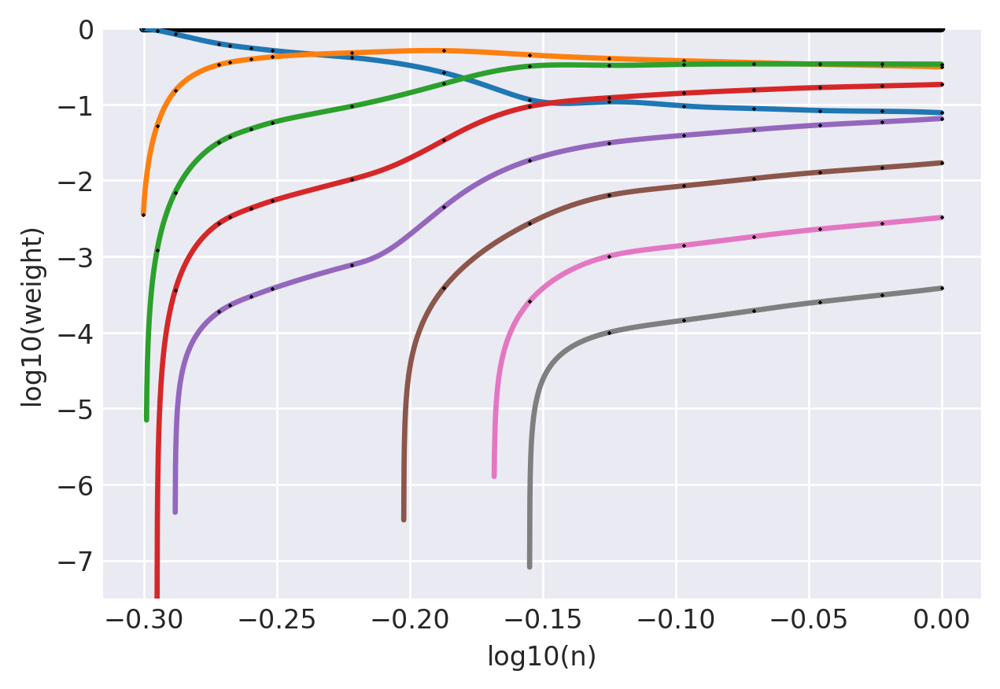

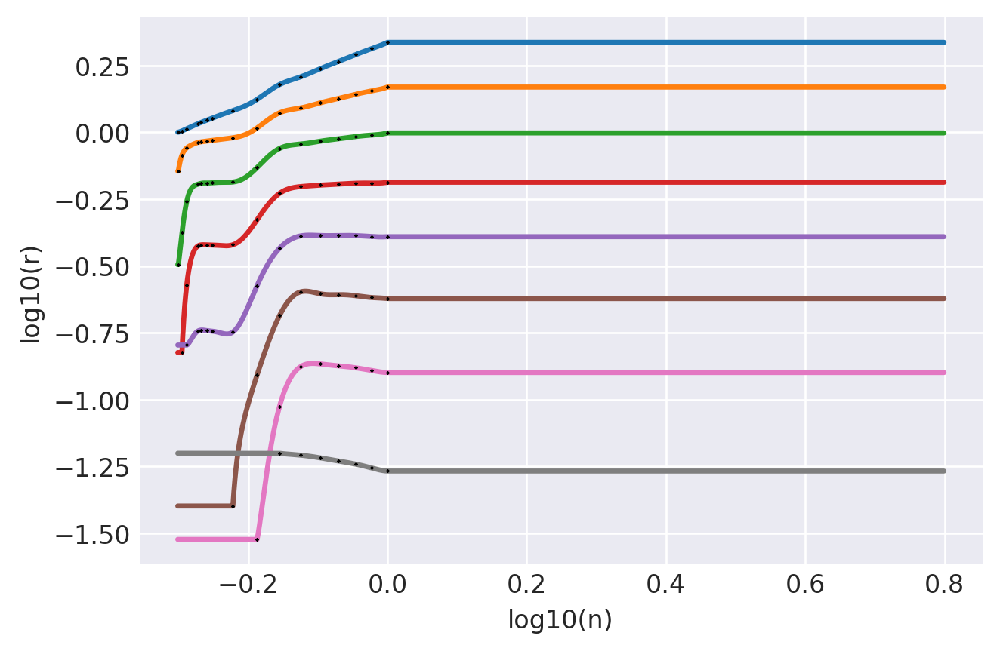

/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/ipykernel_launcher.py:46: RuntimeWarning: divide by zero encountered in log10
/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/ipykernel_launcher.py:46: RuntimeWarning: invalid value encountered in log10
/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/ipykernel_launcher.py:47: RuntimeWarning: divide by zero encountered in log10


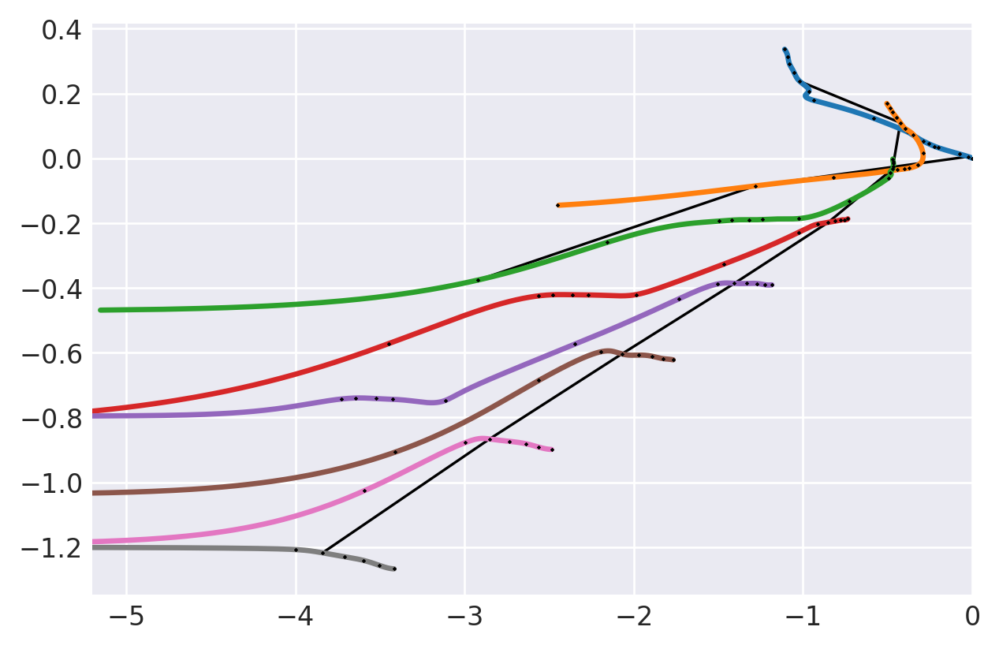

8


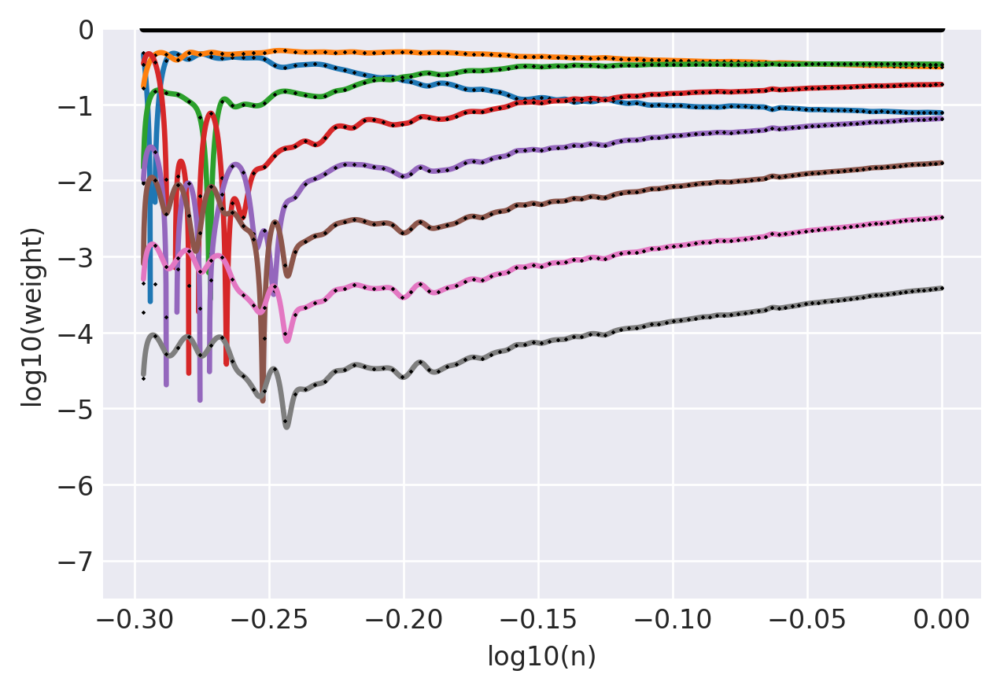

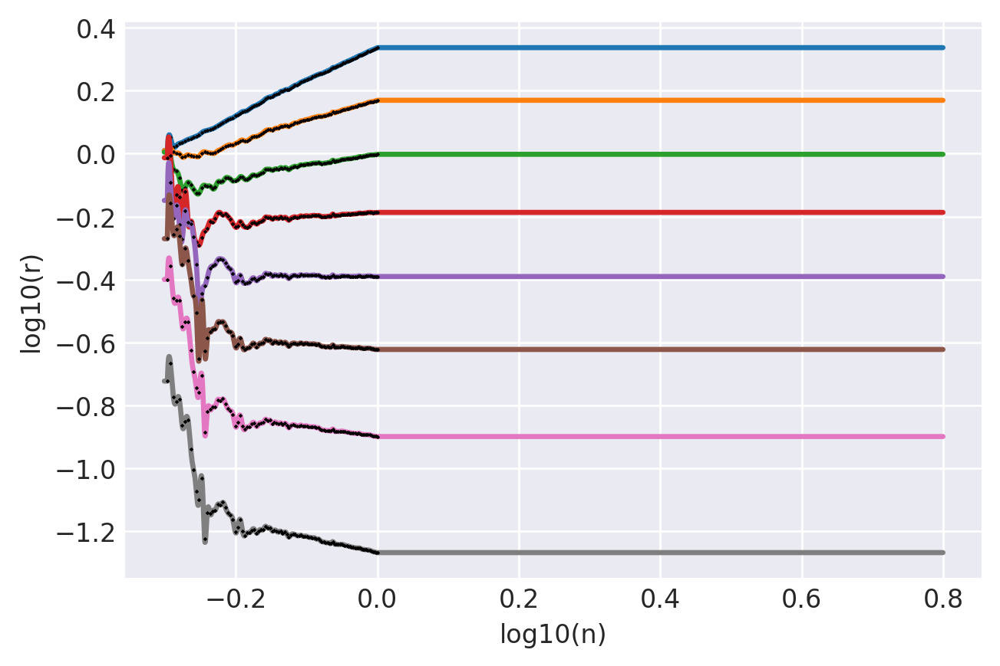

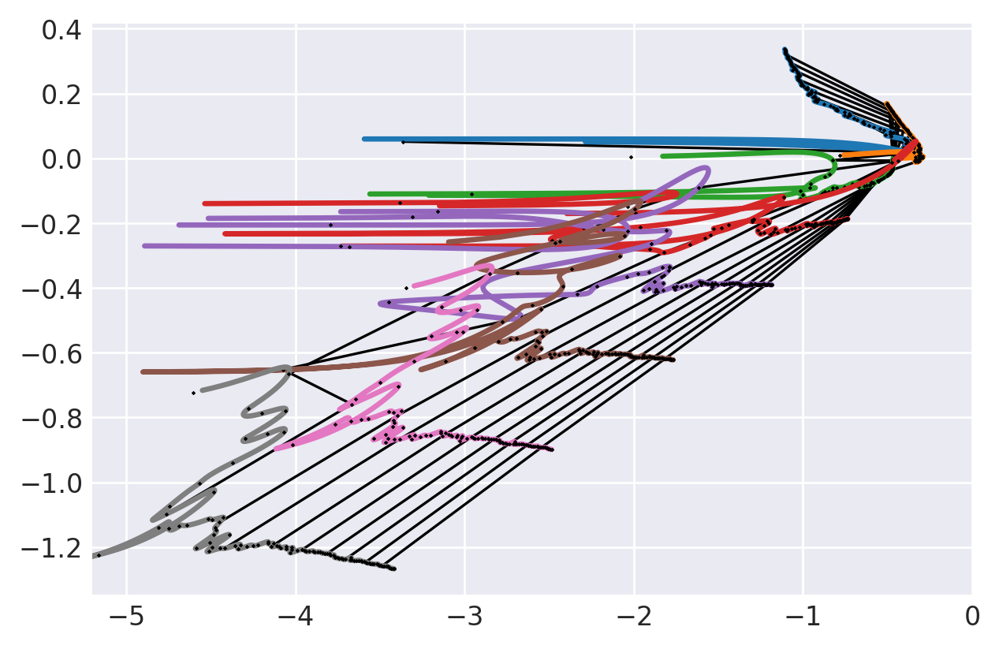

8


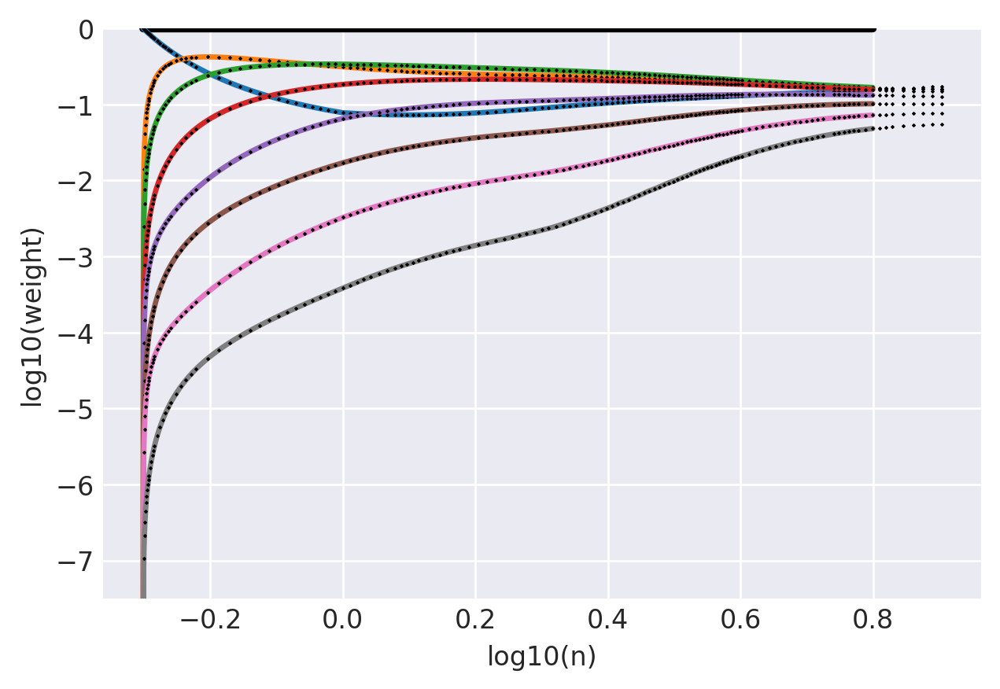

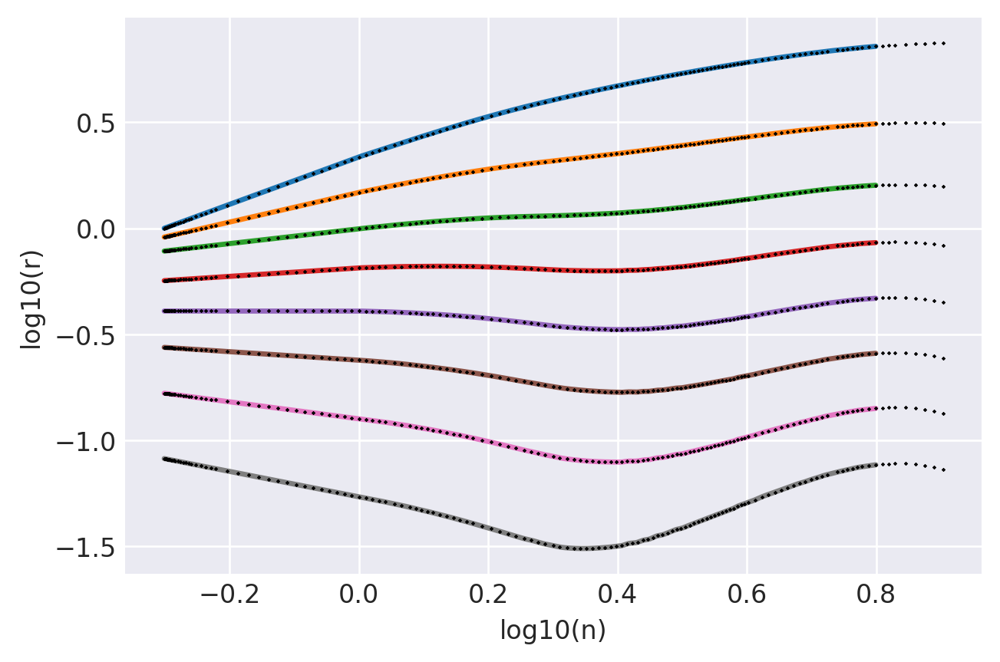

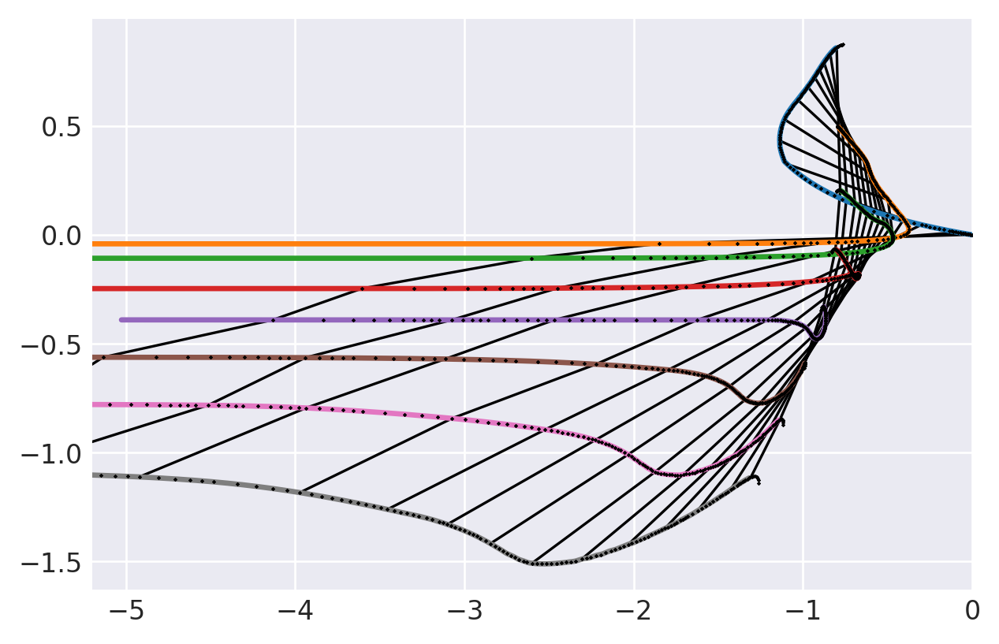

4


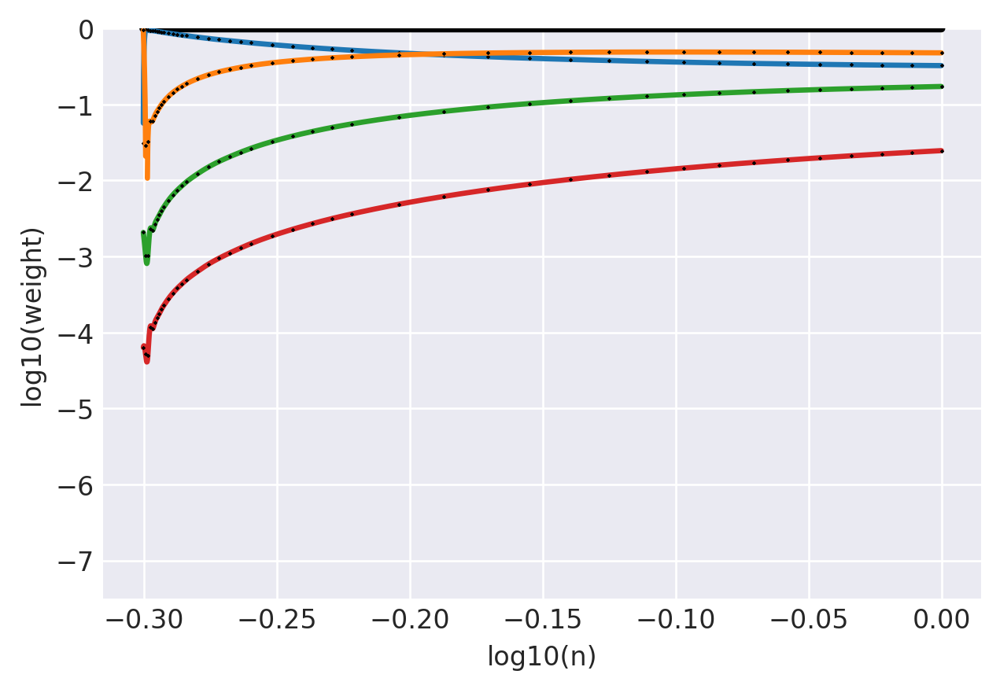

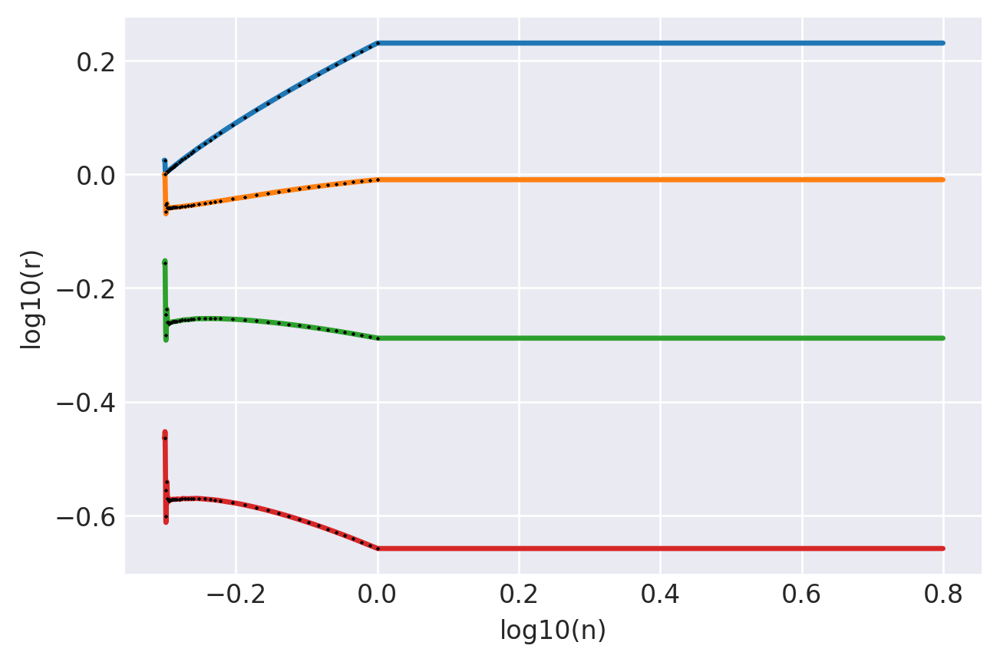

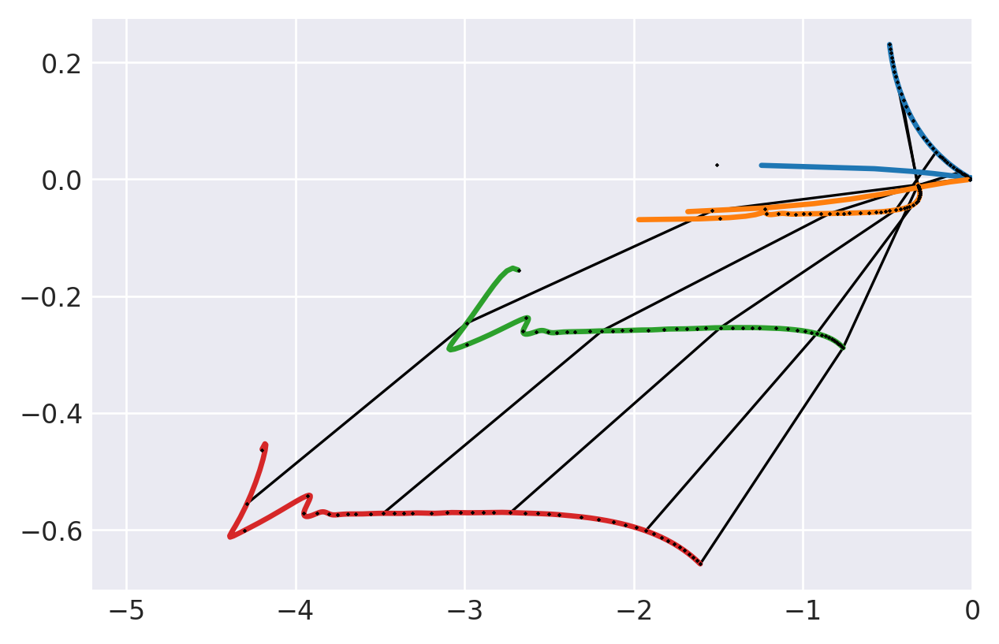

4


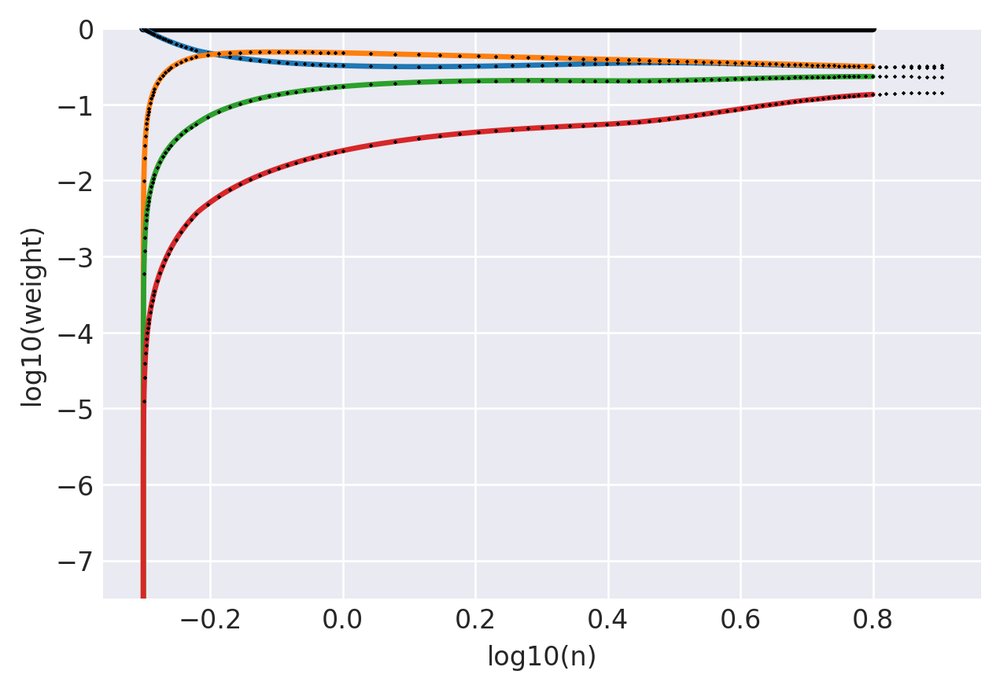

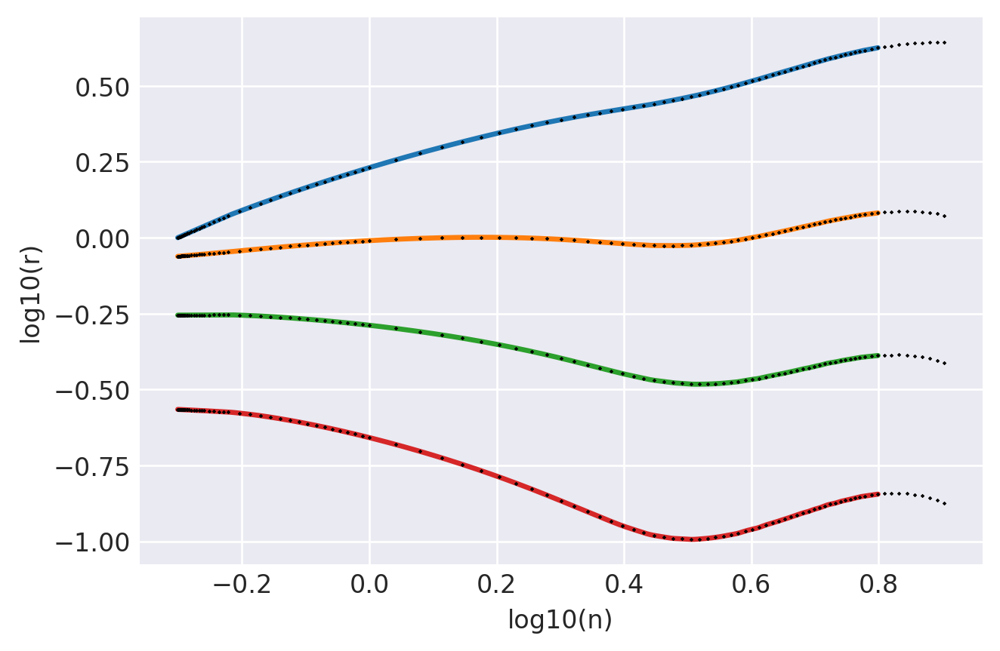

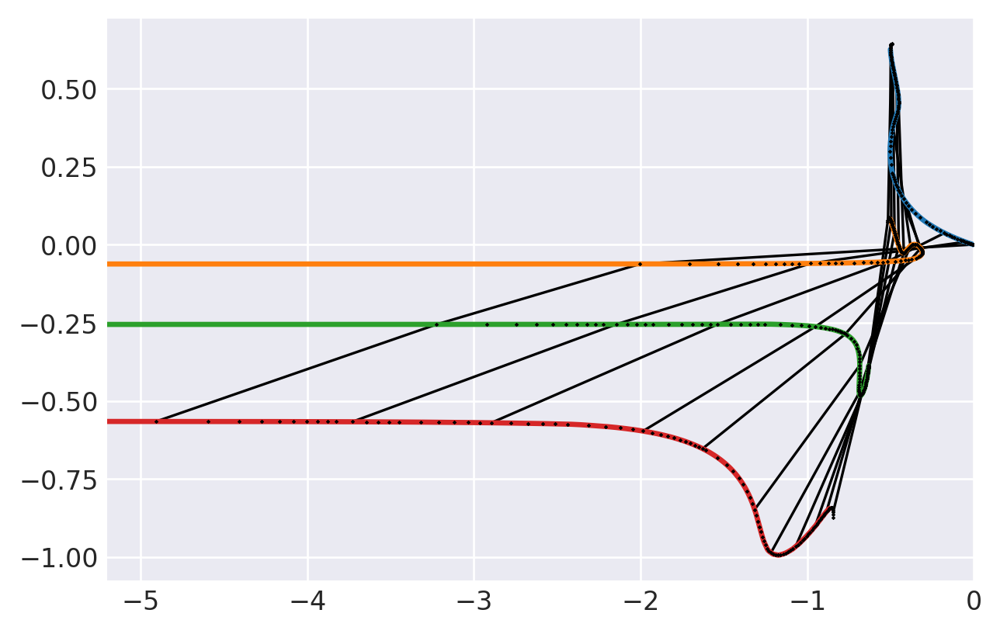

In [5]:
import multiprofit.objects as mpfobj
import multiprofit.util as mpfutil

# Plot the resulting splines, demonstrating the superiority of the final adopted approach

profilesersic = mpfutil.getcomponents('sersic', [''], [], {'nser': [0.5], 're': [1.0], 'ang': [0], 'axrat': [1]})[0]
paramssersic = profilesersic.getparameters(fixed=False)
# Plot N=8 first
order = 8
for weightvars in weightvarssmrt, weightvarslin, None, weightvarsfour, None:
    print(order)
    mgsersic = mpfobj.MultiGaussianApproximationProfile(
        [mpfobj.FluxParameter('', '', 1.0, '', None)], parameters=paramssersic, weightvars=weightvars, order=order)
    changeorder = weightvars is None and order == 8
    if weightvars is None:
        weightvars = mpfobj.MultiGaussianApproximationProfile.weights['sersic'][order]
    nsers = np.linspace(np.log10(0.5), np.log10(6.3), 10000)
    weightsplines = mgsersic.weightsplines
    sigmasplines = mgsersic.sigmasplines
    weightsums = [np.sum(np.array([weightsplines[i](nserlog) for i in range(order)])) for nserlog in nsers]
    plt.plot(nsers, np.log10(weightsums), 'k-', linewidth=3)
    for i in range(order):
        plt.plot(nsers, np.log10(weightsplines[i](nsers)), linewidth=2)
        plt.plot(weightsplines[i]._data[0], np.log10(weightsplines[i]._data[1]), 'kx', markersize=0.8)
    plt.ylim(-7.5, 0)

    plt.xlabel('log10(n)')
    plt.ylabel('log10(weight)')
    plt.show()

    for i in range(order):
        plt.plot(nsers, np.log10(sigmasplines[i](nsers)), linewidth=2)
        plt.plot(sigmasplines[i]._data[0], np.log10(sigmasplines[i]._data[1]), 'kx', markersize=0.8)
    plt.xlabel('log10(n)')
    plt.ylabel('log10(r)')
    plt.show()

    weightvalues = np.array(list(weightvars.values()))
    for idxn, nser in enumerate(list(weightvars.keys())):
        if idxn % 10 == 1:
            nser = np.log10(nser)
            x = np.array([weightsplines[i](nser) for i in range(order) if weightvalues[idxn][0][i] > 0])
            y = np.array([sigmasplines[i](nser) for i in range(order) if weightvalues[idxn][0][i] > 0])
            plt.plot(np.log10(x), np.log10(y), 'k-', linewidth=1)
    
    for i in range(order):
        plt.plot(np.log10(weightsplines[i](nsers)), np.log10(sigmasplines[i](nsers)), linewidth=2)
        plt.plot(np.log10(weightsplines[i]._data[1]), np.log10(sigmasplines[i]._data[1]), 'kx', markersize=0.8)

    plt.xlim([-5.2, 0])
    plt.show()
    if changeorder:
        order = 4

### How well does the interpolation work far away from the spline control points?

This is TBD. At the least, the COSMOS analysis shows that it's not terribly bad. On the other hand, you could argue that the Sersic profile isn't physically motivated anyways, so it's not worth worrying too much about reproducing it to arbitrarily small tolerances, except insofar as adding more components minimizes the amplitude of the wiggles in the MGA profile.